In [19]:
from model import SpiceMixPlus
from pathlib import Path
import numpy as np
import torch
from matplotlib import pyplot as plt
from load_data import save_anndata, load_anndata

from importlib import reload
import estimate_weights
reload(estimate_weights)
import model
reload(model)

import estimate_parameters
reload(estimate_parameters)
import load_data
reload(load_data)


import initialization
reload(initialization)

<module 'initialization' from '/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/initialization.py'>

In [2]:
import scanpy as sc
import pandas as pd
import seaborn as sns

def plot_metagene_embedding(synthetic_dataset, metagene_index):
    points = synthetic_dataset.obsm["spatial"]
    x, y = points.T
    spatial_effect = synthetic_dataset.obsm["learned_X"][:, metagene_index]

    biased_batch_effect = pd.DataFrame({"x":x, "y":y, "spatial_metagene":spatial_effect})
    sns.scatterplot(data=biased_batch_effect, x="x", y="y", hue="spatial_metagene")
    

## Basic test
Testing SpiceMixPlus performance on old datasets (seems to work now!)

In [ ]:
path2dataset = Path('../../data/synthetic_cortex/old/synthetic_500_100_20_10_0_0_i0')


num_fovs = 3
old_simulation_spicemix_test = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-1,
    repli_list=np.arange(num_fovs),
    metagene_mode="shared",
    lambda_M=0.5,
    #repli_list=list(range(1)),
    context=dict(device='cuda:0', dtype=torch.float32),
    context_Y=dict(dtype=torch.float32, device='cuda:0'),
    prior_x_modes = [None] * num_fovs
)   
#mina_spicemix.load_dataset(path2dataset)
old_simulation_spicemix_test.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.h5ad")
old_simulation_spicemix_test.initialize(
#     method='kmeans',
    method='svd',
)   

old_simulation_spicemix_test.initialize_Sigma_x_inv()
torch.manual_seed(0)
import numpy as np
np.random.seed(0)
for iteration in range(500): 
    print(f"----- Iteration {iteration} -----")
    old_simulation_spicemix_test.estimate_parameters(iiter=iteration, use_spatial=[True]*old_simulation_spicemix_test.num_repli)
    likelihood = old_simulation_spicemix_test.compute_likelihood_function(use_spatial=[True]*old_simulation_spicemix_test.num_repli)
    print(f"Likelihood after parameter updates: {likelihood}")
    
    old_simulation_spicemix_test.estimate_weights(iiter=iteration, use_spatial=[True]*old_simulation_spicemix_test.num_repli)
    likelihood = old_simulation_spicemix_test.compute_likelihood_function(use_spatial=[True]*old_simulation_spicemix_test.num_repli)
    print(f"Likelihood after weight update: {likelihood}")

In [35]:
replicate_names, datasets = zip(*enumerate(old_simulation_spicemix_test.datasets))
save_anndata(path2dataset/ "500_iterations.h5ad", datasets, replicate_names)

AnnData object with n_obs × n_vars = 500 × 100
    obs: 'cell_type', 'batch'
    uns: 'cell_type_colors', 'spatial_neighbors', 'M', 'M_bar', 'spicemixplus_hyperparameters', 'sigma_yx', 'Sigma_x_inv'
    obsm: 'ground_truth_X', 'spatial', 'X'
    obsp: 'adjacency_matrix', 'spatial_connectivities', 'spatial_distances'

In [40]:
datasets = load_anndata(path2dataset/ "500_iterations.h5ad", replicate_names)

/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


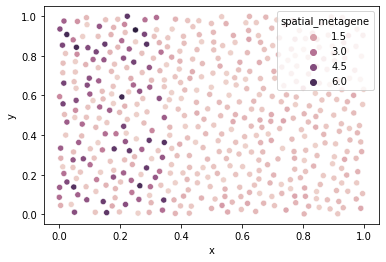

In [49]:
plot_metagene_embedding(datasets[0], 1)

In [47]:
datasets[0].uns["spicemixplus_hyperparameters"]

{'K': 20,
 'c': 3,
 'd': 4,
 'metagene_mode': 'shared',
 'prior_x': array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.], dtype=float32)}

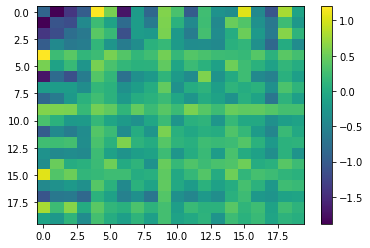

In [42]:
plt.imshow(datasets[0].uns["Sigma_x_inv"]["0"], interpolation="none", aspect='auto')
plt.colorbar()

In [43]:
from scipy.stats import zscore

datasets[0].obsm["learned_X"] = datasets[0].obsm["X"]

datasets[0].obsm["normalized_learned_X"] = zscore(datasets[0].obsm["learned_X"])
sc.pp.neighbors(datasets[0], use_rep="normalized_learned_X")
print(sc.metrics.morans_i(datasets[0], obsm="learned_X"))
print(sc.metrics.morans_i(datasets[0], obsm="normalized_learned_X"))

[0.81376077 0.91420545 0.81225354 0.67746778 0.59320931 0.5012526
 0.6208648  0.73737233 0.62524525 0.6008983  0.57426617 0.77116827
 0.50756116 0.53688915 0.76745588 0.50716463 0.69700672 0.5852029
 0.68413972 0.48894643]
[0.81376077 0.91420546 0.81225354 0.67746777 0.59320931 0.5012526
 0.6208648  0.73737232 0.62524525 0.6008983  0.57426617 0.77116827
 0.50756116 0.53688915 0.76745587 0.50716463 0.69700672 0.5852029
 0.68413973 0.48894643]


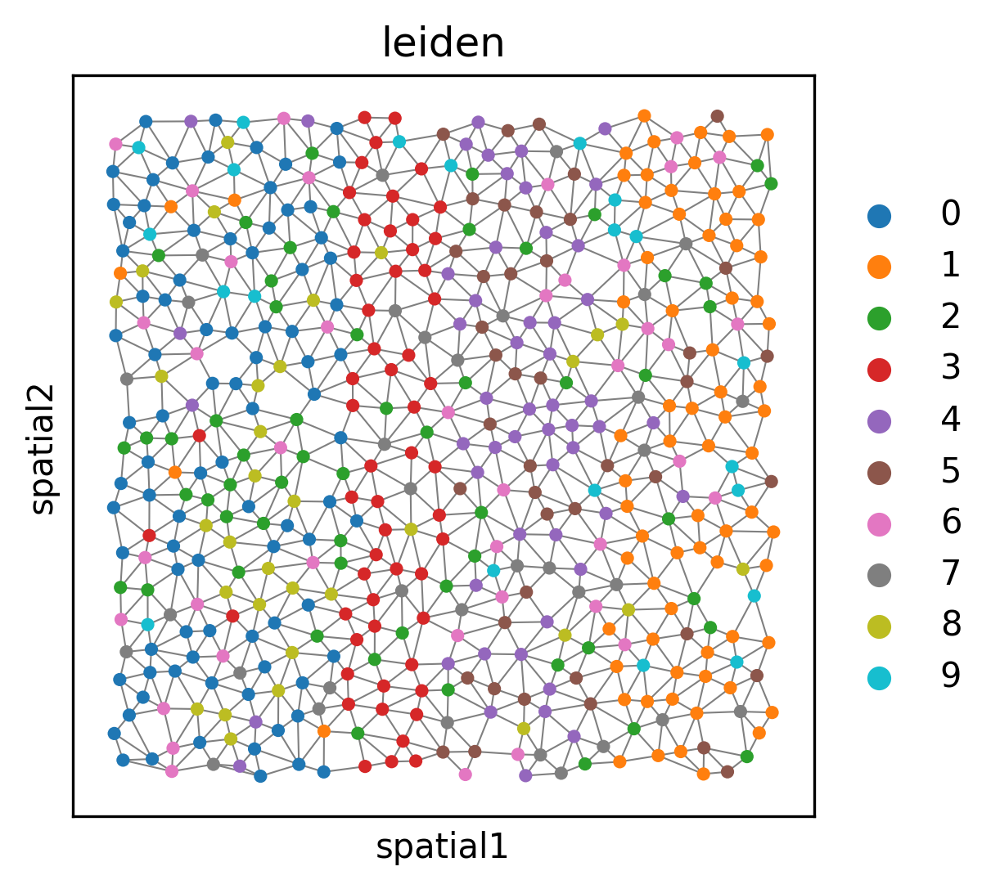

In [44]:
sc.pp.neighbors(datasets[0], use_rep="normalized_learned_X")
sc.tl.leiden(datasets[0], resolution=1)
fig, ax = plt.subplots(dpi=300)
sc.pl.spatial(datasets[0], spot_size=0.02, neighbors_key="spatial_neighbors",
              color="leiden", edges=True,  edges_width=0.5, ax=ax)

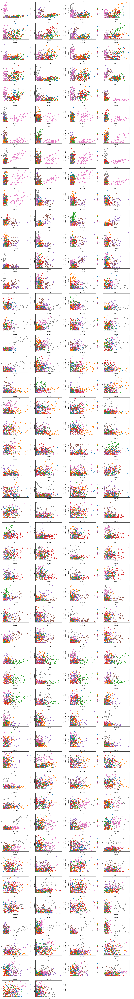

In [50]:
sc.pl.embedding(datasets[0], color="cell_type",
                components="all",
                basis="learned_X")

In [45]:
from sklearn.metrics import adjusted_rand_score as ari

ari(datasets[0].obs["cell_type"], datasets[0].obs["leiden"])

0.6984813873718272

## Testing Differential SpiceMix

Here we test SpiceMixPlus on some new datasets with procedurally generated "differential" metagenes - metagenes that are just slightly different between fields of view.

In [3]:
path2dataset = Path('../../data/synthetic_cortex/500_cells_100_genes_extreme_variance_low_covariance_0.5_replicate_variability_random_seed_0')

num_fovs = 4
differential_spicemix = SpiceMixPlus(
    K=10, lambda_Sigma_x_inv=1e-2,
    repli_list=np.arange(num_fovs),
    metagene_mode="differential",
    lambda_M=0.5,
    #repli_list=list(range(1)),
    context=dict(device='cuda:0', dtype=torch.float32),
    context_Y=dict(dtype=torch.float32, device='cuda:0'),
    prior_x_modes = [None] * num_fovs
)   
#mina_spicemix.load_dataset(path2dataset)
differential_spicemix.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.hdf5")
differential_spicemix.initialize(
#     method='kmeans',
    method='svd',
)   

differential_spicemix.initialize_Sigma_x_inv()
torch.manual_seed(0)
import numpy as np
np.random.seed(0)
for iteration in range(200): 
    print(f"----- Iteration {iteration} -----")
    differential_spicemix.estimate_parameters(iiter=iteration, use_spatial=[True]*differential_spicemix.num_repli)
    differential_spicemix.estimate_weights(iiter=iteration, use_spatial=[True]*differential_spicemix.num_repli)

/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


tensor([[8.1088e+01, 2.2924e+00, 1.5213e+00,  ..., 5.5760e-01, 2.0424e+00,
         1.0353e+00],
        [7.8819e+01, 7.7397e-01, 1.8544e+00,  ..., 1.5689e+00, 1.5261e+00,
         1.4524e-01],
        [3.9946e+01, 1.7123e+00, 1.8544e+00,  ..., 1.5689e+00, 1.5261e+00,
         1.5749e+00],
        ...,
        [8.2762e+01, 5.1572e-01, 1.8544e+00,  ..., 1.5689e+00, 1.5261e+00,
         1.5749e+00],
        [8.1934e+01, 1.7123e+00, 1.8544e+00,  ..., 2.8696e+00, 1.5261e+00,
         4.7347e-02],
        [7.5023e+01, 2.0115e+00, 6.2908e-01,  ..., 1.5689e+00, 1.5261e+00,
         1.6306e-01]], device='cuda:0')
tensor([[8.4790e-01, 2.3971e-02, 1.5907e-02,  ..., 5.8305e-03, 2.1356e-02,
         1.0826e-02],
        [8.4181e-01, 8.2662e-03, 1.9805e-02,  ..., 1.6757e-02, 1.6300e-02,
         1.5512e-03],
        [7.1303e-01, 3.0565e-02, 3.3100e-02,  ..., 2.8005e-02, 2.7241e-02,
         2.8111e-02],
        ...,
        [8.5031e-01, 5.2986e-03, 1.9052e-02,  ..., 1.6119e-02, 1.5680e-02,
        

Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

tensor([[-0.1428,  0.0017, -0.0623,  0.1583, -0.0820,  0.2343,  0.0970, -0.1669,
         -0.0359,  0.3873],
        [ 0.0017,  0.1838,  0.0052, -0.0530,  0.0875, -0.0723,  0.0915,  0.0322,
         -0.1293, -0.1019],
        [-0.0623,  0.0052,  0.0663, -0.0921,  0.1797,  0.0290,  0.1359, -0.0318,
          0.1354, -0.1845],
        [ 0.1583, -0.0530, -0.0921, -0.0546, -0.0176, -0.0075, -0.1105,  0.1468,
         -0.0750, -0.1058],
        [-0.0820,  0.0875,  0.1797, -0.0176,  0.0275, -0.1482,  0.0295,  0.1367,
          0.0669, -0.0486],
        [ 0.2343, -0.0723,  0.0290, -0.0075, -0.1482, -0.0862, -0.0067, -0.0712,
         -0.0375, -0.1969],
        [ 0.0970,  0.0915,  0.1359, -0.1105,  0.0295, -0.0067, -0.1732,  0.1207,
          0.0547, -0.3836],
        [-0.1669,  0.0322, -0.0318,  0.1468,  0.1367, -0.0712,  0.1207,  0.2305,
          0.0250, -0.0180],
        [-0.0359, -0.1293,  0.1354, -0.0750,  0.0669, -0.0375,  0.0547,  0.0250,
         -0.0179,  0.1251],
        [ 0.3873, -

tensor([[-0.3440,  0.1512, -0.2558,  0.3622, -0.1654,  0.4378,  0.2847, -0.3475,
          0.0559,  0.5767],
        [ 0.1512,  0.3330,  0.1471,  0.1367,  0.0325,  0.1056,  0.2610,  0.1593,
         -0.0115,  0.0711],
        [-0.2558,  0.1471, -0.1237,  0.1050,  0.0665, -0.0128,  0.3393, -0.2101,
          0.2160, -0.2023],
        [ 0.3622,  0.1367,  0.1050,  0.1490, -0.0545,  0.1963,  0.0926,  0.0963,
          0.0501,  0.0981],
        [-0.1654,  0.0325,  0.0665, -0.0545, -0.0600, -0.2220, -0.0296,  0.0285,
          0.0293, -0.1093],
        [ 0.4378,  0.1056, -0.0128,  0.1963, -0.2220,  0.1175,  0.1939, -0.1670,
          0.0743,  0.0065],
        [ 0.2847,  0.2610,  0.3393,  0.0926, -0.0296,  0.1939,  0.0232,  0.0305,
          0.1666, -0.1840],
        [-0.3475,  0.1593, -0.2101,  0.0963,  0.0285, -0.1670,  0.0305,  0.0563,
          0.0988, -0.1600],
        [ 0.0559, -0.0115,  0.2160,  0.0501,  0.0293,  0.0743,  0.1666,  0.0988,
          0.0776,  0.2249],
        [ 0.5767,  

tensor([[-0.4776,  0.0756, -0.5065,  0.5390, -0.1689,  0.6743,  0.3217, -0.5033,
         -0.0274,  0.8484],
        [ 0.0756,  0.2481,  0.0097,  0.1554,  0.0088,  0.2078,  0.2491, -0.0340,
         -0.0854,  0.0910],
        [-0.5065,  0.0097, -0.3249,  0.1937,  0.0163,  0.1293,  0.2916, -0.3981,
          0.0916, -0.1046],
        [ 0.5390,  0.1554,  0.1937,  0.3033,  0.0067,  0.4298,  0.2030,  0.1226,
          0.0172,  0.3090],
        [-0.1689,  0.0088,  0.0163,  0.0067, -0.0669, -0.1487,  0.0066, -0.0114,
         -0.0912, -0.0623],
        [ 0.6743,  0.2078,  0.1293,  0.4298, -0.1487,  0.3512,  0.4391,  0.0064,
          0.0887,  0.2516],
        [ 0.3217,  0.2491,  0.2916,  0.2030,  0.0066,  0.4391,  0.0777,  0.0076,
          0.1232, -0.0292],
        [-0.5033, -0.0340, -0.3981,  0.1226, -0.0114,  0.0064,  0.0076, -0.0930,
         -0.0326, -0.0956],
        [-0.0274, -0.0854,  0.0916,  0.0172, -0.0912,  0.0887,  0.1232, -0.0326,
         -0.0021,  0.1737],
        [ 0.8484,  

tensor([[-0.4093,  0.0669, -0.5816,  0.5388, -0.1773,  0.8064,  0.3197, -0.6254,
         -0.0681,  1.0584],
        [ 0.0669,  0.2234, -0.0673,  0.1358, -0.0095,  0.2693,  0.2279, -0.1782,
         -0.1223,  0.1259],
        [-0.5816, -0.0673, -0.3056,  0.1186, -0.0809,  0.0998,  0.3363, -0.5630,
         -0.0391, -0.1557],
        [ 0.5388,  0.1358,  0.1186,  0.2807,  0.0050,  0.4931,  0.1954, -0.0395,
         -0.0337,  0.3505],
        [-0.1773, -0.0095, -0.0809,  0.0050, -0.0801, -0.1151, -0.0013, -0.0738,
         -0.1895, -0.0492],
        [ 0.8064,  0.2693,  0.0998,  0.4931, -0.1151,  0.4641,  0.5064, -0.0067,
          0.0887,  0.3754],
        [ 0.3197,  0.2279,  0.3363,  0.1954, -0.0013,  0.5064,  0.0805, -0.0888,
          0.0757,  0.0289],
        [-0.6254, -0.1782, -0.5630, -0.0395, -0.0738, -0.0067, -0.0888, -0.2741,
         -0.1540, -0.2133],
        [-0.0681, -0.1223, -0.0391, -0.0337, -0.1895,  0.0887,  0.0757, -0.1540,
         -0.0521,  0.1432],
        [ 1.0584,  

tensor([[-0.3583,  0.0930, -0.6653,  0.6451, -0.2315,  0.9144,  0.3113, -0.7905,
         -0.0948,  1.2402],
        [ 0.0930,  0.2288, -0.1180,  0.1820, -0.0583,  0.3291,  0.2205, -0.3152,
         -0.1289,  0.1907],
        [-0.6653, -0.1180, -0.2854,  0.0863, -0.2050,  0.0689,  0.3887, -0.6739,
         -0.1280, -0.2366],
        [ 0.6451,  0.1820,  0.0863,  0.3314, -0.0137,  0.5511,  0.2125, -0.1956,
         -0.0358,  0.4246],
        [-0.2315, -0.0583, -0.2050, -0.0137, -0.1381, -0.1260, -0.0488, -0.1682,
         -0.3254, -0.0714],
        [ 0.9144,  0.3291,  0.0689,  0.5511, -0.1260,  0.5341,  0.5156, -0.1145,
          0.0952,  0.4583],
        [ 0.3113,  0.2205,  0.3887,  0.2125, -0.0488,  0.5156,  0.0786, -0.2263,
          0.0410,  0.0845],
        [-0.7905, -0.3152, -0.6739, -0.1956, -0.1682, -0.1145, -0.2263, -0.4740,
         -0.3139, -0.3505],
        [-0.0948, -0.1289, -0.1280, -0.0358, -0.3254,  0.0952,  0.0410, -0.3139,
         -0.0837,  0.1283],
        [ 1.2402,  

tensor([[-0.4314,  0.0681, -0.6605,  0.6561, -0.2543,  0.9913,  0.3106, -0.9334,
         -0.1185,  1.3727],
        [ 0.0681,  0.1912, -0.1030,  0.1610, -0.0785,  0.3308,  0.1890, -0.4142,
         -0.1366,  0.2127],
        [-0.6605, -0.1030, -0.2169,  0.1178, -0.2302,  0.1122,  0.3822, -0.6843,
         -0.1233, -0.2187],
        [ 0.6561,  0.1610,  0.1178,  0.3057, -0.0170,  0.5342,  0.2068, -0.3063,
         -0.0368,  0.4290],
        [-0.2543, -0.0785, -0.2302, -0.0170, -0.1520, -0.0974, -0.0503, -0.2078,
         -0.3364, -0.0473],
        [ 0.9913,  0.3308,  0.1122,  0.5342, -0.0974,  0.5660,  0.4993, -0.1936,
          0.1095,  0.5080],
        [ 0.3106,  0.1890,  0.3822,  0.2068, -0.0503,  0.4993,  0.0859, -0.3006,
          0.0288,  0.1459],
        [-0.9334, -0.4142, -0.6843, -0.3063, -0.2078, -0.1936, -0.3006, -0.5927,
         -0.4153, -0.4295],
        [-0.1185, -0.1366, -0.1233, -0.0368, -0.3364,  0.1095,  0.0288, -0.4153,
         -0.0968,  0.1366],
        [ 1.3727,  

tensor([[-0.4813,  0.0494, -0.6694,  0.6571, -0.2918,  1.0426,  0.3067, -0.9716,
         -0.1512,  1.4638],
        [ 0.0494,  0.1627, -0.1137,  0.1406, -0.1157,  0.3225,  0.1615, -0.4154,
         -0.1535,  0.2209],
        [-0.6694, -0.1137, -0.2288,  0.1011, -0.2531,  0.1133,  0.3142, -0.6839,
         -0.1337, -0.2119],
        [ 0.6571,  0.1406,  0.1011,  0.2781, -0.0344,  0.5075,  0.1943, -0.3058,
         -0.0555,  0.4165],
        [-0.2918, -0.1157, -0.2531, -0.0344, -0.1845, -0.1030, -0.0754, -0.2434,
         -0.4003, -0.0543],
        [ 1.0426,  0.3225,  0.1133,  0.5075, -0.1030,  0.5762,  0.4731, -0.1763,
          0.1001,  0.5286],
        [ 0.3067,  0.1615,  0.3142,  0.1943, -0.0754,  0.4731,  0.0851, -0.2984,
          0.0039,  0.1771],
        [-0.9716, -0.4154, -0.6839, -0.3058, -0.2434, -0.1763, -0.2984, -0.6013,
         -0.4357, -0.3989],
        [-0.1512, -0.1535, -0.1337, -0.0555, -0.4003,  0.1001,  0.0039, -0.4357,
         -0.1213,  0.1246],
        [ 1.4638,  

tensor([[-0.5649,  0.0181, -0.6890,  0.6557, -0.3569,  1.1067,  0.2923, -1.0168,
         -0.2061,  1.5961],
        [ 0.0181,  0.1184, -0.1378,  0.1086, -0.1751,  0.2935,  0.1141, -0.3943,
         -0.1792,  0.2229],
        [-0.6890, -0.1378, -0.2675,  0.0623, -0.2899,  0.0976,  0.1901, -0.6807,
         -0.1540, -0.2037],
        [ 0.6557,  0.1086,  0.0623,  0.2340, -0.0645,  0.4485,  0.1665, -0.2799,
         -0.0844,  0.3820],
        [-0.3569, -0.1751, -0.2899, -0.0645, -0.2395, -0.1215, -0.1208, -0.2973,
         -0.4920, -0.0709],
        [ 1.1067,  0.2935,  0.0976,  0.4485, -0.1215,  0.5654,  0.4085, -0.1392,
          0.0764,  0.5308],
        [ 0.2923,  0.1141,  0.1901,  0.1665, -0.1208,  0.4085,  0.0740, -0.2821,
         -0.0380,  0.2042],
        [-1.0168, -0.3943, -0.6807, -0.2799, -0.2973, -0.1392, -0.2821, -0.5910,
         -0.4473, -0.3293],
        [-0.2061, -0.1792, -0.1540, -0.0844, -0.4920,  0.0764, -0.0380, -0.4473,
         -0.1598,  0.1019],
        [ 1.5961,  

tensor([[-0.7269, -0.0680, -0.7301,  0.6164, -0.4693,  1.1346,  0.2496, -1.0959,
         -0.3008,  1.7855],
        [-0.0680,  0.0234, -0.1911,  0.0339, -0.2641,  0.1735,  0.0190, -0.3570,
         -0.2196,  0.1785],
        [-0.7301, -0.1911, -0.3414, -0.0145, -0.3471,  0.0325, -0.0090, -0.6719,
         -0.1897, -0.1923],
        [ 0.6164,  0.0339, -0.0145,  0.1439, -0.1121,  0.2857,  0.0997, -0.2329,
         -0.1256,  0.2780],
        [-0.4693, -0.2641, -0.3471, -0.1121, -0.3214, -0.1662, -0.1898, -0.3691,
         -0.5669, -0.0958],
        [ 1.1346,  0.1735,  0.0325,  0.2857, -0.1662,  0.4465,  0.2396, -0.1219,
          0.0110,  0.4348],
        [ 0.2496,  0.0190, -0.0090,  0.0997, -0.1898,  0.2396,  0.0392, -0.2546,
         -0.1021,  0.1986],
        [-1.0959, -0.3570, -0.6719, -0.2329, -0.3691, -0.1219, -0.2546, -0.5561,
         -0.4427, -0.2182],
        [-0.3008, -0.2196, -0.1897, -0.1256, -0.5669,  0.0110, -0.1021, -0.4427,
         -0.2142,  0.0594],
        [ 1.7855,  

tensor([[-0.8353, -0.1352, -0.7659,  0.5890, -0.5376,  1.1240,  0.2067, -1.1514,
         -0.3649,  1.8522],
        [-0.1352, -0.0360, -0.2376, -0.0078, -0.3049,  0.0922, -0.0414, -0.3396,
         -0.2418,  0.1239],
        [-0.7659, -0.2376, -0.3940, -0.0688, -0.3829, -0.0202, -0.1493, -0.6703,
         -0.2081, -0.1951],
        [ 0.5890, -0.0078, -0.0688,  0.1037, -0.1360,  0.1953,  0.0555, -0.2084,
         -0.1444,  0.2072],
        [-0.5376, -0.3049, -0.3829, -0.1360, -0.3607, -0.1916, -0.2258, -0.3986,
         -0.5687, -0.1133],
        [ 1.1240,  0.0922, -0.0202,  0.1953, -0.1916,  0.3523,  0.1362, -0.1292,
         -0.0348,  0.3432],
        [ 0.2067, -0.0414, -0.1493,  0.0555, -0.2258,  0.1362,  0.0053, -0.2493,
         -0.1411,  0.1559],
        [-1.1514, -0.3396, -0.6703, -0.2084, -0.3986, -0.1292, -0.2493, -0.5320,
         -0.4340, -0.1732],
        [-0.3649, -0.2418, -0.2081, -0.1444, -0.5687, -0.0348, -0.1411, -0.4340,
         -0.2436,  0.0219],
        [ 1.8522,  

tensor([[-0.7952, -0.1606, -0.9107,  0.6107, -0.5615,  1.0933,  0.2225, -1.2006,
         -0.3934,  1.8906],
        [-0.1606, -0.0584, -0.3794, -0.0151, -0.2945,  0.0455, -0.0677, -0.3292,
         -0.2358,  0.0856],
        [-0.9107, -0.3794, -0.6241, -0.2491, -0.3982, -0.0714, -0.3913, -0.6783,
         -0.2228, -0.2885],
        [ 0.6107, -0.0151, -0.2491,  0.0942, -0.1349,  0.1424,  0.0328, -0.1990,
         -0.1331,  0.1590],
        [-0.5615, -0.2945, -0.3982, -0.1349, -0.3579, -0.1887, -0.2263, -0.3968,
         -0.4923, -0.1122],
        [ 1.0933,  0.0455, -0.0714,  0.1424, -0.1887,  0.2775,  0.0687, -0.1532,
         -0.0531,  0.2629],
        [ 0.2225, -0.0677, -0.3913,  0.0328, -0.2263,  0.0687, -0.0186, -0.2572,
         -0.1497,  0.1108],
        [-1.2006, -0.3292, -0.6783, -0.1990, -0.3968, -0.1532, -0.2572, -0.5222,
         -0.4184, -0.1652],
        [-0.3934, -0.2358, -0.2228, -0.1331, -0.4923, -0.0531, -0.1497, -0.4184,
         -0.2429,  0.0044],
        [ 1.8906,  

tensor([[-0.8844, -0.2141, -0.9783,  0.5553, -0.6434,  1.0381,  0.1518, -1.2673,
         -0.4530,  1.8575],
        [-0.2141, -0.0853, -0.4115, -0.0364, -0.3201, -0.0082, -0.1118, -0.2963,
         -0.2342,  0.0349],
        [-0.9783, -0.4115, -0.6921, -0.3020, -0.4247, -0.1168, -0.4665, -0.6702,
         -0.2399, -0.3119],
        [ 0.5553, -0.0364, -0.3020,  0.0465, -0.1629,  0.0618, -0.0256, -0.1865,
         -0.1404,  0.0742],
        [-0.6434, -0.3201, -0.4247, -0.1629, -0.3982, -0.2243, -0.2704, -0.4201,
         -0.4829, -0.1467],
        [ 1.0381, -0.0082, -0.1168,  0.0618, -0.2243,  0.1735, -0.0266, -0.1685,
         -0.0900,  0.1537],
        [ 0.1518, -0.1118, -0.4665, -0.0256, -0.2704, -0.0266, -0.0733, -0.2654,
         -0.1814,  0.0288],
        [-1.2673, -0.2963, -0.6702, -0.1865, -0.4201, -0.1685, -0.2654, -0.4920,
         -0.3942, -0.1517],
        [-0.4530, -0.2342, -0.2399, -0.1404, -0.4829, -0.0900, -0.1814, -0.3942,
         -0.2546, -0.0352],
        [ 1.8575,  

tensor([[-1.0181e+00, -3.0578e-01, -1.0119e+00,  4.6807e-01, -7.3615e-01,
          9.6156e-01,  6.5466e-02, -1.3373e+00, -5.4399e-01,  1.7815e+00],
        [-3.0578e-01, -1.3474e-01, -4.0114e-01, -7.8635e-02, -3.5349e-01,
         -7.1786e-02, -1.5296e-01, -2.8090e-01, -2.5950e-01, -2.7261e-02],
        [-1.0119e+00, -4.0114e-01, -6.8776e-01, -2.9318e-01, -4.4482e-01,
         -1.5151e-01, -4.6363e-01, -6.5469e-01, -2.6165e-01, -3.0467e-01],
        [ 4.6807e-01, -7.8635e-02, -2.9318e-01,  2.8834e-03, -1.9217e-01,
         -9.6238e-04, -6.4105e-02, -1.7715e-01, -1.7453e-01,  2.3434e-02],
        [-7.3615e-01, -3.5349e-01, -4.4482e-01, -1.9217e-01, -4.3861e-01,
         -2.6085e-01, -3.0691e-01, -4.3668e-01, -5.0897e-01, -1.8154e-01],
        [ 9.6156e-01, -7.1786e-02, -1.5151e-01, -9.6238e-04, -2.6085e-01,
          7.8956e-02, -8.1225e-02, -1.7904e-01, -1.4806e-01,  6.8982e-02],
        [ 6.5466e-02, -1.5296e-01, -4.6363e-01, -6.4105e-02, -3.0691e-01,
         -8.1225e-02, -1.0800e-0

tensor([[-1.2210, -0.4248, -0.8824,  0.3222, -0.8183,  0.8587, -0.0416, -1.4284,
         -0.6337,  1.6583],
        [-0.4248, -0.1607, -0.2430, -0.0972, -0.3638, -0.1021, -0.1705, -0.2771,
         -0.2722, -0.0533],
        [-0.8824, -0.2430, -0.5520, -0.1368, -0.3075, -0.0151, -0.3311, -0.5316,
         -0.1386, -0.1941],
        [ 0.3222, -0.0972, -0.1368, -0.0159, -0.2072, -0.0288, -0.0820, -0.1780,
         -0.1912,  0.0093],
        [-0.8183, -0.3638, -0.3075, -0.2072, -0.4562, -0.2776, -0.3227, -0.4409,
         -0.5026, -0.1989],
        [ 0.8587, -0.1021, -0.0151, -0.0288, -0.2776,  0.0258, -0.1047, -0.1910,
         -0.1800,  0.0291],
        [-0.0416, -0.1705, -0.3311, -0.0820, -0.3227, -0.1047, -0.1271, -0.2556,
         -0.2448, -0.0422],
        [-1.4284, -0.2771, -0.5316, -0.1780, -0.4409, -0.1910, -0.2556, -0.4372,
         -0.3812, -0.1426],
        [-0.6337, -0.2722, -0.1386, -0.1912, -0.5026, -0.1800, -0.2448, -0.3812,
         -0.3088, -0.1282],
        [ 1.6583, -

tensor([[-1.3761e+00, -3.9939e-01, -8.5358e-01,  2.4183e-01, -7.0252e-01,
          7.8022e-01, -9.1285e-02, -1.5400e+00, -5.6807e-01,  1.5427e+00],
        [-3.9939e-01, -4.0642e-02, -1.8527e-01,  2.3345e-02, -1.4285e-01,
          3.5543e-03, -5.1686e-02, -2.0600e-01, -1.2244e-01,  5.9213e-02],
        [-8.5358e-01, -1.8527e-01, -5.5495e-01, -9.8442e-02, -2.3731e-01,
         -2.4492e-02, -3.0044e-01, -4.8862e-01, -9.8805e-02, -2.0141e-01],
        [ 2.4183e-01,  2.3345e-02, -9.8442e-02,  2.5119e-02, -8.3081e-02,
         -4.8019e-04, -3.2474e-02, -1.8800e-01, -3.8103e-02,  4.4164e-02],
        [-7.0252e-01, -1.4285e-01, -2.3731e-01, -8.3081e-02, -2.6797e-01,
         -9.1296e-02, -1.4788e-01, -2.8167e-01, -2.0527e-01, -3.9709e-02],
        [ 7.8022e-01,  3.5543e-03, -2.4492e-02, -4.8019e-04, -9.1296e-02,
          9.7563e-03, -5.2803e-02, -2.1818e-01, -4.6181e-02,  2.0967e-02],
        [-9.1285e-02, -5.1686e-02, -3.0044e-01, -3.2474e-02, -1.4788e-01,
         -5.2803e-02, -8.9379e-0

tensor([[-1.4556, -0.3231, -0.8811,  0.3713, -0.7360,  0.7981, -0.0259, -1.6278,
         -0.6354,  1.5021],
        [-0.3231,  0.0699, -0.1896,  0.1792, -0.0921,  0.1299,  0.0862, -0.1355,
         -0.0948,  0.1598],
        [-0.8811, -0.1896, -0.5915, -0.1110, -0.2626, -0.0713, -0.3075, -0.4939,
         -0.1364, -0.2337],
        [ 0.3713,  0.1792, -0.1110,  0.2073, -0.0538,  0.1520,  0.1217, -0.1191,
         -0.0175,  0.2047],
        [-0.7360, -0.0921, -0.2626, -0.0538, -0.2594, -0.0672, -0.1034, -0.2899,
         -0.2086, -0.0373],
        [ 0.7981,  0.1299, -0.0713,  0.1520, -0.0672,  0.0730,  0.0946, -0.1817,
         -0.0543,  0.0870],
        [-0.0259,  0.0862, -0.3075,  0.1217, -0.1034,  0.0946,  0.0231, -0.1644,
         -0.0776,  0.1008],
        [-1.6278, -0.1355, -0.4939, -0.1191, -0.2899, -0.1817, -0.1644, -0.4380,
         -0.2996, -0.1708],
        [-0.6354, -0.0948, -0.1364, -0.0175, -0.2086, -0.0543, -0.0776, -0.2996,
         -0.1948, -0.0277],
        [ 1.5021,  

tensor([[-1.5151e+00, -4.0731e-01, -9.0095e-01,  3.3768e-01, -8.3032e-01,
          8.6567e-01, -9.3113e-02, -1.6950e+00, -6.6953e-01,  1.5712e+00],
        [-4.0731e-01, -1.4882e-02, -2.0529e-01,  7.5298e-02, -1.7534e-01,
          8.9530e-02, -2.6776e-04, -1.9816e-01, -1.2429e-01,  9.0912e-02],
        [-9.0095e-01, -2.0529e-01, -6.0334e-01, -1.2429e-01, -2.9325e-01,
         -8.8504e-02, -3.1637e-01, -4.9438e-01, -1.5611e-01, -2.3844e-01],
        [ 3.3768e-01,  7.5298e-02, -1.2429e-01,  1.4581e-01, -1.0437e-01,
          1.7166e-01,  5.8839e-02, -1.2637e-01, -3.2330e-02,  1.8727e-01],
        [-8.3032e-01, -1.7534e-01, -2.9325e-01, -1.0437e-01, -3.2219e-01,
         -1.0682e-01, -1.7698e-01, -3.5201e-01, -2.5604e-01, -8.4425e-02],
        [ 8.6567e-01,  8.9530e-02, -8.8504e-02,  1.7166e-01, -1.0682e-01,
          1.6087e-01,  9.0297e-02, -1.0427e-01, -2.4656e-02,  1.9716e-01],
        [-9.3113e-02, -2.6776e-04, -3.1637e-01,  5.8839e-02, -1.7698e-01,
          9.0297e-02, -2.3290e-0

tensor([[-1.5727, -0.4986, -0.9311,  0.2783, -0.8848,  0.7951, -0.1089, -1.7589,
         -0.7266,  1.5823],
        [-0.4986, -0.0959, -0.2310, -0.0303, -0.2185, -0.0295, -0.0519, -0.2471,
         -0.1695,  0.0088],
        [-0.9311, -0.2310, -0.6227, -0.1488, -0.3225, -0.1289, -0.3274, -0.5007,
         -0.1894, -0.2525],
        [ 0.2783, -0.0303, -0.1488,  0.0509, -0.1270,  0.0568,  0.0232, -0.1458,
         -0.0792,  0.0886],
        [-0.8848, -0.2185, -0.3225, -0.1270, -0.3375, -0.1392, -0.1871, -0.3603,
         -0.2775, -0.0969],
        [ 0.7951, -0.0295, -0.1289,  0.0568, -0.1392,  0.0811,  0.0323, -0.1371,
         -0.0714,  0.1355],
        [-0.1089, -0.0519, -0.3274,  0.0232, -0.1871,  0.0323, -0.0152, -0.1731,
         -0.1172,  0.0858],
        [-1.7589, -0.2471, -0.5007, -0.1458, -0.3603, -0.1371, -0.1731, -0.3868,
         -0.2884, -0.0957],
        [-0.7266, -0.1695, -0.1894, -0.0792, -0.2775, -0.0714, -0.1172, -0.2884,
         -0.2078, -0.0305],
        [ 1.5823,  

tensor([[-1.6341, -0.5359, -0.9725,  0.2330, -0.9353,  0.7174, -0.1847, -1.8273,
         -0.7582,  1.5221],
        [-0.5359, -0.1033, -0.2590, -0.0494, -0.2265, -0.0648, -0.0877, -0.2324,
         -0.1603, -0.0105],
        [-0.9725, -0.2590, -0.6535, -0.1819, -0.3598, -0.1807, -0.3533, -0.5134,
         -0.2264, -0.2794],
        [ 0.2330, -0.0494, -0.1819,  0.0105, -0.1392, -0.0076, -0.0344, -0.1492,
         -0.0814,  0.0270],
        [-0.9353, -0.2265, -0.3598, -0.1392, -0.3435, -0.1621, -0.2099, -0.3571,
         -0.2721, -0.1122],
        [ 0.7174, -0.0648, -0.1807, -0.0076, -0.1621,  0.0125, -0.0617, -0.1668,
         -0.0856,  0.0546],
        [-0.1847, -0.0877, -0.3533, -0.0344, -0.2099, -0.0617, -0.0668, -0.2065,
         -0.1334,  0.0064],
        [-1.8273, -0.2324, -0.5134, -0.1492, -0.3571, -0.1668, -0.2065, -0.3618,
         -0.2669, -0.1027],
        [-0.7582, -0.1603, -0.2264, -0.0814, -0.2721, -0.0856, -0.1334, -0.2669,
         -0.1937, -0.0359],
        [ 1.5221, -

tensor([[-1.7012e+00, -5.8187e-01, -1.0217e+00,  1.7145e-01, -9.6905e-01,
          6.6278e-01, -2.3388e-01, -1.9014e+00, -8.2706e-01,  1.4698e+00],
        [-5.8187e-01, -1.1525e-01, -2.9265e-01, -6.7331e-02, -2.1584e-01,
         -6.9519e-02, -1.0199e-01, -2.2502e-01, -1.8049e-01, -2.0189e-02],
        [-1.0217e+00, -2.9265e-01, -6.9085e-01, -2.2067e-01, -3.9692e-01,
         -2.3420e-01, -3.8064e-01, -5.2939e-01, -2.7502e-01, -3.1017e-01],
        [ 1.7145e-01, -6.7331e-02, -2.2067e-01, -1.6560e-02, -1.3609e-01,
         -2.0910e-02, -5.7319e-02, -1.5658e-01, -1.1808e-01,  1.7977e-02],
        [-9.6905e-01, -2.1584e-01, -3.9692e-01, -1.3609e-01, -3.2603e-01,
         -1.4918e-01, -1.9892e-01, -3.3259e-01, -2.6967e-01, -1.0188e-01],
        [ 6.6278e-01, -6.9519e-02, -2.3420e-01, -2.0910e-02, -1.4918e-01,
         -9.6192e-05, -6.8891e-02, -1.6188e-01, -1.1527e-01,  3.9847e-02],
        [-2.3388e-01, -1.0199e-01, -3.8064e-01, -5.7319e-02, -1.9892e-01,
         -6.8891e-02, -8.2243e-0

tensor([[-1.8131e+00, -6.8219e-01, -1.1018e+00,  7.5410e-02, -1.0504e+00,
          5.7318e-01, -3.3093e-01, -2.0203e+00, -9.0039e-01,  1.3765e+00],
        [-6.8219e-01, -1.4584e-01, -3.4554e-01, -8.6363e-02, -2.2943e-01,
         -7.4259e-02, -1.2934e-01, -2.3213e-01, -1.8303e-01, -3.6521e-02],
        [-1.1018e+00, -3.4554e-01, -7.4600e-01, -2.7801e-01, -4.5755e-01,
         -3.1000e-01, -4.2163e-01, -5.5244e-01, -3.3982e-01, -3.5431e-01],
        [ 7.5410e-02, -8.6363e-02, -2.7801e-01, -2.8063e-02, -1.4875e-01,
         -1.4815e-02, -7.6086e-02, -1.5909e-01, -1.1615e-01,  2.7281e-02],
        [-1.0504e+00, -2.2943e-01, -4.5755e-01, -1.4875e-01, -3.2946e-01,
         -1.5544e-01, -2.1044e-01, -3.2477e-01, -2.6560e-01, -1.1238e-01],
        [ 5.7318e-01, -7.4259e-02, -3.1000e-01, -1.4815e-02, -1.5544e-01,
         -7.9166e-04, -6.3363e-02, -1.4863e-01, -1.0740e-01,  4.4928e-02],
        [-3.3093e-01, -1.2934e-01, -4.2163e-01, -7.6086e-02, -2.1044e-01,
         -6.3363e-02, -1.0769e-0

tensor([[-1.8538e+00, -6.7919e-01, -1.1288e+00,  3.3414e-02, -1.0908e+00,
          5.2683e-01, -3.3428e-01, -2.0627e+00, -9.5227e-01,  1.3338e+00],
        [-6.7919e-01, -1.1476e-01, -3.5721e-01, -6.1977e-02, -2.2859e-01,
         -4.9153e-02, -9.4605e-02, -2.0145e-01, -1.8678e-01, -4.9664e-03],
        [-1.1288e+00, -3.5721e-01, -7.6212e-01, -2.9546e-01, -4.7895e-01,
         -3.3287e-01, -4.2974e-01, -5.5886e-01, -3.6448e-01, -3.6677e-01],
        [ 3.3414e-02, -6.1977e-02, -2.9546e-01, -3.5947e-02, -1.6257e-01,
         -2.6474e-02, -5.6965e-02, -1.6321e-01, -1.4392e-01,  1.6998e-02],
        [-1.0908e+00, -2.2859e-01, -4.7895e-01, -1.6257e-01, -3.4327e-01,
         -1.7269e-01, -2.1303e-01, -3.3524e-01, -2.8893e-01, -1.2785e-01],
        [ 5.2683e-01, -4.9153e-02, -3.3287e-01, -2.6474e-02, -1.7269e-01,
         -1.5294e-02, -4.0934e-02, -1.5749e-01, -1.3590e-01,  3.2249e-02],
        [-3.3428e-01, -9.4605e-02, -4.2974e-01, -5.6965e-02, -2.1303e-01,
         -4.0934e-02, -8.2477e-0

tensor([[-1.9401, -0.7780, -1.1880, -0.0054, -1.1559,  0.5192, -0.4595, -2.1495,
         -1.0039,  1.2868],
        [-0.7780, -0.1646, -0.3937, -0.0909, -0.2526, -0.0571, -0.1640, -0.2351,
         -0.1984, -0.0423],
        [-1.1880, -0.3937, -0.7970, -0.3280, -0.5171, -0.3688, -0.4617, -0.5726,
         -0.4024, -0.3904],
        [-0.0054, -0.0909, -0.3280, -0.0121, -0.1667,  0.0231, -0.1025, -0.1500,
         -0.1213,  0.0464],
        [-1.1559, -0.2526, -0.5171, -0.1667, -0.3509, -0.1625, -0.2473, -0.3345,
         -0.2857, -0.1309],
        [ 0.5192, -0.0571, -0.3688,  0.0231, -0.1625,  0.0456, -0.0742, -0.1146,
         -0.0998,  0.0868],
        [-0.4595, -0.1640, -0.4617, -0.1025, -0.2473, -0.0742, -0.1576, -0.2457,
         -0.1963, -0.0587],
        [-2.1495, -0.2351, -0.5726, -0.1500, -0.3345, -0.1146, -0.2457, -0.2983,
         -0.2587, -0.1047],
        [-1.0039, -0.1984, -0.4024, -0.1213, -0.2857, -0.0998, -0.1963, -0.2587,
         -0.2191, -0.0767],
        [ 1.2868, -

tensor([[-2.0335e+00, -8.4030e-01, -1.2511e+00, -7.1972e-02, -1.2320e+00,
          3.8108e-01, -4.7537e-01, -2.2398e+00, -1.0835e+00,  1.1893e+00],
        [-8.4030e-01, -1.6640e-01, -4.2351e-01, -9.3387e-02, -2.6329e-01,
         -1.1315e-01, -1.2946e-01, -2.2724e-01, -2.0852e-01, -4.9601e-02],
        [-1.2511e+00, -4.2351e-01, -8.3158e-01, -3.6004e-01, -5.5487e-01,
         -4.1559e-01, -4.7743e-01, -5.8562e-01, -4.4253e-01, -4.1415e-01],
        [-7.1972e-02, -9.3387e-02, -3.6004e-01, -2.1366e-02, -1.7950e-01,
         -4.4754e-02, -5.2917e-02, -1.5085e-01, -1.3412e-01,  1.5612e-02],
        [-1.2320e+00, -2.6329e-01, -5.5487e-01, -1.7950e-01, -3.6456e-01,
         -1.9741e-01, -2.3283e-01, -3.3768e-01, -3.0040e-01, -1.4576e-01],
        [ 3.8108e-01, -1.1315e-01, -4.1559e-01, -4.4754e-02, -1.9741e-01,
         -4.9134e-02, -7.0575e-02, -1.8357e-01, -1.4260e-01, -9.2372e-04],
        [-4.7537e-01, -1.2946e-01, -4.7743e-01, -5.2917e-02, -2.3283e-01,
         -7.0575e-02, -9.9406e-0

tensor([[-2.1875, -0.9494, -1.3681, -0.1968, -1.3039,  0.2909, -0.6022, -2.3834,
         -1.1991,  1.0781],
        [-0.9494, -0.1725, -0.4784, -0.0928, -0.2319, -0.0965, -0.1477, -0.2205,
         -0.2158, -0.0502],
        [-1.3681, -0.4784, -0.9003, -0.4198, -0.6059, -0.4796, -0.5250, -0.6131,
         -0.5089, -0.4587],
        [-0.1968, -0.0928, -0.4198, -0.0293, -0.1631, -0.0257, -0.0782, -0.1432,
         -0.1446,  0.0300],
        [-1.3039, -0.2319, -0.6059, -0.1631, -0.3360, -0.1634, -0.2128, -0.2948,
         -0.2813, -0.1149],
        [ 0.2909, -0.0965, -0.4796, -0.0257, -0.1634, -0.0325, -0.0864, -0.1613,
         -0.1436,  0.0135],
        [-0.6022, -0.1477, -0.5250, -0.0782, -0.2128, -0.0864, -0.1302, -0.2032,
         -0.1916, -0.0396],
        [-2.3834, -0.2205, -0.6131, -0.1432, -0.2948, -0.1613, -0.2032, -0.2778,
         -0.2616, -0.1164],
        [-1.1991, -0.2158, -0.5089, -0.1446, -0.2813, -0.1436, -0.1916, -0.2616,
         -0.2426, -0.1014],
        [ 1.0781, -

tensor([[-2.4196, -1.0881, -1.5903, -0.3230, -1.3710,  0.1941, -0.7479, -2.5924,
         -1.2964,  0.9671],
        [-1.0881, -0.1962, -0.6081, -0.1318, -0.2228, -0.1152, -0.1684, -0.2515,
         -0.2024, -0.0720],
        [-1.5903, -0.6081, -1.0468, -0.5454, -0.6844, -0.5989, -0.6365, -0.6982,
         -0.6366, -0.5660],
        [-0.3230, -0.1318, -0.5454, -0.0380, -0.1123, -0.0167, -0.0869, -0.1602,
         -0.1236,  0.0043],
        [-1.3710, -0.2228, -0.6844, -0.1123, -0.3070, -0.1010, -0.1826, -0.2497,
         -0.2284, -0.0675],
        [ 0.1941, -0.1152, -0.5989, -0.0167, -0.1010,  0.0094, -0.0679, -0.1340,
         -0.1094,  0.0540],
        [-0.7479, -0.1684, -0.6365, -0.0869, -0.1826, -0.0679, -0.1303, -0.2026,
         -0.1699, -0.0292],
        [-2.5924, -0.2515, -0.6982, -0.1602, -0.2497, -0.1340, -0.2026, -0.2711,
         -0.2386, -0.1000],
        [-1.2964, -0.2024, -0.6366, -0.1236, -0.2284, -0.1094, -0.1699, -0.2386,
         -0.2110, -0.0710],
        [ 0.9671, -

tensor([[-2.6815, -1.0730, -1.7611, -0.4054, -1.5306,  0.0905, -0.7267, -2.8121,
         -1.2658,  0.8884],
        [-1.0730, -0.0830, -0.6345, -0.0222, -0.3264,  0.0099, -0.0233, -0.1483,
         -0.0692,  0.0480],
        [-1.7611, -0.6345, -1.1108, -0.5827, -0.8726, -0.6286, -0.6441, -0.7244,
         -0.6230, -0.5875],
        [-0.4054, -0.0222, -0.5827, -0.0279, -0.2360, -0.0175,  0.0285, -0.1486,
         -0.0157,  0.0353],
        [-1.5306, -0.3264, -0.8726, -0.2360, -0.4279, -0.2323, -0.2834, -0.3762,
         -0.2918, -0.1974],
        [ 0.0905,  0.0099, -0.6286, -0.0175, -0.2323,  0.0031,  0.0694, -0.1321,
         -0.0058,  0.0587],
        [-0.7267, -0.0233, -0.6441,  0.0285, -0.2834,  0.0694,  0.0232, -0.0778,
         -0.0171,  0.1133],
        [-2.8121, -0.1483, -0.7244, -0.1486, -0.3762, -0.1321, -0.0778, -0.2627,
         -0.1409, -0.0786],
        [-1.2658, -0.0692, -0.6230, -0.0157, -0.2918, -0.0058, -0.0171, -0.1409,
         -0.1030,  0.0319],
        [ 0.8884,  

tensor([[-2.8215, -1.0704, -1.7962, -0.3616, -1.6483,  0.0926, -0.8269, -2.9130,
         -1.2914,  0.8416],
        [-1.0704, -0.0464, -0.5814,  0.0412, -0.4051,  0.0607, -0.0457, -0.1174,
         -0.0744,  0.0687],
        [-1.7962, -0.5814, -1.0655, -0.5231, -0.9104, -0.5611, -0.6008, -0.6814,
         -0.5884, -0.5257],
        [-0.3616,  0.0412, -0.5231,  0.0455, -0.3140,  0.0438, -0.0243, -0.0818,
         -0.0205,  0.0824],
        [-1.6483, -0.4051, -0.9104, -0.3140, -0.5209, -0.3166, -0.3822, -0.4625,
         -0.4052, -0.2869],
        [ 0.0926,  0.0607, -0.5611,  0.0438, -0.3166,  0.0373, -0.0333, -0.1021,
         -0.0133,  0.0714],
        [-0.8269, -0.0457, -0.6008, -0.0243, -0.3822, -0.0333, -0.0586, -0.1651,
         -0.0600,  0.0067],
        [-2.9130, -0.1174, -0.6814, -0.0818, -0.4625, -0.1021, -0.1651, -0.2450,
         -0.1565, -0.0866],
        [-1.2914, -0.0744, -0.5884, -0.0205, -0.4052, -0.0133, -0.0600, -0.1565,
         -0.1135,  0.0140],
        [ 0.8416,  

tensor([[-3.0418, -1.2736, -1.8379, -0.5305, -1.7279,  0.0395, -0.9403, -3.0458,
         -1.4418,  0.8220],
        [-1.2736, -0.2083, -0.5429, -0.1902, -0.4461, -0.1666, -0.1854, -0.2704,
         -0.2384, -0.1103],
        [-1.8379, -0.5429, -0.9730, -0.4478, -0.8177, -0.4534, -0.5170, -0.6004,
         -0.5798, -0.4176],
        [-0.5305, -0.1902, -0.4478, -0.0977, -0.3300, -0.0497, -0.1508, -0.1899,
         -0.1719, -0.0548],
        [-1.7279, -0.4461, -0.8177, -0.3300, -0.5394, -0.3180, -0.3898, -0.4540,
         -0.4909, -0.2839],
        [ 0.0395, -0.1666, -0.4534, -0.0497, -0.3180,  0.0234, -0.1172, -0.0988,
         -0.1462,  0.0607],
        [-0.9403, -0.1854, -0.5170, -0.1508, -0.3898, -0.1172, -0.1292, -0.2123,
         -0.2058, -0.0596],
        [-3.0458, -0.2704, -0.6004, -0.1899, -0.4540, -0.0988, -0.2123, -0.2101,
         -0.2750, -0.0619],
        [-1.4418, -0.2384, -0.5798, -0.1719, -0.4909, -0.1462, -0.2058, -0.2750,
         -0.2357, -0.1131],
        [ 0.8220, -

tensor([[-3.3561, -1.4534, -1.9072, -0.7287, -1.8251, -0.2142, -1.1461, -3.2262,
         -1.6866,  0.5584],
        [-1.4534, -0.2570, -0.4724, -0.2031, -0.4219, -0.2019, -0.2407, -0.2492,
         -0.3839, -0.1235],
        [-1.9072, -0.4724, -0.8546, -0.3645, -0.6841, -0.3683, -0.4365, -0.5049,
         -0.5885, -0.3186],
        [-0.7287, -0.2031, -0.3645, -0.1229, -0.3114, -0.1261, -0.1879, -0.1702,
         -0.3233, -0.0464],
        [-1.8251, -0.4219, -0.6841, -0.3114, -0.5326, -0.3117, -0.3740, -0.4092,
         -0.5606, -0.2608],
        [-0.2142, -0.2019, -0.3683, -0.1261, -0.3117, -0.1120, -0.2046, -0.1699,
         -0.3198, -0.0464],
        [-1.1461, -0.2407, -0.4365, -0.1879, -0.3740, -0.2046, -0.2047, -0.2357,
         -0.3706, -0.1199],
        [-3.2262, -0.2492, -0.5049, -0.1702, -0.4092, -0.1699, -0.2357, -0.2102,
         -0.3989, -0.0819],
        [-1.6866, -0.3839, -0.5885, -0.3233, -0.5606, -0.3198, -0.3706, -0.3989,
         -0.4043, -0.2656],
        [ 0.5584, -

tensor([[-3.6061, -1.5585, -2.0010, -0.8668, -1.9610, -0.4052, -1.2388, -3.3835,
         -1.8030,  0.4013],
        [-1.5585, -0.2279, -0.4502, -0.1380, -0.4466, -0.1326, -0.1828, -0.1945,
         -0.3601, -0.0575],
        [-2.0010, -0.4502, -0.8119, -0.3544, -0.6948, -0.3631, -0.4088, -0.4755,
         -0.5698, -0.3023],
        [-0.8668, -0.1380, -0.3544, -0.1071, -0.3537, -0.1086, -0.1143, -0.1713,
         -0.2977, -0.0374],
        [-1.9610, -0.4466, -0.6948, -0.3537, -0.5847, -0.3629, -0.4010, -0.4404,
         -0.5816, -0.3014],
        [-0.4052, -0.1326, -0.3631, -0.1086, -0.3629, -0.1202, -0.0802, -0.1654,
         -0.3046, -0.0287],
        [-1.2388, -0.1828, -0.4088, -0.1143, -0.4010, -0.0802, -0.1494, -0.1636,
         -0.3266, -0.0264],
        [-3.3835, -0.1945, -0.4755, -0.1713, -0.4404, -0.1654, -0.1636, -0.2315,
         -0.3629, -0.1080],
        [-1.8030, -0.3601, -0.5698, -0.2977, -0.5816, -0.3046, -0.3266, -0.3629,
         -0.4172, -0.2378],
        [ 0.4013, -

tensor([[-3.7781e+00, -1.7032e+00, -2.0885e+00, -8.8354e-01, -2.0275e+00,
         -4.2457e-01, -1.3537e+00, -3.4911e+00, -1.8874e+00,  3.3290e-01],
        [-1.7032e+00, -2.9276e-01, -4.8470e-01, -1.6587e-01, -4.5387e-01,
         -1.5819e-01, -2.3894e-01, -2.6443e-01, -3.7752e-01, -1.2354e-01],
        [-2.0885e+00, -4.8470e-01, -8.0962e-01, -3.5625e-01, -6.8881e-01,
         -3.6623e-01, -4.3414e-01, -4.7712e-01, -5.7555e-01, -3.1604e-01],
        [-8.8354e-01, -1.6587e-01, -3.5625e-01, -1.9453e-02, -3.2888e-01,
          3.0865e-03, -1.0474e-01, -9.4805e-02, -2.6263e-01,  4.6690e-02],
        [-2.0275e+00, -4.5387e-01, -6.8881e-01, -3.2888e-01, -5.8126e-01,
         -3.3689e-01, -3.9711e-01, -4.2138e-01, -5.5095e-01, -2.8438e-01],
        [-4.2457e-01, -1.5819e-01, -3.6623e-01,  3.0865e-03, -3.3689e-01,
         -3.2725e-02, -8.5623e-02, -1.0722e-01, -2.6953e-01,  3.1289e-02],
        [-1.3537e+00, -2.3894e-01, -4.3414e-01, -1.0474e-01, -3.9711e-01,
         -8.5623e-02, -1.8475e-0

tensor([[-3.9538, -1.7214, -2.1762, -0.9980, -2.1272, -0.5472, -1.4002, -3.5979,
         -1.9943,  0.2345],
        [-1.7214, -0.2172, -0.4619, -0.1122, -0.4356, -0.1095, -0.1709, -0.1857,
         -0.3516, -0.0512],
        [-2.1762, -0.4619, -0.7985, -0.3690, -0.7045, -0.3826, -0.4254, -0.4725,
         -0.5873, -0.3223],
        [-0.9980, -0.1122, -0.3690, -0.0744, -0.3512, -0.0947, -0.0945, -0.1587,
         -0.2818, -0.0446],
        [-2.1272, -0.4356, -0.7045, -0.3512, -0.6076, -0.3616, -0.3985, -0.4340,
         -0.5722, -0.3004],
        [-0.5472, -0.1095, -0.3826, -0.0947, -0.3616, -0.0874, -0.0965, -0.1837,
         -0.2891, -0.0359],
        [-1.4002, -0.1709, -0.4254, -0.0945, -0.3985, -0.0965, -0.1450, -0.1621,
         -0.3144, -0.0328],
        [-3.5979, -0.1857, -0.4725, -0.1587, -0.4340, -0.1837, -0.1621, -0.2203,
         -0.3491, -0.1111],
        [-1.9943, -0.3516, -0.5873, -0.2818, -0.5722, -0.2891, -0.3144, -0.3491,
         -0.4438, -0.2286],
        [ 0.2345, -

KeyboardInterrupt: 

In [3]:
print(differential_spicemix.datasets[0])
differential_spicemix.datasets[0].uns["spicemixplus_hyperparameters"]

AnnData object with n_obs × n_vars = 500 × 100
    obs: 'cell_type', 'cell_type_encoded', 'batch', 'adjacency_list'
    uns: 'M', 'M_bar', 'Sigma_x_inv', 'ground_truth_M', 'ground_truth_X', 'spicemixplus_hyperparameters', 'sigma_yx'
    obsm: 'X', 'spatial'
    obsp: 'adjacency_matrix', 'connectivities'


{'metagene_mode': 'differential',
 'prior_x': tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], device='cuda:0'),
 'c': 3,
 'd': 4}

In [4]:
trained_subset = save_anndata(path2dataset / "processed_dataset.hdf5", differential_spicemix.datasets, np.arange(4))
trained_subsets = load_anndata(path2dataset / "processed_dataset.hdf5", np.arange(4), context="numpy")

/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


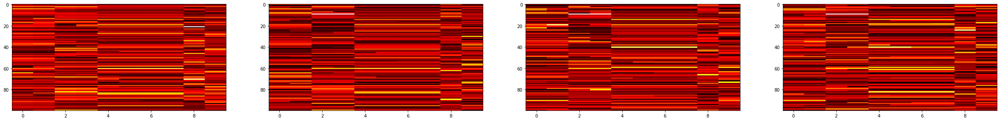

In [8]:
fig, axes = plt.subplots(1, 4, figsize=(40, 12))
for index, (dataset, ax) in enumerate(zip(differential_spicemix.datasets, axes.flatten())):
    M = dataset.uns["ground_truth_M"][f"{index}"]
    ax.imshow(M, cmap='hot', interpolation='nearest', aspect=0.05)
plt.show()

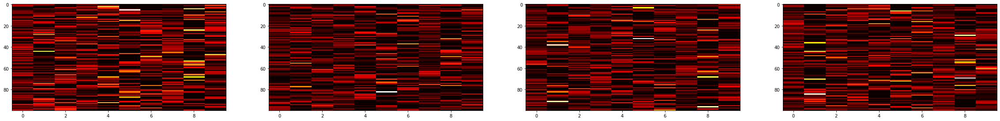

In [6]:
fig, axes = plt.subplots(1, 4, figsize=(40, 12))
for index, (dataset, ax) in enumerate(zip(differential_spicemix.datasets, axes.flatten())):
    M = dataset.uns["M"][f"{index}"].detach().cpu().numpy()
    ax.imshow(M, cmap='hot', interpolation='nearest', aspect=0.05)
plt.show()

array([8, 8, 8, 5, 8, 8, 8, 8, 8, 1])

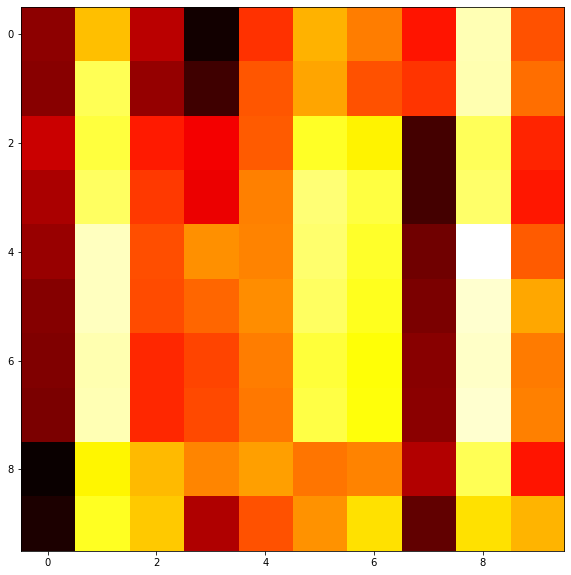

In [32]:
replicate = 3
num_genes, num_metagenes = differential_spicemix.datasets[replicate].uns["ground_truth_M"][f"{replicate}"].shape
distance_matrix = np.zeros((num_metagenes, num_metagenes))
for i, ground_truth_metagene in enumerate(differential_spicemix.datasets[replicate].uns["ground_truth_M"][f"{replicate}"].T):
    for j, discovered_metagene in enumerate(differential_spicemix.datasets[replicate].uns["M"][f"{replicate}"].detach().cpu().numpy().T):
        distance = np.linalg.norm(ground_truth_metagene - discovered_metagene) / np.linalg.norm(discovered_metagene)
        distance_matrix[i, j] = distance
        
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(distance_matrix, cmap="hot")
distance_matrix.argmax(axis=1)

## ARI Test (Comparison with old SpiceMix)


In [16]:
from scipy.stats import zscore     
from sklearn.metrics import adjusted_rand_score as ari

path2datasets = Path('../../data/synthetic_cortex/old/')
num_fovs = 1
spicemixplus_ari_scores = []
nmf_ari_scores = []
for path2dataset in path2datasets.glob("synthetic_500_100_15_20_0_0_i*/"):    
    spicemixplus = SpiceMixPlus(
        K=20, lambda_Sigma_x_inv=1e-1,
        repli_list=np.arange(num_fovs),
        metagene_mode="shared",
        context=dict(device='cuda:0', dtype=torch.float32),
        context_Y=dict(dtype=torch.float32, device='cuda:0'),
        prior_x_modes = [None] * num_fovs
    )
    
    nmf = SpiceMixPlus(
        K=20, lambda_Sigma_x_inv=1e-1,
        repli_list=np.arange(num_fovs),
        metagene_mode="shared",
        context=dict(device='cuda:0', dtype=torch.float32),
        context_Y=dict(dtype=torch.float32, device='cuda:0'),
        prior_x_modes = [None] * num_fovs
    )   

    spicemixplus.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.h5ad")
    nmf.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.h5ad")
    
    spicemixplus.initialize(
        method='svd',
    )   
    nmf.initialize(
        method='svd',
    )   

    spicemixplus.initialize_Sigma_x_inv()
    
    torch.manual_seed(0)
    import numpy as np
    np.random.seed(0)
    for iteration in range(200): 
        print(f"----- Iteration {iteration} -----")
        spicemixplus.estimate_parameters(iiter=iteration, use_spatial=[True]*spicemixplus.num_repli)
        likelihood = spicemixplus.compute_likelihood_function(use_spatial=[True]*spicemixplus.num_repli)
        print(f"Likelihood after parameter updates: {likelihood}")

        spicemixplus.estimate_weights(iiter=iteration, use_spatial=[True]*spicemixplus.num_repli)
        likelihood = spicemixplus.compute_likelihood_function(use_spatial=[True]*spicemixplus.num_repli)
        print(f"Likelihood after weight update: {likelihood}")

    torch.manual_seed(0)
    import numpy as np
    np.random.seed(0)
    for iteration in range(200): 
        print(f"----- Iteration {iteration} -----")
        nmf.estimate_parameters(iiter=iteration, use_spatial=[False]*nmf.num_repli)
        likelihood = nmf.compute_likelihood_function(use_spatial=[False]*nmf.num_repli)
        print(f"Likelihood after parameter updates: {likelihood}")

        nmf.estimate_weights(iiter=iteration, use_spatial=[False]*nmf.num_repli, backend_algorithm="gd")
        likelihood = nmf.compute_likelihood_function(use_spatial=[False]*nmf.num_repli)
        print(f"Likelihood after weight update: {likelihood}")
    
    # Saving results
    replicate_names, datasets = zip(*enumerate(spicemixplus.datasets))
    save_anndata(path2dataset/ "spicemixplus_test_200_iterations.h5ad", datasets, replicate_names)
    spicemixplus_dataset = load_anndata(path2dataset/ "spicemixplus_test_200_iterations.h5ad", replicate_names)[0]

    replicate_names, datasets = zip(*enumerate(nmf.datasets))
    save_anndata(path2dataset/ "nmf_test_200_iterations.h5ad", datasets, replicate_names)
    nmf_dataset = load_anndata(path2dataset/ "nmf_test_200_iterations.h5ad", replicate_names)[0]

    # Clustering
    spicemixplus_dataset.obsm["learned_X"] = spicemixplus_dataset.obsm["X"]
    spicemixplus_dataset.obsm["normalized_learned_X"] = zscore(spicemixplus_dataset.obsm["learned_X"])
    nmf_dataset.obsm["learned_X"] = nmf_dataset.obsm["X"]
    nmf_dataset.obsm["normalized_learned_X"] = zscore(nmf_dataset.obsm["learned_X"])
    
    sc.pp.neighbors(spicemixplus_dataset, use_rep="normalized_learned_X")
    sc.tl.leiden(spicemixplus_dataset, resolution=1)
    print(f'Num clusters: {len(spicemixplus_dataset.obs["leiden"].unique())}')
    
    sc.pp.neighbors(nmf_dataset, use_rep="normalized_learned_X")
    sc.tl.leiden(nmf_dataset, resolution=1)
    print(f'Num clusters: {len(nmf_dataset.obs["leiden"].unique())}')

    spicemixplus_ari_score = ari(spicemixplus_dataset.obs["cell_type"], spicemixplus_dataset.obs["leiden"])
    spicemixplus_ari_scores.append(spicemixplus_ari_score)

    nmf_ari_score = ari(nmf_dataset.obs["cell_type"], nmf_dataset.obs["leiden"])
    nmf_ari_scores.append(nmf_ari_score)

Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 454200.21875
M regularization term: 0.0
M constant term: 291192.5441690147
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108145.5078, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1850954.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108288.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(4087.9363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1829870.875
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 385842.59375
M regularization term: 0.0
M constant term: 390157.239087731
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159952.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1799591.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160868.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21205.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1794891.875
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3207686.75
M regularization term: 0.0
M constant term: 3250785.19794949
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166502.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934692.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1793119.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167555.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934692.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23574.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1790643.125
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4133196.75
M regularization term: 0.0
M constant term: 4183534.9570393753
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169538.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934592.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789982.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169828., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934592.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24330.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789025.75
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4556252.5
M regularization term: 0.0
M constant term: 4607549.521685411
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170971.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934592.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788551.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934592.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24630.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788305.0
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4772072.0
M regularization term: 0.0
M constant term: 4823169.186787966
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171493.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934160.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787597.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172259.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934160.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24755.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786587.875
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4899659.5
M regularization term: 0.0
M constant term: 4950429.499757045
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172249.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934141.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786824.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172657.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934141.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24815.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786232.75
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4987887.5
M regularization term: 0.0
M constant term: 5038364.748187587
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172993.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934141.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786081.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173508.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934141.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24850.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785417.875
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5056237.0
M regularization term: 0.0
M constant term: 5106538.183515069
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173488.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785696.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173166.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24872.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785892.25
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5112837.5
M regularization term: 0.0
M constant term: 5163003.11977381
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173401.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785784.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173721.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24888.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785353.5
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5161783.0
M regularization term: 0.0
M constant term: 5211839.176109622
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173928.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785258.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173758.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24901.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785330.125
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5205078.0
M regularization term: 0.0
M constant term: 5255132.777656725
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173940., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785248.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174588.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934246.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24914.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784514.375
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5243312.5
M regularization term: 0.0
M constant term: 5293339.737643927
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174420.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934345., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784866.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174933., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934345., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24923.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784278.375
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5276849.0
M regularization term: 0.0
M constant term: 5326836.572666393
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174876.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933616.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783671.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175229.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933616.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24932.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783252.0
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5306836.0
M regularization term: 0.0
M constant term: 5356901.918998819
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175351.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933616.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783197.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175814.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933616.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24940.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782675.375
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5333140.0
M regularization term: 0.0
M constant term: 5383215.137504961
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175123.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933996.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783783.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175761., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933996.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24947.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783094.625
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5356498.0
M regularization term: 0.0
M constant term: 5406503.679491986
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175454.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934156.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783611.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176087.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934156.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24952.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782932.75
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5376941.5
M regularization term: 0.0
M constant term: 5426848.2335920725
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176104.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934131.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782934.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176439.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934131.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24957.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782557.875
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5395170.5
M regularization term: 0.0
M constant term: 5445032.6752617275
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176382.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782598.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176974.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24961.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781968.375
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5411581.0
M regularization term: 0.0
M constant term: 5461407.419964007
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176026.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934182., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783062.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176745.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934182., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24964.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782310.125
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5426313.0
M regularization term: 0.0
M constant term: 5476176.162899626
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176595.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934187.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782497.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177125.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934187.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781936.75
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5439777.0
M regularization term: 0.0
M constant term: 5489693.566570565
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176751.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933946.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782082.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176787.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933946.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782020.0
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5451757.0
M regularization term: 0.0
M constant term: 5501772.714549971
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176835.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933946.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782000.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176692.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933946.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782117.5
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5462222.0
M regularization term: 0.0
M constant term: 5512241.7717092
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176504.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933955., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782339.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176789.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933955., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782031.125
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5472064.5
M regularization term: 0.0
M constant term: 5522091.220502017
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176831.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933955., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782013.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177068.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933955., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781754.0
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5481296.5
M regularization term: 0.0
M constant term: 5531354.816377792
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176143.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782988.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176529.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782582.0
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5489940.0
M regularization term: 0.0
M constant term: 5539966.925543657
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176565.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782566.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176691.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782420.875
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5498094.5
M regularization term: 0.0
M constant term: 5548119.903716085
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176628.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934332.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782596.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176737.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934332.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782469.0
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5505870.0
M regularization term: 0.0
M constant term: 5555900.457235121
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176770.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934332.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782455.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177180.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934332.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782027.5
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5513274.0
M regularization term: 0.0
M constant term: 5563302.6082028905
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176130.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933918.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782678.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177018., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933918.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.4922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781773.75
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5520288.0
M regularization term: 0.0
M constant term: 5570372.244507624
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176446.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782512.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176579.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782363.625
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5526833.5
M regularization term: 0.0
M constant term: 5576914.226873307
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176607.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782352.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176044.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782899.625
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5533108.5
M regularization term: 0.0
M constant term: 5583190.900727956
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176071.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782888.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177256.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781688.25
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5539108.0
M regularization term: 0.0
M constant term: 5589170.380607639
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177282.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781677.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177009.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934068.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781936.875
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5544948.5
M regularization term: 0.0
M constant term: 5595023.759539898
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176795.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782314.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176990.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782104.25
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5550551.0
M regularization term: 0.0
M constant term: 5600602.801555364
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177015.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782094.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177365.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781729.625
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5556040.0
M regularization term: 0.0
M constant term: 5606068.501312099
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177390.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781719.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177015.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782081.375
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5561487.0
M regularization term: 0.0
M constant term: 5611505.194656601
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177038.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782072.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177539.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934216.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781558.0
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5566677.5
M regularization term: 0.0
M constant term: 5616703.9133795565
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177106.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934155.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781944.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177153.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934155.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781885.375
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5571628.0
M regularization term: 0.0
M constant term: 5621637.397336387
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176992.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933711.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781612.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177641.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933711.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780951.875
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5576355.0
M regularization term: 0.0
M constant term: 5626384.336263191
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176952.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933800.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781742.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177371.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933800.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781312.375
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5580789.0
M regularization term: 0.0
M constant term: 5630798.825263495
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176817.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933685.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781763.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177153.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933685.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781416.625
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5585082.0
M regularization term: 0.0
M constant term: 5635092.240651871
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177103.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933615.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781411.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177239.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933615.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781265.5
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5589234.5
M regularization term: 0.0
M constant term: 5639225.961680664
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177029.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781579.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177544.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781053.75
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5593253.0
M regularization term: 0.0
M constant term: 5643244.060610199
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176846.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933870.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781926.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177407.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933870.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781356.375
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5597099.0
M regularization term: 0.0
M constant term: 5647083.277614484
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177086.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933831.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781648.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177642.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933831.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781083.25
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5600840.0
M regularization term: 0.0
M constant term: 5650781.37020889
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177147.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933874.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781631.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177237.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933874.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781531.75
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5604460.5
M regularization term: 0.0
M constant term: 5654415.527634221
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177363.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933769.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781302.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177519.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933769.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781138.625
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5607931.0
M regularization term: 0.0
M constant term: 5657910.615746499
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177678.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780829.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178080., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780419.5
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5611159.0
M regularization term: 0.0
M constant term: 5661144.58299235
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178093.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780414.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178205.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780294.0
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5614236.0
M regularization term: 0.0
M constant term: 5664220.198938299
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177467.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933247.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780678.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178201.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933247.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779936.625
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5617198.5
M regularization term: 0.0
M constant term: 5667223.193602635
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177613.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933162.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780452.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178006.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933162.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780051.875
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5620147.5
M regularization term: 0.0
M constant term: 5670164.393230516
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178019.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933162.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780047.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178164.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933162.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779894.625
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5623075.5
M regularization term: 0.0
M constant term: 5673076.684227736
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177598.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780660.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177466.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780784.375
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5625957.5
M regularization term: 0.0
M constant term: 5675967.34332247
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177479.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780779.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177716.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780535.0
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5628797.0
M regularization term: 0.0
M constant term: 5678811.504916893
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177329.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780654.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177988.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779988.125
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5631599.5
M regularization term: 0.0
M constant term: 5681604.46298903
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178000.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779983.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178327.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779650.0
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5634332.0
M regularization term: 0.0
M constant term: 5684329.535393519
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178339.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779645.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178297.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779680.625
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5637043.0
M regularization term: 0.0
M constant term: 5687073.146923721
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177520.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932986.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780381.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178471.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932986.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779423.5
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5639725.0
M regularization term: 0.0
M constant term: 5689735.795419228
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178483.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932986.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779418.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178547.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932986.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779348.125
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5642479.0
M regularization term: 0.0
M constant term: 5692484.244772492
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177760., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933221.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780374.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178162.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933221.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779964.25
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5645197.5
M regularization term: 0.0
M constant term: 5695246.684990451
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177786.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933204., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780330.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178043.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933204., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780067.0
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5647908.0
M regularization term: 0.0
M constant term: 5697940.938511593
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178056.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933204., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780061.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178292.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933204., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779818.875
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5650650.0
M regularization term: 0.0
M constant term: 5700711.973802194
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177911.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780085.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178251.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779738.5
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5653340.5
M regularization term: 0.0
M constant term: 5703417.506758504
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178167.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779539.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178355.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779344.25
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5656045.5
M regularization term: 0.0
M constant term: 5706110.156008177
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178328.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932802.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779391.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178905.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932802.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778807.875
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5658739.5
M regularization term: 0.0
M constant term: 5708844.543334572
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178917.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932802.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778803.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178564.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932802.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779148.75
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5661447.0
M regularization term: 0.0
M constant term: 5711551.233758785
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178576.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932802.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779143.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179001.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932802.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778712.25
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5664155.0
M regularization term: 0.0
M constant term: 5714287.678306028
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178415.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779269.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178953.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778725.0
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5666843.0
M regularization term: 0.0
M constant term: 5717011.2372234715
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178965.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778720.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178985.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778693.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5669548.0
M regularization term: 0.0
M constant term: 5719718.164728355
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178997.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778688.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179099.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778579.125
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5672270.5
M regularization term: 0.0
M constant term: 5722453.974008669
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179111.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778574.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178747.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778931.5
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5675024.0
M regularization term: 0.0
M constant term: 5725215.003774375
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178759.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778926.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179004.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932766.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778674.375
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5677804.0
M regularization term: 0.0
M constant term: 5728009.685144228
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178362.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932994.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779554.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178694.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932994.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779215.75
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5680598.0
M regularization term: 0.0
M constant term: 5730817.593134225
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178475.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932953.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779401.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179086.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932953.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778783.25
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5683488.0
M regularization term: 0.0
M constant term: 5733707.748432241
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178812.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932831.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778943.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178712.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932831.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779035.75
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5686404.5
M regularization term: 0.0
M constant term: 5736621.551186894
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178725.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932831.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779030.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179162.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932831.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778586.0
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5689334.0
M regularization term: 0.0
M constant term: 5739563.721641585
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178963.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932898.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778860.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179254.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932898.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778562.875
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5692305.0
M regularization term: 0.0
M constant term: 5742525.91180734
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178956.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932839.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778820.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179520.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932839.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778248.875
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5695282.0
M regularization term: 0.0
M constant term: 5745469.820620882
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179533.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932839.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778243.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179620.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932839.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778149.25
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5698339.0
M regularization term: 0.0
M constant term: 5748547.029031728
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179460.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778132.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179416.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778170.0
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5701269.0
M regularization term: 0.0
M constant term: 5751525.544330187
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179428.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778164.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179492.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778093.875
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5704041.0
M regularization term: 0.0
M constant term: 5754295.457445342
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179504.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778088.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179733.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777853.625
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5706846.0
M regularization term: 0.0
M constant term: 5757079.566857956
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179745.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777848.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179778.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777808.75
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5709632.0
M regularization term: 0.0
M constant term: 5759861.003584089
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179790., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777803.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179616.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777970.75
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5712338.0
M regularization term: 0.0
M constant term: 5762561.787816534
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179628., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777966.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180179.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932665.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777408.0
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5714948.0
M regularization term: 0.0
M constant term: 5765162.946103733
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179948.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932732.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777707.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180444.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932732.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777205.75
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5717433.5
M regularization term: 0.0
M constant term: 5767670.858521807
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180454.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932732.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777201.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180072.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932732.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777577.5
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5719791.5
M regularization term: 0.0
M constant term: 5770019.453884005
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180082.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932732.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777573.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180677.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932732.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3750, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776973.25
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5722082.5
M regularization term: 0.0
M constant term: 5772281.897091672
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179199.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778374.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179924.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777643.5
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5724318.0
M regularization term: 0.0
M constant term: 5774501.381562032
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179934.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777639.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179871.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777697.375
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5726468.0
M regularization term: 0.0
M constant term: 5776639.17458924
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179880.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777693.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180244.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777324.25
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5728558.5
M regularization term: 0.0
M constant term: 5778705.515806742
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179581.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932503.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777847.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180274.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932503.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777150.125
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5730603.0
M regularization term: 0.0
M constant term: 5780724.829201906
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179922.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932444.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777447.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180422.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932444.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776942.375
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5732624.0
M regularization term: 0.0
M constant term: 5782703.650203026
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180299.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932477., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777103.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180291.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932477., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777106.875
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5734594.0
M regularization term: 0.0
M constant term: 5784656.087721814
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179624.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932718.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778021.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180282.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932718.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777358.5
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5736499.0
M regularization term: 0.0
M constant term: 5786558.468722088
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180216.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932788.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777500.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180408.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932788.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777304.0
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5738350.5
M regularization term: 0.0
M constant term: 5788391.803663596
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180413.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777222.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180526.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777105.25
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5740208.5
M regularization term: 0.0
M constant term: 5790232.633279602
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180533.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777102.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180777.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776853.875
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5741988.5
M regularization term: 0.0
M constant term: 5792009.970682441
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180785.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776850.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180542.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777089.25
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5743732.0
M regularization term: 0.0
M constant term: 5793744.562367295
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180549.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777086.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180426.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777205.25
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5745435.5
M regularization term: 0.0
M constant term: 5795440.139943672
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180433.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777202.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180379.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777253.25
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5747104.5
M regularization term: 0.0
M constant term: 5797101.390784622
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180386.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777250.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180438.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8320, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777194.0
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5748741.5
M regularization term: 0.0
M constant term: 5798731.114871569
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180445.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777191.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180786.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776846.375
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5750347.0
M regularization term: 0.0
M constant term: 5800328.323161091
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180793.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776843.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181048.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932708.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776584.75
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5751917.0
M regularization term: 0.0
M constant term: 5801893.923917321
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180773.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932729.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776884.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180492.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932729.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777161.375
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5753472.0
M regularization term: 0.0
M constant term: 5803431.675974634
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180296.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932720.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777352.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180394.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932720.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777250.625
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5754967.0
M regularization term: 0.0
M constant term: 5804939.64612016
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180401.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932720.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777248.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180172.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932720.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777473.75
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5756437.5
M regularization term: 0.0
M constant term: 5806403.546890607
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180178.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932720.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777471.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180442.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932720.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777203.5
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5757888.5
M regularization term: 0.0
M constant term: 5807847.090382836
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179953.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932703.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777679.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180192.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932703.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777436.5
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5759320.0
M regularization term: 0.0
M constant term: 5809269.302626107
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180198.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932703.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777434.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179844.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932703.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777784.25
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5760731.0
M regularization term: 0.0
M constant term: 5810673.964567092
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179850.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932703.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777782.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180211.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932703.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777418.25
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5762120.0
M regularization term: 0.0
M constant term: 5812058.202184296
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179892.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932675.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777712.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180317.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932675.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777284.5
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5763485.0
M regularization term: 0.0
M constant term: 5813421.04140812
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180323.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932675.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777282.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180516.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932675.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777085.75
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5764836.0
M regularization term: 0.0
M constant term: 5814766.268171759
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179986.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777613.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180031.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777564.0
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5766187.5
M regularization term: 0.0
M constant term: 5816096.721440586
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180037.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777561.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180866.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776729.5
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5767535.5
M regularization term: 0.0
M constant term: 5817439.065661286
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180828.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776760.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181188.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776396.75
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5768868.5
M regularization term: 0.0
M constant term: 5818757.091850802
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181194.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776394.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180982.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776602.75
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5770196.0
M regularization term: 0.0
M constant term: 5820083.194070509
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180988.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776600.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181426.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776159.5
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5771498.0
M regularization term: 0.0
M constant term: 5821382.088600314
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181431.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776157.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181876.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775709.75
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5772779.0
M regularization term: 0.0
M constant term: 5822662.33512521
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181538.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776047.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181334.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776248.125
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5773989.5
M regularization term: 0.0
M constant term: 5823923.914950917
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181339.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776246.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181419.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776163.375
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5775163.0
M regularization term: 0.0
M constant term: 5825092.339315596
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181424.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776161.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181388.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932657.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776194.75
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5776338.0
M regularization term: 0.0
M constant term: 5826262.070364325
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181030.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932669.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776568.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181278.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932669.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776317.0
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5777501.0
M regularization term: 0.0
M constant term: 5827414.002863532
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181283.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932669.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776315.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181079.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932669.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776516.25
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5778641.5
M regularization term: 0.0
M constant term: 5828548.12080326
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181084.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932669.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776514.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181700.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932669.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775895.75
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5779767.0
M regularization term: 0.0
M constant term: 5829669.187733252
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180867.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932814., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776873.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181042.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932814., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776695.625
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5780827.0
M regularization term: 0.0
M constant term: 5830777.192198064
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180744.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932589.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776774.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181473.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932589.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776042.625
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5781978.0
M regularization term: 0.0
M constant term: 5831843.430797428
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181068.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932444.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776309.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181286.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932444.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776087.875
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5783144.0
M regularization term: 0.0
M constant term: 5832976.928757397
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181291.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932444.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776086.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181853.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932444.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775521.125
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5784306.5
M regularization term: 0.0
M constant term: 5834138.509060359
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181281.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932539.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776192.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181699.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932539.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775771.875
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5785475.0
M regularization term: 0.0
M constant term: 5835268.8472694205
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181704.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932539.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775770.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181568.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932539.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775902.5
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5786597.0
M regularization term: 0.0
M constant term: 5836389.938819678
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181405.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932509.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776039.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181529.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932509.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775913.0
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5787710.0
M regularization term: 0.0
M constant term: 5837494.113236886
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181296.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932487.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776125.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181648.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932487.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775771.0
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5788812.0
M regularization term: 0.0
M constant term: 5838599.559089694
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181653.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932487.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775769.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181946.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932487.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775473.375
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5789895.0
M regularization term: 0.0
M constant term: 5839684.2356979335
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181951.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932487.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775471.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181867.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932487.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775552.875
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790962.0
M regularization term: 0.0
M constant term: 5840751.001324477
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181638.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775735.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182057.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775313.125
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5791996.0
M regularization term: 0.0
M constant term: 5841799.8411075855
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181338.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775993.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181460.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775868.375
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5793059.0
M regularization term: 0.0
M constant term: 5842855.6771890735
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181464.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775866.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181634.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775694.625
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5794092.0
M regularization term: 0.0
M constant term: 5843887.815384298
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181638.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775693.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181844.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775485.125
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795107.0
M regularization term: 0.0
M constant term: 5844901.994402838
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180919.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776392.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181279.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776029.75
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5796106.0
M regularization term: 0.0
M constant term: 5845901.079676912
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181007.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932474.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776404.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181547.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932474.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775862.25
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5797056.5
M regularization term: 0.0
M constant term: 5846858.176734661
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181108.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932511.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776341.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181058.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932511.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776388.5
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5797994.0
M regularization term: 0.0
M constant term: 5847811.667536259
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180649.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932861.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777156.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181274.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932861.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776528.125
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5799077.0
M regularization term: 0.0
M constant term: 5848743.298671416
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181279.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932861.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776526.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181875.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932861.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775927.875
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5800172.0
M regularization term: 0.0
M constant term: 5849846.176611131
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181068.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777363.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181159.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777270.0
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5801010.5
M regularization term: 0.0
M constant term: 5850889.778614473
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181163.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777268.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181415.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777014.625
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5801794.0
M regularization term: 0.0
M constant term: 5851665.453795014
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181418.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777013.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181303.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777126.75
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5802632.0
M regularization term: 0.0
M constant term: 5852494.164465763
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181306.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777125.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181539.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933494.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776890.625
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5803452.0
M regularization term: 0.0
M constant term: 5853304.779168609
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181275.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933362.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777024.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181507.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933362.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776789.75
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5804252.0
M regularization term: 0.0
M constant term: 5854102.095958942
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181014.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933570., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777489.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181276.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933570., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777225.875
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5804974.5
M regularization term: 0.0
M constant term: 5854882.2583383415
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180782.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933399.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777551.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181226.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933399.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777105.75
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5805623.5
M regularization term: 0.0
M constant term: 5855505.7307548
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181229.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933399.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777104.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181113.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933399.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777218.875
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5806287.0
M regularization term: 0.0
M constant term: 5856162.986186971
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180872.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933528.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777590.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181094.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933528.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777367.625
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5806925.0
M regularization term: 0.0
M constant term: 5856807.83916053
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181097.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933528.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777366.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181207.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933528.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777254.875
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5807565.0
M regularization term: 0.0
M constant term: 5857440.283499323
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180515.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933419.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777841.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180830.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933419.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777524.875
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5808247.0
M regularization term: 0.0
M constant term: 5858067.053138343
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180832.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933419.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777523.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933419.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777114.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5808882.0
M regularization term: 0.0
M constant term: 5858704.516525067
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180659.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933047.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777325.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180726.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933047.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777256.625
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5809513.0
M regularization term: 0.0
M constant term: 5859324.746921654
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180728.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933047.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777255.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180906.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933047.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777076.375
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5810140.0
M regularization term: 0.0
M constant term: 5859952.7823827155
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180595.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932832.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777173.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181242.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932832.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776525.625
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5810744.5
M regularization term: 0.0
M constant term: 5860566.466697002
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180633.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776972.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181180.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776424.5
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5811386.0
M regularization term: 0.0
M constant term: 5861186.0291710505
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181183.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776423.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181330.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776274.75
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5812024.0
M regularization term: 0.0
M constant term: 5861824.965524267
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181333., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776273.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180886.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776718.625
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5812647.5
M regularization term: 0.0
M constant term: 5862447.619392416
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180889.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776717.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181417.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776187.75
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5813264.0
M regularization term: 0.0
M constant term: 5863063.623844793
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181143.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932685.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776481.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181589.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932685.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776033.5
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5813884.5
M regularization term: 0.0
M constant term: 5863672.975711177
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181591.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932685.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776032.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181808.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932685.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775814.5
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5814496.0
M regularization term: 0.0
M constant term: 5864282.422577978
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181091.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776562.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181543.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776108.25
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5815090.0
M regularization term: 0.0
M constant term: 5864884.248150995
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181546.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776107.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182342.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775309.25
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5815708.5
M regularization term: 0.0
M constant term: 5865502.566082544
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182345.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775308.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181722.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775929.625
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5816313.0
M regularization term: 0.0
M constant term: 5866105.544336581
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181725.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775928.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182003.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932715.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775648.875
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5816911.0
M regularization term: 0.0
M constant term: 5866703.790636428
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181638.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932834.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776134.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181925.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932834.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775846.125
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5817524.0
M regularization term: 0.0
M constant term: 5867293.4422541335
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181150.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776668.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181628.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776189.375
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5818108.0
M regularization term: 0.0
M constant term: 5867898.627255087
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181504.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932922., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776357.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181914.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932922., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775945.875
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5818726.0
M regularization term: 0.0
M constant term: 5868476.8739092825
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181752.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932561.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775740.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182165.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932561.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775326.25
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5819218.0
M regularization term: 0.0
M constant term: 5869075.483009972
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181770.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932594.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775754.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182043.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932594.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775480.625
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5819586.5
M regularization term: 0.0
M constant term: 5869446.280384938
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182108.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932455.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775284.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182651.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932455.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774738.625
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5820082.0
M regularization term: 0.0
M constant term: 5869867.33250535
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182379.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932426.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774982.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182736.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932426.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774624.0
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5820623.0
M regularization term: 0.0
M constant term: 5870410.131667985
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182738.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932426.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774623.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183089.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932426.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774271.125
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821130.0
M regularization term: 0.0
M constant term: 5870923.059130173
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182182.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775250.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183123.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774307.625
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821622.5
M regularization term: 0.0
M constant term: 5871426.392282753
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183125.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774307.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182324.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775106.5
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5822096.0
M regularization term: 0.0
M constant term: 5871902.7345075905
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182326.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775105.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182714.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774716.625
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5822571.5
M regularization term: 0.0
M constant term: 5872378.168314767
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182716.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774715.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182814.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774616.625
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5823046.0
M regularization term: 0.0
M constant term: 5872853.659866375
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182317.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775421.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182645.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775091.875
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5823507.0
M regularization term: 0.0
M constant term: 5873326.309305856
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182647.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775091.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182554.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775182.625
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5823984.0
M regularization term: 0.0
M constant term: 5873803.84950067
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182556.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775182.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182206.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775530.75
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5824452.5
M regularization term: 0.0
M constant term: 5874275.64679842
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182208.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775530.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182804.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774932.5
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5824918.5
M regularization term: 0.0
M constant term: 5874742.666082788
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182572.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932616.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774979.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183026.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932616.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774523.875
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5825407.0
M regularization term: 0.0
M constant term: 5875206.839804387
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183072.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774406.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182949.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774528.125
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5825900.0
M regularization term: 0.0
M constant term: 5875691.3798043905
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182951.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774527.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183349.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774127.875
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5826387.5
M regularization term: 0.0
M constant term: 5876179.849050997
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183351.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774127.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183179.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774298.375
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5826865.5
M regularization term: 0.0
M constant term: 5876659.672201356
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183181.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774297.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183407.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932543.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774070.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5827344.5
M regularization term: 0.0
M constant term: 5877139.55412451
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182807.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774841.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182380.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775268.0
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5827821.5
M regularization term: 0.0
M constant term: 5877615.624105347
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182382.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775267.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183006.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774641.5
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5828299.5
M regularization term: 0.0
M constant term: 5878095.6231287075
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183008.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774640.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183223.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774424.625
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5828772.0
M regularization term: 0.0
M constant term: 5878570.8413675735
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182870.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932797., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774862.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183080.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932797., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774651.0
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5829297.0
M regularization term: 0.0
M constant term: 5879043.21313684
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183082.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932797., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774650.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183390.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932797., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774341.125
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5829808.5
M regularization term: 0.0
M constant term: 5879561.145156626
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183020.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774812.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182405.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775425.75
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5830296.0
M regularization term: 0.0
M constant term: 5880059.779887517
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182407.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775425.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182910.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774921.375
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5830764.0
M regularization term: 0.0
M constant term: 5880531.362735963
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182912.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774920.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182773.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775058.375
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5831233.0
M regularization term: 0.0
M constant term: 5881004.9393535415
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182775.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775057.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182257.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932897., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775574.25
----- Iteration 0 -----
M quadratic term: 455235.375
M regularization term: 0.0
M constant term: 292289.74289976223
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-103668.3984, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -78668.3984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-103668.3984, device='cuda:0')
0
tensor(3939.1431, device='cuda:0')
tensor(0)
Likelihood after weight update: -99729.2578125
----- Iteration 1 -----
M quadratic term: 389043.8125
M regularization term: 0.0
M constant term: 391736.4217627829
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158578.5781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -133578.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158578.5781, device='cuda:0')
0
tensor(21700.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -136877.953125
----- Iteration 2 -----
M quadratic term: 3482258.25
M regularization term: 0.0
M constant term: 3522748.4981450797
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163986.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -138986.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163986.8750, device='cuda:0')
0
tensor(23802.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -140184.25
----- Iteration 3 -----
M quadratic term: 4326777.0
M regularization term: 0.0
M constant term: 4373537.852542272
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166066.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141066.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166066.2812, device='cuda:0')
0
tensor(24384.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: -141681.78125
----- Iteration 4 -----
M quadratic term: 4703774.0
M regularization term: 0.0
M constant term: 4752874.9009874305
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167136.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142136.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167136.0938, device='cuda:0')
0
tensor(24657.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: -142478.34375
----- Iteration 5 -----
M quadratic term: 4910601.0
M regularization term: 0.0
M constant term: 4960674.858933154
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167753.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142753.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167753.4688, device='cuda:0')
0
tensor(24774.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -142979.203125
----- Iteration 6 -----
M quadratic term: 5034497.5
M regularization term: 0.0
M constant term: 5084703.965847979
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168169.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143169.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168169.1250, device='cuda:0')
0
tensor(24835.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -143333.859375
----- Iteration 7 -----
M quadratic term: 5119864.0
M regularization term: 0.0
M constant term: 5169952.396164308
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168477.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143477.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168477.6250, device='cuda:0')
0
tensor(24871.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: -143606.515625
----- Iteration 8 -----
M quadratic term: 5184214.5
M regularization term: 0.0
M constant term: 5234139.653719398
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168721.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143721.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168721.3750, device='cuda:0')
0
tensor(24896.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -143825.25
----- Iteration 9 -----
M quadratic term: 5235628.0
M regularization term: 0.0
M constant term: 5285424.78308517
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168918.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143918.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168918.2188, device='cuda:0')
0
tensor(24914.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: -144003.765625
----- Iteration 10 -----
M quadratic term: 5277487.5
M regularization term: 0.0
M constant term: 5327203.11260077
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169080.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144080.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169080.7812, device='cuda:0')
0
tensor(24928.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: -144152.390625
----- Iteration 11 -----
M quadratic term: 5312256.0
M regularization term: 0.0
M constant term: 5361959.049955904
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169218.0625, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144218.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169218.0625, device='cuda:0')
0
tensor(24937.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: -144280.6875
----- Iteration 12 -----
M quadratic term: 5341792.5
M regularization term: 0.0
M constant term: 5391482.621501854
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169339.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144339.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169339.1562, device='cuda:0')
0
tensor(24943.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -144395.53125
----- Iteration 13 -----
M quadratic term: 5368011.5
M regularization term: 0.0
M constant term: 5417660.843893469
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169447.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144447.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169447.8125, device='cuda:0')
0
tensor(24949.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: -144498.03125
----- Iteration 14 -----
M quadratic term: 5391671.0
M regularization term: 0.0
M constant term: 5441261.429353599
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169544.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144544.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169544.5625, device='cuda:0')
0
tensor(24955.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -144589.5
----- Iteration 15 -----
M quadratic term: 5412829.0
M regularization term: 0.0
M constant term: 5462359.221215702
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169631.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144631.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169631.5000, device='cuda:0')
0
tensor(24959.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: -144672.203125
----- Iteration 16 -----
M quadratic term: 5431905.0
M regularization term: 0.0
M constant term: 5481386.612568973
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169710.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144710.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169710.5312, device='cuda:0')
0
tensor(24962.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -144748.078125
----- Iteration 17 -----
M quadratic term: 5449292.0
M regularization term: 0.0
M constant term: 5498743.501080266
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169783.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144783.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169783.6562, device='cuda:0')
0
tensor(24965.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -144818.578125
----- Iteration 18 -----
M quadratic term: 5465405.5
M regularization term: 0.0
M constant term: 5514845.89530447
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169851.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144851.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169851.6250, device='cuda:0')
0
tensor(24967.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: -144884.28125
----- Iteration 19 -----
M quadratic term: 5480443.5
M regularization term: 0.0
M constant term: 5529865.635503367
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169915.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144915.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169915.4062, device='cuda:0')
0
tensor(24969.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -144946.203125
----- Iteration 20 -----
M quadratic term: 5494594.0
M regularization term: 0.0
M constant term: 5543993.740084618
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169975.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144975.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169975.5625, device='cuda:0')
0
tensor(24970.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: -145004.65625
----- Iteration 21 -----
M quadratic term: 5507972.0
M regularization term: 0.0
M constant term: 5557347.676642582
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170032.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145032.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170032.3750, device='cuda:0')
0
tensor(24972.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: -145059.859375
----- Iteration 22 -----
M quadratic term: 5520644.5
M regularization term: 0.0
M constant term: 5569989.250896125
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170085.9531, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145085.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170085.9531, device='cuda:0')
0
tensor(24974.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: -145111.765625
----- Iteration 23 -----
M quadratic term: 5532624.0
M regularization term: 0.0
M constant term: 5581939.554703966
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170136.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145136.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170136.3125, device='cuda:0')
0
tensor(24975.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -145160.671875
----- Iteration 24 -----
M quadratic term: 5543915.0
M regularization term: 0.0
M constant term: 5593197.072158311
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170183.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145183.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170183.9062, device='cuda:0')
0
tensor(24976.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -145206.96875
----- Iteration 25 -----
M quadratic term: 5554612.5
M regularization term: 0.0
M constant term: 5603855.316627318
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170229.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145229.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170229.0938, device='cuda:0')
0
tensor(24977.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -145251.109375
----- Iteration 26 -----
M quadratic term: 5564758.0
M regularization term: 0.0
M constant term: 5613986.6707581505
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170272.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145272.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170272.1250, device='cuda:0')
0
tensor(24979.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -145293.03125
----- Iteration 27 -----
M quadratic term: 5574428.0
M regularization term: 0.0
M constant term: 5623659.161044645
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170312.8438, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145312.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170312.8438, device='cuda:0')
0
tensor(24980.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: -145332.53125
----- Iteration 28 -----
M quadratic term: 5583606.0
M regularization term: 0.0
M constant term: 5632831.88868727
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170351.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145351.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170351.2500, device='cuda:0')
0
tensor(24981.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -145369.75
----- Iteration 29 -----
M quadratic term: 5592262.0
M regularization term: 0.0
M constant term: 5641491.073817464
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170387.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145387.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170387.4219, device='cuda:0')
0
tensor(24982.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: -145404.875
----- Iteration 30 -----
M quadratic term: 5600426.5
M regularization term: 0.0
M constant term: 5649658.611603466
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170421.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145421.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170421.5938, device='cuda:0')
0
tensor(24983.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: -145438.0625
----- Iteration 31 -----
M quadratic term: 5608150.0
M regularization term: 0.0
M constant term: 5657383.313180367
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170453.8906, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145453.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170453.8906, device='cuda:0')
0
tensor(24984.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: -145469.5625
----- Iteration 32 -----
M quadratic term: 5615452.0
M regularization term: 0.0
M constant term: 5664696.2693798775
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170484.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145484.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170484.6562, device='cuda:0')
0
tensor(24985.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -145499.65625
----- Iteration 33 -----
M quadratic term: 5622410.0
M regularization term: 0.0
M constant term: 5671675.752792733
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170514.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145514.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170514.1562, device='cuda:0')
0
tensor(24985.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -145528.65625
----- Iteration 34 -----
M quadratic term: 5629092.0
M regularization term: 0.0
M constant term: 5678368.571834888
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170542.5625, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145542.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170542.5625, device='cuda:0')
0
tensor(24986.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: -145556.40625
----- Iteration 35 -----
M quadratic term: 5635518.5
M regularization term: 0.0
M constant term: 5684825.632127632
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170569.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145569.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170569.7812, device='cuda:0')
0
tensor(24986.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -145583.1875
----- Iteration 36 -----
M quadratic term: 5641704.5
M regularization term: 0.0
M constant term: 5691018.034423145
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170596.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145596.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170596.0312, device='cuda:0')
0
tensor(24987.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: -145608.9375
----- Iteration 37 -----
M quadratic term: 5647676.5
M regularization term: 0.0
M constant term: 5696998.00937256
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170621.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145621.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170621.3438, device='cuda:0')
0
tensor(24987.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: -145633.796875
----- Iteration 38 -----
M quadratic term: 5653439.5
M regularization term: 0.0
M constant term: 5702769.150001678
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170645.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145645.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170645.7812, device='cuda:0')
0
tensor(24987.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: -145657.8125
----- Iteration 39 -----
M quadratic term: 5659002.0
M regularization term: 0.0
M constant term: 5708341.594548817
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170669.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145669.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170669.3438, device='cuda:0')
0
tensor(24988.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: -145680.984375
----- Iteration 40 -----
M quadratic term: 5664371.0
M regularization term: 0.0
M constant term: 5713732.070155961
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170692.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145692.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170692.1875, device='cuda:0')
0
tensor(24988.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: -145703.4375
----- Iteration 41 -----
M quadratic term: 5669576.0
M regularization term: 0.0
M constant term: 5718952.786906262
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170714.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145714.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170714.2344, device='cuda:0')
0
tensor(24989.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -145725.078125
----- Iteration 42 -----
M quadratic term: 5674607.5
M regularization term: 0.0
M constant term: 5723995.58938134
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170735.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145735.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170735.4688, device='cuda:0')
0
tensor(24989.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: -145745.9375
----- Iteration 43 -----
M quadratic term: 5679466.0
M regularization term: 0.0
M constant term: 5728861.618175529
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170755.9531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145755.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170755.9531, device='cuda:0')
0
tensor(24989.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: -145766.046875
----- Iteration 44 -----
M quadratic term: 5684154.5
M regularization term: 0.0
M constant term: 5733555.776772548
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170775.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145775.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170775.7500, device='cuda:0')
0
tensor(24990.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -145785.53125
----- Iteration 45 -----
M quadratic term: 5688688.0
M regularization term: 0.0
M constant term: 5738096.087276194
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170794.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145794.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170794.9219, device='cuda:0')
0
tensor(24990.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: -145804.421875
----- Iteration 46 -----
M quadratic term: 5693082.0
M regularization term: 0.0
M constant term: 5742501.614579777
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170813.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145813.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170813.5312, device='cuda:0')
0
tensor(24990.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -145822.734375
----- Iteration 47 -----
M quadratic term: 5697341.0
M regularization term: 0.0
M constant term: 5746776.5603869185
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170831.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145831.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170831.5781, device='cuda:0')
0
tensor(24991.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: -145840.515625
----- Iteration 48 -----
M quadratic term: 5701481.0
M regularization term: 0.0
M constant term: 5750926.097166049
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145849.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.0938, device='cuda:0')
0
tensor(24991.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: -145857.765625
----- Iteration 49 -----
M quadratic term: 5705511.0
M regularization term: 0.0
M constant term: 5754961.059363609
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170866.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145866.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170866.1250, device='cuda:0')
0
tensor(24991.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: -145874.5625
----- Iteration 50 -----
M quadratic term: 5709435.5
M regularization term: 0.0
M constant term: 5758883.892858757
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170882.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145882.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170882.7188, device='cuda:0')
0
tensor(24991.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -145890.890625
----- Iteration 51 -----
M quadratic term: 5713250.0
M regularization term: 0.0
M constant term: 5762702.701420551
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170898.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145898.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170898.7812, device='cuda:0')
0
tensor(24992.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -145906.671875
----- Iteration 52 -----
M quadratic term: 5716949.0
M regularization term: 0.0
M constant term: 5766404.943448302
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170914.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145914.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170914.2812, device='cuda:0')
0
tensor(24992.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: -145921.921875
----- Iteration 53 -----
M quadratic term: 5720520.0
M regularization term: 0.0
M constant term: 5769987.452163141
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170929.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145929.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170929.3438, device='cuda:0')
0
tensor(24992.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -145936.75
----- Iteration 54 -----
M quadratic term: 5723983.5
M regularization term: 0.0
M constant term: 5773460.250061276
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170943.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145943.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170943.9375, device='cuda:0')
0
tensor(24992.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -145951.125
----- Iteration 55 -----
M quadratic term: 5727347.5
M regularization term: 0.0
M constant term: 5776829.6352454685
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170958.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145958.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170958.1250, device='cuda:0')
0
tensor(24992.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -145965.15625
----- Iteration 56 -----
M quadratic term: 5730622.0
M regularization term: 0.0
M constant term: 5780109.487039607
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170971.9531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145971.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170971.9531, device='cuda:0')
0
tensor(24993.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: -145978.8125
----- Iteration 57 -----
M quadratic term: 5733816.0
M regularization term: 0.0
M constant term: 5783310.906303788
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170985.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145985.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170985.4688, device='cuda:0')
0
tensor(24993.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: -145992.15625
----- Iteration 58 -----
M quadratic term: 5736926.5
M regularization term: 0.0
M constant term: 5786436.529429555
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170998.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145998.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170998.6250, device='cuda:0')
0
tensor(24993.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -146005.125
----- Iteration 59 -----
M quadratic term: 5739961.0
M regularization term: 0.0
M constant term: 5789482.38448595
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171011.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146011.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171011.4375, device='cuda:0')
0
tensor(24993.6387, device='cuda:0')
tensor(0)
Likelihood after weight update: -146017.796875
----- Iteration 60 -----
M quadratic term: 5742917.0
M regularization term: 0.0
M constant term: 5792449.225910357
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171023.9531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146023.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171023.9531, device='cuda:0')
0
tensor(24993.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: -146030.1875
----- Iteration 61 -----
M quadratic term: 5745811.0
M regularization term: 0.0
M constant term: 5795352.974795824
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171036.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146036.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171036.2500, device='cuda:0')
0
tensor(24993.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -146042.375
----- Iteration 62 -----
M quadratic term: 5748651.0
M regularization term: 0.0
M constant term: 5798199.174756179
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171048.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146048.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171048.2812, device='cuda:0')
0
tensor(24993.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146054.28125
----- Iteration 63 -----
M quadratic term: 5751438.0
M regularization term: 0.0
M constant term: 5800992.440017924
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171060.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146060.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171060.0938, device='cuda:0')
0
tensor(24994.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146066.0
----- Iteration 64 -----
M quadratic term: 5754177.0
M regularization term: 0.0
M constant term: 5803738.350254436
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171071.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146071.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171071.7500, device='cuda:0')
0
tensor(24994.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: -146077.578125
----- Iteration 65 -----
M quadratic term: 5756873.5
M regularization term: 0.0
M constant term: 5806442.50314313
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171083.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146083.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171083.2500, device='cuda:0')
0
tensor(24994.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: -146089.0
----- Iteration 66 -----
M quadratic term: 5759535.0
M regularization term: 0.0
M constant term: 5809110.513726706
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171094.5781, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146094.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171094.5781, device='cuda:0')
0
tensor(24994.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146100.265625
----- Iteration 67 -----
M quadratic term: 5762163.0
M regularization term: 0.0
M constant term: 5811747.062394912
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171105.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146105.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171105.7812, device='cuda:0')
0
tensor(24994.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146111.375
----- Iteration 68 -----
M quadratic term: 5764757.0
M regularization term: 0.0
M constant term: 5814349.226504292
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171116.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146116.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171116.7812, device='cuda:0')
0
tensor(24994.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146122.296875
----- Iteration 69 -----
M quadratic term: 5767311.0
M regularization term: 0.0
M constant term: 5816912.1711195195
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171127.6406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146127.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171127.6406, device='cuda:0')
0
tensor(24994.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -146133.046875
----- Iteration 70 -----
M quadratic term: 5769830.0
M regularization term: 0.0
M constant term: 5819436.769865555
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171138.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146138.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171138.2812, device='cuda:0')
0
tensor(24994.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146143.59375
----- Iteration 71 -----
M quadratic term: 5772300.0
M regularization term: 0.0
M constant term: 5821916.268298637
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171148.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146148.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171148.7500, device='cuda:0')
0
tensor(24994.7441, device='cuda:0')
tensor(0)
Likelihood after weight update: -146154.0
----- Iteration 72 -----
M quadratic term: 5774731.5
M regularization term: 0.0
M constant term: 5824357.260093854
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171159.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146159.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171159.0625, device='cuda:0')
0
tensor(24994.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146164.1875
----- Iteration 73 -----
M quadratic term: 5777124.0
M regularization term: 0.0
M constant term: 5826758.715787328
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171169.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146169.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171169.1250, device='cuda:0')
0
tensor(24995.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146174.125
----- Iteration 74 -----
M quadratic term: 5779461.0
M regularization term: 0.0
M constant term: 5829102.401626277
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171178.9375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146178.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171178.9375, device='cuda:0')
0
tensor(24995.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146183.828125
----- Iteration 75 -----
M quadratic term: 5781738.0
M regularization term: 0.0
M constant term: 5831392.992987541
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171188.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146188.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171188.5625, device='cuda:0')
0
tensor(24995.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146193.359375
----- Iteration 76 -----
M quadratic term: 5783965.0
M regularization term: 0.0
M constant term: 5833638.049308257
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171197.9688, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146197.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171197.9688, device='cuda:0')
0
tensor(24995.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146202.640625
----- Iteration 77 -----
M quadratic term: 5786147.0
M regularization term: 0.0
M constant term: 5835834.618254719
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171207.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146207.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171207.1562, device='cuda:0')
0
tensor(24995.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146211.734375
----- Iteration 78 -----
M quadratic term: 5788283.0
M regularization term: 0.0
M constant term: 5837977.826902382
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171216.1406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146216.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171216.1406, device='cuda:0')
0
tensor(24995.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146220.640625
----- Iteration 79 -----
M quadratic term: 5790376.0
M regularization term: 0.0
M constant term: 5840075.253315372
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171224.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146224.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171224.9688, device='cuda:0')
0
tensor(24995.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: -146229.390625
----- Iteration 80 -----
M quadratic term: 5792431.5
M regularization term: 0.0
M constant term: 5842135.452791212
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146233.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.6250, device='cuda:0')
0
tensor(24995.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146237.96875
----- Iteration 81 -----
M quadratic term: 5794456.5
M regularization term: 0.0
M constant term: 5844163.162387982
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171242.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146242.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171242.1562, device='cuda:0')
0
tensor(24995.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -146246.421875
----- Iteration 82 -----
M quadratic term: 5796445.5
M regularization term: 0.0
M constant term: 5846154.490725272
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171250.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146250.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171250.5156, device='cuda:0')
0
tensor(24995.8086, device='cuda:0')
tensor(0)
Likelihood after weight update: -146254.703125
----- Iteration 83 -----
M quadratic term: 5798400.0
M regularization term: 0.0
M constant term: 5848112.262328645
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171258.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146258.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171258.7500, device='cuda:0')
0
tensor(24995.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146262.875
----- Iteration 84 -----
M quadratic term: 5800317.5
M regularization term: 0.0
M constant term: 5850037.386653829
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171266.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146266.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171266.8125, device='cuda:0')
0
tensor(24995.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146270.859375
----- Iteration 85 -----
M quadratic term: 5802198.5
M regularization term: 0.0
M constant term: 5851925.007809895
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171274.7344, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146274.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171274.7344, device='cuda:0')
0
tensor(24996.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146278.65625
----- Iteration 86 -----
M quadratic term: 5804046.5
M regularization term: 0.0
M constant term: 5853779.87957234
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171282.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146282.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171282.4688, device='cuda:0')
0
tensor(24996.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146286.34375
----- Iteration 87 -----
M quadratic term: 5805842.0
M regularization term: 0.0
M constant term: 5855590.4075288065
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171290.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146290.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171290.0938, device='cuda:0')
0
tensor(24996.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146293.953125
----- Iteration 88 -----
M quadratic term: 5807617.0
M regularization term: 0.0
M constant term: 5857373.85759012
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171297.6406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146297.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171297.6406, device='cuda:0')
0
tensor(24996.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146301.40625
----- Iteration 89 -----
M quadratic term: 5809379.0
M regularization term: 0.0
M constant term: 5859145.601940789
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171305.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146305.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171305.0625, device='cuda:0')
0
tensor(24996.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: -146308.78125
----- Iteration 90 -----
M quadratic term: 5811110.0
M regularization term: 0.0
M constant term: 5860885.389386837
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171312.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146312.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171312.4062, device='cuda:0')
0
tensor(24996.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146316.09375
----- Iteration 91 -----
M quadratic term: 5812822.0
M regularization term: 0.0
M constant term: 5862606.67227715
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171319.6719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146319.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171319.6719, device='cuda:0')
0
tensor(24996.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: -146323.3125
----- Iteration 92 -----
M quadratic term: 5814518.0
M regularization term: 0.0
M constant term: 5864310.38998313
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171326.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146326.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171326.8750, device='cuda:0')
0
tensor(24996.3867, device='cuda:0')
tensor(0)
Likelihood after weight update: -146330.484375
----- Iteration 93 -----
M quadratic term: 5816199.0
M regularization term: 0.0
M constant term: 5865999.413421903
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171334., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146334.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171334., device='cuda:0')
0
tensor(24996.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146337.578125
----- Iteration 94 -----
M quadratic term: 5817863.5
M regularization term: 0.0
M constant term: 5867672.757786966
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171341.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146341.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171341.0625, device='cuda:0')
0
tensor(24996.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: -146344.59375
----- Iteration 95 -----
M quadratic term: 5819510.0
M regularization term: 0.0
M constant term: 5869331.368066047
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171348.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146348.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171348.0625, device='cuda:0')
0
tensor(24996.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146351.578125
----- Iteration 96 -----
M quadratic term: 5821144.0
M regularization term: 0.0
M constant term: 5870973.292928758
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171355.0156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146355.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171355.0156, device='cuda:0')
0
tensor(24996.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146358.5
----- Iteration 97 -----
M quadratic term: 5822766.0
M regularization term: 0.0
M constant term: 5872605.275977701
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171361.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146361.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171361.9062, device='cuda:0')
0
tensor(24996.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146365.359375
----- Iteration 98 -----
M quadratic term: 5824372.5
M regularization term: 0.0
M constant term: 5874224.403766627
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146368.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.7188, device='cuda:0')
0
tensor(24996.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146372.15625
----- Iteration 99 -----
M quadratic term: 5825968.5
M regularization term: 0.0
M constant term: 5875828.725397409
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171375.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146375.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171375.5000, device='cuda:0')
0
tensor(24996.5918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146378.90625
----- Iteration 100 -----
M quadratic term: 5827552.0
M regularization term: 0.0
M constant term: 5877420.157479994
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171382.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146382.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171382.2344, device='cuda:0')
0
tensor(24996.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: -146385.625
----- Iteration 101 -----
M quadratic term: 5829131.5
M regularization term: 0.0
M constant term: 5879004.49199722
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171388.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146388.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171388.9375, device='cuda:0')
0
tensor(24996.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: -146392.328125
----- Iteration 102 -----
M quadratic term: 5830707.0
M regularization term: 0.0
M constant term: 5880583.656730634
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171395.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146395.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171395.6562, device='cuda:0')
0
tensor(24996.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -146399.046875
----- Iteration 103 -----
M quadratic term: 5832284.0
M regularization term: 0.0
M constant term: 5882163.457820823
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171402.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146402.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171402.3594, device='cuda:0')
0
tensor(24996.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146405.75
----- Iteration 104 -----
M quadratic term: 5833858.0
M regularization term: 0.0
M constant term: 5883740.018833604
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146409.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.0625, device='cuda:0')
0
tensor(24996.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -146412.4375
----- Iteration 105 -----
M quadratic term: 5835436.0
M regularization term: 0.0
M constant term: 5885319.152932682
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171415.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146415.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171415.7500, device='cuda:0')
0
tensor(24996.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146419.125
----- Iteration 106 -----
M quadratic term: 5837013.0
M regularization term: 0.0
M constant term: 5886894.072983708
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171422.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146422.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171422.4219, device='cuda:0')
0
tensor(24996.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146425.78125
----- Iteration 107 -----
M quadratic term: 5838588.5
M regularization term: 0.0
M constant term: 5888463.803125565
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171429.0781, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146429.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171429.0781, device='cuda:0')
0
tensor(24996.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146432.4375
----- Iteration 108 -----
M quadratic term: 5840160.0
M regularization term: 0.0
M constant term: 5890030.278205137
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171435.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146435.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171435.7344, device='cuda:0')
0
tensor(24996.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146439.078125
----- Iteration 109 -----
M quadratic term: 5841734.0
M regularization term: 0.0
M constant term: 5891597.378448764
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171442.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146442.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171442.3438, device='cuda:0')
0
tensor(24996.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146445.6875
----- Iteration 110 -----
M quadratic term: 5843307.5
M regularization term: 0.0
M constant term: 5893160.246575676
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146448.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.9688, device='cuda:0')
0
tensor(24996.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146452.296875
----- Iteration 111 -----
M quadratic term: 5844874.5
M regularization term: 0.0
M constant term: 5894717.9052116
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146455.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.5312, device='cuda:0')
0
tensor(24996.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146458.828125
----- Iteration 112 -----
M quadratic term: 5846433.5
M regularization term: 0.0
M constant term: 5896267.430876416
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171462.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146462.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171462.0625, device='cuda:0')
0
tensor(24996.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146465.34375
----- Iteration 113 -----
M quadratic term: 5847981.5
M regularization term: 0.0
M constant term: 5897806.86820037
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171468.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146468.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171468.5312, device='cuda:0')
0
tensor(24996.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146471.75
----- Iteration 114 -----
M quadratic term: 5849518.0
M regularization term: 0.0
M constant term: 5899332.312734799
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171474.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146474.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171474.8750, device='cuda:0')
0
tensor(24996.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146478.046875
----- Iteration 115 -----
M quadratic term: 5851027.0
M regularization term: 0.0
M constant term: 5900830.119908754
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171481.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146481.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171481.1094, device='cuda:0')
0
tensor(24996.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: -146484.21875
----- Iteration 116 -----
M quadratic term: 5852511.5
M regularization term: 0.0
M constant term: 5902303.179120218
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171487.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146487.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171487.2500, device='cuda:0')
0
tensor(24996.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -146490.3125
----- Iteration 117 -----
M quadratic term: 5853972.5
M regularization term: 0.0
M constant term: 5903753.41049691
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171493.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146493.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171493.3125, device='cuda:0')
0
tensor(24996.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146496.328125
----- Iteration 118 -----
M quadratic term: 5855414.0
M regularization term: 0.0
M constant term: 5905180.788459364
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171499.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146499.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171499.2344, device='cuda:0')
0
tensor(24997.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: -146502.1875
----- Iteration 119 -----
M quadratic term: 5856826.0
M regularization term: 0.0
M constant term: 5906583.338132821
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171505.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146505.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171505.0625, device='cuda:0')
0
tensor(24997.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -146507.96875
----- Iteration 120 -----
M quadratic term: 5858215.0
M regularization term: 0.0
M constant term: 5907960.057488685
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171510.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146510.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171510.8125, device='cuda:0')
0
tensor(24997.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146513.671875
----- Iteration 121 -----
M quadratic term: 5859580.0
M regularization term: 0.0
M constant term: 5909314.821219183
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146516.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.4375, device='cuda:0')
0
tensor(24997.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: -146519.25
----- Iteration 122 -----
M quadratic term: 5860923.0
M regularization term: 0.0
M constant term: 5910647.6063919645
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171522., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146522.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171522., device='cuda:0')
0
tensor(24997.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -146524.78125
----- Iteration 123 -----
M quadratic term: 5862245.5
M regularization term: 0.0
M constant term: 5911959.366611667
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171527.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146527.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171527.4375, device='cuda:0')
0
tensor(24997.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: -146530.171875
----- Iteration 124 -----
M quadratic term: 5863544.0
M regularization term: 0.0
M constant term: 5913250.080630331
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171532.8125, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146532.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171532.8125, device='cuda:0')
0
tensor(24997.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146535.5
----- Iteration 125 -----
M quadratic term: 5864822.0
M regularization term: 0.0
M constant term: 5914521.681150388
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171538.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146538.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171538.0938, device='cuda:0')
0
tensor(24997.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: -146540.734375
----- Iteration 126 -----
M quadratic term: 5866078.0
M regularization term: 0.0
M constant term: 5915771.218090907
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171543.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146543.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171543.2812, device='cuda:0')
0
tensor(24997.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: -146545.875
----- Iteration 127 -----
M quadratic term: 5867309.5
M regularization term: 0.0
M constant term: 5916999.647682217
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171548.3750, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146548.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171548.3750, device='cuda:0')
0
tensor(24997.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146550.921875
----- Iteration 128 -----
M quadratic term: 5868519.0
M regularization term: 0.0
M constant term: 5918207.927717364
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171553.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146553.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171553.4062, device='cuda:0')
0
tensor(24997.4961, device='cuda:0')
tensor(0)
Likelihood after weight update: -146555.90625
----- Iteration 129 -----
M quadratic term: 5869705.0
M regularization term: 0.0
M constant term: 5919394.083451379
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146558.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.3125, device='cuda:0')
0
tensor(24997.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146560.78125
----- Iteration 130 -----
M quadratic term: 5870871.0
M regularization term: 0.0
M constant term: 5920557.116439505
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146563.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.1562, device='cuda:0')
0
tensor(24997.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: -146565.578125
----- Iteration 131 -----
M quadratic term: 5872013.0
M regularization term: 0.0
M constant term: 5921702.877590506
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171567.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146567.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171567.9062, device='cuda:0')
0
tensor(24997.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146570.3125
----- Iteration 132 -----
M quadratic term: 5873141.0
M regularization term: 0.0
M constant term: 5922830.372828762
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171572.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146572.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171572.6250, device='cuda:0')
0
tensor(24997.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146574.984375
----- Iteration 133 -----
M quadratic term: 5874258.0
M regularization term: 0.0
M constant term: 5923946.440354224
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146577.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.2500, device='cuda:0')
0
tensor(24997.6777, device='cuda:0')
tensor(0)
Likelihood after weight update: -146579.578125
----- Iteration 134 -----
M quadratic term: 5875358.0
M regularization term: 0.0
M constant term: 5925045.193816193
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146581.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.8125, device='cuda:0')
0
tensor(24997.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -146584.109375
----- Iteration 135 -----
M quadratic term: 5876439.0
M regularization term: 0.0
M constant term: 5926127.59830277
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171586.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146586.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171586.3438, device='cuda:0')
0
tensor(24997.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146588.609375
----- Iteration 136 -----
M quadratic term: 5877502.0
M regularization term: 0.0
M constant term: 5927195.600134896
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146590.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.7812, device='cuda:0')
0
tensor(24997.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146593.078125
----- Iteration 137 -----
M quadratic term: 5878558.0
M regularization term: 0.0
M constant term: 5928252.128135295
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171595.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146595.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171595.2500, device='cuda:0')
0
tensor(24997.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146597.515625
----- Iteration 138 -----
M quadratic term: 5879617.5
M regularization term: 0.0
M constant term: 5929309.919126385
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171599.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146599.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171599.6562, device='cuda:0')
0
tensor(24997.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146601.90625
----- Iteration 139 -----
M quadratic term: 5880663.0
M regularization term: 0.0
M constant term: 5930356.22442648
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171604.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146604.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171604.0312, device='cuda:0')
0
tensor(24997.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146606.25
----- Iteration 140 -----
M quadratic term: 5881694.0
M regularization term: 0.0
M constant term: 5931392.015781336
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146608.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.3438, device='cuda:0')
0
tensor(24997.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146610.53125
----- Iteration 141 -----
M quadratic term: 5882716.0
M regularization term: 0.0
M constant term: 5932415.32231505
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171612.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146612.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171612.5938, device='cuda:0')
0
tensor(24997.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146614.75
----- Iteration 142 -----
M quadratic term: 5883723.0
M regularization term: 0.0
M constant term: 5933425.152721706
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171616.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146616.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171616.7812, device='cuda:0')
0
tensor(24997.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146618.921875
----- Iteration 143 -----
M quadratic term: 5884720.0
M regularization term: 0.0
M constant term: 5934423.460052591
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171620.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146620.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171620.9688, device='cuda:0')
0
tensor(24997.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: -146623.078125
----- Iteration 144 -----
M quadratic term: 5885708.0
M regularization term: 0.0
M constant term: 5935410.235474657
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171625.0625, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146625.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171625.0625, device='cuda:0')
0
tensor(24997.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: -146627.15625
----- Iteration 145 -----
M quadratic term: 5886684.5
M regularization term: 0.0
M constant term: 5936386.452484894
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146629.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.1250, device='cuda:0')
0
tensor(24997.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146631.203125
----- Iteration 146 -----
M quadratic term: 5887653.0
M regularization term: 0.0
M constant term: 5937354.068108863
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171633.1875, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146633.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171633.1875, device='cuda:0')
0
tensor(24997.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146635.25
----- Iteration 147 -----
M quadratic term: 5888610.5
M regularization term: 0.0
M constant term: 5938313.075939332
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171637.1875, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146637.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171637.1875, device='cuda:0')
0
tensor(24997.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -146639.21875
----- Iteration 148 -----
M quadratic term: 5889564.0
M regularization term: 0.0
M constant term: 5939265.435514531
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146641.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.1562, device='cuda:0')
0
tensor(24997.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -146643.1875
----- Iteration 149 -----
M quadratic term: 5890511.0
M regularization term: 0.0
M constant term: 5940211.141943267
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171645.1250, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146645.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171645.1250, device='cuda:0')
0
tensor(24997.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -146647.140625
----- Iteration 150 -----
M quadratic term: 5891453.0
M regularization term: 0.0
M constant term: 5941152.157194287
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171649.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146649.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171649.0625, device='cuda:0')
0
tensor(24997.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146651.0625
----- Iteration 151 -----
M quadratic term: 5892388.5
M regularization term: 0.0
M constant term: 5942087.4941877015
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171652.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146652.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171652.9688, device='cuda:0')
0
tensor(24998.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146654.96875
----- Iteration 152 -----
M quadratic term: 5893319.5
M regularization term: 0.0
M constant term: 5943017.148812683
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171656.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146656.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171656.8438, device='cuda:0')
0
tensor(24998.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: -146658.828125
----- Iteration 153 -----
M quadratic term: 5894240.5
M regularization term: 0.0
M constant term: 5943939.148769894
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171660.7031, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146660.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171660.7031, device='cuda:0')
0
tensor(24998.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146662.671875
----- Iteration 154 -----
M quadratic term: 5895156.0
M regularization term: 0.0
M constant term: 5944855.457297159
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146664.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.5312, device='cuda:0')
0
tensor(24998.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: -146666.484375
----- Iteration 155 -----
M quadratic term: 5896066.0
M regularization term: 0.0
M constant term: 5945766.070363524
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146668.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.3438, device='cuda:0')
0
tensor(24998.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: -146670.28125
----- Iteration 156 -----
M quadratic term: 5896968.5
M regularization term: 0.0
M constant term: 5946669.014393581
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171672.0938, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146672.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171672.0938, device='cuda:0')
0
tensor(24998.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146674.015625
----- Iteration 157 -----
M quadratic term: 5897863.0
M regularization term: 0.0
M constant term: 5947564.284066927
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146675.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.8125, device='cuda:0')
0
tensor(24998.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: -146677.71875
----- Iteration 158 -----
M quadratic term: 5898753.0
M regularization term: 0.0
M constant term: 5948453.84456108
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171679.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146679.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171679.5312, device='cuda:0')
0
tensor(24998.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: -146681.421875
----- Iteration 159 -----
M quadratic term: 5899635.0
M regularization term: 0.0
M constant term: 5949334.735618158
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171683.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146683.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171683.1875, device='cuda:0')
0
tensor(24998.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: -146685.0625
----- Iteration 160 -----
M quadratic term: 5900507.0
M regularization term: 0.0
M constant term: 5950205.965724172
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146686.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.8125, device='cuda:0')
0
tensor(24998.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146688.65625
----- Iteration 161 -----
M quadratic term: 5901371.5
M regularization term: 0.0
M constant term: 5951068.514317844
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146690.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.4062, device='cuda:0')
0
tensor(24998.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: -146692.234375
----- Iteration 162 -----
M quadratic term: 5902226.0
M regularization term: 0.0
M constant term: 5951922.375666588
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146693.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.9688, device='cuda:0')
0
tensor(24998.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146695.765625
----- Iteration 163 -----
M quadratic term: 5903073.0
M regularization term: 0.0
M constant term: 5952766.557794944
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171697.4531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146697.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171697.4531, device='cuda:0')
0
tensor(24998.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: -146699.234375
----- Iteration 164 -----
M quadratic term: 5903908.0
M regularization term: 0.0
M constant term: 5953600.0679536555
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171700.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146700.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171700.9062, device='cuda:0')
0
tensor(24998.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -146702.671875
----- Iteration 165 -----
M quadratic term: 5904735.0
M regularization term: 0.0
M constant term: 5954424.872777267
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171704.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146704.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171704.3438, device='cuda:0')
0
tensor(24998.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146706.078125
----- Iteration 166 -----
M quadratic term: 5905551.0
M regularization term: 0.0
M constant term: 5955238.992950435
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171707.7031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146707.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171707.7031, device='cuda:0')
0
tensor(24998.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146709.421875
----- Iteration 167 -----
M quadratic term: 5906358.0
M regularization term: 0.0
M constant term: 5956043.408954001
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171711.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146711.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171711.0312, device='cuda:0')
0
tensor(24998.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: -146712.734375
----- Iteration 168 -----
M quadratic term: 5907158.0
M regularization term: 0.0
M constant term: 5956838.114832874
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171714.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146714.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171714.3438, device='cuda:0')
0
tensor(24998.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146716.03125
----- Iteration 169 -----
M quadratic term: 5907946.0
M regularization term: 0.0
M constant term: 5957623.104702403
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171717.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146717.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171717.5938, device='cuda:0')
0
tensor(24998.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -146719.25
----- Iteration 170 -----
M quadratic term: 5908724.5
M regularization term: 0.0
M constant term: 5958398.372748458
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171720.7812, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146720.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171720.7812, device='cuda:0')
0
tensor(24998.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146722.40625
----- Iteration 171 -----
M quadratic term: 5909492.0
M regularization term: 0.0
M constant term: 5959159.961672098
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.9219, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146723.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.9219, device='cuda:0')
0
tensor(24998.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146725.53125
----- Iteration 172 -----
M quadratic term: 5910242.5
M regularization term: 0.0
M constant term: 5959907.863556949
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171727.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146727.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171727.0156, device='cuda:0')
0
tensor(24998.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146728.59375
----- Iteration 173 -----
M quadratic term: 5910984.5
M regularization term: 0.0
M constant term: 5960645.035399018
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146730.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.0625, device='cuda:0')
0
tensor(24998.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146731.609375
----- Iteration 174 -----
M quadratic term: 5911712.5
M regularization term: 0.0
M constant term: 5961370.4827441685
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171733.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146733.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171733.0625, device='cuda:0')
0
tensor(24998.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: -146734.578125
----- Iteration 175 -----
M quadratic term: 5912428.0
M regularization term: 0.0
M constant term: 5962082.221898764
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146736.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736., device='cuda:0')
0
tensor(24998.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: -146737.5
----- Iteration 176 -----
M quadratic term: 5913134.0
M regularization term: 0.0
M constant term: 5962784.200615238
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171738.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146738.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171738.8750, device='cuda:0')
0
tensor(24998.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: -146740.34375
----- Iteration 177 -----
M quadratic term: 5913826.5
M regularization term: 0.0
M constant term: 5963473.446800006
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171741.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146741.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171741.7188, device='cuda:0')
0
tensor(24998.5469, device='cuda:0')
tensor(0)
Likelihood after weight update: -146743.171875
----- Iteration 178 -----
M quadratic term: 5914507.0
M regularization term: 0.0
M constant term: 5964150.942923812
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146744.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.5312, device='cuda:0')
0
tensor(24998.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146745.953125
----- Iteration 179 -----
M quadratic term: 5915177.0
M regularization term: 0.0
M constant term: 5964818.661536777
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146747.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.2812, device='cuda:0')
0
tensor(24998.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -146748.6875
----- Iteration 180 -----
M quadratic term: 5915836.5
M regularization term: 0.0
M constant term: 5965474.618762129
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171749.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146749.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171749.9688, device='cuda:0')
0
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146751.34375
----- Iteration 181 -----
M quadratic term: 5916483.5
M regularization term: 0.0
M constant term: 5966120.787987722
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171752.6406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146752.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171752.6406, device='cuda:0')
0
tensor(24998.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146754.0
----- Iteration 182 -----
M quadratic term: 5917120.0
M regularization term: 0.0
M constant term: 5966757.164413234
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171755.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146755.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171755.2812, device='cuda:0')
0
tensor(24998.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146756.625
----- Iteration 183 -----
M quadratic term: 5917747.5
M regularization term: 0.0
M constant term: 5967385.723178725
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146757.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.8438, device='cuda:0')
0
tensor(24998.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: -146759.15625
----- Iteration 184 -----
M quadratic term: 5918367.0
M regularization term: 0.0
M constant term: 5968004.480373935
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.4219, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146760.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.4219, device='cuda:0')
0
tensor(24998.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146761.71875
----- Iteration 185 -----
M quadratic term: 5918979.0
M regularization term: 0.0
M constant term: 5968615.411880207
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171762.9375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146762.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171762.9375, device='cuda:0')
0
tensor(24998.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -146764.234375
----- Iteration 186 -----
M quadratic term: 5919581.0
M regularization term: 0.0
M constant term: 5969217.523677438
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171765.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146765.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171765.4375, device='cuda:0')
0
tensor(24998.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146766.703125
----- Iteration 187 -----
M quadratic term: 5920178.5
M regularization term: 0.0
M constant term: 5969813.783353386
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171767.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146767.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171767.9062, device='cuda:0')
0
tensor(24998.7441, device='cuda:0')
tensor(0)
Likelihood after weight update: -146769.15625
----- Iteration 188 -----
M quadratic term: 5920764.0
M regularization term: 0.0
M constant term: 5970400.225513813
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171770.3281, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146770.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171770.3281, device='cuda:0')
0
tensor(24998.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146771.5625
----- Iteration 189 -----
M quadratic term: 5921346.0
M regularization term: 0.0
M constant term: 5970980.809111889
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146772.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.7188, device='cuda:0')
0
tensor(24998.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146773.9375
----- Iteration 190 -----
M quadratic term: 5921920.0
M regularization term: 0.0
M constant term: 5971552.55864709
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146775.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.0938, device='cuda:0')
0
tensor(24998.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146776.3125
----- Iteration 191 -----
M quadratic term: 5922483.5
M regularization term: 0.0
M constant term: 5972115.470292548
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171777.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146777.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171777.4062, device='cuda:0')
0
tensor(24998.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146778.59375
----- Iteration 192 -----
M quadratic term: 5923042.0
M regularization term: 0.0
M constant term: 5972672.514029885
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171779.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146779.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171779.7188, device='cuda:0')
0
tensor(24998.8164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146780.90625
----- Iteration 193 -----
M quadratic term: 5923590.5
M regularization term: 0.0
M constant term: 5973220.713215935
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171781.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146781.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171781.9844, device='cuda:0')
0
tensor(24998.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: -146783.140625
----- Iteration 194 -----
M quadratic term: 5924135.0
M regularization term: 0.0
M constant term: 5973765.021788401
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171784.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146784.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171784.2188, device='cuda:0')
0
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: -146785.359375
----- Iteration 195 -----
M quadratic term: 5924673.0
M regularization term: 0.0
M constant term: 5974301.4715090515
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171786.4531, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146786.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171786.4531, device='cuda:0')
0
tensor(24998.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146787.59375
----- Iteration 196 -----
M quadratic term: 5925203.0
M regularization term: 0.0
M constant term: 5974832.042760912
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171788.6406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146788.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171788.6406, device='cuda:0')
0
tensor(24998.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: -146789.765625
----- Iteration 197 -----
M quadratic term: 5925728.0
M regularization term: 0.0
M constant term: 5975355.741260111
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171790.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146790.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171790.8125, device='cuda:0')
0
tensor(24998.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146791.921875
----- Iteration 198 -----
M quadratic term: 5926246.0
M regularization term: 0.0
M constant term: 5975872.564280335
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171792.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146792.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171792.9375, device='cuda:0')
0
tensor(24998.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146794.03125
----- Iteration 199 -----
M quadratic term: 5926758.5
M regularization term: 0.0
M constant term: 5976383.501304856
M constant magnitude: 986.0741311102756
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171795.0469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146795.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171795.0469, device='cuda:0')
0
tensor(24998.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -146796.125


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 8
Num clusters: 6
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 472647.96875
M regularization term: 0.0
M constant term: 307020.7407596058
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109884.0391, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930470.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1845659.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-110670.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930470.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(3821.3386, device='cuda:0')
tensor(0)
Likelihood after weight update: 1823678.5
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 396516.3125
M regularization term: 0.0
M constant term: 399780.53026673355
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166025.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930230.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789265.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167468.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930230.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21954.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784772.125
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3681811.0
M regularization term: 0.0
M constant term: 3726584.90628628
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172353.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930230.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782932.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172791.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930230.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24075.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781565.5
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4480512.0
M regularization term: 0.0
M constant term: 4530782.269276948
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173738.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930240.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781550.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174663.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930240.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24561.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780183.75
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4779791.5
M regularization term: 0.0
M constant term: 4830761.118032249
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174869.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930488.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780664.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175451.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930488.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24733.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779812.875
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4938260.5
M regularization term: 0.0
M constant term: 4989514.013226203
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175419.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930467.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780088.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176468.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930467.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24817.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778854.625
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5041413.5
M regularization term: 0.0
M constant term: 5092830.27849824
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175659.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930106.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779486.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176687.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930106.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24865.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778321.5
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5115727.0
M regularization term: 0.0
M constant term: 5167182.719747405
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176387.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930047.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778696.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177308.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930047.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24894.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777667.75
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5172762.0
M regularization term: 0.0
M constant term: 5224216.0254164785
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176574.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930062., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778521.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177431.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930062., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24912.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777575.0
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5219385.0
M regularization term: 0.0
M constant term: 5270810.700196747
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176790.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778802.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176785.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24925.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778730.5
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5258897.0
M regularization term: 0.0
M constant term: 5310393.570925433
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176945.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778645.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177416.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24936.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778109.125
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5292817.0
M regularization term: 0.0
M constant term: 5344346.131157068
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177357.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930645.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778322.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177953.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930645.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24945.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777670.0
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5322441.5
M regularization term: 0.0
M constant term: 5373968.205941059
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177956.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777666.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177820.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24951.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777751.75
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5349132.0
M regularization term: 0.0
M constant term: 5400656.440920748
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177931.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777690.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178197.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24956.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777378.625
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5373135.0
M regularization term: 0.0
M constant term: 5424573.31016788
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178297.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777322.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178477.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24961.4121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777101.75
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5394822.0
M regularization term: 0.0
M constant term: 5446158.643249345
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178567., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777051.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178098.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777483.125
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5414379.0
M regularization term: 0.0
M constant term: 5465623.03675523
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178180.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777436.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179358.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930591.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776225.625
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5432323.0
M regularization term: 0.0
M constant term: 5483507.76346412
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178910.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930980.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777098.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179137.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930980.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776840.125
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5448914.0
M regularization term: 0.0
M constant term: 5500037.937350102
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179050.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931118.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777092.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179687.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931118.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776427.0
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5464507.5
M regularization term: 0.0
M constant term: 5515630.065413376
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179335.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931154.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776841.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179663.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931154.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776486.75
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5479113.0
M regularization term: 0.0
M constant term: 5530209.051071732
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179725.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931154.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776450.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179804.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931154.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776346.75
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5492733.5
M regularization term: 0.0
M constant term: 5543767.790415172
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179747.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930665.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775932.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179653.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930665.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776002.375
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5505627.0
M regularization term: 0.0
M constant term: 5556637.818451184
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179397.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930374., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775991.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179694.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930374., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775671.25
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5517870.0
M regularization term: 0.0
M constant term: 5568803.517560421
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179747.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930374., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775640.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180080.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930374., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775285.875
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5529627.0
M regularization term: 0.0
M constant term: 5580544.147482152
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179979.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930252.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775287.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180228.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930252.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775016.5
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5540974.0
M regularization term: 0.0
M constant term: 5591856.373697894
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180277.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930252.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774987.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180564.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930252.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774680.125
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5551961.5
M regularization term: 0.0
M constant term: 5602830.940492801
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180008.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930022.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775026.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180538.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930022.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774475.875
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5562578.0
M regularization term: 0.0
M constant term: 5613450.978593886
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180584.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930022.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774449.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180712.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930022.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774301.5
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5572887.0
M regularization term: 0.0
M constant term: 5623754.577801769
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180301.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930377., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775086.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180468.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930377., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774900.375
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5582908.0
M regularization term: 0.0
M constant term: 5633774.846120933
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180511.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930377., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774875.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181068.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930377., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774300.5
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5592551.0
M regularization term: 0.0
M constant term: 5643405.212977794
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180012.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930523., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775519.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180331.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930523., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775184.5
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5601859.0
M regularization term: 0.0
M constant term: 5652690.619499117
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180370.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930523., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775161.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180766.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930523., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774749.0
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5610754.5
M regularization term: 0.0
M constant term: 5661529.2933469
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180570.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930691., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775125.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181011.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930691., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774670.25
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5619200.0
M regularization term: 0.0
M constant term: 5669947.709366924
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181046.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930691., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774649.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181133.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930691., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774548.75
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5627081.0
M regularization term: 0.0
M constant term: 5677778.311542252
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181041.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930728.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774690.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181258.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930728.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774460.375
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5634472.5
M regularization term: 0.0
M constant term: 5685142.282668212
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181288.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930728.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774442.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181387.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930728.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774331.5
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5641402.0
M regularization term: 0.0
M constant term: 5692004.163531426
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181110.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774654.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181363.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774389.75
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5647901.0
M regularization term: 0.0
M constant term: 5698435.078269762
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181390.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774373.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181640.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774113.25
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5653966.5
M regularization term: 0.0
M constant term: 5704474.022681041
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181665.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774098.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181848.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773904.625
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5659687.0
M regularization term: 0.0
M constant term: 5710155.690921454
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181872.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773890.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181258.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774494.875
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5665090.5
M regularization term: 0.0
M constant term: 5715532.014267521
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181280.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774481.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181330.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774423.125
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5670208.0
M regularization term: 0.0
M constant term: 5720628.963594914
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181351.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774409.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182069.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773684.25
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5675111.0
M regularization term: 0.0
M constant term: 5725494.387239633
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181687.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930664.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773977.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181994.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930664.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773663.0
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5679786.0
M regularization term: 0.0
M constant term: 5730169.828626219
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182013.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930664.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773651.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182006.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930664.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773650.0
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5684234.0
M regularization term: 0.0
M constant term: 5734603.584310885
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181773.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930794.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774023.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181957.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930794.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773831.875
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5688508.5
M regularization term: 0.0
M constant term: 5738841.123460818
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181975.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930794.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773820.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182045.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930794.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773743.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5692641.0
M regularization term: 0.0
M constant term: 5742948.97530796
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181904.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930946.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774041.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182278.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930946.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773661.25
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5696614.0
M regularization term: 0.0
M constant term: 5746909.661489843
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182294.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930946.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773650.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182961.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930946.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772978.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5700465.0
M regularization term: 0.0
M constant term: 5750768.235647326
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182870.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930948.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773078.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182793.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930948.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773148.75
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5704153.0
M regularization term: 0.0
M constant term: 5754481.66743046
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182809.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930948.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773138.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183126.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930948.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772815.75
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5707808.5
M regularization term: 0.0
M constant term: 5758139.789227385
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182719.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931015.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773294.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182460.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931015.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773547.75
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5711333.0
M regularization term: 0.0
M constant term: 5761673.964786256
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182475.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931015.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773538.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183241.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931015.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772766.5
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5714760.0
M regularization term: 0.0
M constant term: 5765098.124037631
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182328.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773951.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182632.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773642.875
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5718120.0
M regularization term: 0.0
M constant term: 5768440.547956874
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182646.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773633.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182623.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773650.875
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5721291.5
M regularization term: 0.0
M constant term: 5771601.858290255
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182637.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773642.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183003.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773270.875
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5724405.0
M regularization term: 0.0
M constant term: 5774715.193770862
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183016.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773262.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183105.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931282.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773168.875
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5727453.5
M regularization term: 0.0
M constant term: 5777758.469814126
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182559.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773879.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182935.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773498.25
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5730449.0
M regularization term: 0.0
M constant term: 5780735.339823548
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182948.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773489.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182462.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773970.625
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5733417.5
M regularization term: 0.0
M constant term: 5783688.686805849
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182475.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773962.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182875.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773558.125
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5736334.0
M regularization term: 0.0
M constant term: 5786606.96761776
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182887.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773549.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182776.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773656.375
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5739193.0
M regularization term: 0.0
M constant term: 5789463.2789295055
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182550.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931495.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773939.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183398.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931495.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773087.875
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5741967.0
M regularization term: 0.0
M constant term: 5792239.267427728
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183303.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931388., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773079.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183080.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931388., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773298.25
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5744675.0
M regularization term: 0.0
M constant term: 5794928.042568559
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182986.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773423.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183213.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773192.0
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5747355.0
M regularization term: 0.0
M constant term: 5797571.655098345
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183224.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773184.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183577.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772827.5
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5749941.0
M regularization term: 0.0
M constant term: 5800154.641513978
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183588.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772819.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183854.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772550.625
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5752533.0
M regularization term: 0.0
M constant term: 5802711.4803597815
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183865.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772542.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183277.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931412.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773127.25
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5755089.0
M regularization term: 0.0
M constant term: 5805284.4374205945
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183020.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773599.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183260.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773356.25
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5757643.5
M regularization term: 0.0
M constant term: 5807779.223356353
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183271.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773348.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183511.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773104.75
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5760106.0
M regularization term: 0.0
M constant term: 5810246.726302402
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183521.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773097.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183599.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773016.25
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5762537.0
M regularization term: 0.0
M constant term: 5812654.128302281
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183609.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773009.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183630.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772984.75
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5764940.5
M regularization term: 0.0
M constant term: 5815039.885026096
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183641.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772977.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184102.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931623.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772512.625
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5767313.5
M regularization term: 0.0
M constant term: 5817403.95495864
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183313.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932006.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773686.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183533.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932006.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773462.125
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5769613.5
M regularization term: 0.0
M constant term: 5819728.919595717
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183543.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932006.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773455.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183648.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932006.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773346.875
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5771892.0
M regularization term: 0.0
M constant term: 5822006.979380177
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183202.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932115.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773903.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183713.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932115.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773388.625
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5774102.0
M regularization term: 0.0
M constant term: 5824227.418535968
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183396.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932274.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773867.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183758.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932274.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773502.0
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5776267.0
M regularization term: 0.0
M constant term: 5826404.642871416
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183767.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932274.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773495.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183609., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932274.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773651.125
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5778394.0
M regularization term: 0.0
M constant term: 5828513.4210283365
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183617.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932274.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773645.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184229.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932274.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773030.75
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5780488.0
M regularization term: 0.0
M constant term: 5830596.237058543
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183261.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932697.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774426.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183586.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932697.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774098.125
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5782582.0
M regularization term: 0.0
M constant term: 5832635.613014061
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182755.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932912.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775146.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183698.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932912.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774201.125
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5784577.0
M regularization term: 0.0
M constant term: 5834615.004608539
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183044.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933027., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774975.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182509.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933027., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775507.0
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5786587.5
M regularization term: 0.0
M constant term: 5836573.103121575
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182518.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933027., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775501.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183447.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933027., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774569.375
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5788522.0
M regularization term: 0.0
M constant term: 5838483.683415275
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183296.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774580.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182806.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775068.125
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790413.0
M regularization term: 0.0
M constant term: 5840395.201994473
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182814.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775062.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183624.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774249.875
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5792274.0
M regularization term: 0.0
M constant term: 5842240.659048799
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183632.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774244.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183163.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774710.75
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5794098.0
M regularization term: 0.0
M constant term: 5844051.046614991
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183171.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774705.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183293.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7266, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774580.5
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795893.0
M regularization term: 0.0
M constant term: 5845830.202739015
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183301.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774575.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183413.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774460.375
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5797671.5
M regularization term: 0.0
M constant term: 5847589.752129894
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183421., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774455.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183962.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932886., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773910.75
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5799429.0
M regularization term: 0.0
M constant term: 5849334.5315229595
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183705.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774153.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183596.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774260.375
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5801159.5
M regularization term: 0.0
M constant term: 5851059.654431693
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183603.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774255.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183964.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773892.125
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5802849.0
M regularization term: 0.0
M constant term: 5852742.700598456
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183971.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773887.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184128.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773727.875
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5804531.0
M regularization term: 0.0
M constant term: 5854402.12183555
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184031.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932707., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773663.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184311.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932707., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773381.25
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5806196.0
M regularization term: 0.0
M constant term: 5856056.402156678
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183713.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773954.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184092.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773572.0
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5807877.0
M regularization term: 0.0
M constant term: 5857720.157608997
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184099.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773567.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183931.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773732.875
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5809521.0
M regularization term: 0.0
M constant term: 5859341.7096876195
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183938.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773728.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184152.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773511.75
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5811144.0
M regularization term: 0.0
M constant term: 5860951.251313846
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184159.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773507.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184063.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932678.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773601.25
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5812733.5
M regularization term: 0.0
M constant term: 5862539.006393852
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184120.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932587.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773452.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184435.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932587.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773135.75
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5814269.0
M regularization term: 0.0
M constant term: 5864099.089113021
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184177.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932435.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773245.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184840.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932435.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772580.375
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5815832.5
M regularization term: 0.0
M constant term: 5865631.465903967
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184311.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932536.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773212.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184185.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932536.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773335.75
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5817351.0
M regularization term: 0.0
M constant term: 5867140.012683548
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184191.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932536.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773332.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184502.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932536.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773018.625
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5818843.0
M regularization term: 0.0
M constant term: 5868624.701485937
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184508.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932536.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773014.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184798.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932536.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772722.5
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5820295.0
M regularization term: 0.0
M constant term: 5870060.077831967
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184583.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772992.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184636.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772937.5
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821723.5
M regularization term: 0.0
M constant term: 5871459.783361135
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184642.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772934.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184957.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772616.375
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5823068.0
M regularization term: 0.0
M constant term: 5872793.441547536
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184963.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772613.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185065.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772508.625
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5824396.0
M regularization term: 0.0
M constant term: 5874112.86961681
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184476.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932866., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773375.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184808.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932866., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773041.375
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5825672.0
M regularization term: 0.0
M constant term: 5875398.46706721
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184813.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932866., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773038.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184647.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932866., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773202.75
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5826949.0
M regularization term: 0.0
M constant term: 5876664.894416577
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184395.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933009.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773599.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184709.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933009.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773283.875
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5828183.5
M regularization term: 0.0
M constant term: 5877901.353748184
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184714.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933009.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773280.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184753.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933009.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773239.625
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5829392.0
M regularization term: 0.0
M constant term: 5879102.915385098
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184535.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773523.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184549.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773508.25
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5830560.0
M regularization term: 0.0
M constant term: 5880273.469061933
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184553.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773505.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185350.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933075., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772707.125
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5831714.0
M regularization term: 0.0
M constant term: 5881420.833177743
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184284.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773491.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184441.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773332.25
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5832858.0
M regularization term: 0.0
M constant term: 5882538.119661647
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184446.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773329.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185153.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772620.25
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5833988.5
M regularization term: 0.0
M constant term: 5883662.594046007
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185158.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772617.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184663.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932789.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773110.375
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5835091.0
M regularization term: 0.0
M constant term: 5884756.9601980215
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184577.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932781.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773187.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184655.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932781.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773107.625
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5836103.0
M regularization term: 0.0
M constant term: 5885829.04795482
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184659.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932781.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773105.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184712.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932781.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773050.75
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5837205.0
M regularization term: 0.0
M constant term: 5886922.054287437
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184716.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932781.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773048.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184637.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932781.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773125.75
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5838269.5
M regularization term: 0.0
M constant term: 5887977.049875786
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184362.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932912.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773533.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184694.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932912.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2441, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773199.25
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5839301.0
M regularization term: 0.0
M constant term: 5889002.8481638
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184338.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932664., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773312.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185276.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932664., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772373.875
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5840342.0
M regularization term: 0.0
M constant term: 5889998.443194342
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185042.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932574.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772519.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185489.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932574.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772070.125
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841380.0
M regularization term: 0.0
M constant term: 5891035.585012945
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184879.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772505.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185023.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772359.25
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5842455.5
M regularization term: 0.0
M constant term: 5892073.984256211
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185028.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772356.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185429.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932394.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771953.75
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5843490.0
M regularization term: 0.0
M constant term: 5893094.951109812
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184835.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932799.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772949.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185220.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932799.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772562.25
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5844406.5
M regularization term: 0.0
M constant term: 5894097.487892326
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184745.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933149.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773389.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184687.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933149.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773445.625
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5845439.0
M regularization term: 0.0
M constant term: 5895119.964982104
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184691.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933149.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773443.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184954.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933149.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773178.75
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5846440.5
M regularization term: 0.0
M constant term: 5896113.173822772
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184958.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933149.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773176.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184931.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933149.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773201.25
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5847407.5
M regularization term: 0.0
M constant term: 5897076.107396703
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184610., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933118.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773492.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184868.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933118.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773233.0
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5848303.5
M regularization term: 0.0
M constant term: 5898011.698198887
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184872.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933118.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773230.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185061.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933118.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773039.75
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5849226.0
M regularization term: 0.0
M constant term: 5898928.793218585
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185001.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933045.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773028.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184783.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933045.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773244.375
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850109.5
M regularization term: 0.0
M constant term: 5899816.539993213
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184712., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933001.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773274.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184945.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933001.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773039.25
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850988.0
M regularization term: 0.0
M constant term: 5900673.932950315
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184657.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932832., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773170.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185525.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932832., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772301.875
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5851895.0
M regularization term: 0.0
M constant term: 5901539.3994817855
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184940.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933115.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773171.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185374.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933115.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772736.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5852737.0
M regularization term: 0.0
M constant term: 5902342.9357572235
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184808.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933182.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773368.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185698.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933182.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772477.0
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5853584.5
M regularization term: 0.0
M constant term: 5903222.577071822
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185334.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932947.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772607.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185180.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932947.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772761.5
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5854486.0
M regularization term: 0.0
M constant term: 5904090.577353335
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185221.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932894.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772666.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185679.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932894.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772207.5
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5855310.5
M regularization term: 0.0
M constant term: 5904941.995393137
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185181.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932959.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772772.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185541., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932959.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772411.75
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5856136.0
M regularization term: 0.0
M constant term: 5905777.807256785
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185391.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772526.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185848.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772068.375
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5856904.5
M regularization term: 0.0
M constant term: 5906596.028736717
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185851.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772066.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185902.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772014.125
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5857741.0
M regularization term: 0.0
M constant term: 5907431.204506073
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185906., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772011.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185896.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772020.125
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5858533.5
M regularization term: 0.0
M constant term: 5908220.144281344
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185899.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772017.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185432.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772483.625
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5859310.5
M regularization term: 0.0
M constant term: 5908994.426554019
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185436.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772481.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185818.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772097.375
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860069.0
M regularization term: 0.0
M constant term: 5909752.066843789
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184766.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773926.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185493.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773198.25
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860753.0
M regularization term: 0.0
M constant term: 5910495.031655729
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185496.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773196.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185509.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773182.0
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5861426.0
M regularization term: 0.0
M constant term: 5911166.98217254
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185512.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773180.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185550.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933708.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773141.5
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5862086.0
M regularization term: 0.0
M constant term: 5911826.197906388
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185237.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773602.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185421.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773417.875
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5862733.0
M regularization term: 0.0
M constant term: 5912473.661008788
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185423.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773415.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184961.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773877.75
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5863363.0
M regularization term: 0.0
M constant term: 5913101.455793917
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184963.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773875.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185103.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2344, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773735.125
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5863980.0
M regularization term: 0.0
M constant term: 5913716.49503298
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185106.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773733.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185557.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773280.75
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5864586.0
M regularization term: 0.0
M constant term: 5914321.739842534
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185544.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773294.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185105.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773732.875
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5865159.0
M regularization term: 0.0
M constant term: 5914914.218126073
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185107.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773731.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185754.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773083.125
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5865743.0
M regularization term: 0.0
M constant term: 5915497.881435433
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183899.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935592.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776669.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184389.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935592.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776179.0
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866180.0
M regularization term: 0.0
M constant term: 5916071.736357247
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184182.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935558.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776353.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184370.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935558.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776165.625
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866617.0
M regularization term: 0.0
M constant term: 5916506.140691526
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184372.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935558.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776164.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184432.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935558.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776103.75
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5867109.5
M regularization term: 0.0
M constant term: 5916992.057349734
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184231.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935379.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776125.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184509.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935379.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775847.375
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5867602.0
M regularization term: 0.0
M constant term: 5917470.115241285
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184493.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935305.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775790.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184787.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935305.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775495.5
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5868104.0
M regularization term: 0.0
M constant term: 5917950.210967705
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185316.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934576.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774237.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185323.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934576.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774229.75
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5868592.0
M regularization term: 0.0
M constant term: 5918422.444580594
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185325.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934576.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774228.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185167.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934576.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774385.375
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5869099.0
M regularization term: 0.0
M constant term: 5918929.391358816
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185169.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934576.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774384.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185376.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934576.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774176.375
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5869579.5
M regularization term: 0.0
M constant term: 5919410.655005283
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185269.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934671.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774380.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185859.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934671.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773789.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5870059.5
M regularization term: 0.0
M constant term: 5919885.04430784
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185203.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934863.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774640.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185411.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934863.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774431.875
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5870535.5
M regularization term: 0.0
M constant term: 5920341.660727618
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185413.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934863.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774430.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184984.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934863.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774858.625
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5870989.0
M regularization term: 0.0
M constant term: 5920794.367329235
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184986.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934863.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774857.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185234.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934863.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774608.625
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871437.0
M regularization term: 0.0
M constant term: 5921242.171982639
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184397.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935326.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775906.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184733.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935326.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775569.375
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871805.0
M regularization term: 0.0
M constant term: 5921687.054781386
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184586.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935355.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775747.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184643.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935355.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775689.75
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5872230.5
M regularization term: 0.0
M constant term: 5922100.275918127
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184644.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935355.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775688.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185172.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935355.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775160.375
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5872643.0
M regularization term: 0.0
M constant term: 5922508.58484409
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185109.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935166.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775034.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184929.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935166.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775213.875
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873064.0
M regularization term: 0.0
M constant term: 5922914.953609636
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184931.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935166.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775212.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185312.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935166.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774831.0
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873470.0
M regularization term: 0.0
M constant term: 5923317.399017246
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184471.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935137.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775643.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185335.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935137.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774779.0
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873880.0
M regularization term: 0.0
M constant term: 5923714.928464917
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184643.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935314.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775649.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184790.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935314.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775502.0
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5874273.5
M regularization term: 0.0
M constant term: 5924107.540461109
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184522.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935467.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775921.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184725.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935467.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775717.875
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5874671.5
M regularization term: 0.0
M constant term: 5924494.241941618
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184525.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935300.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775749.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184889.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935300.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775384.75
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5875035.0
M regularization term: 0.0
M constant term: 5924875.031163907
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184570., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775804.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185102.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775271.75
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5875437.5
M regularization term: 0.0
M constant term: 5925269.742072093
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185103.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775270.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184766.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775607.75
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5875812.0
M regularization term: 0.0
M constant term: 5925643.662902645
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184767.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775606.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185088.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775285.625
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876181.5
M regularization term: 0.0
M constant term: 5926012.659266073
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185089.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775284.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185100.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775273.5
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876546.0
M regularization term: 0.0
M constant term: 5926377.721840503
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185376., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934942.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774542.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185856.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934942.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774061.625
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876920.0
M regularization term: 0.0
M constant term: 5926735.873068102
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185857.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934942.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774060.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185642.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934942.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774275.125
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5877320.0
M regularization term: 0.0
M constant term: 5927136.723467152
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185644.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934942.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774274.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185972.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934942.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773944.875
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5877698.0
M regularization term: 0.0
M constant term: 5927517.767485077
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185534.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934931.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774372.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185881.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934931.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774024.75
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878064.0
M regularization term: 0.0
M constant term: 5927893.886023795
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185000.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935222.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775198.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184875.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935222.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775322.25
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878462.0
M regularization term: 0.0
M constant term: 5928270.040362398
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184877.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935222.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775321.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185345.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935222.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774852.5
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878815.0
M regularization term: 0.0
M constant term: 5928622.407376379
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185272.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774858.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185282.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774847.375
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5879165.0
M regularization term: 0.0
M constant term: 5928976.79123978
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185284.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774846.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185380.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774749.375
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5879522.5
M regularization term: 0.0
M constant term: 5929335.17810272
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185382.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774748.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185574.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774555.0
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5879874.0
M regularization term: 0.0
M constant term: 5929688.632982586
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185576.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774554.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185516.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935154.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774613.0
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880224.0
M regularization term: 0.0
M constant term: 5930039.140517449
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185078.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934975.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774872.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185084.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934975.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774866.375
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880566.0
M regularization term: 0.0
M constant term: 5930386.69991865
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183565.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777326.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184330.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776561.625
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881045.0
M regularization term: 0.0
M constant term: 5930732.303561269
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184331.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776560.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184368.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776523.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881333.0
M regularization term: 0.0
M constant term: 5931018.3432163
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184370.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776522.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184116.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776775.375
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881639.0
M regularization term: 0.0
M constant term: 5931327.249555101
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184117.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776774.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184185.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776706.75
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881944.5
M regularization term: 0.0
M constant term: 5931633.199875769
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184186.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776705.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184222.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776669.25
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882244.0
M regularization term: 0.0
M constant term: 5931933.213110941
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184223.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776668.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183947.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776943.75
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882540.0
M regularization term: 0.0
M constant term: 5932230.26850605
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183949.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776942.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184747.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935916.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776144.375
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882832.5
M regularization term: 0.0
M constant term: 5932524.365391702
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184018.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936093.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777051.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184249.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936093.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776820.25
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883097.0
M regularization term: 0.0
M constant term: 5932815.503105104
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184206.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936003.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776771.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184412.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936003.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776564.75
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883386.0
M regularization term: 0.0
M constant term: 5933106.66225034
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184414.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936003.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776563.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184591.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936003.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776386.5
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883676.5
M regularization term: 0.0
M constant term: 5933398.836656587
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184309.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936169.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776832.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184850.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936169.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776290.5
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883918.0
M regularization term: 0.0
M constant term: 5933685.0692462595
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184852.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936169.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776289.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185025.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936169.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776115.625
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884226.0
M regularization term: 0.0
M constant term: 5933997.165880052
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183784.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937014.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778194.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184099.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937014.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777879.125
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884297.5
M regularization term: 0.0
M constant term: 5934301.334698055
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184100.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937014.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777878.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184143.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937014.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777834.875
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884530.0
M regularization term: 0.0
M constant term: 5934529.973715168
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184412.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936450.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777007.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184581.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936450.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776838.125
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884897.5
M regularization term: 0.0
M constant term: 5934762.60262362
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184516.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776397.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184100.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776813.0
----- Iteration 0 -----
M quadratic term: 471180.125
M regularization term: 0.0
M constant term: 306361.66903847974
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104855.1719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -79855.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104855.1719, device='cuda:0')
0
tensor(3806.8328, device='cuda:0')
tensor(0)
Likelihood after weight update: -101048.3359375
----- Iteration 1 -----
M quadratic term: 397444.5
M regularization term: 0.0
M constant term: 400645.0968563616
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159872.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134872.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159872.1562, device='cuda:0')
0
tensor(21844.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: -138027.828125
----- Iteration 2 -----
M quadratic term: 3576972.0
M regularization term: 0.0
M constant term: 3618284.8864030265
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165042.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -140042.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165042.3594, device='cuda:0')
0
tensor(23854.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: -141187.46875
----- Iteration 3 -----
M quadratic term: 4401459.0
M regularization term: 0.0
M constant term: 4449573.681416458
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166952.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141952.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166952.2500, device='cuda:0')
0
tensor(24450.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: -142501.84375
----- Iteration 4 -----
M quadratic term: 4752732.5
M regularization term: 0.0
M constant term: 4802821.727401206
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167916.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142916.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167916.4375, device='cuda:0')
0
tensor(24664.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -143251.6875
----- Iteration 5 -----
M quadratic term: 4940999.0
M regularization term: 0.0
M constant term: 4991673.600379951
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168519.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143519.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168519.7500, device='cuda:0')
0
tensor(24771.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -143748.171875
----- Iteration 6 -----
M quadratic term: 5062806.5
M regularization term: 0.0
M constant term: 5113602.742927682
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168939.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143939.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168939.9688, device='cuda:0')
0
tensor(24830.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -144109.515625
----- Iteration 7 -----
M quadratic term: 5149496.0
M regularization term: 0.0
M constant term: 5200280.259731483
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169256.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144256.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169256.2188, device='cuda:0')
0
tensor(24867.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: -144388.34375
----- Iteration 8 -----
M quadratic term: 5215729.0
M regularization term: 0.0
M constant term: 5266482.325528929
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169505.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144505.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169505.4375, device='cuda:0')
0
tensor(24892.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -144612.453125
----- Iteration 9 -----
M quadratic term: 5268548.0
M regularization term: 0.0
M constant term: 5319246.934794745
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169708.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144708.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169708.9219, device='cuda:0')
0
tensor(24911.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: -144797.6875
----- Iteration 10 -----
M quadratic term: 5312055.5
M regularization term: 0.0
M constant term: 5362718.516930941
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169877.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144877.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169877.8125, device='cuda:0')
0
tensor(24925.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -144952.578125
----- Iteration 11 -----
M quadratic term: 5348460.0
M regularization term: 0.0
M constant term: 5399069.6803175965
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170020.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145020.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170020.5625, device='cuda:0')
0
tensor(24937.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -145083.3125
----- Iteration 12 -----
M quadratic term: 5379404.5
M regularization term: 0.0
M constant term: 5429981.958666315
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170140.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145140.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170140.6562, device='cuda:0')
0
tensor(24945.8047, device='cuda:0')
tensor(0)
Likelihood after weight update: -145194.84375
----- Iteration 13 -----
M quadratic term: 5405624.0
M regularization term: 0.0
M constant term: 5456130.202791024
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170245.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145245.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170245.0625, device='cuda:0')
0
tensor(24952.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: -145292.859375
----- Iteration 14 -----
M quadratic term: 5428509.0
M regularization term: 0.0
M constant term: 5478965.968306746
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170336.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145336.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170336.9688, device='cuda:0')
0
tensor(24958.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: -145378.953125
----- Iteration 15 -----
M quadratic term: 5448765.0
M regularization term: 0.0
M constant term: 5499143.10379197
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170418., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145418.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170418., device='cuda:0')
0
tensor(24962.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: -145455.484375
----- Iteration 16 -----
M quadratic term: 5466707.0
M regularization term: 0.0
M constant term: 5516996.706010998
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170490.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145490.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170490.5000, device='cuda:0')
0
tensor(24966.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: -145524.28125
----- Iteration 17 -----
M quadratic term: 5482816.5
M regularization term: 0.0
M constant term: 5533021.703377177
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170555.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145555.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170555.9531, device='cuda:0')
0
tensor(24969.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: -145586.734375
----- Iteration 18 -----
M quadratic term: 5497383.0
M regularization term: 0.0
M constant term: 5547525.9854702875
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170615.7500, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145615.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170615.7500, device='cuda:0')
0
tensor(24971.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: -145644.0
----- Iteration 19 -----
M quadratic term: 5510686.5
M regularization term: 0.0
M constant term: 5560807.640728992
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170670.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145670.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170670.6250, device='cuda:0')
0
tensor(24973.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -145696.703125
----- Iteration 20 -----
M quadratic term: 5522931.0
M regularization term: 0.0
M constant term: 5573033.182199092
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170721.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145721.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170721.5312, device='cuda:0')
0
tensor(24975.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: -145745.96875
----- Iteration 21 -----
M quadratic term: 5534319.0
M regularization term: 0.0
M constant term: 5584391.531555081
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170769.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145769.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170769.2812, device='cuda:0')
0
tensor(24976.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -145792.3125
----- Iteration 22 -----
M quadratic term: 5545022.0
M regularization term: 0.0
M constant term: 5595066.544772326
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170814.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145814.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170814.3906, device='cuda:0')
0
tensor(24978.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: -145836.234375
----- Iteration 23 -----
M quadratic term: 5555151.0
M regularization term: 0.0
M constant term: 5605170.802334334
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170857.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145857.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170857.2188, device='cuda:0')
0
tensor(24979.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: -145878.03125
----- Iteration 24 -----
M quadratic term: 5564777.0
M regularization term: 0.0
M constant term: 5614781.864044618
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170898.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145898.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170898.0625, device='cuda:0')
0
tensor(24980.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: -145917.953125
----- Iteration 25 -----
M quadratic term: 5573977.0
M regularization term: 0.0
M constant term: 5623959.086513731
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170937.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145937.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170937.1250, device='cuda:0')
0
tensor(24980.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -145956.21875
----- Iteration 26 -----
M quadratic term: 5582787.0
M regularization term: 0.0
M constant term: 5632755.251845471
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170974.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145974.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170974.5312, device='cuda:0')
0
tensor(24981.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -145992.6875
----- Iteration 27 -----
M quadratic term: 5591234.0
M regularization term: 0.0
M constant term: 5641188.780270373
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171010.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146010.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171010.1562, device='cuda:0')
0
tensor(24982.6855, device='cuda:0')
tensor(0)
Likelihood after weight update: -146027.46875
----- Iteration 28 -----
M quadratic term: 5599290.0
M regularization term: 0.0
M constant term: 5649232.22211225
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171044.1562, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146044.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171044.1562, device='cuda:0')
0
tensor(24983.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: -146060.75
----- Iteration 29 -----
M quadratic term: 5606982.0
M regularization term: 0.0
M constant term: 5656918.163435408
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171076.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146076.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171076.7812, device='cuda:0')
0
tensor(24983.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146092.8125
----- Iteration 30 -----
M quadratic term: 5614380.5
M regularization term: 0.0
M constant term: 5664309.245749254
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171108.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146108.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171108.3125, device='cuda:0')
0
tensor(24984.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: -146123.84375
----- Iteration 31 -----
M quadratic term: 5621541.0
M regularization term: 0.0
M constant term: 5671461.266048338
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171138.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146138.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171138.8438, device='cuda:0')
0
tensor(24984.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146153.859375
----- Iteration 32 -----
M quadratic term: 5628478.0
M regularization term: 0.0
M constant term: 5678388.637813085
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171168.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146168.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171168.3125, device='cuda:0')
0
tensor(24985.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146182.796875
----- Iteration 33 -----
M quadratic term: 5635189.0
M regularization term: 0.0
M constant term: 5685089.152720894
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171196.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146196.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171196.7812, device='cuda:0')
0
tensor(24986.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146210.75
----- Iteration 34 -----
M quadratic term: 5641664.0
M regularization term: 0.0
M constant term: 5691561.568643526
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171224.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146224.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171224.2188, device='cuda:0')
0
tensor(24986.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146237.78125
----- Iteration 35 -----
M quadratic term: 5647916.0
M regularization term: 0.0
M constant term: 5697814.035439608
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171250.7969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146250.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171250.7969, device='cuda:0')
0
tensor(24986.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146263.84375
----- Iteration 36 -----
M quadratic term: 5653975.0
M regularization term: 0.0
M constant term: 5703872.600194352
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171276.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146276.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171276.3750, device='cuda:0')
0
tensor(24987.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146288.953125
----- Iteration 37 -----
M quadratic term: 5659813.0
M regularization term: 0.0
M constant term: 5709715.6680684
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171301., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146301.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171301., device='cuda:0')
0
tensor(24987.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146313.03125
----- Iteration 38 -----
M quadratic term: 5665438.0
M regularization term: 0.0
M constant term: 5715342.220864901
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171324.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146324.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171324.5312, device='cuda:0')
0
tensor(24988.4922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146336.03125
----- Iteration 39 -----
M quadratic term: 5670822.0
M regularization term: 0.0
M constant term: 5720724.931689703
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171347.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146347.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171347.0938, device='cuda:0')
0
tensor(24988.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146358.15625
----- Iteration 40 -----
M quadratic term: 5675988.0
M regularization term: 0.0
M constant term: 5725888.185451814
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146368.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.8125, device='cuda:0')
0
tensor(24989.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146379.4375
----- Iteration 41 -----
M quadratic term: 5680962.5
M regularization term: 0.0
M constant term: 5730864.091725678
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171389.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146389.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171389.7188, device='cuda:0')
0
tensor(24989.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: -146399.984375
----- Iteration 42 -----
M quadratic term: 5685760.5
M regularization term: 0.0
M constant term: 5735660.4037104845
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146409.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.9375, device='cuda:0')
0
tensor(24990.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: -146419.875
----- Iteration 43 -----
M quadratic term: 5690399.0
M regularization term: 0.0
M constant term: 5740297.236949522
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171429.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146429.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171429.5000, device='cuda:0')
0
tensor(24990.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: -146439.140625
----- Iteration 44 -----
M quadratic term: 5694898.0
M regularization term: 0.0
M constant term: 5744794.829062707
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146448.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.5000, device='cuda:0')
0
tensor(24990.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: -146457.859375
----- Iteration 45 -----
M quadratic term: 5699261.0
M regularization term: 0.0
M constant term: 5749161.209164695
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171466.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146466.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171466.9062, device='cuda:0')
0
tensor(24990.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: -146475.9375
----- Iteration 46 -----
M quadratic term: 5703490.0
M regularization term: 0.0
M constant term: 5753393.071573324
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146484.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.6875, device='cuda:0')
0
tensor(24991.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -146493.46875
----- Iteration 47 -----
M quadratic term: 5707584.0
M regularization term: 0.0
M constant term: 5757489.961537628
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146502.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.0156, device='cuda:0')
0
tensor(24991.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146510.5625
----- Iteration 48 -----
M quadratic term: 5711576.0
M regularization term: 0.0
M constant term: 5761479.015600768
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171518.8281, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146518.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171518.8281, device='cuda:0')
0
tensor(24991.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -146527.125
----- Iteration 49 -----
M quadratic term: 5715461.0
M regularization term: 0.0
M constant term: 5765357.98614143
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146535.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.1562, device='cuda:0')
0
tensor(24991.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -146543.203125
----- Iteration 50 -----
M quadratic term: 5719232.0
M regularization term: 0.0
M constant term: 5769121.7684480995
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171550.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146550.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171550.9688, device='cuda:0')
0
tensor(24992.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: -146558.78125
----- Iteration 51 -----
M quadratic term: 5722896.0
M regularization term: 0.0
M constant term: 5772774.786448973
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171566.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146566.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171566.3438, device='cuda:0')
0
tensor(24992.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146573.9375
----- Iteration 52 -----
M quadratic term: 5726459.5
M regularization term: 0.0
M constant term: 5776326.264931779
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146581.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.2812, device='cuda:0')
0
tensor(24992.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: -146588.65625
----- Iteration 53 -----
M quadratic term: 5729923.0
M regularization term: 0.0
M constant term: 5779775.917443119
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171595.7656, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146595.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171595.7656, device='cuda:0')
0
tensor(24992.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146602.9375
----- Iteration 54 -----
M quadratic term: 5733283.0
M regularization term: 0.0
M constant term: 5783125.378054365
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171609.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146609.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171609.8438, device='cuda:0')
0
tensor(24993.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146616.828125
----- Iteration 55 -----
M quadratic term: 5736553.0
M regularization term: 0.0
M constant term: 5786383.952187717
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171623.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146623.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171623.5625, device='cuda:0')
0
tensor(24993.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: -146630.375
----- Iteration 56 -----
M quadratic term: 5739745.5
M regularization term: 0.0
M constant term: 5789560.984357251
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171636.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146636.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171636.9375, device='cuda:0')
0
tensor(24993.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146643.609375
----- Iteration 57 -----
M quadratic term: 5742857.0
M regularization term: 0.0
M constant term: 5792662.021372031
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171650.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146650.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171650.0312, device='cuda:0')
0
tensor(24993.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146656.546875
----- Iteration 58 -----
M quadratic term: 5745898.0
M regularization term: 0.0
M constant term: 5795696.470854163
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146662.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.8438, device='cuda:0')
0
tensor(24993.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146669.234375
----- Iteration 59 -----
M quadratic term: 5748869.5
M regularization term: 0.0
M constant term: 5798663.212400479
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146675.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.4062, device='cuda:0')
0
tensor(24993.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146681.6875
----- Iteration 60 -----
M quadratic term: 5751793.0
M regularization term: 0.0
M constant term: 5801578.422128539
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171687.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146687.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171687.7812, device='cuda:0')
0
tensor(24993.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146694.0
----- Iteration 61 -----
M quadratic term: 5754671.5
M regularization term: 0.0
M constant term: 5804450.635035688
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171700., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146700.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171700., device='cuda:0')
0
tensor(24993.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: -146706.125
----- Iteration 62 -----
M quadratic term: 5757517.5
M regularization term: 0.0
M constant term: 5807288.413401221
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171712.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146712.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171712.0625, device='cuda:0')
0
tensor(24993.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146718.140625
----- Iteration 63 -----
M quadratic term: 5760334.5
M regularization term: 0.0
M constant term: 5810093.6048751855
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171724.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146724.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171724.0312, device='cuda:0')
0
tensor(24993.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146730.0625
----- Iteration 64 -----
M quadratic term: 5763129.5
M regularization term: 0.0
M constant term: 5812875.773101304
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171735.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146735.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171735.9375, device='cuda:0')
0
tensor(24993.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -146741.953125
----- Iteration 65 -----
M quadratic term: 5765904.0
M regularization term: 0.0
M constant term: 5815643.545524193
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146747.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.8125, device='cuda:0')
0
tensor(24994.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146753.8125
----- Iteration 66 -----
M quadratic term: 5768682.0
M regularization term: 0.0
M constant term: 5818403.64444178
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146759.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.6250, device='cuda:0')
0
tensor(24994.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -146765.578125
----- Iteration 67 -----
M quadratic term: 5771441.5
M regularization term: 0.0
M constant term: 5821155.085359075
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171771.2969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146771.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171771.2969, device='cuda:0')
0
tensor(24994.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146777.15625
----- Iteration 68 -----
M quadratic term: 5774174.5
M regularization term: 0.0
M constant term: 5823875.619405541
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171782.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146782.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171782.8438, device='cuda:0')
0
tensor(24994.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146788.65625
----- Iteration 69 -----
M quadratic term: 5776870.0
M regularization term: 0.0
M constant term: 5826566.146405609
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171794.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146794.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171794.3125, device='cuda:0')
0
tensor(24994.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146800.078125
----- Iteration 70 -----
M quadratic term: 5779553.0
M regularization term: 0.0
M constant term: 5829239.18279715
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171805.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146805.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171805.6875, device='cuda:0')
0
tensor(24994.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146811.421875
----- Iteration 71 -----
M quadratic term: 5782219.0
M regularization term: 0.0
M constant term: 5831890.816597276
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146816.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.9688, device='cuda:0')
0
tensor(24994.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146822.65625
----- Iteration 72 -----
M quadratic term: 5784865.5
M regularization term: 0.0
M constant term: 5834522.940078903
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146828.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.1562, device='cuda:0')
0
tensor(24994.3672, device='cuda:0')
tensor(0)
Likelihood after weight update: -146833.78125
----- Iteration 73 -----
M quadratic term: 5787491.5
M regularization term: 0.0
M constant term: 5837135.511573593
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171839.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146839.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171839.2500, device='cuda:0')
0
tensor(24994.4160, device='cuda:0')
tensor(0)
Likelihood after weight update: -146844.828125
----- Iteration 74 -----
M quadratic term: 5790096.5
M regularization term: 0.0
M constant term: 5839725.578530645
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171850.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146850.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171850.2500, device='cuda:0')
0
tensor(24994.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146855.75
----- Iteration 75 -----
M quadratic term: 5792677.0
M regularization term: 0.0
M constant term: 5842294.065091356
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171861.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146861.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171861.0938, device='cuda:0')
0
tensor(24994.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: -146866.546875
----- Iteration 76 -----
M quadratic term: 5795225.0
M regularization term: 0.0
M constant term: 5844826.351763579
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146871.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.7812, device='cuda:0')
0
tensor(24994.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146877.09375
----- Iteration 77 -----
M quadratic term: 5797733.5
M regularization term: 0.0
M constant term: 5847328.199782899
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171882.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146882.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171882.2500, device='cuda:0')
0
tensor(24994.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -146887.46875
----- Iteration 78 -----
M quadratic term: 5800194.0
M regularization term: 0.0
M constant term: 5849777.172178543
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171892.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146892.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171892.5156, device='cuda:0')
0
tensor(24994.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -146897.640625
----- Iteration 79 -----
M quadratic term: 5802607.5
M regularization term: 0.0
M constant term: 5852181.929028307
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171902.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146902.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171902.5625, device='cuda:0')
0
tensor(24995.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146907.5625
----- Iteration 80 -----
M quadratic term: 5804971.0
M regularization term: 0.0
M constant term: 5854536.54247454
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171912.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146912.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171912.3750, device='cuda:0')
0
tensor(24995.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146917.25
----- Iteration 81 -----
M quadratic term: 5807278.0
M regularization term: 0.0
M constant term: 5856832.148354477
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171921.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146921.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171921.9062, device='cuda:0')
0
tensor(24995.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146926.65625
----- Iteration 82 -----
M quadratic term: 5809521.0
M regularization term: 0.0
M constant term: 5859068.641154916
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171931.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146931.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171931.2188, device='cuda:0')
0
tensor(24995.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146935.84375
----- Iteration 83 -----
M quadratic term: 5811711.0
M regularization term: 0.0
M constant term: 5861248.845270465
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.3125, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146940.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.3125, device='cuda:0')
0
tensor(24995.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: -146944.84375
----- Iteration 84 -----
M quadratic term: 5813844.0
M regularization term: 0.0
M constant term: 5863377.54668312
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146949.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.1875, device='cuda:0')
0
tensor(24995.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146953.609375
----- Iteration 85 -----
M quadratic term: 5815932.0
M regularization term: 0.0
M constant term: 5865458.567338152
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171957.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146957.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171957.8281, device='cuda:0')
0
tensor(24995.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146962.125
----- Iteration 86 -----
M quadratic term: 5817971.0
M regularization term: 0.0
M constant term: 5867490.852738145
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171966.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146966.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171966.2500, device='cuda:0')
0
tensor(24995.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -146970.453125
----- Iteration 87 -----
M quadratic term: 5819956.5
M regularization term: 0.0
M constant term: 5869470.414697839
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171974.4844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146974.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171974.4844, device='cuda:0')
0
tensor(24995.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146978.59375
----- Iteration 88 -----
M quadratic term: 5821897.0
M regularization term: 0.0
M constant term: 5871402.063734711
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146982.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.5312, device='cuda:0')
0
tensor(24996.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: -146986.484375
----- Iteration 89 -----
M quadratic term: 5823788.0
M regularization term: 0.0
M constant term: 5873289.643117695
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171990.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146990.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171990.3281, device='cuda:0')
0
tensor(24996.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146994.1875
----- Iteration 90 -----
M quadratic term: 5825628.5
M regularization term: 0.0
M constant term: 5875123.296094388
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171997.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146997.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171997.9688, device='cuda:0')
0
tensor(24996.2070, device='cuda:0')
tensor(0)
Likelihood after weight update: -147001.765625
----- Iteration 91 -----
M quadratic term: 5827427.5
M regularization term: 0.0
M constant term: 5876918.620889865
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147005.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005.4375, device='cuda:0')
0
tensor(24996.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: -147009.15625
----- Iteration 92 -----
M quadratic term: 5829189.0
M regularization term: 0.0
M constant term: 5878678.504472503
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172012.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147012.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172012.7812, device='cuda:0')
0
tensor(24996.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: -147016.421875
----- Iteration 93 -----
M quadratic term: 5830916.0
M regularization term: 0.0
M constant term: 5880403.8790084
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147019.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.9844, device='cuda:0')
0
tensor(24996.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: -147023.5625
----- Iteration 94 -----
M quadratic term: 5832611.0
M regularization term: 0.0
M constant term: 5882097.641235894
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147027.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027.0625, device='cuda:0')
0
tensor(24996.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: -147030.59375
----- Iteration 95 -----
M quadratic term: 5834280.5
M regularization term: 0.0
M constant term: 5883764.656544354
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147034.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.0625, device='cuda:0')
0
tensor(24996.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: -147037.53125
----- Iteration 96 -----
M quadratic term: 5835925.0
M regularization term: 0.0
M constant term: 5885406.853890878
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172040.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147040.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172040.9219, device='cuda:0')
0
tensor(24996.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: -147044.34375
----- Iteration 97 -----
M quadratic term: 5837548.0
M regularization term: 0.0
M constant term: 5887026.166007154
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172047.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147047.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172047.7188, device='cuda:0')
0
tensor(24996.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -147051.109375
----- Iteration 98 -----
M quadratic term: 5839148.5
M regularization term: 0.0
M constant term: 5888624.529282508
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147054.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.4062, device='cuda:0')
0
tensor(24996.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -147057.75
----- Iteration 99 -----
M quadratic term: 5840729.0
M regularization term: 0.0
M constant term: 5890203.883656364
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172061.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147061.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172061.0312, device='cuda:0')
0
tensor(24996.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: -147064.34375
----- Iteration 100 -----
M quadratic term: 5842288.5
M regularization term: 0.0
M constant term: 5891763.222364653
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172067.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147067.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172067.5938, device='cuda:0')
0
tensor(24996.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -147070.84375
----- Iteration 101 -----
M quadratic term: 5843832.5
M regularization term: 0.0
M constant term: 5893304.48868257
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172074.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147074.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172074.0312, device='cuda:0')
0
tensor(24996.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: -147077.25
----- Iteration 102 -----
M quadratic term: 5845352.0
M regularization term: 0.0
M constant term: 5894824.708474912
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172080.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147080.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172080.3750, device='cuda:0')
0
tensor(24996.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -147083.546875
----- Iteration 103 -----
M quadratic term: 5846853.0
M regularization term: 0.0
M constant term: 5896324.841447207
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172086.6719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147086.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172086.6719, device='cuda:0')
0
tensor(24996.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -147089.796875
----- Iteration 104 -----
M quadratic term: 5848336.0
M regularization term: 0.0
M constant term: 5897805.849119823
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172092.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147092.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172092.8438, device='cuda:0')
0
tensor(24996.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -147095.921875
----- Iteration 105 -----
M quadratic term: 5849797.0
M regularization term: 0.0
M constant term: 5899265.738987716
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172098.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147098.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172098.9375, device='cuda:0')
0
tensor(24996.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -147101.96875
----- Iteration 106 -----
M quadratic term: 5851233.0
M regularization term: 0.0
M constant term: 5900701.530310747
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172104.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147104.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172104.9375, device='cuda:0')
0
tensor(24997.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: -147107.921875
----- Iteration 107 -----
M quadratic term: 5852649.0
M regularization term: 0.0
M constant term: 5902116.154297859
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172110.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147110.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172110.8125, device='cuda:0')
0
tensor(24997.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: -147113.75
----- Iteration 108 -----
M quadratic term: 5854044.5
M regularization term: 0.0
M constant term: 5903508.601471724
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172116.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147116.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172116.6250, device='cuda:0')
0
tensor(24997.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: -147119.515625
----- Iteration 109 -----
M quadratic term: 5855415.5
M regularization term: 0.0
M constant term: 5904878.84798778
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172122.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147122.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172122.3438, device='cuda:0')
0
tensor(24997.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -147125.1875
----- Iteration 110 -----
M quadratic term: 5856765.0
M regularization term: 0.0
M constant term: 5906226.870371539
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172127.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147127.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172127.9375, device='cuda:0')
0
tensor(24997.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: -147130.734375
----- Iteration 111 -----
M quadratic term: 5858093.0
M regularization term: 0.0
M constant term: 5907552.645519448
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172133.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147133.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172133.4688, device='cuda:0')
0
tensor(24997.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -147136.203125
----- Iteration 112 -----
M quadratic term: 5859398.5
M regularization term: 0.0
M constant term: 5908856.150699785
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172138.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147138.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172138.8750, device='cuda:0')
0
tensor(24997.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: -147141.578125
----- Iteration 113 -----
M quadratic term: 5860681.0
M regularization term: 0.0
M constant term: 5910136.375565037
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172144.1875, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147144.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172144.1875, device='cuda:0')
0
tensor(24997.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: -147146.84375
----- Iteration 114 -----
M quadratic term: 5861942.0
M regularization term: 0.0
M constant term: 5911395.27379094
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172149.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147149.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172149.4375, device='cuda:0')
0
tensor(24997.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: -147152.03125
----- Iteration 115 -----
M quadratic term: 5863178.0
M regularization term: 0.0
M constant term: 5912631.836099149
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172154.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147154.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172154.5625, device='cuda:0')
0
tensor(24997.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: -147157.125
----- Iteration 116 -----
M quadratic term: 5864393.0
M regularization term: 0.0
M constant term: 5913846.04125371
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172159.6094, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147159.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172159.6094, device='cuda:0')
0
tensor(24997.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: -147162.125
----- Iteration 117 -----
M quadratic term: 5865588.0
M regularization term: 0.0
M constant term: 5915039.846830497
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172164.5781, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147164.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172164.5781, device='cuda:0')
0
tensor(24997.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: -147167.046875
----- Iteration 118 -----
M quadratic term: 5866763.0
M regularization term: 0.0
M constant term: 5916214.223622213
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172169.4688, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147169.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172169.4688, device='cuda:0')
0
tensor(24997.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: -147171.90625
----- Iteration 119 -----
M quadratic term: 5867919.5
M regularization term: 0.0
M constant term: 5917370.143893529
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172174.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147174.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172174.2812, device='cuda:0')
0
tensor(24997.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: -147176.6875
----- Iteration 120 -----
M quadratic term: 5869059.0
M regularization term: 0.0
M constant term: 5918510.561511781
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172179.0156, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147179.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172179.0156, device='cuda:0')
0
tensor(24997.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -147181.375
----- Iteration 121 -----
M quadratic term: 5870180.5
M regularization term: 0.0
M constant term: 5919631.50138589
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172183.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147183.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172183.6562, device='cuda:0')
0
tensor(24997.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: -147185.96875
----- Iteration 122 -----
M quadratic term: 5871285.0
M regularization term: 0.0
M constant term: 5920733.937405828
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172188.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147188.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172188.2500, device='cuda:0')
0
tensor(24997.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: -147190.53125
----- Iteration 123 -----
M quadratic term: 5872369.5
M regularization term: 0.0
M constant term: 5921817.853915933
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172192.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147192.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172192.7500, device='cuda:0')
0
tensor(24997.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: -147195.0
----- Iteration 124 -----
M quadratic term: 5873436.0
M regularization term: 0.0
M constant term: 5922884.226704806
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172197.1719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147197.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172197.1719, device='cuda:0')
0
tensor(24997.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -147199.375
----- Iteration 125 -----
M quadratic term: 5874487.5
M regularization term: 0.0
M constant term: 5923934.032871959
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172201.5312, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147201.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172201.5312, device='cuda:0')
0
tensor(24997.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: -147203.703125
----- Iteration 126 -----
M quadratic term: 5875521.0
M regularization term: 0.0
M constant term: 5924967.259075954
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172205.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147205.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172205.8125, device='cuda:0')
0
tensor(24997.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -147207.953125
----- Iteration 127 -----
M quadratic term: 5876536.5
M regularization term: 0.0
M constant term: 5925981.908252702
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172210.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147210.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172210.0312, device='cuda:0')
0
tensor(24997.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -147212.140625
----- Iteration 128 -----
M quadratic term: 5877538.5
M regularization term: 0.0
M constant term: 5926982.927045636
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172214.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147214.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172214.1875, device='cuda:0')
0
tensor(24997.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -147216.265625
----- Iteration 129 -----
M quadratic term: 5878524.0
M regularization term: 0.0
M constant term: 5927967.327593808
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172218.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147218.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172218.2812, device='cuda:0')
0
tensor(24997.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -147220.328125
----- Iteration 130 -----
M quadratic term: 5879485.0
M regularization term: 0.0
M constant term: 5928937.082783692
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172222.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147222.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172222.2812, device='cuda:0')
0
tensor(24997.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: -147224.390625
----- Iteration 131 -----
M quadratic term: 5880441.5
M regularization term: 0.0
M constant term: 5929890.195841528
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172226.3438, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147226.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172226.3438, device='cuda:0')
0
tensor(24997.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -147228.40625
----- Iteration 132 -----
M quadratic term: 5881403.5
M regularization term: 0.0
M constant term: 5930851.484236089
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172230.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147230.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172230.3125, device='cuda:0')
0
tensor(24997.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -147232.34375
----- Iteration 133 -----
M quadratic term: 5882347.0
M regularization term: 0.0
M constant term: 5931793.13787382
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172234.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147234.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172234.2188, device='cuda:0')
0
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -147236.203125
----- Iteration 134 -----
M quadratic term: 5883270.5
M regularization term: 0.0
M constant term: 5932717.129944629
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172238.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147238.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172238.0312, device='cuda:0')
0
tensor(24998.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: -147239.984375
----- Iteration 135 -----
M quadratic term: 5884178.0
M regularization term: 0.0
M constant term: 5933624.441864725
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172241.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147241.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172241.7812, device='cuda:0')
0
tensor(24998.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -147243.6875
----- Iteration 136 -----
M quadratic term: 5885073.5
M regularization term: 0.0
M constant term: 5934515.062072146
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172245.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147245.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172245.4688, device='cuda:0')
0
tensor(24998.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -147247.3125
----- Iteration 137 -----
M quadratic term: 5885945.0
M regularization term: 0.0
M constant term: 5935387.984887345
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172249.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147249.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172249.0625, device='cuda:0')
0
tensor(24998.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: -147250.875
----- Iteration 138 -----
M quadratic term: 5886795.5
M regularization term: 0.0
M constant term: 5936239.220356601
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172252.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147252.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172252.5625, device='cuda:0')
0
tensor(24998.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -147254.34375
----- Iteration 139 -----
M quadratic term: 5887629.5
M regularization term: 0.0
M constant term: 5937073.728164339
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172256.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147256.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172256.0312, device='cuda:0')
0
tensor(24998.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -147257.78125
----- Iteration 140 -----
M quadratic term: 5888449.0
M regularization term: 0.0
M constant term: 5937894.48253379
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172259.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147259.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172259.4062, device='cuda:0')
0
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -147261.125
----- Iteration 141 -----
M quadratic term: 5889254.0
M regularization term: 0.0
M constant term: 5938700.479688543
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172262.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147262.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172262.7500, device='cuda:0')
0
tensor(24998.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -147264.4375
----- Iteration 142 -----
M quadratic term: 5890045.5
M regularization term: 0.0
M constant term: 5939490.715198477
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172266., device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147266.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172266., device='cuda:0')
0
tensor(24998.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -147267.65625
----- Iteration 143 -----
M quadratic term: 5890819.0
M regularization term: 0.0
M constant term: 5940264.184018225
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172269.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147269.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172269.1875, device='cuda:0')
0
tensor(24998.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: -147270.8125
----- Iteration 144 -----
M quadratic term: 5891578.0
M regularization term: 0.0
M constant term: 5941023.863500474
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172272.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147272.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172272.3125, device='cuda:0')
0
tensor(24998.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: -147273.90625
----- Iteration 145 -----
M quadratic term: 5892322.5
M regularization term: 0.0
M constant term: 5941767.753799542
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172275.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147275.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172275.3906, device='cuda:0')
0
tensor(24998.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: -147276.9375
----- Iteration 146 -----
M quadratic term: 5893053.0
M regularization term: 0.0
M constant term: 5942497.838201057
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172278.4062, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147278.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172278.4062, device='cuda:0')
0
tensor(24998.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -147279.921875
----- Iteration 147 -----
M quadratic term: 5893768.0
M regularization term: 0.0
M constant term: 5943214.10902835
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172281.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147281.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172281.3438, device='cuda:0')
0
tensor(24998.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: -147282.828125
----- Iteration 148 -----
M quadratic term: 5894468.0
M regularization term: 0.0
M constant term: 5943914.565807006
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172284.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147284.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172284.2500, device='cuda:0')
0
tensor(24998.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: -147285.71875
----- Iteration 149 -----
M quadratic term: 5895154.0
M regularization term: 0.0
M constant term: 5944601.193397284
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172287.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147287.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172287.0781, device='cuda:0')
0
tensor(24998.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: -147288.515625
----- Iteration 150 -----
M quadratic term: 5895828.0
M regularization term: 0.0
M constant term: 5945276.97501249
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172289.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147289.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172289.8750, device='cuda:0')
0
tensor(24998.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -147291.28125
----- Iteration 151 -----
M quadratic term: 5896488.0
M regularization term: 0.0
M constant term: 5945938.914130763
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172292.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147292.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172292.5938, device='cuda:0')
0
tensor(24998.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -147293.96875
----- Iteration 152 -----
M quadratic term: 5897132.5
M regularization term: 0.0
M constant term: 5946585.009500037
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172295.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147295.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172295.2500, device='cuda:0')
0
tensor(24998.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -147296.59375
----- Iteration 153 -----
M quadratic term: 5897766.0
M regularization term: 0.0
M constant term: 5947219.242547148
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172297.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147297.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172297.8438, device='cuda:0')
0
tensor(24998.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -147299.171875
----- Iteration 154 -----
M quadratic term: 5898384.5
M regularization term: 0.0
M constant term: 5947839.612635007
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172300.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147300.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172300.4062, device='cuda:0')
0
tensor(24998.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: -147301.703125
----- Iteration 155 -----
M quadratic term: 5898991.0
M regularization term: 0.0
M constant term: 5948448.108450564
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172302.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147302.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172302.9219, device='cuda:0')
0
tensor(24998.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -147304.1875
----- Iteration 156 -----
M quadratic term: 5899584.0
M regularization term: 0.0
M constant term: 5949043.726741726
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172305.3594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147305.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172305.3594, device='cuda:0')
0
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -147306.609375
----- Iteration 157 -----
M quadratic term: 5900165.0
M regularization term: 0.0
M constant term: 5949626.461682658
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172307.7656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147307.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172307.7656, device='cuda:0')
0
tensor(24998.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: -147308.984375
----- Iteration 158 -----
M quadratic term: 5900735.5
M regularization term: 0.0
M constant term: 5950198.303673964
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172310.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147310.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172310.1250, device='cuda:0')
0
tensor(24998.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: -147311.328125
----- Iteration 159 -----
M quadratic term: 5901293.5
M regularization term: 0.0
M constant term: 5950758.249791716
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172312.4375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147312.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172312.4375, device='cuda:0')
0
tensor(24998.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: -147313.609375
----- Iteration 160 -----
M quadratic term: 5901841.5
M regularization term: 0.0
M constant term: 5951307.293308779
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172314.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147314.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172314.6875, device='cuda:0')
0
tensor(24998.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -147315.84375
----- Iteration 161 -----
M quadratic term: 5902379.0
M regularization term: 0.0
M constant term: 5951846.428145794
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172316.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147316.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172316.9219, device='cuda:0')
0
tensor(24998.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -147318.046875
----- Iteration 162 -----
M quadratic term: 5902907.5
M regularization term: 0.0
M constant term: 5952376.6488451455
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172319.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147319.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172319.0938, device='cuda:0')
0
tensor(24998.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: -147320.203125
----- Iteration 163 -----
M quadratic term: 5903423.5
M regularization term: 0.0
M constant term: 5952894.955627221
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172321.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147321.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172321.2500, device='cuda:0')
0
tensor(24998.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: -147322.34375
----- Iteration 164 -----
M quadratic term: 5903932.5
M regularization term: 0.0
M constant term: 5953405.339238145
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172323.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147323.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172323.3438, device='cuda:0')
0
tensor(24998.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -147324.421875
----- Iteration 165 -----
M quadratic term: 5904433.0
M regularization term: 0.0
M constant term: 5953906.797622184
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172325.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147325.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172325.4375, device='cuda:0')
0
tensor(24998.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: -147326.5
----- Iteration 166 -----
M quadratic term: 5904925.0
M regularization term: 0.0
M constant term: 5954400.326490782
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172327.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147327.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172327.4531, device='cuda:0')
0
tensor(24998.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -147328.484375
----- Iteration 167 -----
M quadratic term: 5905409.0
M regularization term: 0.0
M constant term: 5954884.9236424845
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172329.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147329.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172329.4375, device='cuda:0')
0
tensor(24998.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: -147330.453125
----- Iteration 168 -----
M quadratic term: 5905882.0
M regularization term: 0.0
M constant term: 5955361.585143943
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172331.4219, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147331.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172331.4219, device='cuda:0')
0
tensor(24998.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -147332.4375
----- Iteration 169 -----
M quadratic term: 5906349.0
M regularization term: 0.0
M constant term: 5955829.308656638
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172333.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147333.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172333.3438, device='cuda:0')
0
tensor(24999.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -147334.328125
----- Iteration 170 -----
M quadratic term: 5906807.5
M regularization term: 0.0
M constant term: 5956290.090178078
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172335.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147335.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172335.2656, device='cuda:0')
0
tensor(24999.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: -147336.234375
----- Iteration 171 -----
M quadratic term: 5907260.0
M regularization term: 0.0
M constant term: 5956744.926979186
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172337.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147337.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172337.1250, device='cuda:0')
0
tensor(24999.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: -147338.078125
----- Iteration 172 -----
M quadratic term: 5907705.5
M regularization term: 0.0
M constant term: 5957191.81738431
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172338.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147338.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172338.9688, device='cuda:0')
0
tensor(24999.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -147339.90625
----- Iteration 173 -----
M quadratic term: 5908143.0
M regularization term: 0.0
M constant term: 5957631.75862265
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172340.7812, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147340.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172340.7812, device='cuda:0')
0
tensor(24999.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -147341.71875
----- Iteration 174 -----
M quadratic term: 5908573.0
M regularization term: 0.0
M constant term: 5958063.748344797
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172342.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147342.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172342.5625, device='cuda:0')
0
tensor(24999.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: -147343.484375
----- Iteration 175 -----
M quadratic term: 5908996.0
M regularization term: 0.0
M constant term: 5958489.784222558
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172344.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147344.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172344.3438, device='cuda:0')
0
tensor(24999.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -147345.25
----- Iteration 176 -----
M quadratic term: 5909413.0
M regularization term: 0.0
M constant term: 5958909.86433172
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172346.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147346.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172346.0938, device='cuda:0')
0
tensor(24999.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: -147346.984375
----- Iteration 177 -----
M quadratic term: 5909824.0
M regularization term: 0.0
M constant term: 5959322.986426955
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172347.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147347.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172347.7812, device='cuda:0')
0
tensor(24999.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -147348.65625
----- Iteration 178 -----
M quadratic term: 5910228.0
M regularization term: 0.0
M constant term: 5959730.148779844
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172349.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147349.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172349.4688, device='cuda:0')
0
tensor(24999.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: -147350.328125
----- Iteration 179 -----
M quadratic term: 5910627.5
M regularization term: 0.0
M constant term: 5960132.350101997
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172351.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147351.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172351.1406, device='cuda:0')
0
tensor(24999.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: -147352.0
----- Iteration 180 -----
M quadratic term: 5911021.0
M regularization term: 0.0
M constant term: 5960528.588228407
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172352.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147352.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172352.7812, device='cuda:0')
0
tensor(24999.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: -147353.625
----- Iteration 181 -----
M quadratic term: 5911409.0
M regularization term: 0.0
M constant term: 5960919.862117939
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172354.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147354.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172354.4062, device='cuda:0')
0
tensor(24999.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: -147355.234375
----- Iteration 182 -----
M quadratic term: 5911792.0
M regularization term: 0.0
M constant term: 5961306.170297669
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172355.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147355.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172355.9844, device='cuda:0')
0
tensor(24999.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: -147356.796875
----- Iteration 183 -----
M quadratic term: 5912169.0
M regularization term: 0.0
M constant term: 5961686.510370252
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172357.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147357.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172357.5625, device='cuda:0')
0
tensor(24999.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: -147358.375
----- Iteration 184 -----
M quadratic term: 5912541.5
M regularization term: 0.0
M constant term: 5962061.881653436
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172359.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147359.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172359.1250, device='cuda:0')
0
tensor(24999.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -147359.921875
----- Iteration 185 -----
M quadratic term: 5912910.0
M regularization term: 0.0
M constant term: 5962433.283864413
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172360.6562, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147360.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172360.6562, device='cuda:0')
0
tensor(24999.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: -147361.4375
----- Iteration 186 -----
M quadratic term: 5913272.0
M regularization term: 0.0
M constant term: 5962798.713438653
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172362.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147362.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172362.1562, device='cuda:0')
0
tensor(24999.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -147362.9375
----- Iteration 187 -----
M quadratic term: 5913631.0
M regularization term: 0.0
M constant term: 5963160.171351035
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172363.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147363.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172363.6562, device='cuda:0')
0
tensor(24999.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: -147364.421875
----- Iteration 188 -----
M quadratic term: 5913984.0
M regularization term: 0.0
M constant term: 5963516.655109159
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172365.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147365.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172365.1250, device='cuda:0')
0
tensor(24999.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -147365.875
----- Iteration 189 -----
M quadratic term: 5914332.0
M regularization term: 0.0
M constant term: 5963867.161877807
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172366.5781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147366.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172366.5781, device='cuda:0')
0
tensor(24999.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: -147367.328125
----- Iteration 190 -----
M quadratic term: 5914674.0
M regularization term: 0.0
M constant term: 5964212.691650399
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172368.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147368.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172368.0312, device='cuda:0')
0
tensor(24999.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -147368.765625
----- Iteration 191 -----
M quadratic term: 5915014.0
M regularization term: 0.0
M constant term: 5964556.248120628
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172369.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147369.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172369.4375, device='cuda:0')
0
tensor(24999.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: -147370.15625
----- Iteration 192 -----
M quadratic term: 5915349.0
M regularization term: 0.0
M constant term: 5964894.825518758
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172370.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147370.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172370.8438, device='cuda:0')
0
tensor(24999.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: -147371.5625
----- Iteration 193 -----
M quadratic term: 5915678.0
M regularization term: 0.0
M constant term: 5965227.420733863
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172372.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147372.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172372.2188, device='cuda:0')
0
tensor(24999.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: -147372.921875
----- Iteration 194 -----
M quadratic term: 5916003.0
M regularization term: 0.0
M constant term: 5965557.038013015
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172373.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147373.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172373.5938, device='cuda:0')
0
tensor(24999.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: -147374.28125
----- Iteration 195 -----
M quadratic term: 5916320.0
M regularization term: 0.0
M constant term: 5965882.674611981
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172374.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147374.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172374.9375, device='cuda:0')
0
tensor(24999.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -147375.625
----- Iteration 196 -----
M quadratic term: 5916635.5
M regularization term: 0.0
M constant term: 5966203.327468529
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172376.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147376.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172376.2500, device='cuda:0')
0
tensor(24999.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: -147376.921875
----- Iteration 197 -----
M quadratic term: 5916944.0
M regularization term: 0.0
M constant term: 5966517.993213707
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172377.5312, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147377.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172377.5312, device='cuda:0')
0
tensor(24999.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -147378.203125
----- Iteration 198 -----
M quadratic term: 5917249.0
M regularization term: 0.0
M constant term: 5966827.672660884
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172378.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147378.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172378.8125, device='cuda:0')
0
tensor(24999.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: -147379.46875
----- Iteration 199 -----
M quadratic term: 5917550.0
M regularization term: 0.0
M constant term: 5967133.366956979
M constant magnitude: 961.7430253423663
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172380.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147380.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172380.0938, device='cuda:0')
0
tensor(24999.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: -147380.734375


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 9
Num clusters: 9


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 557314.25
M regularization term: 0.0
M constant term: 376533.6893356105
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-114598.7734, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935002.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1845515.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-116190.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935002.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(4799.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1823694.0
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 483183.875
M regularization term: 0.0
M constant term: 485698.91393832874
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165566.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935259., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1794788.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166086.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935259., device='cuda:0', grad_fn=<MulBackward0>)
tensor(21041.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1790300.625
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3618033.0
M regularization term: 0.0
M constant term: 3655247.4279464465
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172177.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935208.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788138.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172644.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935208.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23966.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786629.25
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4675701.0
M regularization term: 0.0
M constant term: 4721418.3114709845
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174427.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935208.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785879.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174820.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935208.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24556.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785035.75
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5023018.0
M regularization term: 0.0
M constant term: 5070368.886570277
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175302.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935072.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784860.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175621.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935072.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24751.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784287.25
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5193840.0
M regularization term: 0.0
M constant term: 5241905.3070265055
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175779.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935118.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784417.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176433.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935118.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24841.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783601.0
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5297233.0
M regularization term: 0.0
M constant term: 5345709.33435028
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176655.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783539.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176908.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24887.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783171.125
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5367483.0
M regularization term: 0.0
M constant term: 5416101.166428069
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177149.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783042.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177462.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24915.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782642.0
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5419787.0
M regularization term: 0.0
M constant term: 5468520.7812383175
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177649.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782539.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177873.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24933.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782246.0
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5460894.0
M regularization term: 0.0
M constant term: 5509709.171640989
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177577.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782607.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178018.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24944.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782109.375
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5494504.5
M regularization term: 0.0
M constant term: 5543396.212970811
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178147.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782035.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178413.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935120.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24952.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781720.125
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5523210.0
M regularization term: 0.0
M constant term: 5572130.824376199
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178157.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782035.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178430.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24958.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781719.125
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5548348.5
M regularization term: 0.0
M constant term: 5597265.317679276
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178530.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781660.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178115.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782036.0
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5570766.5
M regularization term: 0.0
M constant term: 5619707.368914998
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178205.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781982.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178710.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24967.3672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781443.375
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5591022.0
M regularization term: 0.0
M constant term: 5640007.494283962
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178791.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781395.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179149.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781006.75
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5609315.0
M regularization term: 0.0
M constant term: 5658321.805192558
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179223.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780961.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179213.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780942.75
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5626053.5
M regularization term: 0.0
M constant term: 5675110.649932979
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179282.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780900.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179187.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780969.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5641596.0
M regularization term: 0.0
M constant term: 5690669.861891626
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179252.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780929.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179447.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935130.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780709.125
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5656273.0
M regularization term: 0.0
M constant term: 5705364.541634804
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179162.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935329.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781216.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179888.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935329.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780467.125
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5670217.0
M regularization term: 0.0
M constant term: 5719315.637403395
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179945.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935329.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780431.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179870.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935329.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780485.375
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5683364.5
M regularization term: 0.0
M constant term: 5732485.831102792
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179924.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935329.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780451.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180487.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935329.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779868.5
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5695702.0
M regularization term: 0.0
M constant term: 5744849.034731732
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179592.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936120., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781578.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179839.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936120., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781314.25
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5707432.0
M regularization term: 0.0
M constant term: 5756428.007405046
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180175.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935627.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780502.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181321.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935627.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779340.25
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5718331.5
M regularization term: 0.0
M constant term: 5767322.262365319
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180170.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935756.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780640.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180497.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935756.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780299.0
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5728686.0
M regularization term: 0.0
M constant term: 5777607.547428734
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180539.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935756.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780269.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180979.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935756.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779816.0
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5738316.0
M regularization term: 0.0
M constant term: 5787226.087594058
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180670.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935804.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780183.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181020.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935804.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.5918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779822.125
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5747337.0
M regularization term: 0.0
M constant term: 5796236.975344775
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180682.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935801.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780169.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180969.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935801.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779870.75
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5755752.0
M regularization term: 0.0
M constant term: 5804586.656969077
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179579.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935979.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781444.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179828.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935979.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781185.375
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5763475.0
M regularization term: 0.0
M constant term: 5812387.385586577
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179859.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935979.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781162.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180536.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935979.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780477.0
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5770731.0
M regularization term: 0.0
M constant term: 5819637.680503785
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180265.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936207.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780982.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180469.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936207.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780769.375
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5777519.0
M regularization term: 0.0
M constant term: 5826477.1334519675
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180463.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936009.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780582.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180294.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936009.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780742.625
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5783938.5
M regularization term: 0.0
M constant term: 5832933.078863266
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180320.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936009.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780723.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180862.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936009.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780174.0
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790080.0
M regularization term: 0.0
M constant term: 5839089.48820841
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180887.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936009.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780156.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181002.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936009.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780033.25
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795872.0
M regularization term: 0.0
M constant term: 5844924.832795144
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180866.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936047.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780213.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181479.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936047.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779592.625
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5801459.0
M regularization term: 0.0
M constant term: 5850524.771457463
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181502.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936047.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779576.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181603.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936047.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779467.5
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5806879.0
M regularization term: 0.0
M constant term: 5855971.681996917
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181391.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779705.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181811.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779276.875
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5812139.5
M regularization term: 0.0
M constant term: 5861209.219768597
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181833.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779261.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181075., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780012.875
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5817226.0
M regularization term: 0.0
M constant term: 5866312.46933717
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181096.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779998.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182135.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778951.125
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5822199.0
M regularization term: 0.0
M constant term: 5871303.990519559
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182156.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778936.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181603.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779482.875
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5827094.5
M regularization term: 0.0
M constant term: 5876187.196340118
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181623.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779468.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181835.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779249.625
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5831907.5
M regularization term: 0.0
M constant term: 5880996.405864676
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181856.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779235.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182025.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936064.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779059.375
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5836690.0
M regularization term: 0.0
M constant term: 5885739.06295083
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181291.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779919.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181622.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779581.5
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841372.0
M regularization term: 0.0
M constant term: 5890465.2120081065
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181642.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779567.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181676.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779526.625
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5846024.0
M regularization term: 0.0
M constant term: 5895137.013169207
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181696.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779513.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181739.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779463.125
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850659.0
M regularization term: 0.0
M constant term: 5899760.078538788
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181758.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779449.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182013.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936186.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779188.625
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5855304.0
M regularization term: 0.0
M constant term: 5904360.433954494
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182154.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936020.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778895.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182241.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936020.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778802.625
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860043.5
M regularization term: 0.0
M constant term: 5908943.820082678
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182260.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936020.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778788.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182509.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936020.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778533.0
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5864603.0
M regularization term: 0.0
M constant term: 5913520.869709836
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182516.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935763.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778282.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183006.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935763.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777787.5
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5869417.0
M regularization term: 0.0
M constant term: 5918057.457576489
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183025.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935763.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777772.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183181.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935763.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777610.875
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873881.5
M regularization term: 0.0
M constant term: 5922541.731564941
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183200.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935763.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777596.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183317.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935763.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777473.75
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878298.5
M regularization term: 0.0
M constant term: 5926985.218760446
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183228.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777601.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183751.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777073.625
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882554.5
M regularization term: 0.0
M constant term: 5931305.673682433
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183768.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777060.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184131.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776693.0
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5886689.5
M regularization term: 0.0
M constant term: 5935437.132236812
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184148.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776680.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183841.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776982.375
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5890634.5
M regularization term: 0.0
M constant term: 5939394.663337606
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183857.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776970.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184484.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776338.5
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5894397.5
M regularization term: 0.0
M constant term: 5943189.501359552
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183738.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776966.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183794.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776906.125
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5898004.0
M regularization term: 0.0
M constant term: 5946822.153385402
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183809.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776895.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183974.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776725.625
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5901484.0
M regularization term: 0.0
M constant term: 5950320.647187629
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183988.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776715.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184295.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776404.625
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5904922.0
M regularization term: 0.0
M constant term: 5953666.930788176
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184309.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776393.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184025.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776673.375
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5908095.0
M regularization term: 0.0
M constant term: 5956931.439704701
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184038.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776663.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184447.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776250.625
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5911227.0
M regularization term: 0.0
M constant term: 5960068.682531379
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184460.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776240.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184057.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776640.625
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5914254.0
M regularization term: 0.0
M constant term: 5963107.910616926
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183540.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935973., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777456.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184520.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935973., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776473.5
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5917202.0
M regularization term: 0.0
M constant term: 5966066.643011288
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184532.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935973., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776464.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184175.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935973., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776817.75
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5920113.5
M regularization term: 0.0
M constant term: 5968980.217279438
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184187.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935973., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776808.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184607.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935973., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776385.625
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5922929.5
M regularization term: 0.0
M constant term: 5971810.023565883
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184251.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776869.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184284.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776832.5
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5925579.5
M regularization term: 0.0
M constant term: 5974552.916451401
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184295.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776824.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184364.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776753.0
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5928276.0
M regularization term: 0.0
M constant term: 5977200.804252391
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184374.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776744.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184325.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776791.25
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5930833.0
M regularization term: 0.0
M constant term: 5979763.388893671
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184335.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776783.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184292.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776823.5
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5933319.0
M regularization term: 0.0
M constant term: 5982247.433679392
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184302.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776815.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184381.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776734.0
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5935715.0
M regularization term: 0.0
M constant term: 5984668.639144467
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184391.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776726.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184811.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936100.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776304.125
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5938065.5
M regularization term: 0.0
M constant term: 5987007.066236206
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184702.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935934.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776253.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185409.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935934.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775544.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5940441.0
M regularization term: 0.0
M constant term: 5989282.402203888
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185418.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935934.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775536.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185291.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935934.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775661.125
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5942656.0
M regularization term: 0.0
M constant term: 5991520.336787738
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184558.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936046.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776508.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184754., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936046.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776310.75
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5944847.0
M regularization term: 0.0
M constant term: 5993716.834619908
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184763.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936046.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776303.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184898.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936046.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776166.25
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5947022.0
M regularization term: 0.0
M constant term: 5995889.706556798
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184906.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936046.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776158.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185154.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936046.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775908.875
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5949122.0
M regularization term: 0.0
M constant term: 5998002.139197939
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185132.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935997.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775883.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185217.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935997.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775796.375
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5951171.0
M regularization term: 0.0
M constant term: 6000065.96838883
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184951.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935966., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776032.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185712.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935966., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775269.125
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5953218.0
M regularization term: 0.0
M constant term: 6002088.082181074
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185607.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775355.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185704.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775256.375
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5955218.0
M regularization term: 0.0
M constant term: 6004065.430245472
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185712.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775249.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185763.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775196.875
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5957147.5
M regularization term: 0.0
M constant term: 6006011.887563247
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185771.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775190.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186186.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935944.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774773.125
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5959050.0
M regularization term: 0.0
M constant term: 6007928.404625323
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185890.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935906.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775032.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186117.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935906.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774803.5
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5960939.0
M regularization term: 0.0
M constant term: 6009817.928139427
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185574.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775478.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185621.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775430.0
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5962797.0
M regularization term: 0.0
M constant term: 6011692.386589406
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185629.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775423.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185788.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775262.25
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5964610.0
M regularization term: 0.0
M constant term: 6013517.834836276
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185796.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775255.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185779.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775271.25
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5966397.0
M regularization term: 0.0
M constant term: 6015316.16530835
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185786.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775265.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186285.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936037.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774764.75
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5968153.5
M regularization term: 0.0
M constant term: 6017081.3491247855
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186249.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936040., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774803.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187253.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936040., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773798.875
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5969868.0
M regularization term: 0.0
M constant term: 6018811.343806582
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187260.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936040., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773792.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186372.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936040., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774678.875
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5971570.5
M regularization term: 0.0
M constant term: 6020527.092392078
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186379.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936040., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774673.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186596.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936040., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774454.75
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5973237.5
M regularization term: 0.0
M constant term: 6022202.578536869
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186478.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936063.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774597.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187236.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936063.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773837.25
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5974893.5
M regularization term: 0.0
M constant term: 6023863.759434517
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187101.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936055.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773966.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187173.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936055.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773893.125
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5976500.5
M regularization term: 0.0
M constant term: 6025484.598052404
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187180.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936055.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773887.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187224.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936055.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773842.125
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5978096.0
M regularization term: 0.0
M constant term: 6027085.067396588
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187231., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936055.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773836.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187746.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936055.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773320.125
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5979664.5
M regularization term: 0.0
M constant term: 6028658.1321073435
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187116.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936299.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774195.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187844.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936299.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773466.25
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5981193.0
M regularization term: 0.0
M constant term: 6030198.75010731
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187113.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936651.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774550.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187573.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936651.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774089.625
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5982725.5
M regularization term: 0.0
M constant term: 6031703.8768805815
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187161.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774427.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187517.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2344, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774070.75
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5984122.5
M regularization term: 0.0
M constant term: 6033179.488012939
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186622.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936517.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774906.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187057.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936517.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774470.25
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5985552.5
M regularization term: 0.0
M constant term: 6034589.442912833
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185850.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937189.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776342.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186387.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937189.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775804.25
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5986835.0
M regularization term: 0.0
M constant term: 6035965.778705074
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186392.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937189.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775799.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186598.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937189.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775592.75
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5988163.5
M regularization term: 0.0
M constant term: 6037296.416621867
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186603.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937189.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775588.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186849.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937189.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775341.875
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5989429.5
M regularization term: 0.0
M constant term: 6038562.235418461
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186293.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937468.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776178.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186674.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937468.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775796.375
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5990660.5
M regularization term: 0.0
M constant term: 6039797.319330135
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186679.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937468.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775792.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186425.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937468.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776045.125
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5991850.5
M regularization term: 0.0
M constant term: 6040989.584830527
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186429.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937468.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776041.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186481.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937468.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775988.125
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5993018.0
M regularization term: 0.0
M constant term: 6042155.071670904
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186659.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775621.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186807.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775472.75
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5994124.0
M regularization term: 0.0
M constant term: 6043293.756431912
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186421.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937323.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775903.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186664.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937323.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775658.375
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5995222.0
M regularization term: 0.0
M constant term: 6044404.610787974
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186669.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937323.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775654.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186671.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937323.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775652.125
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5996294.0
M regularization term: 0.0
M constant term: 6045474.537402121
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186675.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937323.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775648.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186661.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937323.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775661.875
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5997339.5
M regularization term: 0.0
M constant term: 6046516.581043908
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186611.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937324.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775712.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186822.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937324.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775501.0
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5998348.5
M regularization term: 0.0
M constant term: 6047532.73239718
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186096.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937222.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776124.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186841.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937222.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775379.25
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5999318.0
M regularization term: 0.0
M constant term: 6048522.9717675
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186602.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775745.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186490.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775857.375
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6000314.0
M regularization term: 0.0
M constant term: 6049491.306779222
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186494.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775854.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187181.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775165.75
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6001242.5
M regularization term: 0.0
M constant term: 6050417.582757462
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187185.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775162.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186996.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775351.0
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6002158.0
M regularization term: 0.0
M constant term: 6051335.00698651
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187000.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775347.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186275., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776072.125
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6003053.0
M regularization term: 0.0
M constant term: 6052231.484645483
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186278.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776069.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187075.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775271.5
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6003928.5
M regularization term: 0.0
M constant term: 6053108.009301769
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187079.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775268.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187067.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775279.375
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6004786.0
M regularization term: 0.0
M constant term: 6053965.575702395
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187070.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775276.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187018.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775327.875
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6005624.0
M regularization term: 0.0
M constant term: 6054807.195792215
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187022.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775325.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187134.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775211.75
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6006447.0
M regularization term: 0.0
M constant term: 6055631.8512925645
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187137.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775209.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187192.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775153.875
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6007254.5
M regularization term: 0.0
M constant term: 6056440.540187245
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187195.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775151.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187576.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937349.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774769.375
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6008045.5
M regularization term: 0.0
M constant term: 6057235.270103895
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186882.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937258.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775372.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188003.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937258.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774251.0
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6008784.0
M regularization term: 0.0
M constant term: 6058014.015077571
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186979.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937579., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775594.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187490.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937579., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775083.375
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6009589.0
M regularization term: 0.0
M constant term: 6058789.883153848
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186780.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775877.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187178.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775478.625
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6010328.0
M regularization term: 0.0
M constant term: 6059480.117336232
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187181.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775475.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187061.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775595.0
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6011013.0
M regularization term: 0.0
M constant term: 6060168.450729949
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187064.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775592.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187211.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775445.5
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6011714.0
M regularization term: 0.0
M constant term: 6060873.054162506
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187213.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775442.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187623.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937663.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775033.375
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6012398.0
M regularization term: 0.0
M constant term: 6061561.6249249205
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187441.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775384.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187224.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775600.0
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6013065.0
M regularization term: 0.0
M constant term: 6062240.214121949
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187227.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775597.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187375., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775449.625
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6013719.5
M regularization term: 0.0
M constant term: 6062895.685969837
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187377.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775447.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187376.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775448.125
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6014361.0
M regularization term: 0.0
M constant term: 6063540.151751451
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187378.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775445.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186914.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775910.0
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6014991.0
M regularization term: 0.0
M constant term: 6064174.616547332
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186916.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775907.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187705.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775118.375
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6015612.5
M regularization term: 0.0
M constant term: 6064799.075621477
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187616.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937840.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775215.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188347.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937840.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774484.125
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6016220.0
M regularization term: 0.0
M constant term: 6065414.534995008
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186222.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939054., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777825.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186176.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939054., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777871.375
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6016853.0
M regularization term: 0.0
M constant term: 6066017.958029655
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186179.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939054., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777868.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186013.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939054., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778034.75
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6017515.0
M regularization term: 0.0
M constant term: 6066691.229692082
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186015.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939054., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778032.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186648.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939054., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777398.875
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018170.0
M regularization term: 0.0
M constant term: 6067350.457083335
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186303.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939147.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777837.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186502.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939147.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after weight update: 1777638.375
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018825.5
M regularization term: 0.0
M constant term: 6068002.712612184
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186504.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939147.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777635.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186287.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939147.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777852.75
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6019440.0
M regularization term: 0.0
M constant term: 6068625.740119961
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185880.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939469.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778581.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186628.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939469.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777833.125
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6020023.0
M regularization term: 0.0
M constant term: 6069246.840302539
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186361.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778103.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186247.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778217.5
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6020689.0
M regularization term: 0.0
M constant term: 6069854.882504018
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186250.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778214.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186613.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777850.875
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021275.0
M regularization term: 0.0
M constant term: 6070449.860813564
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186616.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777848.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186104.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778360.5
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021865.0
M regularization term: 0.0
M constant term: 6071048.974974966
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186106.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778358.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186483.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777980.875
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6022437.5
M regularization term: 0.0
M constant term: 6071631.981995553
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186485.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777978.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186400.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778063.5
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6022998.0
M regularization term: 0.0
M constant term: 6072201.912033529
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186402.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778061.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186431.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778031.875
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6023546.0
M regularization term: 0.0
M constant term: 6072759.772065162
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186434.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778029.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186304.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778159.25
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6024084.0
M regularization term: 0.0
M constant term: 6073306.569738543
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186306.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778156.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186350.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778112.5
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6024611.0
M regularization term: 0.0
M constant term: 6073841.287763515
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186352.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778110.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186586.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939471.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777876.5
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025128.5
M regularization term: 0.0
M constant term: 6074366.960102389
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186556.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939338.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777772.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186875.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939338.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777454.25
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025633.0
M regularization term: 0.0
M constant term: 6074882.570165936
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186877.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939338.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777452.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186977.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939338.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777351.875
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6026133.0
M regularization term: 0.0
M constant term: 6075389.127273581
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186394.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939837.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778434.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187359.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939837.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777468.625
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6026595.0
M regularization term: 0.0
M constant term: 6075885.614712735
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186541.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778632.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186883.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778290.375
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6027057.0
M regularization term: 0.0
M constant term: 6076352.773767433
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186885.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778288.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186783., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778390.25
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6027540.5
M regularization term: 0.0
M constant term: 6076841.271004129
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186784.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778388.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186685.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778487.25
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028000.0
M regularization term: 0.0
M constant term: 6077307.526624546
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186644.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940214.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778558.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186878.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940214.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778324.375
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028455.0
M regularization term: 0.0
M constant term: 6077765.725723118
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186911.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940072.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778150.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187100.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940072.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777961.875
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028892.0
M regularization term: 0.0
M constant term: 6078181.393620829
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186723.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778207.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187016.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777913.75
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6029343.0
M regularization term: 0.0
M constant term: 6078608.257959365
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187018.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777911.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186953.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777976.375
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6029771.0
M regularization term: 0.0
M constant term: 6079044.294085062
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186955.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777974.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186866.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778063.5
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030187.0
M regularization term: 0.0
M constant term: 6079467.192535778
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186868.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778061.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187351.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777578.75
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030593.0
M regularization term: 0.0
M constant term: 6079879.992092982
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187352.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777576.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186828.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778100.875
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030989.5
M regularization term: 0.0
M constant term: 6080284.7184678335
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186830.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778099.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186988.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777940.75
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6031377.0
M regularization term: 0.0
M constant term: 6080679.340232014
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186990.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9922, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777938.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187784.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939942.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777145.0
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6031754.0
M regularization term: 0.0
M constant term: 6081063.854427817
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187198.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777446.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187367.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777277.5
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032142.0
M regularization term: 0.0
M constant term: 6081438.258172961
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187369.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777275.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186953.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777691.25
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032498.0
M regularization term: 0.0
M constant term: 6081800.519096486
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186955.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777689.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187271.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777373.375
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032848.0
M regularization term: 0.0
M constant term: 6082156.723159495
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187272.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777371.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187048.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777596.125
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033189.0
M regularization term: 0.0
M constant term: 6082503.823886218
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187049.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777594.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187498.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777146.5
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033522.0
M regularization term: 0.0
M constant term: 6082841.818934366
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187037.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777412.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187775.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776674.125
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033875.5
M regularization term: 0.0
M constant term: 6083172.736272903
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187487.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939396.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776894.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187646.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939396.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776735.75
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6034218.0
M regularization term: 0.0
M constant term: 6083507.741450407
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187524.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939186.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776648.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187748.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939186.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776424.0
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6034498.0
M regularization term: 0.0
M constant term: 6083833.636675471
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187750.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939186.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776422.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187805.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939186.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776367.375
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6034816.0
M regularization term: 0.0
M constant term: 6084157.527344597
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187578.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776658.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187370.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776866.25
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6035149.0
M regularization term: 0.0
M constant term: 6084464.181217099
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187372.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776864.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187216.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777020.75
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6035440.0
M regularization term: 0.0
M constant term: 6084761.718556462
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187217.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777019.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187465.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776771.0
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6035723.0
M regularization term: 0.0
M constant term: 6085052.168544714
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187467., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776769.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187683.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939250.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776552.75
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036002.0
M regularization term: 0.0
M constant term: 6085336.545323685
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187469.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939325.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776840.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187537.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939325.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776772.0
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036250.5
M regularization term: 0.0
M constant term: 6085613.831877237
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187354.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776884.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187546.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776692.0
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036619.0
M regularization term: 0.0
M constant term: 6085905.358689746
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187547.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776690.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187641.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776597.375
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036862.0
M regularization term: 0.0
M constant term: 6086156.271360081
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187642.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776596.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187665.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776573.0
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037115.0
M regularization term: 0.0
M constant term: 6086416.3429732295
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187666.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776571.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187648.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939253.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776589.75
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037363.0
M regularization term: 0.0
M constant term: 6086669.319245983
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187350.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939106.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776741.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188252.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939106.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775839.75
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037576.0
M regularization term: 0.0
M constant term: 6086916.214911831
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187370.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939579.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777197.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187760.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939579.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776807.375
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037876.5
M regularization term: 0.0
M constant term: 6087153.980492132
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187667.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776949.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187373.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777243.25
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038155.0
M regularization term: 0.0
M constant term: 6087382.614380549
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187374.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777242.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187693.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776923.625
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038364.5
M regularization term: 0.0
M constant term: 6087598.05009755
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187694.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776922.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187531.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777084.875
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038580.0
M regularization term: 0.0
M constant term: 6087819.594978718
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187532.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777083.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187322.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777294.5
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038795.0
M regularization term: 0.0
M constant term: 6088040.135610057
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187323.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777293.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187799.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939628., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776817.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039005.0
M regularization term: 0.0
M constant term: 6088256.622631322
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187791.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776699.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187680.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776810.5
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039250.0
M regularization term: 0.0
M constant term: 6088470.071844218
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187681.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776809.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187778.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776712.25
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039479.0
M regularization term: 0.0
M constant term: 6088705.895454048
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187779.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776710.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188127.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776363.375
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039703.0
M regularization term: 0.0
M constant term: 6088937.666488688
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188128.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776362.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188251.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776239.25
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039922.0
M regularization term: 0.0
M constant term: 6089163.351001805
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188252.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776238.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188367.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776123.375
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6040135.0
M regularization term: 0.0
M constant term: 6089382.947976991
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188368.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776122.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187844.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939501.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776646.0
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6040344.0
M regularization term: 0.0
M constant term: 6089597.473158949
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187857.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776479.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187827.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776509.375
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6040587.0
M regularization term: 0.0
M constant term: 6089806.9257425945
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187828.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776508.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188166.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776170.125
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6040776.0
M regularization term: 0.0
M constant term: 6090002.153414359
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188167.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776168.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188142.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776194.125
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6040969.5
M regularization term: 0.0
M constant term: 6090201.4580128025
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188143.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776193.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188177.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776158.75
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041158.0
M regularization term: 0.0
M constant term: 6090396.704656964
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188178.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776157.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188316.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939344.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776019.375
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041347.0
M regularization term: 0.0
M constant term: 6090590.943707602
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188011.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938825.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775806.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188410.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938825.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775407.5
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041526.0
M regularization term: 0.0
M constant term: 6090781.123927201
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188411.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938825.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775406.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187970.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938825.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775847.75
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041712.5
M regularization term: 0.0
M constant term: 6090972.330132679
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188080.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938703., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775615.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188296., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938703., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775400.375
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041906.0
M regularization term: 0.0
M constant term: 6091164.562468275
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188296.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938703., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775399.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188152.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938703., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775543.625
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6042078.0
M regularization term: 0.0
M constant term: 6091341.5463150395
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188153.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938703., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775542.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-188101.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938703., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775594.875
----- Iteration 0 -----
M quadratic term: 557555.875
M regularization term: 0.0
M constant term: 376775.8606894919
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108887.1016, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -83887.1015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108887.1016, device='cuda:0')
0
tensor(4587.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: -104299.65625
----- Iteration 1 -----
M quadratic term: 483739.9375
M regularization term: 0.0
M constant term: 486254.72038783535
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159452.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134452.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159452.8750, device='cuda:0')
0
tensor(21654.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -137797.953125
----- Iteration 2 -----
M quadratic term: 3633620.0
M regularization term: 0.0
M constant term: 3675204.8888779487
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164770.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139770.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164770.7812, device='cuda:0')
0
tensor(23931.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: -140839.390625
----- Iteration 3 -----
M quadratic term: 4496902.0
M regularization term: 0.0
M constant term: 4546347.452507611
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166581.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141581.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166581.0625, device='cuda:0')
0
tensor(24466.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: -142114.375
----- Iteration 4 -----
M quadratic term: 4837191.0
M regularization term: 0.0
M constant term: 4887765.932988395
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167523.4375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142523.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167523.4375, device='cuda:0')
0
tensor(24674.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: -142848.921875
----- Iteration 5 -----
M quadratic term: 5024812.0
M regularization term: 0.0
M constant term: 5075530.631818671
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168115.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143115.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168115.1406, device='cuda:0')
0
tensor(24771.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: -143343.3125
----- Iteration 6 -----
M quadratic term: 5146571.5
M regularization term: 0.0
M constant term: 5197090.337473469
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168539.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143539.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168539.4375, device='cuda:0')
0
tensor(24826.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: -143713.28125
----- Iteration 7 -----
M quadratic term: 5235836.0
M regularization term: 0.0
M constant term: 5286049.891364022
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168866.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143866.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168866.4062, device='cuda:0')
0
tensor(24861.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -144005.15625
----- Iteration 8 -----
M quadratic term: 5305689.0
M regularization term: 0.0
M constant term: 5355638.4765591035
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169129.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144129.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169129.3438, device='cuda:0')
0
tensor(24886.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -144242.390625
----- Iteration 9 -----
M quadratic term: 5362505.0
M regularization term: 0.0
M constant term: 5412264.687781879
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169343.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144343.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169343.4688, device='cuda:0')
0
tensor(24907.2070, device='cuda:0')
tensor(0)
Likelihood after weight update: -144436.265625
----- Iteration 10 -----
M quadratic term: 5409181.0
M regularization term: 0.0
M constant term: 5458819.822567632
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169519.5625, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144519.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169519.5625, device='cuda:0')
0
tensor(24922.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: -144597.25
----- Iteration 11 -----
M quadratic term: 5447816.5
M regularization term: 0.0
M constant term: 5497405.1763911685
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169668., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144668.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169668., device='cuda:0')
0
tensor(24933.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: -144734.34375
----- Iteration 12 -----
M quadratic term: 5480567.5
M regularization term: 0.0
M constant term: 5530145.035035571
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169795.1094, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144795.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169795.1094, device='cuda:0')
0
tensor(24942.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: -144852.671875
----- Iteration 13 -----
M quadratic term: 5508762.0
M regularization term: 0.0
M constant term: 5558329.655448808
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169905.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144905.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169905.9062, device='cuda:0')
0
tensor(24948.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: -144956.984375
----- Iteration 14 -----
M quadratic term: 5533483.0
M regularization term: 0.0
M constant term: 5583019.043556336
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170004.4219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145004.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170004.4219, device='cuda:0')
0
tensor(24954.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -145050.3125
----- Iteration 15 -----
M quadratic term: 5555558.0
M regularization term: 0.0
M constant term: 5605063.823007641
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170093.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145093.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170093.3281, device='cuda:0')
0
tensor(24958.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: -145135.15625
----- Iteration 16 -----
M quadratic term: 5575578.0
M regularization term: 0.0
M constant term: 5625030.934374803
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170174.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145174.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170174.5625, device='cuda:0')
0
tensor(24961.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: -145213.0
----- Iteration 17 -----
M quadratic term: 5593937.0
M regularization term: 0.0
M constant term: 5643340.314351331
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170249.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145249.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170249.3594, device='cuda:0')
0
tensor(24964.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: -145284.90625
----- Iteration 18 -----
M quadratic term: 5610901.0
M regularization term: 0.0
M constant term: 5660250.163488015
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170318.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145318.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170318.5312, device='cuda:0')
0
tensor(24967.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -145351.296875
----- Iteration 19 -----
M quadratic term: 5626624.0
M regularization term: 0.0
M constant term: 5675929.408663102
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170382.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145382.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170382.3438, device='cuda:0')
0
tensor(24969.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: -145412.734375
----- Iteration 20 -----
M quadratic term: 5641170.0
M regularization term: 0.0
M constant term: 5690438.41209765
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170441.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145441.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170441.7812, device='cuda:0')
0
tensor(24971.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -145470.296875
----- Iteration 21 -----
M quadratic term: 5654738.5
M regularization term: 0.0
M constant term: 5703979.890421363
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170497.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145497.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170497.5938, device='cuda:0')
0
tensor(24973.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -145524.46875
----- Iteration 22 -----
M quadratic term: 5667502.0
M regularization term: 0.0
M constant term: 5716734.579810302
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170550.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145550.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170550.2812, device='cuda:0')
0
tensor(24974.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: -145575.65625
----- Iteration 23 -----
M quadratic term: 5679569.5
M regularization term: 0.0
M constant term: 5728792.630203721
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170599.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145599.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170599.9062, device='cuda:0')
0
tensor(24976.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: -145623.796875
----- Iteration 24 -----
M quadratic term: 5690968.0
M regularization term: 0.0
M constant term: 5740175.118044543
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170646.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145646.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170646.5312, device='cuda:0')
0
tensor(24977.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -145668.90625
----- Iteration 25 -----
M quadratic term: 5701695.0
M regularization term: 0.0
M constant term: 5750888.876691356
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170690.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145690.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170690.2812, device='cuda:0')
0
tensor(24978.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: -145711.390625
----- Iteration 26 -----
M quadratic term: 5711776.5
M regularization term: 0.0
M constant term: 5760963.681726897
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170731.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145731.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170731.5625, device='cuda:0')
0
tensor(24980.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -145751.484375
----- Iteration 27 -----
M quadratic term: 5721313.0
M regularization term: 0.0
M constant term: 5770486.274743337
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170770.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145770.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170770.5312, device='cuda:0')
0
tensor(24981.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: -145789.34375
----- Iteration 28 -----
M quadratic term: 5730337.0
M regularization term: 0.0
M constant term: 5779488.161024795
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170807.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145807.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170807.3125, device='cuda:0')
0
tensor(24982.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: -145825.125
----- Iteration 29 -----
M quadratic term: 5738869.0
M regularization term: 0.0
M constant term: 5787995.741476811
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170842.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145842.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170842.1562, device='cuda:0')
0
tensor(24983.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -145859.015625
----- Iteration 30 -----
M quadratic term: 5746959.0
M regularization term: 0.0
M constant term: 5796064.198714829
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170875.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145875.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171168.0625, device='cuda:0')
0
tensor(24990.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146177.578125
----- Iteration 43 -----
M quadratic term: 5823117.0
M regularization term: 0.0
M constant term: 5872123.211892079
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171186.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146186.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171186.7500, device='cuda:0')
0
tensor(24990.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146195.96875
----- Iteration 44 -----
M quadratic term: 5827506.0
M regularization term: 0.0
M constant term: 5876511.032305497
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171204.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146204.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171204.8438, device='cuda:0')
0
tensor(24991.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146213.765625
----- Iteration 45 -----
M quadratic term: 5831756.0
M regularization term: 0.0
M constant term: 5880762.897080485
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171222.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146222.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171222.3125, device='cuda:0')
0
tensor(24991.3672, device='cuda:0')
tensor(0)
Likelihood after weight update: -146230.9375
----- Iteration 46 -----
M quadratic term: 5835865.5
M regularization term: 0.0
M constant term: 5884879.320541795
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171239.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146239.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171239.2812, device='cuda:0')
0
tensor(24991.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146247.671875
----- Iteration 47 -----
M quadratic term: 5839848.0
M regularization term: 0.0
M constant term: 5888869.536752618
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171255.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146255.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171255.7188, device='cuda:0')
0
tensor(24991.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: -146263.875
----- Iteration 48 -----
M quadratic term: 5843721.0
M regularization term: 0.0
M constant term: 5892748.638617
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171271.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146271.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171271.7188, device='cuda:0')
0
tensor(24992.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146279.640625
----- Iteration 49 -----
M quadratic term: 5847489.0
M regularization term: 0.0
M constant term: 5896519.196362145
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171287.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146287.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171287.2656, device='cuda:0')
0
tensor(24992.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: -146294.953125
----- Iteration 50 -----
M quadratic term: 5851153.5
M regularization term: 0.0
M constant term: 5900185.739640711
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171302.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146302.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171302.3438, device='cuda:0')
0
tensor(24992.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146309.8125
----- Iteration 51 -----
M quadratic term: 5854715.0
M regularization term: 0.0
M constant term: 5903748.942313036
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171317.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146317.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171317.0156, device='cuda:0')
0
tensor(24992.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146324.28125
----- Iteration 52 -----
M quadratic term: 5858177.0
M regularization term: 0.0
M constant term: 5907213.3753673285
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171331.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146331.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171331.2812, device='cuda:0')
0
tensor(24992.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146338.359375
----- Iteration 53 -----
M quadratic term: 5861545.0
M regularization term: 0.0
M constant term: 5910584.606630051
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171345.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146345.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171345.1562, device='cuda:0')
0
tensor(24993.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: -146352.046875
----- Iteration 54 -----
M quadratic term: 5864819.0
M regularization term: 0.0
M constant term: 5913865.3115122905
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171358.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146358.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171358.6562, device='cuda:0')
0
tensor(24993.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146365.375
----- Iteration 55 -----
M quadratic term: 5868006.5
M regularization term: 0.0
M constant term: 5917061.102870285
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171371.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146371.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171371.8438, device='cuda:0')
0
tensor(24993.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146378.421875
----- Iteration 56 -----
M quadratic term: 5871120.0
M regularization term: 0.0
M constant term: 5920180.541917819
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171384.7344, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146384.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171384.7344, device='cuda:0')
0
tensor(24993.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146391.171875
----- Iteration 57 -----
M quadratic term: 5874171.5
M regularization term: 0.0
M constant term: 5923236.123701391
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171397.3750, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146397.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171397.3750, device='cuda:0')
0
tensor(24993.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146403.703125
----- Iteration 58 -----
M quadratic term: 5877161.5
M regularization term: 0.0
M constant term: 5926233.553291216
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146409.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.8438, device='cuda:0')
0
tensor(24993.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146416.078125
----- Iteration 59 -----
M quadratic term: 5880107.0
M regularization term: 0.0
M constant term: 5929184.41715054
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171422.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146422.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171422.0625, device='cuda:0')
0
tensor(24993.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: -146428.203125
----- Iteration 60 -----
M quadratic term: 5883007.0
M regularization term: 0.0
M constant term: 5932089.585646776
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171434.1406, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146434.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171434.1406, device='cuda:0')
0
tensor(24993.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: -146440.1875
----- Iteration 61 -----
M quadratic term: 5885865.5
M regularization term: 0.0
M constant term: 5934952.86832523
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171446.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146446.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171446.0312, device='cuda:0')
0
tensor(24994.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146452.0
----- Iteration 62 -----
M quadratic term: 5888679.5
M regularization term: 0.0
M constant term: 5937777.108475401
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171457.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146457.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171457.7344, device='cuda:0')
0
tensor(24994.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146463.578125
----- Iteration 63 -----
M quadratic term: 5891451.5
M regularization term: 0.0
M constant term: 5940555.362560633
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171469.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146469.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171469.2031, device='cuda:0')
0
tensor(24994.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146474.9375
----- Iteration 64 -----
M quadratic term: 5894168.5
M regularization term: 0.0
M constant term: 5943282.6298354035
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171480.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146480.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171480.4688, device='cuda:0')
0
tensor(24994.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146486.09375
----- Iteration 65 -----
M quadratic term: 5896843.0
M regularization term: 0.0
M constant term: 5945962.726619725
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171491.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146491.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171491.5312, device='cuda:0')
0
tensor(24994.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -146497.046875
----- Iteration 66 -----
M quadratic term: 5899465.0
M regularization term: 0.0
M constant term: 5948593.591820728
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146502.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.4062, device='cuda:0')
0
tensor(24994.5918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146507.8125
----- Iteration 67 -----
M quadratic term: 5902039.5
M regularization term: 0.0
M constant term: 5951177.089935896
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.0156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146513.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.0156, device='cuda:0')
0
tensor(24994.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: -146518.3125
----- Iteration 68 -----
M quadratic term: 5904559.0
M regularization term: 0.0
M constant term: 5953707.229139874
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.4219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146523.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.4219, device='cuda:0')
0
tensor(24994.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146528.609375
----- Iteration 69 -----
M quadratic term: 5907029.0
M regularization term: 0.0
M constant term: 5956184.889061359
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146533.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533.5938, device='cuda:0')
0
tensor(24994.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -146538.671875
----- Iteration 70 -----
M quadratic term: 5909445.0
M regularization term: 0.0
M constant term: 5958609.969741432
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171543.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146543.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171543.5469, device='cuda:0')
0
tensor(24995.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146548.515625
----- Iteration 71 -----
M quadratic term: 5911813.0
M regularization term: 0.0
M constant term: 5960983.357962021
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171553.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146553.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171553.3125, device='cuda:0')
0
tensor(24995.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146558.1875
----- Iteration 72 -----
M quadratic term: 5914134.0
M regularization term: 0.0
M constant term: 5963307.915401097
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171562.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146562.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171562.8438, device='cuda:0')
0
tensor(24995.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: -146567.609375
----- Iteration 73 -----
M quadratic term: 5916407.0
M regularization term: 0.0
M constant term: 5965586.5124876825
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171572.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146572.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171572.1875, device='cuda:0')
0
tensor(24995.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146576.859375
----- Iteration 74 -----
M quadratic term: 5918632.5
M regularization term: 0.0
M constant term: 5967817.096117788
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146581.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.3438, device='cuda:0')
0
tensor(24995.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -146585.90625
----- Iteration 75 -----
M quadratic term: 5920813.0
M regularization term: 0.0
M constant term: 5970002.545069657
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146590.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.2812, device='cuda:0')
0
tensor(24995.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146594.75
----- Iteration 76 -----
M quadratic term: 5922942.0
M regularization term: 0.0
M constant term: 5972137.846518597
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171599.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146599.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171599.0312, device='cuda:0')
0
tensor(24995.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146603.40625
----- Iteration 77 -----
M quadratic term: 5925027.5
M regularization term: 0.0
M constant term: 5974228.846538439
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171607.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146607.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171607.6094, device='cuda:0')
0
tensor(24995.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146611.875
----- Iteration 78 -----
M quadratic term: 5927069.0
M regularization term: 0.0
M constant term: 5976274.485839588
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171615.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146615.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171615.9688, device='cuda:0')
0
tensor(24995.8242, device='cuda:0')
tensor(0)
Likelihood after weight update: -146620.140625
----- Iteration 79 -----
M quadratic term: 5929062.0
M regularization term: 0.0
M constant term: 5978273.7046050485
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146624.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.1250, device='cuda:0')
0
tensor(24995.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146628.21875
----- Iteration 80 -----
M quadratic term: 5931015.0
M regularization term: 0.0
M constant term: 5980229.400473786
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171632.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146632.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171632.1406, device='cuda:0')
0
tensor(24995.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: -146636.140625
----- Iteration 81 -----
M quadratic term: 5932923.5
M regularization term: 0.0
M constant term: 5982142.498495325
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146639.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.9688, device='cuda:0')
0
tensor(24996.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: -146643.890625
----- Iteration 82 -----
M quadratic term: 5934795.5
M regularization term: 0.0
M constant term: 5984016.898203936
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171647.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146647.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171647.6250, device='cuda:0')
0
tensor(24996.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146651.453125
----- Iteration 83 -----
M quadratic term: 5936625.0
M regularization term: 0.0
M constant term: 5985852.54431495
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171655.1250, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146655.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171655.1250, device='cuda:0')
0
tensor(24996.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -146658.875
----- Iteration 84 -----
M quadratic term: 5938415.0
M regularization term: 0.0
M constant term: 5987646.40873051
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146662.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.4688, device='cuda:0')
0
tensor(24996.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146666.15625
----- Iteration 85 -----
M quadratic term: 5940169.5
M regularization term: 0.0
M constant term: 5989405.376679246
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171669.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146669.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171669.6562, device='cuda:0')
0
tensor(24996.3867, device='cuda:0')
tensor(0)
Likelihood after weight update: -146673.265625
----- Iteration 86 -----
M quadratic term: 5941893.0
M regularization term: 0.0
M constant term: 5991130.393610028
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146676.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.7500, device='cuda:0')
0
tensor(24996.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: -146680.296875
----- Iteration 87 -----
M quadratic term: 5943584.5
M regularization term: 0.0
M constant term: 5992825.385337627
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171683.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146683.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171683.6875, device='cuda:0')
0
tensor(24996.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: -146687.171875
----- Iteration 88 -----
M quadratic term: 5945246.5
M regularization term: 0.0
M constant term: 5994490.313108356
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146690.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.5000, device='cuda:0')
0
tensor(24996.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146693.90625
----- Iteration 89 -----
M quadratic term: 5946876.0
M regularization term: 0.0
M constant term: 5996124.145421964
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171697.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146697.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171697.1562, device='cuda:0')
0
tensor(24996.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146700.5
----- Iteration 90 -----
M quadratic term: 5948471.0
M regularization term: 0.0
M constant term: 5997723.862230112
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146703.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.7031, device='cuda:0')
0
tensor(24996.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: -146707.0
----- Iteration 91 -----
M quadratic term: 5950036.5
M regularization term: 0.0
M constant term: 5999292.404732507
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171710.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146710.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171710.1250, device='cuda:0')
0
tensor(24996.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: -146713.359375
----- Iteration 92 -----
M quadratic term: 5951573.5
M regularization term: 0.0
M constant term: 6000833.714159517
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171716.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146716.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171716.4375, device='cuda:0')
0
tensor(24996.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146719.625
----- Iteration 93 -----
M quadratic term: 5953084.5
M regularization term: 0.0
M constant term: 6002348.753592068
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171722.6406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146722.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171722.6406, device='cuda:0')
0
tensor(24996.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146725.765625
----- Iteration 94 -----
M quadratic term: 5954572.0
M regularization term: 0.0
M constant term: 6003839.48347262
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171728.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146728.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171728.7500, device='cuda:0')
0
tensor(24996.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146731.8125
----- Iteration 95 -----
M quadratic term: 5956033.0
M regularization term: 0.0
M constant term: 6005304.880579178
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171734.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146734.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171734.7500, device='cuda:0')
0
tensor(24996.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146737.765625
----- Iteration 96 -----
M quadratic term: 5957471.0
M regularization term: 0.0
M constant term: 6006743.920693686
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146740.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.5938, device='cuda:0')
0
tensor(24997.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: -146743.546875
----- Iteration 97 -----
M quadratic term: 5958879.0
M regularization term: 0.0
M constant term: 6008154.582261574
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171746.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146746.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171746.3438, device='cuda:0')
0
tensor(24997.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -146749.25
----- Iteration 98 -----
M quadratic term: 5960262.0
M regularization term: 0.0
M constant term: 6009536.834988031
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171752., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146752.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171752., device='cuda:0')
0
tensor(24997.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: -146754.84375
----- Iteration 99 -----
M quadratic term: 5961617.0
M regularization term: 0.0
M constant term: 6010891.646261851
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146757.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.5000, device='cuda:0')
0
tensor(24997.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: -146760.28125
----- Iteration 100 -----
M quadratic term: 5962941.0
M regularization term: 0.0
M constant term: 6012216.993141789
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171762.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146762.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171762.9062, device='cuda:0')
0
tensor(24997.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: -146765.625
----- Iteration 101 -----
M quadratic term: 5964232.0
M regularization term: 0.0
M constant term: 6013514.841617806
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146768.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.1875, device='cuda:0')
0
tensor(24997.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146770.84375
----- Iteration 102 -----
M quadratic term: 5965496.0
M regularization term: 0.0
M constant term: 6014785.164740804
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171773.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146773.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171773.3438, device='cuda:0')
0
tensor(24997.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146775.9375
----- Iteration 103 -----
M quadratic term: 5966729.5
M regularization term: 0.0
M constant term: 6016024.941030111
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171778.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146778.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171778.3750, device='cuda:0')
0
tensor(24997.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -146780.921875
----- Iteration 104 -----
M quadratic term: 5967939.0
M regularization term: 0.0
M constant term: 6017239.135271954
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171783.3281, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146783.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171783.3281, device='cuda:0')
0
tensor(24997.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -146785.828125
----- Iteration 105 -----
M quadratic term: 5969125.0
M regularization term: 0.0
M constant term: 6018428.72300069
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171788.1719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146788.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171788.1719, device='cuda:0')
0
tensor(24997.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: -146790.625
----- Iteration 106 -----
M quadratic term: 5970290.0
M regularization term: 0.0
M constant term: 6019597.679155019
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171792.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146792.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171792.9375, device='cuda:0')
0
tensor(24997.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: -146795.34375
----- Iteration 107 -----
M quadratic term: 5971433.5
M regularization term: 0.0
M constant term: 6020744.985991566
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171797.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146797.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171797.6094, device='cuda:0')
0
tensor(24997.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146799.984375
----- Iteration 108 -----
M quadratic term: 5972554.5
M regularization term: 0.0
M constant term: 6021870.62477967
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171802.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146802.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171802.1875, device='cuda:0')
0
tensor(24997.6777, device='cuda:0')
tensor(0)
Likelihood after weight update: -146804.515625
----- Iteration 109 -----
M quadratic term: 5973657.0
M regularization term: 0.0
M constant term: 6022975.577230483
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171806.7031, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146806.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171806.7031, device='cuda:0')
0
tensor(24997.7227, device='cuda:0')
tensor(0)
Likelihood after weight update: -146808.984375
----- Iteration 110 -----
M quadratic term: 5974737.5
M regularization term: 0.0
M constant term: 6024060.82648296
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171811.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146811.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171811.1250, device='cuda:0')
0
tensor(24997.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146813.359375
----- Iteration 111 -----
M quadratic term: 5975802.5
M regularization term: 0.0
M constant term: 6025126.356423933
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171815.4688, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146815.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171815.4688, device='cuda:0')
0
tensor(24997.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146817.65625
----- Iteration 112 -----
M quadratic term: 5976846.0
M regularization term: 0.0
M constant term: 6026173.152118797
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146819.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.7344, device='cuda:0')
0
tensor(24997.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146821.890625
----- Iteration 113 -----
M quadratic term: 5977872.0
M regularization term: 0.0
M constant term: 6027200.197650624
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171823.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146823.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171823.9062, device='cuda:0')
0
tensor(24997.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: -146826.015625
----- Iteration 114 -----
M quadratic term: 5978874.0
M regularization term: 0.0
M constant term: 6028206.476358008
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828., device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146828.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828., device='cuda:0')
0
tensor(24997.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -146830.078125
----- Iteration 115 -----
M quadratic term: 5979860.0
M regularization term: 0.0
M constant term: 6029193.975816098
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171832.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146832.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171832.0156, device='cuda:0')
0
tensor(24997.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146834.046875
----- Iteration 116 -----
M quadratic term: 5980826.0
M regularization term: 0.0
M constant term: 6030163.683963578
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171835.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146835.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171835.9688, device='cuda:0')
0
tensor(24997.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -146837.96875
----- Iteration 117 -----
M quadratic term: 5981774.0
M regularization term: 0.0
M constant term: 6031115.587826115
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171839.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146839.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171839.8438, device='cuda:0')
0
tensor(24998.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146841.8125
----- Iteration 118 -----
M quadratic term: 5982704.0
M regularization term: 0.0
M constant term: 6032050.677019497
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.6562, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146843.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.6562, device='cuda:0')
0
tensor(24998.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -146845.578125
----- Iteration 119 -----
M quadratic term: 5983618.0
M regularization term: 0.0
M constant term: 6032969.942309449
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171847.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146847.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171847.3750, device='cuda:0')
0
tensor(24998.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -146849.28125
----- Iteration 120 -----
M quadratic term: 5984517.5
M regularization term: 0.0
M constant term: 6033871.367141466
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171851.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146851.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171851.0625, device='cuda:0')
0
tensor(24998.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146852.921875
----- Iteration 121 -----
M quadratic term: 5985402.5
M regularization term: 0.0
M constant term: 6034758.951563058
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.6719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146854.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.6719, device='cuda:0')
0
tensor(24998.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: -146856.5
----- Iteration 122 -----
M quadratic term: 5986273.0
M regularization term: 0.0
M constant term: 6035632.68633816
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171858.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146858.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171858.2500, device='cuda:0')
0
tensor(24998.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: -146860.0625
----- Iteration 123 -----
M quadratic term: 5987130.0
M regularization term: 0.0
M constant term: 6036491.558909368
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171861.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146861.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171861.7500, device='cuda:0')
0
tensor(24998.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: -146863.53125
----- Iteration 124 -----
M quadratic term: 5987975.0
M regularization term: 0.0
M constant term: 6037338.570713212
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171865.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146865.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171865.1875, device='cuda:0')
0
tensor(24998.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146866.9375
----- Iteration 125 -----
M quadratic term: 5988805.0
M regularization term: 0.0
M constant term: 6038171.706431985
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171868.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146868.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171868.5938, device='cuda:0')
0
tensor(24998.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: -146870.328125
----- Iteration 126 -----
M quadratic term: 5989625.0
M regularization term: 0.0
M constant term: 6038993.969646882
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146871.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.9531, device='cuda:0')
0
tensor(24998.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146873.671875
----- Iteration 127 -----
M quadratic term: 5990432.5
M regularization term: 0.0
M constant term: 6039804.349347301
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171875.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146875.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171875.2812, device='cuda:0')
0
tensor(24998.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146876.96875
----- Iteration 128 -----
M quadratic term: 5991230.0
M regularization term: 0.0
M constant term: 6040604.847277765
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171878.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146878.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171878.5312, device='cuda:0')
0
tensor(24998.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146880.203125
----- Iteration 129 -----
M quadratic term: 5992017.0
M regularization term: 0.0
M constant term: 6041395.457490512
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171881.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146881.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171881.7812, device='cuda:0')
0
tensor(24998.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -146883.4375
----- Iteration 130 -----
M quadratic term: 5992794.0
M regularization term: 0.0
M constant term: 6042176.174109831
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146884.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.9688, device='cuda:0')
0
tensor(24998.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146886.609375
----- Iteration 131 -----
M quadratic term: 5993563.0
M regularization term: 0.0
M constant term: 6042949.001478595
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146888.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.1250, device='cuda:0')
0
tensor(24998.3867, device='cuda:0')
tensor(0)
Likelihood after weight update: -146889.734375
----- Iteration 132 -----
M quadratic term: 5994321.5
M regularization term: 0.0
M constant term: 6043713.935007524
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171891.2656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146891.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171891.2656, device='cuda:0')
0
tensor(24998.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146892.859375
----- Iteration 133 -----
M quadratic term: 5995074.5
M regularization term: 0.0
M constant term: 6044470.970153137
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171894.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146894.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171894.3438, device='cuda:0')
0
tensor(24998.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: -146895.921875
----- Iteration 134 -----
M quadratic term: 5995818.0
M regularization term: 0.0
M constant term: 6045218.091138077
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171897.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146897.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171897.4062, device='cuda:0')
0
tensor(24998.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146898.96875
----- Iteration 135 -----
M quadratic term: 5996555.5
M regularization term: 0.0
M constant term: 6045958.309875795
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171900.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146900.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171900.4375, device='cuda:0')
0
tensor(24998.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146901.984375
----- Iteration 136 -----
M quadratic term: 5997283.0
M regularization term: 0.0
M constant term: 6046690.616513419
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146903.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.4375, device='cuda:0')
0
tensor(24998.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146904.96875
----- Iteration 137 -----
M quadratic term: 5998006.0
M regularization term: 0.0
M constant term: 6047417.019073466
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171906.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146906.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171906.4062, device='cuda:0')
0
tensor(24998.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -146907.921875
----- Iteration 138 -----
M quadratic term: 5998721.0
M regularization term: 0.0
M constant term: 6048135.501588333
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171909.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146909.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171909.3594, device='cuda:0')
0
tensor(24998.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -146910.859375
----- Iteration 139 -----
M quadratic term: 5999428.5
M regularization term: 0.0
M constant term: 6048848.07287536
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171912.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146912.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171912.2812, device='cuda:0')
0
tensor(24998.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -146913.78125
----- Iteration 140 -----
M quadratic term: 6000131.5
M regularization term: 0.0
M constant term: 6049554.729762816
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171915.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146915.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171915.1875, device='cuda:0')
0
tensor(24998.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: -146916.671875
----- Iteration 141 -----
M quadratic term: 6000828.0
M regularization term: 0.0
M constant term: 6050255.469104625
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171918.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146918.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171918.0625, device='cuda:0')
0
tensor(24998.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146919.53125
----- Iteration 142 -----
M quadratic term: 6001521.0
M regularization term: 0.0
M constant term: 6050952.301921516
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171920.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146920.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171920.9062, device='cuda:0')
0
tensor(24998.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146922.375
----- Iteration 143 -----
M quadratic term: 6002206.5
M regularization term: 0.0
M constant term: 6051642.20442342
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146923.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.7344, device='cuda:0')
0
tensor(24998.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: -146925.1875
----- Iteration 144 -----
M quadratic term: 6002891.5
M regularization term: 0.0
M constant term: 6052329.202676568
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146926.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.5625, device='cuda:0')
0
tensor(24998.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: -146928.0
----- Iteration 145 -----
M quadratic term: 6003570.0
M regularization term: 0.0
M constant term: 6053012.287578559
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171929.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146929.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171929.3750, device='cuda:0')
0
tensor(24998.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: -146930.8125
----- Iteration 146 -----
M quadratic term: 6004245.5
M regularization term: 0.0
M constant term: 6053691.457108838
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171932.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146932.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171932.1562, device='cuda:0')
0
tensor(24998.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146933.59375
----- Iteration 147 -----
M quadratic term: 6004917.5
M regularization term: 0.0
M constant term: 6054366.70925801
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171934.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146934.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171934.9375, device='cuda:0')
0
tensor(24998.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146936.359375
----- Iteration 148 -----
M quadratic term: 6005585.5
M regularization term: 0.0
M constant term: 6055038.0420278665
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171937.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146937.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171937.6875, device='cuda:0')
0
tensor(24998.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146939.09375
----- Iteration 149 -----
M quadratic term: 6006248.0
M regularization term: 0.0
M constant term: 6055705.453431383
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146940.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.4375, device='cuda:0')
0
tensor(24998.5938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146941.84375
----- Iteration 150 -----
M quadratic term: 6006910.5
M regularization term: 0.0
M constant term: 6056370.9583399985
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171943.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146943.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171943.1562, device='cuda:0')
0
tensor(24998.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146944.5625
----- Iteration 151 -----
M quadratic term: 6007567.5
M regularization term: 0.0
M constant term: 6057033.547191053
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171945.8906, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146945.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171945.8906, device='cuda:0')
0
tensor(24998.6035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146947.28125
----- Iteration 152 -----
M quadratic term: 6008224.0
M regularization term: 0.0
M constant term: 6057693.21851891
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171948.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146948.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171948.6094, device='cuda:0')
0
tensor(24998.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -146950.015625
----- Iteration 153 -----
M quadratic term: 6008876.0
M regularization term: 0.0
M constant term: 6058349.9708640855
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171951.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146951.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171951.3125, device='cuda:0')
0
tensor(24998.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: -146952.703125
----- Iteration 154 -----
M quadratic term: 6009528.5
M regularization term: 0.0
M constant term: 6059006.830018985
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.0156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146954.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.0156, device='cuda:0')
0
tensor(24998.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146955.40625
----- Iteration 155 -----
M quadratic term: 6010180.5
M regularization term: 0.0
M constant term: 6059660.768268677
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146956.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.7188, device='cuda:0')
0
tensor(24998.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146958.09375
----- Iteration 156 -----
M quadratic term: 6010832.0
M regularization term: 0.0
M constant term: 6060314.81239174
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171959.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146959.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171959.4062, device='cuda:0')
0
tensor(24998.6152, device='cuda:0')
tensor(0)
Likelihood after weight update: -146960.796875
----- Iteration 157 -----
M quadratic term: 6011478.0
M regularization term: 0.0
M constant term: 6060964.924123079
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171962.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146962.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171962.0938, device='cuda:0')
0
tensor(24998.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -146963.46875
----- Iteration 158 -----
M quadratic term: 6012126.5
M regularization term: 0.0
M constant term: 6061616.15020383
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146964.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.7500, device='cuda:0')
0
tensor(24998.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146966.125
----- Iteration 159 -----
M quadratic term: 6012772.5
M regularization term: 0.0
M constant term: 6062266.471350794
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146967.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.4375, device='cuda:0')
0
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146968.8125
----- Iteration 160 -----
M quadratic term: 6013417.5
M regularization term: 0.0
M constant term: 6062915.887098931
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171970.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146970.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171970.0938, device='cuda:0')
0
tensor(24998.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -146971.46875
----- Iteration 161 -----
M quadratic term: 6014062.0
M regularization term: 0.0
M constant term: 6063563.386762836
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171972.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146972.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171972.7812, device='cuda:0')
0
tensor(24998.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -146974.15625
----- Iteration 162 -----
M quadratic term: 6014706.0
M regularization term: 0.0
M constant term: 6064209.979776052
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146975.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.4375, device='cuda:0')
0
tensor(24998.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146976.796875
----- Iteration 163 -----
M quadratic term: 6015349.5
M regularization term: 0.0
M constant term: 6064855.665675858
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171978.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146978.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171978.0938, device='cuda:0')
0
tensor(24998.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146979.46875
----- Iteration 164 -----
M quadratic term: 6015990.0
M regularization term: 0.0
M constant term: 6065498.422590764
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171980.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146980.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171980.7188, device='cuda:0')
0
tensor(24998.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -146982.09375
----- Iteration 165 -----
M quadratic term: 6016630.0
M regularization term: 0.0
M constant term: 6066141.28169071
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171983.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146983.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171983.3750, device='cuda:0')
0
tensor(24998.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146984.734375
----- Iteration 166 -----
M quadratic term: 6017271.5
M regularization term: 0.0
M constant term: 6066784.242997357
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171986.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146986.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171986.0312, device='cuda:0')
0
tensor(24998.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146987.40625
----- Iteration 167 -----
M quadratic term: 6017912.0
M regularization term: 0.0
M constant term: 6067427.30653237
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171988.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146988.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171988.6875, device='cuda:0')
0
tensor(24998.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146990.0625
----- Iteration 168 -----
M quadratic term: 6018551.5
M regularization term: 0.0
M constant term: 6068068.449623224
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146991.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3125, device='cuda:0')
0
tensor(24998.6387, device='cuda:0')
tensor(0)
Likelihood after weight update: -146992.671875
----- Iteration 169 -----
M quadratic term: 6019191.0
M regularization term: 0.0
M constant term: 6068709.694343525
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.9531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146993.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.9531, device='cuda:0')
0
tensor(24998.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: -146995.3125
----- Iteration 170 -----
M quadratic term: 6019829.5
M regularization term: 0.0
M constant term: 6069351.040714752
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.5781, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146996.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.5781, device='cuda:0')
0
tensor(24998.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146997.9375
----- Iteration 171 -----
M quadratic term: 6020464.0
M regularization term: 0.0
M constant term: 6069988.441448825
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171999.2031, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146999.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171999.2031, device='cuda:0')
0
tensor(24998.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: -147000.5625
----- Iteration 172 -----
M quadratic term: 6021101.0
M regularization term: 0.0
M constant term: 6070625.94259751
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172001.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147001.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172001.8125, device='cuda:0')
0
tensor(24998.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -147003.15625
----- Iteration 173 -----
M quadratic term: 6021732.0
M regularization term: 0.0
M constant term: 6071260.507745858
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172004.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147004.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172004.4219, device='cuda:0')
0
tensor(24998.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -147005.765625
----- Iteration 174 -----
M quadratic term: 6022362.5
M regularization term: 0.0
M constant term: 6071892.1354865525
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147007.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007., device='cuda:0')
0
tensor(24998.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: -147008.328125
----- Iteration 175 -----
M quadratic term: 6022990.0
M regularization term: 0.0
M constant term: 6072520.824418522
M constant magnitude: 993.3935597342352
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147009.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.5781, device='cuda:0')
0
tensor(24998.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: -147010.90625
----- Iteration 176 -----
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173204.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928623.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24525.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779816.25
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4859058.0
M regularization term: 0.0
M constant term: 4910032.502491543
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173051.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928581.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780404.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174060.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928581.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24660.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779060.875
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5021487.0
M regularization term: 0.0
M constant term: 5073125.365696606
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174025.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928587.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779439.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174584.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928587.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24757.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778640.5
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5142400.5
M regularization term: 0.0
M constant term: 5194341.46798649
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174508.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928439.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778812.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175052.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928439.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24827.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778098.5
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5229170.0
M regularization term: 0.0
M constant term: 5281095.131869086
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174925.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928723.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778679.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175536.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928723.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24870.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777942.375
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5291875.0
M regularization term: 0.0
M constant term: 5343712.328422912
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175756.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928723.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777851.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175529.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928723.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24897.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777978.0
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5339222.0
M regularization term: 0.0
M constant term: 5391058.025688102
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175394.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928493., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777985.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175864.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928493., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24914.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777432.125
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5377085.0
M regularization term: 0.0
M constant term: 5428905.634146723
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175525.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928463., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777824.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175783.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928463., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24926.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777495.25
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5408723.0
M regularization term: 0.0
M constant term: 5460527.341306021
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175907.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928463., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777444.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176218.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928463., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24936.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777072.375
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5435895.0
M regularization term: 0.0
M constant term: 5487673.3158956375
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176324.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928463., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777028.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176673.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928463., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24944.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776625.875
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5459379.0
M regularization term: 0.0
M constant term: 5511119.7248857785
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176348.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928473.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777017.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177089.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928473.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24950.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776228.5
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5480178.5
M regularization term: 0.0
M constant term: 5531867.869872945
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176262.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928414.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777046.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176843.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928414.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24955.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776422.25
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5498570.0
M regularization term: 0.0
M constant term: 5550193.226082974
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176917.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928414.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776392.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177129.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928414.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24959.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776141.125
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5515124.5
M regularization term: 0.0
M constant term: 5566652.595416762
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176418.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928579., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777061.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176896.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928579., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24962.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776547.25
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5530174.0
M regularization term: 0.0
M constant term: 5581568.9085402135
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176958.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928579., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776522.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177389.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928579., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776057.5
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5773951.5
M regularization term: 0.0
M constant term: 5823848.204166099
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179357.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929355.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774918.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178883.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929355.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775382.875
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5778257.5
M regularization term: 0.0
M constant term: 5828151.324326473
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178751.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775235.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179303.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774673.125
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5782431.0
M regularization term: 0.0
M constant term: 5832331.6325513115
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178919.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775429.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179207.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775131.0
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5786692.0
M regularization term: 0.0
M constant term: 5836442.097247837
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179225.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775123.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179313.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775025.875
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790935.0
M regularization term: 0.0
M constant term: 5840695.2573794145
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179330.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775018.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179397.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774942.5
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795020.0
M regularization term: 0.0
M constant term: 5844762.990501623
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179414.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774935.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179425.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929417.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774915.125
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5799024.0
M regularization term: 0.0
M constant term: 5848752.747391719
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178852.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929277.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775360.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179507.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929277.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774697.25
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5802963.5
M regularization term: 0.0
M constant term: 5852674.809141846
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179410.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929168.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774695.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179483.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929168.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774612.875
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5806841.0
M regularization term: 0.0
M constant term: 5856571.118032833
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179531.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929079.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774489.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179998.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929079.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774013.625
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5810645.0
M regularization term: 0.0
M constant term: 5860315.965033192
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179375.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929087.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774654.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180067.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929087.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773954.25
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5814366.5
M regularization term: 0.0
M constant term: 5864019.29107266
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179733.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929110.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774319.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179937.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929110.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774107.25
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5818009.0
M regularization term: 0.0
M constant term: 5867658.874870691
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179911.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929093.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774123.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179728.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929093.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774298.625
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821533.5
M regularization term: 0.0
M constant term: 5871197.990880618
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179742.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929093.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774292.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180062.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929093.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773964.375
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5824951.0
M regularization term: 0.0
M constant term: 5874622.886687207
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180077.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929093.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773958.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180434.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929093.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773593.125
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5828292.0
M regularization term: 0.0
M constant term: 5877966.009570655
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179738.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929038.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774242.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179934.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929038.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774039.5
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5831557.5
M regularization term: 0.0
M constant term: 5881246.427773349
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179947.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929038.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774033.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180770.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929038.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773203.625
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5909728.0
M regularization term: 0.0
M constant term: 5959266.44417556
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182089.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929722.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772592.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182623.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929722.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772053.5
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5911916.5
M regularization term: 0.0
M constant term: 5961411.701674389
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181318.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930656.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774295.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181845.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930656.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773763.25
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5913968.0
M regularization term: 0.0
M constant term: 5963562.0554157775
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181645.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930351.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773665.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182263.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930351.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773043.25
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5915877.0
M regularization term: 0.0
M constant term: 5965464.390185234
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182036.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930429.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773351.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182899.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930429.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772484.875
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5917885.0
M regularization term: 0.0
M constant term: 5967491.791668381
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182501.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930416.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772869.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183716.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930416.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771650.25
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5919780.0
M regularization term: 0.0
M constant term: 5969427.554710601
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181607.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931377.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774711.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181653.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931377.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774662.75
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5921407.5
M regularization term: 0.0
M constant term: 5971165.023640099
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181658.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931377.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774659.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181856.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931377.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774459.125
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5922709.0
M regularization term: 0.0
M constant term: 5972468.129885702
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181862.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931377.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774456.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181969.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931377.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774346.625
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5930652.0
M regularization term: 0.0
M constant term: 5980444.01903076
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180969.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775594.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181052.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775508.375
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5931907.0
M regularization term: 0.0
M constant term: 5981699.7296642745
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181057.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775506.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180726.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775834.5
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5933152.0
M regularization term: 0.0
M constant term: 5982943.965259449
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180731.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775832.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181459.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931624.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775101.75
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5934382.0
M regularization term: 0.0
M constant term: 5984170.777762609
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181229.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931468.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775175.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181649.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931468.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774752.875
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5935554.0
M regularization term: 0.0
M constant term: 5985382.130532254
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181424.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931449.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774959.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181545.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931449.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6387, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774837.0
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5936749.0
M regularization term: 0.0
M constant term: 5986561.177388694
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181239.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931614.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775307.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181493.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931614.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775051.625
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5937747.0
M regularization term: 0.0
M constant term: 5987630.639487828
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180932.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931448.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775444.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181325.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931448.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775049.75
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5938614.0
M regularization term: 0.0
M constant term: 5988568.635142231
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181329.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931448.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775048.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181400.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931448.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774974.875
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5939467.0
M regularization term: 0.0
M constant term: 5989419.658180895
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180952.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931408., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775384.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181732.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931408., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774602.5
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5964286.5
M regularization term: 0.0
M constant term: 6014371.869962101
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181004.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775581.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180997.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775586.375
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5964981.5
M regularization term: 0.0
M constant term: 6015063.859745042
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181000.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775584.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181225.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775358.5
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5965685.0
M regularization term: 0.0
M constant term: 6015761.953135247
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181228.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775356.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180573.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776010.75
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5966385.5
M regularization term: 0.0
M constant term: 6016462.163134919
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180576.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776009.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181037.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931667., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775546.5
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5967087.0
M regularization term: 0.0
M constant term: 6017161.49768279
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180932.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931649., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775633.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181448.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931649., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7441, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775116.5
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5967779.5
M regularization term: 0.0
M constant term: 6017857.960516173
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181388.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931257.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774789.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181934.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931257.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774241.0
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5968515.5
M regularization term: 0.0
M constant term: 6018537.577331823
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181938.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931257.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774239.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181510.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931257.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774665.5
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5969319.5
M regularization term: 0.0
M constant term: 6019340.092527389
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181513.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931257.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774664.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181831.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931257.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774344.625
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5973890.0
M regularization term: 0.0
M constant term: 6023855.733652164
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181117.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774653.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181450.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774318.625
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5974495.0
M regularization term: 0.0
M constant term: 6024552.359539678
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181453.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774317.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181548.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774221.125
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5975091.5
M regularization term: 0.0
M constant term: 6025149.135185472
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181550.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774219.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181561.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774207.25
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5975701.0
M regularization term: 0.0
M constant term: 6025758.997540295
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181564.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774205.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181714.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774054.375
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5976293.0
M regularization term: 0.0
M constant term: 6026348.952503172
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181717.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774053.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181958.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930855., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773810.625
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5976868.0
M regularization term: 0.0
M constant term: 6026921.99169875
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181589.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930697.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774023.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182153.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930697.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773458.875
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5977451.5
M regularization term: 0.0
M constant term: 6027481.108703726
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182155.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930697.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773457.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182108., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930697.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773504.0
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5978038.5
M regularization term: 0.0
M constant term: 6028066.314471084
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181408.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930621.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774127.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181650.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930621.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773884.25
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5978577.0
M regularization term: 0.0
M constant term: 6028627.591853513
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181652.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930621.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773883.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181731., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930621.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773804.0
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5989098.5
M regularization term: 0.0
M constant term: 6039140.24207936
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182651.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773708.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182734.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931441.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773624.5
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5989427.0
M regularization term: 0.0
M constant term: 6039466.289628748
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182248.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774096.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182279.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774064.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5989801.0
M regularization term: 0.0
M constant term: 6039812.4305353975
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182281.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774063.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182462.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773882.125
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5990228.0
M regularization term: 0.0
M constant term: 6040236.869997576
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182464.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773881.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182385.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773959.625
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5990611.0
M regularization term: 0.0
M constant term: 6040618.201282009
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182386.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773958.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182270.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931424., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774074.125
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5990984.5
M regularization term: 0.0
M constant term: 6040986.521302809
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182264., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931358.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774015.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182350.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931358.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773928.125
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5991369.0
M regularization term: 0.0
M constant term: 6041345.841411311
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181859.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931429.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774491.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182318.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931429.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774031.5
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171593.3438, device='cuda:0')
0
tensor(24994.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146598.5625
----- Iteration 70 -----
M quadratic term: 5934598.0
M regularization term: 0.0
M constant term: 5984075.785254845
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171603.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146603.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171603.6250, device='cuda:0')
0
tensor(24994.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146608.703125
----- Iteration 71 -----
M quadratic term: 5937071.5
M regularization term: 0.0
M constant term: 5986537.414818749
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171613.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146613.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171613.5625, device='cuda:0')
0
tensor(24995.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146618.4375
----- Iteration 72 -----
M quadratic term: 5939465.5
M regularization term: 0.0
M constant term: 5988920.316501772
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171623.2031, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146623.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171623.2031, device='cuda:0')
0
tensor(24995.2344, device='cuda:0')
tensor(0)
Likelihood after weight update: -146627.96875
----- Iteration 73 -----
M quadratic term: 5941781.0
M regularization term: 0.0
M constant term: 5991225.339039862
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171632.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146632.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171632.6250, device='cuda:0')
0
tensor(24995.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146637.296875
----- Iteration 74 -----
M quadratic term: 5944047.0
M regularization term: 0.0
M constant term: 5993482.100891459
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146641.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.8438, device='cuda:0')
0
tensor(24995.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146646.421875
----- Iteration 75 -----
M quadratic term: 5946271.0
M regularization term: 0.0
M constant term: 5995696.473255973
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171650.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146650.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171650.9062, device='cuda:0')
0
tensor(24995.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: -146655.40625
----- Iteration 76 -----
M quadratic term: 5948457.0
M regularization term: 0.0
M constant term: 5997869.377394386
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171659.8125, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146659.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171659.8125, device='cuda:0')
0
tensor(24995.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: -146664.234375
----- Iteration 77 -----
M quadratic term: 5950604.0
M regularization term: 0.0
M constant term: 6000006.705245459
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146668.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.5312, device='cuda:0')
0
tensor(24995.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146672.84375
----- Iteration 78 -----
M quadratic term: 5952711.0
M regularization term: 0.0
M constant term: 6002102.434893804
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171677.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146677.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171677.0312, device='cuda:0')
0
tensor(24995.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146681.234375
----- Iteration 79 -----
M quadratic term: 5954762.0
M regularization term: 0.0
M constant term: 6004142.577283938
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171685.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146685.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171685.3125, device='cuda:0')
0
tensor(24995.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146689.390625
----- Iteration 80 -----
M quadratic term: 5956758.5
M regularization term: 0.0
M constant term: 6006130.031361534
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146693.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.3750, device='cuda:0')
0
tensor(24996.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146697.359375
----- Iteration 81 -----
M quadratic term: 5958708.0
M regularization term: 0.0
M constant term: 6008067.704131378
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171701.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146701.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171701.2500, device='cuda:0')
0
tensor(24996.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146705.140625
----- Iteration 82 -----
M quadratic term: 5960614.0
M regularization term: 0.0
M constant term: 6009961.498046231
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171708.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146708.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171708.9531, device='cuda:0')
0
tensor(24996.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: -146712.765625
----- Iteration 83 -----
M quadratic term: 5962473.5
M regularization term: 0.0
M constant term: 6011811.350126548
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171716.4375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146716.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171716.4375, device='cuda:0')
0
tensor(24996.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146720.15625
----- Iteration 84 -----
M quadratic term: 5964288.0
M regularization term: 0.0
M constant term: 6013616.201989198
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.7812, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146723.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.7812, device='cuda:0')
0
tensor(24996.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146727.40625
----- Iteration 85 -----
M quadratic term: 5966059.0
M regularization term: 0.0
M constant term: 6015377.986732415
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146730.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.9062, device='cuda:0')
0
tensor(24996.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: -146734.4375
----- Iteration 86 -----
M quadratic term: 5967786.5
M regularization term: 0.0
M constant term: 6017096.6469825385
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171737.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146737.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171737.8750, device='cuda:0')
0
tensor(24996.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: -146741.34375
----- Iteration 87 -----
M quadratic term: 5969470.5
M regularization term: 0.0
M constant term: 6018774.122964506
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146744.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.7188, device='cuda:0')
0
tensor(24996.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146748.09375
----- Iteration 88 -----
M quadratic term: 5971120.0
M regularization term: 0.0
M constant term: 6020415.355096735
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171751.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146751.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171751.3438, device='cuda:0')
0
tensor(24996.6855, device='cuda:0')
tensor(0)
Likelihood after weight update: -146754.65625
----- Iteration 89 -----
M quadratic term: 5972732.0
M regularization term: 0.0
M constant term: 6022020.298425998
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146757.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.8750, device='cuda:0')
0
tensor(24996.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146761.109375
----- Iteration 90 -----
M quadratic term: 5974311.0
M regularization term: 0.0
M constant term: 6023590.907592058
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171764.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146764.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171764.2500, device='cuda:0')
0
tensor(24996.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: -146767.40625
----- Iteration 91 -----
M quadratic term: 5975852.5
M regularization term: 0.0
M constant term: 6025125.14249406
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171770.4688, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146770.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171770.4688, device='cuda:0')
0
tensor(24996.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: -146773.5625
----- Iteration 92 -----
M quadratic term: 5977358.0
M regularization term: 0.0
M constant term: 6026623.961114453
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171776.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146776.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171776.5469, device='cuda:0')
0
tensor(24996.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -146779.5625
----- Iteration 93 -----
M quadratic term: 5978829.0
M regularization term: 0.0
M constant term: 6028089.324302313
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171782.5000, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146782.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171782.5000, device='cuda:0')
0
tensor(24997.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146785.453125
----- Iteration 94 -----
M quadratic term: 5980264.5
M regularization term: 0.0
M constant term: 6029520.1943246415
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171788.2969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146788.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171788.2969, device='cuda:0')
0
tensor(24997.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146791.1875
----- Iteration 95 -----
M quadratic term: 5981670.0
M regularization term: 0.0
M constant term: 6030922.540829538
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146793.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.9688, device='cuda:0')
0
tensor(24997.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146796.796875
----- Iteration 96 -----
M quadratic term: 5983042.0
M regularization term: 0.0
M constant term: 6032291.326281469
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171799.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146799.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171799.5156, device='cuda:0')
0
tensor(24997.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146802.28125
----- Iteration 97 -----
M quadratic term: 5984384.0
M regularization term: 0.0
M constant term: 6033630.523363893
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171804.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146804.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171804.9375, device='cuda:0')
0
tensor(24997.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146807.625
----- Iteration 98 -----
M quadratic term: 5985694.5
M regularization term: 0.0
M constant term: 6034940.102258365
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.2188, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146810.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.2188, device='cuda:0')
0
tensor(24997.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: -146812.859375
----- Iteration 99 -----
M quadratic term: 5986973.0
M regularization term: 0.0
M constant term: 6036217.026430077
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171815.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146815.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171815.4062, device='cuda:0')
0
tensor(24997.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146817.984375
----- Iteration 100 -----
M quadratic term: 5988224.0
M regularization term: 0.0
M constant term: 6037466.278385527
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171820.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146820.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171820.4375, device='cuda:0')
0
tensor(24997.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146822.953125
----- Iteration 101 -----
M quadratic term: 5989444.5
M regularization term: 0.0
M constant term: 6038685.8260038225
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171825.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146825.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171825.3750, device='cuda:0')
0
tensor(24997.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146827.828125
----- Iteration 102 -----
M quadratic term: 5990636.0
M regularization term: 0.0
M constant term: 6039874.638722286
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171830.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146830.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171830.1875, device='cuda:0')
0
tensor(24997.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146832.578125
----- Iteration 103 -----
M quadratic term: 5991796.0
M regularization term: 0.0
M constant term: 6041034.696439649
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171834.8750, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146834.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171834.8750, device='cuda:0')
0
tensor(24997.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146837.203125
----- Iteration 104 -----
M quadratic term: 5992930.0
M regularization term: 0.0
M constant term: 6042167.982007894
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171839.4375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146839.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171839.4375, device='cuda:0')
0
tensor(24997.7227, device='cuda:0')
tensor(0)
Likelihood after weight update: -146841.71875
----- Iteration 105 -----
M quadratic term: 5994034.0
M regularization term: 0.0
M constant term: 6043272.464243906
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146843.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.8750, device='cuda:0')
0
tensor(24997.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -146846.09375
----- Iteration 106 -----
M quadratic term: 5995111.0
M regularization term: 0.0
M constant term: 6044350.128270217
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171848.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146848.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171848.2500, device='cuda:0')
0
tensor(24997.8242, device='cuda:0')
tensor(0)
Likelihood after weight update: -146850.421875
----- Iteration 107 -----
M quadratic term: 5996164.0
M regularization term: 0.0
M constant term: 6045404.97140502
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171852.5312, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146852.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171852.5312, device='cuda:0')
0
tensor(24997.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: -146854.65625
----- Iteration 108 -----
M quadratic term: 5997190.5
M regularization term: 0.0
M constant term: 6046435.97059933
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171856.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146856.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171856.6875, device='cuda:0')
0
tensor(24997.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146858.765625
----- Iteration 109 -----
M quadratic term: 5998193.5
M regularization term: 0.0
M constant term: 6047442.102184369
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146860.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.7500, device='cuda:0')
0
tensor(24997.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -146862.78125
----- Iteration 110 -----
M quadratic term: 5999173.0
M regularization term: 0.0
M constant term: 6048426.363920128
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171864.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146864.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171864.7500, device='cuda:0')
0
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -146866.734375
----- Iteration 111 -----
M quadratic term: 6000137.0
M regularization term: 0.0
M constant term: 6049392.762637933
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171868.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146868.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171868.6562, device='cuda:0')
0
tensor(24998.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: -146870.609375
----- Iteration 112 -----
M quadratic term: 6001077.0
M regularization term: 0.0
M constant term: 6050338.267474749
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171872.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146872.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171872.4688, device='cuda:0')
0
tensor(24998.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146874.375
----- Iteration 113 -----
M quadratic term: 6002001.0
M regularization term: 0.0
M constant term: 6051263.869849309
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171876.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146876.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171876.2188, device='cuda:0')
0
tensor(24998.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: -146878.09375
----- Iteration 114 -----
M quadratic term: 6002906.0
M regularization term: 0.0
M constant term: 6052170.562406331
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171879.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146879.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171879.8750, device='cuda:0')
0
tensor(24998.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146881.71875
----- Iteration 115 -----
M quadratic term: 6003791.0
M regularization term: 0.0
M constant term: 6053058.332316033
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171883.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146883.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171883.5000, device='cuda:0')
0
tensor(24998.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146885.3125
----- Iteration 116 -----
M quadratic term: 6004661.0
M regularization term: 0.0
M constant term: 6053931.194492255
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171887.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146887.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171887.0312, device='cuda:0')
0
tensor(24998.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146888.8125
----- Iteration 117 -----
M quadratic term: 6005514.0
M regularization term: 0.0
M constant term: 6054788.1321065
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171890.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146890.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171890.5000, device='cuda:0')
0
tensor(24998.2520, device='cuda:0')
tensor(0)
Likelihood after weight update: -146892.25
----- Iteration 118 -----
M quadratic term: 6006353.0
M regularization term: 0.0
M constant term: 6055630.14224234
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171893.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146893.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171893.9219, device='cuda:0')
0
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146895.640625
----- Iteration 119 -----
M quadratic term: 6007177.0
M regularization term: 0.0
M constant term: 6056457.215494925
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171897.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146897.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171897.2812, device='cuda:0')
0
tensor(24998.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146898.96875
----- Iteration 120 -----
M quadratic term: 6007986.5
M regularization term: 0.0
M constant term: 6057270.350327245
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171900.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146900.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171900.5938, device='cuda:0')
0
tensor(24998.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: -146902.25
----- Iteration 121 -----
M quadratic term: 6008786.0
M regularization term: 0.0
M constant term: 6058071.554067571
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146903.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.8125, device='cuda:0')
0
tensor(24998.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146905.4375
----- Iteration 122 -----
M quadratic term: 6009569.0
M regularization term: 0.0
M constant term: 6058857.795259986
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171907.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146907.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171907.0156, device='cuda:0')
0
tensor(24998.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: -146908.625
----- Iteration 123 -----
M quadratic term: 6010339.5
M regularization term: 0.0
M constant term: 6059630.073406555
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171910.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146910.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171910.1562, device='cuda:0')
0
tensor(24998.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: -146911.734375
----- Iteration 124 -----
M quadratic term: 6011097.0
M regularization term: 0.0
M constant term: 6060390.397413322
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.2344, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146913.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.2344, device='cuda:0')
0
tensor(24998.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: -146914.78125
----- Iteration 125 -----
M quadratic term: 6011844.5
M regularization term: 0.0
M constant term: 6061139.769153323
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171916.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146916.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171916.2812, device='cuda:0')
0
tensor(24998.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146917.8125
----- Iteration 126 -----
M quadratic term: 6012578.0
M regularization term: 0.0
M constant term: 6061876.164781516
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171919.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146919.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171919.2656, device='cuda:0')
0
tensor(24998.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: -146920.765625
----- Iteration 127 -----
M quadratic term: 6013300.5
M regularization term: 0.0
M constant term: 6062600.586195027
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171922.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146922.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171922.2188, device='cuda:0')
0
tensor(24998.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: -146923.703125
----- Iteration 128 -----
M quadratic term: 6014009.5
M regularization term: 0.0
M constant term: 6063313.026914337
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171925.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146925.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171925.0938, device='cuda:0')
0
tensor(24998.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146926.546875
----- Iteration 129 -----
M quadratic term: 6014711.0
M regularization term: 0.0
M constant term: 6064015.499339511
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171927.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146927.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171927.9375, device='cuda:0')
0
tensor(24998.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146929.375
----- Iteration 130 -----
M quadratic term: 6015400.0
M regularization term: 0.0
M constant term: 6064707.998237135
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171930.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146930.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171930.7812, device='cuda:0')
0
tensor(24998.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146932.203125
----- Iteration 131 -----
M quadratic term: 6016080.5
M regularization term: 0.0
M constant term: 6065390.518447005
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171933.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146933.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171933.5625, device='cuda:0')
0
tensor(24998.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146934.96875
----- Iteration 132 -----
M quadratic term: 6016752.0
M regularization term: 0.0
M constant term: 6066063.054882216
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171936.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146936.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171936.2812, device='cuda:0')
0
tensor(24998.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -146937.65625
----- Iteration 133 -----
M quadratic term: 6017414.0
M regularization term: 0.0
M constant term: 6066727.622657554
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146938.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.9688, device='cuda:0')
0
tensor(24998.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146940.34375
----- Iteration 134 -----
M quadratic term: 6018067.0
M regularization term: 0.0
M constant term: 6067382.197357547
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171941.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146941.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171941.6562, device='cuda:0')
0
tensor(24998.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146943.0
----- Iteration 135 -----
M quadratic term: 6018711.5
M regularization term: 0.0
M constant term: 6068029.805268503
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171944.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146944.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171944.2812, device='cuda:0')
0
tensor(24998.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146945.609375
----- Iteration 136 -----
M quadratic term: 6019350.5
M regularization term: 0.0
M constant term: 6068669.432466379
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171946.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146946.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171946.8750, device='cuda:0')
0
tensor(24998.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: -146948.1875
----- Iteration 137 -----
M quadratic term: 6019981.0
M regularization term: 0.0
M constant term: 6069302.085845528
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146949.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.4688, device='cuda:0')
0
tensor(24998.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146950.765625
----- Iteration 138 -----
M quadratic term: 6020605.0
M regularization term: 0.0
M constant term: 6069926.751244416
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146952.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952., device='cuda:0')
0
tensor(24998.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: -146953.28125
----- Iteration 139 -----
M quadratic term: 6021220.5
M regularization term: 0.0
M constant term: 6070544.435955568
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146954.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.5000, device='cuda:0')
0
tensor(24998.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: -146955.765625
----- Iteration 140 -----
M quadratic term: 6021828.0
M regularization term: 0.0
M constant term: 6071155.136757782
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171957., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146957.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171957., device='cuda:0')
0
tensor(24998.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146958.25
----- Iteration 141 -----
M quadratic term: 6022430.0
M regularization term: 0.0
M constant term: 6071758.850465689
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171959.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146959.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171959.4688, device='cuda:0')
0
tensor(24998.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146960.71875
----- Iteration 142 -----
M quadratic term: 6023025.0
M regularization term: 0.0
M constant term: 6072355.573929779
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171961.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146961.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171961.9062, device='cuda:0')
0
tensor(24998.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: -146963.140625
----- Iteration 143 -----
M quadratic term: 6023614.0
M regularization term: 0.0
M constant term: 6072946.3156541735
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146964.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.3125, device='cuda:0')
0
tensor(24998.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: -146965.53125
----- Iteration 144 -----
M quadratic term: 6024198.0
M regularization term: 0.0
M constant term: 6073532.084762883
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171966.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146966.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171966.6875, device='cuda:0')
0
tensor(24998.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -146967.890625
----- Iteration 145 -----
M quadratic term: 6024776.0
M regularization term: 0.0
M constant term: 6074110.85525855
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146969.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.0312, device='cuda:0')
0
tensor(24998.8047, device='cuda:0')
tensor(0)
Likelihood after weight update: -146970.21875
----- Iteration 146 -----
M quadratic term: 6025345.0
M regularization term: 0.0
M constant term: 6074682.624119794
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171971.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146971.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171971.3750, device='cuda:0')
0
tensor(24998.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146972.546875
----- Iteration 147 -----
M quadratic term: 6025911.5
M regularization term: 0.0
M constant term: 6075249.412747515
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171973.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146973.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171973.6875, device='cuda:0')
0
tensor(24998.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: -146974.84375
----- Iteration 148 -----
M quadratic term: 6026469.0
M regularization term: 0.0
M constant term: 6075810.206698189
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146975.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.9688, device='cuda:0')
0
tensor(24998.8418, device='cuda:0')
tensor(0)
Likelihood after weight update: -146977.125
----- Iteration 149 -----
M quadratic term: 6027023.0
M regularization term: 0.0
M constant term: 6076365.003463387
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171978.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146978.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171978.2188, device='cuda:0')
0
tensor(24998.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146979.359375
----- Iteration 150 -----
M quadratic term: 6027569.0
M regularization term: 0.0
M constant term: 6076913.800561087
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171980.4531, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146980.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171980.4531, device='cuda:0')
0
tensor(24998.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146981.578125
----- Iteration 151 -----
M quadratic term: 6028110.5
M regularization term: 0.0
M constant term: 6077458.621026272
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146982.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.6875, device='cuda:0')
0
tensor(24998.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: -146983.8125
----- Iteration 152 -----
M quadratic term: 6028646.0
M regularization term: 0.0
M constant term: 6077997.437476965
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171984.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146984.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171984.8750, device='cuda:0')
0
tensor(24998.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -146986.0
----- Iteration 153 -----
M quadratic term: 6029181.0
M regularization term: 0.0
M constant term: 6078533.286542912
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171987.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146987.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171987.0625, device='cuda:0')
0
tensor(24998.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146988.171875
----- Iteration 154 -----
M quadratic term: 6029707.0
M regularization term: 0.0
M constant term: 6079063.127590053
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146989.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.2188, device='cuda:0')
0
tensor(24998.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: -146990.3125
----- Iteration 155 -----
M quadratic term: 6030233.0
M regularization term: 0.0
M constant term: 6079591.011358653
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146991.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3750, device='cuda:0')
0
tensor(24998.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146992.46875
----- Iteration 156 -----
M quadratic term: 6030752.0
M regularization term: 0.0
M constant term: 6080112.8834305415
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146993.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.5000, device='cuda:0')
0
tensor(24998.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146994.578125
----- Iteration 157 -----
M quadratic term: 6031268.5
M regularization term: 0.0
M constant term: 6080631.782084012
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171995.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146995.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171995.6250, device='cuda:0')
0
tensor(24998.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146996.703125
----- Iteration 158 -----
M quadratic term: 6031779.5
M regularization term: 0.0
M constant term: 6081144.665160538
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171997.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146997.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171997.7188, device='cuda:0')
0
tensor(24998.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146998.78125
----- Iteration 159 -----
M quadratic term: 6032286.0
M regularization term: 0.0
M constant term: 6081653.557950874
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171999.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146999.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171999.7812, device='cuda:0')
0
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -147000.828125
----- Iteration 160 -----
M quadratic term: 6032788.0
M regularization term: 0.0
M constant term: 6082158.458938783
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172001.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147001.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172001.8438, device='cuda:0')
0
tensor(24998.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: -147002.890625
----- Iteration 161 -----
M quadratic term: 6033288.0
M regularization term: 0.0
M constant term: 6082660.380665612
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172003.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147003.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172003.9062, device='cuda:0')
0
tensor(24998.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -147004.953125
----- Iteration 162 -----
M quadratic term: 6033784.0
M regularization term: 0.0
M constant term: 6083159.322012017
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005.9375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147005.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005.9375, device='cuda:0')
0
tensor(24998.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -147006.96875
----- Iteration 163 -----
M quadratic term: 6034277.0
M regularization term: 0.0
M constant term: 6083654.267570407
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007.9375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147007.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007.9375, device='cuda:0')
0
tensor(24998.9766, device='cuda:0')
tensor(0)
Likelihood after weight update: -147008.96875
----- Iteration 164 -----
M quadratic term: 6034765.5
M regularization term: 0.0
M constant term: 6084146.230282791
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147009.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.9688, device='cuda:0')
0
tensor(24998.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: -147010.984375
----- Iteration 165 -----
M quadratic term: 6035252.0
M regularization term: 0.0
M constant term: 6084634.194511706
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172011.9375, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147011.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172011.9375, device='cuda:0')
0
tensor(24998.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -147012.953125
----- Iteration 166 -----
M quadratic term: 6035734.0
M regularization term: 0.0
M constant term: 6085119.173462915
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147013.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013.9375, device='cuda:0')
0
tensor(24998.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: -147014.9375
----- Iteration 167 -----
M quadratic term: 6036212.5
M regularization term: 0.0
M constant term: 6085600.151272575
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147015.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.9062, device='cuda:0')
0
tensor(24999.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -147016.90625
----- Iteration 168 -----
M quadratic term: 6036689.0
M regularization term: 0.0
M constant term: 6086079.1563077215
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172017.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147017.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172017.8438, device='cuda:0')
0
tensor(24999.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: -147018.84375
----- Iteration 169 -----
M quadratic term: 6037161.5
M regularization term: 0.0
M constant term: 6086554.157818063
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147019.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.7812, device='cuda:0')
0
tensor(24999.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -147020.765625
----- Iteration 170 -----
M quadratic term: 6037631.0
M regularization term: 0.0
M constant term: 6087026.169524317
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172021.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147021.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172021.7188, device='cuda:0')
0
tensor(24999.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -147022.703125
----- Iteration 171 -----
M quadratic term: 6038098.5
M regularization term: 0.0
M constant term: 6087496.205627765
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172023.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147023.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172023.6250, device='cuda:0')
0
tensor(24999.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: -147024.59375
----- Iteration 172 -----
M quadratic term: 6038563.0
M regularization term: 0.0
M constant term: 6087962.234686502
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172025.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147025.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172025.5312, device='cuda:0')
0
tensor(24999.0312, device='cuda:0')
tensor(0)
Likelihood after weight update: -147026.5
----- Iteration 173 -----
M quadratic term: 6039023.0
M regularization term: 0.0
M constant term: 6088425.270797541
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147027.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027.4062, device='cuda:0')
0
tensor(24999.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: -147028.375
----- Iteration 174 -----
M quadratic term: 6039481.0
M regularization term: 0.0
M constant term: 6088885.312926342
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172029.2969, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147029.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172029.2969, device='cuda:0')
0
tensor(24999.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: -147030.25
----- Iteration 175 -----
M quadratic term: 6039936.5
M regularization term: 0.0
M constant term: 6089343.375762468
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172031.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147031.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172031.1562, device='cuda:0')
0
tensor(24999.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: -147032.109375
----- Iteration 176 -----
M quadratic term: 6040388.5
M regularization term: 0.0
M constant term: 6089796.4111317685
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172033.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147033.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172033.0156, device='cuda:0')
0
tensor(24999.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: -147033.96875
----- Iteration 177 -----
M quadratic term: 6040838.5
M regularization term: 0.0
M constant term: 6090248.481116088
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147034.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.8750, device='cuda:0')
0
tensor(24999.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -147035.8125
----- Iteration 178 -----
M quadratic term: 6041286.0
M regularization term: 0.0
M constant term: 6090697.5532699805
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172036.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147036.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172036.6875, device='cuda:0')
0
tensor(24999.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: -147037.625
----- Iteration 179 -----
M quadratic term: 6041731.0
M regularization term: 0.0
M constant term: 6091144.64275772
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172038.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147038.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172038.5312, device='cuda:0')
0
tensor(24999.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -147039.453125
----- Iteration 180 -----
M quadratic term: 6042173.0
M regularization term: 0.0
M constant term: 6091589.748915274
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172040.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147040.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172040.3438, device='cuda:0')
0
tensor(24999.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: -147041.265625
----- Iteration 181 -----
M quadratic term: 6042613.0
M regularization term: 0.0
M constant term: 6092031.854690883
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172042.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147042.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172042.1250, device='cuda:0')
0
tensor(24999.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: -147043.046875
----- Iteration 182 -----
M quadratic term: 6043047.5
M regularization term: 0.0
M constant term: 6092469.94259559
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147043.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.9375, device='cuda:0')
0
tensor(24999.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -147044.84375
----- Iteration 183 -----
M quadratic term: 6043483.0
M regularization term: 0.0
M constant term: 6092907.061147816
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172045.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147045.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172045.7188, device='cuda:0')
0
tensor(24999.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -147046.625
----- Iteration 184 -----
M quadratic term: 6043917.0
M regularization term: 0.0
M constant term: 6093343.2100261105
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172047.4844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147047.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172047.4844, device='cuda:0')
0
tensor(24999.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: -147048.390625
----- Iteration 185 -----
M quadratic term: 6044347.5
M regularization term: 0.0
M constant term: 6093775.338428184
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172049.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147049.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172049.2812, device='cuda:0')
0
tensor(24999.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: -147050.1875
----- Iteration 186 -----
M quadratic term: 6044776.5
M regularization term: 0.0
M constant term: 6094207.512800483
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147051.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.0312, device='cuda:0')
0
tensor(24999.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: -147051.9375
----- Iteration 187 -----
M quadratic term: 6045202.5
M regularization term: 0.0
M constant term: 6094635.6649789605
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172052.7656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147052.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172052.7656, device='cuda:0')
0
tensor(24999.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -147053.65625
----- Iteration 188 -----
M quadratic term: 6045625.0
M regularization term: 0.0
M constant term: 6095062.845129958
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147054.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.5312, device='cuda:0')
0
tensor(24999.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: -147055.421875
----- Iteration 189 -----
M quadratic term: 6046047.0
M regularization term: 0.0
M constant term: 6095488.035683357
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172056.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147056.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172056.2500, device='cuda:0')
0
tensor(24999.1191, device='cuda:0')
tensor(0)
Likelihood after weight update: -147057.125
----- Iteration 190 -----
M quadratic term: 6046465.5
M regularization term: 0.0
M constant term: 6095909.201284373
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172057.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147057.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172057.9688, device='cuda:0')
0
tensor(24999.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: -147058.84375
----- Iteration 191 -----
M quadratic term: 6046883.0
M regularization term: 0.0
M constant term: 6096329.393071079
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172059.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147059.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172059.6875, device='cuda:0')
0
tensor(24999.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -147060.5625
----- Iteration 192 -----
M quadratic term: 6047297.0
M regularization term: 0.0
M constant term: 6096746.575592245
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172061.3750, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147061.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172061.3750, device='cuda:0')
0
tensor(24999.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: -147062.234375
----- Iteration 193 -----
M quadratic term: 6047710.0
M regularization term: 0.0
M constant term: 6097161.765588136
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172063.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147063.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172063.0625, device='cuda:0')
0
tensor(24999.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -147063.921875
----- Iteration 194 -----
M quadratic term: 6048118.0
M regularization term: 0.0
M constant term: 6097572.926885431
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172064.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147064.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172064.7500, device='cuda:0')
0
tensor(24999.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: -147065.59375
----- Iteration 195 -----
M quadratic term: 6048526.0
M regularization term: 0.0
M constant term: 6097983.111893753
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172066.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147066.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172066.4219, device='cuda:0')
0
tensor(24999.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: -147067.265625
----- Iteration 196 -----
M quadratic term: 6048930.5
M regularization term: 0.0
M constant term: 6098390.284345849
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172068.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147068.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172068.0625, device='cuda:0')
0
tensor(24999.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -147068.90625
----- Iteration 197 -----
M quadratic term: 6049331.5
M regularization term: 0.0
M constant term: 6098793.425246436
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172069.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147069.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172069.7188, device='cuda:0')
0
tensor(24999.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -147070.546875
----- Iteration 198 -----
M quadratic term: 6049731.0
M regularization term: 0.0
M constant term: 6099195.587939586
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172071.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147071.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172071.3438, device='cuda:0')
0
tensor(24999.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: -147072.1875
----- Iteration 199 -----
M quadratic term: 6050126.0
M regularization term: 0.0
M constant term: 6099592.698993619
M constant magnitude: 995.2576716273652
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172072.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147072.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172072.9688, device='cuda:0')
0
tensor(24999.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: -147073.796875


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 4927238.0
M regularization term: 0.0
M constant term: 4975975.068190168
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173320.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937262.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788811.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173190.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937262.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24674.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788619.25
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5108760.0
M regularization term: 0.0
M constant term: 5158108.199480806
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173581., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788500.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174541.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24782.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787325.75
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5223770.5
M regularization term: 0.0
M constant term: 5273507.113311872
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174433.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937091.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787533.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174724.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937091.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24841.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787086.875
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5302870.0
M regularization term: 0.0
M constant term: 5352756.8532931255
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174695.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937105.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787286.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175356.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937105.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24875.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786502.25
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5361413.0
M regularization term: 0.0
M constant term: 5411353.383863392
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175233.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937330., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786972.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175895.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937330., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24896.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786209.375
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5408316.0
M regularization term: 0.0
M constant term: 5458317.39349638
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175425.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937002.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786454.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176223.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937002.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24913.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785572.125
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5447169.0
M regularization term: 0.0
M constant term: 5497211.29126793
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175750.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937095.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786226.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176119.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937095.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24926.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785784.5
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5721072.5
M regularization term: 0.0
M constant term: 5770756.327907037
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178380.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937127.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783641.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178514.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937127.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783492.625
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5727135.0
M regularization term: 0.0
M constant term: 5776844.7337601585
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178102.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937453.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784248.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178234.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937453.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784101.125
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5732888.5
M regularization term: 0.0
M constant term: 5782615.685913458
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178258.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937453.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784092.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178827.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937453.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783509.25
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5738458.0
M regularization term: 0.0
M constant term: 5788192.333646561
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178108.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937739.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784526.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178620.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937739.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784001.0
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5743810.5
M regularization term: 0.0
M constant term: 5793518.987288711
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178237.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937769.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784425.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178723.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937769.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783926.75
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5748921.0
M regularization term: 0.0
M constant term: 5798679.7792709265
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178744.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937769.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783919.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178796.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937769.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783854.875
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180000.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937801., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782685.375
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795542.0
M regularization term: 0.0
M constant term: 5845460.870115836
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178715.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937969.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784156.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178694.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937969.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784168.375
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5799234.0
M regularization term: 0.0
M constant term: 5849089.554512436
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178149.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938038.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784790.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178700.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938038.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784230.375
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5802881.0
M regularization term: 0.0
M constant term: 5852607.405776601
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178716.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938038.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784224.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178401.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938038.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784530.5
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5806408.0
M regularization term: 0.0
M constant term: 5856153.407985428
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178262.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937581.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784226.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179319.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937581.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783160.125
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5809788.0
M regularization term: 0.0
M constant term: 5859600.715639819
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178667.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783514.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179058.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783115.0
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5813375.0
M regularization term: 0.0
M constant term: 5863178.097716234
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179072.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783109.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178769.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783403.875
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5816777.0
M regularization term: 0.0
M constant term: 5866583.450654103
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178784.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783398.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179226.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782947.5
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5820152.0
M regularization term: 0.0
M constant term: 5869985.986984864
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178931.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937197.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783172.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179498.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937197.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782598.0
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5823390.0
M regularization term: 0.0
M constant term: 5873285.349331527
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179511.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937197.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782592.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179219.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937197.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782877.25
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5874456.0
M regularization term: 0.0
M constant term: 5924392.7032421455
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178994.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783288.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179551.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782726.25
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876605.5
M regularization term: 0.0
M constant term: 5926530.033905305
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179560.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782723.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179428.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3262, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782850.0
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878751.0
M regularization term: 0.0
M constant term: 5928680.263772827
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179437.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782846.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179288.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782990.75
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880831.5
M regularization term: 0.0
M constant term: 5930769.004364165
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179296.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782987.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179311.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782967.75
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882890.5
M regularization term: 0.0
M constant term: 5932825.54382784
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179319.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782964.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179616.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782663.25
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884898.5
M regularization term: 0.0
M constant term: 5934841.990482063
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179624.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782660.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179576.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782703.75
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5914343.0
M regularization term: 0.0
M constant term: 5964339.531980779
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181375.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781131.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180788.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781714.625
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5915890.0
M regularization term: 0.0
M constant term: 5965887.048691237
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180795.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781712.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181321.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781182.125
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5917426.0
M regularization term: 0.0
M constant term: 5967423.31006102
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181327.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781180.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181164.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781339.25
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5918953.0
M regularization term: 0.0
M constant term: 5968950.2796981735
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181170.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781337.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181443.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937586.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781060.5
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5920469.5
M regularization term: 0.0
M constant term: 5970466.957627177
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181214.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937696.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781404.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182064.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937696.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780550.625
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5921967.0
M regularization term: 0.0
M constant term: 5971973.331707679
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180849.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938615.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782688.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181376.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938615.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782157.5
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5923552.5
M regularization term: 0.0
M constant term: 5973466.420950173
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181382.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938615.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782155.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181258.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938615.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782275.625
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5924992.0
M regularization term: 0.0
M constant term: 5974913.539875961
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181264.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938615.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782273.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181559.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938615.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781975.25
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5926432.5
M regularization term: 0.0
M constant term: 5976363.165451912
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181019.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938893.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782796.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181163.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938893.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782648.875
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5927883.0
M regularization term: 0.0
M constant term: 5977806.383602827
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181108.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938759.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782573.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181104.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938759.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782573.75
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5929268.0
M regularization term: 0.0
M constant term: 5979222.374472992
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181110.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938759.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782571.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181385.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938759.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782292.375
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5955568.0
M regularization term: 0.0
M constant term: 6005457.840967224
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181441.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781736.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181770.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781403.125
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5956952.0
M regularization term: 0.0
M constant term: 6006873.689105189
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181092.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782087.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181395.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781780.5
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5958317.0
M regularization term: 0.0
M constant term: 6008236.129722381
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181401.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781778.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181138.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782038.25
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5959648.0
M regularization term: 0.0
M constant term: 6009568.0763730435
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181143.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782036.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181434.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781742.375
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5960956.5
M regularization term: 0.0
M constant term: 6010878.488949988
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181439.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781740.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181577.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938247.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781599.75
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5962245.0
M regularization term: 0.0
M constant term: 6012167.346081265
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181382.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938301., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781853.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181601.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938301., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781631.375
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5978855.0
M regularization term: 0.0
M constant term: 6028786.684904378
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181778.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938926., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782083.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181869.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938926., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781990.0
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5979813.5
M regularization term: 0.0
M constant term: 6029762.128472267
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181873.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938926., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781988.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182203.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938926., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781655.375
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5980787.5
M regularization term: 0.0
M constant term: 6030733.793165419
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182214.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938795.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781518.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182367.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938795.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781361.75
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5981772.0
M regularization term: 0.0
M constant term: 6031692.638818755
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181612.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938877., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782199.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181799.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938877., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782010.625
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5982763.0
M regularization term: 0.0
M constant term: 6032667.783374743
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181803.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938877., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782009.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181684.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938877., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782125.75
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5983716.0
M regularization term: 0.0
M constant term: 6033621.0625467105
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181279.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938645.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782302.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181527.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938645.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782051.75
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5984667.5
M regularization term: 0.0
M constant term: 6034561.504450392
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181405.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938361.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781888.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181959.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938361.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781331.25
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5985605.0
M regularization term: 0.0
M constant term: 6035540.360153684
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181021.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938832.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782743.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181568.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938832.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782193.875
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5986542.5
M regularization term: 0.0
M constant term: 6036389.7657043105
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181572.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938832.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782192.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181214.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938832.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782547.875
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5987442.5
M regularization term: 0.0
M constant term: 6037295.6607645685
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181218.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938832.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782546.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181902.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938832.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781860.5
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6001880.5
M regularization term: 0.0
M constant term: 6051805.649151517
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182187.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781560.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182102.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781643.25
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6002658.5
M regularization term: 0.0
M constant term: 6052582.787463304
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182105.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781642.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181361.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782384.125
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6003417.0
M regularization term: 0.0
M constant term: 6053338.874728084
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181365.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782383.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181592.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782153.75
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6004160.0
M regularization term: 0.0
M constant term: 6054082.986742494
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181595.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782152.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181791.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938813., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781955.0
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6004889.0
M regularization term: 0.0
M constant term: 6054815.116838632
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181443.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939017.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782508.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182345.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939017.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781604.25
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6005651.0
M regularization term: 0.0
M constant term: 6055536.2685610065
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182348.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939017.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781603.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181932.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939017.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782017.0
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6006348.0
M regularization term: 0.0
M constant term: 6056235.322873582
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181743.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939106.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782295.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6015645.0
M regularization term: 0.0
M constant term: 6065617.581695876
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182223.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938851.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781562.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182321.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938851.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781462.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6016147.5
M regularization term: 0.0
M constant term: 6066120.890196012
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182072.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938875., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781736.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182363.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938875., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781444.375
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6016640.0
M regularization term: 0.0
M constant term: 6066617.171174023
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182250.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938798.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781482.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182033.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938798.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781697.75
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6017115.0
M regularization term: 0.0
M constant term: 6067100.34401646
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181675.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938694.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781952.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181849.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938694.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781777.5
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6017593.5
M regularization term: 0.0
M constant term: 6067583.5745843025
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181851.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938694.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781777.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181894.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938694.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781732.75
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018037.0
M regularization term: 0.0
M constant term: 6068027.346581344
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181896.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938694.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781732.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182440.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938694.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781186.5
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018487.0
M regularization term: 0.0
M constant term: 6068475.220646474
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182155.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938714.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781494.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181993.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938714.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781654.875
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018964.0
M regularization term: 0.0
M constant term: 6068919.090468949
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181995.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938714.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781654.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181910.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938714.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7148, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781738.375
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6019436.0
M regularization term: 0.0
M constant term: 6069391.389001968
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181808.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938561.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781687.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182396.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938561.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781098.875
----- Iteration 0 -----
M quadratic term: 483188.0625
M regularization term: 0.0
M constant term: 312360.43808565714
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104512.5938, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -79512.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104512.5938, device='cuda:0')
0
tensor(3558.9797, device='cuda:0')
tensor(0)
Likelihood after weight update: -100953.6171875
----- Iteration 1 -----
M quadratic term: 404361.75
M regularization term: 0.0
M constant term: 406671.03575367783
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-161808., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -136808.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-161808., device='cuda:0')
0
tensor(22199.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: -139608.34375
----- Iteration 2 -----
M quadratic term: 3980711.0
M regularization term: 0.0
M constant term: 4023150.0580014978
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166092.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141092.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166092.2188, device='cuda:0')
0
tensor(24176.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -141915.390625
----- Iteration 3 -----
M quadratic term: 4726939.0
M regularization term: 0.0
M constant term: 4775191.188327896
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167501.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142501.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167501.0938, device='cuda:0')
0
tensor(24561.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -142940.015625
----- Iteration 4 -----
M quadratic term: 5002724.0
M regularization term: 0.0
M constant term: 5052022.027852664
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168282.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143282.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168282.2812, device='cuda:0')
0
tensor(24727.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: -143555.125
----- Iteration 5 -----
M quadratic term: 5162446.0
M regularization term: 0.0
M constant term: 5212378.10906091
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168777.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143777.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168777.6562, device='cuda:0')
0
tensor(24810.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -143966.78125
----- Iteration 6 -----
M quadratic term: 5266696.0
M regularization term: 0.0
M constant term: 5316691.031592953
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169129.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144129.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169129.5000, device='cuda:0')
0
tensor(24856.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: -144272.734375
----- Iteration 7 -----
M quadratic term: 5342174.0
M regularization term: 0.0
M constant term: 5392049.98292564
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169399.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144399.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169399.5000, device='cuda:0')
0
tensor(24887.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -144512.203125
----- Iteration 8 -----
M quadratic term: 5400716.0
M regularization term: 0.0
M constant term: 5450600.2347624
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169611.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144611.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169611.8125, device='cuda:0')
0
tensor(24909.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -144702.3125
----- Iteration 9 -----
M quadratic term: 5447201.0
M regularization term: 0.0
M constant term: 5497081.989039494
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169783.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144783.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169783.5938, device='cuda:0')
0
tensor(24925.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: -144858.0625
----- Iteration 10 -----
M quadratic term: 5485059.5
M regularization term: 0.0
M constant term: 5534985.289343901
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169925.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144925.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169925.4062, device='cuda:0')
0
tensor(24937.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: -144988.296875
----- Iteration 11 -----
M quadratic term: 5516489.0
M regularization term: 0.0
M constant term: 5566474.274609724
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170046.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145046.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170046.2656, device='cuda:0')
0
tensor(24945.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -145100.71875
----- Iteration 12 -----
M quadratic term: 5543416.5
M regularization term: 0.0
M constant term: 5593446.559864878
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170151.0781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145151.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170151.0781, device='cuda:0')
0
tensor(24951.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: -145199.078125
----- Iteration 13 -----
M quadratic term: 5566889.5
M regularization term: 0.0
M constant term: 5616946.299384907
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170243.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145243.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170243.9062, device='cuda:0')
0
tensor(24957.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -145286.859375
----- Iteration 14 -----
M quadratic term: 5587750.0
M regularization term: 0.0
M constant term: 5637839.421964241
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170327.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145327.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170327.1562, device='cuda:0')
0
tensor(24961.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -145366.0
----- Iteration 15 -----
M quadratic term: 5606549.0
M regularization term: 0.0
M constant term: 5656651.774375136
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170402.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145402.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170402.7500, device='cuda:0')
0
tensor(24964.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -145438.53125
----- Iteration 16 -----
M quadratic term: 5623671.5
M regularization term: 0.0
M constant term: 5673780.774729735
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170472.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145472.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170472.5312, device='cuda:0')
0
tensor(24966.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -145505.859375
----- Iteration 17 -----
M quadratic term: 5639528.0
M regularization term: 0.0
M constant term: 5689636.966038706
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170537.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145537.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170537.5625, device='cuda:0')
0
tensor(24968.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: -145568.65625
----- Iteration 18 -----
M quadratic term: 5654356.0
M regularization term: 0.0
M constant term: 5704455.918451263
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170598.2969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145598.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170598.2969, device='cuda:0')
0
tensor(24970.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -145627.4375
----- Iteration 19 -----
M quadratic term: 5668235.0
M regularization term: 0.0
M constant term: 5718332.563149349
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170655.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145655.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170655.2812, device='cuda:0')
0
tensor(24972.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: -145682.625
----- Iteration 20 -----
M quadratic term: 5681283.0
M regularization term: 0.0
M constant term: 5731379.933156742
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170708.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145708.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170708.6875, device='cuda:0')
0
tensor(24974.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: -145734.390625
----- Iteration 21 -----
M quadratic term: 5693550.0
M regularization term: 0.0
M constant term: 5743640.543791522
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170759.0312, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145759.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170759.0312, device='cuda:0')
0
tensor(24975.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: -145783.265625
----- Iteration 22 -----
M quadratic term: 5705142.0
M regularization term: 0.0
M constant term: 5755214.209546207
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170806.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145806.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170806.4062, device='cuda:0')
0
tensor(24977.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -145829.203125
----- Iteration 23 -----
M quadratic term: 5716092.0
M regularization term: 0.0
M constant term: 5766132.984010868
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170851.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145851.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170851.0312, device='cuda:0')
0
tensor(24978.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -145872.546875
----- Iteration 24 -----
M quadratic term: 5726434.0
M regularization term: 0.0
M constant term: 5776434.399569278
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170893.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145893.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170893.1875, device='cuda:0')
0
tensor(24979.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -145913.5625
----- Iteration 25 -----
M quadratic term: 5736227.5
M regularization term: 0.0
M constant term: 5786180.339549274
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170933.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145933.125


  0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6009931.0
M regularization term: 0.0
M constant term: 6059432.1084426185
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172052.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147052.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172052.7188, device='cuda:0')
0
tensor(24997.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: -147055.703125
----- Iteration 105 -----
M quadratic term: 6011373.0
M regularization term: 0.0
M constant term: 6060876.190997416
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172058.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147058.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172058.6094, device='cuda:0')
0
tensor(24997.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -147061.5625
----- Iteration 106 -----
M quadratic term: 6012798.5
M regularization term: 0.0
M constant term: 6062303.589201048
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172064.4219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147064.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172064.4219, device='cuda:0')
0
tensor(24997.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -147067.34375
----- Iteration 107 -----
M quadratic term: 6014207.0
M regularization term: 0.0
M constant term: 6063713.272913818
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172070.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147070.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172070.1875, device='cuda:0')
0
tensor(24997.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -147073.078125
----- Iteration 108 -----
M quadratic term: 6015600.0
M regularization term: 0.0
M constant term: 6065108.260812544
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172075.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147075.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172075.8750, device='cuda:0')
0
tensor(24997.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: -147078.734375
----- Iteration 109 -----
M quadratic term: 6016977.0
M regularization term: 0.0
M constant term: 6066487.524552234
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172081.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147081.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172081.4688, device='cuda:0')
0
tensor(24997.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: -147084.296875
----- Iteration 110 -----
M quadratic term: 6018336.0
M regularization term: 0.0
M constant term: 6067849.021389241
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172087.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147087.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172087.0312, device='cuda:0')
0
tensor(24997.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -147089.828125
----- Iteration 111 -----
M quadratic term: 6019681.0
M regularization term: 0.0
M constant term: 6069197.800746909
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172092.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147092.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172092.5000, device='cuda:0')
0
tensor(24997.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -147095.265625
----- Iteration 112 -----
M quadratic term: 6021013.0
M regularization term: 0.0
M constant term: 6070529.7942053275
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172097.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147097.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172097.9375, device='cuda:0')
0
tensor(24997.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: -147100.65625
----- Iteration 113 -----
M quadratic term: 6022326.5
M regularization term: 0.0
M constant term: 6071843.970749777
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172103.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147103.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172103.2812, device='cuda:0')
0
tensor(24997.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: -147105.96875
----- Iteration 114 -----
M quadratic term: 6023626.0
M regularization term: 0.0
M constant term: 6073143.356330585
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172108.5469, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147108.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172108.5469, device='cuda:0')
0
tensor(24997.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: -147111.21875
----- Iteration 115 -----
M quadratic term: 6024908.5
M regularization term: 0.0
M constant term: 6074426.921638304
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172113.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147113.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172113.7812, device='cuda:0')
0
tensor(24997.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -147116.421875
----- Iteration 116 -----
M quadratic term: 6026177.0
M regularization term: 0.0
M constant term: 6075695.666560771
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172118.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147118.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172118.9375, device='cuda:0')
0
tensor(24997.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: -147121.5625
----- Iteration 117 -----
M quadratic term: 6027434.0
M regularization term: 0.0
M constant term: 6076951.607894549
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172124.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147124.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172124.0625, device='cuda:0')
0
tensor(24997.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: -147126.65625
----- Iteration 118 -----
M quadratic term: 6028679.0
M regularization term: 0.0
M constant term: 6078195.749305322
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172129.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147129.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172129.1250, device='cuda:0')
0
tensor(24997.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -147131.6875
----- Iteration 119 -----
M quadratic term: 6029913.5
M regularization term: 0.0
M constant term: 6079429.095813085
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172134.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147134.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172134.1562, device='cuda:0')
0
tensor(24997.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -147136.6875
----- Iteration 120 -----
M quadratic term: 6031134.5
M regularization term: 0.0
M constant term: 6080650.62096978
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172139.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147139.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172139.1250, device='cuda:0')
0
tensor(24997.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: -147141.640625
----- Iteration 121 -----
M quadratic term: 6032344.5
M regularization term: 0.0
M constant term: 6081860.313898109
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172144.0781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147144.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172144.0781, device='cuda:0')
0
tensor(24997.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: -147146.5625
----- Iteration 122 -----
M quadratic term: 6033545.0
M regularization term: 0.0
M constant term: 6083062.231827131
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172148.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147148.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172148.9531, device='cuda:0')
0
tensor(24997.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: -147151.4375
----- Iteration 123 -----
M quadratic term: 6034735.0
M regularization term: 0.0
M constant term: 6084252.29846116
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172153.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147153.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172153.8125, device='cuda:0')
0
tensor(24997.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: -147156.265625
----- Iteration 124 -----
M quadratic term: 6035917.0
M regularization term: 0.0
M constant term: 6085434.57357727
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172158.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147158.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172158.6250, device='cuda:0')
0
tensor(24997.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: -147161.046875
----- Iteration 125 -----
M quadratic term: 6037087.0
M regularization term: 0.0
M constant term: 6086603.960739041
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172163.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147163.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172163.3594, device='cuda:0')
0
tensor(24997.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -147165.75
----- Iteration 126 -----
M quadratic term: 6038245.0
M regularization term: 0.0
M constant term: 6087758.412276326
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172168.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147168.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172168.0312, device='cuda:0')
0
tensor(24997.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: -147170.390625
----- Iteration 127 -----
M quadratic term: 6039386.5
M regularization term: 0.0
M constant term: 6088897.915281283
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172172.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147172.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172172.6562, device='cuda:0')
0
tensor(24997.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: -147174.96875
----- Iteration 128 -----
M quadratic term: 6040509.0
M regularization term: 0.0
M constant term: 6090019.400766759
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172177.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147177.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172177.1875, device='cuda:0')
0
tensor(24997.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: -147179.46875
----- Iteration 129 -----
M quadratic term: 6041615.5
M regularization term: 0.0
M constant term: 6091124.891699936
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172181.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147181.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172181.6562, device='cuda:0')
0
tensor(24997.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -147183.921875
----- Iteration 130 -----
M quadratic term: 6042705.5
M regularization term: 0.0
M constant term: 6092213.355577035
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172186.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147186.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172186.0938, device='cuda:0')
0
tensor(24997.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: -147188.328125
----- Iteration 131 -----
M quadratic term: 6043784.0
M regularization term: 0.0
M constant term: 6093290.895974513
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172190.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147190.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172190.4062, device='cuda:0')
0
tensor(24997.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: -147192.59375
----- Iteration 132 -----
M quadratic term: 6044842.5
M regularization term: 0.0
M constant term: 6094349.34539176
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172194.6719, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147194.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172194.6719, device='cuda:0')
0
tensor(24997.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -147196.828125
----- Iteration 133 -----
M quadratic term: 6045881.0
M regularization term: 0.0
M constant term: 6095387.668686961
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172198.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147198.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172198.8750, device='cuda:0')
0
tensor(24997.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -147200.984375
----- Iteration 134 -----
M quadratic term: 6046904.0
M regularization term: 0.0
M constant term: 6096408.911362846
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172202.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147202.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172202.9688, device='cuda:0')
0
tensor(24997.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: -147205.046875
----- Iteration 135 -----
M quadratic term: 6047909.0
M regularization term: 0.0
M constant term: 6097411.01922527
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172207., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147207.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172207., device='cuda:0')
0
tensor(24997.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -147209.03125
----- Iteration 136 -----
M quadratic term: 6048892.5
M regularization term: 0.0
M constant term: 6098393.978014677
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172210.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147210.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172210.9688, device='cuda:0')
0
tensor(24998.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: -147212.96875
----- Iteration 137 -----
M quadratic term: 6049859.0
M regularization term: 0.0
M constant term: 6099359.815922448
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172214.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147214.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172214.8438, device='cuda:0')
0
tensor(24998.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: -147216.8125
----- Iteration 138 -----
M quadratic term: 6050806.0
M regularization term: 0.0
M constant term: 6100306.47799333
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172218.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147218.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172218.6562, device='cuda:0')
0
tensor(24998.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: -147220.59375
----- Iteration 139 -----
M quadratic term: 6051737.0
M regularization term: 0.0
M constant term: 6101239.058559533
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172222.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147222.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172222.4375, device='cuda:0')
0
tensor(24998.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -147224.328125
----- Iteration 140 -----
M quadratic term: 6052654.0
M regularization term: 0.0
M constant term: 6102156.526055496
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172226.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147226.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172226.1250, device='cuda:0')
0
tensor(24998.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: -147228.0
----- Iteration 141 -----
M quadratic term: 6053558.5
M regularization term: 0.0
M constant term: 6103059.892194694
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172229.7656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147229.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172229.7656, device='cuda:0')
0
tensor(24998.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -147231.609375
----- Iteration 142 -----
M quadratic term: 6054449.0
M regularization term: 0.0
M constant term: 6103949.147506373
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172233.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147233.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172233.3438, device='cuda:0')
0
tensor(24998.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: -147235.15625
----- Iteration 143 -----
M quadratic term: 6055325.0
M regularization term: 0.0
M constant term: 6104824.282665188
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172236.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147236.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172236.8750, device='cuda:0')
0
tensor(24998.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -147238.65625
----- Iteration 144 -----
M quadratic term: 6056186.0
M regularization term: 0.0
M constant term: 6105685.288491441
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172240.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147240.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172240.3438, device='cuda:0')
0
tensor(24998.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -147242.09375
----- Iteration 145 -----
M quadratic term: 6057032.0
M regularization term: 0.0
M constant term: 6106531.133058221
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172243.7500, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147243.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172243.7500, device='cuda:0')
0
tensor(24998.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: -147245.46875
----- Iteration 146 -----
M quadratic term: 6057865.5
M regularization term: 0.0
M constant term: 6107361.806850788
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172247.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147247.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172247.0938, device='cuda:0')
0
tensor(24998.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: -147248.78125
----- Iteration 147 -----
M quadratic term: 6058685.5
M regularization term: 0.0
M constant term: 6108180.370443569
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172250.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147250.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172250.3750, device='cuda:0')
0
tensor(24998.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -147252.046875
----- Iteration 148 -----
M quadratic term: 6059491.5
M regularization term: 0.0
M constant term: 6108984.769456174
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172253.6250, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147253.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172253.6250, device='cuda:0')
0
tensor(24998.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: -147255.265625
----- Iteration 149 -----
M quadratic term: 6060285.0
M regularization term: 0.0
M constant term: 6109776.019148436
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172256.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147256.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172256.8125, device='cuda:0')
0
tensor(24998.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: -147258.4375
----- Iteration 150 -----
M quadratic term: 6061068.5
M regularization term: 0.0
M constant term: 6110556.159613092
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172259.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147259.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172259.9688, device='cuda:0')
0
tensor(24998.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: -147261.5625
----- Iteration 151 -----
M quadratic term: 6061839.5
M regularization term: 0.0
M constant term: 6111325.184417735
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172263.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147263.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172263.0312, device='cuda:0')
0
tensor(24998.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: -147264.59375
----- Iteration 152 -----
M quadratic term: 6062598.5
M regularization term: 0.0
M constant term: 6112081.0386441685
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172266.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147266.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172266.0938, device='cuda:0')
0
tensor(24998.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: -147267.640625
----- Iteration 153 -----
M quadratic term: 6063347.0
M regularization term: 0.0
M constant term: 6112825.763866525
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172269.1094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147269.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172269.1094, device='cuda:0')
0
tensor(24998.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: -147270.625
----- Iteration 154 -----
M quadratic term: 6064085.0
M regularization term: 0.0
M constant term: 6113560.378599475
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172272.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147272.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172272.0625, device='cuda:0')
0
tensor(24998.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -147273.5625
----- Iteration 155 -----
M quadratic term: 6064809.5
M regularization term: 0.0
M constant term: 6114282.827651399
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172274.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147274.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172274.9688, device='cuda:0')
0
tensor(24998.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: -147276.453125
----- Iteration 156 -----
M quadratic term: 6065525.5
M regularization term: 0.0
M constant term: 6114996.1795744095
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172277.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147277.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172277.8594, device='cuda:0')
0
tensor(24998.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -147279.328125
----- Iteration 157 -----
M quadratic term: 6066234.0
M regularization term: 0.0
M constant term: 6115702.4799508825
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172280.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147280.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172280.7031, device='cuda:0')
0
tensor(24998.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: -147282.15625
----- Iteration 158 -----
M quadratic term: 6066931.0
M regularization term: 0.0
M constant term: 6116397.623585537
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172283.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147283.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172283.5000, device='cuda:0')
0
tensor(24998.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: -147284.921875
----- Iteration 159 -----
M quadratic term: 6067621.0
M regularization term: 0.0
M constant term: 6117084.681373118
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172286.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147286.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172286.2812, device='cuda:0')
0
tensor(24998.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: -147287.703125
----- Iteration 160 -----
M quadratic term: 6068301.0
M regularization term: 0.0
M constant term: 6117763.649193017
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172289.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147289.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172289.0312, device='cuda:0')
0
tensor(24998.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -147290.4375
----- Iteration 161 -----
M quadratic term: 6068973.5
M regularization term: 0.0
M constant term: 6118434.522972304
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172291.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147291.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172291.7500, device='cuda:0')
0
tensor(24998.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -147293.140625
----- Iteration 162 -----
M quadratic term: 6069641.0
M regularization term: 0.0
M constant term: 6119100.376842806
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172294.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147294.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172294.4375, device='cuda:0')
0
tensor(24998.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: -147295.8125
----- Iteration 163 -----
M quadratic term: 6070302.0
M regularization term: 0.0
M constant term: 6119759.1558787385
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172297.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147297.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172297.0938, device='cuda:0')
0
tensor(24998.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -147298.453125
----- Iteration 164 -----
M quadratic term: 6070956.0
M regularization term: 0.0
M constant term: 6120411.88300578
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172299.7500, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147299.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172299.7500, device='cuda:0')
0
tensor(24998.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -147301.09375
----- Iteration 165 -----
M quadratic term: 6071604.0
M regularization term: 0.0
M constant term: 6121058.55529083
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172302.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147302.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172302.3438, device='cuda:0')
0
tensor(24998.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: -147303.6875
----- Iteration 166 -----
M quadratic term: 6072246.0
M regularization term: 0.0
M constant term: 6121698.1431211205
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172304.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147304.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172304.9688, device='cuda:0')
0
tensor(24998.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -147306.296875
----- Iteration 167 -----
M quadratic term: 6072885.0
M regularization term: 0.0
M constant term: 6122334.750602012
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172307.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147307.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172307.5312, device='cuda:0')
0
tensor(24998.6855, device='cuda:0')
tensor(0)
Likelihood after weight update: -147308.84375
----- Iteration 168 -----
M quadratic term: 6073518.0
M regularization term: 0.0
M constant term: 6122965.2952366285
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172310.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147310.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172310.0938, device='cuda:0')
0
tensor(24998.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: -147311.40625
----- Iteration 169 -----
M quadratic term: 6074145.5
M regularization term: 0.0
M constant term: 6123590.801371732
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172312.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147312.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172312.6250, device='cuda:0')
0
tensor(24998.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: -147313.921875
----- Iteration 170 -----
M quadratic term: 6074769.0
M regularization term: 0.0
M constant term: 6124212.2940048
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172315.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147315.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172315.1250, device='cuda:0')
0
tensor(24998.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -147316.40625
----- Iteration 171 -----
M quadratic term: 6075385.0
M regularization term: 0.0
M constant term: 6124826.688797289
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172317.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147317.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172317.6250, device='cuda:0')
0
tensor(24998.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -147318.890625
----- Iteration 172 -----
M quadratic term: 6075998.0
M regularization term: 0.0
M constant term: 6125438.093107857
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172320.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147320.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172320.0938, device='cuda:0')
0
tensor(24998.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: -147321.359375
----- Iteration 173 -----
M quadratic term: 6076605.5
M regularization term: 0.0
M constant term: 6126043.4221703
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172322.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147322.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172322.5312, device='cuda:0')
0
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -147323.78125
----- Iteration 174 -----
M quadratic term: 6077208.0
M regularization term: 0.0
M constant term: 6126643.701210801
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172324.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147324.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172324.9688, device='cuda:0')
0
tensor(24998.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -147326.203125
----- Iteration 175 -----
M quadratic term: 6077806.0
M regularization term: 0.0
M constant term: 6127238.927980568
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172327.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147327.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172327.3750, device='cuda:0')
0
tensor(24998.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -147328.59375
----- Iteration 176 -----
M quadratic term: 6078395.0
M regularization term: 0.0
M constant term: 6127829.100249346
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172329.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147329.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172329.7500, device='cuda:0')
0
tensor(24998.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -147330.96875
----- Iteration 177 -----
M quadratic term: 6078975.5
M regularization term: 0.0
M constant term: 6128409.073827483
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172332.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147332.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172332.0938, device='cuda:0')
0
tensor(24998.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: -147333.296875
----- Iteration 178 -----
M quadratic term: 6079554.0
M regularization term: 0.0
M constant term: 6128988.101206831
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172334.4375, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147334.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172334.4375, device='cuda:0')
0
tensor(24998.8047, device='cuda:0')
tensor(0)
Likelihood after weight update: -147335.625
----- Iteration 179 -----
M quadratic term: 6080128.0
M regularization term: 0.0
M constant term: 6129561.038537816
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172336.7656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147336.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172336.7656, device='cuda:0')
0
tensor(24998.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -147337.953125
----- Iteration 180 -----
M quadratic term: 6080698.0
M regularization term: 0.0
M constant term: 6130129.940895155
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172339.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147339.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172339.0625, device='cuda:0')
0
tensor(24998.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: -147340.25
----- Iteration 181 -----
M quadratic term: 6081260.0
M regularization term: 0.0
M constant term: 6130692.748634797
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172341.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147341.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172341.3438, device='cuda:0')
0
tensor(24998.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -147342.5
----- Iteration 182 -----
M quadratic term: 6081822.5
M regularization term: 0.0
M constant term: 6131252.54655169
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172343.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147343.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172343.5938, device='cuda:0')
0
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: -147344.734375
----- Iteration 183 -----
M quadratic term: 6082377.0
M regularization term: 0.0
M constant term: 6131806.245639735
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172345.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147345.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172345.8438, device='cuda:0')
0
tensor(24998.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: -147346.984375
----- Iteration 184 -----
M quadratic term: 6082923.0
M regularization term: 0.0
M constant term: 6132354.872791314
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172348.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147348.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172348.0625, device='cuda:0')
0
tensor(24998.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -147349.203125
----- Iteration 185 -----
M quadratic term: 6083468.0
M regularization term: 0.0
M constant term: 6132897.396422499
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172350.2656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147350.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172350.2656, device='cuda:0')
0
tensor(24998.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -147351.390625
----- Iteration 186 -----
M quadratic term: 6084011.0
M regularization term: 0.0
M constant term: 6133442.051375297
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172352.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147352.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172352.4531, device='cuda:0')
0
tensor(24998.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -147353.578125
----- Iteration 187 -----
M quadratic term: 6084548.0
M regularization term: 0.0
M constant term: 6133977.5107039055
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172354.6406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147354.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172354.6406, device='cuda:0')
0
tensor(24998.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -147355.75
----- Iteration 188 -----
M quadratic term: 6085084.0
M regularization term: 0.0
M constant term: 6134514.070087154
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172356.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147356.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172356.7812, device='cuda:0')
0
tensor(24998.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: -147357.875
----- Iteration 189 -----
M quadratic term: 6085614.0
M regularization term: 0.0
M constant term: 6135042.459346382
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172358.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147358.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172358.9375, device='cuda:0')
0
tensor(24998.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: -147360.03125
----- Iteration 190 -----
M quadratic term: 6086137.5
M regularization term: 0.0
M constant term: 6135567.82628345
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172361.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147361.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172361.0625, device='cuda:0')
0
tensor(24998.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: -147362.15625
----- Iteration 191 -----
M quadratic term: 6086657.0
M regularization term: 0.0
M constant term: 6136088.10906166
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172363.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147363.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172363.1875, device='cuda:0')
0
tensor(24998.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: -147364.28125
----- Iteration 192 -----
M quadratic term: 6087179.5
M regularization term: 0.0
M constant term: 6136609.488480585
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172365.2969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147365.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172365.2969, device='cuda:0')
0
tensor(24998.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -147366.375
----- Iteration 193 -----
M quadratic term: 6087696.0
M regularization term: 0.0
M constant term: 6137127.84258206
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172367.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147367.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172367.3750, device='cuda:0')
0
tensor(24998.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -147368.453125
----- Iteration 194 -----
M quadratic term: 6088210.0
M regularization term: 0.0
M constant term: 6137643.170202087
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172369.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147369.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172369.4688, device='cuda:0')
0
tensor(24998.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: -147370.53125
----- Iteration 195 -----
M quadratic term: 6088721.0
M regularization term: 0.0
M constant term: 6138154.439334214
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172371.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147371.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172371.5156, device='cuda:0')
0
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -147372.5625
----- Iteration 196 -----
M quadratic term: 6089226.0
M regularization term: 0.0
M constant term: 6138659.586490678
M constant magnitude: 989.6771784428311
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172373.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147373.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 4882585.0
M regularization term: 0.0
M constant term: 4927454.054122528
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171323.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937389.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1790940.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937389.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24649.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789962.75
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5053027.0
M regularization term: 0.0
M constant term: 5098815.160664396
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172298.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937337.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789921.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172109.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937337.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24742.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789855.25
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5177791.0
M regularization term: 0.0
M constant term: 5224298.898487897
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172553.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937290.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789622.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172906.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937290.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24799.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789071.75
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5271880.0
M regularization term: 0.0
M constant term: 5318971.670001556
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173255.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937290.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788923.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173465.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937290.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24838., device='cuda:0')
tensor(0)
Likelihood after weight update: 1788553.625
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5346209.0
M regularization term: 0.0
M constant term: 5393757.159041001
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173336.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937543.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789097.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173954.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937543.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24867.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788349.25
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175955.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937094.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24940.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785982.375
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5620812.5
M regularization term: 0.0
M constant term: 5669060.083949054
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175151.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936987., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786737.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175597.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936987., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24944.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786238.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5644140.5
M regularization term: 0.0
M constant term: 5692381.742101804
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175692.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936987., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786198.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175957.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936987., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24948.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785883.125
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5665768.0
M regularization term: 0.0
M constant term: 5714027.058247348
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175879.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937007.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786034.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175928.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937007.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24952.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785939.25
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5685783.5
M regularization term: 0.0
M constant term: 5734043.047099604
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176010.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937007.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785905.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176410.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937007.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24955.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785461.75
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5871073.0
M regularization term: 0.0
M constant term: 5919895.130284268
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176558.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938325.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786667.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177117.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938325.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786091.375
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878322.0
M regularization term: 0.0
M constant term: 5927308.461434392
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176502.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786712.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177310.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785888.75
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5885126.0
M regularization term: 0.0
M constant term: 5934165.812133266
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177337.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785878.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177285.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785914.375
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5891600.0
M regularization term: 0.0
M constant term: 5940649.731881195
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177311.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785904.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177135.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786066.125
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5897817.0
M regularization term: 0.0
M constant term: 5946883.799836882
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177160.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786056.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177389.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785812.375
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5903790.5
M regularization term: 0.0
M constant term: 5952871.603592791
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177414.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785803.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177253.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785949.75
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5909551.0
M regularization term: 0.0
M constant term: 5958640.816684811
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177276.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785940.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177423.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938315.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785780.375
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5966917.5
M regularization term: 0.0
M constant term: 6015963.976229841
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177414.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937727.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785230.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178112.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937727.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784521.875
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5971084.5
M regularization term: 0.0
M constant term: 6020139.360565273
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177713.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937510.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784714.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178140., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937510.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784277.75
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5975208.0
M regularization term: 0.0
M constant term: 6024247.816943899
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178156.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937510.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784271.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178279.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937510.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784139.0
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5979268.5
M regularization term: 0.0
M constant term: 6028319.430751837
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178295.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937510.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784133.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178651.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937510.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783767.375
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5983237.0
M regularization term: 0.0
M constant term: 6032286.577155559
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178047.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937992.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784864.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179151.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937992.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783750.375
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5987125.5
M regularization term: 0.0
M constant term: 6036191.049010038
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178411.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937946.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784454.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178845.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937946.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784010.75
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6006285.0
M regularization term: 0.0
M constant term: 6055306.924918752
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178680.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937363.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783606.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179089.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937363.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783188.125
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6009966.0
M regularization term: 0.0
M constant term: 6058969.828070038
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178739.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937519., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783705.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179492.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937519., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782943.25
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6013726.0
M regularization term: 0.0
M constant term: 6062697.171361635
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179107.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937574.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783394.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179283.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937574.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6855, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783209.25
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6017452.5
M regularization term: 0.0
M constant term: 6066417.102019066
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178906.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783637.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179565.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782969.75
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021177.0
M regularization term: 0.0
M constant term: 6070074.29156996
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179580.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782964.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179463.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783072.0
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6068380.0
M regularization term: 0.0
M constant term: 6117602.509680491
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179185.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783527.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179470.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783237.25
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6070424.0
M regularization term: 0.0
M constant term: 6119648.309715364
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179478.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783234.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179350.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783357.625
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6072402.0
M regularization term: 0.0
M constant term: 6121628.125559161
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179358.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783354.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179561.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783146.875
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6074328.0
M regularization term: 0.0
M constant term: 6123554.868381477
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179569.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783143.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179963.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782745.625
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6076192.0
M regularization term: 0.0
M constant term: 6125423.45685291
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179970.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782742.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179938.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782770.125
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6078003.0
M regularization term: 0.0
M constant term: 6127235.813470654
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179946.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782767.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179587.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783122.0
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6079760.5
M regularization term: 0.0
M constant term: 6128994.868597255
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179594.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783119.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179661.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937790.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783048.375
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6097433.0
M regularization term: 0.0
M constant term: 6146631.185656044
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179462.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937502.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782966.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179731.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937502.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782694.125
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098723.0
M regularization term: 0.0
M constant term: 6147927.483592873
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179736.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937502.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782692.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180020.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937502.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782405.125
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099978.0
M regularization term: 0.0
M constant term: 6149187.942682713
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179643.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937563.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782846.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180245.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937563.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782241.125
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101221.0
M regularization term: 0.0
M constant term: 6150419.580140649
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180250.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937563.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782239.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180371.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937563.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782115.75
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6102451.0
M regularization term: 0.0
M constant term: 6151655.617735391
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179361.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937450., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783015.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180089.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937450., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782284.375
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6103646.0
M regularization term: 0.0
M constant term: 6152856.75438334
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180094.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937450., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782282.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179950.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937450., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782423.625
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6110588.0
M regularization term: 0.0
M constant term: 6159773.150469716
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180528.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782420.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180388.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782557.25
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111591.5
M regularization term: 0.0
M constant term: 6160775.718575326
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180393.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782555.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179999.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782946.75
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6112618.0
M regularization term: 0.0
M constant term: 6161804.791691737
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180003.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782945.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180215.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782731.125
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113617.0
M regularization term: 0.0
M constant term: 6162805.835348627
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180219.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782729.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180033.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782913.25
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6114602.5
M regularization term: 0.0
M constant term: 6163792.975934924
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180037.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782911.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180767.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938020.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782179.0
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6127777.0
M regularization term: 0.0
M constant term: 6177092.438275092
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180471.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938277.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782730.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180460.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938277.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782740.125
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6128509.0
M regularization term: 0.0
M constant term: 6177824.447397019
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180359.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938005.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782572.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180295.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938005.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782634.5
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6129240.0
M regularization term: 0.0
M constant term: 6178547.459454904
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180106.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782919.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180373.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782650.875
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6129972.0
M regularization term: 0.0
M constant term: 6179277.698615689
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180376.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782649.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180483.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782540.5
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6130677.0
M regularization term: 0.0
M constant term: 6179982.705052172
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180486.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782539.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180818.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782205.75
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6131375.0
M regularization term: 0.0
M constant term: 6180684.788175555
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180821.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938100., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782204.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6140646.0
M regularization term: 0.0
M constant term: 6189944.797481152
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180500.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782488.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181247.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781739.375
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6141349.5
M regularization term: 0.0
M constant term: 6190652.647417006
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181250.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781738.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181269.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938064.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781718.0
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6142073.0
M regularization term: 0.0
M constant term: 6191384.01645716
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180981.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938035.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781979.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181449.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938035.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781509.25
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6142791.5
M regularization term: 0.0
M constant term: 6192086.008484745
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181452.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938035.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781508.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181787.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938035.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781171.0
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6143519.0
M regularization term: 0.0
M constant term: 6192818.649201595
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181032.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937932.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781825.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180934.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937932.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2441, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781921.75
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6144197.5
M regularization term: 0.0
M constant term: 6193531.06345471
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180936.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937932.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781920.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181175.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937932.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781680.75
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6144880.0
M regularization term: 0.0
M constant term: 6194216.114790466
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181178.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937932.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781679.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181349.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937932.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781506.75
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6145564.0
M regularization term: 0.0
M constant term: 6194902.297950651
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181228.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937927.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781624.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181164.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937927.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781687.25
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6146240.0
M regularization term: 0.0
M constant term: 6195587.576808636
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180655.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937944.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782211.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181130.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937944.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5176, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781735.375
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6146853.5
M regularization term: 0.0
M constant term: 6196262.784409365
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181025.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937821.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781719.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181312.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937821.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781430.875
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6155967.0
M regularization term: 0.0
M constant term: 6205462.90550685
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181621.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781399.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181735.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781282.875
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6156632.0
M regularization term: 0.0
M constant term: 6206133.602556311
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181738.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781281.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181804.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781214.625
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6157292.0
M regularization term: 0.0
M constant term: 6206803.387250757
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181806.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781213.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181408.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781610.0
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6157952.5
M regularization term: 0.0
M constant term: 6207471.237856922
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181411.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781609.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182235.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938098.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780783.0
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6158607.5
M regularization term: 0.0
M constant term: 6208136.131984232
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182026.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938161.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781057.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181796.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938161.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781285.625
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6159288.0
M regularization term: 0.0
M constant term: 6208798.068178775
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181799.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938161.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781284.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181375.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938161.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781707.5
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6159932.0
M regularization term: 0.0
M constant term: 6209449.892743366
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181377.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938161.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781706.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182139.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938161.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780943.5
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164604.9844, device='cuda:0')
0
tensor(24191.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -140413.1875
----- Iteration 4 -----
M quadratic term: 4700369.5
M regularization term: 0.0
M constant term: 4741353.793870462
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166050.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141050.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166050.1562, device='cuda:0')
0
tensor(24503.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -141547.09375
----- Iteration 5 -----
M quadratic term: 4980962.0
M regularization term: 0.0
M constant term: 5023513.911305109
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166940.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141940.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166940.0938, device='cuda:0')
0
tensor(24685.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -142254.734375
----- Iteration 6 -----
M quadratic term: 5161949.5
M regularization term: 0.0
M constant term: 5205558.513808093
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167510.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142510.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167510.4688, device='cuda:0')
0
tensor(24785.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: -142725.28125
----- Iteration 7 -----
M quadratic term: 5281293.5
M regularization term: 0.0
M constant term: 5325690.012951225
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167910.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142910.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167910.5312, device='cuda:0')
0
tensor(24836.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -143074.046875
----- Iteration 8 -----
M quadratic term: 5366633.0
M regularization term: 0.0
M constant term: 5411596.477940315
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168218.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143218.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168218.5938, device='cuda:0')
0
tensor(24870.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: -143348.3125
----- Iteration 9 -----
M quadratic term: 5433305.0
M regularization term: 0.0
M constant term: 5478697.374966993
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168464.7500, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143464.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168464.7500, device='cuda:0')
0
tensor(24893.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -143571.140625
----- Iteration 10 -----
M quadratic term: 5487202.0
M regularization term: 0.0
M constant term: 5532907.086819832
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168667.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143667.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168667.8438, device='cuda:0')
0
tensor(24910.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: -143757.53125
----- Iteration 11 -----
M quadratic term: 5532032.0
M regularization term: 0.0
M constant term: 5578035.009468584
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168839.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143839.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168839.6562, device='cuda:0')
0
tensor(24923.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -143916.390625
----- Iteration 12 -----
M quadratic term: 5570262.0
M regularization term: 0.0
M constant term: 5616504.741703879
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168987.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143987.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168987.8594, device='cuda:0')
0
tensor(24932.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: -144055.4375
----- Iteration 13 -----
M quadratic term: 5603460.0
M regularization term: 0.0
M constant term: 5649898.288520979
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169118.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144118.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169118.6562, device='cuda:0')
0
tensor(24939.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: -144178.734375
----- Iteration 14 -----
M quadratic term: 5632933.0
M regularization term: 0.0
M constant term: 5679536.836453719
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169235., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144235.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169235., device='cuda:0')
0
tensor(24946.4121, device='cuda:0')
tensor(0)
Likelihood after weight update: -144288.59375
----- Iteration 15 -----
M quadratic term: 5659294.0
M regularization term: 0.0
M constant term: 5706029.83691034
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169338.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144338.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169338.9062, device='cuda:0')
0
tensor(24951.7266, device='cuda:0')
tensor(0)
Likelihood after weight update: -144387.1875
----- Iteration 16 -----
M quadratic term: 5682943.0
M regularization term: 0.0
M constant term: 5729797.59131172
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169432.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144432.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169432.8125, device='cuda:0')
0
tensor(24955.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: -144476.828125
----- Iteration 17 -----
M quadratic term: 5704361.0
M regularization term: 0.0
M constant term: 5751358.121092744
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169518.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144518.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169518.4688, device='cuda:0')
0
tensor(24959.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: -144558.671875
----- Iteration 18 -----
M quadratic term: 5723946.0
M regularization term: 0.0
M constant term: 5771099.251808312
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169596.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144596.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169596.4375, device='cuda:0')
0
tensor(24963.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: -144632.984375
----- Iteration 19 -----
M quadratic term: 5741831.0
M regularization term: 0.0
M constant term: 5789125.204190253
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169667.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144667.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169667.6562, device='cuda:0')
0
tensor(24966.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: -144701.40625
----- Iteration 20 -----
M quadratic term: 5758213.0
M regularization term: 0.0
M constant term: 5805638.3060104875
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169733.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144733.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169733.5000, device='cuda:0')
0
tensor(24968.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -144764.921875
----- Iteration 21 -----
M quadratic term: 5773392.0
M regularization term: 0.0
M constant term: 5820947.740911541
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169794.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144794.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169794.8438, device='cuda:0')
0
tensor(24970.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -144824.21875
----- Iteration 22 -----
M quadratic term: 5787568.5
M regularization term: 0.0
M constant term: 5835249.113622155
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169852.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144852.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169852.1250, device='cuda:0')
0
tensor(24972.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: -144879.59375
----- Iteration 23 -----
M quadratic term: 5800860.5
M regularization term: 0.0
M constant term: 5848637.381313293
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169905.7656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144905.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169905.7656, device='cuda:0')
0
tensor(24974.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: -144931.5
----- Iteration 24 -----
M quadratic term: 5813340.0
M regularization term: 0.0
M constant term: 5861197.450705781
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169956.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144956.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169956.0938, device='cuda:0')
0
tensor(24975.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: -144980.40625
----- Iteration 25 -----
M quadratic term: 5825086.0
M regularization term: 0.0
M constant term: 5873012.234429621
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170003.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145003.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170003.4688, device='cuda:0')
0
tensor(24977.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: -145026.125
----- Iteration 26 -----
M quadratic term: 5836162.0
M regularization term: 0.0
M constant term: 5884149.226200222
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170047.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145047.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170047.8438, device='cuda:0')
0
tensor(24978.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -145069.359375
----- Iteration 27 -----
M quadratic term: 5846574.0
M regularization term: 0.0
M constant term: 5894599.6375088785
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170089.9375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145089.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170089.9375, device='cuda:0')
0
tensor(24979.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: -145110.375
----- Iteration 28 -----
M quadratic term: 5856462.0
M regularization term: 0.0
M constant term: 5904537.846366672
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170130., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145130.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170130., device='cuda:0')
0
tensor(24980.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -145149.5625
----- Iteration 29 -----
M quadratic term: 5865883.5
M regularization term: 0.0
M constant term: 5914004.484884421
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170168.1562, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145168.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170168.1562, device='cuda:0')
0
tensor(24981.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -145186.765625
----- Iteration 30 -----
M quadratic term: 5874887.5
M regularization term: 0.0
M constant term: 5923041.739797297
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170204.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145204.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170204.6250, device='cuda:0')
0
tensor(24982.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -145222.46875
----- Iteration 31 -----
M quadratic term: 5883491.0
M regularization term: 0.0
M constant term: 5931689.499477906
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170239.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145239.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170239.6875, device='cuda:0')
0
tensor(24982.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: -145256.921875
----- Iteration 32 -----
M quadratic term: 5891770.0
M regularization term: 0.0
M constant term: 5940012.046683478
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170273.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145273.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170273.5938, device='cuda:0')
0
tensor(24983.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -145290.328125
----- Iteration 33 -----
M quadratic term: 5899791.5
M regularization term: 0.0
M constant term: 5948074.315341584
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170306.5156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145306.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170306.5156, device='cuda:0')
0
tensor(24983.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -145322.71875
----- Iteration 34 -----
M quadratic term: 5907580.0
M regularization term: 0.0
M constant term: 5955909.209298973
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170338.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145338.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170338.3125, device='cuda:0')
0
tensor(24984.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -145354.046875
----- Iteration 35 -----
M quadratic term: 5915135.0
M regularization term: 0.0
M constant term: 5963490.3237619065
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170369.1719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145369.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170369.1719, device='cuda:0')
0
tensor(24984.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: -145384.390625
----- Iteration 36 -----
M quadratic term: 5922478.0
M regularization term: 0.0
M constant term: 5970857.582963078
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170399.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145399.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170399.0938, device='cuda:0')
0
tensor(24985.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -145413.859375
----- Iteration 37 -----
M quadratic term: 5929600.0
M regularization term: 0.0
M constant term: 5978004.927433114
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170428.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145428.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170428.1562, device='cuda:0')
0
tensor(24985.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -145442.5625
----- Iteration 38 -----
M quadratic term: 5936531.0
M regularization term: 0.0
M constant term: 5984962.070534143
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170456.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145456.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170456.5625, device='cuda:0')
0
tensor(24985.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -145470.640625
----- Iteration 39 -----
M quadratic term: 5943303.0
M regularization term: 0.0
M constant term: 5991761.875863991
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170484.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145484.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170484.3125, device='cuda:0')
0
tensor(24986.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: -145498.078125
----- Iteration 40 -----
M quadratic term: 5949924.5
M regularization term: 0.0
M constant term: 5998416.115814975
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170511.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145511.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170511.4688, device='cuda:0')
0
tensor(24986.4688, device='cuda:0')
tensor(0)
Likelihood after weight update: -145525.0
----- Iteration 41 -----
M quadratic term: 5956418.0
M regularization term: 0.0
M constant term: 6004934.719246047
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170538.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145538.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170538.1875, device='cuda:0')
0
tensor(24986.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: -145551.5625
----- Iteration 42 -----
M quadratic term: 5962821.0
M regularization term: 0.0
M constant term: 6011359.8153901
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170564.6406, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145564.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170564.6406, device='cuda:0')
0
tensor(24986.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -145577.84375
----- Iteration 43 -----
M quadratic term: 5969154.5
M regularization term: 0.0
M constant term: 6017721.14404557
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170590.7500, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145590.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170590.7500, device='cuda:0')
0
tensor(24986.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: -145604.0
----- Iteration 44 -----
M quadratic term: 5975426.0
M regularization term: 0.0
M constant term: 6024011.539979925
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170616.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145616.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170616.7812, device='cuda:0')
0
tensor(24987.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -145629.6875
----- Iteration 45 -----
M quadratic term: 5981678.0
M regularization term: 0.0
M constant term: 6030288.335773585
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170642.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145642.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170642.2812, device='cuda:0')
0
tensor(24987.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: -145654.96875
----- Iteration 46 -----
M quadratic term: 5987806.0
M regularization term: 0.0
M constant term: 6036443.7124199085
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170667.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145667.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170667.3125, device='cuda:0')
0
tensor(24987.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -145679.71875
----- Iteration 47 -----
M quadratic term: 5993833.5
M regularization term: 0.0
M constant term: 6042488.856920311
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170691.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145691.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170691.8125, device='cuda:0')
0
tensor(24987.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: -145703.984375
----- Iteration 48 -----
M quadratic term: 5999741.0
M regularization term: 0.0
M constant term: 6048414.408525473
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170715.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145715.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170715.9062, device='cuda:0')
0
tensor(24988.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: -145727.859375
----- Iteration 49 -----
M quadratic term: 6005550.0
M regularization term: 0.0
M constant term: 6054241.458101037
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170739.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145739.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170739.5469, device='cuda:0')
0
tensor(24988.2344, device='cuda:0')
tensor(0)
Likelihood after weight update: -145751.3125
----- Iteration 50 -----
M quadratic term: 6011263.0
M regularization term: 0.0
M constant term: 6059973.497896625
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170762.9062, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145762.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170762.9062, device='cuda:0')
0
tensor(24988.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: -145774.5625
----- Iteration 51 -----
M quadratic term: 6016908.0
M regularization term: 0.0
M constant term: 6065633.778096492
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170785.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145785.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170785.9844, device='cuda:0')
0
tensor(24988.4961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145797.484375
----- Iteration 52 -----
M quadratic term: 6022500.0
M regularization term: 0.0
M constant term: 6071237.783232194
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170808.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145808.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170808.8125, device='cuda:0')
0
tensor(24988.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: -145820.21875
----- Iteration 53 -----
M quadratic term: 6028043.0
M regularization term: 0.0
M constant term: 6076788.22854358
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170831.5156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145831.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170831.5156, device='cuda:0')
0
tensor(24988.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: -145842.875
----- Iteration 54 -----
M quadratic term: 6033560.5
M regularization term: 0.0
M constant term: 6082307.658016876
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170854.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145854.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170854.1250, device='cuda:0')
0
tensor(24988.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -145865.4375
----- Iteration 55 -----
M quadratic term: 6039056.5
M regularization term: 0.0
M constant term: 6087805.846296509
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170876.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145876.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170876.6250, device='cuda:0')
0
tensor(24988.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: -145887.890625
----- Iteration 56 -----
M quadratic term: 6044541.0
M regularization term: 0.0
M constant term: 6093291.628882016
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170899.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145899.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170899.0625, device='cuda:0')
0
tensor(24988.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -145910.265625
----- Iteration 57 -----
M quadratic term: 6050012.5
M regularization term: 0.0
M constant term: 6098763.944114385
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170921.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145921.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170921.4062, device='cuda:0')
0
tensor(24988.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -145932.578125
----- Iteration 58 -----
M quadratic term: 6055460.0
M regularization term: 0.0
M constant term: 6104215.749707232
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170943.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145943.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170943.6562, device='cuda:0')
0
tensor(24988.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: -145954.765625
----- Iteration 59 -----
M quadratic term: 6060895.0
M regularization term: 0.0
M constant term: 6109654.924399807
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170965.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145965.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170965.8438, device='cuda:0')
0
tensor(24988.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: -145976.875
----- Iteration 60 -----
M quadratic term: 6066311.0
M regularization term: 0.0
M constant term: 6115072.414353226
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170987.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145987.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170987.8125, device='cuda:0')
0
tensor(24989.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -145998.71875
----- Iteration 61 -----
M quadratic term: 6071688.0
M regularization term: 0.0
M constant term: 6120450.119379854
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171009.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146009.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171009.5312, device='cuda:0')
0
tensor(24989.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -146020.3125
----- Iteration 62 -----
M quadratic term: 6077011.5
M regularization term: 0.0
M constant term: 6125770.846339244
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171030.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146030.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171030.9688, device='cuda:0')
0
tensor(24989.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146041.53125
----- Iteration 63 -----
M quadratic term: 6082270.0
M regularization term: 0.0
M constant term: 6131024.332353943
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171051.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146051.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171051.9688, device='cuda:0')
0
tensor(24989.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146062.3125
----- Iteration 64 -----
M quadratic term: 6087422.5
M regularization term: 0.0
M constant term: 6136177.180229468
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171072.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146072.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171072.2031, device='cuda:0')
0
tensor(24990.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: -146081.9375
----- Iteration 65 -----
M quadratic term: 6092401.0
M regularization term: 0.0
M constant term: 6141146.589479991
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171091.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146091.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171091.4375, device='cuda:0')
0
tensor(24990.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146100.796875
----- Iteration 66 -----
M quadratic term: 6097135.0
M regularization term: 0.0
M constant term: 6145872.518259574
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171109.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146109.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171109.9062, device='cuda:0')
0
tensor(24991.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -146118.890625
----- Iteration 67 -----
M quadratic term: 6101683.5
M regularization term: 0.0
M constant term: 6150416.558500386
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171127.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146127.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171127.6250, device='cuda:0')
0
tensor(24991.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: -146136.234375
----- Iteration 68 -----
M quadratic term: 6106052.5
M regularization term: 0.0
M constant term: 6154778.094931124
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171144.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146144.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171144.5938, device='cuda:0')
0
tensor(24991.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146152.84375
----- Iteration 69 -----
M quadratic term: 6110239.5
M regularization term: 0.0
M constant term: 6158956.536203332
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171160.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146160.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171160.8281, device='cuda:0')
0
tensor(24992.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146168.71875
----- Iteration 70 -----
M quadratic term: 6114245.0
M regularization term: 0.0
M constant term: 6162956.366540284
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171176.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146176.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171176.3438, device='cuda:0')
0
tensor(24992.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146183.90625
----- Iteration 71 -----
M quadratic term: 6118082.0
M regularization term: 0.0
M constant term: 6166784.135687956
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146191.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.2188, device='cuda:0')
0
tensor(24992.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146198.4375
----- Iteration 72 -----
M quadratic term: 6121756.0
M regularization term: 0.0
M constant term: 6170450.4901944855
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171205.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146205.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171205.4062, device='cuda:0')
0
tensor(24993.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146212.3125
----- Iteration 73 -----
M quadratic term: 6125264.5
M regularization term: 0.0
M constant term: 6173953.979901088
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171218.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146218.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171218.9688, device='cuda:0')
0
tensor(24993.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146225.578125
----- Iteration 74 -----
M quadratic term: 6128627.0
M regularization term: 0.0
M constant term: 6177309.391400844
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171231.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146231.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171231.9688, device='cuda:0')
0
tensor(24993.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: -146238.28125
----- Iteration 75 -----
M quadratic term: 6131843.0
M regularization term: 0.0
M constant term: 6180519.402333331
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171244.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146244.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171244.3750, device='cuda:0')
0
tensor(24993.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146250.421875
----- Iteration 76 -----
M quadratic term: 6134917.5
M regularization term: 0.0
M constant term: 6183588.745993225
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171256.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146256.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171256.2812, device='cuda:0')
0
tensor(24994.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146262.09375
----- Iteration 77 -----
M quadratic term: 6137861.0
M regularization term: 0.0
M constant term: 6186531.330249569
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171267.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146267.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171267.6875, device='cuda:0')
0
tensor(24994.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146273.265625
----- Iteration 78 -----
M quadratic term: 6140688.0
M regularization term: 0.0
M constant term: 6189356.032063887
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171278.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146278.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171278.6562, device='cuda:0')
0
tensor(24994.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -146284.03125
----- Iteration 79 -----
M quadratic term: 6143408.0
M regularization term: 0.0
M constant term: 6192072.781444516
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171289.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146289.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171289.2188, device='cuda:0')
0
tensor(24994.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: -146294.390625
----- Iteration 80 -----
M quadratic term: 6146030.0
M regularization term: 0.0
M constant term: 6194691.544107027
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171299.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146299.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171299.4062, device='cuda:0')
0
tensor(24995.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: -146304.40625
----- Iteration 81 -----
M quadratic term: 6148547.0
M regularization term: 0.0
M constant term: 6197208.0567554915
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171309.1719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146309.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171309.1719, device='cuda:0')
0
tensor(24995.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146314.0
----- Iteration 82 -----
M quadratic term: 6150974.5
M regularization term: 0.0
M constant term: 6199636.401344649
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171318.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146318.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171318.6875, device='cuda:0')
0
tensor(24995.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: -146323.390625
----- Iteration 83 -----
M quadratic term: 6153327.0
M regularization term: 0.0
M constant term: 6201990.699597024
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171327.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146327.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171327.9062, device='cuda:0')
0
tensor(24995.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -146332.46875
----- Iteration 84 -----
M quadratic term: 6155616.0
M regularization term: 0.0
M constant term: 6204280.007869143
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171336.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146336.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171336.8750, device='cuda:0')
0
tensor(24995.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146341.328125
----- Iteration 85 -----
M quadratic term: 6157838.5
M regularization term: 0.0
M constant term: 6206506.259013583
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171345.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146345.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171345.5938, device='cuda:0')
0
tensor(24995.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146349.921875
----- Iteration 86 -----
M quadratic term: 6160004.5
M regularization term: 0.0
M constant term: 6208675.479415001
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171354.1250, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146354.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171354.1250, device='cuda:0')
0
tensor(24995.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146358.34375
----- Iteration 87 -----
M quadratic term: 6162114.0
M regularization term: 0.0
M constant term: 6210787.578327588
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171362.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146362.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171362.3750, device='cuda:0')
0
tensor(24995.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: -146366.484375
----- Iteration 88 -----
M quadratic term: 6164168.0
M regularization term: 0.0
M constant term: 6212843.489925682
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171370.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146370.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171370.4531, device='cuda:0')
0
tensor(24995.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146374.46875
----- Iteration 89 -----
M quadratic term: 6166170.5
M regularization term: 0.0
M constant term: 6214849.268106598
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146378.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378.3125, device='cuda:0')
0
tensor(24996.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: -146382.234375
----- Iteration 90 -----
M quadratic term: 6168122.5
M regularization term: 0.0
M constant term: 6216804.839211354
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171386., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146386.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171386., device='cuda:0')
0
tensor(24996.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146389.828125
----- Iteration 91 -----
M quadratic term: 6170028.0
M regularization term: 0.0
M constant term: 6218715.251563341
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171393.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146393.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171393.5312, device='cuda:0')
0
tensor(24996.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: -146397.28125
----- Iteration 92 -----
M quadratic term: 6171893.0
M regularization term: 0.0
M constant term: 6220586.588994617
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171400.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146400.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171400.8750, device='cuda:0')
0
tensor(24996.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146404.546875
----- Iteration 93 -----
M quadratic term: 6173714.0
M regularization term: 0.0
M constant term: 6222416.748025827
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171408.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146408.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171408.0938, device='cuda:0')
0
tensor(24996.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146411.6875
----- Iteration 94 -----
M quadratic term: 6175505.5
M regularization term: 0.0
M constant term: 6224212.851275653
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171415.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146415.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171415.1562, device='cuda:0')
0
tensor(24996.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -146418.671875
----- Iteration 95 -----
M quadratic term: 6177259.5
M regularization term: 0.0
M constant term: 6225973.828094114
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171422.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146422.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171422.0938, device='cuda:0')
0
tensor(24996.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: -146425.546875
----- Iteration 96 -----
M quadratic term: 6178980.0
M regularization term: 0.0
M constant term: 6227700.659465801
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171428.8906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146428.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171428.8906, device='cuda:0')
0
tensor(24996.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: -146432.28125
----- Iteration 97 -----
M quadratic term: 6180668.5
M regularization term: 0.0
M constant term: 6229393.30225426
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171435.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146435.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171435.5469, device='cuda:0')
0
tensor(24996.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146438.875
----- Iteration 98 -----
M quadratic term: 6182324.5
M regularization term: 0.0
M constant term: 6231053.76832712
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171442.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146442.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171442.0938, device='cuda:0')
0
tensor(24996.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -146445.359375
----- Iteration 99 -----
M quadratic term: 6183952.0
M regularization term: 0.0
M constant term: 6232684.073605868
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.5156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146448.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.5156, device='cuda:0')
0
tensor(24996.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: -146451.71875
----- Iteration 100 -----
M quadratic term: 6185549.0
M regularization term: 0.0
M constant term: 6234285.210029562
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171454.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146454.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171454.8125, device='cuda:0')
0
tensor(24996.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146457.953125
----- Iteration 101 -----
M quadratic term: 6187119.0
M regularization term: 0.0
M constant term: 6235858.171740859
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171461., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146461.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171461., device='cuda:0')
0
tensor(24996.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: -146464.09375
----- Iteration 102 -----
M quadratic term: 6188655.0
M regularization term: 0.0
M constant term: 6237399.840393388
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171467.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146467.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171467.0625, device='cuda:0')
0
tensor(24996.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146470.09375
----- Iteration 103 -----
M quadratic term: 6190163.0
M regularization term: 0.0
M constant term: 6238914.296922905
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171473.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146473.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171473.0312, device='cuda:0')
0
tensor(24997.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: -146476.0
----- Iteration 104 -----
M quadratic term: 6191641.5
M regularization term: 0.0
M constant term: 6240399.4524540035
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171478.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146478.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171478.8438, device='cuda:0')
0
tensor(24997.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146481.75
----- Iteration 105 -----
M quadratic term: 6193089.5
M regularization term: 0.0
M constant term: 6241854.245512696
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146484.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.5312, device='cuda:0')
0
tensor(24997.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146487.375
----- Iteration 106 -----
M quadratic term: 6194507.0
M regularization term: 0.0
M constant term: 6243277.613827399
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171490.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146490.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171490.1250, device='cuda:0')
0
tensor(24997.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: -146492.90625
----- Iteration 107 -----
M quadratic term: 6195897.0
M regularization term: 0.0
M constant term: 6244672.616224808
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.6094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146495.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.6094, device='cuda:0')
0
tensor(24997.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146498.34375
----- Iteration 108 -----
M quadratic term: 6197256.0
M regularization term: 0.0
M constant term: 6246038.193117877
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171500.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146500.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171500.9688, device='cuda:0')
0
tensor(24997.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146503.640625
----- Iteration 109 -----
M quadratic term: 6198579.0
M regularization term: 0.0
M constant term: 6247376.377542556
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171506.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146506.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171506.1875, device='cuda:0')
0
tensor(24997.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146508.890625
----- Iteration 110 -----
M quadratic term: 6199882.0
M regularization term: 0.0
M constant term: 6248681.985608053
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171511.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146511.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171511.3750, device='cuda:0')
0
tensor(24997.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146513.9375
----- Iteration 111 -----
M quadratic term: 6201172.0
M regularization term: 0.0
M constant term: 6249984.907683215
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146516.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.4219, device='cuda:0')
0
tensor(24997.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146519.015625
----- Iteration 112 -----
M quadratic term: 6202429.0
M regularization term: 0.0
M constant term: 6251242.825467519
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171521.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146521.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171521.4375, device='cuda:0')
0
tensor(24997.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146523.921875
----- Iteration 113 -----
M quadratic term: 6203669.0
M regularization term: 0.0
M constant term: 6252496.993485167
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171526.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146526.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171526.3125, device='cuda:0')
0
tensor(24997.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146528.828125
----- Iteration 114 -----
M quadratic term: 6204880.0
M regularization term: 0.0
M constant term: 6253713.329130897
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171531.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146531.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171531.1562, device='cuda:0')
0
tensor(24997.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146533.625
----- Iteration 115 -----
M quadratic term: 6206088.0
M regularization term: 0.0
M constant term: 6254925.887764672
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146535.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.9219, device='cuda:0')
0
tensor(24997.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146538.34375
----- Iteration 116 -----
M quadratic term: 6207275.5
M regularization term: 0.0
M constant term: 6256119.166545753
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171540.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146540.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171540.5938, device='cuda:0')
0
tensor(24997.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146542.984375
----- Iteration 117 -----
M quadratic term: 6208443.0
M regularization term: 0.0
M constant term: 6257293.148754286
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171545.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146545.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171545.2500, device='cuda:0')
0
tensor(24997.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146547.59375
----- Iteration 118 -----
M quadratic term: 6209596.0
M regularization term: 0.0
M constant term: 6258451.953403466
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171549.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146549.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171549.7812, device='cuda:0')
0
tensor(24997.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: -146552.109375
----- Iteration 119 -----
M quadratic term: 6210729.0
M regularization term: 0.0
M constant term: 6259591.4310896825
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171554.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146554.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171554.2812, device='cuda:0')
0
tensor(24997.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: -146556.578125
----- Iteration 120 -----
M quadratic term: 6211850.0
M regularization term: 0.0
M constant term: 6260716.737972438
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146558.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.7188, device='cuda:0')
0
tensor(24997.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146560.984375
----- Iteration 121 -----
M quadratic term: 6212955.0
M regularization term: 0.0
M constant term: 6261827.862447835
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146563.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.0938, device='cuda:0')
0
tensor(24997.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: -146565.328125
----- Iteration 122 -----
M quadratic term: 6214043.0
M regularization term: 0.0
M constant term: 6262922.72310266
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171567.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146567.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171567.4062, device='cuda:0')
0
tensor(24997.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146569.59375
----- Iteration 123 -----
M quadratic term: 6215115.0
M regularization term: 0.0
M constant term: 6264002.342254052
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171571.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146571.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171571.6250, device='cuda:0')
0
tensor(24997.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146573.78125
----- Iteration 124 -----
M quadratic term: 6216172.5
M regularization term: 0.0
M constant term: 6265064.636941187
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171575.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146575.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171575.8125, device='cuda:0')
0
tensor(24997.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146577.9375
----- Iteration 125 -----
M quadratic term: 6217212.0
M regularization term: 0.0
M constant term: 6266110.629590359
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171579.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146579.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171579.9219, device='cuda:0')
0
tensor(24997.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146582.015625
----- Iteration 126 -----
M quadratic term: 6218239.5
M regularization term: 0.0
M constant term: 6267142.37988392
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171583.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146583.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171583.9844, device='cuda:0')
0
tensor(24997.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: -146586.046875
----- Iteration 127 -----
M quadratic term: 6219248.0
M regularization term: 0.0
M constant term: 6268158.840887064
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171587.9844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146587.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171587.9844, device='cuda:0')
0
tensor(24997.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146590.015625
----- Iteration 128 -----
M quadratic term: 6220243.0
M regularization term: 0.0
M constant term: 6269161.037859712
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171591.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146591.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171591.9219, device='cuda:0')
0
tensor(24997.9980, device='cuda:0')
tensor(0)
Likelihood after weight update: -146593.921875
----- Iteration 129 -----
M quadratic term: 6221224.0
M regularization term: 0.0
M constant term: 6270147.923672776
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171595.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146595.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171595.7812, device='cuda:0')
0
tensor(24998.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: -146597.765625
----- Iteration 130 -----
M quadratic term: 6222186.5
M regularization term: 0.0
M constant term: 6271118.450377338
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171599.6094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146599.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171599.6094, device='cuda:0')
0
tensor(24998.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146601.5625
----- Iteration 131 -----
M quadratic term: 6223139.0
M regularization term: 0.0
M constant term: 6272076.755468705
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171603.3594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146603.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171603.3594, device='cuda:0')
0
tensor(24998.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146605.28125
----- Iteration 132 -----
M quadratic term: 6224077.5
M regularization term: 0.0
M constant term: 6273020.755496388
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171607.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146607.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171607.0625, device='cuda:0')
0
tensor(24998.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146608.953125
----- Iteration 133 -----
M quadratic term: 6224999.0
M regularization term: 0.0
M constant term: 6273950.440689001
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171610.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146610.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171610.7188, device='cuda:0')
0
tensor(24998.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146612.578125
----- Iteration 134 -----
M quadratic term: 6225911.0
M regularization term: 0.0
M constant term: 6274867.877296224
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146614.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.3125, device='cuda:0')
0
tensor(24998.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: -146616.15625
----- Iteration 135 -----
M quadratic term: 6226807.0
M regularization term: 0.0
M constant term: 6275770.980857702
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171617.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146617.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171617.8750, device='cuda:0')
0
tensor(24998.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: -146619.6875
----- Iteration 136 -----
M quadratic term: 6227692.5
M regularization term: 0.0
M constant term: 6276660.780400815
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171621.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146621.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171621.3750, device='cuda:0')
0
tensor(24998.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: -146623.15625
----- Iteration 137 -----
M quadratic term: 6228565.0
M regularization term: 0.0
M constant term: 6277538.305968641
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146624.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.8125, device='cuda:0')
0
tensor(24998.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: -146626.578125
----- Iteration 138 -----
M quadratic term: 6229425.5
M regularization term: 0.0
M constant term: 6278403.549772973
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171628.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146628.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171628.2188, device='cuda:0')
0
tensor(24998.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146629.953125
----- Iteration 139 -----
M quadratic term: 6230274.0
M regularization term: 0.0
M constant term: 6279258.582187413
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171631.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146631.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171631.5625, device='cuda:0')
0
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146633.28125
----- Iteration 140 -----
M quadratic term: 6231111.0
M regularization term: 0.0
M constant term: 6280100.279182231
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171634.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146634.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171634.8750, device='cuda:0')
0
tensor(24998.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: -146636.5625
----- Iteration 141 -----
M quadratic term: 6231935.5
M regularization term: 0.0
M constant term: 6280931.750982621
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146638.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.1250, device='cuda:0')
0
tensor(24998.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146639.796875
----- Iteration 142 -----
M quadratic term: 6232750.0
M regularization term: 0.0
M constant term: 6281752.991440435
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.3594, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146641.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.3594, device='cuda:0')
0
tensor(24998.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: -146643.0
----- Iteration 143 -----
M quadratic term: 6233555.0
M regularization term: 0.0
M constant term: 6282562.954633677
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171644.5469, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146644.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171644.5469, device='cuda:0')
0
tensor(24998.3789, device='cuda:0')
tensor(0)
Likelihood after weight update: -146646.171875
----- Iteration 144 -----
M quadratic term: 6234347.0
M regularization term: 0.0
M constant term: 6283361.633967009
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171647.6719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146647.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171647.6719, device='cuda:0')
0
tensor(24998.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: -146649.28125
----- Iteration 145 -----
M quadratic term: 6235130.0
M regularization term: 0.0
M constant term: 6284149.022935445
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171650.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146650.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171650.7812, device='cuda:0')
0
tensor(24998.4160, device='cuda:0')
tensor(0)
Likelihood after weight update: -146652.359375
----- Iteration 146 -----
M quadratic term: 6235904.5
M regularization term: 0.0
M constant term: 6284927.195993815
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171653.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146653.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171653.8125, device='cuda:0')
0
tensor(24998.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: -146655.375
----- Iteration 147 -----
M quadratic term: 6236664.5
M regularization term: 0.0
M constant term: 6285694.0667095315
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171656.8125, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146656.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171656.8125, device='cuda:0')
0
tensor(24998.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: -146658.34375
----- Iteration 148 -----
M quadratic term: 6237413.0
M regularization term: 0.0
M constant term: 6286448.588019712
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171659.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146659.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171659.7812, device='cuda:0')
0
tensor(24998.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146661.296875
----- Iteration 149 -----
M quadratic term: 6238153.0
M regularization term: 0.0
M constant term: 6287192.835206034
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.7188, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146662.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.7188, device='cuda:0')
0
tensor(24998.5176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146664.203125
----- Iteration 150 -----
M quadratic term: 6238880.0
M regularization term: 0.0
M constant term: 6287926.802754694
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171665.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146665.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171665.5625, device='cuda:0')
0
tensor(24998.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146667.03125
----- Iteration 151 -----
M quadratic term: 6239595.0
M regularization term: 0.0
M constant term: 6288646.319790444
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146668.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.3750, device='cuda:0')
0
tensor(24998.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146669.8125
----- Iteration 152 -----
M quadratic term: 6240299.0
M regularization term: 0.0
M constant term: 6289355.544972459
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171671.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146671.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171671.1562, device='cuda:0')
0
tensor(24998.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: -146672.5625
----- Iteration 153 -----
M quadratic term: 6240991.0
M regularization term: 0.0
M constant term: 6290053.431334472
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171673.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146673.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171673.8750, device='cuda:0')
0
tensor(24998.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: -146675.265625
----- Iteration 154 -----
M quadratic term: 6241671.0
M regularization term: 0.0
M constant term: 6290737.889424468
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146676.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.5625, device='cuda:0')
0
tensor(24998.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146677.921875
----- Iteration 155 -----
M quadratic term: 6242339.0
M regularization term: 0.0
M constant term: 6291412.038771115
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171679.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146679.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171679.1875, device='cuda:0')
0
tensor(24998.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146680.515625
----- Iteration 156 -----
M quadratic term: 6242994.0
M regularization term: 0.0
M constant term: 6292072.7477425635
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171681.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146681.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171681.7500, device='cuda:0')
0
tensor(24998.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -146683.0625
----- Iteration 157 -----
M quadratic term: 6243638.5
M regularization term: 0.0
M constant term: 6292721.052329423
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.2969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146684.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.2969, device='cuda:0')
0
tensor(24998.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -146685.59375
----- Iteration 158 -----
M quadratic term: 6244272.0
M regularization term: 0.0
M constant term: 6293359.0318117365
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146686.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.7812, device='cuda:0')
0
tensor(24998.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146688.0625
----- Iteration 159 -----
M quadratic term: 6244894.0
M regularization term: 0.0
M constant term: 6293985.638768249
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171689.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146689.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171689.2188, device='cuda:0')
0
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -146690.46875
----- Iteration 160 -----
M quadratic term: 6245506.0
M regularization term: 0.0
M constant term: 6294601.910917455
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171691.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146691.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171691.6250, device='cuda:0')
0
tensor(24998.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146692.84375
----- Iteration 161 -----
M quadratic term: 6246106.5
M regularization term: 0.0
M constant term: 6295207.843682743
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171694., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146694.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171694., device='cuda:0')
0
tensor(24998.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -146695.203125
----- Iteration 162 -----
M quadratic term: 6246698.0
M regularization term: 0.0
M constant term: 6295802.389426763
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171696.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146696.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171696.3125, device='cuda:0')
0
tensor(24998.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146697.5
----- Iteration 163 -----
M quadratic term: 6247278.0
M regularization term: 0.0
M constant term: 6296387.629852935
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171698.6094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146698.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171698.6094, device='cuda:0')
0
tensor(24998.8320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146699.78125
----- Iteration 164 -----
M quadratic term: 6247852.0
M regularization term: 0.0
M constant term: 6296965.647900071
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171700.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146700.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171700.8750, device='cuda:0')
0
tensor(24998.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146702.03125
----- Iteration 165 -----
M quadratic term: 6248416.0
M regularization term: 0.0
M constant term: 6297532.2662975425
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.0938, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146703.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.0938, device='cuda:0')
0
tensor(24998.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: -146704.234375
----- Iteration 166 -----
M quadratic term: 6248971.0
M regularization term: 0.0
M constant term: 6298090.611526288
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171705.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146705.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171705.2656, device='cuda:0')
0
tensor(24998.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146706.390625
----- Iteration 167 -----
M quadratic term: 6249518.0
M regularization term: 0.0
M constant term: 6298641.724110756
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171707.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146707.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171707.4062, device='cuda:0')
0
tensor(24998.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146708.5
----- Iteration 168 -----
M quadratic term: 6250056.0
M regularization term: 0.0
M constant term: 6299183.513232123
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171709.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146709.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171709.5312, device='cuda:0')
0
tensor(24998.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146710.609375
----- Iteration 169 -----
M quadratic term: 6250584.0
M regularization term: 0.0
M constant term: 6299715.975265926
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171711.6094, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146711.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171711.6094, device='cuda:0')
0
tensor(24998.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146712.671875
----- Iteration 170 -----
M quadratic term: 6251104.0
M regularization term: 0.0
M constant term: 6300239.106649543
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171713.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146713.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171713.6562, device='cuda:0')
0
tensor(24998.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146714.703125
----- Iteration 171 -----
M quadratic term: 6251614.0
M regularization term: 0.0
M constant term: 6300753.948249563
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171715.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146715.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171715.6562, device='cuda:0')
0
tensor(24998.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: -146716.6875
----- Iteration 172 -----
M quadratic term: 6252117.5
M regularization term: 0.0
M constant term: 6301260.497004254
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171717.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146717.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171717.6250, device='cuda:0')
0
tensor(24998.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146718.625
----- Iteration 173 -----
M quadratic term: 6252613.5
M regularization term: 0.0
M constant term: 6301759.794518169
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171719.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146719.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171719.5781, device='cuda:0')
0
tensor(24999., device='cuda:0')
tensor(0)
Likelihood after weight update: -146720.578125
----- Iteration 174 -----
M quadratic term: 6253101.0
M regularization term: 0.0
M constant term: 6302249.748714352
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171721.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146721.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171721.5000, device='cuda:0')
0
tensor(24999.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146722.484375
----- Iteration 175 -----
M quadratic term: 6253581.0
M regularization term: 0.0
M constant term: 6302732.446030596
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.3906, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146723.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.3906, device='cuda:0')
0
tensor(24999.0312, device='cuda:0')
tensor(0)
Likelihood after weight update: -146724.359375
----- Iteration 176 -----
M quadratic term: 6254056.0
M regularization term: 0.0
M constant term: 6303209.973910569
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171725.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146725.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171725.2500, device='cuda:0')
0
tensor(24999.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146726.203125
----- Iteration 177 -----
M quadratic term: 6254521.5
M regularization term: 0.0
M constant term: 6303679.195295584
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171727.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146727.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171727.0781, device='cuda:0')
0
tensor(24999.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: -146728.015625
----- Iteration 178 -----
M quadratic term: 6254982.5
M regularization term: 0.0
M constant term: 6304142.197812405
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171728.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146728.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171728.9062, device='cuda:0')
0
tensor(24999.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -146729.828125
----- Iteration 179 -----
M quadratic term: 6255434.0
M regularization term: 0.0
M constant term: 6304597.934072467
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146730.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.6875, device='cuda:0')
0
tensor(24999.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146731.59375
----- Iteration 180 -----
M quadratic term: 6255883.5
M regularization term: 0.0
M constant term: 6305049.53800849
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171732.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146732.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171732.4531, device='cuda:0')
0
tensor(24999.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146733.359375
----- Iteration 181 -----
M quadratic term: 6256325.5
M regularization term: 0.0
M constant term: 6305493.871639977
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171734.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146734.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171734.1875, device='cuda:0')
0
tensor(24999.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: -146735.078125
----- Iteration 182 -----
M quadratic term: 6256761.0
M regularization term: 0.0
M constant term: 6305933.023963005
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171735.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146735.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171735.9062, device='cuda:0')
0
tensor(24999.1191, device='cuda:0')
tensor(0)
Likelihood after weight update: -146736.78125
----- Iteration 183 -----
M quadratic term: 6257189.0
M regularization term: 0.0
M constant term: 6306365.94758233
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171737.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146737.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171737.5938, device='cuda:0')
0
tensor(24999.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146738.46875
----- Iteration 184 -----
M quadratic term: 6257611.0
M regularization term: 0.0
M constant term: 6306792.640565772
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171739.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146739.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171739.2812, device='cuda:0')
0
tensor(24999.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146740.140625
----- Iteration 185 -----
M quadratic term: 6258031.0
M regularization term: 0.0
M constant term: 6307215.192956837
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146740.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.9219, device='cuda:0')
0
tensor(24999.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146741.765625
----- Iteration 186 -----
M quadratic term: 6258443.5
M regularization term: 0.0
M constant term: 6307631.511343599
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171742.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146742.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171742.5625, device='cuda:0')
0
tensor(24999.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: -146743.40625
----- Iteration 187 -----
M quadratic term: 6258850.5
M regularization term: 0.0
M constant term: 6308042.640047382
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.1562, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146744.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.1562, device='cuda:0')
0
tensor(24999.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: -146744.984375
----- Iteration 188 -----
M quadratic term: 6259254.0
M regularization term: 0.0
M constant term: 6308449.623820565
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146745.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.7500, device='cuda:0')
0
tensor(24999.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: -146746.5625
----- Iteration 189 -----
M quadratic term: 6259651.0
M regularization term: 0.0
M constant term: 6308850.368690519
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146747.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.3438, device='cuda:0')
0
tensor(24999.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: -146748.15625
----- Iteration 190 -----
M quadratic term: 6260046.0
M regularization term: 0.0
M constant term: 6309248.012306445
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171748.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146748.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171748.8750, device='cuda:0')
0
tensor(24999.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146749.671875
----- Iteration 191 -----
M quadratic term: 6260434.0
M regularization term: 0.0
M constant term: 6309639.414049287
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171750.4219, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146750.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171750.4219, device='cuda:0')
0
tensor(24999.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146751.21875
----- Iteration 192 -----
M quadratic term: 6260820.0
M regularization term: 0.0
M constant term: 6310028.758865775
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171751.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146751.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171751.9375, device='cuda:0')
0
tensor(24999.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146752.71875
----- Iteration 193 -----
M quadratic term: 6261201.0
M regularization term: 0.0
M constant term: 6310411.8590986
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146753.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.4375, device='cuda:0')
0
tensor(24999.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -146754.21875
----- Iteration 194 -----
M quadratic term: 6261576.5
M regularization term: 0.0
M constant term: 6310789.759899728
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171754.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146754.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171754.9062, device='cuda:0')
0
tensor(24999.2344, device='cuda:0')
tensor(0)
Likelihood after weight update: -146755.671875
----- Iteration 195 -----
M quadratic term: 6261947.5
M regularization term: 0.0
M constant term: 6311164.5537760435
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171756.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146756.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171756.3750, device='cuda:0')
0
tensor(24999.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146757.125
----- Iteration 196 -----
M quadratic term: 6262315.0
M regularization term: 0.0
M constant term: 6311534.145793913
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146757.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.8281, device='cuda:0')
0
tensor(24999.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146758.578125
----- Iteration 197 -----
M quadratic term: 6262678.0
M regularization term: 0.0
M constant term: 6311900.628857222
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146759.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.2500, device='cuda:0')
0
tensor(24999.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146759.984375
----- Iteration 198 -----
M quadratic term: 6263037.0
M regularization term: 0.0
M constant term: 6312261.907688437
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146760.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.6875, device='cuda:0')
0
tensor(24999.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146761.421875
----- Iteration 199 -----
M quadratic term: 6263392.0
M regularization term: 0.0
M constant term: 6312620.075580217
M constant magnitude: 1042.8961936327541
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171762.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146762.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171762.0938, device='cuda:0')
0
tensor(24999.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146762.8125


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 10
Num clusters: 8
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 480058.0
M regularization term: 0.0
M constant term: 311728.22967336833
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109318.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927022.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1842552.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108799.4766, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927022.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(3478.7139, device='cuda:0')
tensor(0)
Likelihood after weight update: 1821534.875
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 423491.25
M regularization term: 0.0
M constant term: 425349.77642557886
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163812.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927023.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788043.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164610.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927023.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(22152.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784414.625
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3824951.25
M regularization term: 0.0
M constant term: 3863862.6138279955
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169179.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927023.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782692.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169216.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927023.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23942.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781606.25
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4591418.0
M regularization term: 0.0
M constant term: 4638787.752991253
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170721.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927150.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781280.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927150.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24428.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779940.875
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4926166.0
M regularization term: 0.0
M constant term: 4975739.209009299
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171607.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927144.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780395.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172799.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927144.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24623.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778830.0
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5123796.0
M regularization term: 0.0
M constant term: 5173758.419789584
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172872.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927412.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779401.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173509.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927412.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24730.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778498.25
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5260461.0
M regularization term: 0.0
M constant term: 5310539.544018301
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173045.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927197.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779014.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174096.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927197.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24802.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777769.625
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5360020.0
M regularization term: 0.0
M constant term: 5410326.808588632
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173736., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927133., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778268.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174066.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927133., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24848.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777789.75
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5433552.0
M regularization term: 0.0
M constant term: 5484062.227411067
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173886.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927404.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778394.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173959.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927404.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24877.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778201.375
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5490951.5
M regularization term: 0.0
M constant term: 5541602.401347401
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174170.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927404.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778112.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174937.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927404.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24896.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777244.0
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5537928.0
M regularization term: 0.0
M constant term: 5588640.030652258
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175116.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927404.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777169.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174879.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927404.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24910.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777317.75
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5577938.5
M regularization term: 0.0
M constant term: 5628679.593069685
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175070.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777156.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175369.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24921.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776780.75
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5612787.0
M regularization term: 0.0
M constant term: 5663546.723901126
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174630.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927505.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777760.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175201.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927505.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24930.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777120.5
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5643352.0
M regularization term: 0.0
M constant term: 5694100.015845768
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175340.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927419.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776964.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175686.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927419.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24937.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776557.375
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5670659.0
M regularization term: 0.0
M constant term: 5721336.403803043
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175383.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927598.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777103.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176036.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927598.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24944.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776395.5
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5695249.0
M regularization term: 0.0
M constant term: 5745882.169556506
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175403.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927309.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776794.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175933.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927309.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24949.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776214.625
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5717339.0
M regularization term: 0.0
M constant term: 5767865.164785947
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175135.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927810.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777566.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175564.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927810.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24953.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777092.875
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5737499.0
M regularization term: 0.0
M constant term: 5787905.824201655
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175381.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927523., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777033.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176178.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927523., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24956.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776195.0
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5755888.0
M regularization term: 0.0
M constant term: 5806255.1601520395
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175505.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927550.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776941.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175928.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927550.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24959.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776478.625
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5773005.5
M regularization term: 0.0
M constant term: 5823327.699105042
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175693.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927867.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777051.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175877.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927867.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776832.125
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5788923.0
M regularization term: 0.0
M constant term: 5839409.423318105
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175873.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927553.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776574.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176924.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927553.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775487.875
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5803422.0
M regularization term: 0.0
M constant term: 5853741.694268548
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176231.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927506.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776169.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176642., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927506.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24964.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775724.75
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5817989.0
M regularization term: 0.0
M constant term: 5868348.158312695
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176198.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776036.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176570.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775630.625
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5832230.0
M regularization term: 0.0
M constant term: 5882506.620733628
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176629.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775606.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177194.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775008.25
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5846191.0
M regularization term: 0.0
M constant term: 5896433.895914305
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177252.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774984.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177135.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24967.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775068.625
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5859864.5
M regularization term: 0.0
M constant term: 5910072.23113043
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177192.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775045.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177016.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775190.0
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873231.5
M regularization term: 0.0
M constant term: 5923431.64977406
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177071.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775167.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176802.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24969.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775406.5
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5886166.0
M regularization term: 0.0
M constant term: 5936372.570960123
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176854.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775384.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177032.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927339.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775178.125
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5898627.0
M regularization term: 0.0
M constant term: 5948818.829577606
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176915.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927458.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775445.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177419.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927458.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24971.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774913.0
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5910536.0
M regularization term: 0.0
M constant term: 5960721.364686344
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177038.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775218.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177333.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774897.5
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5921917.0
M regularization term: 0.0
M constant term: 5972084.714419649
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177378.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774878.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177345.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774888.125
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5932722.0
M regularization term: 0.0
M constant term: 5982859.665222527
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176847.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927421.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775479.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177821.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927421.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774482.625
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5942986.5
M regularization term: 0.0
M constant term: 5993110.025800635
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177774.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927330.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774459.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178303.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927330.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.5938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773908.375
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5952644.0
M regularization term: 0.0
M constant term: 6002819.98139288
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177343.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927515.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775073.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178133.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927515.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774262.5
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5961625.5
M regularization term: 0.0
M constant term: 6011811.384238744
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177458.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927248.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774705.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177990.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927248.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774152.25
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5970341.5
M regularization term: 0.0
M constant term: 6020264.484100622
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178026.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927248.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774137.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178053.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927248.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774091.5
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5979121.0
M regularization term: 0.0
M constant term: 6029059.709074766
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177662.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927377.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774628.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178061.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927377.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774210.75
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5987236.0
M regularization term: 0.0
M constant term: 6037215.448538566
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177752.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927479.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774640.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178408.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927479.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773967.125
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5994788.0
M regularization term: 0.0
M constant term: 6044767.949705989
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178117.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927603.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774400.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178340.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927603.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774161.25
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6001980.0
M regularization term: 0.0
M constant term: 6051939.702294879
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177296.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928497.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776113.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178045.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928497.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775349.375
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6008740.0
M regularization term: 0.0
M constant term: 6058765.040198429
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177402.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928460.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775970.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178082.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928460.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775275.5
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6015092.0
M regularization term: 0.0
M constant term: 6065120.941742086
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178108.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928460.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775265.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177986.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928460.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775372.5
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021267.0
M regularization term: 0.0
M constant term: 6071307.196797843
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177803.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928028.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775137.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178094.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928028.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774832.375
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6027185.0
M regularization term: 0.0
M constant term: 6077237.98668443
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178089.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774857.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178261.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774672.375
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032927.0
M regularization term: 0.0
M constant term: 6082956.711668792
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178284.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774663.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178298.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774636.125
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038536.0
M regularization term: 0.0
M constant term: 6088585.37260952
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178321.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774627.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178420.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774514.875
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6043958.5
M regularization term: 0.0
M constant term: 6094022.3264595475
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178442.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774506.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178947.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928032., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773988.625
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6049247.5
M regularization term: 0.0
M constant term: 6099322.444717803
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178312.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928133.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774735.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178459.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928133.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774577.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6054435.0
M regularization term: 0.0
M constant term: 6104518.017236021
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178105.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927706., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774515.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178786.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927706., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773823.375
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6059332.0
M regularization term: 0.0
M constant term: 6109426.284316865
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178260.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927456., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774114.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178552.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927456., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773810.25
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6064293.0
M regularization term: 0.0
M constant term: 6114350.449408962
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178282.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927447., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774082.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178711.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927447., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773642.5
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6069268.5
M regularization term: 0.0
M constant term: 6119342.496606544
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178657.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927426., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773686.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179524.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927426., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772807.75
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6074082.0
M regularization term: 0.0
M constant term: 6124206.656097113
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178845.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773918.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179032.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773721.875
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6078513.0
M regularization term: 0.0
M constant term: 6128863.366414092
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179049.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773715.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179801.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772952.5
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6082644.5
M regularization term: 0.0
M constant term: 6133000.220956386
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179622.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773103.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180101.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772613.375
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086758.0
M regularization term: 0.0
M constant term: 6137087.093884677
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179092.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927592.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773408.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179253.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927592.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773237.125
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090963.5
M regularization term: 0.0
M constant term: 6141230.270522806
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178986.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927683.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773603.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179519.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927683.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773060.625
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6094970.5
M regularization term: 0.0
M constant term: 6145298.234002295
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179440.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927506.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772965.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179578.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927506.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772819.75
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098758.0
M regularization term: 0.0
M constant term: 6149095.562327538
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179592.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927506.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772814.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179543.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927506.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772855.0
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6102314.5
M regularization term: 0.0
M constant term: 6152639.6223855615
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179500.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772786.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179651.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772627.25
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105813.0
M regularization term: 0.0
M constant term: 6156129.299930519
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179665.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772622.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179574.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772704.875
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109251.0
M regularization term: 0.0
M constant term: 6159548.312883842
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179588.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772699.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179781., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772499.125
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6112597.0
M regularization term: 0.0
M constant term: 6162894.461503651
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179794., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772494.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179993.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927386.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772286.75
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6115828.0
M regularization term: 0.0
M constant term: 6166099.873759756
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179178.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773115.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179089.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773194.5
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6119249.0
M regularization term: 0.0
M constant term: 6169263.300197095
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179104.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773189.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179343.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772942.0
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6122972.0
M regularization term: 0.0
M constant term: 6172994.822805831
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179357.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772936.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179632.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927374.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772652.875
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6126468.0
M regularization term: 0.0
M constant term: 6176472.462348411
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178989.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773338.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180083.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772236.625
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6129933.0
M regularization term: 0.0
M constant term: 6179952.027784294
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180096.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772231.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179135.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773185.5
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6133223.0
M regularization term: 0.0
M constant term: 6183256.991289391
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179148.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773180.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179586.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772734.875
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6136425.5
M regularization term: 0.0
M constant term: 6186452.922511162
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179599.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772730.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179714.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927409.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772607.125
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6139586.0
M regularization term: 0.0
M constant term: 6189609.672938167
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179149.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927314.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773086.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179676.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927314.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772552.125
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6142670.0
M regularization term: 0.0
M constant term: 6192693.593793362
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178941.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773324.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179240.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773017.875
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6145711.0
M regularization term: 0.0
M constant term: 6195724.8703277055
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179252.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773013.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179304.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772954.375
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6148680.5
M regularization term: 0.0
M constant term: 6198708.47533028
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179316.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772950.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179629.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772629.625
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6151564.5
M regularization term: 0.0
M constant term: 6201601.503398865
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179641.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772625.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179405.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772854.5
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6154387.5
M regularization term: 0.0
M constant term: 6204432.3140183
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179416.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772850.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179190.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773069.75
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6157158.5
M regularization term: 0.0
M constant term: 6207200.7770734355
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179201.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773065.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179669.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927343.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772591.625
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6159902.0
M regularization term: 0.0
M constant term: 6209954.756065076
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179538.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772737.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179741.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772527.625
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6162596.0
M regularization term: 0.0
M constant term: 6212641.08864695
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179752.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772523.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179791.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927352.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772478.875
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6165297.0
M regularization term: 0.0
M constant term: 6215343.478524191
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179374.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927380.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772929.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179982.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927380.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772315.0
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6167944.5
M regularization term: 0.0
M constant term: 6217999.54732349
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179484.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927405., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772843.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179927.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927405., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772394.5
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6170516.0
M regularization term: 0.0
M constant term: 6220598.966924956
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179937.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927405., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772390.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179938., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927405., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772384.125
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6173022.0
M regularization term: 0.0
M constant term: 6223118.069175283
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179331.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927761.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773351.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179189.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927761.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773487.625
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6175489.0
M regularization term: 0.0
M constant term: 6225620.2527282545
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179199.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927761.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773484.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179999.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927761.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772677.875
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6177893.0
M regularization term: 0.0
M constant term: 6228021.389712034
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179425.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773313.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180017.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772715.5
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6180268.5
M regularization term: 0.0
M constant term: 6230434.177511835
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180027.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772712.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179883.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772850.625
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6182545.5
M regularization term: 0.0
M constant term: 6232726.18745936
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179892.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772847.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179803.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772930.375
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6184776.0
M regularization term: 0.0
M constant term: 6234963.989848985
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179812.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772927.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180572.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772161.5
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6187001.0
M regularization term: 0.0
M constant term: 6237169.079862662
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180268.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927692.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772348.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180849.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927692.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771762.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6189232.0
M regularization term: 0.0
M constant term: 6239413.389109555
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180277.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927673., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772320.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181099.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927673., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771493.875
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6191526.0
M regularization term: 0.0
M constant term: 6241678.459401307
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180363.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928415.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772974.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180473.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928415.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772860.0
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6193864.0
M regularization term: 0.0
M constant term: 6243892.260046573
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180481.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928415.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772856.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180710.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928415.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772623.375
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6195951.5
M regularization term: 0.0
M constant term: 6245980.548447108
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180718.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928415.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772620.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181037.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928415.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772296.375
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6198030.5
M regularization term: 0.0
M constant term: 6248062.671158543
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180795.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928260.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772388.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180787.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928260.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772391.75
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6200081.5
M regularization term: 0.0
M constant term: 6250143.77313646
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180674.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928156.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772405.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180691.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928156.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772384.0
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6202085.0
M regularization term: 0.0
M constant term: 6252190.843122784
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180699.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928156.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772381.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180881.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928156.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772194.875
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6204055.5
M regularization term: 0.0
M constant term: 6254162.549469653
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180852.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928106.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772178.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181088.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928106.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771938.875
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6205962.0
M regularization term: 0.0
M constant term: 6256054.654513052
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180776.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928227.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772384.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181359.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928227.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771796.875
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6207987.0
M regularization term: 0.0
M constant term: 6257936.255918573
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181183.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928276.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772033.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181707.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928276.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771504.0
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6210188.0
M regularization term: 0.0
M constant term: 6260099.803626277
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180883.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772165.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180755.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772288.25
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6212418.0
M regularization term: 0.0
M constant term: 6262338.923404678
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180742.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928090.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772294.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180714.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928090.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772316.875
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6214638.0
M regularization term: 0.0
M constant term: 6264484.063519831
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180485.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772626.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181399.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771707.25
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6217010.0
M regularization term: 0.0
M constant term: 6266802.135897205
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181408.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771703.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181464.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771642.625
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6219374.0
M regularization term: 0.0
M constant term: 6269179.4956392925
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181315.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928203.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771836.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181474.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928203.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771672.625
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6221584.0
M regularization term: 0.0
M constant term: 6271467.013317234
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180800.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928275.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772422.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181267.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928275.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771951.25
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6223650.5
M regularization term: 0.0
M constant term: 6273590.92506581
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180720.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928371., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772598.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180924.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928371., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772389.75
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225693.0
M regularization term: 0.0
M constant term: 6275642.264711865
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180932.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928371., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772386.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181402.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928371., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771912.375
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6227673.5
M regularization term: 0.0
M constant term: 6277627.151528825
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181410.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928371., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771909.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181601.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928371., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771713.75
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6229631.0
M regularization term: 0.0
M constant term: 6279603.635337914
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181394.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928544.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772100.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181246.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928544.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772244.5
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6231531.5
M regularization term: 0.0
M constant term: 6281490.677681156
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181253.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928544.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772241.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181449.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928544.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772041.625
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6233468.0
M regularization term: 0.0
M constant term: 6283435.729926956
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181456.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928544.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772038.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181750.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928544.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771740.625
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6235348.0
M regularization term: 0.0
M constant term: 6285316.182139649
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181583.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771595.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181195.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771979.375
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6237059.0
M regularization term: 0.0
M constant term: 6287173.554133361
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181201.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771977.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181437.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771737.375
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6238493.0
M regularization term: 0.0
M constant term: 6288616.549336005
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181443.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771735.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181581.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928239.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771594.0
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6239982.0
M regularization term: 0.0
M constant term: 6290106.882535986
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181404.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928201.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771736.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181642.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928201.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771494.625
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6241439.0
M regularization term: 0.0
M constant term: 6291573.795973524
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181558.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927924.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771295.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181772.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927924.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771078.625
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6242697.0
M regularization term: 0.0
M constant term: 6293020.389691722
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181777.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927924.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771076.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181820.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927924.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771030.75
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6243821.0
M regularization term: 0.0
M constant term: 6294142.390018962
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181825.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927924.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771029.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181796.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927924.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771054.625
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6245006.0
M regularization term: 0.0
M constant term: 6295322.01188765
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181604.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927885.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771213.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182241.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927885.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770573.375
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6246213.0
M regularization term: 0.0
M constant term: 6296506.135442358
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181587.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771142.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181627.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771098.875
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6247456.0
M regularization term: 0.0
M constant term: 6297750.033342093
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181632.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771097.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181855.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770871.625
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6248716.5
M regularization term: 0.0
M constant term: 6299012.033085268
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181860.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770869.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181981.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770745.0
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6249960.0
M regularization term: 0.0
M constant term: 6300258.760551866
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181986.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770743.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182163.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770564.0
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6251203.0
M regularization term: 0.0
M constant term: 6301502.726938899
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182167.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770562.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182139.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770587.5
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252437.5
M regularization term: 0.0
M constant term: 6302739.753376873
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182144.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770585.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182185.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927797.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770541.75
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6253672.5
M regularization term: 0.0
M constant term: 6303976.099740037
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181444.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771014.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181553.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770903.125
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6254927.5
M regularization term: 0.0
M constant term: 6305206.541891899
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181558.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770901.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181606.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770850.125
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6256120.0
M regularization term: 0.0
M constant term: 6306400.770297436
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181611.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770848.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181160., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771296.75
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6257319.0
M regularization term: 0.0
M constant term: 6307600.564347929
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181164.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771295.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181855.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770601.125
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6258514.0
M regularization term: 0.0
M constant term: 6308796.518567774
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181860.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770599.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181935.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927526.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770521.75
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6259702.0
M regularization term: 0.0
M constant term: 6309986.537799792
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181750.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927513.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770696.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181967.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927513.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770476.375
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6260891.0
M regularization term: 0.0
M constant term: 6311172.709153106
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181564.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770832.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181854.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770540.375
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6262063.5
M regularization term: 0.0
M constant term: 6312340.3789687
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181859.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770538.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181967.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770428.0
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6263277.5
M regularization term: 0.0
M constant term: 6313555.4761987105
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181971.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770426.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182096.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927463.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9980, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770298.875
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6264477.5
M regularization term: 0.0
M constant term: 6314754.171566929
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181635.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927712.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771010.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182243.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927712.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770399.875
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6265606.0
M regularization term: 0.0
M constant term: 6315943.782270267
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181804.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927723.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770853.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182231.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927723.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770424.125
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6266726.0
M regularization term: 0.0
M constant term: 6317047.823849634
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182158.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927679.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770454.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182247.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927679.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770362.75
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6267865.0
M regularization term: 0.0
M constant term: 6318159.490173005
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182270.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927639.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770303.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183063.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927639.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769508.5
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6268956.0
M regularization term: 0.0
M constant term: 6319266.209128482
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182462.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770303.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182846.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927832.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769917.375
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6270010.5
M regularization term: 0.0
M constant term: 6320360.637606284
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182675.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770117.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182591.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770198.875
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6271079.5
M regularization term: 0.0
M constant term: 6321433.327535194
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182595.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770197.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182648.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927860., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770141.875
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6272170.5
M regularization term: 0.0
M constant term: 6322517.829293664
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182374.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770329.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182791.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769909.625
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6273208.0
M regularization term: 0.0
M constant term: 6323591.0684697395
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182795.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769908.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182720.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769980.125
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6274332.5
M regularization term: 0.0
M constant term: 6324707.6110868035
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182725.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769978.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182568.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770132.5
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6275423.0
M regularization term: 0.0
M constant term: 6325792.955592064
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182572.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770131.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183212.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769488.375
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6276502.5
M regularization term: 0.0
M constant term: 6326864.928717373
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182373., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770415.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182363.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770422.0
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6277567.0
M regularization term: 0.0
M constant term: 6327922.469826028
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182367.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770420.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183140.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769645.0
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6278602.5
M regularization term: 0.0
M constant term: 6328949.809260823
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183144.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769643.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182818.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769967.125
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6279631.5
M regularization term: 0.0
M constant term: 6329972.144736856
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182822.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769965.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183168.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927853.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769617.75
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6280648.0
M regularization term: 0.0
M constant term: 6330982.114926209
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182448.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928063.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770551.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182694.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928063.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770303.375
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6281665.0
M regularization term: 0.0
M constant term: 6331979.710851799
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182698.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928063.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770301.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182446.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928063.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770551.5
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6282724.0
M regularization term: 0.0
M constant term: 6333031.173522089
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182226.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928252.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770962.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182632.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928252.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770554.625
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6283763.0
M regularization term: 0.0
M constant term: 6334049.238871927
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181437.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928058.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771558.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181476.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928058.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771516.75
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6284754.0
M regularization term: 0.0
M constant term: 6335022.309634946
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181088.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928043.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771889.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181405.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928043.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771569.5
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6285666.0
M regularization term: 0.0
M constant term: 6335946.1453302335
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181409.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928043.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771568.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928043.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771733.875
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6286586.0
M regularization term: 0.0
M constant term: 6336860.710185556
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181245., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928043.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771732.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181546.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928043.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771429.0
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6287499.0
M regularization term: 0.0
M constant term: 6337764.945332982
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181382.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927968., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771521.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182241.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927968., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770659.5
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6288410.0
M regularization term: 0.0
M constant term: 6338653.579093952
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181968.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927987.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770954.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182145.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927987.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770776.125
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6289223.0
M regularization term: 0.0
M constant term: 6339466.568906415
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181510.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771429.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181634.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771302.75
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6290145.0
M regularization term: 0.0
M constant term: 6340309.210429314
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181638.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771301.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181588.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771349.125
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6291125.5
M regularization term: 0.0
M constant term: 6341283.7241399875
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181591.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771347.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181769.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771168.0
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6292048.0
M regularization term: 0.0
M constant term: 6342202.606598297
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181773., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771166.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182028.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928000.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770909.0
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6292951.0
M regularization term: 0.0
M constant term: 6343100.60669137
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182017.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927980.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770901.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181714.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927980.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771203.5
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6293828.0
M regularization term: 0.0
M constant term: 6343977.711042981
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181717.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927980.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771202.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182265.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927980.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770652.5
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6294669.5
M regularization term: 0.0
M constant term: 6344811.761413325
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182268.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927980.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770651.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182044.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927980.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770872.875
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6295499.0
M regularization term: 0.0
M constant term: 6345634.374181644
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181762.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771325.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182036.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771049.375
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6296324.5
M regularization term: 0.0
M constant term: 6346445.542621525
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182039.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771048.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181719.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771366.5
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6297084.0
M regularization term: 0.0
M constant term: 6347200.944620439
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181722.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771365.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182021.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771064.625
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6297844.5
M regularization term: 0.0
M constant term: 6347955.426184702
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182024.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771063.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182282.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770804.25
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6298589.5
M regularization term: 0.0
M constant term: 6348695.265291622
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182285.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770803.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182182.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770904.0
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6299323.5
M regularization term: 0.0
M constant term: 6349423.621258864
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182443.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770348.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182943.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769845.125
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6300091.5
M regularization term: 0.0
M constant term: 6350138.376405535
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182760.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769904.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183193.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769469.625
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6301166.0
M regularization term: 0.0
M constant term: 6351277.799903774
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183197., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769468.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182528.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770135.125
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6302037.0
M regularization term: 0.0
M constant term: 6352144.980982721
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182531.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770133.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182965.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769697.875
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6302914.0
M regularization term: 0.0
M constant term: 6353015.50940071
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182969., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769696.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183206.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927718.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769456.875
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6303762.0
M regularization term: 0.0
M constant term: 6353857.683486209
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182628.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927951.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770276.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182618.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927951.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770283.25
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6304666.0
M regularization term: 0.0
M constant term: 6354675.714220615
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182583.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770265.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182845.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7227, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770000.625
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6305710.0
M regularization term: 0.0
M constant term: 6355678.915834464
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182849.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769999.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182570.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770276.5
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6306601.0
M regularization term: 0.0
M constant term: 6356566.032724346
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182573.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770275.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182403.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770443.875
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6307475.5
M regularization term: 0.0
M constant term: 6357438.527833388
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182406.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770442.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182886.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769960.75
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6308327.0
M regularization term: 0.0
M constant term: 6358287.928932564
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182889.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769959.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182717.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770129.75
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6309156.0
M regularization term: 0.0
M constant term: 6359114.222076877
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182720.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770128.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182595.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9980, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770252.0
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6309968.0
M regularization term: 0.0
M constant term: 6359922.685187559
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182598.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770250.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182858., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769989.375
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6310759.0
M regularization term: 0.0
M constant term: 6360711.191021135
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182861., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769988.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182824.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927896.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770023.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6311530.0
M regularization term: 0.0
M constant term: 6361479.728395339
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182783.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927917.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770085.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182947.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927917.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769919.625
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6312225.0
M regularization term: 0.0
M constant term: 6362231.463032493
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182949.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927917.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769918.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182541.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927917.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770325.75
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6312881.5
M regularization term: 0.0
M constant term: 6362884.839236324
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182543.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927917.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770324.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183037.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927917.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769829.875
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6313541.0
M regularization term: 0.0
M constant term: 6363540.434497174
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182637.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770152.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183148.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769640.375
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6314166.0
M regularization term: 0.0
M constant term: 6364181.2999949865
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183150.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769639.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182926.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769862.75
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6314794.0
M regularization term: 0.0
M constant term: 6364805.3099930305
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182928.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769861.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183356.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769432.375
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6315406.0
M regularization term: 0.0
M constant term: 6365413.516699814
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183358.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769431.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183430.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927840.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769358.375
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6316001.0
M regularization term: 0.0
M constant term: 6366005.913297801
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183343.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769423.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183728.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769035.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6316579.5
M regularization term: 0.0
M constant term: 6366584.613068903
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183731.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769035.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183488.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769276.25
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6317196.0
M regularization term: 0.0
M constant term: 6367199.435527212
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183490.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769275.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183805.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927817.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1768959.5
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6317780.0
M regularization term: 0.0
M constant term: 6367782.539097174
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183394.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927893., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769447.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183585.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927893., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769254.75
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6318328.5
M regularization term: 0.0
M constant term: 6368350.877102103
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183440.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927956.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769465.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183995.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927956.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1768909.25
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6318978.0
M regularization term: 0.0
M constant term: 6368964.894880513
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183116.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769889.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183364.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769641.0
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6319473.0
M regularization term: 0.0
M constant term: 6369441.111426171
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183366.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769640.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183565.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769439.75
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6319963.0
M regularization term: 0.0
M constant term: 6369929.050138905
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183567.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769439.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183273.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769732.25
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6320450.0
M regularization term: 0.0
M constant term: 6370413.862166146
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183275.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769731.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183307.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928057., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769698.375
----- Iteration 0 -----
M quadratic term: 479979.125
M regularization term: 0.0
M constant term: 311847.88186973595
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104327.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -79327.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104327.3125, device='cuda:0')
0
tensor(3416.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -100910.953125
----- Iteration 1 -----
M quadratic term: 424852.53125
M regularization term: 0.0
M constant term: 426029.8949597262
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160805.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -135805.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160805.1875, device='cuda:0')
0
tensor(22509.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: -138296.03125
----- Iteration 2 -----
M quadratic term: 4040661.5
M regularization term: 0.0
M constant term: 4079070.5265460163
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164919., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139919.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164919., device='cuda:0')
0
tensor(24003.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: -140915.21875
----- Iteration 3 -----
M quadratic term: 4762882.0
M regularization term: 0.0
M constant term: 4808676.924390756
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166643.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141643.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166643.7344, device='cuda:0')
0
tensor(24492.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: -142151.0
----- Iteration 4 -----
M quadratic term: 5104077.5
M regularization term: 0.0
M constant term: 5152134.224771614
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167540.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142540.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167540.9844, device='cuda:0')
0
tensor(24698.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: -142842.515625
----- Iteration 5 -----
M quadratic term: 5291149.0
M regularization term: 0.0
M constant term: 5340404.056515822
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168081.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143081.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168081.9375, device='cuda:0')
0
tensor(24800.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: -143281.84375
----- Iteration 6 -----
M quadratic term: 5407419.0
M regularization term: 0.0
M constant term: 5457219.210212088
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168450.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143450.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168450.9062, device='cuda:0')
0
tensor(24849.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -143601.28125
----- Iteration 7 -----
M quadratic term: 5488426.0
M regularization term: 0.0
M constant term: 5538358.749804188
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168732.4844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143732.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168732.4844, device='cuda:0')
0
tensor(24881.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -143850.84375
----- Iteration 8 -----
M quadratic term: 5551075.5
M regularization term: 0.0
M constant term: 5601089.266464835
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168955.0781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143955.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168955.0781, device='cuda:0')
0
tensor(24903.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: -144051.140625
----- Iteration 9 -----
M quadratic term: 5601102.0
M regularization term: 0.0
M constant term: 5651183.96123414
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169137.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144137.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169137.9688, device='cuda:0')
0
tensor(24918.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: -144219.625
----- Iteration 10 -----
M quadratic term: 5642556.0
M regularization term: 0.0
M constant term: 5692678.374678764
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169294.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144294.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169294.5312, device='cuda:0')
0
tensor(24928.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -144365.9375
----- Iteration 11 -----
M quadratic term: 5678312.0
M regularization term: 0.0
M constant term: 5728436.793841026
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169431.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144431.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169431.7031, device='cuda:0')
0
tensor(24937.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -144494.65625
----- Iteration 12 -----
M quadratic term: 5709850.0
M regularization term: 0.0
M constant term: 5759954.288837188
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169552.8906, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144552.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169552.8906, device='cuda:0')
0
tensor(24944.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: -144608.875
----- Iteration 13 -----
M quadratic term: 5737876.0
M regularization term: 0.0
M constant term: 5787946.250840866
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169660.9219, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144660.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169660.9219, device='cuda:0')
0
tensor(24949.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: -144711.203125
----- Iteration 14 -----
M quadratic term: 5762951.0
M regularization term: 0.0
M constant term: 5813009.310910471
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169758., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144758.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169758., device='cuda:0')
0
tensor(24954.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -144803.34375
----- Iteration 15 -----
M quadratic term: 5785570.0
M regularization term: 0.0
M constant term: 5835630.1699078
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169845.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144845.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169845.7812, device='cuda:0')
0
tensor(24958.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -144887.125
----- Iteration 16 -----
M quadratic term: 5806093.5
M regularization term: 0.0
M constant term: 5856154.392824738
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169926.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144926.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169926.0938, device='cuda:0')
0
tensor(24961.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -144964.25
----- Iteration 17 -----
M quadratic term: 5824951.5
M regularization term: 0.0
M constant term: 5874997.680519066
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170000.4531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145000.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170000.4531, device='cuda:0')
0
tensor(24964.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: -145036.046875
----- Iteration 18 -----
M quadratic term: 5842469.0
M regularization term: 0.0
M constant term: 5892498.169630334
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170069.8906, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145069.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170069.8906, device='cuda:0')
0
tensor(24966.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -145103.265625
----- Iteration 19 -----
M quadratic term: 5858900.5
M regularization term: 0.0
M constant term: 5908885.4828697005
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170134.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145134.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170134.9531, device='cuda:0')
0
tensor(24968.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: -145166.1875
----- Iteration 20 -----
M quadratic term: 5874328.0
M regularization term: 0.0
M constant term: 5924282.150833273
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170195.9219, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145195.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170195.9219, device='cuda:0')
0
tensor(24970.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -145225.328125
----- Iteration 21 -----
M quadratic term: 5888800.0
M regularization term: 0.0
M constant term: 5938749.640995457
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170253.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145253.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170253.4219, device='cuda:0')
0
tensor(24972.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: -145281.34375
----- Iteration 22 -----
M quadratic term: 5902485.0
M regularization term: 0.0
M constant term: 5952422.065053215
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170307.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145307.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170307.9219, device='cuda:0')
0
tensor(24973.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -145334.296875
----- Iteration 23 -----
M quadratic term: 5915498.0
M regularization term: 0.0
M constant term: 5965413.934264585
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170359.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145359.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170359.4688, device='cuda:0')
0
tensor(24974.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145384.46875
----- Iteration 24 -----
M quadratic term: 5927825.0
M regularization term: 0.0
M constant term: 5977727.949765158
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170408.2969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145408.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170408.2969, device='cuda:0')
0
tensor(24976.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: -145431.921875
----- Iteration 25 -----
M quadratic term: 5939532.5
M regularization term: 0.0
M constant term: 5989415.62543269
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170454.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145454.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170454.4062, device='cuda:0')
0
tensor(24977.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -145476.703125
----- Iteration 26 -----
M quadratic term: 5950616.5
M regularization term: 0.0
M constant term: 6000472.233640059
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170497.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145497.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170497.9219, device='cuda:0')
0
tensor(24978.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: -145518.9375
----- Iteration 27 -----
M quadratic term: 5961103.5
M regularization term: 0.0
M constant term: 6010925.434885156
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170538.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145538.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170538.9375, device='cuda:0')
0
tensor(24980.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: -145558.71875
----- Iteration 28 -----
M quadratic term: 5971019.0
M regularization term: 0.0
M constant term: 6020796.684621934
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170577.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145577.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170577.5625, device='cuda:0')
0
tensor(24981.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -145596.21875
----- Iteration 29 -----
M quadratic term: 5980369.0
M regularization term: 0.0
M constant term: 6030105.019126632
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170614.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145614.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170614.0625, device='cuda:0')
0
tensor(24982.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -145631.78125
----- Iteration 30 -----
M quadratic term: 5989208.5
M regularization term: 0.0
M constant term: 6038913.012644147
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170648.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145648.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170648.7188, device='cuda:0')
0
tensor(24983.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -145665.59375
----- Iteration 31 -----
M quadratic term: 5997609.0
M regularization term: 0.0
M constant term: 6047288.926761268
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170681.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145681.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170681.7031, device='cuda:0')
0
tensor(24983.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: -145697.71875
----- Iteration 32 -----
M quadratic term: 6005601.5
M regularization term: 0.0
M constant term: 6055274.240316045
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170713.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145713.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170713.0625, device='cuda:0')
0
tensor(24984.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: -145728.390625
----- Iteration 33 -----
M quadratic term: 6013195.5
M regularization term: 0.0
M constant term: 6062875.439911367
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170743.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145743.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170743.0938, device='cuda:0')
0
tensor(24985.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -145757.859375
----- Iteration 34 -----
M quadratic term: 6020481.0
M regularization term: 0.0
M constant term: 6070167.276103471
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170772.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145772.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170772.0625, device='cuda:0')
0
tensor(24985.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -145786.25
----- Iteration 35 -----
M quadratic term: 6027512.0
M regularization term: 0.0
M constant term: 6077198.445676032
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170799.9219, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145799.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170799.9219, device='cuda:0')
0
tensor(24986.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: -145813.609375
----- Iteration 36 -----
M quadratic term: 6034291.5
M regularization term: 0.0
M constant term: 6083977.45349299
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170826.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145826.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170826.8125, device='cuda:0')
0
tensor(24986.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -145840.03125
----- Iteration 37 -----
M quadratic term: 6040836.0
M regularization term: 0.0
M constant term: 6090525.810386617
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170852.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145852.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170852.7812, device='cuda:0')
0
tensor(24987.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -145865.515625
----- Iteration 38 -----
M quadratic term: 6047161.0
M regularization term: 0.0
M constant term: 6096850.315168662
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170877.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145877.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170877.7812, device='cuda:0')
0
tensor(24987.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -145890.046875
----- Iteration 39 -----
M quadratic term: 6053258.0
M regularization term: 0.0
M constant term: 6102953.873548993
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170901.8906, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145901.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170901.8906, device='cuda:0')
0
tensor(24988.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -145913.734375
----- Iteration 40 -----
M quadratic term: 6059144.5
M regularization term: 0.0
M constant term: 6108840.446722705
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170925.1719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145925.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170925.1719, device='cuda:0')
0
tensor(24988.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: -145936.65625
----- Iteration 41 -----
M quadratic term: 6064831.5
M regularization term: 0.0
M constant term: 6114535.009397138
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170947.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145947.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170947.7500, device='cuda:0')
0
tensor(24988.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -145958.875
----- Iteration 42 -----
M quadratic term: 6070344.0
M regularization term: 0.0
M constant term: 6120055.717106975
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170969.6094, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145969.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170969.6094, device='cuda:0')
0
tensor(24989.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: -145980.4375
----- Iteration 43 -----
M quadratic term: 6075692.0
M regularization term: 0.0
M constant term: 6125412.848845344
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170990.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145990.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170990.8750, device='cuda:0')
0
tensor(24989.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146001.390625
----- Iteration 44 -----
M quadratic term: 6080899.5
M regularization term: 0.0
M constant term: 6130626.777119824
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171011.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146011.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171011.5625, device='cuda:0')
0
tensor(24989.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146021.796875
----- Iteration 45 -----
M quadratic term: 6085977.0
M regularization term: 0.0
M constant term: 6135700.949723811
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171031.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146031.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171031.7188, device='cuda:0')
0
tensor(24990., device='cuda:0')
tensor(0)
Likelihood after weight update: -146041.71875
----- Iteration 46 -----
M quadratic term: 6090926.5
M regularization term: 0.0
M constant term: 6140650.896980661
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171051.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146051.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171051.4062, device='cuda:0')
0
tensor(24990.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -146061.15625
----- Iteration 47 -----
M quadratic term: 6095764.5
M regularization term: 0.0
M constant term: 6145487.212683957
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171070.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146070.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171070.5938, device='cuda:0')
0
tensor(24990.4922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146080.09375
----- Iteration 48 -----
M quadratic term: 6100487.0
M regularization term: 0.0
M constant term: 6150208.475903806
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171089.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146089.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171089.3125, device='cuda:0')
0
tensor(24990.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: -146098.59375
----- Iteration 49 -----
M quadratic term: 6105094.5
M regularization term: 0.0
M constant term: 6154813.27037929
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171107.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146107.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171107.5781, device='cuda:0')
0
tensor(24990.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146116.625
----- Iteration 50 -----
M quadratic term: 6109593.5
M regularization term: 0.0
M constant term: 6159309.262466273
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171125.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146125.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171125.3750, device='cuda:0')
0
tensor(24991.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146134.1875
----- Iteration 51 -----
M quadratic term: 6113985.5
M regularization term: 0.0
M constant term: 6163693.055952697
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171142.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146142.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171142.6562, device='cuda:0')
0
tensor(24991.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146151.1875
----- Iteration 52 -----
M quadratic term: 6118249.5
M regularization term: 0.0
M constant term: 6167960.239713563
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171159.4531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146159.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171159.4531, device='cuda:0')
0
tensor(24991.6855, device='cuda:0')
tensor(0)
Likelihood after weight update: -146167.765625
----- Iteration 53 -----
M quadratic term: 6122398.0
M regularization term: 0.0
M constant term: 6172106.395278015
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171175.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146175.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171175.8438, device='cuda:0')
0
tensor(24991.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: -146184.0
----- Iteration 54 -----
M quadratic term: 6126445.0
M regularization term: 0.0
M constant term: 6176150.391511245
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146191.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.8750, device='cuda:0')
0
tensor(24992., device='cuda:0')
tensor(0)
Likelihood after weight update: -146199.875
----- Iteration 55 -----
M quadratic term: 6130413.0
M regularization term: 0.0
M constant term: 6180115.236232993
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171207.6406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146207.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171207.6406, device='cuda:0')
0
tensor(24992.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: -146215.515625
----- Iteration 56 -----
M quadratic term: 6134313.5
M regularization term: 0.0
M constant term: 6184014.900130923
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171223.1562, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146223.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171223.1562, device='cuda:0')
0
tensor(24992.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146230.921875
----- Iteration 57 -----
M quadratic term: 6138150.0
M regularization term: 0.0
M constant term: 6187851.22337422
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171238.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146238.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171238.4375, device='cuda:0')
0
tensor(24992.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: -146246.078125
----- Iteration 58 -----
M quadratic term: 6141931.0
M regularization term: 0.0
M constant term: 6191635.2056942955
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171253.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146253.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171253.5000, device='cuda:0')
0
tensor(24992.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146261.03125
----- Iteration 59 -----
M quadratic term: 6145660.5
M regularization term: 0.0
M constant term: 6195365.680101518
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171268.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146268.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171268.3438, device='cuda:0')
0
tensor(24992.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146275.78125
----- Iteration 60 -----
M quadratic term: 6149340.5
M regularization term: 0.0
M constant term: 6199046.569880192
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171283., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146283.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171283., device='cuda:0')
0
tensor(24992.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146290.34375
----- Iteration 61 -----
M quadratic term: 6152976.0
M regularization term: 0.0
M constant term: 6202682.833918003
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171297.4844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146297.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171297.4844, device='cuda:0')
0
tensor(24992.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -146304.734375
----- Iteration 62 -----
M quadratic term: 6156565.0
M regularization term: 0.0
M constant term: 6206276.389964662
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171311.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146311.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171311.7344, device='cuda:0')
0
tensor(24992.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146318.828125
----- Iteration 63 -----
M quadratic term: 6160105.5
M regularization term: 0.0
M constant term: 6209815.890430956
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171325.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146325.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171325.6875, device='cuda:0')
0
tensor(24993.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: -146332.625
----- Iteration 64 -----
M quadratic term: 6163573.0
M regularization term: 0.0
M constant term: 6213279.732003799
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171339.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146339.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171339.3281, device='cuda:0')
0
tensor(24993.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146346.125
----- Iteration 65 -----
M quadratic term: 6166971.0
M regularization term: 0.0
M constant term: 6216673.857011421
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171352.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146352.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171352.6875, device='cuda:0')
0
tensor(24993.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146359.3125
----- Iteration 66 -----
M quadratic term: 6170293.0
M regularization term: 0.0
M constant term: 6219993.995849284
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171365.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146365.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171365.7188, device='cuda:0')
0
tensor(24993.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146372.1875
----- Iteration 67 -----
M quadratic term: 6173537.0
M regularization term: 0.0
M constant term: 6223234.845157157
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146378.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378.4062, device='cuda:0')
0
tensor(24993.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -146384.71875
----- Iteration 68 -----
M quadratic term: 6176694.5
M regularization term: 0.0
M constant term: 6226398.265849026
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171390.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146390.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171390.7812, device='cuda:0')
0
tensor(24993.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: -146396.9375
----- Iteration 69 -----
M quadratic term: 6179773.5
M regularization term: 0.0
M constant term: 6229483.051677497
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171402.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146402.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171402.8750, device='cuda:0')
0
tensor(24993.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146408.90625
----- Iteration 70 -----
M quadratic term: 6182783.0
M regularization term: 0.0
M constant term: 6232496.210898651
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171414.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146414.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171414.7188, device='cuda:0')
0
tensor(24994.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -146420.640625
----- Iteration 71 -----
M quadratic term: 6185733.0
M regularization term: 0.0
M constant term: 6235448.886022026
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171426.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146426.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171426.3750, device='cuda:0')
0
tensor(24994.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: -146432.203125
----- Iteration 72 -----
M quadratic term: 6188639.0
M regularization term: 0.0
M constant term: 6238355.338893792
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171437.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146437.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171437.8438, device='cuda:0')
0
tensor(24994.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146443.59375
----- Iteration 73 -----
M quadratic term: 6191496.5
M regularization term: 0.0
M constant term: 6241216.498921061
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171449.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146449.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171449.1250, device='cuda:0')
0
tensor(24994.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: -146454.78125
----- Iteration 74 -----
M quadratic term: 6194312.0
M regularization term: 0.0
M constant term: 6244035.358806094
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171460.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146460.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171460.2344, device='cuda:0')
0
tensor(24994.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146465.796875
----- Iteration 75 -----
M quadratic term: 6197083.0
M regularization term: 0.0
M constant term: 6246809.769967894
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171471.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146471.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171471.1562, device='cuda:0')
0
tensor(24994.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -146476.625
----- Iteration 76 -----
M quadratic term: 6199810.0
M regularization term: 0.0
M constant term: 6249540.672274683
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171481.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146481.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171481.9062, device='cuda:0')
0
tensor(24994.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146487.28125
----- Iteration 77 -----
M quadratic term: 6202496.5
M regularization term: 0.0
M constant term: 6252227.9781098915
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171492.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146492.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171492.4688, device='cuda:0')
0
tensor(24994.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: -146497.765625
----- Iteration 78 -----
M quadratic term: 6205141.0
M regularization term: 0.0
M constant term: 6254872.633373032
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146502.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.8750, device='cuda:0')
0
tensor(24994.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146508.09375
----- Iteration 79 -----
M quadratic term: 6207741.0
M regularization term: 0.0
M constant term: 6257474.555044501
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146513.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.0938, device='cuda:0')
0
tensor(24994.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: -146518.203125
----- Iteration 80 -----
M quadratic term: 6210298.5
M regularization term: 0.0
M constant term: 6260036.761777108
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146523.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.1562, device='cuda:0')
0
tensor(24994.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146528.1875
----- Iteration 81 -----
M quadratic term: 6212813.5
M regularization term: 0.0
M constant term: 6262555.042371335
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533.0469, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146533.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533.0469, device='cuda:0')
0
tensor(24995.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -146538.0
----- Iteration 82 -----
M quadratic term: 6215290.5
M regularization term: 0.0
M constant term: 6265033.454533686
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171542.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146542.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171542.7812, device='cuda:0')
0
tensor(24995.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146547.65625
----- Iteration 83 -----
M quadratic term: 6217726.0
M regularization term: 0.0
M constant term: 6267470.890451133
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171552.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146552.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171552.3438, device='cuda:0')
0
tensor(24995.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: -146557.125
----- Iteration 84 -----
M quadratic term: 6220126.0
M regularization term: 0.0
M constant term: 6269870.384654417
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171561.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146561.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171561.7500, device='cuda:0')
0
tensor(24995.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146566.453125
----- Iteration 85 -----
M quadratic term: 6222484.0
M regularization term: 0.0
M constant term: 6272229.797441042
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171571., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146571.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171571., device='cuda:0')
0
tensor(24995.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146575.625
----- Iteration 86 -----
M quadratic term: 6224804.0
M regularization term: 0.0
M constant term: 6274551.133761702
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171580.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146580.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171580.0938, device='cuda:0')
0
tensor(24995.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: -146584.625
----- Iteration 87 -----
M quadratic term: 6227082.0
M regularization term: 0.0
M constant term: 6276831.216086956
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171588.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146588.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171588.9844, device='cuda:0')
0
tensor(24995.5645, device='cuda:0')
tensor(0)
Likelihood after weight update: -146593.421875
----- Iteration 88 -----
M quadratic term: 6229311.0
M regularization term: 0.0
M constant term: 6279064.784877729
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171597.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146597.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171597.6875, device='cuda:0')
0
tensor(24995.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146602.03125
----- Iteration 89 -----
M quadratic term: 6231500.0
M regularization term: 0.0
M constant term: 6281254.880715372
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146606.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.2500, device='cuda:0')
0
tensor(24995.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146610.515625
----- Iteration 90 -----
M quadratic term: 6233645.0
M regularization term: 0.0
M constant term: 6283402.473581466
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146614.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.6250, device='cuda:0')
0
tensor(24995.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146618.8125
----- Iteration 91 -----
M quadratic term: 6235754.0
M regularization term: 0.0
M constant term: 6285512.695999259
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146622.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622.8750, device='cuda:0')
0
tensor(24995.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -146627.0
----- Iteration 92 -----
M quadratic term: 6237819.5
M regularization term: 0.0
M constant term: 6287582.369682659
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171630.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146630.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171630.9688, device='cuda:0')
0
tensor(24995.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146635.03125
----- Iteration 93 -----
M quadratic term: 6239851.0
M regularization term: 0.0
M constant term: 6289617.678461831
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146638.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.9062, device='cuda:0')
0
tensor(24996.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: -146642.890625
----- Iteration 94 -----
M quadratic term: 6241852.0
M regularization term: 0.0
M constant term: 6291620.654042262
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146646.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.7500, device='cuda:0')
0
tensor(24996.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: -146650.671875
----- Iteration 95 -----
M quadratic term: 6243822.0
M regularization term: 0.0
M constant term: 6293590.207515419
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171654.4531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146654.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171654.4531, device='cuda:0')
0
tensor(24996.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146658.3125
----- Iteration 96 -----
M quadratic term: 6245761.0
M regularization term: 0.0
M constant term: 6295529.417848986
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146662.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171662.0156, device='cuda:0')
0
tensor(24996.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146665.8125
----- Iteration 97 -----
M quadratic term: 6247667.0
M regularization term: 0.0
M constant term: 6297437.199516333
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171669.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146669.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171669.4688, device='cuda:0')
0
tensor(24996.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146673.203125
----- Iteration 98 -----
M quadratic term: 6249545.0
M regularization term: 0.0
M constant term: 6299315.595393033
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146676.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.8125, device='cuda:0')
0
tensor(24996.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146680.484375
----- Iteration 99 -----
M quadratic term: 6251393.0
M regularization term: 0.0
M constant term: 6301164.565388305
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.0469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146684.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.0469, device='cuda:0')
0
tensor(24996.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146687.671875
----- Iteration 100 -----
M quadratic term: 6253215.5
M regularization term: 0.0
M constant term: 6302987.202374737
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171691.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146691.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171691.1875, device='cuda:0')
0
tensor(24996.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146694.765625
----- Iteration 101 -----
M quadratic term: 6255011.0
M regularization term: 0.0
M constant term: 6304784.516052611
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171698.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146698.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171698.1875, device='cuda:0')
0
tensor(24996.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: -146701.71875
----- Iteration 102 -----
M quadratic term: 6256781.0
M regularization term: 0.0
M constant term: 6306556.473362971
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171705.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146705.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171705.1250, device='cuda:0')
0
tensor(24996.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146708.59375
----- Iteration 103 -----
M quadratic term: 6258527.0
M regularization term: 0.0
M constant term: 6308303.041696231
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171711.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146711.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171711.9375, device='cuda:0')
0
tensor(24996.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146715.359375
----- Iteration 104 -----
M quadratic term: 6260247.0
M regularization term: 0.0
M constant term: 6310023.14302524
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171718.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146718.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171718.6562, device='cuda:0')
0
tensor(24996.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -146722.046875
----- Iteration 105 -----
M quadratic term: 6261945.0
M regularization term: 0.0
M constant term: 6311719.883247916
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171725.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146725.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171725.2812, device='cuda:0')
0
tensor(24996.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: -146728.625
----- Iteration 106 -----
M quadratic term: 6263618.0
M regularization term: 0.0
M constant term: 6313393.233623077
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171731.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146731.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171731.8125, device='cuda:0')
0
tensor(24996.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146735.09375
----- Iteration 107 -----
M quadratic term: 6265270.0
M regularization term: 0.0
M constant term: 6315046.307142347
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171738.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146738.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171738.2812, device='cuda:0')
0
tensor(24996.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: -146741.53125
----- Iteration 108 -----
M quadratic term: 6266899.0
M regularization term: 0.0
M constant term: 6316676.984431993
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146744.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171744.6562, device='cuda:0')
0
tensor(24996.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146747.859375
----- Iteration 109 -----
M quadratic term: 6268508.0
M regularization term: 0.0
M constant term: 6318286.286971177
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171750.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146750.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171750.9375, device='cuda:0')
0
tensor(24996.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146754.109375
----- Iteration 110 -----
M quadratic term: 6270096.0
M regularization term: 0.0
M constant term: 6319874.189851712
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146757.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.1562, device='cuda:0')
0
tensor(24996.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146760.28125
----- Iteration 111 -----
M quadratic term: 6271667.0
M regularization term: 0.0
M constant term: 6321444.863319449
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171763.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146763.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171763.2812, device='cuda:0')
0
tensor(24996.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: -146766.375
----- Iteration 112 -----
M quadratic term: 6273220.0
M regularization term: 0.0
M constant term: 6322997.238637495
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171769.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146769.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171769.3750, device='cuda:0')
0
tensor(24996.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146772.4375
----- Iteration 113 -----
M quadratic term: 6274755.0
M regularization term: 0.0
M constant term: 6324532.344702478
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.3594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146775.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.3594, device='cuda:0')
0
tensor(24996.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -146778.390625
----- Iteration 114 -----
M quadratic term: 6276276.0
M regularization term: 0.0
M constant term: 6326052.262011189
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171781.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146781.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171781.3125, device='cuda:0')
0
tensor(24996.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: -146784.3125
----- Iteration 115 -----
M quadratic term: 6277783.0
M regularization term: 0.0
M constant term: 6327558.024032222
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171787.2031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146787.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171787.2031, device='cuda:0')
0
tensor(24997.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: -146790.171875
----- Iteration 116 -----
M quadratic term: 6279275.0
M regularization term: 0.0
M constant term: 6329049.615277322
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146793.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.0312, device='cuda:0')
0
tensor(24997.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: -146795.984375
----- Iteration 117 -----
M quadratic term: 6280755.5
M regularization term: 0.0
M constant term: 6330529.12233772
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171798.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146798.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171798.8438, device='cuda:0')
0
tensor(24997.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146801.78125
----- Iteration 118 -----
M quadratic term: 6282224.0
M regularization term: 0.0
M constant term: 6331995.480857315
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171804.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146804.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171804.5938, device='cuda:0')
0
tensor(24997.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146807.5
----- Iteration 119 -----
M quadratic term: 6283679.0
M regularization term: 0.0
M constant term: 6333450.780225829
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146810.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.2812, device='cuda:0')
0
tensor(24997.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146813.15625
----- Iteration 120 -----
M quadratic term: 6285126.0
M regularization term: 0.0
M constant term: 6334896.060770426
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171815.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146815.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171815.9531, device='cuda:0')
0
tensor(24997.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146818.8125
----- Iteration 121 -----
M quadratic term: 6286558.0
M regularization term: 0.0
M constant term: 6336328.154670524
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171821.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146821.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171821.5625, device='cuda:0')
0
tensor(24997.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146824.390625
----- Iteration 122 -----
M quadratic term: 6287979.0
M regularization term: 0.0
M constant term: 6337748.101000232
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171827.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146827.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171827.0938, device='cuda:0')
0
tensor(24997.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146829.890625
----- Iteration 123 -----
M quadratic term: 6289384.0
M regularization term: 0.0
M constant term: 6339153.780998803
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171832.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146832.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171832.5781, device='cuda:0')
0
tensor(24997.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146835.359375
----- Iteration 124 -----
M quadratic term: 6290774.0
M regularization term: 0.0
M constant term: 6340545.180162445
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171838.0156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146838.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171838.0156, device='cuda:0')
0
tensor(24997.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146840.75
----- Iteration 125 -----
M quadratic term: 6292153.0
M regularization term: 0.0
M constant term: 6341923.337937926
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146843.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.3750, device='cuda:0')
0
tensor(24997.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146846.09375
----- Iteration 126 -----
M quadratic term: 6293515.5
M regularization term: 0.0
M constant term: 6343286.132826346
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171848.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146848.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171848.7188, device='cuda:0')
0
tensor(24997.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: -146851.40625
----- Iteration 127 -----
M quadratic term: 6294868.0
M regularization term: 0.0
M constant term: 6344639.87664377
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146854.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854., device='cuda:0')
0
tensor(24997.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: -146856.671875
----- Iteration 128 -----
M quadratic term: 6296213.0
M regularization term: 0.0
M constant term: 6345983.505641895
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171859.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146859.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171859.2812, device='cuda:0')
0
tensor(24997.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: -146861.921875
----- Iteration 129 -----
M quadratic term: 6297546.0
M regularization term: 0.0
M constant term: 6347317.0099518765
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171864.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146864.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171864.4688, device='cuda:0')
0
tensor(24997.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146867.109375
----- Iteration 130 -----
M quadratic term: 6298864.5
M regularization term: 0.0
M constant term: 6348638.268808237
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171869.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146869.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171869.6250, device='cuda:0')
0
tensor(24997.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146872.234375
----- Iteration 131 -----
M quadratic term: 6300170.5
M regularization term: 0.0
M constant term: 6349950.437952009
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171874.7500, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146874.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171874.7500, device='cuda:0')
0
tensor(24997.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146877.328125
----- Iteration 132 -----
M quadratic term: 6301464.0
M regularization term: 0.0
M constant term: 6351249.284175475
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171879.7969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146879.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171879.7969, device='cuda:0')
0
tensor(24997.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146882.34375
----- Iteration 133 -----
M quadratic term: 6302742.0
M regularization term: 0.0
M constant term: 6352531.625642952
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.7969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146884.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.7969, device='cuda:0')
0
tensor(24997.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: -146887.328125
----- Iteration 134 -----
M quadratic term: 6304012.0
M regularization term: 0.0
M constant term: 6353802.731011608
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171889.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146889.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171889.7500, device='cuda:0')
0
tensor(24997.4922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146892.25
----- Iteration 135 -----
M quadratic term: 6305271.0
M regularization term: 0.0
M constant term: 6355064.704141946
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171894.6875, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146894.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171894.6875, device='cuda:0')
0
tensor(24997.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146897.171875
----- Iteration 136 -----
M quadratic term: 6306522.0
M regularization term: 0.0
M constant term: 6356316.479283385
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171899.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146899.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171899.5625, device='cuda:0')
0
tensor(24997.5176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146902.046875
----- Iteration 137 -----
M quadratic term: 6307762.5
M regularization term: 0.0
M constant term: 6357560.162628948
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171904.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146904.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171904.4375, device='cuda:0')
0
tensor(24997.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146906.90625
----- Iteration 138 -----
M quadratic term: 6308998.0
M regularization term: 0.0
M constant term: 6358797.862908342
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171909.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146909.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171909.2656, device='cuda:0')
0
tensor(24997.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: -146911.71875
----- Iteration 139 -----
M quadratic term: 6310224.0
M regularization term: 0.0
M constant term: 6360026.399727346
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171914.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146914.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171914.0625, device='cuda:0')
0
tensor(24997.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146916.5
----- Iteration 140 -----
M quadratic term: 6311442.0
M regularization term: 0.0
M constant term: 6361246.823573519
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171918.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146918.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171918.8438, device='cuda:0')
0
tensor(24997.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146921.265625
----- Iteration 141 -----
M quadratic term: 6312654.5
M regularization term: 0.0
M constant term: 6362461.245134597
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146923.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.5938, device='cuda:0')
0
tensor(24997.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146926.0
----- Iteration 142 -----
M quadratic term: 6313864.5
M regularization term: 0.0
M constant term: 6363671.777555001
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171928.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146928.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171928.3438, device='cuda:0')
0
tensor(24997.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -146930.75
----- Iteration 143 -----
M quadratic term: 6315067.0
M regularization term: 0.0
M constant term: 6364876.298268219
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171933.0469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146933.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171933.0469, device='cuda:0')
0
tensor(24997.6152, device='cuda:0')
tensor(0)
Likelihood after weight update: -146935.4375
----- Iteration 144 -----
M quadratic term: 6316267.0
M regularization term: 0.0
M constant term: 6366076.921659941
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171937.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146937.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171937.7188, device='cuda:0')
0
tensor(24997.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -146940.09375
----- Iteration 145 -----
M quadratic term: 6317460.0
M regularization term: 0.0
M constant term: 6367270.463859704
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171942.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146942.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171942.3750, device='cuda:0')
0
tensor(24997.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146944.75
----- Iteration 146 -----
M quadratic term: 6318647.0
M regularization term: 0.0
M constant term: 6368457.979163616
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171947.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146947.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171947.0312, device='cuda:0')
0
tensor(24997.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146949.375
----- Iteration 147 -----
M quadratic term: 6319830.5
M regularization term: 0.0
M constant term: 6369641.583807339
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171951.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146951.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171951.6562, device='cuda:0')
0
tensor(24997.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: -146954.0
----- Iteration 148 -----
M quadratic term: 6321009.0
M regularization term: 0.0
M constant term: 6370819.1523260195
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146956.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.2656, device='cuda:0')
0
tensor(24997.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: -146958.59375
----- Iteration 149 -----
M quadratic term: 6322182.0
M regularization term: 0.0
M constant term: 6371992.802170622
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171960.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146960.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171960.8438, device='cuda:0')
0
tensor(24997.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146963.171875
----- Iteration 150 -----
M quadratic term: 6323345.5
M regularization term: 0.0
M constant term: 6373160.406732447
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171965.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146965.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171965.4062, device='cuda:0')
0
tensor(24997.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -146967.71875
----- Iteration 151 -----
M quadratic term: 6324507.0
M regularization term: 0.0
M constant term: 6374323.022772963
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146969.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.9375, device='cuda:0')
0
tensor(24997.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: -146972.234375
----- Iteration 152 -----
M quadratic term: 6325666.0
M regularization term: 0.0
M constant term: 6375480.64605063
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171974.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146974.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171974.4688, device='cuda:0')
0
tensor(24997.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146976.765625
----- Iteration 153 -----
M quadratic term: 6326819.5
M regularization term: 0.0
M constant term: 6376635.397286068
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146979.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979., device='cuda:0')
0
tensor(24997.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: -146981.296875
----- Iteration 154 -----
M quadratic term: 6327972.0
M regularization term: 0.0
M constant term: 6377787.273995554
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171983.4844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146983.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171983.4844, device='cuda:0')
0
tensor(24997.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146985.78125
----- Iteration 155 -----
M quadratic term: 6329120.0
M regularization term: 0.0
M constant term: 6378936.27370073
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171988., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146988.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171988., device='cuda:0')
0
tensor(24997.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: -146990.28125
----- Iteration 156 -----
M quadratic term: 6330266.0
M regularization term: 0.0
M constant term: 6380084.520598255
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171992.4688, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146992.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171992.4688, device='cuda:0')
0
tensor(24997.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146994.734375
----- Iteration 157 -----
M quadratic term: 6331412.0
M regularization term: 0.0
M constant term: 6381230.950316737
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146996.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.9688, device='cuda:0')
0
tensor(24997.7266, device='cuda:0')
tensor(0)
Likelihood after weight update: -146999.25
----- Iteration 158 -----
M quadratic term: 6332557.0
M regularization term: 0.0
M constant term: 6382375.5612475015
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172001.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147001.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172001.4375, device='cuda:0')
0
tensor(24997.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: -147003.71875
----- Iteration 159 -----
M quadratic term: 6333702.5
M regularization term: 0.0
M constant term: 6383520.480171748
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147005.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005.9375, device='cuda:0')
0
tensor(24997.7148, device='cuda:0')
tensor(0)
Likelihood after weight update: -147008.21875
----- Iteration 160 -----
M quadratic term: 6334849.0
M regularization term: 0.0
M constant term: 6384665.707199988
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172010.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147010.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172010.4375, device='cuda:0')
0
tensor(24997.7148, device='cuda:0')
tensor(0)
Likelihood after weight update: -147012.71875
----- Iteration 161 -----
M quadratic term: 6335997.0
M regularization term: 0.0
M constant term: 6385814.436745241
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172014.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147014.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172014.9375, device='cuda:0')
0
tensor(24997.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: -147017.234375
----- Iteration 162 -----
M quadratic term: 6337148.0
M regularization term: 0.0
M constant term: 6386965.606448755
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.4688, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147019.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.4688, device='cuda:0')
0
tensor(24997.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -147021.765625
----- Iteration 163 -----
M quadratic term: 6338303.5
M regularization term: 0.0
M constant term: 6388121.348839628
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172023.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147023.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172023.9844, device='cuda:0')
0
tensor(24997.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: -147026.28125
----- Iteration 164 -----
M quadratic term: 6339462.5
M regularization term: 0.0
M constant term: 6389279.536230738
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172028.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147028.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172028.5625, device='cuda:0')
0
tensor(24997.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -147030.875
----- Iteration 165 -----
M quadratic term: 6340627.5
M regularization term: 0.0
M constant term: 6390442.302325316
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172033.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147033.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172033.0938, device='cuda:0')
0
tensor(24997.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: -147035.40625
----- Iteration 166 -----
M quadratic term: 6341794.0
M regularization term: 0.0
M constant term: 6391607.518295033
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172037.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147037.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172037.6875, device='cuda:0')
0
tensor(24997.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: -147040.0
----- Iteration 167 -----
M quadratic term: 6342962.5
M regularization term: 0.0
M constant term: 6392775.1860053865
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172042.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147042.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172042.2344, device='cuda:0')
0
tensor(24997.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -147044.546875
----- Iteration 168 -----
M quadratic term: 6344134.0
M regularization term: 0.0
M constant term: 6393944.240524402
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172046.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147046.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172046.8125, device='cuda:0')
0
tensor(24997.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -147049.125
----- Iteration 169 -----
M quadratic term: 6345305.0
M regularization term: 0.0
M constant term: 6395113.61575236
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147051.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.3750, device='cuda:0')
0
tensor(24997.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -147053.6875
----- Iteration 170 -----
M quadratic term: 6346474.0
M regularization term: 0.0
M constant term: 6396282.2444193885
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172055.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147055.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172055.9375, device='cuda:0')
0
tensor(24997.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -147058.25
----- Iteration 171 -----
M quadratic term: 6347641.0
M regularization term: 0.0
M constant term: 6397447.990406726
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172060.4844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147060.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172060.4844, device='cuda:0')
0
tensor(24997.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -147062.78125
----- Iteration 172 -----
M quadratic term: 6348807.0
M regularization term: 0.0
M constant term: 6398611.919174297
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172065.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147065.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172065.0312, device='cuda:0')
0
tensor(24997.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -147067.328125
----- Iteration 173 -----
M quadratic term: 6349969.0
M regularization term: 0.0
M constant term: 6399771.892567435
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172069.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147069.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172069.5312, device='cuda:0')
0
tensor(24997.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: -147071.8125
----- Iteration 174 -----
M quadratic term: 6351124.0
M regularization term: 0.0
M constant term: 6400927.9072154015
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172074.0312, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147074.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172074.0312, device='cuda:0')
0
tensor(24997.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -147076.296875
----- Iteration 175 -----
M quadratic term: 6352276.0
M regularization term: 0.0
M constant term: 6402077.822081089
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172078.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147078.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172078.5000, device='cuda:0')
0
tensor(24997.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: -147080.765625
----- Iteration 176 -----
M quadratic term: 6353421.0
M regularization term: 0.0
M constant term: 6403222.701217273
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172082.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147082.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172082.9375, device='cuda:0')
0
tensor(24997.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: -147085.203125
----- Iteration 177 -----
M quadratic term: 6354562.5
M regularization term: 0.0
M constant term: 6404362.540432944
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172087.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147087.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172087.3750, device='cuda:0')
0
tensor(24997.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: -147089.625
----- Iteration 178 -----
M quadratic term: 6355701.0
M regularization term: 0.0
M constant term: 6405500.544639029
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172091.7969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147091.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172091.7969, device='cuda:0')
0
tensor(24997.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: -147094.03125
----- Iteration 179 -----
M quadratic term: 6356835.0
M regularization term: 0.0
M constant term: 6406632.432315243
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172096.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147096.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172096.1875, device='cuda:0')
0
tensor(24997.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -147098.390625
----- Iteration 180 -----
M quadratic term: 6357962.0
M regularization term: 0.0
M constant term: 6407756.057942463
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172100.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147100.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172100.5312, device='cuda:0')
0
tensor(24997.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: -147102.71875
----- Iteration 181 -----
M quadratic term: 6359076.0
M regularization term: 0.0
M constant term: 6408868.203250025
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172104.7969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147104.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172104.7969, device='cuda:0')
0
tensor(24997.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -147106.9375
----- Iteration 182 -----
M quadratic term: 6360178.5
M regularization term: 0.0
M constant term: 6409965.646699743
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172109., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147109.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172109., device='cuda:0')
0
tensor(24997.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -147111.125
----- Iteration 183 -----
M quadratic term: 6361261.0
M regularization term: 0.0
M constant term: 6411044.09249939
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172113.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147113.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172113.1562, device='cuda:0')
0
tensor(24997.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -147115.234375
----- Iteration 184 -----
M quadratic term: 6362329.0
M regularization term: 0.0
M constant term: 6412106.740197653
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172117.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147117.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172117.2188, device='cuda:0')
0
tensor(24997.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -147119.25
----- Iteration 185 -----
M quadratic term: 6363375.0
M regularization term: 0.0
M constant term: 6413149.291448266
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172121.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147121.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172121.1875, device='cuda:0')
0
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -147123.171875
----- Iteration 186 -----
M quadratic term: 6364403.0
M regularization term: 0.0
M constant term: 6414172.803308235
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172125.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147125.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172125.0938, device='cuda:0')
0
tensor(24998.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: -147127.03125
----- Iteration 187 -----
M quadratic term: 6365406.0
M regularization term: 0.0
M constant term: 6415171.9014043985
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172128.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147128.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172128.9062, device='cuda:0')
0
tensor(24998.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: -147130.8125
----- Iteration 188 -----
M quadratic term: 6366386.0
M regularization term: 0.0
M constant term: 6416146.568528637
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172132.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147132.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172132.6250, device='cuda:0')
0
tensor(24998.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -147134.46875
----- Iteration 189 -----
M quadratic term: 6367343.0
M regularization term: 0.0
M constant term: 6417098.933092356
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172136.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147136.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172136.2188, device='cuda:0')
0
tensor(24998.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -147138.015625
----- Iteration 190 -----
M quadratic term: 6368275.0
M regularization term: 0.0
M constant term: 6418025.761611703
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172139.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147139.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172139.7344, device='cuda:0')
0
tensor(24998.2441, device='cuda:0')
tensor(0)
Likelihood after weight update: -147141.484375
----- Iteration 191 -----
M quadratic term: 6369182.0
M regularization term: 0.0
M constant term: 6418928.110473614
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172143.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147143.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172143.1562, device='cuda:0')
0
tensor(24998.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -147144.875
----- Iteration 192 -----
M quadratic term: 6370064.0
M regularization term: 0.0
M constant term: 6419805.964119546
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172146.4844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147146.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172146.4844, device='cuda:0')
0
tensor(24998.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: -147148.15625
----- Iteration 193 -----
M quadratic term: 6370923.5
M regularization term: 0.0
M constant term: 6420661.45439959
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172149.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147149.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172149.7188, device='cuda:0')
0
tensor(24998.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: -147151.328125
----- Iteration 194 -----
M quadratic term: 6371760.5
M regularization term: 0.0
M constant term: 6421493.494139074
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172152.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147152.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172152.8750, device='cuda:0')
0
tensor(24998.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -147154.453125
----- Iteration 195 -----
M quadratic term: 6372575.0
M regularization term: 0.0
M constant term: 6422303.143514373
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172155.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147155.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172155.9375, device='cuda:0')
0
tensor(24998.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: -147157.46875
----- Iteration 196 -----
M quadratic term: 6373366.0
M regularization term: 0.0
M constant term: 6423090.389770597
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172158.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147158.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172158.9062, device='cuda:0')
0
tensor(24998.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -147160.40625
----- Iteration 197 -----
M quadratic term: 6374135.0
M regularization term: 0.0
M constant term: 6423857.36909628
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172161.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147161.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172161.8438, device='cuda:0')
0
tensor(24998.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: -147163.296875
----- Iteration 198 -----
M quadratic term: 6374887.0
M regularization term: 0.0
M constant term: 6424605.145042224
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172164.6719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147164.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172164.6719, device='cuda:0')
0
tensor(24998.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -147166.09375
----- Iteration 199 -----
M quadratic term: 6375619.0
M regularization term: 0.0
M constant term: 6425333.707509126
M constant magnitude: 1044.501749506002
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172167.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147167.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172167.4531, device='cuda:0')
0
tensor(24998.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: -147168.84375


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 9
Num clusters: 9
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 453333.125
M regularization term: 0.0
M constant term: 291231.39928616275
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109113.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1926505.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1842502.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-110278.0234, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1926505.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(4046.1904, device='cuda:0')
tensor(0)
Likelihood after weight update: 1820361.25
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 400790.375
M regularization term: 0.0
M constant term: 401272.7140752686
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166496.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1926493.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785088.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167562.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1926493.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21354.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780365.0
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3834326.5
M regularization term: 0.0
M constant term: 3869314.1263482273
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171867.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927601., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780845.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173059.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927601., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24043.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778686.75
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4822834.0
M regularization term: 0.0
M constant term: 4867928.857039466
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174080.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927565.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778584.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174729.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927565.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24588.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777517.375
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5154362.0
M regularization term: 0.0
M constant term: 5202038.68892249
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174980.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927763.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777864.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175790.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927763.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24741.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776792.625
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5320159.0
M regularization term: 0.0
M constant term: 5368889.517218864
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175243.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927700.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777534.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176077.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927700.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24814.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776511.125
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5430912.5
M regularization term: 0.0
M constant term: 5480171.290099401
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176459.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927700.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776315.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176522.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927700.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24857.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776106.25
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5514874.5
M regularization term: 0.0
M constant term: 5564437.420407627
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176819.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927700.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775951.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176701.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927700.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24889.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775955.5
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5581291.0
M regularization term: 0.0
M constant term: 5631022.533063629
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176929.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775702.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176990.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24914.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775553.125
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5634304.0
M regularization term: 0.0
M constant term: 5684173.14329069
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177175.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775453.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177544.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24931.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775014.375
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5676327.5
M regularization term: 0.0
M constant term: 5726248.634067256
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177696.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774930.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178082.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24942.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774485.0
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5711306.0
M regularization term: 0.0
M constant term: 5761210.000448431
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178211.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774412.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178325.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927563.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24951.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774248.25
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5741324.5
M regularization term: 0.0
M constant term: 5791169.007995637
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178133.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774543.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178283.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24957.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774348.5
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5767495.0
M regularization term: 0.0
M constant term: 5817307.11997343
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178383.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774291.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178726.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24962.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773909.125
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790699.0
M regularization term: 0.0
M constant term: 5840483.124708294
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178815.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773857.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179025.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773612.125
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5811668.0
M regularization term: 0.0
M constant term: 5861422.138095825
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179106.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773564.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179060.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24969.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773579.25
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5830787.0
M regularization term: 0.0
M constant term: 5880507.650436952
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179134.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773535.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179534.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773107.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5848259.0
M regularization term: 0.0
M constant term: 5897962.924463381
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179601.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773067.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179706.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772936.0
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5864112.0
M regularization term: 0.0
M constant term: 5913786.523303045
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179768.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772898.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179652.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772990.75
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878712.0
M regularization term: 0.0
M constant term: 5928372.681413802
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179709.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772956.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5892223.0
M regularization term: 0.0
M constant term: 5941872.8549926635
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180089.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772574.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180087.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772557.125
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5904731.5
M regularization term: 0.0
M constant term: 5954379.908320468
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180135.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772527.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180169., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772475.5
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5916384.0
M regularization term: 0.0
M constant term: 5966033.351966158
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180214.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772446.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180694.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927618.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771950.0
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5927328.5
M regularization term: 0.0
M constant term: 5976976.987985928
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180418.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927629.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772256.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181318.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927629.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771340.25
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5937742.0
M regularization term: 0.0
M constant term: 5987361.57717666
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180029., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927954.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772970.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180879.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927954.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772105.375
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5947696.0
M regularization term: 0.0
M constant term: 5997296.833022027
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180918.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927954.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772079.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180655.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927954.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772329.0
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5957154.0
M regularization term: 0.0
M constant term: 6006729.383073587
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180692.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927954.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772304.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180898.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927954.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772085.375
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5966187.0
M regularization term: 0.0
M constant term: 6015735.990157647
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180587.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928226.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772683.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180824.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928226.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772434.5
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5974854.0
M regularization term: 0.0
M constant term: 6024333.353099749
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180859.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928226.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772411.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181316.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928226.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771941.625
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5983161.0
M regularization term: 0.0
M constant term: 6032609.372507363
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181306.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771845.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181547.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771592.375
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5991094.0
M regularization term: 0.0
M constant term: 6040509.698557226
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181579., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771571.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181343.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771796.375
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5998650.5
M regularization term: 0.0
M constant term: 6048036.015782647
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181373., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771776.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181754.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928108.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771384.875
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6005851.0
M regularization term: 0.0
M constant term: 6055216.880697345
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181459.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927958.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771529.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181592.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927958.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771385.875
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6012637.0
M regularization term: 0.0
M constant term: 6062055.366102226
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181618.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927958.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771369.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182319.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927958.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770659.25
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6019073.5
M regularization term: 0.0
M constant term: 6068462.254461133
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182177.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770658.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182355.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770470.625
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025126.0
M regularization term: 0.0
M constant term: 6074490.193812601
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182379.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770455.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182398.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770427.625
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030906.0
M regularization term: 0.0
M constant term: 6080241.103386535
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182421.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770413.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182471.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770354.125
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182498.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770327.125
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041710.0
M regularization term: 0.0
M constant term: 6090983.020074503
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182519.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770313.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182977.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927807.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769848.375
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6046752.5
M regularization term: 0.0
M constant term: 6096003.991527937
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182005.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928320.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771342.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182528.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928320.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770811.75
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6051581.0
M regularization term: 0.0
M constant term: 6100798.797543973
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182390.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770900.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182654.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770629.5
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6056259.5
M regularization term: 0.0
M constant term: 6105436.816312479
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182672.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770617.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182523.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770759.625
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6060730.0
M regularization term: 0.0
M constant term: 6109893.408592413
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182541.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770748.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183103.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770179.875
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6065038.0
M regularization term: 0.0
M constant term: 6114200.125317562
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183120.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770168.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183266.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770016.125
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6069187.0
M regularization term: 0.0
M constant term: 6118348.435119098
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183283.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770005.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182879.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770402.625
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6073190.0
M regularization term: 0.0
M constant term: 6122353.957097991
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182895.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770392.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183159.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770123.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6077075.0
M regularization term: 0.0
M constant term: 6126237.428780964
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183174.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770113.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183092.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770189.25
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6080861.5
M regularization term: 0.0
M constant term: 6130018.671451231
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183107.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770179.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183576.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928263.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769705.125
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6084538.0
M regularization term: 0.0
M constant term: 6133705.473115229
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183452.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769941.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184048.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769340.625
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6088084.0
M regularization term: 0.0
M constant term: 6137282.413996477
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184062.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769331.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183725.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769663.375
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6091553.0
M regularization term: 0.0
M constant term: 6140749.200937396
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183263.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928453.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770215.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183742.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928453.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769730.75
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6094999.5
M regularization term: 0.0
M constant term: 6144135.917943759
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183701.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928393.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769716.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183941.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928393.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769472.125
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098330.0
M regularization term: 0.0
M constant term: 6147474.781638316
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183838.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928275.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769462.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184241., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928275.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769054.5
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101585.0
M regularization term: 0.0
M constant term: 6150727.142264549
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184253.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928275.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769045.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184661.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928275.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1768634.0
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186519.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766870.25
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6161254.0
M regularization term: 0.0
M constant term: 6210538.734802652
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186525.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1766866.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186189.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767200.0
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6162735.0
M regularization term: 0.0
M constant term: 6212012.15208067
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186195.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767195.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186152.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767237.0
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6164168.5
M regularization term: 0.0
M constant term: 6213457.268644603
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186158.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767233.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186438.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766950.875
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6165569.0
M regularization term: 0.0
M constant term: 6214861.696776924
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186444.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1766947.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186563.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928372.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766826.125
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6166949.0
M regularization term: 0.0
M constant term: 6216234.666193041
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186315.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928550.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767251.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186328.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928550.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767236.125
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6168332.0
M regularization term: 0.0
M constant term: 6217577.175844415
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186334.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928550.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767232.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186022.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928550.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767542.5
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6169623.0
M regularization term: 0.0
M constant term: 6218877.856931413
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186027.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928550.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767538.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186650.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928550.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766913.625
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6170900.0
M regularization term: 0.0
M constant term: 6220159.354668962
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186465.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767076.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186361.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767178.625
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6172149.0
M regularization term: 0.0
M constant term: 6221419.588168704
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186366.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767175.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186626.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766914.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6173369.0
M regularization term: 0.0
M constant term: 6222656.474338265
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186631.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1766910.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186821.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766719.0
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6174567.0
M regularization term: 0.0
M constant term: 6223865.863886275
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186826.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1766715.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187429.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928526.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766111.0
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6175738.5
M regularization term: 0.0
M constant term: 6225048.764931915
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187200.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928573.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1766388.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187210.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928573.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766376.75
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6176894.0
M regularization term: 0.0
M constant term: 6226204.122018177
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187215.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928573.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1766373.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186530.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928573.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767056.5
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6178037.0
M regularization term: 0.0
M constant term: 6227353.603255398
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186535.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928573.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767053.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187340.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928573.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1766246.75
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6179148.0
M regularization term: 0.0
M constant term: 6228473.439967956
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186826.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767149.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186852.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1767122.25
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6180179.0
M regularization term: 0.0
M constant term: 6229567.74190696
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186856.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1767119.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6184987.5
M regularization term: 0.0
M constant term: 6234386.512075992
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185928.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930812.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769898.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185445.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930812.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770380.125
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6185890.5
M regularization term: 0.0
M constant term: 6235295.0522308955
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185448.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930812.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770377.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186063.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930812.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769762.0
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6186784.5
M regularization term: 0.0
M constant term: 6236193.439784938
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186013.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930595.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769596.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186634.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930595.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1768974.25
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6187717.5
M regularization term: 0.0
M constant term: 6237085.8094528
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185241.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931467.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771239.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185928.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931467.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770552.375
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6188606.5
M regularization term: 0.0
M constant term: 6237978.370675157
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185572.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931774., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771216.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185198.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931774., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771590.125
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6189404.0
M regularization term: 0.0
M constant term: 6238810.012504951
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185202.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931774., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771587.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185868.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931774., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770920.0
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6215827.0
M regularization term: 0.0
M constant term: 6265463.702514284
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186549.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769722.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186688.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769581.75
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6216693.0
M regularization term: 0.0
M constant term: 6266325.870150666
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186692.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769579.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186572.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769697.75
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6217552.0
M regularization term: 0.0
M constant term: 6267183.001526313
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186576.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769695.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186807.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769462.5
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6218407.5
M regularization term: 0.0
M constant term: 6268036.136539069
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186022.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931285.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770267.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187098., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931285.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769190.75
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6219250.0
M regularization term: 0.0
M constant term: 6268882.142869822
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186331.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770170.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186927.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769572.25
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6220010.0
M regularization term: 0.0
M constant term: 6269719.972650705
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186931.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769569.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186855.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769644.75
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6220847.5
M regularization term: 0.0
M constant term: 6270556.926717236
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186858.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769642.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186833.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769666.0
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6221687.0
M regularization term: 0.0
M constant term: 6271394.048384285
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186837.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769663.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186681.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769818.0
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6222512.0
M regularization term: 0.0
M constant term: 6272220.896647916
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186685., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769815.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186643.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769856.25
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6223331.0
M regularization term: 0.0
M constant term: 6273042.686898204
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186646.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769854.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186452.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770046.625
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224138.5
M regularization term: 0.0
M constant term: 6273851.060005932
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186456.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770044.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186811.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769688.0
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224937.0
M regularization term: 0.0
M constant term: 6274650.186977278
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186642.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931062.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769422.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186588.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931062.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769475.25
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225785.0
M regularization term: 0.0
M constant term: 6275443.197186325
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186591.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931062.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769473.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187122.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931062.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1768940.75
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6226592.0
M regularization term: 0.0
M constant term: 6276250.989254419
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186318.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931162., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769847.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186567.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931162., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769597.375
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6227391.0
M regularization term: 0.0
M constant term: 6277044.302964122
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186153.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931457.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770307.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186534.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931457.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769925.625
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6228184.0
M regularization term: 0.0
M constant term: 6277828.357547798
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186537.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931457.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769923.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186579.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931457.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769879.875
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6248776.0
M regularization term: 0.0
M constant term: 6298627.927547697
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186411.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931849., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770427.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186878.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931849., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769960.625
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6249141.5
M regularization term: 0.0
M constant term: 6298996.7409386225
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186668.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931990.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770316.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186720.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931990.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770265.125
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6249553.0
M regularization term: 0.0
M constant term: 6299356.128735119
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186721.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931990.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770263.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187356.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931990.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769628.75
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6249918.0
M regularization term: 0.0
M constant term: 6299725.006088082
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186748.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770360.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186707.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770400.625
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6250265.0
M regularization term: 0.0
M constant term: 6300092.864772071
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186709., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770399.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186081.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771026.875
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6250606.5
M regularization term: 0.0
M constant term: 6300435.52784346
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186082.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771025.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187112.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769995.375
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6250936.5
M regularization term: 0.0
M constant term: 6300765.603982534
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187113.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1769994.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186954.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770152.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6251258.0
M regularization term: 0.0
M constant term: 6301087.295494953
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186956.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770151.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186839.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770268.5
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6251568.5
M regularization term: 0.0
M constant term: 6301398.497655302
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186840.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770267.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187096.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932113.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2051, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770011.625
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6251872.0
M regularization term: 0.0
M constant term: 6301702.3625490405
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186912.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932175., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770257.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187023.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932175., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770146.375
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252231.5
M regularization term: 0.0
M constant term: 6301997.837033477
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187024.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932175., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770145.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187245.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932175., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1769923.75
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252510.0
M regularization term: 0.0
M constant term: 6302280.712859987
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186276.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932172.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770889.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186175.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932172.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770991.375
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252782.0
M regularization term: 0.0
M constant term: 6302566.762801772
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186176.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932172.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770990.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186811.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932172.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770354.875
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6253065.0
M regularization term: 0.0
M constant term: 6302851.780457518
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186551.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932287., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1770729.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186258.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932287., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771022.625
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6253338.5
M regularization term: 0.0
M constant term: 6303127.350964004
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186259.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932287., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771021.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187076.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932287., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1770204.5
----- Iteration 0 -----
M quadratic term: 452352.0625
M regularization term: 0.0
M constant term: 290282.67843990255
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-103112., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -78112.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-103112., device='cuda:0')
0
tensor(3930.7688, device='cuda:0')
tensor(0)
Likelihood after weight update: -99181.234375
----- Iteration 1 -----
M quadratic term: 398352.6875
M regularization term: 0.0
M constant term: 399913.25206536433
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158417.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -133417.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158417.4375, device='cuda:0')
0
tensor(21456.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: -136960.484375
----- Iteration 2 -----
M quadratic term: 3620681.5
M regularization term: 0.0
M constant term: 3653588.625433715
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164281.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139281.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164281.4375, device='cuda:0')
0
tensor(23801.5938, device='cuda:0')
tensor(0)
Likelihood after weight update: -140479.84375
----- Iteration 3 -----
M quadratic term: 4576025.0
M regularization term: 0.0
M constant term: 4619425.792567032
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166254.3594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141254.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166254.3594, device='cuda:0')
0
tensor(24476.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -141777.578125
----- Iteration 4 -----
M quadratic term: 4951392.0
M regularization term: 0.0
M constant term: 4998745.678858554
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167176.2188, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142176.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167176.2188, device='cuda:0')
0
tensor(24686.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: -142489.5625
----- Iteration 5 -----
M quadratic term: 5137620.5
M regularization term: 0.0
M constant term: 5186511.548042692
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167744.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142744.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167744.9688, device='cuda:0')
0
tensor(24784.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: -142960.515625
----- Iteration 6 -----
M quadratic term: 5256315.5
M regularization term: 0.0
M constant term: 5305856.140700883
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168144.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143144.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168144.4375, device='cuda:0')
0
tensor(24836.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: -143307.859375
----- Iteration 7 -----
M quadratic term: 5341496.0
M regularization term: 0.0
M constant term: 5391314.002903948
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168453.5781, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143453.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168453.5781, device='cuda:0')
0
tensor(24865.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: -143588.40625
----- Iteration 8 -----
M quadratic term: 5408441.0
M regularization term: 0.0
M constant term: 5458399.257773287
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168712.8281, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143712.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168712.8281, device='cuda:0')
0
tensor(24881.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -143831.046875
----- Iteration 9 -----
M quadratic term: 5465324.5
M regularization term: 0.0
M constant term: 5515298.784206575
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168941.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143941.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168941.2188, device='cuda:0')
0
tensor(24896.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -144044.953125
----- Iteration 10 -----
M quadratic term: 5516009.0
M regularization term: 0.0
M constant term: 5565912.163853655
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169139.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144139.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169139.3750, device='cuda:0')
0
tensor(24912.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: -144226.90625
----- Iteration 11 -----
M quadratic term: 5560361.0
M regularization term: 0.0
M constant term: 5610205.942534429
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169306.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144306.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169306.2188, device='cuda:0')
0
tensor(24926.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: -144380.1875
----- Iteration 12 -----
M quadratic term: 5597952.5
M regularization term: 0.0
M constant term: 5647771.470891651
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169448.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144448.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169448.2500, device='cuda:0')
0
tensor(24935.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: -144512.59375
----- Iteration 13 -----
M quadratic term: 5630147.0
M regularization term: 0.0
M constant term: 5679951.799114622
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169572.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144572.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169572.2500, device='cuda:0')
0
tensor(24942.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: -144629.328125
----- Iteration 14 -----
M quadratic term: 5658427.0
M regularization term: 0.0
M constant term: 5708194.100891696
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169682.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144682.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169682.6875, device='cuda:0')
0
tensor(24948.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -144734.09375
----- Iteration 15 -----
M quadratic term: 5683731.5
M regularization term: 0.0
M constant term: 5733461.588564186
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169782.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144782.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169782.3750, device='cuda:0')
0
tensor(24953.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: -144829.09375
----- Iteration 16 -----
M quadratic term: 5706678.0
M regularization term: 0.0
M constant term: 5756371.934281232
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169873.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144873.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169873.1875, device='cuda:0')
0
tensor(24957.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -144916.03125
----- Iteration 17 -----
M quadratic term: 5727654.0
M regularization term: 0.0
M constant term: 5777318.558264271
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169956.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144956.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169956.7188, device='cuda:0')
0
tensor(24960.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -144996.515625
----- Iteration 18 -----
M quadratic term: 5747019.0
M regularization term: 0.0
M constant term: 5796658.57318175
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170034.3750, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145034.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170034.3750, device='cuda:0')
0
tensor(24963.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -145071.328125
----- Iteration 19 -----
M quadratic term: 5765057.0
M regularization term: 0.0
M constant term: 5814690.20021298
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170106.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145106.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170106.3750, device='cuda:0')
0
tensor(24965.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -145140.4375
----- Iteration 20 -----
M quadratic term: 5781834.0
M regularization term: 0.0
M constant term: 5831462.696442138
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170172.6719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145172.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170172.6719, device='cuda:0')
0
tensor(24968.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -145204.046875
----- Iteration 21 -----
M quadratic term: 5797343.0
M regularization term: 0.0
M constant term: 5846945.015042202
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170233.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145233.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170233.6875, device='cuda:0')
0
tensor(24971.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: -145262.515625
----- Iteration 22 -----
M quadratic term: 5811661.0
M regularization term: 0.0
M constant term: 5861231.610958136
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170289.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145289.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170289.8281, device='cuda:0')
0
tensor(24973.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: -145316.53125
----- Iteration 23 -----
M quadratic term: 5824872.0
M regularization term: 0.0
M constant term: 5874408.327116701
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170341.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145341.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170341.9219, device='cuda:0')
0
tensor(24975.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -145366.84375
----- Iteration 24 -----
M quadratic term: 5837142.5
M regularization term: 0.0
M constant term: 5886662.0453323405
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170390.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145390.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170390.5938, device='cuda:0')
0
tensor(24976.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -145413.96875
----- Iteration 25 -----
M quadratic term: 5848612.0
M regularization term: 0.0
M constant term: 5898134.299116042
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170436.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145436.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170436.2500, device='cuda:0')
0
tensor(24978.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -145458.25
----- Iteration 26 -----
M quadratic term: 5859392.5
M regularization term: 0.0
M constant term: 5908917.337219896
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170479.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145479.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170479.2188, device='cuda:0')
0
tensor(24979.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: -145499.90625
----- Iteration 27 -----
M quadratic term: 5869553.0
M regularization term: 0.0
M constant term: 5919082.866789881
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170519.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145519.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170519.7812, device='cuda:0')
0
tensor(24980.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: -145539.453125
----- Iteration 28 -----
M quadratic term: 5879157.0
M regularization term: 0.0
M constant term: 5928690.266609375
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170558.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145558.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170558.3125, device='cuda:0')
0
tensor(24981.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -145577.0625
----- Iteration 29 -----
M quadratic term: 5888311.5
M regularization term: 0.0
M constant term: 5937840.18092862
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170595.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145595.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170595.1250, device='cuda:0')
0
tensor(24982.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: -145613.09375
----- Iteration 30 -----
M quadratic term: 5897064.5
M regularization term: 0.0
M constant term: 5946586.209336217
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170630.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145630.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170630.4062, device='cuda:0')
0
tensor(24982.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: -145647.671875
----- Iteration 31 -----
M quadratic term: 5905477.5
M regularization term: 0.0
M constant term: 5954985.482065249
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170664.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145664.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170664.3125, device='cuda:0')
0
tensor(24983.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: -145680.90625
----- Iteration 32 -----
M quadratic term: 5913573.5
M regularization term: 0.0
M constant term: 5963066.698405857
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170696.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145696.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170696.9688, device='cuda:0')
0
tensor(24983.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: -145712.984375
----- Iteration 33 -----
M quadratic term: 5921377.5
M regularization term: 0.0
M constant term: 5970861.797257518
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170728.4844, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145728.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170728.4844, device='cuda:0')
0
tensor(24984.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: -145743.953125
----- Iteration 34 -----
M quadratic term: 5928916.5
M regularization term: 0.0
M constant term: 5978393.331627399
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170758.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145758.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170758.9688, device='cuda:0')
0
tensor(24985.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -145773.96875
----- Iteration 35 -----
M quadratic term: 5936214.0
M regularization term: 0.0
M constant term: 5985688.958487724
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170788.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145788.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170788.5312, device='cuda:0')
0
tensor(24985.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: -145803.0625
----- Iteration 36 -----
M quadratic term: 5943288.5
M regularization term: 0.0
M constant term: 5992768.791117695
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170817.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145817.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170817.1875, device='cuda:0')
0
tensor(24985.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: -145831.328125
----- Iteration 37 -----
M quadratic term: 5950161.0
M regularization term: 0.0
M constant term: 5999643.36279416
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170845.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145845.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170845.1250, device='cuda:0')
0
tensor(24986.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: -145858.9375
----- Iteration 38 -----
M quadratic term: 5956873.0
M regularization term: 0.0
M constant term: 6006352.67150096
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170872.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145872.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170872.4375, device='cuda:0')
0
tensor(24986.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: -145885.9375
----- Iteration 39 -----
M quadratic term: 5963441.0
M regularization term: 0.0
M constant term: 6012915.453002505
M constant magnitude: 1029.3120470923022
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170899.1094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145899.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170899.1094, device='cuda:0')
0
tensor(24986.8242, device='cuda:0')
tensor(0)
Likelihood after weight update: -145912.28125
----- Iteration 40 -----


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5075689.0
M regularization term: 0.0
M constant term: 5126748.988975035
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175186.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929715.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779607.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175573.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929715.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24647.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778864.25
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5296774.0
M regularization term: 0.0
M constant term: 5347974.345537176
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176083.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778704.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176544.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929713.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24757.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777997.25
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5444760.5
M regularization term: 0.0
M constant term: 5495821.577392252
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176942.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929790.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777920.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177415.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929790.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24816.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777261.125
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5552757.0
M regularization term: 0.0
M constant term: 5603628.75578743
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177220.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929825.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777675.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178034.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929825.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24857.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776716.125
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5637282.0
M regularization term: 0.0
M constant term: 5687918.251631348
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177031.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929809.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777843.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178143.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929809.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24888.0312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776617.25
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5705262.0
M regularization term: 0.0
M constant term: 5755666.106866757
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178274.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929806.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776592.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178491.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929806.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24911.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776285.625
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5760192.0
M regularization term: 0.0
M constant term: 5810428.559226946
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178681.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929806.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776183.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178862.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929806.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24929.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775929.875
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5804624.0
M regularization term: 0.0
M constant term: 5854789.027152524
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178482.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930253.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776827.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179340.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930253.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24941.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775909.5
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841293.5
M regularization term: 0.0
M constant term: 5891443.728945448
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179471.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930253.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775836.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179200.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930253.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24951.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776057.125
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5872291.0
M regularization term: 0.0
M constant term: 5922439.316300483
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179311.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930253.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775994.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179988.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930253.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24958.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775274.125
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5898794.5
M regularization term: 0.0
M constant term: 5948947.657556225
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179847.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930199.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775398.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179880.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930199.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775327.625
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5921717.0
M regularization term: 0.0
M constant term: 5971906.181465486
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179964.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930199.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775279.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180796.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930199.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24967.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774414.125
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6228119.0
M regularization term: 0.0
M constant term: 6277625.18283608
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183291.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773814.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183608.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773493.125
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6232023.0
M regularization term: 0.0
M constant term: 6281516.8056268105
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183623.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773482.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183540.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773560.75
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6235797.0
M regularization term: 0.0
M constant term: 6285273.982308685
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183555.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773550.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183609.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773491.625
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6239449.0
M regularization term: 0.0
M constant term: 6288922.31992723
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183623.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773481.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183497.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932083.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773602.625
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6242978.5
M regularization term: 0.0
M constant term: 6292443.851805949
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183090.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932413., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774342.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183574.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932413., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773854.0
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6246403.0
M regularization term: 0.0
M constant term: 6295853.864360037
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183735.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932245.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773530.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184075.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932245.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8242, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773187.0
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6249696.0
M regularization term: 0.0
M constant term: 6299107.296800297
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183854.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773358.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184164.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773044.5
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252884.0
M regularization term: 0.0
M constant term: 6302287.163846044
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184177.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773035.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184210.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772998.25
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6256000.0
M regularization term: 0.0
M constant term: 6305387.036831418
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184222.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772989.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184252.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772956.0
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6258997.5
M regularization term: 0.0
M constant term: 6308385.859602836
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184263.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772947.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184526.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932192.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772681.75
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6261928.5
M regularization term: 0.0
M constant term: 6311287.591264236
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184111.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772977.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184324.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772760.5
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6264759.0
M regularization term: 0.0
M constant term: 6314120.249427588
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184335.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772752.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184843.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772241.25
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6267509.5
M regularization term: 0.0
M constant term: 6316847.0855136635
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184854.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772233.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184979.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772105.125
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6270167.0
M regularization term: 0.0
M constant term: 6319519.173342679
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184913., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931967., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772069.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184884.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931967., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772094.75
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6272749.0
M regularization term: 0.0
M constant term: 6322095.565502441
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184894.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931967., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772087.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184556.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931967., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772422.25
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6275268.0
M regularization term: 0.0
M constant term: 6324606.471726993
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184566.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931967., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772415.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184839.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931967., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772139.125
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6277724.0
M regularization term: 0.0
M constant term: 6327058.06405564
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184637.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932137.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772513.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184305.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932137.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772842.25
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6322907.0
M regularization term: 0.0
M constant term: 6372178.60856546
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185726.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932259.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771541.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186263.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932259.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771003.5
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6324277.0
M regularization term: 0.0
M constant term: 6373534.151482349
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185756.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932252.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771504.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185932.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932252.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771327.25
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6325607.0
M regularization term: 0.0
M constant term: 6374867.859627991
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185938.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932252.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771323.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186080.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932252.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771179.0
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6326928.0
M regularization term: 0.0
M constant term: 6376191.379656608
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185520.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932608.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772093.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186397.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932608.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771215.375
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6328225.0
M regularization term: 0.0
M constant term: 6377489.847778537
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185887.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932695.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771814.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185789.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932695.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771911.625
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6329476.5
M regularization term: 0.0
M constant term: 6378725.033485797
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185793.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932695.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771907.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185749.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932695.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771951.375
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185074.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774839.0
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6344628.0
M regularization term: 0.0
M constant term: 6393764.871883826
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184707.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934490.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774782.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185941.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934490.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773548.25
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6345679.0
M regularization term: 0.0
M constant term: 6394830.070973059
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185844.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934523.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773676.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185867.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934523.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773652.75
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6346632.0
M regularization term: 0.0
M constant term: 6395785.7810503375
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184757.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935186.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775428.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185396.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935186.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774789.75
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6347693.5
M regularization term: 0.0
M constant term: 6396763.021642102
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185400., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935186.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774785.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185737.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935186.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774447.875
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6348655.0
M regularization term: 0.0
M constant term: 6397735.155931995
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186056.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934827.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773772.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186744.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934827.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773084.375
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6349650.0
M regularization term: 0.0
M constant term: 6398714.975961096
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185118.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935032.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774912.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185581.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935032.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774448.25
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6350610.0
M regularization term: 0.0
M constant term: 6399716.352113717
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185164.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935083.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774917.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185711.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935083.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774369.25
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6351582.0
M regularization term: 0.0
M constant term: 6400700.894525137
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185715.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935083.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774365.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185994.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935083.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774086.25
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6352523.5
M regularization term: 0.0
M constant term: 6401647.250674194
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185998.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935083.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774082.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185556.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935083.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774524.125
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6369634.5
M regularization term: 0.0
M constant term: 6418863.314118586
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186646.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773330.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186544.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773431.625
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6370320.0
M regularization term: 0.0
M constant term: 6419551.171903137
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186547.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773429.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186650.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773325.0
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6370990.0
M regularization term: 0.0
M constant term: 6420225.208341396
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186653.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773322.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186304.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773671.75
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6371649.0
M regularization term: 0.0
M constant term: 6420887.560573919
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186306.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773669.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186497.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934978.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773478.5
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6372296.5
M regularization term: 0.0
M constant term: 6421538.223148906
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185390.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935619.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775226.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185389.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935619.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775227.5
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6372884.0
M regularization term: 0.0
M constant term: 6422177.190709764
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185391.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935619.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775225.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185461.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935619.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775155.75
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6378338.0
M regularization term: 0.0
M constant term: 6427575.767611233
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186365.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933961.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772593.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186521.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933961.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772436.125
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6378914.0
M regularization term: 0.0
M constant term: 6428158.7315774625
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186523.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933961.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772434.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186987.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933961.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771970.625
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6379471.0
M regularization term: 0.0
M constant term: 6428719.224747528
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186989.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933961.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771968.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186901.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933961.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772056.0
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6380019.0
M regularization term: 0.0
M constant term: 6429272.273567734
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186444.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772622.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186569.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772496.75
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6380560.5
M regularization term: 0.0
M constant term: 6429815.726966545
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186571.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772494.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186953.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772112.875
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6381088.0
M regularization term: 0.0
M constant term: 6430345.284399404
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186955.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772111.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186953.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772112.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6381602.5
M regularization term: 0.0
M constant term: 6430863.089399693
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186955.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772110.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186841.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772224.75
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6382110.0
M regularization term: 0.0
M constant term: 6431372.361124553
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186843.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772222.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187012.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934070.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772052.75
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6382605.0
M regularization term: 0.0
M constant term: 6431870.947316737
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186719.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933839.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772114.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187311.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933839.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771523.0
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6383068.5
M regularization term: 0.0
M constant term: 6432362.068409852
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187202.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933758.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771551.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187285.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933758.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771468.5
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6392794.5
M regularization term: 0.0
M constant term: 6442044.433735009
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186714.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934424.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772698.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187372., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934424.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772041.125
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6393111.5
M regularization term: 0.0
M constant term: 6442378.363925571
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186886.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772636.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187144.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772378.375
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6393392.0
M regularization term: 0.0
M constant term: 6442674.614053623
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187033.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772149.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187375.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771807.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6393641.5
M regularization term: 0.0
M constant term: 6442987.045416829
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187376.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771805.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187145.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772037.125
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6393966.0
M regularization term: 0.0
M constant term: 6443314.584072857
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187146.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772035.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187219.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771962.875
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6394274.0
M regularization term: 0.0
M constant term: 6443623.829343354
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187220.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771961.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187478.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771703.875
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6394577.0
M regularization term: 0.0
M constant term: 6443929.864000776
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187479.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771702.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187395.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934194.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771786.875
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6396924.0
M regularization term: 0.0
M constant term: 6446295.9026880935
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187101.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934261.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772144.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187604.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934261.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771641.625
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6397182.0
M regularization term: 0.0
M constant term: 6446571.935558576
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187605.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934261.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771640.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187408.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934261.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771837.125
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6397436.0
M regularization term: 0.0
M constant term: 6446829.654124359
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187409.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934261.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771836.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187409.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934261.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771835.875
----- Iteration 0 -----
M quadratic term: 542678.125
M regularization term: 0.0
M constant term: 354015.8812238686
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-105400.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -80400.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-105400.1250, device='cuda:0')
0
tensor(3981.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: -101418.9375
----- Iteration 1 -----
M quadratic term: 442953.3125
M regularization term: 0.0
M constant term: 446123.1116190965
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159160.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134160.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159160.5312, device='cuda:0')
0
tensor(21873.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -137287.046875
----- Iteration 2 -----
M quadratic term: 3788052.0
M regularization term: 0.0
M constant term: 3831496.638113528
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164296., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139296.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164296., device='cuda:0')
0
tensor(23893.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: -140402.265625
----- Iteration 3 -----
M quadratic term: 4655190.0
M regularization term: 0.0
M constant term: 4705227.87747381
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166184.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141184.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166184.5000, device='cuda:0')
0
tensor(24437.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -141747.015625
----- Iteration 4 -----
M quadratic term: 5023527.0
M regularization term: 0.0
M constant term: 5074430.503702145
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167177.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142177.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167177.3125, device='cuda:0')
0
tensor(24661.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: -142516.28125
----- Iteration 5 -----
M quadratic term: 5228961.0
M regularization term: 0.0
M constant term: 5280005.041079531
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167793.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142793.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167793.5625, device='cuda:0')
0
tensor(24766.2051, device='cuda:0')
tensor(0)
Likelihood after weight update: -143027.359375
----- Iteration 6 -----
M quadratic term: 5360702.0
M regularization term: 0.0
M constant term: 5411774.935522929
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168227.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143227.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168227.1562, device='cuda:0')
0
tensor(24825.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -143401.84375
----- Iteration 7 -----
M quadratic term: 5455359.0
M regularization term: 0.0
M constant term: 5506454.255649198
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168555.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143555.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168555.3594, device='cuda:0')
0
tensor(24861.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: -143693.859375
----- Iteration 8 -----
M quadratic term: 5528101.5
M regularization term: 0.0
M constant term: 5579218.660929208
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168817.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143817.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168817.8125, device='cuda:0')
0
tensor(24886.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: -143931.53125
----- Iteration 9 -----
M quadratic term: 5586967.5
M regularization term: 0.0
M constant term: 5638100.266689093
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169034.9062, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144034.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169034.9062, device='cuda:0')
0
tensor(24903.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: -144131.34375
----- Iteration 10 -----
M quadratic term: 5636151.0
M regularization term: 0.0
M constant term: 5687270.404622231
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169220.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144220.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169220.1875, device='cuda:0')
0
tensor(24915.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: -144304.203125
----- Iteration 11 -----
M quadratic term: 5678502.0
M regularization term: 0.0
M constant term: 5729578.398407459
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169382.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144382.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169382.3125, device='cuda:0')
0
tensor(24925.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -144456.65625
----- Iteration 12 -----
M quadratic term: 5715855.0
M regularization term: 0.0
M constant term: 5766854.9876156915
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169526.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144526.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169526.4062, device='cuda:0')
0
tensor(24932.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -144593.46875
----- Iteration 13 -----
M quadratic term: 5749237.0
M regularization term: 0.0
M constant term: 5800190.149122412
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169656.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144656.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169656.8594, device='cuda:0')
0
tensor(24938.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -144718.046875
----- Iteration 14 -----
M quadratic term: 5779597.0
M regularization term: 0.0
M constant term: 5830537.020699718
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169775.3281, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144775.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169775.3281, device='cuda:0')
0
tensor(24944.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: -144830.609375
----- Iteration 15 -----
M quadratic term: 5807324.0
M regularization term: 0.0
M constant term: 5858232.45382235
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169882.7969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144882.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169882.7969, device='cuda:0')
0
tensor(24949.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -144933.40625
----- Iteration 16 -----
M quadratic term: 5832609.0
M regularization term: 0.0
M constant term: 5883468.899287178
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169981.2656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144981.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169981.2656, device='cuda:0')
0
tensor(24953.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -145027.796875
----- Iteration 17 -----
M quadratic term: 5855876.0
M regularization term: 0.0
M constant term: 5906687.360382241
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170071.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145071.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170071.8438, device='cuda:0')
0
tensor(24957.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -145114.59375
----- Iteration 18 -----
M quadratic term: 5877374.0
M regularization term: 0.0
M constant term: 5928127.084022474
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170155.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145155.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170155.0625, device='cuda:0')
0
tensor(24960.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -145194.328125
----- Iteration 19 -----
M quadratic term: 5897195.0
M regularization term: 0.0
M constant term: 5947892.510353471
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170231.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145231.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170231.1094, device='cuda:0')
0
tensor(24964.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: -145266.640625
----- Iteration 20 -----
M quadratic term: 5915375.0
M regularization term: 0.0
M constant term: 5966015.145297924
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170299.9531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145299.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170299.9531, device='cuda:0')
0
tensor(24967.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: -145332.1875
----- Iteration 21 -----
M quadratic term: 5931892.0
M regularization term: 0.0
M constant term: 5982465.928640049
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170362.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145362.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170362.5625, device='cuda:0')
0
tensor(24970.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -145392.125
----- Iteration 22 -----
M quadratic term: 5946957.5
M regularization term: 0.0
M constant term: 5997467.372360539
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170420.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145420.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170420.0625, device='cuda:0')
0
tensor(24972.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: -145447.328125
----- Iteration 23 -----
M quadratic term: 5960821.0
M regularization term: 0.0
M constant term: 6011276.491556912
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170473.1094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145473.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170473.1094, device='cuda:0')
0
tensor(24974.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -145498.34375
----- Iteration 24 -----
M quadratic term: 5973634.0
M regularization term: 0.0
M constant term: 6024047.16411062
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170522.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145522.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170522.2812, device='cuda:0')
0
tensor(24976.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -145545.703125
----- Iteration 25 -----
M quadratic term: 5985512.5
M regularization term: 0.0
M constant term: 6035903.043758916
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170567.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145567.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170567.9688, device='cuda:0')
0
tensor(24978.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: -145589.78125
----- Iteration 26 -----
M quadratic term: 5996576.0
M regularization term: 0.0
M constant term: 6046944.561780622
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170610.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145610.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170610.5312, device='cuda:0')
0
tensor(24979.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: -145630.890625
----- Iteration 27 -----
M quadratic term: 6006888.0
M regularization term: 0.0
M constant term: 6057248.331745391
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170650.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145650.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170650.3125, device='cuda:0')
0
tensor(24980.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: -145669.453125
----- Iteration 28 -----
M quadratic term: 6016533.5
M regularization term: 0.0
M constant term: 6066897.166672895
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170687.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145687.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170687.8125, device='cuda:0')
0
tensor(24981.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: -145705.9375
----- Iteration 29 -----
M quadratic term: 6025637.5
M regularization term: 0.0
M constant term: 6076001.704670682
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170723.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145723.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170723.3438, device='cuda:0')
0
tensor(24982.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -145740.546875
----- Iteration 30 -----
M quadratic term: 6034284.0
M regularization term: 0.0
M constant term: 6084644.205316916
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170757.1094, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145757.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170757.1094, device='cuda:0')
0
tensor(24983.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -145773.515625
----- Iteration 31 -----
M quadratic term: 6042514.5
M regularization term: 0.0
M constant term: 6092870.185822126
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170789.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145789.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170789.3125, device='cuda:0')
0
tensor(24984.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: -145805.015625
----- Iteration 32 -----
M quadratic term: 6050373.0
M regularization term: 0.0
M constant term: 6100725.691322624
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170820.1875, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145820.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170820.1875, device='cuda:0')
0
tensor(24984.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: -145835.28125
----- Iteration 33 -----
M quadratic term: 6057913.5
M regularization term: 0.0
M constant term: 6108258.2446857495
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145849.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.8125, device='cuda:0')
0
tensor(24985.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: -145864.34375
----- Iteration 34 -----
M quadratic term: 6065169.0
M regularization term: 0.0
M constant term: 6115506.852663608
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170878.3906, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145878.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170878.3906, device='cuda:0')
0
tensor(24985.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145892.390625
----- Iteration 35 -----
M quadratic term: 6072164.5
M regularization term: 0.0
M constant term: 6122496.903639601
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170905.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145905.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170905.9062, device='cuda:0')
0
tensor(24986.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: -145919.40625
----- Iteration 36 -----
M quadratic term: 6078919.0
M regularization term: 0.0
M constant term: 6129240.026312756
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170932.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145932.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170932.4375, device='cuda:0')
0
tensor(24986.9980, device='cuda:0')
tensor(0)
Likelihood after weight update: -145945.4375
----- Iteration 37 -----
M quadratic term: 6085435.5
M regularization term: 0.0
M constant term: 6135746.978791837
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170957.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145957.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170957.9688, device='cuda:0')
0
tensor(24987.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: -145970.46875
----- Iteration 38 -----
M quadratic term: 6091720.5
M regularization term: 0.0
M constant term: 6142016.6031944025
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170982.5156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145982.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170982.5156, device='cuda:0')
0
tensor(24987.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: -145994.578125
----- Iteration 39 -----
M quadratic term: 6097776.5
M regularization term: 0.0
M constant term: 6148052.803037424
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171006.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146006.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171006.1875, device='cuda:0')
0
tensor(24988.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146017.8125
----- Iteration 40 -----
M quadratic term: 6103614.5
M regularization term: 0.0
M constant term: 6153876.647501398
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171029., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146029.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171029., device='cuda:0')
0
tensor(24988.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146040.203125
----- Iteration 41 -----
M quadratic term: 6109250.0
M regularization term: 0.0
M constant term: 6159495.266809765
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171050.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146050.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171050.9688, device='cuda:0')
0
tensor(24989.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146061.703125
----- Iteration 42 -----
M quadratic term: 6114678.0
M regularization term: 0.0
M constant term: 6164908.807247505
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171072., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146072.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171072., device='cuda:0')
0
tensor(24989.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146082.28125
----- Iteration 43 -----
M quadratic term: 6119879.5
M regularization term: 0.0
M constant term: 6170095.237664577
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171092.1875, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146092.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171092.1875, device='cuda:0')
0
tensor(24990.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: -146102.109375
----- Iteration 44 -----
M quadratic term: 6124872.0
M regularization term: 0.0
M constant term: 6175078.955490433
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171111.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146111.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171111.6562, device='cuda:0')
0
tensor(24990.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146121.21875
----- Iteration 45 -----
M quadratic term: 6129696.0
M regularization term: 0.0
M constant term: 6179888.560732278
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171130.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146130.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171130.4062, device='cuda:0')
0
tensor(24990.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146139.625
----- Iteration 46 -----
M quadratic term: 6134349.0
M regularization term: 0.0
M constant term: 6184528.4974274235
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171148.5000, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146148.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171148.5000, device='cuda:0')
0
tensor(24991.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146157.40625
----- Iteration 47 -----
M quadratic term: 6138845.0
M regularization term: 0.0
M constant term: 6189009.339216961
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171166., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146166.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171166., device='cuda:0')
0
tensor(24991.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146174.609375
----- Iteration 48 -----
M quadratic term: 6143194.5
M regularization term: 0.0
M constant term: 6193339.696326922
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171182.9219, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146182.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171182.9219, device='cuda:0')
0
tensor(24991.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: -146191.25
----- Iteration 49 -----
M quadratic term: 6147405.0
M regularization term: 0.0
M constant term: 6197533.316154867
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171199.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146199.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171199.3125, device='cuda:0')
0
tensor(24991.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146207.390625
----- Iteration 50 -----
M quadratic term: 6151489.5
M regularization term: 0.0
M constant term: 6201603.000704096
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171215.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146215.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171215.2500, device='cuda:0')
0
tensor(24992.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -146223.109375
----- Iteration 51 -----
M quadratic term: 6155445.5
M regularization term: 0.0
M constant term: 6205555.505440817
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171230.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146230.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171230.7500, device='cuda:0')
0
tensor(24992.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: -146238.453125
----- Iteration 52 -----
M quadratic term: 6159307.0
M regularization term: 0.0
M constant term: 6209399.661877256
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171245.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146245.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171245.8750, device='cuda:0')
0
tensor(24992.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146253.375
----- Iteration 53 -----
M quadratic term: 6163090.5
M regularization term: 0.0
M constant term: 6213158.627995273
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171260.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146260.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171260.5938, device='cuda:0')
0
tensor(24992.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: -146267.875
----- Iteration 54 -----
M quadratic term: 6166766.5
M regularization term: 0.0
M constant term: 6216822.975848104
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171274.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146274.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171274.9375, device='cuda:0')
0
tensor(24992.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146282.046875
----- Iteration 55 -----
M quadratic term: 6170347.0
M regularization term: 0.0
M constant term: 6220390.405198802
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171288.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146288.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171288.9688, device='cuda:0')
0
tensor(24993.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: -146295.921875
----- Iteration 56 -----
M quadratic term: 6173845.0
M regularization term: 0.0
M constant term: 6223874.981683815
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171302.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146302.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171302.6250, device='cuda:0')
0
tensor(24993.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146309.40625
----- Iteration 57 -----
M quadratic term: 6177266.5
M regularization term: 0.0
M constant term: 6227281.610829318
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171315.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146315.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171315.9688, device='cuda:0')
0
tensor(24993.3789, device='cuda:0')
tensor(0)
Likelihood after weight update: -146322.59375
----- Iteration 58 -----
M quadratic term: 6180602.0
M regularization term: 0.0
M constant term: 6230603.949277036
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.0156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146329.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.0156, device='cuda:0')
0
tensor(24993.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146335.484375
----- Iteration 59 -----
M quadratic term: 6183862.0
M regularization term: 0.0
M constant term: 6233854.095229062
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171341.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146341.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171341.7500, device='cuda:0')
0
tensor(24993.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146348.078125
----- Iteration 60 -----
M quadratic term: 6187051.0
M regularization term: 0.0
M constant term: 6237034.954182888
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171354.2188, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146354.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171354.2188, device='cuda:0')
0
tensor(24993.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146360.421875
----- Iteration 61 -----
M quadratic term: 6190171.0
M regularization term: 0.0
M constant term: 6240149.444536357
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171366.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146366.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171366.4531, device='cuda:0')
0
tensor(24993.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -146372.5
----- Iteration 62 -----
M quadratic term: 6193228.0
M regularization term: 0.0
M constant term: 6243199.469442078
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146378.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378.3438, device='cuda:0')
0
tensor(24994.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -146384.25
----- Iteration 63 -----
M quadratic term: 6196204.0
M regularization term: 0.0
M constant term: 6246169.458221782
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171389.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146389.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171389.9688, device='cuda:0')
0
tensor(24994.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146395.75
----- Iteration 64 -----
M quadratic term: 6199116.0
M regularization term: 0.0
M constant term: 6249072.615380127
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171401.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146401.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171401.3438, device='cuda:0')
0
tensor(24994.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: -146407.015625
----- Iteration 65 -----
M quadratic term: 6201970.0
M regularization term: 0.0
M constant term: 6251920.126682061
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171412.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146412.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171412.5312, device='cuda:0')
0
tensor(24994.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146418.109375
----- Iteration 66 -----
M quadratic term: 6204776.0
M regularization term: 0.0
M constant term: 6254715.997760644
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171423.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146423.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171423.5000, device='cuda:0')
0
tensor(24994.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146428.96875
----- Iteration 67 -----
M quadratic term: 6207535.0
M regularization term: 0.0
M constant term: 6257465.278468445
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171434.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146434.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171434.2812, device='cuda:0')
0
tensor(24994.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146439.640625
----- Iteration 68 -----
M quadratic term: 6210237.0
M regularization term: 0.0
M constant term: 6260159.619719819
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171444.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146444.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171444.8594, device='cuda:0')
0
tensor(24994.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146450.140625
----- Iteration 69 -----
M quadratic term: 6212893.0
M regularization term: 0.0
M constant term: 6262809.238221236
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.2656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146455.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.2656, device='cuda:0')
0
tensor(24994.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: -146460.46875
----- Iteration 70 -----
M quadratic term: 6215496.0
M regularization term: 0.0
M constant term: 6265418.179577437
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171465.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146465.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171465.5000, device='cuda:0')
0
tensor(24994.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146470.59375
----- Iteration 71 -----
M quadratic term: 6218066.5
M regularization term: 0.0
M constant term: 6267984.298195522
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171475.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146475.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171475.5625, device='cuda:0')
0
tensor(24994.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146480.578125
----- Iteration 72 -----
M quadratic term: 6220594.0
M regularization term: 0.0
M constant term: 6270504.410229879
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171485.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146485.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171485.4375, device='cuda:0')
0
tensor(24995.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: -146490.375
----- Iteration 73 -----
M quadratic term: 6223080.0
M regularization term: 0.0
M constant term: 6272981.535941144
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146495.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.1562, device='cuda:0')
0
tensor(24995.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146500.015625
----- Iteration 74 -----
M quadratic term: 6225527.0
M regularization term: 0.0
M constant term: 6275421.811203421
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171504.7500, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146504.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171504.7500, device='cuda:0')
0
tensor(24995.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: -146509.53125
----- Iteration 75 -----
M quadratic term: 6227941.0
M regularization term: 0.0
M constant term: 6277829.314992794
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171514.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146514.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171514.1875, device='cuda:0')
0
tensor(24995.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146518.90625
----- Iteration 76 -----
M quadratic term: 6230317.0
M regularization term: 0.0
M constant term: 6280198.805283523
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146523.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.4688, device='cuda:0')
0
tensor(24995.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: -146528.109375
----- Iteration 77 -----
M quadratic term: 6232655.0
M regularization term: 0.0
M constant term: 6282532.290988812
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171532.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146532.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171532.5938, device='cuda:0')
0
tensor(24995.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -146537.15625
----- Iteration 78 -----
M quadratic term: 6234957.0
M regularization term: 0.0
M constant term: 6284829.710660171
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146541.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.5938, device='cuda:0')
0
tensor(24995.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -146546.09375
----- Iteration 79 -----
M quadratic term: 6237222.5
M regularization term: 0.0
M constant term: 6287091.003757662
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171550.4375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146550.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171550.4375, device='cuda:0')
0
tensor(24995.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: -146554.875
----- Iteration 80 -----
M quadratic term: 6239452.0
M regularization term: 0.0
M constant term: 6289318.188802868
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171559.1719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146559.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171559.1719, device='cuda:0')
0
tensor(24995.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146563.53125
----- Iteration 81 -----
M quadratic term: 6241650.0
M regularization term: 0.0
M constant term: 6291513.289578999
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171567.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146567.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171567.7500, device='cuda:0')
0
tensor(24995.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146572.046875
----- Iteration 82 -----
M quadratic term: 6243813.0
M regularization term: 0.0
M constant term: 6293674.174351036
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171576.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146576.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171576.2188, device='cuda:0')
0
tensor(24995.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -146580.4375
----- Iteration 83 -----
M quadratic term: 6245945.0
M regularization term: 0.0
M constant term: 6295802.870611984
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171584.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146584.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171584.5312, device='cuda:0')
0
tensor(24995.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146588.6875
----- Iteration 84 -----
M quadratic term: 6248042.5
M regularization term: 0.0
M constant term: 6297897.2460235655
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171592.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146592.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171592.7188, device='cuda:0')
0
tensor(24995.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: -146596.828125
----- Iteration 85 -----
M quadratic term: 6250110.0
M regularization term: 0.0
M constant term: 6299959.331734628
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171600.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146600.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171600.7812, device='cuda:0')
0
tensor(24995.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -146604.828125
----- Iteration 86 -----
M quadratic term: 6252146.5
M regularization term: 0.0
M constant term: 6301994.290399076
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146608.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.7500, device='cuda:0')
0
tensor(24996.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -146612.734375
----- Iteration 87 -----
M quadratic term: 6254156.0
M regularization term: 0.0
M constant term: 6304001.039051675
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171616.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146616.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171616.5938, device='cuda:0')
0
tensor(24996.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146620.53125
----- Iteration 88 -----
M quadratic term: 6256136.0
M regularization term: 0.0
M constant term: 6305980.579690207
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146624.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.3438, device='cuda:0')
0
tensor(24996.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146628.234375
----- Iteration 89 -----
M quadratic term: 6258091.5
M regularization term: 0.0
M constant term: 6307933.916806356
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171631.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146631.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171631.9688, device='cuda:0')
0
tensor(24996.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146635.8125
----- Iteration 90 -----
M quadratic term: 6260025.0
M regularization term: 0.0
M constant term: 6309861.013151693
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146639.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.5312, device='cuda:0')
0
tensor(24996.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146643.328125
----- Iteration 91 -----
M quadratic term: 6261930.5
M regularization term: 0.0
M constant term: 6311764.965884155
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146646.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.9688, device='cuda:0')
0
tensor(24996.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: -146650.71875
----- Iteration 92 -----
M quadratic term: 6263815.0
M regularization term: 0.0
M constant term: 6313646.788021267
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171654.3438, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146654.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171654.3438, device='cuda:0')
0
tensor(24996.2891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146658.0625
----- Iteration 93 -----
M quadratic term: 6265678.0
M regularization term: 0.0
M constant term: 6315507.494800267
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171661.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146661.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171661.6250, device='cuda:0')
0
tensor(24996.3262, device='cuda:0')
tensor(0)
Likelihood after weight update: -146665.296875
----- Iteration 94 -----
M quadratic term: 6267520.0
M regularization term: 0.0
M constant term: 6317349.149655303
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146668.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.8281, device='cuda:0')
0
tensor(24996.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146672.453125
----- Iteration 95 -----
M quadratic term: 6269343.0
M regularization term: 0.0
M constant term: 6319169.634021979
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146675.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.9375, device='cuda:0')
0
tensor(24996.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146679.53125
----- Iteration 96 -----
M quadratic term: 6271144.0
M regularization term: 0.0
M constant term: 6320967.872937634
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171682.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146682.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171682.9844, device='cuda:0')
0
tensor(24996.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146686.53125
----- Iteration 97 -----
M quadratic term: 6272926.0
M regularization term: 0.0
M constant term: 6322746.979464811
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171689.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146689.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171689.9375, device='cuda:0')
0
tensor(24996.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146693.4375
----- Iteration 98 -----
M quadratic term: 6274685.5
M regularization term: 0.0
M constant term: 6324502.737601968
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171696.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146696.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171696.7812, device='cuda:0')
0
tensor(24996.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: -146700.21875
----- Iteration 99 -----
M quadratic term: 6276423.5
M regularization term: 0.0
M constant term: 6326237.214125616
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146703.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.5312, device='cuda:0')
0
tensor(24996.5938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146706.9375
----- Iteration 100 -----
M quadratic term: 6278138.0
M regularization term: 0.0
M constant term: 6327948.2849435285
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171710.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146710.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171710.2031, device='cuda:0')
0
tensor(24996.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146713.5625
----- Iteration 101 -----
M quadratic term: 6279830.0
M regularization term: 0.0
M constant term: 6329636.97016763
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171716.7969, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146716.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171716.7969, device='cuda:0')
0
tensor(24996.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: -146720.125
----- Iteration 102 -----
M quadratic term: 6281494.0
M regularization term: 0.0
M constant term: 6331306.390944142
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146723.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.3125, device='cuda:0')
0
tensor(24996.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: -146726.640625
----- Iteration 103 -----
M quadratic term: 6283156.0
M regularization term: 0.0
M constant term: 6332957.57387094
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171729.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146729.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171729.8125, device='cuda:0')
0
tensor(24996.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: -146733.0625
----- Iteration 104 -----
M quadratic term: 6284802.5
M regularization term: 0.0
M constant term: 6334602.050588372
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736.1719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146736.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736.1719, device='cuda:0')
0
tensor(24996.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -146739.375
----- Iteration 105 -----
M quadratic term: 6286421.0
M regularization term: 0.0
M constant term: 6336215.646241602
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171742.4375, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146742.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171742.4375, device='cuda:0')
0
tensor(24996.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -146745.59375
----- Iteration 106 -----
M quadratic term: 6288015.0
M regularization term: 0.0
M constant term: 6337804.631703088
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171748.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146748.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171748.6250, device='cuda:0')
0
tensor(24996.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146751.734375
----- Iteration 107 -----
M quadratic term: 6289585.0
M regularization term: 0.0
M constant term: 6339371.081819981
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171754.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146754.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171754.7188, device='cuda:0')
0
tensor(24996.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146757.796875
----- Iteration 108 -----
M quadratic term: 6291133.0
M regularization term: 0.0
M constant term: 6340916.023046228
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146760.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.7188, device='cuda:0')
0
tensor(24996.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146763.75
----- Iteration 109 -----
M quadratic term: 6292664.0
M regularization term: 0.0
M constant term: 6342441.535974199
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171766.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146766.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171766.6562, device='cuda:0')
0
tensor(24997.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146769.640625
----- Iteration 110 -----
M quadratic term: 6294170.5
M regularization term: 0.0
M constant term: 6343947.599230362
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146772.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.5000, device='cuda:0')
0
tensor(24997.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146775.4375
----- Iteration 111 -----
M quadratic term: 6295654.5
M regularization term: 0.0
M constant term: 6345428.926644875
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171778.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146778.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171778.2500, device='cuda:0')
0
tensor(24997.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146781.140625
----- Iteration 112 -----
M quadratic term: 6297115.0
M regularization term: 0.0
M constant term: 6346886.545286691
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171783.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146783.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171783.9062, device='cuda:0')
0
tensor(24997.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: -146786.75
----- Iteration 113 -----
M quadratic term: 6298553.0
M regularization term: 0.0
M constant term: 6348323.591544092
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.4844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146789.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.4844, device='cuda:0')
0
tensor(24997.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: -146792.3125
----- Iteration 114 -----
M quadratic term: 6299969.5
M regularization term: 0.0
M constant term: 6349740.044171688
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171794.9844, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146794.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171794.9844, device='cuda:0')
0
tensor(24997.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146797.75
----- Iteration 115 -----
M quadratic term: 6301367.0
M regularization term: 0.0
M constant term: 6351139.045517508
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171800.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146800.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171800.4062, device='cuda:0')
0
tensor(24997.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: -146803.125
----- Iteration 116 -----
M quadratic term: 6302747.0
M regularization term: 0.0
M constant term: 6352517.413688088
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171805.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146805.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171805.7500, device='cuda:0')
0
tensor(24997.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: -146808.4375
----- Iteration 117 -----
M quadratic term: 6304106.0
M regularization term: 0.0
M constant term: 6353875.128281466
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171811.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146811.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171811.0312, device='cuda:0')
0
tensor(24997.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: -146813.6875
----- Iteration 118 -----
M quadratic term: 6305444.0
M regularization term: 0.0
M constant term: 6355211.113746104
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.1875, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146816.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.1875, device='cuda:0')
0
tensor(24997.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: -146818.78125
----- Iteration 119 -----
M quadratic term: 6306762.5
M regularization term: 0.0
M constant term: 6356527.460842871
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171821.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146821.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171821.2812, device='cuda:0')
0
tensor(24997.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: -146823.828125
----- Iteration 120 -----
M quadratic term: 6308058.0
M regularization term: 0.0
M constant term: 6357819.926658109
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171826.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146826.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171826.2656, device='cuda:0')
0
tensor(24997.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -146828.765625
----- Iteration 121 -----
M quadratic term: 6309332.0
M regularization term: 0.0
M constant term: 6359089.545546113
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171831.1719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146831.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171831.1719, device='cuda:0')
0
tensor(24997.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146833.640625
----- Iteration 122 -----
M quadratic term: 6310582.0
M regularization term: 0.0
M constant term: 6360337.3535033595
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171836., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146836.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171836., device='cuda:0')
0
tensor(24997.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146838.421875
----- Iteration 123 -----
M quadratic term: 6311813.0
M regularization term: 0.0
M constant term: 6361564.388113922
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171840.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146840.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171840.7344, device='cuda:0')
0
tensor(24997.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -146843.125
----- Iteration 124 -----
M quadratic term: 6313021.0
M regularization term: 0.0
M constant term: 6362769.573835489
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171845.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146845.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171845.3750, device='cuda:0')
0
tensor(24997.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146847.71875
----- Iteration 125 -----
M quadratic term: 6314206.5
M regularization term: 0.0
M constant term: 6363953.949498894
M constant magnitude: 1047.8210292338044
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171849.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146849.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 492872.1875
M regularization term: 0.0
M constant term: 325412.23763071967
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109441.1328, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1858333.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-110701.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(3907.8904, device='cuda:0')
tensor(0)
Likelihood after weight update: 1835951.5
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 431877.875
M regularization term: 0.0
M constant term: 432521.0011229459
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166645., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1801100.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167718.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21909.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1796924.0
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4017487.5
M regularization term: 0.0
M constant term: 4053618.6790727666
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172763.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1794969.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172894.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24072.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1793904.75
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4915309.0
M regularization term: 0.0
M constant term: 4959932.195839383
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174506.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1793219.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174533.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942643.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24581.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1792770.0
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5766400.5
M regularization term: 0.0
M constant term: 5815273.861663165
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177555.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942573.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1790084.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178116.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942573.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24952.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789473.625
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795512.5
M regularization term: 0.0
M constant term: 5844440.672315447
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178227.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942573.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789410.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177849.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942573.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24957.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789744.125
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821483.0
M regularization term: 0.0
M constant term: 5870383.732363074
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177948.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942573.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789686.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178646.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942573.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24961.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788949.0
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5844980.0
M regularization term: 0.0
M constant term: 5893858.920679829
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178278.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789260.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178460.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789042.0
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866603.0
M regularization term: 0.0
M constant term: 5915401.173593184
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178544.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788992.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178948.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788555.25
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5886629.0
M regularization term: 0.0
M constant term: 5935400.3308411585
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179026.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788509.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179094.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24971.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788409.875
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5905148.0
M regularization term: 0.0
M constant term: 5953868.531373082
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179166.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788366.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179661.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942474.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787844.875
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5922353.0
M regularization term: 0.0
M constant term: 5971013.8542437265
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179320.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788178.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179363.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942441., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788110.125
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6105667.0
M regularization term: 0.0
M constant term: 6153623.002027121
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181933.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943230.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786346.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182093.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943230.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786179.625
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111323.0
M regularization term: 0.0
M constant term: 6159286.342994637
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182115.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943230.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786163.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181789.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943230.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786483.125
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6116743.5
M regularization term: 0.0
M constant term: 6164703.708640858
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181810.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943230.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786467.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182557.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943230.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785713.875
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6121925.5
M regularization term: 0.0
M constant term: 6169890.371169052
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182335.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786152.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182453.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786029.125
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6126903.0
M regularization term: 0.0
M constant term: 6174855.618705408
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182472.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786014.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182498.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785983.375
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6131715.0
M regularization term: 0.0
M constant term: 6179652.635017905
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182517.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785969.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183014.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785466.5
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6136339.0
M regularization term: 0.0
M constant term: 6184276.740342468
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183032.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785452.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182424.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786055.5
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6140768.0
M regularization term: 0.0
M constant term: 6188720.194294479
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182441.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786042.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182933.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785546.375
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6145005.0
M regularization term: 0.0
M constant term: 6192964.004773918
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182949.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785533.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182570.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785908.375
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6149083.0
M regularization term: 0.0
M constant term: 6197030.056788591
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182586.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785896.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182844.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785633.125
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6152984.5
M regularization term: 0.0
M constant term: 6200927.035018331
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182859.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785621.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182979.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943442.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785498.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6156694.5
M regularization term: 0.0
M constant term: 6204646.254388357
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182874.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785562.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183547.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784885.375
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6160268.0
M regularization term: 0.0
M constant term: 6208201.59246084
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183561.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784874.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183891.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784541.25
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6163683.0
M regularization term: 0.0
M constant term: 6211622.398033989
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183904.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784530.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184168.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943400., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784263.375
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6166972.0
M regularization term: 0.0
M constant term: 6214901.140232037
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183862.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943478.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784649.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184296.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943478.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784212.375
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6170127.0
M regularization term: 0.0
M constant term: 6218059.073481166
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184309.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943478.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784202.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184281., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1943478.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784227.25
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6236150.5
M regularization term: 0.0
M constant term: 6284464.337424223
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184677.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944484.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784822.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184823.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944484.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784674.875
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6237493.0
M regularization term: 0.0
M constant term: 6285820.814066495
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184592.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944489.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784910.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184657.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944489.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784845.25
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6238803.0
M regularization term: 0.0
M constant term: 6287142.181086781
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184662.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944489.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784841.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185164.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944489.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784337.25
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6240075.0
M regularization term: 0.0
M constant term: 6288426.313300067
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184960.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784632.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184608.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784982.75
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6241304.0
M regularization term: 0.0
M constant term: 6289679.453364108
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184613.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784978.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185055.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784535.75
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6242493.0
M regularization term: 0.0
M constant term: 6290879.5970994
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185060.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784531.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185148.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784442.25
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6243648.5
M regularization term: 0.0
M constant term: 6292045.540702045
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185153.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784438.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185219.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784371.0
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6244775.5
M regularization term: 0.0
M constant term: 6293182.490771724
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185224.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784367.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185135.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944580.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784455.5
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6245876.0
M regularization term: 0.0
M constant term: 6294291.470920022
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185023.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944356., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784344.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185604.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944356., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783762.125
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6246911.0
M regularization term: 0.0
M constant term: 6295373.506435125
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184506.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944414.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784920.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185013.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944414.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784412.75
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6248008.5
M regularization term: 0.0
M constant term: 6296463.156115335
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184848.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944448., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784610.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185120.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944448., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784337.25
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6249018.5
M regularization term: 0.0
M constant term: 6297533.173958698
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184564.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944707.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785152.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184757., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944707.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784959.375
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6250071.0
M regularization term: 0.0
M constant term: 6298592.980491522
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184761., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944707.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784956.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184943.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944707.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784772.25
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6251067.0
M regularization term: 0.0
M constant term: 6299601.669939847
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184331.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785535.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184383.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785482.25
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252083.5
M regularization term: 0.0
M constant term: 6300592.770253356
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184387.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785478.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184694.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785171.5
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252992.0
M regularization term: 0.0
M constant term: 6301511.713424845
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184697.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785168.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185048.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784816.625
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6253901.5
M regularization term: 0.0
M constant term: 6302428.758921322
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185052.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784813.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185189.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1944853.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784675.5
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184897.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946296.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786401.375
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6273252.0
M regularization term: 0.0
M constant term: 6321998.714419044
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184899.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946296.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786399.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185551.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946296.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785747.0
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6273680.5
M regularization term: 0.0
M constant term: 6322432.036361387
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185118.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946583.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786466.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184968.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946583.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786616.375
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6274099.0
M regularization term: 0.0
M constant term: 6322866.457330368
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184970.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946583.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786614.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184686.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946583.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786898.0
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6274529.0
M regularization term: 0.0
M constant term: 6323300.923075172
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184688.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946583.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786896.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185235.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946583.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786349.75
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6274946.0
M regularization term: 0.0
M constant term: 6323722.777322314
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185127.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786530.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185546.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786110.25
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6275322.0
M regularization term: 0.0
M constant term: 6324139.399820015
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185548.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786108.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185579.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946657.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786077.5
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6275747.0
M regularization term: 0.0
M constant term: 6324568.722272575
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185039.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946913.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786870.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185302.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946913.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786606.75
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6276117.0
M regularization term: 0.0
M constant term: 6324981.208358838
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185304.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946913.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786605.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185304.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946913.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786605.375
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6276483.5
M regularization term: 0.0
M constant term: 6325352.585849126
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185305.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946913.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786604.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185340.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946913.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786568.75
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6276848.0
M regularization term: 0.0
M constant term: 6325718.720106969
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185238.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946840.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786599.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185548., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946840.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786289.75
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6277248.0
M regularization term: 0.0
M constant term: 6326081.720318536
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185399.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786258.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185337.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786320.75
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6277561.0
M regularization term: 0.0
M constant term: 6326385.651503172
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185338.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786319.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185600.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786057.0
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6277891.0
M regularization term: 0.0
M constant term: 6326719.156754563
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185602.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786055.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185335.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786322.5
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6278212.0
M regularization term: 0.0
M constant term: 6327045.299734109
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185336.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786321.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186006.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946661.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785651.625
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6278530.0
M regularization term: 0.0
M constant term: 6327368.30113057
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185990.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946549.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785554.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185790.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946549.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785754.75
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6278842.0
M regularization term: 0.0
M constant term: 6327687.10453856
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185791.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946549.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785753.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185736.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946549.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785808.125
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6279198.0
M regularization term: 0.0
M constant term: 6328048.162656938
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185738.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1946549.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785806.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6290408.0
M regularization term: 0.0
M constant term: 6339323.001027023
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186134.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947283., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786148.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185090.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947283., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787193.375
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6290688.0
M regularization term: 0.0
M constant term: 6339608.830955426
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185091.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947283., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787192.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185830.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947283., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786452.625
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6290962.5
M regularization term: 0.0
M constant term: 6339891.504006582
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185483.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947225.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786742.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185799.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947225.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786427.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6291226.0
M regularization term: 0.0
M constant term: 6340172.078351035
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185470.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947272.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786803.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185727.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947272.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786546.125
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6291484.5
M regularization term: 0.0
M constant term: 6340447.376941893
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185593.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947078.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786491.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185757.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947078.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786327.75
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6291872.0
M regularization term: 0.0
M constant term: 6340730.106079672
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185758.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947078.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786326.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185969.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947078.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786115.375
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6292088.0
M regularization term: 0.0
M constant term: 6340957.785610024
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185762.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947266., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786511.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185657.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947266., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786616.875
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6292333.0
M regularization term: 0.0
M constant term: 6341217.249326657
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185658.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947266., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786615.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186003.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947266., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786270.875
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6292564.5
M regularization term: 0.0
M constant term: 6341461.901131814
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185957.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786292.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186487.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785763.125
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6292761.0
M regularization term: 0.0
M constant term: 6341703.389524886
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186488.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785761.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186180.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786070.375
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6293021.0
M regularization term: 0.0
M constant term: 6341974.550826821
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186181., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786068.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186513.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785736.375
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6293263.0
M regularization term: 0.0
M constant term: 6342226.661700382
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186514.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785734.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186138., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786112.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6293502.0
M regularization term: 0.0
M constant term: 6342475.609456177
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185835.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947136., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786309.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185791.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947136., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786353.125
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6293777.0
M regularization term: 0.0
M constant term: 6342722.4529790655
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185792.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947136., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786351.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186002.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947136., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786142.125
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6294024.5
M regularization term: 0.0
M constant term: 6342978.846486699
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185302.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947584.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787291.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185611.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947584.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786982.5
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6294256.5
M regularization term: 0.0
M constant term: 6343225.719388763
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185571.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947625.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787063.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185859.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947625.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786775.25
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6294430.0
M regularization term: 0.0
M constant term: 6343433.400459307
M constant magnitude: 1033.8090231540264
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185378.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947267.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786899.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185658.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1947267.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786620.25
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 3354754.5
M regularization term: 0.0
M constant term: 3394024.3190184394
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167409.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934465., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1791906.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168590.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934465., device='cuda:0', grad_fn=<MulBackward0>)
tensor(23489.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: 1789225.125
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4406179.5
M regularization term: 0.0
M constant term: 4453396.562419194
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170439.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1789262.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171129.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24270.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787848.75
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4871414.5
M regularization term: 0.0
M constant term: 4920878.731805598
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171507.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935159.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788506.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171924.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935159.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24567.6035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787661.75
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5116852.0
M regularization term: 0.0
M constant term: 5166807.284972753
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172243.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935362.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787964.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172566.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935362.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24709.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787355.875
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5271823.0
M regularization term: 0.0
M constant term: 5321991.632144922
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173063.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935362.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787148.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173538.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935362.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24790.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786467.375
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5378727.0
M regularization term: 0.0
M constant term: 5428919.1381613435
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172902.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935420.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787376.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173733.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935420.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24839.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786387.25
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5457693.5
M regularization term: 0.0
M constant term: 5507868.971537698
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174011.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935420.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786270.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173805.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935420.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24872.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786351.5
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5519154.5
M regularization term: 0.0
M constant term: 5569302.416759213
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173933.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935062.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785993.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173951.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935062.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24895.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785872.0
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5568314.0
M regularization term: 0.0
M constant term: 5618418.212085665
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174042.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935066.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785892.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175143.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935066.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24912.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784705.375
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5608982.0
M regularization term: 0.0
M constant term: 5659016.627177118
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174574.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935094.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785390.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174511.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935094.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24924.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785380.125
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5643234.0
M regularization term: 0.0
M constant term: 5693219.2001918
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174608.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935119.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785384.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175576.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935119.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24935.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784353.375
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5672425.0
M regularization term: 0.0
M constant term: 5722427.906674115
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175686.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935119.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784308.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175589.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935119.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24943.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784350.0
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5697550.0
M regularization term: 0.0
M constant term: 5747538.252091938
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175250.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935411.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785047.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175921.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935411.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24948.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784325.375
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5719527.0
M regularization term: 0.0
M constant term: 5769463.629118495
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175250.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934653.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784288.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176055.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934653.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24954.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783438.75
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179112.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934160.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779959.75
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5987293.0
M regularization term: 0.0
M constant term: 6037229.568370169
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179073.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934188.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780035.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180171.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934188.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778926.25
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5991819.0
M regularization term: 0.0
M constant term: 6041790.239722622
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178546.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934705.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781067.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179096.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934705.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780507.75
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5996036.5
M regularization term: 0.0
M constant term: 6046093.130086291
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179112.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934705.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780502.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179528.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934705.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780076.75
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5999819.0
M regularization term: 0.0
M constant term: 6049884.027082693
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178901.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934573., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780582.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179503., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934573., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779971.25
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6003616.5
M regularization term: 0.0
M constant term: 6053691.269223492
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179518.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934573., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779965.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179337.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934573., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780137.375
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6007380.5
M regularization term: 0.0
M constant term: 6057461.76643985
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179192.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934664.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780384.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179353.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934664.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780213.625
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6011082.0
M regularization term: 0.0
M constant term: 6061194.425335886
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179257.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934758.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780411.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179701.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934758.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779959.0
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6014769.0
M regularization term: 0.0
M constant term: 6064884.207026918
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179553.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934708.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780067.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179874.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934708.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779736.875
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018434.5
M regularization term: 0.0
M constant term: 6068565.519751163
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179487.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934695.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780120.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179923.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934695.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779675.625
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6022075.5
M regularization term: 0.0
M constant term: 6072208.710410256
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179938.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934695.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779670.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180157.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934695.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779442.0
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025647.5
M regularization term: 0.0
M constant term: 6075784.019961331
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179123.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780627.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179524.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780218.125
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6029173.0
M regularization term: 0.0
M constant term: 6079324.89731742
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179539.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780212.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179244.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780498.875
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032637.0
M regularization term: 0.0
M constant term: 6082790.654341599
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179258.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780493.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180050.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934839., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779693.875
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036055.5
M regularization term: 0.0
M constant term: 6086207.848337426
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179787.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934758.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779885.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180289.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934758.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779375.125
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039447.0
M regularization term: 0.0
M constant term: 6089565.443342325
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179760.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934845.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779998.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180475.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934845.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779274.75
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6042768.0
M regularization term: 0.0
M constant term: 6092893.063555964
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180369.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934957., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779502.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179583.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934957., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780280.5
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6085242.5
M regularization term: 0.0
M constant term: 6135133.65324343
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179934.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780784.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179890.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935799.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780822.375
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6087687.0
M regularization term: 0.0
M constant term: 6137555.324304073
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179723.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935596.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780791.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179783.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935596.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780726.875
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090100.0
M regularization term: 0.0
M constant term: 6139950.315641397
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179792.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935596.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780723.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180244.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935596.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780266.25
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6092471.5
M regularization term: 0.0
M constant term: 6142323.602224558
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179959.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935594.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780554.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180479.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935594.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780029.875
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6094750.5
M regularization term: 0.0
M constant term: 6144595.733230347
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179878.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935791.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780833.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180299.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935791.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780406.625
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6096993.0
M regularization term: 0.0
M constant term: 6146834.929520156
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180308.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935791.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780403.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179931.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935791.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780774.875
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099237.0
M regularization term: 0.0
M constant term: 6149074.3437343
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179940.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935791.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780771.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180131.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935791.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780575.5
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101368.5
M regularization term: 0.0
M constant term: 6151195.1684360765
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180031.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780474.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180163.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780337.5
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6103455.5
M regularization term: 0.0
M constant term: 6153233.481948762
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180171.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780334.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179830.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780670.875
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105501.0
M regularization term: 0.0
M constant term: 6155257.691462401
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179838.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780667.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179926.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780574.875
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6107496.5
M regularization term: 0.0
M constant term: 6157243.575824025
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179934.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780572.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180305.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780196.875
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109439.0
M regularization term: 0.0
M constant term: 6159176.955612472
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180312.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780194.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180225.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780276.75
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111325.0
M regularization term: 0.0
M constant term: 6161056.746638868
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180233.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780274.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180363.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780139.375
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113147.0
M regularization term: 0.0
M constant term: 6162876.816456901
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180370.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780136.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179837.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780665.25
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6114938.0
M regularization term: 0.0
M constant term: 6164652.236922113
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179844.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780662.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180145.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935586., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780357.625
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6116702.0
M regularization term: 0.0
M constant term: 6166409.224028788
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180200.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935496., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780217.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180203.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935496., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780210.375
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6118442.0
M regularization term: 0.0
M constant term: 6168125.511940478
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180209.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935496., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780208.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180332.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935496., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780081.25
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6164674.0
M regularization term: 0.0
M constant term: 6214452.23026639
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181311.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936152.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779774.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181343.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936152.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779739.125
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6165816.0
M regularization term: 0.0
M constant term: 6215595.422580859
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181348.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936152.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779737.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182008.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936152.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779074.75
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6166957.0
M regularization term: 0.0
M constant term: 6216736.884458925
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181334.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936151.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779751.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181387.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936151.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779695.125
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6168076.0
M regularization term: 0.0
M constant term: 6217871.498141356
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181322.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779508.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181966.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778862.125
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6169296.0
M regularization term: 0.0
M constant term: 6218990.046238776
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181970.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778860.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181613.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779214.625
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6170471.0
M regularization term: 0.0
M constant term: 6220170.323960526
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181618.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779212.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182064.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2070, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778764.25
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6171620.5
M regularization term: 0.0
M constant term: 6221324.311323782
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182068.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778762.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182097.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935894.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778731.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6172756.5
M regularization term: 0.0
M constant term: 6222466.327388256
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181790.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936010.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779158.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181445.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936010.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779501.5
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6173913.5
M regularization term: 0.0
M constant term: 6223600.460718548
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181449.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936010.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779499.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181673.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936010.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779272.75
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6175049.0
M regularization term: 0.0
M constant term: 6224743.103600429
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181678.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936010.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779270.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182052.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936010.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778894.5
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6176175.0
M regularization term: 0.0
M constant term: 6225873.758627683
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181804.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935893.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779024.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181783.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935893.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779042.875
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6177225.0
M regularization term: 0.0
M constant term: 6226998.568794393
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181787.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935893.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779041.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181766.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935893.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779060.5
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6178236.0
M regularization term: 0.0
M constant term: 6228011.876607704
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181775.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935749.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778909.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182154.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935749.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778528.5
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6179280.0
M regularization term: 0.0
M constant term: 6229039.795677292
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181781.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935777.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778931.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182016.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935777.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778693.5
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6180298.0
M regularization term: 0.0
M constant term: 6230062.83801279
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181977.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778735.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182196.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778513.875
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6181315.5
M regularization term: 0.0
M constant term: 6231108.715462103
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181841.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935903.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778997.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182457.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935903.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778379.0
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182080.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936360.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779215.125
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6216906.0
M regularization term: 0.0
M constant term: 6266718.171361499
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182084.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936360.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779213.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182139.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936360.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779156.75
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6217814.5
M regularization term: 0.0
M constant term: 6267625.207918825
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182142.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936360.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779155.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182080.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936360.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779215.5
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6218710.5
M regularization term: 0.0
M constant term: 6268523.119521767
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181859.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779285.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181562.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779579.625
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6219576.5
M regularization term: 0.0
M constant term: 6269413.972187756
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181566.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779578.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182096.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779046.75
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6220509.5
M regularization term: 0.0
M constant term: 6270343.354587993
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182099.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779045.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182170.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778972.5
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6221424.0
M regularization term: 0.0
M constant term: 6271254.287668227
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182173.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778971.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182147.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778995.625
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6222328.0
M regularization term: 0.0
M constant term: 6272156.089269939
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182150.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778994.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182545.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778598.0
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6223226.0
M regularization term: 0.0
M constant term: 6273050.827186613
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182548.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778596.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181799.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779343.5
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224113.5
M regularization term: 0.0
M constant term: 6273937.459707242
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181803.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779342.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182463.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936206.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778680.25
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224997.0
M regularization term: 0.0
M constant term: 6274815.98160885
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182145.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778872.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182862.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778153.875
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225782.0
M regularization term: 0.0
M constant term: 6275685.350174311
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182548.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778356.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182818.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778084.5
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6226517.0
M regularization term: 0.0
M constant term: 6276409.61609524
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182821.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778083.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182627.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778275.625
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6227283.0
M regularization term: 0.0
M constant term: 6277166.182418084
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182630.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778274.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182485.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778417.875
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6228037.0
M regularization term: 0.0
M constant term: 6277914.580790466
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182488.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778416.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182655.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935969.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778248.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6228787.0
M regularization term: 0.0
M constant term: 6278659.99817726
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182411.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936129.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778652.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183099.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936129.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777962.5
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6229483.0
M regularization term: 0.0
M constant term: 6279404.509871241
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182488.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936255.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778700.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182455.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936255.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778732.0
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6333558.5
M regularization term: 0.0
M constant term: 6382959.685121538
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172010.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147010.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172010.9062, device='cuda:0')
0
tensor(24998.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -147011.984375
----- Iteration 166 -----
M quadratic term: 6334097.0
M regularization term: 0.0
M constant term: 6383502.490727551
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147013.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013., device='cuda:0')
0
tensor(24998.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -147014.078125
----- Iteration 167 -----
M quadratic term: 6334626.0
M regularization term: 0.0
M constant term: 6384037.913884481
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147015.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.0938, device='cuda:0')
0
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -147016.140625
----- Iteration 168 -----
M quadratic term: 6335152.0
M regularization term: 0.0
M constant term: 6384568.081109068
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172017.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147017.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172017.1250, device='cuda:0')
0
tensor(24998.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: -147018.171875
----- Iteration 169 -----
M quadratic term: 6335672.0
M regularization term: 0.0
M constant term: 6385090.860842813
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147019.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172019.1562, device='cuda:0')
0
tensor(24998.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -147020.1875
----- Iteration 170 -----
M quadratic term: 6336186.0
M regularization term: 0.0
M constant term: 6385608.380188302
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172021.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147021.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172021.1562, device='cuda:0')
0
tensor(24998.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -147022.171875
----- Iteration 171 -----
M quadratic term: 6336692.0
M regularization term: 0.0
M constant term: 6386117.442072601
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172023.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147023.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172023.1250, device='cuda:0')
0
tensor(24998.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -147024.140625
----- Iteration 172 -----
M quadratic term: 6337194.0
M regularization term: 0.0
M constant term: 6386621.2389661055
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172025.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147025.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172025.0625, device='cuda:0')
0
tensor(24998.9980, device='cuda:0')
tensor(0)
Likelihood after weight update: -147026.0625
----- Iteration 173 -----
M quadratic term: 6337690.0
M regularization term: 0.0
M constant term: 6387118.7036904
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147027.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027., device='cuda:0')
0
tensor(24999.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: -147027.984375
----- Iteration 174 -----
M quadratic term: 6338178.5
M regularization term: 0.0
M constant term: 6387609.834014358
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172028.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147028.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172028.8750, device='cuda:0')
0
tensor(24999.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: -147029.84375
----- Iteration 175 -----
M quadratic term: 6338661.0
M regularization term: 0.0
M constant term: 6388093.562193729
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172030.7656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147030.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172030.7656, device='cuda:0')
0
tensor(24999.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: -147031.71875
----- Iteration 176 -----
M quadratic term: 6339139.0
M regularization term: 0.0
M constant term: 6388573.082677262
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172032.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147032.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172032.5938, device='cuda:0')
0
tensor(24999.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -147033.546875
----- Iteration 177 -----
M quadratic term: 6339608.5
M regularization term: 0.0
M constant term: 6389044.130915464
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147034.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.4219, device='cuda:0')
0
tensor(24999.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: -147035.359375
----- Iteration 178 -----
M quadratic term: 6340074.0
M regularization term: 0.0
M constant term: 6389510.967668131
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172036.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147036.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172036.2188, device='cuda:0')
0
tensor(24999.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -147037.125
----- Iteration 179 -----
M quadratic term: 6340532.0
M regularization term: 0.0
M constant term: 6389970.393507653
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172038., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147038.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172038., device='cuda:0')
0
tensor(24999.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -147038.90625
----- Iteration 180 -----
M quadratic term: 6340983.5
M regularization term: 0.0
M constant term: 6390423.472150864
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172039.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147039.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172039.7500, device='cuda:0')
0
tensor(24999.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -147040.640625
----- Iteration 181 -----
M quadratic term: 6341428.0
M regularization term: 0.0
M constant term: 6390870.201563767
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172041.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147041.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172041.4688, device='cuda:0')
0
tensor(24999.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: -147042.359375
----- Iteration 182 -----
M quadratic term: 6341868.0
M regularization term: 0.0
M constant term: 6391312.712433321
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147043.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.1875, device='cuda:0')
0
tensor(24999.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: -147044.0625
----- Iteration 183 -----
M quadratic term: 6342302.0
M regularization term: 0.0
M constant term: 6391748.870524884
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172044.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147044.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172044.8750, device='cuda:0')
0
tensor(24999.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -147045.75
----- Iteration 184 -----
M quadratic term: 6342731.0
M regularization term: 0.0
M constant term: 6392179.740443208
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172046.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147046.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172046.5312, device='cuda:0')
0
tensor(24999.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -147047.375
----- Iteration 185 -----
M quadratic term: 6343157.0
M regularization term: 0.0
M constant term: 6392607.453917419
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172048.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147048.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172048.1875, device='cuda:0')
0
tensor(24999.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -147049.03125
----- Iteration 186 -----
M quadratic term: 6343577.0
M regularization term: 0.0
M constant term: 6393028.809660207
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172049.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147049.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172049.8125, device='cuda:0')
0
tensor(24999.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: -147050.640625
----- Iteration 187 -----
M quadratic term: 6343993.0
M regularization term: 0.0
M constant term: 6393445.939539283
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147051.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.4375, device='cuda:0')
0
tensor(24999.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: -147052.265625
----- Iteration 188 -----
M quadratic term: 6344404.5
M regularization term: 0.0
M constant term: 6393858.842307068
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172053.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147053.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172053.0312, device='cuda:0')
0
tensor(24999.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: -147053.84375
----- Iteration 189 -----
M quadratic term: 6344809.0
M regularization term: 0.0
M constant term: 6394265.382556632
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147054.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.6250, device='cuda:0')
0
tensor(24999.1875, device='cuda:0')
tensor(0)
Likelihood after weight update: -147055.4375
----- Iteration 190 -----
M quadratic term: 6345213.0
M regularization term: 0.0
M constant term: 6394670.8943936555
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172056.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147056.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172056.1875, device='cuda:0')
0
tensor(24999.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: -147056.984375
----- Iteration 191 -----
M quadratic term: 6345610.0
M regularization term: 0.0
M constant term: 6395071.108366932
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172057.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147057.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172057.7188, device='cuda:0')
0
tensor(24999.2051, device='cuda:0')
tensor(0)
Likelihood after weight update: -147058.515625
----- Iteration 192 -----
M quadratic term: 6346006.0
M regularization term: 0.0
M constant term: 6395468.15775133
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172059.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147059.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172059.2656, device='cuda:0')
0
tensor(24999.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: -147060.046875
----- Iteration 193 -----
M quadratic term: 6346397.0
M regularization term: 0.0
M constant term: 6395860.974171635
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172060.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147060.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172060.7812, device='cuda:0')
0
tensor(24999.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: -147061.5625
----- Iteration 194 -----
M quadratic term: 6346786.0
M regularization term: 0.0
M constant term: 6396249.556452185
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172062.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147062.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172062.2812, device='cuda:0')
0
tensor(24999.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -147063.0625
----- Iteration 195 -----
M quadratic term: 6347171.5
M regularization term: 0.0
M constant term: 6396634.971108616
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172063.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147063.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172063.7812, device='cuda:0')
0
tensor(24999.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: -147064.546875
----- Iteration 196 -----
M quadratic term: 6347551.5
M regularization term: 0.0
M constant term: 6397016.149502231
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172065.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147065.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172065.2500, device='cuda:0')
0
tensor(24999.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: -147066.0
----- Iteration 197 -----
M quadratic term: 6347928.5
M regularization term: 0.0
M constant term: 6397394.158360678
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172066.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147066.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172066.7188, device='cuda:0')
0
tensor(24999.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -147067.46875
----- Iteration 198 -----
M quadratic term: 6348301.0
M regularization term: 0.0
M constant term: 6397767.928873422
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172068.1719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147068.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172068.1719, device='cuda:0')
0
tensor(24999.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -147068.90625
----- Iteration 199 -----
M quadratic term: 6348672.5
M regularization term: 0.0
M constant term: 6398139.596031924
M constant magnitude: 1044.103572853841
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172069.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147069.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172069.5938, device='cuda:0')
0
tensor(24999.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -147070.328125


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 8
Num clusters: 8
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 493886.375
M regularization term: 0.0
M constant term: 325771.420886517
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-111823.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934029.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1847305.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-113074.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934029.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(3959.2947, device='cuda:0')
tensor(0)
Likelihood after weight update: 1824993.875
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 436039.9375
M regularization term: 0.0
M constant term: 436693.3757185159
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166970.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934257.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1792342.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167716.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934257.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21983.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788573.375
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3782621.75
M regularization term: 0.0
M constant term: 3815946.7685336736
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172460.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934445.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787048.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173392.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934445.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23625.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784735.75
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4661100.0
M regularization term: 0.0
M constant term: 4703188.252840835
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175852.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934445.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783650.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176240.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934445.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24367.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782626.0
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5143428.5
M regularization term: 0.0
M constant term: 5189602.433479257
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176482.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934844.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783415.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176020.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934844.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24699.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783574.125
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5371338.0
M regularization term: 0.0
M constant term: 5419113.2054074025
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176587.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934844.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783307.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177197.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934844.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24802.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782497.25
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5494935.5
M regularization term: 0.0
M constant term: 5543296.938135748
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177587.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934844.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782305.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178030.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934844.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24853.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781713.75
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5581713.5
M regularization term: 0.0
M constant term: 5630325.013689374
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177515.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934829.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782362.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178147.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934829.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24886.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781614.875
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5648599.0
M regularization term: 0.0
M constant term: 5697288.558767804
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176918.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936132.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784288.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177279.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936132.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24909.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783835.375
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5702514.5
M regularization term: 0.0
M constant term: 5751291.391162146
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177087.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935481.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783463.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177145.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935481.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24926.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783329.125
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5747520.0
M regularization term: 0.0
M constant term: 5796375.427840707
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177306.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935481.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783241.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177656.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935481.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24939.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782829.0
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5785023.0
M regularization term: 0.0
M constant term: 5833892.67211877
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177646.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935488.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782907.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178282.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935488.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24948.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782218.375
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6153892.0
M regularization term: 0.0
M constant term: 6202558.659179087
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180831.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936413.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780606.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180927.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936413.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3750, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780505.875
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6157457.0
M regularization term: 0.0
M constant term: 6206156.972490744
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180941.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936413.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780495.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181739.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936413.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779693.0
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6160930.0
M regularization term: 0.0
M constant term: 6209627.160896878
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181246.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936400.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780177.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181576.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936400.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779843.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6164304.0
M regularization term: 0.0
M constant term: 6212989.263715601
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181171.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780344.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181033.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780478.875
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6167577.0
M regularization term: 0.0
M constant term: 6216267.4722951995
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181046.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780469.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181384.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780127.125
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6170821.0
M regularization term: 0.0
M constant term: 6219448.325170854
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181061.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936636., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780600.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181415.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936636., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780242.5
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6173957.0
M regularization term: 0.0
M constant term: 6222585.6898494195
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181242.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936723.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780505.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181693.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936723.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780050.875
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6177005.0
M regularization term: 0.0
M constant term: 6225641.671849286
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181705.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936723.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780041.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181766.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936723.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779977.125
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6180024.0
M regularization term: 0.0
M constant term: 6228666.174107977
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181702.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936754.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780074.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181999.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936754.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779774.125
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6182943.5
M regularization term: 0.0
M constant term: 6231635.598426056
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182010.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936754.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779765.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182111.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936754.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779661.625
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6185867.0
M regularization term: 0.0
M constant term: 6234563.130994032
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181765.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936762.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780017.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181370.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936762.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780409.0
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6188753.0
M regularization term: 0.0
M constant term: 6237450.729407255
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181382.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936762.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780400.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182267.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936762.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779511.75
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6191593.5
M regularization term: 0.0
M constant term: 6240288.057772559
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181563.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780354.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182136.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779778.5
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6194407.5
M regularization term: 0.0
M constant term: 6243079.113755226
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182147.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779769.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182184.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779729.875
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6197147.5
M regularization term: 0.0
M constant term: 6245814.564556019
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182194.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779721.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181926.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779986.5
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6199829.5
M regularization term: 0.0
M constant term: 6248503.541928793
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181937.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779978.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182166., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936897.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779746.875
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6261096.0
M regularization term: 0.0
M constant term: 6309352.418692518
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183770.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778624.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184477.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777917.625
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6262398.0
M regularization term: 0.0
M constant term: 6310640.638478845
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184244.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937429.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778193.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184889.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937429.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777548.25
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6263638.5
M regularization term: 0.0
M constant term: 6311920.911026181
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184894.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937429.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777543.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184829.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937429.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777608.75
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6264935.5
M regularization term: 0.0
M constant term: 6313215.132799983
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184808.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937445.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777648.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185149.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937445.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777307.0
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6266217.0
M regularization term: 0.0
M constant term: 6314493.058827555
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184970.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937506.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777547.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184859.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937506.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777657.875
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6267493.5
M regularization term: 0.0
M constant term: 6315781.809726899
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184864.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937506.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777652.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185083.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937506.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777433.125
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6268738.5
M regularization term: 0.0
M constant term: 6317058.4271974275
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184769.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937643.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777885.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184815.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937643.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777838.375
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6270041.0
M regularization term: 0.0
M constant term: 6318320.811378348
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184820.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937643.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777833.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185144.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937643.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777509.0
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6271233.0
M regularization term: 0.0
M constant term: 6319574.172387785
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184776.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777813.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185139.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777449.75
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6272471.5
M regularization term: 0.0
M constant term: 6320803.872968522
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185144.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777445.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185106.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777482.75
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6273647.0
M regularization term: 0.0
M constant term: 6322034.9777409155
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185110.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777478.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184538.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778049.75
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6274826.5
M regularization term: 0.0
M constant term: 6323232.985122247
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184543.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778045.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184890.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777698.0
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6276023.0
M regularization term: 0.0
M constant term: 6324417.737329241
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184894.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777693.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184935.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777651.75
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6277145.0
M regularization term: 0.0
M constant term: 6325591.315256109
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184940.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777647.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184361.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778226.125
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6278295.0
M regularization term: 0.0
M constant term: 6326755.802225
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184365.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778221.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185268.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937580.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777318.5
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6279450.0
M regularization term: 0.0
M constant term: 6327910.14386381
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184395.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937896., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778507.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184393.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937896., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778508.5
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6306318.0
M regularization term: 0.0
M constant term: 6355294.297869018
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184517.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939010.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779486.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185251.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939010.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778753.25
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6306981.5
M regularization term: 0.0
M constant term: 6355967.5328563275
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185253.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939010.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778750.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185210.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939010.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778793.5
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6307631.0
M regularization term: 0.0
M constant term: 6356629.282744534
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184424.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939285.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779854.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184683.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939285.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779594.875
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6308260.0
M regularization term: 0.0
M constant term: 6357282.704083524
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184653.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939246.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779585.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185243.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939246.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778994.75
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6308901.0
M regularization term: 0.0
M constant term: 6357907.764247245
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184826.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939345.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779512.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184503.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939345.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after weight update: 1779835.375
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6309508.5
M regularization term: 0.0
M constant term: 6358516.047873709
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184505.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939345.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779833.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184983.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939345.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779354.75
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6310081.0
M regularization term: 0.0
M constant term: 6359098.057764276
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184849.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939174.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779318.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184855.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939174.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779312.25
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6310654.5
M regularization term: 0.0
M constant term: 6359681.202150633
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184858.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939174.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779310.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184789.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939174.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779378.25
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6311233.5
M regularization term: 0.0
M constant term: 6360265.481482627
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184629.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938871.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779233.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185461.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938871.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778401.625
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6311756.0
M regularization term: 0.0
M constant term: 6360839.292611538
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185396.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938865., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778460.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185489.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938865., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778367.375
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6312318.5
M regularization term: 0.0
M constant term: 6361422.676532836
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185108.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939123.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779006.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185246.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939123.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778867.375
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6312847.0
M regularization term: 0.0
M constant term: 6361979.761759483
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185248.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939123.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778865.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185362.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939123.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778751.75
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6313377.5
M regularization term: 0.0
M constant term: 6362515.814348491
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185310.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938932.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778613.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185973.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938932.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777950.125
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6313916.0
M regularization term: 0.0
M constant term: 6363047.713006353
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185832.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778037.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185562.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778307.75
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6314466.5
M regularization term: 0.0
M constant term: 6363592.3450211035
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185564.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778305.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186238.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777631.0
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6315013.0
M regularization term: 0.0
M constant term: 6364144.436812084
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186240.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777629.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185781.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778087.75
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186649.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777876.0
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6330698.0
M regularization term: 0.0
M constant term: 6379838.841107488
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186650.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777874.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186785.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777740.0
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6331029.0
M regularization term: 0.0
M constant term: 6380177.926959165
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186786.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777738.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186995.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777529.25
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6331353.5
M regularization term: 0.0
M constant term: 6380510.681229654
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186997.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777528.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186898.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939534.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777626.75
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6331676.5
M regularization term: 0.0
M constant term: 6380840.281979888
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186537.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939549.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778002.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187103.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939549.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777436.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6331986.0
M regularization term: 0.0
M constant term: 6381163.548678983
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187104.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939549.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777434.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186853.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939549.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777685.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6332299.0
M regularization term: 0.0
M constant term: 6381482.59990031
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186854.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939549.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777684.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186453.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939549.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778086.25
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6332611.0
M regularization term: 0.0
M constant term: 6381799.554870912
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186152.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939706.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778541.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186627.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939706.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778066.5
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6332902.0
M regularization term: 0.0
M constant term: 6382110.17244937
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186628.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939706.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778065.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186309.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939706.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778384.75
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6333195.0
M regularization term: 0.0
M constant term: 6382411.270517623
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186310.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939706.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778383.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186915.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939706.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777778.25
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6333483.0
M regularization term: 0.0
M constant term: 6382707.088312629
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186901.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777761.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187032.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777629.75
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6333816.5
M regularization term: 0.0
M constant term: 6382997.624730605
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187033.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777628.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186880.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777781.75
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6334114.5
M regularization term: 0.0
M constant term: 6383307.269318271
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186881.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777780.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186966.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777695.375
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6334406.5
M regularization term: 0.0
M constant term: 6383609.512647699
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186967.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777694.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187218.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939675.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777443.375
----- Iteration 0 -----
M quadratic term: 492565.5
M regularization term: 0.0
M constant term: 324768.5396856934
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104748.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -79748.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104748.5938, device='cuda:0')
0
tensor(3859.2966, device='cuda:0')
tensor(0)
Likelihood after weight update: -100889.296875
----- Iteration 1 -----
M quadratic term: 435260.6875
M regularization term: 0.0
M constant term: 436278.48812370416
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158603.6719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -133603.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158603.6719, device='cuda:0')
0
tensor(22073.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: -136530.640625
----- Iteration 2 -----
M quadratic term: 3723378.5
M regularization term: 0.0
M constant term: 3761165.326312143
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163618.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -138618.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163618.5625, device='cuda:0')
0
tensor(23697.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: -139921.34375
----- Iteration 3 -----
M quadratic term: 4549645.0
M regularization term: 0.0
M constant term: 4596635.393307841
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165814.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -140814.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165814.1250, device='cuda:0')
0
tensor(24411.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: -141402.78125
----- Iteration 4 -----
M quadratic term: 4969179.0
M regularization term: 0.0
M constant term: 5018578.569597227
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166841.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141841.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166841.0312, device='cuda:0')
0
tensor(24652.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: -142188.265625
----- Iteration 5 -----
M quadratic term: 5179389.5
M regularization term: 0.0
M constant term: 5229012.028582486
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167471.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142471.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167471.5938, device='cuda:0')
0
tensor(24757.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: -142713.65625
----- Iteration 6 -----
M quadratic term: 5313106.0
M regularization term: 0.0
M constant term: 5362582.185733916
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167922.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142922.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167922.8125, device='cuda:0')
0
tensor(24814.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -143108.546875
----- Iteration 7 -----
M quadratic term: 5411022.5
M regularization term: 0.0
M constant term: 5460248.924611724
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168273.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143273.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168273.7500, device='cuda:0')
0
tensor(24850.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -143422.9375
----- Iteration 8 -----
M quadratic term: 5488342.0
M regularization term: 0.0
M constant term: 5537438.477950125
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168557.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143557.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168557.2188, device='cuda:0')
0
tensor(24877.4160, device='cuda:0')
tensor(0)
Likelihood after weight update: -143679.796875
----- Iteration 9 -----
M quadratic term: 5551592.0
M regularization term: 0.0
M constant term: 5600581.475406714
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168791.6875, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143791.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168791.6875, device='cuda:0')
0
tensor(24896.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -143895.59375
----- Iteration 10 -----
M quadratic term: 5604462.0
M regularization term: 0.0
M constant term: 5653356.05818203
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168990.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143990.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168990.3594, device='cuda:0')
0
tensor(24911.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: -144078.875
----- Iteration 11 -----
M quadratic term: 5649596.0
M regularization term: 0.0
M constant term: 5698460.129222716
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169160.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144160.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169160.1875, device='cuda:0')
0
tensor(24923.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: -144236.453125
----- Iteration 12 -----
M quadratic term: 5688482.0
M regularization term: 0.0
M constant term: 5737308.431491658
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169306.5469, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144306.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169306.5469, device='cuda:0')
0
tensor(24933.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: -144373.15625
----- Iteration 13 -----
M quadratic term: 5722271.0
M regularization term: 0.0
M constant term: 5770990.585846828
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169433.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144433.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169433.4062, device='cuda:0')
0
tensor(24942.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -144490.859375
----- Iteration 14 -----
M quadratic term: 5751720.5
M regularization term: 0.0
M constant term: 5800349.844830132
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169544.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144544.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169544.3438, device='cuda:0')
0
tensor(24948.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -144596.203125
----- Iteration 15 -----
M quadratic term: 5777596.0
M regularization term: 0.0
M constant term: 5826147.083591732
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169644.9844, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144644.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169644.9844, device='cuda:0')
0
tensor(24952.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: -144692.5625
----- Iteration 16 -----
M quadratic term: 5801156.0
M regularization term: 0.0
M constant term: 5849647.0129459
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169737.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144737.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169737.6094, device='cuda:0')
0
tensor(24955.8086, device='cuda:0')
tensor(0)
Likelihood after weight update: -144781.796875
----- Iteration 17 -----
M quadratic term: 5822885.0
M regularization term: 0.0
M constant term: 5871359.969764766
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169823.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144823.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169823.6875, device='cuda:0')
0
tensor(24958.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -144864.734375
----- Iteration 18 -----
M quadratic term: 5843144.5
M regularization term: 0.0
M constant term: 5891610.214243247
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169903.5938, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144903.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169903.5938, device='cuda:0')
0
tensor(24961.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -144941.640625
----- Iteration 19 -----
M quadratic term: 5862021.0
M regularization term: 0.0
M constant term: 5910466.595102641
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169977.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144977.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169977.5000, device='cuda:0')
0
tensor(24965.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: -145012.375
----- Iteration 20 -----
M quadratic term: 5879531.0
M regularization term: 0.0
M constant term: 5927968.937026994
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170045.0156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145045.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170045.0156, device='cuda:0')
0
tensor(24968.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: -145076.59375
----- Iteration 21 -----
M quadratic term: 5895553.5
M regularization term: 0.0
M constant term: 5944001.329635037
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170106.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145106.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170106.1406, device='cuda:0')
0
tensor(24971.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -145134.765625
----- Iteration 22 -----
M quadratic term: 5910096.0
M regularization term: 0.0
M constant term: 5958551.096533331
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170161.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145161.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170161.7812, device='cuda:0')
0
tensor(24973.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: -145188.03125
----- Iteration 23 -----
M quadratic term: 5923355.0
M regularization term: 0.0
M constant term: 5971827.967857515
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170212.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145212.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170212.8750, device='cuda:0')
0
tensor(24975.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: -145237.171875
----- Iteration 24 -----
M quadratic term: 5935555.5
M regularization term: 0.0
M constant term: 5984046.999627438
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170260.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145260.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170260.2812, device='cuda:0')
0
tensor(24977.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -145282.90625
----- Iteration 25 -----
M quadratic term: 5946885.0
M regularization term: 0.0
M constant term: 5995400.92950392
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170304.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145304.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170304.4688, device='cuda:0')
0
tensor(24978.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -145325.6875
----- Iteration 26 -----
M quadratic term: 5957447.5
M regularization term: 0.0
M constant term: 6006006.075628532
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170345.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145345.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170345.9375, device='cuda:0')
0
tensor(24979.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: -145366.03125
----- Iteration 27 -----
M quadratic term: 5967384.5
M regularization term: 0.0
M constant term: 6015984.406921538
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170385.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145385.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170385.2812, device='cuda:0')
0
tensor(24980.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: -145404.4375
----- Iteration 28 -----
M quadratic term: 5976816.0
M regularization term: 0.0
M constant term: 6025455.604814073
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170422.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145422.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170422.7500, device='cuda:0')
0
tensor(24981.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: -145440.96875
----- Iteration 29 -----
M quadratic term: 5985820.0
M regularization term: 0.0
M constant term: 6034492.982233483
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170458.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145458.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170458.3125, device='cuda:0')
0
tensor(24982.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -145475.390625
----- Iteration 30 -----
M quadratic term: 5994366.0
M regularization term: 0.0
M constant term: 6043082.782071218
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170491.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145491.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170491.6875, device='cuda:0')
0
tensor(24983.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: -145507.796875
----- Iteration 31 -----
M quadratic term: 6002385.5
M regularization term: 0.0
M constant term: 6051155.507260591
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170523.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145523.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170523.1250, device='cuda:0')
0
tensor(24984.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: -145538.3125
----- Iteration 32 -----
M quadratic term: 6009952.0
M regularization term: 0.0
M constant term: 6058771.728530273
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170552.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145552.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170552.8281, device='cuda:0')
0
tensor(24985.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: -145567.25
----- Iteration 33 -----
M quadratic term: 6017105.0
M regularization term: 0.0
M constant term: 6065972.033713137
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170581., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145581.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170581., device='cuda:0')
0
tensor(24986.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -145594.65625
----- Iteration 34 -----
M quadratic term: 6023905.0
M regularization term: 0.0
M constant term: 6072816.14985647
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170607.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145607.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170607.7188, device='cuda:0')
0
tensor(24986.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145620.71875
----- Iteration 35 -----
M quadratic term: 6030360.0
M regularization term: 0.0
M constant term: 6079305.189084568
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170633.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145633.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170633.1562, device='cuda:0')
0
tensor(24987.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: -145645.59375
----- Iteration 36 -----
M quadratic term: 6036512.5
M regularization term: 0.0
M constant term: 6085492.691578998
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170657.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145657.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170657.4688, device='cuda:0')
0
tensor(24988.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: -145669.40625
----- Iteration 37 -----
M quadratic term: 6042403.5
M regularization term: 0.0
M constant term: 6091418.76930747
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170680.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145680.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170680.8438, device='cuda:0')
0
tensor(24988.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: -145692.328125
----- Iteration 38 -----
M quadratic term: 6048058.0
M regularization term: 0.0
M constant term: 6097113.93198659
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170703.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145703.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170703.3125, device='cuda:0')
0
tensor(24988.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -145714.359375
----- Iteration 39 -----
M quadratic term: 6053507.0
M regularization term: 0.0
M constant term: 6102597.013535303
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170724.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145724.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170724.9688, device='cuda:0')
0
tensor(24989.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -145735.671875
----- Iteration 40 -----
M quadratic term: 6058772.0
M regularization term: 0.0
M constant term: 6107887.981783736
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170745.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145745.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170745.9688, device='cuda:0')
0
tensor(24989.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: -145756.34375
----- Iteration 41 -----
M quadratic term: 6063874.0
M regularization term: 0.0
M constant term: 6113016.879687286
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170766.3281, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145766.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170766.3281, device='cuda:0')
0
tensor(24989.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -145776.40625
----- Iteration 42 -----
M quadratic term: 6068831.0
M regularization term: 0.0
M constant term: 6117999.996056779
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170786.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145786.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170786.1250, device='cuda:0')
0
tensor(24990.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: -145795.9375
----- Iteration 43 -----
M quadratic term: 6073645.0
M regularization term: 0.0
M constant term: 6122843.756511901
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170805.3906, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145805.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170805.3906, device='cuda:0')
0
tensor(24990.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: -145814.984375
----- Iteration 44 -----
M quadratic term: 6078340.0
M regularization term: 0.0
M constant term: 6127565.605243679
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170824.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145824.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170824.2344, device='cuda:0')
0
tensor(24990.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -145833.609375
----- Iteration 45 -----
M quadratic term: 6082932.5
M regularization term: 0.0
M constant term: 6132185.078139669
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170842.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145842.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170842.6875, device='cuda:0')
0
tensor(24990.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: -145851.921875
----- Iteration 46 -----
M quadratic term: 6087438.0
M regularization term: 0.0
M constant term: 6136711.8136872
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170860.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145860.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170860.8438, device='cuda:0')
0
tensor(24990.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -145869.96875
----- Iteration 47 -----
M quadratic term: 6091876.0
M regularization term: 0.0
M constant term: 6141175.515140867
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170878.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145878.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170878.8438, device='cuda:0')
0
tensor(24990.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -145887.859375
----- Iteration 48 -----
M quadratic term: 6096272.0
M regularization term: 0.0
M constant term: 6145592.997321164
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170896.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145896.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170896.6250, device='cuda:0')
0
tensor(24991.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: -145905.546875
----- Iteration 49 -----
M quadratic term: 6100619.5
M regularization term: 0.0
M constant term: 6149966.107555204
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170914.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145914.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170914.2188, device='cuda:0')
0
tensor(24991.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: -145923.03125
----- Iteration 50 -----
M quadratic term: 6104927.0
M regularization term: 0.0
M constant term: 6154298.710916596
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170931.5469, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145931.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170931.5469, device='cuda:0')
0
tensor(24991.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: -145940.1875
----- Iteration 51 -----
M quadratic term: 6109175.5
M regularization term: 0.0
M constant term: 6158565.54677701
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170948.6094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145948.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170948.6094, device='cuda:0')
0
tensor(24991.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: -145957.15625
----- Iteration 52 -----
M quadratic term: 6113363.0
M regularization term: 0.0
M constant term: 6162770.4259432545
M constant magnitude: 1051.754899483407
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170965.4844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145965.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 4949708.0
M regularization term: 0.0
M constant term: 4997493.9454464195
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173851.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936367.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787510.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174182.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936367.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24654.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786835.125
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5161256.5
M regularization term: 0.0
M constant term: 5209851.1147551825
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174757.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936322.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786559.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175233.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936322.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24764.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785849.125
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5291767.0
M regularization term: 0.0
M constant term: 5340789.068785629
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175045.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936389.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786341.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175221.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936389.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24827.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785993.625
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5383820.0
M regularization term: 0.0
M constant term: 5433245.915582162
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175538.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936389.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785849.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175813.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936389.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24868.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785443.25
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5452769.0
M regularization term: 0.0
M constant term: 5502447.849056859
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175921.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936431., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785507.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176778.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936431., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24896.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784546.5
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5506516.0
M regularization term: 0.0
M constant term: 5556312.767995307
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176067.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936447.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785377.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176288.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936447.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24917.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785075.25
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5549115.5
M regularization term: 0.0
M constant term: 5598916.497382289
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176441.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936447.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785004.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176767.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936447.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24931.9766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784610.5
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5583547.0
M regularization term: 0.0
M constant term: 5633334.332504206
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176895.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936447.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784550.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177314.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936447.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24941.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784072.75
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5612420.0
M regularization term: 0.0
M constant term: 5662184.425370979
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177287.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936543.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784254.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177532.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936543.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24948.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783958.5
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5637590.0
M regularization term: 0.0
M constant term: 5687339.263666633
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177445.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936563.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784116.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177832.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936563.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24954.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783684.125
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5659922.0
M regularization term: 0.0
M constant term: 5709665.327416718
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177312.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936544.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784228.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177395.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936544.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24958.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784104.5
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5679884.0
M regularization term: 0.0
M constant term: 5729605.988888846
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177474., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936544.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784067.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177554.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936544.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783950.125
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5697792.0
M regularization term: 0.0
M constant term: 5747511.252960281
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177310.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936536., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784221.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178140.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936536., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783358.5
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5713891.0
M regularization term: 0.0
M constant term: 5763618.0337944245
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177797.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936659.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783857.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178134.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936659.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783490.25
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5728448.0
M regularization term: 0.0
M constant term: 5778194.5622423915
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178350.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936443.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783089.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179028.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936443.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782383.875
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5741767.0
M regularization term: 0.0
M constant term: 5791453.08599915
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179081.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936443.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782358.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178811.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936443.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782603.25
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5937660.0
M regularization term: 0.0
M constant term: 5986891.645867428
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181291.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936570.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780289.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181764.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936570.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779811.5
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5940375.5
M regularization term: 0.0
M constant term: 5989609.61862407
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181662.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936539.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779881.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181621.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936539.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779918.125
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5942989.0
M regularization term: 0.0
M constant term: 5992281.400900475
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181632.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936539.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779912.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182024.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936539.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779515.0
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5945570.0
M regularization term: 0.0
M constant term: 5994848.033352804
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181807.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936500.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779695.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182693.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936500.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778804.875
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5948097.0
M regularization term: 0.0
M constant term: 5997394.717854673
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182319.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936238.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778923.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182492.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936238.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778746.0
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5950596.0
M regularization term: 0.0
M constant term: 5999872.299100772
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182502.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936238.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778740.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182426.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936238.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778812.25
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5953093.0
M regularization term: 0.0
M constant term: 6002353.381755846
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182436.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936238.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778806.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183227.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936238.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778010.875
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5955543.5
M regularization term: 0.0
M constant term: 6004796.663034341
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182190.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779059.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182628.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778617.125
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5957912.0
M regularization term: 0.0
M constant term: 6007218.801910848
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182638.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778611.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182703.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778542.25
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5960253.5
M regularization term: 0.0
M constant term: 6009562.64647768
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182713.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778536.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182510.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778735.125
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5962571.0
M regularization term: 0.0
M constant term: 6011887.172666781
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182520.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778729.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183090.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778154.75
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5964843.0
M regularization term: 0.0
M constant term: 6014175.586599643
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183100.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778149.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182578.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778667.375
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5967060.5
M regularization term: 0.0
M constant term: 6016412.043230945
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182587.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778662.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182525.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778719.5
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5969308.5
M regularization term: 0.0
M constant term: 6018599.41511301
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182535.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778714.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182713.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936247.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778531.875
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5971493.0
M regularization term: 0.0
M constant term: 6020829.452931363
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182704.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936209.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778506.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183272.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936209.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777935.75
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5973671.0
M regularization term: 0.0
M constant term: 6022974.77510853
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183169.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936166.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777998.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183621.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936166.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777542.25
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5975757.5
M regularization term: 0.0
M constant term: 6025136.071781478
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183360.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936259.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777899.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183152.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936259.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778104.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6027711.0
M regularization term: 0.0
M constant term: 6077154.911676198
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183697.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937747.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779048.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184040.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937747.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778702.5
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6029278.0
M regularization term: 0.0
M constant term: 6078725.320950377
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183676.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937534.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778858.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184222.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937534.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778310.375
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030858.5
M regularization term: 0.0
M constant term: 6080258.258679209
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183897.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937688.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778791.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183922.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937688.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778763.75
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032400.0
M regularization term: 0.0
M constant term: 6081776.739044474
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183937.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937451.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778514.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184040.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937451.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778408.5
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033842.0
M regularization term: 0.0
M constant term: 6083278.739722952
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183601.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937475.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778873.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184019.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937475.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778453.25
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6035277.0
M regularization term: 0.0
M constant term: 6084741.167967647
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183732.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778645.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183599.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778775.5
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036724.0
M regularization term: 0.0
M constant term: 6086161.973494495
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183605.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778771.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183896.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778479.25
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038159.0
M regularization term: 0.0
M constant term: 6087597.331641594
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183503.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778864.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184024.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778340.125
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039584.0
M regularization term: 0.0
M constant term: 6089021.146281526
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183579.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937246.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778670.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183864.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937246.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778383.5
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041022.0
M regularization term: 0.0
M constant term: 6090438.428101445
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183929.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937158.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778233.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183919.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937158.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778241.0
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6050619.5
M regularization term: 0.0
M constant term: 6100215.1611017035
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184207.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937791.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778582.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183818.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937791.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778968.75
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6051929.0
M regularization term: 0.0
M constant term: 6101521.511325645
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183823.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937791.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778965.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183781.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937791.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779005.75
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6053241.5
M regularization term: 0.0
M constant term: 6102828.281223386
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183655.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937776., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779117.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184132.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937776., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778638.25
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6054545.5
M regularization term: 0.0
M constant term: 6104130.43088632
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184137.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937776., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778635.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184030.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937776., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778740.375
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6055839.5
M regularization term: 0.0
M constant term: 6105418.880618121
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183555.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937732.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779173.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184144.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937732.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778582.375
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6057113.0
M regularization term: 0.0
M constant term: 6106702.695064183
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184149.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937732.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778579.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184247.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937732.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778478.5
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6058372.0
M regularization term: 0.0
M constant term: 6107956.645421373
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184308.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937553.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778240.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184692.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937553.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777855.375
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6085451.0
M regularization term: 0.0
M constant term: 6135008.746283713
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184224.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778840.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184412.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778650.375
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086268.0
M regularization term: 0.0
M constant term: 6135823.399110741
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184416.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778648.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184487.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778575.75
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6087073.0
M regularization term: 0.0
M constant term: 6136627.037346175
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184490.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778573.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184347.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778715.25
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6087869.0
M regularization term: 0.0
M constant term: 6137420.6707193
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184350.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778713.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184706.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938068.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778356.375
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6088649.0
M regularization term: 0.0
M constant term: 6138200.227482082
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184474.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938171., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778692.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184956., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938171., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778209.5
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6089412.5
M regularization term: 0.0
M constant term: 6138965.699539711
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184958.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938171., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778207.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185140.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938171., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778024.375
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090142.0
M regularization term: 0.0
M constant term: 6139693.691576101
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184054.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938257.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779197.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184658.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938257.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778592.875
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090848.0
M regularization term: 0.0
M constant term: 6140427.915238444
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184326.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938350.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779017.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184592.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938350.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778751.125
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6091587.0
M regularization term: 0.0
M constant term: 6141139.892187943
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184546.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938289.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778738.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184442.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938289.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778841.25
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6092357.0
M regularization term: 0.0
M constant term: 6141885.566496967
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184445.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938289.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778839.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184690.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938289.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778593.25
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6095256.0
M regularization term: 0.0
M constant term: 6144768.829119695
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184550.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778878.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183981.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779446.125
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6095975.0
M regularization term: 0.0
M constant term: 6145483.59776701
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183984.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779444.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184223.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779204.25
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6096674.5
M regularization term: 0.0
M constant term: 6146181.177429607
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184226.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779202.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184623.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778803.875
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6097363.0
M regularization term: 0.0
M constant term: 6146866.652396503
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184626.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778802.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184553.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778873.875
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098041.5
M regularization term: 0.0
M constant term: 6147542.054137822
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184556.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778872.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184342.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938431.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779085.125
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098708.0
M regularization term: 0.0
M constant term: 6148207.377641336
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184311.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938420.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779105.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185354.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938420.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778061.875
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099365.0
M regularization term: 0.0
M constant term: 6148864.656204586
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184486.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938442.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778951.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184524.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938442.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778913.5
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6100008.0
M regularization term: 0.0
M constant term: 6149525.098019895
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184526.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938442.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778911.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6112176.0
M regularization term: 0.0
M constant term: 6161688.882821947
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184952.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779646.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184420.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780178.375
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6112636.5
M regularization term: 0.0
M constant term: 6162144.85756066
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184421.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780176.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184983.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1939609.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779615.125
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113074.0
M regularization term: 0.0
M constant term: 6162587.589980414
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184294.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940132.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780825.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185079.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940132.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780040.25
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113506.0
M regularization term: 0.0
M constant term: 6163029.347473568
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184341.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940653.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781299.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185133.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940653.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780506.5
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113954.0
M regularization term: 0.0
M constant term: 6163435.356313981
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184839.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940917., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781065.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185321.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940917., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780583.25
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6114415.0
M regularization term: 0.0
M constant term: 6163851.633728017
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184752.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781115.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184366.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781501.75
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6114834.5
M regularization term: 0.0
M constant term: 6164285.343504383
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184368.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781500.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184631.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781236.625
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6115232.5
M regularization term: 0.0
M constant term: 6164691.476467165
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184633.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781235.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184836.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781031.75
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6115630.5
M regularization term: 0.0
M constant term: 6165097.6495682765
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184837.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781030.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185276.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940881.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780591.625
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5592514.5
M regularization term: 0.0
M constant term: 5642658.001996423
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169644.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144644.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169644.6562, device='cuda:0')
0
tensor(24961.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: -144683.640625
----- Iteration 16 -----
M quadratic term: 5611189.0
M regularization term: 0.0
M constant term: 5661287.583384754
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169720.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144720.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169720.4688, device='cuda:0')
0
tensor(24963.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -144756.515625
----- Iteration 17 -----
M quadratic term: 5628445.5
M regularization term: 0.0
M constant term: 5678479.85840433
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169790.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144790.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169790.5938, device='cuda:0')
0
tensor(24966.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -144824.0
----- Iteration 18 -----
M quadratic term: 5644453.0
M regularization term: 0.0
M constant term: 5694433.3684345465
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169855.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144855.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169855.6562, device='cuda:0')
0
tensor(24968.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -144886.734375
----- Iteration 19 -----
M quadratic term: 5659319.0
M regularization term: 0.0
M constant term: 5709272.317959839
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169916.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144916.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169916.2031, device='cuda:0')
0
tensor(24971.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -144944.96875
----- Iteration 20 -----
M quadratic term: 5673197.0
M regularization term: 0.0
M constant term: 5723114.974919069
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169972.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144972.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169972.2812, device='cuda:0')
0
tensor(24973.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -144999.03125
----- Iteration 21 -----
M quadratic term: 5686102.0
M regularization term: 0.0
M constant term: 5735964.808642507
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170024.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145024.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170024.4688, device='cuda:0')
0
tensor(24975.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: -145049.40625
----- Iteration 22 -----
M quadratic term: 5698146.0
M regularization term: 0.0
M constant term: 5747955.19279275
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170073.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145073.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170073.0938, device='cuda:0')
0
tensor(24976.8418, device='cuda:0')
tensor(0)
Likelihood after weight update: -145096.25
----- Iteration 23 -----
M quadratic term: 5709381.0
M regularization term: 0.0
M constant term: 5759145.251909858
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170118.3438, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145118.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170118.3438, device='cuda:0')
0
tensor(24978.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -145140.109375
----- Iteration 24 -----
M quadratic term: 5719845.0
M regularization term: 0.0
M constant term: 5769574.105925344
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170160.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145160.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170160.9688, device='cuda:0')
0
tensor(24979.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -145181.640625
----- Iteration 25 -----
M quadratic term: 5729734.0
M regularization term: 0.0
M constant term: 5779423.918318759
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170201.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145201.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170201.4062, device='cuda:0')
0
tensor(24980.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: -145220.96875
----- Iteration 26 -----
M quadratic term: 5739128.0
M regularization term: 0.0
M constant term: 5788778.556021613
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170239.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145239.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170239.6875, device='cuda:0')
0
tensor(24981.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: -145258.265625
----- Iteration 27 -----
M quadratic term: 5748039.5
M regularization term: 0.0
M constant term: 5797649.2390162125
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170276.0938, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145276.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170276.0938, device='cuda:0')
0
tensor(24982.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -145293.828125
----- Iteration 28 -----
M quadratic term: 5756532.0
M regularization term: 0.0
M constant term: 5806100.804764701
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170310.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145310.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170310.8750, device='cuda:0')
0
tensor(24983.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: -145327.859375
----- Iteration 29 -----
M quadratic term: 5764651.0
M regularization term: 0.0
M constant term: 5814184.778305546
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170344.2031, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145344.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170344.2031, device='cuda:0')
0
tensor(24983.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -145360.515625
----- Iteration 30 -----
M quadratic term: 5772434.0
M regularization term: 0.0
M constant term: 5821939.165878551
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170376.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145376.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170376.2500, device='cuda:0')
0
tensor(24984.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -145392.0
----- Iteration 31 -----
M quadratic term: 5779929.0
M regularization term: 0.0
M constant term: 5829408.02892579
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170407.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145407.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170407.1562, device='cuda:0')
0
tensor(24984.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -145422.34375
----- Iteration 32 -----
M quadratic term: 5787174.0
M regularization term: 0.0
M constant term: 5836620.771146863
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170437.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145437.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170437.0156, device='cuda:0')
0
tensor(24985.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -145451.671875
----- Iteration 33 -----
M quadratic term: 5794181.0
M regularization term: 0.0
M constant term: 5843592.917047951
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170465.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145465.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170465.8438, device='cuda:0')
0
tensor(24985.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: -145479.96875
----- Iteration 34 -----
M quadratic term: 5800950.0
M regularization term: 0.0
M constant term: 5850332.591320593
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170493.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145493.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170493.6250, device='cuda:0')
0
tensor(24986.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: -145507.25
----- Iteration 35 -----
M quadratic term: 5807481.0
M regularization term: 0.0
M constant term: 5856838.551333347
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170520.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145520.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170520.4062, device='cuda:0')
0
tensor(24986.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -145533.53125
----- Iteration 36 -----
M quadratic term: 5813785.0
M regularization term: 0.0
M constant term: 5863117.186303131
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170546.2344, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145546.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170546.2344, device='cuda:0')
0
tensor(24987.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -145558.890625
----- Iteration 37 -----
M quadratic term: 5819867.0
M regularization term: 0.0
M constant term: 5869177.824638441
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170571.1406, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145571.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170571.1406, device='cuda:0')
0
tensor(24987.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -145583.34375
----- Iteration 38 -----
M quadratic term: 5825728.5
M regularization term: 0.0
M constant term: 5875025.136974418
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170595.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145595.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170595.1250, device='cuda:0')
0
tensor(24988.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: -145606.9375
----- Iteration 39 -----
M quadratic term: 5831387.5
M regularization term: 0.0
M constant term: 5880666.722022774
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170618.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145618.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170618.2812, device='cuda:0')
0
tensor(24988.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -145629.65625
----- Iteration 40 -----
M quadratic term: 5836849.5
M regularization term: 0.0
M constant term: 5886114.078236334
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170640.6094, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145640.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170640.6094, device='cuda:0')
0
tensor(24989.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -145651.59375
----- Iteration 41 -----
M quadratic term: 5842122.0
M regularization term: 0.0
M constant term: 5891374.023349698
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170662.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145662.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170662.1875, device='cuda:0')
0
tensor(24989.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: -145672.8125
----- Iteration 42 -----
M quadratic term: 5847219.0
M regularization term: 0.0
M constant term: 5896461.099017853
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170683.0625, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145683.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170683.0625, device='cuda:0')
0
tensor(24989.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: -145693.390625
----- Iteration 43 -----
M quadratic term: 5852153.5
M regularization term: 0.0
M constant term: 5901388.03328222
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170703.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145703.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170703.3438, device='cuda:0')
0
tensor(24989.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: -145713.390625
----- Iteration 44 -----
M quadratic term: 5856950.0
M regularization term: 0.0
M constant term: 5906179.154090849
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170723.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145723.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170723.0938, device='cuda:0')
0
tensor(24990.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -145732.875
----- Iteration 45 -----
M quadratic term: 5861621.0
M regularization term: 0.0
M constant term: 5910847.399977086
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170742.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145742.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170742.3438, device='cuda:0')
0
tensor(24990.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: -145751.90625
----- Iteration 46 -----
M quadratic term: 5866172.0
M regularization term: 0.0
M constant term: 5915400.977018943
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170761.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145761.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170761.1875, device='cuda:0')
0
tensor(24990.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: -145770.53125
----- Iteration 47 -----
M quadratic term: 5870623.0
M regularization term: 0.0
M constant term: 5919856.805897802
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170779.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145779.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170779.5938, device='cuda:0')
0
tensor(24990.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -145788.71875
----- Iteration 48 -----
M quadratic term: 5874983.0
M regularization term: 0.0
M constant term: 5924216.472917115
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170797.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145797.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170797.5625, device='cuda:0')
0
tensor(24991.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: -145806.484375
----- Iteration 49 -----
M quadratic term: 5879247.0
M regularization term: 0.0
M constant term: 5928477.720466942
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170815.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145815.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170815.1250, device='cuda:0')
0
tensor(24991.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: -145823.84375
----- Iteration 50 -----
M quadratic term: 5883415.0
M regularization term: 0.0
M constant term: 5932644.084659469
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170832.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145832.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170832.2812, device='cuda:0')
0
tensor(24991.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -145840.796875
----- Iteration 51 -----
M quadratic term: 5887492.0
M regularization term: 0.0
M constant term: 5936720.091506012
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145849.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.0625, device='cuda:0')
0
tensor(24991.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: -145857.390625
----- Iteration 52 -----
M quadratic term: 5891481.0
M regularization term: 0.0
M constant term: 5940704.486283573
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170865.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145865.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170865.4688, device='cuda:0')
0
tensor(24991.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -145873.59375
----- Iteration 53 -----
M quadratic term: 5895380.0
M regularization term: 0.0
M constant term: 5944601.8290487835
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170881.4688, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145881.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170881.4688, device='cuda:0')
0
tensor(24992.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: -145889.4375
----- Iteration 54 -----
M quadratic term: 5899191.0
M regularization term: 0.0
M constant term: 5948410.88652705
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170897.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145897.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170897.1406, device='cuda:0')
0
tensor(24992.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: -145904.875
----- Iteration 55 -----
M quadratic term: 5902922.0
M regularization term: 0.0
M constant term: 5952139.162820525
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170912.3750, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145912.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170912.3750, device='cuda:0')
0
tensor(24992.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -145919.921875
----- Iteration 56 -----
M quadratic term: 5906546.5
M regularization term: 0.0
M constant term: 5955765.051497417
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170927.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145927.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170927.2188, device='cuda:0')
0
tensor(24992.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: -145934.578125
----- Iteration 57 -----
M quadratic term: 5910082.0
M regularization term: 0.0
M constant term: 5959303.824208019
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170941.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145941.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170941.6875, device='cuda:0')
0
tensor(24992.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: -145948.875
----- Iteration 58 -----
M quadratic term: 5913524.0
M regularization term: 0.0
M constant term: 5962756.21629375
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170955.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145955.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170955.8438, device='cuda:0')
0
tensor(24992.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -145962.859375
----- Iteration 59 -----
M quadratic term: 5916889.0
M regularization term: 0.0
M constant term: 5966130.764226524
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170969.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145969.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170969.6562, device='cuda:0')
0
tensor(24993.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: -145976.515625
----- Iteration 60 -----
M quadratic term: 5920186.0
M regularization term: 0.0
M constant term: 5969432.139686074
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170983.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145983.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170983.1875, device='cuda:0')
0
tensor(24993.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: -145989.890625
----- Iteration 61 -----
M quadratic term: 5923406.0
M regularization term: 0.0
M constant term: 5972659.180870129
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170996.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145996.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170996.3750, device='cuda:0')
0
tensor(24993.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146002.9375
----- Iteration 62 -----
M quadratic term: 5926552.0
M regularization term: 0.0
M constant term: 5975814.632437554
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171009.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146009.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171009.3125, device='cuda:0')
0
tensor(24993.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146015.75
----- Iteration 63 -----
M quadratic term: 5929641.0
M regularization term: 0.0
M constant term: 5978909.069458769
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171022.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146022.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171022.0625, device='cuda:0')
0
tensor(24993.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146028.390625
----- Iteration 64 -----
M quadratic term: 5932668.5
M regularization term: 0.0
M constant term: 5981951.147645509
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171034.5156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146034.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171034.5156, device='cuda:0')
0
tensor(24993.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: -146040.734375
----- Iteration 65 -----
M quadratic term: 5935645.0
M regularization term: 0.0
M constant term: 5984937.8081429
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171046.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146046.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171046.8125, device='cuda:0')
0
tensor(24993.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: -146052.9375
----- Iteration 66 -----
M quadratic term: 5938575.0
M regularization term: 0.0
M constant term: 5987877.737752792
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171058.9062, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146058.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171058.9062, device='cuda:0')
0
tensor(24993.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -146064.96875
----- Iteration 67 -----
M quadratic term: 5941465.0
M regularization term: 0.0
M constant term: 5990776.71083887
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171070.8594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146070.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171070.8594, device='cuda:0')
0
tensor(24994.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146076.84375
----- Iteration 68 -----
M quadratic term: 5944324.5
M regularization term: 0.0
M constant term: 5993644.443267854
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171082.6875, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146082.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171082.6875, device='cuda:0')
0
tensor(24994.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: -146088.609375
----- Iteration 69 -----
M quadratic term: 5947150.0
M regularization term: 0.0
M constant term: 5996480.865221905
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171094.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146094.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171094.3750, device='cuda:0')
0
tensor(24994.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146100.21875
----- Iteration 70 -----
M quadratic term: 5949941.5
M regularization term: 0.0
M constant term: 5999282.961110485
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171105.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146105.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171105.9062, device='cuda:0')
0
tensor(24994.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146111.6875
----- Iteration 71 -----
M quadratic term: 5952705.5
M regularization term: 0.0
M constant term: 6002053.604910961
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171117.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146117.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171117.3438, device='cuda:0')
0
tensor(24994.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -146123.09375
----- Iteration 72 -----
M quadratic term: 5955448.0
M regularization term: 0.0
M constant term: 6004799.613571208
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171128.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146128.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171128.7188, device='cuda:0')
0
tensor(24994.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146134.4375
----- Iteration 73 -----
M quadratic term: 5958173.0
M regularization term: 0.0
M constant term: 6007529.791816656
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171140., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146140.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171140., device='cuda:0')
0
tensor(24994.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: -146145.6875
----- Iteration 74 -----
M quadratic term: 5960882.0
M regularization term: 0.0
M constant term: 6010244.105114916
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171151.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146151.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171151.2500, device='cuda:0')
0
tensor(24994.3262, device='cuda:0')
tensor(0)
Likelihood after weight update: -146156.921875
----- Iteration 75 -----
M quadratic term: 5963583.0
M regularization term: 0.0
M constant term: 6012947.446677601
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146162.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.4688, device='cuda:0')
0
tensor(24994.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146168.140625
----- Iteration 76 -----
M quadratic term: 5966280.0
M regularization term: 0.0
M constant term: 6015644.723116265
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171173.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146173.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171173.6562, device='cuda:0')
0
tensor(24994.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146179.328125
----- Iteration 77 -----
M quadratic term: 5968973.0
M regularization term: 0.0
M constant term: 6018338.88066331
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171184.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146184.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171184.8438, device='cuda:0')
0
tensor(24994.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146190.515625
----- Iteration 78 -----
M quadratic term: 5971667.0
M regularization term: 0.0
M constant term: 6021033.861013791
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171196.0469, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146196.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171196.0469, device='cuda:0')
0
tensor(24994.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146201.71875
----- Iteration 79 -----
M quadratic term: 5974366.5
M regularization term: 0.0
M constant term: 6023732.628301728
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171207.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146207.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171207.2500, device='cuda:0')
0
tensor(24994.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: -146212.90625
----- Iteration 80 -----
M quadratic term: 5977064.0
M regularization term: 0.0
M constant term: 6026429.255144003
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171218.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146218.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171218.4062, device='cuda:0')
0
tensor(24994.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -146224.0625
----- Iteration 81 -----
M quadratic term: 5979760.0
M regularization term: 0.0
M constant term: 6029123.735197595
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171229.5781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146229.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171229.5781, device='cuda:0')
0
tensor(24994.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: -146235.234375
----- Iteration 82 -----
M quadratic term: 5982453.0
M regularization term: 0.0
M constant term: 6031818.042434338
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171240.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146240.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171240.7500, device='cuda:0')
0
tensor(24994.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146246.390625
----- Iteration 83 -----
M quadratic term: 5985146.0
M regularization term: 0.0
M constant term: 6034510.192845044
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171251.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146251.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171251.8281, device='cuda:0')
0
tensor(24994.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146257.40625
----- Iteration 84 -----
M quadratic term: 5987826.0
M regularization term: 0.0
M constant term: 6037188.282296545
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171262.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146262.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171262.8438, device='cuda:0')
0
tensor(24994.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: -146268.375
----- Iteration 85 -----
M quadratic term: 5990483.0
M regularization term: 0.0
M constant term: 6039845.335754058
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171273.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146273.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171273.7188, device='cuda:0')
0
tensor(24994.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146279.1875
----- Iteration 86 -----
M quadratic term: 5993117.5
M regularization term: 0.0
M constant term: 6042474.360104313
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171284.4844, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146284.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171284.4844, device='cuda:0')
0
tensor(24994.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146289.890625
----- Iteration 87 -----
M quadratic term: 5995729.0
M regularization term: 0.0
M constant term: 6045078.278808045
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171295.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146295.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171295.1250, device='cuda:0')
0
tensor(24994.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: -146300.4375
----- Iteration 88 -----
M quadratic term: 5998310.0
M regularization term: 0.0
M constant term: 6047650.0829102015
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171305.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146305.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171305.5938, device='cuda:0')
0
tensor(24994.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146310.84375
----- Iteration 89 -----
M quadratic term: 6000854.5
M regularization term: 0.0
M constant term: 6050184.735713145
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171315.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146315.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171315.9375, device='cuda:0')
0
tensor(24994.8320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146321.109375
----- Iteration 90 -----
M quadratic term: 6003365.0
M regularization term: 0.0
M constant term: 6052687.141930072
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171326.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146326.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171326.1094, device='cuda:0')
0
tensor(24994.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: -146331.21875
----- Iteration 91 -----
M quadratic term: 6005839.5
M regularization term: 0.0
M constant term: 6055153.2562528765
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171336.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146336.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171336.1562, device='cuda:0')
0
tensor(24994.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -146341.171875
----- Iteration 92 -----
M quadratic term: 6008274.0
M regularization term: 0.0
M constant term: 6057586.996595565
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171346.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146346.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171346.0312, device='cuda:0')
0
tensor(24995.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146350.9375
----- Iteration 93 -----
M quadratic term: 6010667.0
M regularization term: 0.0
M constant term: 6059977.334773994
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171355.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146355.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171355.6562, device='cuda:0')
0
tensor(24995.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: -146360.46875
----- Iteration 94 -----
M quadratic term: 6013013.0
M regularization term: 0.0
M constant term: 6062317.208520731
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171365.1406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146365.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171365.1406, device='cuda:0')
0
tensor(24995.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: -146369.859375
----- Iteration 95 -----
M quadratic term: 6015308.5
M regularization term: 0.0
M constant term: 6064613.516488603
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171374.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146374.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171374.3906, device='cuda:0')
0
tensor(24995.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146378.984375
----- Iteration 96 -----
M quadratic term: 6017557.0
M regularization term: 0.0
M constant term: 6066858.192736422
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171383.4219, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146383.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171383.4219, device='cuda:0')
0
tensor(24995.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: -146387.921875
----- Iteration 97 -----
M quadratic term: 6019753.0
M regularization term: 0.0
M constant term: 6069049.151378733
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171392.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146392.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171392.2500, device='cuda:0')
0
tensor(24995.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -146396.65625
----- Iteration 98 -----
M quadratic term: 6021899.5
M regularization term: 0.0
M constant term: 6071194.302940509
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171400.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146400.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171400.9062, device='cuda:0')
0
tensor(24995.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: -146405.203125
----- Iteration 99 -----
M quadratic term: 6024000.0
M regularization term: 0.0
M constant term: 6073291.57273649
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146409.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171409.3281, device='cuda:0')
0
tensor(24995.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -146413.53125
----- Iteration 100 -----
M quadratic term: 6026056.0
M regularization term: 0.0
M constant term: 6075342.887139125
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171417.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146417.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171417.5938, device='cuda:0')
0
tensor(24995.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: -146421.703125
----- Iteration 101 -----
M quadratic term: 6028070.0
M regularization term: 0.0
M constant term: 6077350.178161771
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171425.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146425.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171425.6562, device='cuda:0')
0
tensor(24995.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -146429.671875
----- Iteration 102 -----
M quadratic term: 6030033.0
M regularization term: 0.0
M constant term: 6079310.373863895
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171433.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146433.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171433.5312, device='cuda:0')
0
tensor(24996.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -146437.453125
----- Iteration 103 -----
M quadratic term: 6031953.0
M regularization term: 0.0
M constant term: 6081226.412131887
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171441.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146441.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171441.2500, device='cuda:0')
0
tensor(24996.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146445.09375
----- Iteration 104 -----
M quadratic term: 6033827.0
M regularization term: 0.0
M constant term: 6083100.235213642
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.7656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146448.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.7656, device='cuda:0')
0
tensor(24996.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146452.53125
----- Iteration 105 -----
M quadratic term: 6035659.0
M regularization term: 0.0
M constant term: 6084932.787140175
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171456.1406, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146456.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171456.1406, device='cuda:0')
0
tensor(24996.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: -146459.84375
----- Iteration 106 -----
M quadratic term: 6037459.0
M regularization term: 0.0
M constant term: 6086731.037274773
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171463.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146463.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171463.4062, device='cuda:0')
0
tensor(24996.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146467.03125
----- Iteration 107 -----
M quadratic term: 6039224.5
M regularization term: 0.0
M constant term: 6088493.9352416545
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171470.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146470.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171470.5000, device='cuda:0')
0
tensor(24996.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146474.0625
----- Iteration 108 -----
M quadratic term: 6040955.5
M regularization term: 0.0
M constant term: 6090223.443534975
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171477.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146477.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171477.4688, device='cuda:0')
0
tensor(24996.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: -146480.96875
----- Iteration 109 -----
M quadratic term: 6042655.0
M regularization term: 0.0
M constant term: 6091923.538906195
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146484.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.3125, device='cuda:0')
0
tensor(24996.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: -146487.75
----- Iteration 110 -----
M quadratic term: 6044326.0
M regularization term: 0.0
M constant term: 6093593.178484175
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171491.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146491.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171491.0625, device='cuda:0')
0
tensor(24996.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -146494.4375
----- Iteration 111 -----
M quadratic term: 6045968.0
M regularization term: 0.0
M constant term: 6095235.341660661
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171497.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146497.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171497.6875, device='cuda:0')
0
tensor(24996.6777, device='cuda:0')
tensor(0)
Likelihood after weight update: -146501.015625
----- Iteration 112 -----
M quadratic term: 6047581.0
M regularization term: 0.0
M constant term: 6096848.98843774
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171504.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146504.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171504.1562, device='cuda:0')
0
tensor(24996.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: -146507.421875
----- Iteration 113 -----
M quadratic term: 6049165.5
M regularization term: 0.0
M constant term: 6098434.084403145
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171510.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146510.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171510.5625, device='cuda:0')
0
tensor(24996.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -146513.765625
----- Iteration 114 -----
M quadratic term: 6050725.0
M regularization term: 0.0
M constant term: 6099994.623706209
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146516.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.8750, device='cuda:0')
0
tensor(24996.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: -146520.03125
----- Iteration 115 -----
M quadratic term: 6052258.0
M regularization term: 0.0
M constant term: 6101528.562927913
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146523.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.0312, device='cuda:0')
0
tensor(24996.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: -146526.140625
----- Iteration 116 -----
M quadratic term: 6053765.5
M regularization term: 0.0
M constant term: 6103036.879336713
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171529.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146529.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171529.1094, device='cuda:0')
0
tensor(24996.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146532.171875
----- Iteration 117 -----
M quadratic term: 6055249.0
M regularization term: 0.0
M constant term: 6104521.560298766
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146535.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.1250, device='cuda:0')
0
tensor(24996.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146538.140625
----- Iteration 118 -----
M quadratic term: 6056711.5
M regularization term: 0.0
M constant term: 6105986.613504998
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146541.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.0156, device='cuda:0')
0
tensor(24997.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146544.0
----- Iteration 119 -----
M quadratic term: 6058152.0
M regularization term: 0.0
M constant term: 6107428.990928653
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171546.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146546.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171546.8438, device='cuda:0')
0
tensor(24997.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: -146549.78125
----- Iteration 120 -----
M quadratic term: 6059573.0
M regularization term: 0.0
M constant term: 6108852.704899428
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171552.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146552.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171552.5938, device='cuda:0')
0
tensor(24997.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: -146555.484375
----- Iteration 121 -----
M quadratic term: 6060971.5
M regularization term: 0.0
M constant term: 6110256.7260060515
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146558.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.2500, device='cuda:0')
0
tensor(24997.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -146561.109375
----- Iteration 122 -----
M quadratic term: 6062353.0
M regularization term: 0.0
M constant term: 6111642.043472921
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146563.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.8438, device='cuda:0')
0
tensor(24997.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: -146566.65625
----- Iteration 123 -----
M quadratic term: 6063715.0
M regularization term: 0.0
M constant term: 6113007.627726262
M constant magnitude: 1017.9016847172752
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171569.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146569.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5597692.5
M regularization term: 0.0
M constant term: 5649519.119306709
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175710.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936493.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785885.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176507.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936493.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24918.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785002.5
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5649626.5
M regularization term: 0.0
M constant term: 5701206.319255197
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176693.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936493.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784898.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176920.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936493.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24931.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784599.5
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5692379.0
M regularization term: 0.0
M constant term: 5743837.207769014
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176874.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936416.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784637.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176941.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936416.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24940.4160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784508.875
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5729463.0
M regularization term: 0.0
M constant term: 5780832.018016791
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176804.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936451.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784745.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177393.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936451.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24947.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784101.375
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5762373.0
M regularization term: 0.0
M constant term: 5813703.775107771
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177112.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936717.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784695.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177768.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936717.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24953.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783990.25
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5792303.5
M regularization term: 0.0
M constant term: 5843584.849642795
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177242.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937074.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784936.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177805.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937074.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24959.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784329.75
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5819441.0
M regularization term: 0.0
M constant term: 5870628.36532629
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176999.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937837.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785942.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177804.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937837.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785097.75
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5844748.0
M regularization term: 0.0
M constant term: 5895782.35868576
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177551.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937839.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785378.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177987.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937839.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784906.75
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5997186.0
M regularization term: 0.0
M constant term: 6047681.075181476
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178568.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937518.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784032.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178813.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937518.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783770.125
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6009682.5
M regularization term: 0.0
M constant term: 6060086.500883179
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178425.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937292.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783943.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178929.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937292.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783423.25
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021850.5
M regularization term: 0.0
M constant term: 6072214.920532301
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178813.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937397.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783655.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179342.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937397.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783110.25
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033536.5
M regularization term: 0.0
M constant term: 6083833.207357069
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179152.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937399.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783316.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179406.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937399.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783047.5
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6044719.5
M regularization term: 0.0
M constant term: 6094927.907444145
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179403.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783003.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180091.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782302.0
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6055384.0
M regularization term: 0.0
M constant term: 6105495.561764415
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180132.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782273.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179926.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782465.875
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6065599.0
M regularization term: 0.0
M constant term: 6115619.264447462
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179966.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782438.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179514.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782877.0
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6075331.0
M regularization term: 0.0
M constant term: 6125269.722860956
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179552.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782850.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179773.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937339.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782617.0
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6221926.0
M regularization term: 0.0
M constant term: 6270927.664597879
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183069.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938030.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780001.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183152.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938030.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779914.125
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225655.5
M regularization term: 0.0
M constant term: 6274669.148947314
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182722.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780546.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182990.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780274.625
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6229259.0
M regularization term: 0.0
M constant term: 6278202.350060988
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183004.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780264.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182498.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780765.75
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6232667.0
M regularization term: 0.0
M constant term: 6281635.217462702
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182511.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780755.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182656.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780607.375
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6235915.5
M regularization term: 0.0
M constant term: 6284882.713239784
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182591.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938134.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780581.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182954.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938134.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780214.0
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6239042.0
M regularization term: 0.0
M constant term: 6287982.687767946
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182966.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938134.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780204.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182965.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938134.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780202.5
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6242000.0
M regularization term: 0.0
M constant term: 6290943.094272172
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182977.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938134.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780193.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183486.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938134.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779681.375
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6244824.5
M regularization term: 0.0
M constant term: 6293776.068404628
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183018.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937999.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780015.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183354.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937999.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779677.375
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6247507.0
M regularization term: 0.0
M constant term: 6296448.17081112
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183364.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937999.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779669.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183637.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937999.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779393.125
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6250088.0
M regularization term: 0.0
M constant term: 6299002.665333841
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183647.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937999.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779385.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183806.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937999.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779224.375
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6252558.5
M regularization term: 0.0
M constant term: 6301460.096886144
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183814.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937751., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778971.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183558.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937751., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779224.25
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6254863.5
M regularization term: 0.0
M constant term: 6303827.564128102
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183567.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937751., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779216.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184208.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937751., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778574.625
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6257142.0
M regularization term: 0.0
M constant term: 6306092.443006831
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183844.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938003., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779188.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184152.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938003., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778878.75
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6259386.0
M regularization term: 0.0
M constant term: 6308280.560281322
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184102.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778941.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184309.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778732.75
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6261503.0
M regularization term: 0.0
M constant term: 6310373.070067714
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183675.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938233.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779588.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183954.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938233.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779307.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6263514.0
M regularization term: 0.0
M constant term: 6312361.502577483
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183519.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938441.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779952.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183843.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938441.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779626.625
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6265414.0
M regularization term: 0.0
M constant term: 6314285.276385178
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183851.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938441.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779620.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183855.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938441.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779614.25
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184605.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778950.875
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6301911.5
M regularization term: 0.0
M constant term: 6350912.282969079
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184609.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778947.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184679.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778876.625
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6302751.0
M regularization term: 0.0
M constant term: 6351755.769141475
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184682.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778873.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184507.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779048.25
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6303580.0
M regularization term: 0.0
M constant term: 6352587.865321783
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184511.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779045.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184120.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779435.375
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6304397.5
M regularization term: 0.0
M constant term: 6353410.666607585
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184123.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779432.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184897.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938539.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778658.0
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6305205.0
M regularization term: 0.0
M constant term: 6354224.167528344
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184703.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778810.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184664.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778849.0
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6305982.0
M regularization term: 0.0
M constant term: 6355029.414009492
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184667.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778846.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184738.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778774.875
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6306781.0
M regularization term: 0.0
M constant term: 6355834.813569038
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184741.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778772.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184534.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778978.625
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6307563.0
M regularization term: 0.0
M constant term: 6356625.641977016
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184537.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778975.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184600.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778912.875
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6308337.5
M regularization term: 0.0
M constant term: 6357407.150651955
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184603.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778910.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185293.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938498.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778218.875
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6309104.5
M regularization term: 0.0
M constant term: 6358181.438627396
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185081.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938512.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778446.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185321.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938512.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778205.875
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6309878.5
M regularization term: 0.0
M constant term: 6358946.397286108
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184593.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938729.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779151.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184556.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938729.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779187.25
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6310613.0
M regularization term: 0.0
M constant term: 6359703.074029991
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184559.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938729.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779184.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185098., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938729.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778645.75
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6311353.0
M regularization term: 0.0
M constant term: 6360449.359021127
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185157.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778421.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185428.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778150.125
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6312122.5
M regularization term: 0.0
M constant term: 6361192.616783106
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185346.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938633.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778301.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185528.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938633.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778119.0
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6312876.0
M regularization term: 0.0
M constant term: 6361950.747557834
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185531.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938633.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778116.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185716.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938633.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777931.25
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6313610.0
M regularization term: 0.0
M constant term: 6362692.162037054
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185081.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938803., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778735.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185288.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1938803., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778528.25
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6324230.0
M regularization term: 0.0
M constant term: 6373356.942104294
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184911.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940155.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780254.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185353., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940155.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779812.25
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6324858.5
M regularization term: 0.0
M constant term: 6373966.2324638385
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185355.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940155.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779810.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185289.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940155.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779875.625
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6325469.0
M regularization term: 0.0
M constant term: 6374583.003533427
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184392.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940856.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781472.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184423.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940856.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781440.875
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6326084.0
M regularization term: 0.0
M constant term: 6375185.075327778
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184425.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940856.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781438.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184535.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940856.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781328.625
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6326642.5
M regularization term: 0.0
M constant term: 6375754.481335203
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184607.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940538.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780940.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184862.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940538.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780684.875
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6327245.5
M regularization term: 0.0
M constant term: 6376317.623891145
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184864.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940538.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780682.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184683.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940538.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780863.625
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6327795.0
M regularization term: 0.0
M constant term: 6376880.841060264
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184685.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940538.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780861.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185007.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940538.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780538.625
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6328344.0
M regularization term: 0.0
M constant term: 6377438.848345776
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184987.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780249.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185081.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940229., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780156.375
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6328805.0
M regularization term: 0.0
M constant term: 6377985.301452014
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184976.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780295.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185108.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780163.125
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6329329.0
M regularization term: 0.0
M constant term: 6378514.910060652
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185110.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780161.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184980.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780290.875
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6329835.5
M regularization term: 0.0
M constant term: 6379025.553270742
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184982.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780289.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185202.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780068.375
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6330334.5
M regularization term: 0.0
M constant term: 6379529.913272058
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185204.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780066.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185420.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940263.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779850.625
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6330825.0
M regularization term: 0.0
M constant term: 6380024.815183025
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184784.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940466.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780694.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185252.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940466.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780226.125
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6331418.5
M regularization term: 0.0
M constant term: 6380509.198025447
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185008.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940420., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780422.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185399.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940420., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780031.125
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6331929.0
M regularization term: 0.0
M constant term: 6381021.138535234
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185108.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940330.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780233.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185244.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940330.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780097.5
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6332453.0
M regularization term: 0.0
M constant term: 6381535.25649996
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185246.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940330.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780095.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185279.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940330.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780062.25
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6332948.0
M regularization term: 0.0
M constant term: 6382039.914182348
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185281.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940330.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780060.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185517.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1940330.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779824.375
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6346038.0
M regularization term: 0.0
M constant term: 6395244.6725190105
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185339.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942181.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781852.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185361.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942181.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781830.0
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6346312.5
M regularization term: 0.0
M constant term: 6395555.653764611
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185362.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942181.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781828.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185755.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942181.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781436.375
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6346607.0
M regularization term: 0.0
M constant term: 6395859.227301356
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185544.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941919.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781385.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185367.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941919.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781561.875
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6346884.0
M regularization term: 0.0
M constant term: 6396158.5762178125
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185369., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941919.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781560.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185453.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941919.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781476.0
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6347187.0
M regularization term: 0.0
M constant term: 6396467.500856302
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185265.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941861.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781604.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185538.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941861.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781332.5
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6347459.0
M regularization term: 0.0
M constant term: 6396767.954188135
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185539.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941861.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781331.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185236.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1941861.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781634.25
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6347755.0
M regularization term: 0.0
M constant term: 6397069.490474593
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184957.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942034.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782083.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185358.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942034.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781682.875
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6348021.0
M regularization term: 0.0
M constant term: 6397363.615068409
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185164.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781975.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185007.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782132.375
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6348339.5
M regularization term: 0.0
M constant term: 6397678.998630256
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185008.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782131.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184961.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782178.875
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6348611.5
M regularization term: 0.0
M constant term: 6397954.049124002
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184962.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782177.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185126.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782013.375
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6348887.0
M regularization term: 0.0
M constant term: 6398232.30357812
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185127.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782012.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185605.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781534.375
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6349155.0
M regularization term: 0.0
M constant term: 6398504.203326816
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185606.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781533.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185158.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781981.25
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6349419.5
M regularization term: 0.0
M constant term: 6398771.871570196
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185159.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781979.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185478.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781660.75
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6349679.0
M regularization term: 0.0
M constant term: 6399035.307509871
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185479.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781659.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185479.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942133.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781659.375
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6349933.0
M regularization term: 0.0
M constant term: 6399293.448021114
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185563.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942047.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781490.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185682.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942047.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781371.5
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6350203.0
M regularization term: 0.0
M constant term: 6399548.416944985
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185683.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942047.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781370.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185530.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1942047.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781523.125
----- Iteration 0 -----
M quadratic term: 457801.78125
M regularization term: 0.0
M constant term: 303515.84178323287
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-105115.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -80115.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-105115.2344, device='cuda:0')
0
tensor(3854.6733, device='cuda:0')
tensor(0)
Likelihood after weight update: -101260.5625
----- Iteration 1 -----
M quadratic term: 443161.1875
M regularization term: 0.0
M constant term: 444486.695902551
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159246.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134246.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159246.1875, device='cuda:0')
0
tensor(21689.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: -137556.8125
----- Iteration 2 -----
M quadratic term: 3831567.75
M regularization term: 0.0
M constant term: 3874445.1007762467
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164483.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139483.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164483.2188, device='cuda:0')
0
tensor(23898.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: -140584.6875
----- Iteration 3 -----
M quadratic term: 4727617.0
M regularization term: 0.0
M constant term: 4777339.350101619
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166351.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141351.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166351.8438, device='cuda:0')
0
tensor(24456.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: -141895.234375
----- Iteration 4 -----
M quadratic term: 5097550.0
M regularization term: 0.0
M constant term: 5148107.467977178
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167318.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142318.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167318.0312, device='cuda:0')
0
tensor(24664.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -142653.390625
----- Iteration 5 -----
M quadratic term: 5300422.5
M regularization term: 0.0
M constant term: 5350962.679407896
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167921.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142921.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167921.8438, device='cuda:0')
0
tensor(24779.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: -143142.28125
----- Iteration 6 -----
M quadratic term: 5431239.0
M regularization term: 0.0
M constant term: 5481776.704058247
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168324.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143324.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168324.1875, device='cuda:0')
0
tensor(24845.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: -143478.5625
----- Iteration 7 -----
M quadratic term: 5520242.0
M regularization term: 0.0
M constant term: 5570711.6801144555
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168610.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143610.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168610.0938, device='cuda:0')
0
tensor(24884.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -143725.609375
----- Iteration 8 -----
M quadratic term: 5584367.0
M regularization term: 0.0
M constant term: 5634784.996059908
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168827.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143827.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168827.3281, device='cuda:0')
0
tensor(24907.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: -143920.078125
----- Iteration 9 -----
M quadratic term: 5633582.0
M regularization term: 0.0
M constant term: 5683963.042310599
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169003.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144003.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169003.7812, device='cuda:0')
0
tensor(24922.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: -144081.5
----- Iteration 10 -----
M quadratic term: 5673827.5
M regularization term: 0.0
M constant term: 5724220.217728961
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169152.8594, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144152.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169152.8594, device='cuda:0')
0
tensor(24932.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: -144220.46875
----- Iteration 11 -----
M quadratic term: 5708046.0
M regularization term: 0.0
M constant term: 5758459.092286825
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169283.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144283.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169283.4062, device='cuda:0')
0
tensor(24939.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: -144343.625
----- Iteration 12 -----
M quadratic term: 5738171.0
M regularization term: 0.0
M constant term: 5788607.440686226
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169399.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144399.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169399.6250, device='cuda:0')
0
tensor(24946.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: -144453.390625
----- Iteration 13 -----
M quadratic term: 5765149.5
M regularization term: 0.0
M constant term: 5815578.0805503335
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169503.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144503.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169503.8438, device='cuda:0')
0
tensor(24951.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -144552.59375
----- Iteration 14 -----
M quadratic term: 5789483.0
M regularization term: 0.0
M constant term: 5839873.946325755
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169598.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144598.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169598.4219, device='cuda:0')
0
tensor(24955.5176, device='cuda:0')
tensor(0)
Likelihood after weight update: -144642.90625
----- Iteration 15 -----
M quadratic term: 5811662.0
M regularization term: 0.0
M constant term: 5862009.040187198
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169685.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144685.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169685.0312, device='cuda:0')
0
tensor(24958.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -144726.203125
----- Iteration 16 -----
M quadratic term: 5832020.5
M regularization term: 0.0
M constant term: 5882349.5058519
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169765.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144765.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169765.0938, device='cuda:0')
0
tensor(24961.9766, device='cuda:0')
tensor(0)
Likelihood after weight update: -144803.125
----- Iteration 17 -----
M quadratic term: 5850912.5
M regularization term: 0.0
M constant term: 5901218.998712941
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169839.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144839.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169839.1562, device='cuda:0')
0
tensor(24964.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -144874.625
----- Iteration 18 -----
M quadratic term: 5868444.0
M regularization term: 0.0
M constant term: 5918729.616220132
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169908.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144908.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169908.3750, device='cuda:0')
0
tensor(24966.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: -144941.59375
----- Iteration 19 -----
M quadratic term: 5884872.0
M regularization term: 0.0
M constant term: 5935138.654426401
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169973.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144973.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169973.4531, device='cuda:0')
0
tensor(24968.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: -145005.0
----- Iteration 20 -----
M quadratic term: 5900357.0
M regularization term: 0.0
M constant term: 5950608.055209823
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170035.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145035.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170035.3125, device='cuda:0')
0
tensor(24969.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -145065.453125
----- Iteration 21 -----
M quadratic term: 5915103.0
M regularization term: 0.0
M constant term: 5965349.125449008
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170094.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145094.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170094.6875, device='cuda:0')
0
tensor(24970.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -145123.953125
----- Iteration 22 -----
M quadratic term: 5929306.5
M regularization term: 0.0
M constant term: 5979537.59958513
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170152.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145152.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170152.4062, device='cuda:0')
0
tensor(24971.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: -145180.875
----- Iteration 23 -----
M quadratic term: 5943164.0
M regularization term: 0.0
M constant term: 5993355.955811144
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170208.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145208.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170208.4688, device='cuda:0')
0
tensor(24972.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -145235.875
----- Iteration 24 -----
M quadratic term: 5956669.0
M regularization term: 0.0
M constant term: 6006809.713308554
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170262.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145262.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170262.0938, device='cuda:0')
0
tensor(24974.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -145288.0
----- Iteration 25 -----
M quadratic term: 5969608.5
M regularization term: 0.0
M constant term: 6019711.73035125
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170312.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145312.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170312.7812, device='cuda:0')
0
tensor(24975.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: -145337.1875
----- Iteration 26 -----
M quadratic term: 5981858.0
M regularization term: 0.0
M constant term: 6031930.044126837
M constant magnitude: 1055.9423098561965
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170360.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145360.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 4791165.5
M regularization term: 0.0
M constant term: 4840366.073378293
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173350.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783675.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173091.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24651.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783588.75
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4987763.0
M regularization term: 0.0
M constant term: 5037007.295048589
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173706.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783321.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174406.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24753.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782376.5
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5113453.0
M regularization term: 0.0
M constant term: 5162494.865502965
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174849.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782181.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174725.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24813.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782119.625
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5205731.5
M regularization term: 0.0
M constant term: 5254680.3172480175
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175061.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781971.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175078.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24854.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781809.5
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5276662.0
M regularization term: 0.0
M constant term: 5325624.709085832
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175342.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781691.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176149.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932107.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24879.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780764.875
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5333113.0
M regularization term: 0.0
M constant term: 5382132.037062848
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176184.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932019.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780753.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176271., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932019.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24897.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780566.125
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5380437.0
M regularization term: 0.0
M constant term: 5429601.377732819
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176470.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931921.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780368.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176940.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931921.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24911.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779810.5
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5420831.5
M regularization term: 0.0
M constant term: 5470000.519060256
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177156.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779617.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177048.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24923.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779650.625
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5455913.0
M regularization term: 0.0
M constant term: 5505185.953362139
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177185.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779590.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177472.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24932.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779237.375
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5486322.0
M regularization term: 0.0
M constant term: 5535590.664307121
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177592.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779184.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177912.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24941.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778806.0
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5513048.0
M regularization term: 0.0
M constant term: 5562270.346035207
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178017.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778760.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177708.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24947.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779017.75
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5536472.0
M regularization term: 0.0
M constant term: 5585661.32043
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177802.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778976.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178145.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931861.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24951.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778585.625
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5557590.0
M regularization term: 0.0
M constant term: 5606754.330947511
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177769.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932212.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779356.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177895.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932212.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24955.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779187.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5577029.0
M regularization term: 0.0
M constant term: 5626294.030932994
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177827.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931962.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779048.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178197.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931962.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24960.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778639.875
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5594604.0
M regularization term: 0.0
M constant term: 5643891.675665046
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178182.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931908.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778639.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178535.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931908.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.3574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778251.0
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5610557.0
M regularization term: 0.0
M constant term: 5659867.692417884
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178092.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779058.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178488.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778629.75
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5880731.0
M regularization term: 0.0
M constant term: 5930265.486793508
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179614.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932769.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778073.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179253.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932769.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778425.75
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884200.0
M regularization term: 0.0
M constant term: 5933753.040436615
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179267.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932769.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778420.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179412.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932769.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778267.75
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5887558.0
M regularization term: 0.0
M constant term: 5937123.052389177
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179425.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932769.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778262.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179339.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932769.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778341.25
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5890825.0
M regularization term: 0.0
M constant term: 5940380.08546973
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179048.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932830.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778700.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179546.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932830.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778195.375
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5894001.5
M regularization term: 0.0
M constant term: 5943556.982942489
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178830.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932733.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778822.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179483.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932733.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778162.125
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5897090.5
M regularization term: 0.0
M constant term: 5946660.373811877
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179230.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932476., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778160.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180084.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932476., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777299.5
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5900030.0
M regularization term: 0.0
M constant term: 5949675.444908402
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179280.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932317.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777951.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179975., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932317.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777250.375
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5902823.0
M regularization term: 0.0
M constant term: 5952481.880701468
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179442.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932451.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777924.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179434.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932451.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777925.875
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5905498.0
M regularization term: 0.0
M constant term: 5955209.19685873
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179062.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932503., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778356.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179820.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932503., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777592.0
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5908119.0
M regularization term: 0.0
M constant term: 5957812.248510104
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179374.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932496.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778035.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179652.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932496.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777752.25
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5910615.0
M regularization term: 0.0
M constant term: 5960335.796711519
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179293.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932637.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778257.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179311.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932637.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778234.0
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5913014.5
M regularization term: 0.0
M constant term: 5962714.093511243
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179320.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932637.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778230.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180218.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932637.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777327.375
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5915312.0
M regularization term: 0.0
M constant term: 5965016.426275112
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179370.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932566.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778112.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179661.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932566.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777816.25
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5917576.0
M regularization term: 0.0
M constant term: 5967239.72124239
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179670.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932566.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777812.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179729.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932566.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777748.875
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5919791.5
M regularization term: 0.0
M constant term: 5969457.394703471
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179494.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932442.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777865.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179602.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932442.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777752.5
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5921890.0
M regularization term: 0.0
M constant term: 5971605.657167633
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179611.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932442.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777749.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179924.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932442.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6387, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777430.5
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5968313.0
M regularization term: 0.0
M constant term: 6018057.361789897
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180506.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776950.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180374.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777079.25
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5969507.0
M regularization term: 0.0
M constant term: 6019252.723673766
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180379.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777077.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180737.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776717.0
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5970688.0
M regularization term: 0.0
M constant term: 6020437.515796482
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180741.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776715.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180373.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777080.375
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5971854.5
M regularization term: 0.0
M constant term: 6021607.754393726
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180378.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777078.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180561.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932535.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776893.0
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5973012.0
M regularization term: 0.0
M constant term: 6022766.4080931675
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180440.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777044.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180562.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776919.375
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5974178.5
M regularization term: 0.0
M constant term: 6023910.484319883
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180567.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776917.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180775.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776706.125
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5975354.0
M regularization term: 0.0
M constant term: 6025090.685468691
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180780.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776704.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180993.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776488.625
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5976503.0
M regularization term: 0.0
M constant term: 6026245.371095252
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180998.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776487.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180863.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932560.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776618.875
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5977641.0
M regularization term: 0.0
M constant term: 6027389.443812973
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180491.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932881.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777315.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180639.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932881.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777164.75
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5978815.0
M regularization term: 0.0
M constant term: 6028518.9133266965
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180304.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777252.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180871.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776683.5
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5979888.5
M regularization term: 0.0
M constant term: 6029639.740433511
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180875.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776681.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180215.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777339.5
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5981017.0
M regularization term: 0.0
M constant term: 6030771.834208655
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180219.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777337.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181015.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776539.75
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5982135.5
M regularization term: 0.0
M constant term: 6031894.285803735
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181019.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776538.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180631.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932627.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776923.875
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5983243.0
M regularization term: 0.0
M constant term: 6033005.094237365
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180549.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932635.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777016.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181261.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932635.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776300.875
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5984238.0
M regularization term: 0.0
M constant term: 6034106.243018228
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181113.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932505.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776321.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181590.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932505.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775841.875
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5985224.0
M regularization term: 0.0
M constant term: 6035076.10147845
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181235.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932620., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776313.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180862.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932620., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776684.125
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 6018695.0
M regularization term: 0.0
M constant term: 6068542.724142797
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182961.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774358.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183039.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774277.5
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6019479.0
M regularization term: 0.0
M constant term: 6069322.830740781
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183042.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774276.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182706.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774610.625
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6020264.0
M regularization term: 0.0
M constant term: 6070102.082188923
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182709.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774609.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182939.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774377.875
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021039.0
M regularization term: 0.0
M constant term: 6070873.437519045
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182942.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774376.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182714.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774603.25
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021810.0
M regularization term: 0.0
M constant term: 6071637.898132246
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182717.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774602.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182626.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774691.5
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6022571.0
M regularization term: 0.0
M constant term: 6072394.453922922
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182629.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774690.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183191.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774126.25
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6023328.0
M regularization term: 0.0
M constant term: 6073146.119429739
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183194.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774125.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182578.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774739.75
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6024074.5
M regularization term: 0.0
M constant term: 6073889.87231193
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182581.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774738.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183392.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773926.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6024817.0
M regularization term: 0.0
M constant term: 6074627.721580321
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183395.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773925.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183320.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773997.875
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025555.0
M regularization term: 0.0
M constant term: 6075360.670855581
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183323.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773996.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182795.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774523.0
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6026284.5
M regularization term: 0.0
M constant term: 6076088.717436641
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182798.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774522.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183602., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932384.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773716.625
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6027013.0
M regularization term: 0.0
M constant term: 6076811.858639892
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183431.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932482.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773986.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184051.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932482.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773365.625
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6027712.0
M regularization term: 0.0
M constant term: 6077530.091799231
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184053.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932482.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773364.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183883.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932482.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773533.625
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028382.0
M regularization term: 0.0
M constant term: 6078194.041858325
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183885.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932482.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773532.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183248.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932482.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774168.0
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6029063.0
M regularization term: 0.0
M constant term: 6078869.186090669
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182969.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932393.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774359.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183708.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932393.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773619.5
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6029812.0
M regularization term: 0.0
M constant term: 6079541.41902985
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183433.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932606., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774109.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183768.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932606., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773772.25
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 541718.5
M regularization term: 0.0
M constant term: 361784.05853144545
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107448.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -82448.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107448.4219, device='cuda:0')
0
tensor(4628.6958, device='cuda:0')
tensor(0)
Likelihood after weight update: -102819.7265625
----- Iteration 1 -----
M quadratic term: 463423.9375
M regularization term: 0.0
M constant term: 464807.0895309759
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157880.8594, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -132880.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157880.8594, device='cuda:0')
0
tensor(21700.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: -136180.40625
----- Iteration 2 -----
M quadratic term: 3457470.0
M regularization term: 0.0
M constant term: 3494411.1061718534
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163202.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -138202.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163202.9062, device='cuda:0')
0
tensor(23747.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: -139455.21875
----- Iteration 3 -----
M quadratic term: 4278245.0
M regularization term: 0.0
M constant term: 4323418.269461011
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165435.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -140435.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165435.8750, device='cuda:0')
0
tensor(24249.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -141186.21875
----- Iteration 4 -----
M quadratic term: 4680511.5
M regularization term: 0.0
M constant term: 4727351.583597662
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166783.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141783.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166783.1562, device='cuda:0')
0
tensor(24528.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: -142254.3125
----- Iteration 5 -----
M quadratic term: 4941894.0
M regularization term: 0.0
M constant term: 4989105.300136553
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167646.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142646.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167646.3906, device='cuda:0')
0
tensor(24674.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: -142971.984375
----- Iteration 6 -----
M quadratic term: 5117167.0
M regularization term: 0.0
M constant term: 5164385.115499869
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168251.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143251.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168251.6250, device='cuda:0')
0
tensor(24762.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: -143488.71875
----- Iteration 7 -----
M quadratic term: 5243427.5
M regularization term: 0.0
M constant term: 5290936.743199161
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168689.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143689.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168689.5156, device='cuda:0')
0
tensor(24832.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: -143857.390625
----- Iteration 8 -----
M quadratic term: 5336678.0
M regularization term: 0.0
M constant term: 5384427.307029486
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169001.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144001.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169001.1562, device='cuda:0')
0
tensor(24874.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: -144126.6875
----- Iteration 9 -----
M quadratic term: 5403969.0
M regularization term: 0.0
M constant term: 5451966.18941889
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169238.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144238.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169238.3750, device='cuda:0')
0
tensor(24898.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -144339.5
----- Iteration 10 -----
M quadratic term: 5455705.5
M regularization term: 0.0
M constant term: 5503946.779117483
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169431.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144431.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169431.7812, device='cuda:0')
0
tensor(24914.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: -144517.421875
----- Iteration 11 -----
M quadratic term: 5498226.0
M regularization term: 0.0
M constant term: 5546690.554701473
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169596.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144596.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169596.8281, device='cuda:0')
0
tensor(24925.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -144671.34375
----- Iteration 12 -----
M quadratic term: 5534794.0
M regularization term: 0.0
M constant term: 5583433.129541154
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169740.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144740.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169740.6875, device='cuda:0')
0
tensor(24935.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: -144805.171875
----- Iteration 13 -----
M quadratic term: 5566846.5
M regularization term: 0.0
M constant term: 5615655.016685964
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169864.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144864.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169864.3125, device='cuda:0')
0
tensor(24944.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: -144919.515625
----- Iteration 14 -----
M quadratic term: 5594543.5
M regularization term: 0.0
M constant term: 5643489.6040647905
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169970.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144970.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169970.8750, device='cuda:0')
0
tensor(24951.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -145019.34375
----- Iteration 15 -----
M quadratic term: 5618577.0
M regularization term: 0.0
M constant term: 5667598.534741986
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170064.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145064.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170064.5781, device='cuda:0')
0
tensor(24957.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -145107.4375
----- Iteration 16 -----
M quadratic term: 5639872.5
M regularization term: 0.0
M constant term: 5688882.274304743
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170147.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145147.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170147.3750, device='cuda:0')
0
tensor(24962., device='cuda:0')
tensor(0)
Likelihood after weight update: -145185.375
----- Iteration 17 -----
M quadratic term: 5658756.0
M regularization term: 0.0
M constant term: 5707757.397399062
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170221.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145221.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170221.0938, device='cuda:0')
0
tensor(24965.6855, device='cuda:0')
tensor(0)
Likelihood after weight update: -145255.40625
----- Iteration 18 -----
M quadratic term: 5675595.5
M regularization term: 0.0
M constant term: 5724610.574330355
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170287.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145287.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170287.9375, device='cuda:0')
0
tensor(24968.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -145319.4375
----- Iteration 19 -----
M quadratic term: 5690913.0
M regularization term: 0.0
M constant term: 5739934.800453312
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170349.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145349.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170349.4062, device='cuda:0')
0
tensor(24970.8418, device='cuda:0')
tensor(0)
Likelihood after weight update: -145378.5625
----- Iteration 20 -----
M quadratic term: 5705028.5
M regularization term: 0.0
M constant term: 5754066.598323777
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170406.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145406.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170406.2812, device='cuda:0')
0
tensor(24972.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -145433.375
----- Iteration 21 -----
M quadratic term: 5718126.0
M regularization term: 0.0
M constant term: 5767173.968759823
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170459.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145459.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170459.1875, device='cuda:0')
0
tensor(24974.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -145484.40625
----- Iteration 22 -----
M quadratic term: 5730331.0
M regularization term: 0.0
M constant term: 5779387.177206741
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170508.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145508.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170508.2656, device='cuda:0')
0
tensor(24976.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -145531.625
----- Iteration 23 -----
M quadratic term: 5741692.0
M regularization term: 0.0
M constant term: 5790747.124435298
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170553.8281, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145553.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170553.8281, device='cuda:0')
0
tensor(24978.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -145575.578125
----- Iteration 24 -----
M quadratic term: 5752252.5
M regularization term: 0.0
M constant term: 5801309.960328552
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170596.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145596.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170596.2500, device='cuda:0')
0
tensor(24979.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: -145616.546875
----- Iteration 25 -----
M quadratic term: 5762099.0
M regularization term: 0.0
M constant term: 5811160.355110593
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170635.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145635.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170635.8750, device='cuda:0')
0
tensor(24980.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -145654.9375
----- Iteration 26 -----
M quadratic term: 5771313.0
M regularization term: 0.0
M constant term: 5820379.605171181
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170673.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145673.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170673.1250, device='cuda:0')
0
tensor(24982.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -145691.015625
----- Iteration 27 -----
M quadratic term: 5779987.0
M regularization term: 0.0
M constant term: 5829055.839736246
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170708.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145708.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170708.1562, device='cuda:0')
0
tensor(24983.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -145725.078125
----- Iteration 28 -----
M quadratic term: 5788158.0
M regularization term: 0.0
M constant term: 5837228.006491531
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170741.3125, device='cuda:0')
0
tensor(25000.0078, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145741.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170741.3125, device='cuda:0')
0
tensor(24983.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -145757.375
----- Iteration 29 -----
M quadratic term: 5795902.0
M regularization term: 0.0
M constant term: 5844979.321153058
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170772.8594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145772.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170772.8594, device='cuda:0')
0
tensor(24984.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: -145788.21875
----- Iteration 30 -----
M quadratic term: 5803268.0
M regularization term: 0.0
M constant term: 5852358.617406791
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170803.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145803.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170803.0312, device='cuda:0')
0
tensor(24985.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -145817.796875
----- Iteration 31 -----
M quadratic term: 5810322.5
M regularization term: 0.0
M constant term: 5859424.768445345
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170832.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145832.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170832.0938, device='cuda:0')
0
tensor(24985.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: -145846.390625
----- Iteration 32 -----
M quadratic term: 5817124.5
M regularization term: 0.0
M constant term: 5866242.904719338
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170860.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145860.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170860.2812, device='cuda:0')
0
tensor(24986.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: -145874.171875
----- Iteration 33 -----
M quadratic term: 5823729.0
M regularization term: 0.0
M constant term: 5872860.495410604
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170887.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145887.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170887.6562, device='cuda:0')
0
tensor(24986.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: -145901.15625
----- Iteration 34 -----
M quadratic term: 5830152.0
M regularization term: 0.0
M constant term: 5879294.7011251515
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170914.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145914.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170914.2812, device='cuda:0')
0
tensor(24986.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: -145927.421875
----- Iteration 35 -----
M quadratic term: 5836411.0
M regularization term: 0.0
M constant term: 5885562.82843125
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170940.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145940.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170940.1875, device='cuda:0')
0
tensor(24987.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -145952.921875
----- Iteration 36 -----
M quadratic term: 5842505.5
M regularization term: 0.0
M constant term: 5891661.167606865
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170965.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145965.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170965.2812, device='cuda:0')
0
tensor(24987.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -145977.671875
----- Iteration 37 -----
M quadratic term: 5848420.0
M regularization term: 0.0
M constant term: 5897580.23379492
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170989.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145989.65625


  0%|          | 0/1000 [00:01<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170989.6562, device='cuda:0')
0
tensor(24987.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -146001.65625
----- Iteration 38 -----
M quadratic term: 5854160.0
M regularization term: 0.0
M constant term: 5903335.587910488
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171013.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146013.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171013.2812, device='cuda:0')
0
tensor(24988.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146024.84375
----- Iteration 39 -----
M quadratic term: 5859717.5
M regularization term: 0.0
M constant term: 5908912.0022589825
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171036., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146036.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171036., device='cuda:0')
0
tensor(24988.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: -146047.140625
----- Iteration 40 -----
M quadratic term: 5865066.0
M regularization term: 0.0
M constant term: 5914282.5841555
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171057.8906, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146057.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171057.8906, device='cuda:0')
0
tensor(24989.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146068.59375
----- Iteration 41 -----
M quadratic term: 5870229.0
M regularization term: 0.0
M constant term: 5919464.872995994
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171078.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146078.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171078.9219, device='cuda:0')
0
tensor(24989.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -146089.234375
----- Iteration 42 -----
M quadratic term: 5875195.5
M regularization term: 0.0
M constant term: 5924446.474969482
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171099.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146099.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171099.1875, device='cuda:0')
0
tensor(24990.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146109.140625
----- Iteration 43 -----
M quadratic term: 5879985.5
M regularization term: 0.0
M constant term: 5929249.914498906
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171118.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146118.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171118.7812, device='cuda:0')
0
tensor(24990.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146128.421875
----- Iteration 44 -----
M quadratic term: 5884618.0
M regularization term: 0.0
M constant term: 5933898.826900764
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171137.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146137.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171137.7812, device='cuda:0')
0
tensor(24990.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146147.140625
----- Iteration 45 -----
M quadratic term: 5889114.0
M regularization term: 0.0
M constant term: 5938408.2240280965
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171156.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146156.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171156.1875, device='cuda:0')
0
tensor(24990.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146165.28125
----- Iteration 46 -----
M quadratic term: 5893486.5
M regularization term: 0.0
M constant term: 5942787.35948143
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171174.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146174.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171174.0938, device='cuda:0')
0
tensor(24991.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: -146182.9375
----- Iteration 47 -----
M quadratic term: 5897738.0
M regularization term: 0.0
M constant term: 5947043.592768483
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146191.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.5000, device='cuda:0')
0
tensor(24991.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: -146200.109375
----- Iteration 48 -----
M quadratic term: 5901880.0
M regularization term: 0.0
M constant term: 5951186.280866998
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171208.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146208.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171208.4688, device='cuda:0')
0
tensor(24991.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146216.859375
----- Iteration 49 -----
M quadratic term: 5905917.5
M regularization term: 0.0
M constant term: 5955225.808750906
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171225.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146225.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171225.0312, device='cuda:0')
0
tensor(24991.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146233.21875
----- Iteration 50 -----
M quadratic term: 5909855.0
M regularization term: 0.0
M constant term: 5959169.679095979
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171241.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146241.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171241.1250, device='cuda:0')
0
tensor(24992.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: -146249.0625
----- Iteration 51 -----
M quadratic term: 5913700.0
M regularization term: 0.0
M constant term: 5963010.746379864
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171256.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146256.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171256.7812, device='cuda:0')
0
tensor(24992.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: -146264.515625
----- Iteration 52 -----
M quadratic term: 5917434.0
M regularization term: 0.0
M constant term: 5966743.806048647
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171272., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146272.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171272., device='cuda:0')
0
tensor(24992.4688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146279.53125
----- Iteration 53 -----
M quadratic term: 5921069.0
M regularization term: 0.0
M constant term: 5970377.376128852
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171286.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146286.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171286.8125, device='cuda:0')
0
tensor(24992.6543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146294.15625
----- Iteration 54 -----
M quadratic term: 5924612.0
M regularization term: 0.0
M constant term: 5973918.051065659
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171301.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146301.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171301.2812, device='cuda:0')
0
tensor(24992.8164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146308.46875
----- Iteration 55 -----
M quadratic term: 5928073.0
M regularization term: 0.0
M constant term: 5977377.36955729
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171315.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146315.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171315.4375, device='cuda:0')
0
tensor(24992.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146322.46875
----- Iteration 56 -----
M quadratic term: 5931457.0
M regularization term: 0.0
M constant term: 5980761.999279433
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146329.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.2812, device='cuda:0')
0
tensor(24993.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146336.171875
----- Iteration 57 -----
M quadratic term: 5934771.0
M regularization term: 0.0
M constant term: 5984076.667064777
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171342.8594, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146342.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171342.8594, device='cuda:0')
0
tensor(24993.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: -146349.625
----- Iteration 58 -----
M quadratic term: 5938021.5
M regularization term: 0.0
M constant term: 5987329.075106261
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171356.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146356.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171356.2031, device='cuda:0')
0
tensor(24993.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: -146362.859375
----- Iteration 59 -----
M quadratic term: 5941212.5
M regularization term: 0.0
M constant term: 5990522.024995724
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171369.2969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146369.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171369.2969, device='cuda:0')
0
tensor(24993.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146375.828125
----- Iteration 60 -----
M quadratic term: 5944347.0
M regularization term: 0.0
M constant term: 5993660.303739776
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171382.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146382.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171382.1250, device='cuda:0')
0
tensor(24993.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: -146388.53125
----- Iteration 61 -----
M quadratic term: 5947423.0
M regularization term: 0.0
M constant term: 5996738.842064239
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171394.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146394.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171394.7188, device='cuda:0')
0
tensor(24993.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146400.984375
----- Iteration 62 -----
M quadratic term: 5950442.0
M regularization term: 0.0
M constant term: 5999762.439486024
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171407.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146407.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171407.0781, device='cuda:0')
0
tensor(24993.8320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146413.25
----- Iteration 63 -----
M quadratic term: 5953392.5
M regularization term: 0.0
M constant term: 6002725.035030972
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171419.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146419.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171419.2188, device='cuda:0')
0
tensor(24993.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -146425.265625
----- Iteration 64 -----
M quadratic term: 5956299.5
M regularization term: 0.0
M constant term: 6005640.3447963195
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171431.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146431.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171431.1250, device='cuda:0')
0
tensor(24994.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146437.0625
----- Iteration 65 -----
M quadratic term: 5959152.5
M regularization term: 0.0
M constant term: 6008502.32088088
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171442.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146442.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171442.7812, device='cuda:0')
0
tensor(24994.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: -146448.59375
----- Iteration 66 -----
M quadratic term: 5961951.0
M regularization term: 0.0
M constant term: 6011307.873353123
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171454.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146454.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171454.2500, device='cuda:0')
0
tensor(24994.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146459.96875
----- Iteration 67 -----
M quadratic term: 5964693.0
M regularization term: 0.0
M constant term: 6014058.864641132
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171465.4531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146465.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171465.4531, device='cuda:0')
0
tensor(24994.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146471.03125
----- Iteration 68 -----
M quadratic term: 5967377.5
M regularization term: 0.0
M constant term: 6016759.149555843
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171476.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146476.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171476.4062, device='cuda:0')
0
tensor(24994.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146481.875
----- Iteration 69 -----
M quadratic term: 5970012.0
M regularization term: 0.0
M constant term: 6019397.70040653
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171487.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146487.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171487.1250, device='cuda:0')
0
tensor(24994.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: -146492.46875
----- Iteration 70 -----
M quadratic term: 5972590.0
M regularization term: 0.0
M constant term: 6021980.355256081
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171497.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146497.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171497.5938, device='cuda:0')
0
tensor(24994.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: -146502.8125
----- Iteration 71 -----
M quadratic term: 5975108.0
M regularization term: 0.0
M constant term: 6024503.027225327
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171507.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146507.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171507.8438, device='cuda:0')
0
tensor(24994.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146512.9375
----- Iteration 72 -----
M quadratic term: 5977569.0
M regularization term: 0.0
M constant term: 6026968.586145781
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171517.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146517.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171517.8125, device='cuda:0')
0
tensor(24995.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -146522.796875
----- Iteration 73 -----
M quadratic term: 5979973.0
M regularization term: 0.0
M constant term: 6029376.925210826
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171527.5938, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146527.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171527.5938, device='cuda:0')
0
tensor(24995.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: -146532.453125
----- Iteration 74 -----
M quadratic term: 5982324.5
M regularization term: 0.0
M constant term: 6031730.9282018235
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171537.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146537.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171537.1250, device='cuda:0')
0
tensor(24995.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146541.875
----- Iteration 75 -----
M quadratic term: 5984620.5
M regularization term: 0.0
M constant term: 6034031.494876961
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171546.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146546.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171546.4375, device='cuda:0')
0
tensor(24995.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146551.046875
----- Iteration 76 -----
M quadratic term: 5986864.0
M regularization term: 0.0
M constant term: 6036279.529393783
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171555.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146555.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171555.4688, device='cuda:0')
0
tensor(24995.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146559.96875
----- Iteration 77 -----
M quadratic term: 5989044.5
M regularization term: 0.0
M constant term: 6038459.976475616
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171564.2812, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146564.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171564.2812, device='cuda:0')
0
tensor(24995.5918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146568.6875
----- Iteration 78 -----
M quadratic term: 5991174.0
M regularization term: 0.0
M constant term: 6040591.6919865245
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171572.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146572.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171572.9375, device='cuda:0')
0
tensor(24995.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: -146577.265625
----- Iteration 79 -----
M quadratic term: 5993265.5
M regularization term: 0.0
M constant term: 6042683.586449726
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146581.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.4375, device='cuda:0')
0
tensor(24995.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146585.6875
----- Iteration 80 -----
M quadratic term: 5995320.0
M regularization term: 0.0
M constant term: 6044738.594688696
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171589.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146589.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171589.8125, device='cuda:0')
0
tensor(24995.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146594.015625
----- Iteration 81 -----
M quadratic term: 5997344.5
M regularization term: 0.0
M constant term: 6046763.657843675
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171598.0781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146598.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171598.0781, device='cuda:0')
0
tensor(24995.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: -146602.21875
----- Iteration 82 -----
M quadratic term: 5999337.0
M regularization term: 0.0
M constant term: 6048762.731027937
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146606.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.2188, device='cuda:0')
0
tensor(24995.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146610.28125
----- Iteration 83 -----
M quadratic term: 6001304.0
M regularization term: 0.0
M constant term: 6050731.771639821
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146614.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.1875, device='cuda:0')
0
tensor(24996.0137, device='cuda:0')
tensor(0)
Likelihood after weight update: -146618.171875
----- Iteration 84 -----
M quadratic term: 6003229.5
M regularization term: 0.0
M constant term: 6052660.722348847
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146622.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622., device='cuda:0')
0
tensor(24996.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -146625.90625
----- Iteration 85 -----
M quadratic term: 6005118.0
M regularization term: 0.0
M constant term: 6054554.533480099
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146629.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.6875, device='cuda:0')
0
tensor(24996.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146633.53125
----- Iteration 86 -----
M quadratic term: 6006974.0
M regularization term: 0.0
M constant term: 6056414.157017484
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171637.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146637.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171637.2188, device='cuda:0')
0
tensor(24996.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146640.984375
----- Iteration 87 -----
M quadratic term: 6008797.0
M regularization term: 0.0
M constant term: 6058241.550298136
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171644.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146644.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171644.5938, device='cuda:0')
0
tensor(24996.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: -146648.28125
----- Iteration 88 -----
M quadratic term: 6010587.0
M regularization term: 0.0
M constant term: 6060030.650423312
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.8594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146651.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.8594, device='cuda:0')
0
tensor(24996.3672, device='cuda:0')
tensor(0)
Likelihood after weight update: -146655.5
----- Iteration 89 -----
M quadratic term: 6012344.0
M regularization term: 0.0
M constant term: 6061787.426991061
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146658.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.9688, device='cuda:0')
0
tensor(24996.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146662.546875
----- Iteration 90 -----
M quadratic term: 6014068.0
M regularization term: 0.0
M constant term: 6063514.849096393
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171665.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146665.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171665.9844, device='cuda:0')
0
tensor(24996.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146669.5
----- Iteration 91 -----
M quadratic term: 6015768.0
M regularization term: 0.0
M constant term: 6065214.887287578
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171672.8750, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146672.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171672.8750, device='cuda:0')
0
tensor(24996.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: -146676.328125
----- Iteration 92 -----
M quadratic term: 6017437.5
M regularization term: 0.0
M constant term: 6066886.501713099
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171679.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146679.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171679.6562, device='cuda:0')
0
tensor(24996.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146683.0625
----- Iteration 93 -----
M quadratic term: 6019081.0
M regularization term: 0.0
M constant term: 6068531.667011851
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146686.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.3125, device='cuda:0')
0
tensor(24996.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: -146689.65625
----- Iteration 94 -----
M quadratic term: 6020698.0
M regularization term: 0.0
M constant term: 6070151.356034324
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171692.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146692.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171692.9062, device='cuda:0')
0
tensor(24996.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146696.21875
----- Iteration 95 -----
M quadratic term: 6022292.5
M regularization term: 0.0
M constant term: 6071747.549717645
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171699.3750, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146699.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171699.3750, device='cuda:0')
0
tensor(24996.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -146702.640625
----- Iteration 96 -----
M quadratic term: 6023865.0
M regularization term: 0.0
M constant term: 6073321.226215215
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171705.7656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146705.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171705.7656, device='cuda:0')
0
tensor(24996.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: -146708.984375
----- Iteration 97 -----
M quadratic term: 6025417.0
M regularization term: 0.0
M constant term: 6074874.372393408
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171712.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146712.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171712.0938, device='cuda:0')
0
tensor(24996.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146715.265625
----- Iteration 98 -----
M quadratic term: 6026947.0
M regularization term: 0.0
M constant term: 6076406.964234417
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171718.2969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146718.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171718.2969, device='cuda:0')
0
tensor(24996.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146721.421875
----- Iteration 99 -----
M quadratic term: 6028454.0
M regularization term: 0.0
M constant term: 6077916.962976449
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171724.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146724.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171724.4062, device='cuda:0')
0
tensor(24996.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146727.484375
----- Iteration 100 -----
M quadratic term: 6029936.0
M regularization term: 0.0
M constant term: 6079402.32720435
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146730.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.4375, device='cuda:0')
0
tensor(24996.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146733.46875
----- Iteration 101 -----
M quadratic term: 6031393.0
M regularization term: 0.0
M constant term: 6080867.062515215
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146736.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736.3594, device='cuda:0')
0
tensor(24997.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: -146739.34375
----- Iteration 102 -----
M quadratic term: 6032828.0
M regularization term: 0.0
M constant term: 6082310.137596928
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171742.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146742.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171742.1875, device='cuda:0')
0
tensor(24997.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: -146745.125
----- Iteration 103 -----
M quadratic term: 6034245.0
M regularization term: 0.0
M constant term: 6083730.520032652
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146747.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171747.9375, device='cuda:0')
0
tensor(24997.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146750.8125
----- Iteration 104 -----
M quadratic term: 6035644.0
M regularization term: 0.0
M constant term: 6085130.204313052
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146753.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.5625, device='cuda:0')
0
tensor(24997.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: -146756.390625
----- Iteration 105 -----
M quadratic term: 6037014.5
M regularization term: 0.0
M constant term: 6086502.101092205
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146759.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.1094, device='cuda:0')
0
tensor(24997.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: -146761.890625
----- Iteration 106 -----
M quadratic term: 6038362.0
M regularization term: 0.0
M constant term: 6087851.23188466
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171764.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146764.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171764.5625, device='cuda:0')
0
tensor(24997.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146767.296875
----- Iteration 107 -----
M quadratic term: 6039685.0
M regularization term: 0.0
M constant term: 6089176.563398384
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171769.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146769.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171769.9375, device='cuda:0')
0
tensor(24997.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146772.640625
----- Iteration 108 -----
M quadratic term: 6040989.5
M regularization term: 0.0
M constant term: 6090483.12532739
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146775.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.2031, device='cuda:0')
0
tensor(24997.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: -146777.875
----- Iteration 109 -----
M quadratic term: 6042276.0
M regularization term: 0.0
M constant term: 6091771.910287915
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171780.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146780.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171780.4219, device='cuda:0')
0
tensor(24997.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: -146783.046875
----- Iteration 110 -----
M quadratic term: 6043545.0
M regularization term: 0.0
M constant term: 6093041.889841063
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171785.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146785.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171785.5625, device='cuda:0')
0
tensor(24997.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146788.15625
----- Iteration 111 -----
M quadratic term: 6044798.0
M regularization term: 0.0
M constant term: 6094294.057731294
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171790.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146790.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171790.6250, device='cuda:0')
0
tensor(24997.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146793.1875
----- Iteration 112 -----
M quadratic term: 6046030.5
M regularization term: 0.0
M constant term: 6095531.433005752
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171795.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146795.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171795.6250, device='cuda:0')
0
tensor(24997.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146798.140625
----- Iteration 113 -----
M quadratic term: 6047248.5
M regularization term: 0.0
M constant term: 6096751.977527955
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171800.5625, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146800.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171800.5625, device='cuda:0')
0
tensor(24997.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146803.03125
----- Iteration 114 -----
M quadratic term: 6048450.0
M regularization term: 0.0
M constant term: 6097954.663431724
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171805.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146805.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171805.4219, device='cuda:0')
0
tensor(24997.5645, device='cuda:0')
tensor(0)
Likelihood after weight update: -146807.859375
----- Iteration 115 -----
M quadratic term: 6049631.0
M regularization term: 0.0
M constant term: 6099137.449069951
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146810.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.1875, device='cuda:0')
0
tensor(24997.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -146812.59375
----- Iteration 116 -----
M quadratic term: 6050794.0
M regularization term: 0.0
M constant term: 6100300.316900108
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171814.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146814.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171814.8750, device='cuda:0')
0
tensor(24997.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146817.234375
----- Iteration 117 -----
M quadratic term: 6051938.5
M regularization term: 0.0
M constant term: 6101445.276430766
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146819.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.5000, device='cuda:0')
0
tensor(24997.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146821.828125
----- Iteration 118 -----
M quadratic term: 6053066.0
M regularization term: 0.0
M constant term: 6102572.312380317
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171824.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146824.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171824.0625, device='cuda:0')
0
tensor(24997.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146826.359375
----- Iteration 119 -----
M quadratic term: 6054178.0
M regularization term: 0.0
M constant term: 6103684.4515172485
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146828.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.5312, device='cuda:0')
0
tensor(24997.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146830.796875
----- Iteration 120 -----
M quadratic term: 6055276.0
M regularization term: 0.0
M constant term: 6104780.667270132
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171832.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146832.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171832.9688, device='cuda:0')
0
tensor(24997.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: -146835.203125
----- Iteration 121 -----
M quadratic term: 6056359.0
M regularization term: 0.0
M constant term: 6105861.961114662
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171837.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146837.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171837.3125, device='cuda:0')
0
tensor(24997.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146839.5
----- Iteration 122 -----
M quadratic term: 6057423.0
M regularization term: 0.0
M constant term: 6106927.306279056
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171841.6094, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146841.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171841.6094, device='cuda:0')
0
tensor(24997.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: -146843.78125
----- Iteration 123 -----
M quadratic term: 6058470.0
M regularization term: 0.0
M constant term: 6107974.660098611
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171845.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146845.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171845.8438, device='cuda:0')
0
tensor(24997.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146847.96875
----- Iteration 124 -----
M quadratic term: 6059502.0
M regularization term: 0.0
M constant term: 6109007.054364314
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171850., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146850.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171850., device='cuda:0')
0
tensor(24997.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: -146852.09375
----- Iteration 125 -----
M quadratic term: 6060517.5
M regularization term: 0.0
M constant term: 6110023.462064689
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146854.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.0938, device='cuda:0')
0
tensor(24997.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146856.15625
----- Iteration 126 -----
M quadratic term: 6061519.5
M regularization term: 0.0
M constant term: 6111024.886890085
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171858.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146858.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171858.1250, device='cuda:0')
0
tensor(24997.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -146860.15625
----- Iteration 127 -----
M quadratic term: 6062507.0
M regularization term: 0.0
M constant term: 6112012.333700672
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171862.1250, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146862.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171862.1250, device='cuda:0')
0
tensor(24997.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146864.125
----- Iteration 128 -----
M quadratic term: 6063480.0
M regularization term: 0.0
M constant term: 6112984.775975541
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171866.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146866.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171866.0312, device='cuda:0')
0
tensor(24998.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: -146868.0
----- Iteration 129 -----
M quadratic term: 6064438.0
M regularization term: 0.0
M constant term: 6113942.202876645
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171869.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146869.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171869.8750, device='cuda:0')
0
tensor(24998.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146871.8125
----- Iteration 130 -----
M quadratic term: 6065379.5
M regularization term: 0.0
M constant term: 6114882.5702683525
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171873.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146873.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171873.6562, device='cuda:0')
0
tensor(24998.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146875.5625
----- Iteration 131 -----
M quadratic term: 6066303.5
M regularization term: 0.0
M constant term: 6115807.900179041
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171877.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146877.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171877.4062, device='cuda:0')
0
tensor(24998.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146879.28125
----- Iteration 132 -----
M quadratic term: 6067214.5
M regularization term: 0.0
M constant term: 6116720.216664152
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171881.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146881.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171881.0625, device='cuda:0')
0
tensor(24998.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146882.90625
----- Iteration 133 -----
M quadratic term: 6068110.5
M regularization term: 0.0
M constant term: 6117616.458670684
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.6406, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146884.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.6406, device='cuda:0')
0
tensor(24998.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146886.4375
----- Iteration 134 -----
M quadratic term: 6068989.0
M regularization term: 0.0
M constant term: 6118496.615524975
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146888.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.1562, device='cuda:0')
0
tensor(24998.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146889.9375
----- Iteration 135 -----
M quadratic term: 6069851.0
M regularization term: 0.0
M constant term: 6119359.658894504
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171891.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146891.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171891.6562, device='cuda:0')
0
tensor(24998.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: -146893.40625
----- Iteration 136 -----
M quadratic term: 6070699.0
M regularization term: 0.0
M constant term: 6120209.650085711
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171895.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146895.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171895.0625, device='cuda:0')
0
tensor(24998.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: -146896.796875
----- Iteration 137 -----
M quadratic term: 6071533.0
M regularization term: 0.0
M constant term: 6121045.562608446
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171898.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146898.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171898.4219, device='cuda:0')
0
tensor(24998.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146900.125
----- Iteration 138 -----
M quadratic term: 6072356.0
M regularization term: 0.0
M constant term: 6121870.443169945
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171901.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146901.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171901.7500, device='cuda:0')
0
tensor(24998.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146903.4375
----- Iteration 139 -----
M quadratic term: 6073168.0
M regularization term: 0.0
M constant term: 6122684.28502238
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171905.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146905.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171905.0312, device='cuda:0')
0
tensor(24998.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: -146906.6875
----- Iteration 140 -----
M quadratic term: 6073970.5
M regularization term: 0.0
M constant term: 6123488.100384153
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171908.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146908.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171908.2656, device='cuda:0')
0
tensor(24998.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146909.90625
----- Iteration 141 -----
M quadratic term: 6074762.5
M regularization term: 0.0
M constant term: 6124280.864202784
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171911.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146911.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171911.4688, device='cuda:0')
0
tensor(24998.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: -146913.078125
----- Iteration 142 -----
M quadratic term: 6075541.0
M regularization term: 0.0
M constant term: 6125062.569988545
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171914.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146914.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171914.6094, device='cuda:0')
0
tensor(24998.4121, device='cuda:0')
tensor(0)
Likelihood after weight update: -146916.203125
----- Iteration 143 -----
M quadratic term: 6076311.0
M regularization term: 0.0
M constant term: 6125834.230803906
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171917.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146917.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171917.7188, device='cuda:0')
0
tensor(24998.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146919.296875
----- Iteration 144 -----
M quadratic term: 6077069.0
M regularization term: 0.0
M constant term: 6126594.821253582
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171920.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146920.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171920.7812, device='cuda:0')
0
tensor(24998.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -146922.328125
----- Iteration 145 -----
M quadratic term: 6077818.0
M regularization term: 0.0
M constant term: 6127347.394629017
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146923.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.8125, device='cuda:0')
0
tensor(24998.4688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146925.34375
----- Iteration 146 -----
M quadratic term: 6078557.0
M regularization term: 0.0
M constant term: 6128087.866349306
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146926.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.7812, device='cuda:0')
0
tensor(24998.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146928.296875
----- Iteration 147 -----
M quadratic term: 6079287.0
M regularization term: 0.0
M constant term: 6128820.310624714
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171929.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146929.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171929.7188, device='cuda:0')
0
tensor(24998.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146931.21875
----- Iteration 148 -----
M quadratic term: 6080008.0
M regularization term: 0.0
M constant term: 6129542.682318627
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171932.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146932.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171932.6562, device='cuda:0')
0
tensor(24998.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -146934.125
----- Iteration 149 -----
M quadratic term: 6080721.5
M regularization term: 0.0
M constant term: 6130258.037752239
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171935.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146935.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171935.5312, device='cuda:0')
0
tensor(24998.5469, device='cuda:0')
tensor(0)
Likelihood after weight update: -146936.984375
----- Iteration 150 -----
M quadratic term: 6081425.5
M regularization term: 0.0
M constant term: 6130962.290226631
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146938.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.3594, device='cuda:0')
0
tensor(24998.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146939.78125
----- Iteration 151 -----
M quadratic term: 6082118.0
M regularization term: 0.0
M constant term: 6131656.454882873
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171941.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146941.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171941.1562, device='cuda:0')
0
tensor(24998.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146942.5625
----- Iteration 152 -----
M quadratic term: 6082802.5
M regularization term: 0.0
M constant term: 6132340.526546804
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171943.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146943.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171943.9062, device='cuda:0')
0
tensor(24998.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: -146945.3125
----- Iteration 153 -----
M quadratic term: 6083479.5
M regularization term: 0.0
M constant term: 6133018.58514549
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171946.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146946.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171946.6250, device='cuda:0')
0
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146948.0
----- Iteration 154 -----
M quadratic term: 6084148.0
M regularization term: 0.0
M constant term: 6133687.563381075
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146949.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.3438, device='cuda:0')
0
tensor(24998.6387, device='cuda:0')
tensor(0)
Likelihood after weight update: -146950.703125
----- Iteration 155 -----
M quadratic term: 6084808.0
M regularization term: 0.0
M constant term: 6134348.478355093
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146952.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952., device='cuda:0')
0
tensor(24998.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146953.34375
----- Iteration 156 -----
M quadratic term: 6085462.0
M regularization term: 0.0
M constant term: 6135002.347880969
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146954.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.6250, device='cuda:0')
0
tensor(24998.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: -146955.953125
----- Iteration 157 -----
M quadratic term: 6086109.5
M regularization term: 0.0
M constant term: 6135648.14663651
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171957.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146957.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171957.2188, device='cuda:0')
0
tensor(24998.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146958.546875
----- Iteration 158 -----
M quadratic term: 6086747.5
M regularization term: 0.0
M constant term: 6136286.892844725
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171959.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146959.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171959.8125, device='cuda:0')
0
tensor(24998.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: -146961.125
----- Iteration 159 -----
M quadratic term: 6087382.0
M regularization term: 0.0
M constant term: 6136920.62763877
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171962.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146962.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171962.3750, device='cuda:0')
0
tensor(24998.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146963.671875
----- Iteration 160 -----
M quadratic term: 6088011.5
M regularization term: 0.0
M constant term: 6137549.348663851
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146964.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.9062, device='cuda:0')
0
tensor(24998.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: -146966.1875
----- Iteration 161 -----
M quadratic term: 6088634.0
M regularization term: 0.0
M constant term: 6138171.008493845
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146967.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.4375, device='cuda:0')
0
tensor(24998.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146968.703125
----- Iteration 162 -----
M quadratic term: 6089251.0
M regularization term: 0.0
M constant term: 6138788.671981186
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146969.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.9062, device='cuda:0')
0
tensor(24998.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: -146971.171875
----- Iteration 163 -----
M quadratic term: 6089862.0
M regularization term: 0.0
M constant term: 6139399.268737026
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171972.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146972.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171972.3750, device='cuda:0')
0
tensor(24998.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: -146973.625
----- Iteration 164 -----
M quadratic term: 6090466.0
M regularization term: 0.0
M constant term: 6140003.818577521
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171974.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146974.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171974.8125, device='cuda:0')
0
tensor(24998.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146976.046875
----- Iteration 165 -----
M quadratic term: 6091064.0
M regularization term: 0.0
M constant term: 6140603.341952957
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171977.2344, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146977.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171977.2344, device='cuda:0')
0
tensor(24998.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: -146978.46875
----- Iteration 166 -----
M quadratic term: 6091661.5
M regularization term: 0.0
M constant term: 6141197.836632946
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146979.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979.6250, device='cuda:0')
0
tensor(24998.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146980.84375
----- Iteration 167 -----
M quadratic term: 6092249.0
M regularization term: 0.0
M constant term: 6141788.323853808
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146982.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.0312, device='cuda:0')
0
tensor(24998.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146983.25
----- Iteration 168 -----
M quadratic term: 6092834.5
M regularization term: 0.0
M constant term: 6142373.778265817
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171984.3750, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146984.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171984.3750, device='cuda:0')
0
tensor(24998.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146985.578125
----- Iteration 169 -----
M quadratic term: 6093415.5
M regularization term: 0.0
M constant term: 6142954.197689821
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171986.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146986.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171986.7188, device='cuda:0')
0
tensor(24998.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146987.921875
----- Iteration 170 -----
M quadratic term: 6093992.5
M regularization term: 0.0
M constant term: 6143531.627733139
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146989.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.0625, device='cuda:0')
0
tensor(24998.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: -146990.25
----- Iteration 171 -----
M quadratic term: 6094566.5
M regularization term: 0.0
M constant term: 6144105.043084143
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146991.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3750, device='cuda:0')
0
tensor(24998.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146992.546875
----- Iteration 172 -----
M quadratic term: 6095137.0
M regularization term: 0.0
M constant term: 6144675.466207739
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146993.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.6875, device='cuda:0')
0
tensor(24998.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -146994.859375
----- Iteration 173 -----
M quadratic term: 6095703.5
M regularization term: 0.0
M constant term: 6145240.847211418
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171995.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146995.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171995.9688, device='cuda:0')
0
tensor(24998.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146997.125
----- Iteration 174 -----
M quadratic term: 6096266.0
M regularization term: 0.0
M constant term: 6145803.232893161
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171998.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146998.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171998.2500, device='cuda:0')
0
tensor(24998.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: -146999.40625
----- Iteration 175 -----
M quadratic term: 6096825.0
M regularization term: 0.0
M constant term: 6146361.59740959
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172000.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147000.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172000.5000, device='cuda:0')
0
tensor(24998.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -147001.65625
----- Iteration 176 -----
M quadratic term: 6097383.0
M regularization term: 0.0
M constant term: 6146917.988560609
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172002.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147002.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172002.7500, device='cuda:0')
0
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: -147003.890625
----- Iteration 177 -----
M quadratic term: 6097935.5
M regularization term: 0.0
M constant term: 6147470.355786385
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147005.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172005., device='cuda:0')
0
tensor(24998.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: -147006.140625
----- Iteration 178 -----
M quadratic term: 6098487.0
M regularization term: 0.0
M constant term: 6148019.722449136
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007.2031, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147007.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007.2031, device='cuda:0')
0
tensor(24998.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: -147008.34375
----- Iteration 179 -----
M quadratic term: 6099033.5
M regularization term: 0.0
M constant term: 6148566.087325575
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147009.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.4062, device='cuda:0')
0
tensor(24998.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: -147010.53125
----- Iteration 180 -----
M quadratic term: 6099578.0
M regularization term: 0.0
M constant term: 6149109.449198885
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172011.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147011.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172011.6250, device='cuda:0')
0
tensor(24998.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: -147012.75
----- Iteration 181 -----
M quadratic term: 6100119.0
M regularization term: 0.0
M constant term: 6149649.806858753
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013.7969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147013.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013.7969, device='cuda:0')
0
tensor(24998.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: -147014.90625
----- Iteration 182 -----
M quadratic term: 6100655.5
M regularization term: 0.0
M constant term: 6150186.133552906
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147015.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.9688, device='cuda:0')
0
tensor(24998.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: -147017.078125
----- Iteration 183 -----
M quadratic term: 6101190.0
M regularization term: 0.0
M constant term: 6150720.479047274
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172018.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147018.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172018.1250, device='cuda:0')
0
tensor(24998.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: -147019.21875
----- Iteration 184 -----
M quadratic term: 6101721.5
M regularization term: 0.0
M constant term: 6151250.790922233
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172020.2656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147020.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172020.2656, device='cuda:0')
0
tensor(24998.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: -147021.34375
----- Iteration 185 -----
M quadratic term: 6102249.5
M regularization term: 0.0
M constant term: 6151779.119490851
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172022.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147022.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172022.4062, device='cuda:0')
0
tensor(24998.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: -147023.484375
----- Iteration 186 -----
M quadratic term: 6102774.0
M regularization term: 0.0
M constant term: 6152303.411815414
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172024.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147024.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172024.5312, device='cuda:0')
0
tensor(24998.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -147025.609375
----- Iteration 187 -----
M quadratic term: 6103294.0
M regularization term: 0.0
M constant term: 6152823.666333436
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172026.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147026.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172026.6250, device='cuda:0')
0
tensor(24998.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -147027.703125
----- Iteration 188 -----
M quadratic term: 6103813.0
M regularization term: 0.0
M constant term: 6153341.934169266
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172028.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147028.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172028.7188, device='cuda:0')
0
tensor(24998.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: -147029.78125
----- Iteration 189 -----
M quadratic term: 6104328.0
M regularization term: 0.0
M constant term: 6153857.188089137
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172030.7969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147030.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172030.7969, device='cuda:0')
0
tensor(24998.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -147031.859375
----- Iteration 190 -----
M quadratic term: 6104841.0
M regularization term: 0.0
M constant term: 6154369.426943657
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172032.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147032.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172032.8750, device='cuda:0')
0
tensor(24998.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -147033.9375
----- Iteration 191 -----
M quadratic term: 6105351.5
M regularization term: 0.0
M constant term: 6154879.676312385
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147034.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172034.9375, device='cuda:0')
0
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -147035.984375
----- Iteration 192 -----
M quadratic term: 6105858.5
M regularization term: 0.0
M constant term: 6155386.908590232
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172036.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147036.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172036.9688, device='cuda:0')
0
tensor(24998.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -147038.015625
----- Iteration 193 -----
M quadratic term: 6106363.5
M regularization term: 0.0
M constant term: 6155892.1496209735
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172039.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147039.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172039.0312, device='cuda:0')
0
tensor(24998.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -147040.0625
----- Iteration 194 -----
M quadratic term: 6106866.5
M regularization term: 0.0
M constant term: 6156394.371554551
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172041.0469, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147041.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172041.0469, device='cuda:0')
0
tensor(24998.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -147042.078125
----- Iteration 195 -----
M quadratic term: 6107365.0
M regularization term: 0.0
M constant term: 6156893.573269874
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.0625, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147043.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.0625, device='cuda:0')
0
tensor(24998.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -147044.09375
----- Iteration 196 -----
M quadratic term: 6107864.0
M regularization term: 0.0
M constant term: 6157390.781003229
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172045.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147045.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172045.0781, device='cuda:0')
0
tensor(24998.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -147046.109375
----- Iteration 197 -----
M quadratic term: 6108356.0
M regularization term: 0.0
M constant term: 6157883.939068515
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172047.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147047.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172047.0625, device='cuda:0')
0
tensor(24998.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -147048.078125
----- Iteration 198 -----
M quadratic term: 6108849.0
M regularization term: 0.0
M constant term: 6158376.128785569
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172049.0625, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147049.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172049.0625, device='cuda:0')
0
tensor(24998.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -147050.078125
----- Iteration 199 -----
M quadratic term: 6109340.0
M regularization term: 0.0
M constant term: 6158866.322073889
M constant magnitude: 1005.8256279161469
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147051.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.0312, device='cuda:0')
0
tensor(24998.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -147052.03125


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 8
Num clusters: 9
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 474518.625
M regularization term: 0.0
M constant term: 304143.2649830191
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109485.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930550., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1845952.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109544.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930550., device='cuda:0', grad_fn=<MulBackward0>)
tensor(3894.1277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1824759.0
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 390228.0625
M regularization term: 0.0
M constant term: 392901.610790841
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163259.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930524., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1792127.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164799.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930524., device='cuda:0', grad_fn=<MulBackward0>)
tensor(21417.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787024.375
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5558047.5
M regularization term: 0.0
M constant term: 5606740.816360711
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176161.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780943.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176501.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24971.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780575.25
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5569805.5
M regularization term: 0.0
M constant term: 5618495.8993822
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176550.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780554.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176526.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780553.25
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5580858.0
M regularization term: 0.0
M constant term: 5629565.546830575
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176572.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780534.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176609.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780472.125
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5591208.5
M regularization term: 0.0
M constant term: 5639923.628840298
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176331.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932376.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780966.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176932.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932376.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780340.625
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5601100.5
M regularization term: 0.0
M constant term: 5649697.216839636
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176976.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932376.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780322.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177019.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932376.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780256.125
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5610834.5
M regularization term: 0.0
M constant term: 5659465.36353689
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176929.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932268.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780274.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177587.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932268.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779594.75
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5620025.0
M regularization term: 0.0
M constant term: 5668554.3913994515
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177497.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932232.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779668.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177378.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932232.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779767.875
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178777.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778221.625
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5692435.0
M regularization term: 0.0
M constant term: 5741535.382231406
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178797., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778214.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179140.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932082.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.4121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777859.625
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5696916.0
M regularization term: 0.0
M constant term: 5746029.112798745
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178960.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778191.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178975.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778166.25
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5701196.0
M regularization term: 0.0
M constant term: 5750342.145442165
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178993.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778159.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178891.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778250.25
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5705342.0
M regularization term: 0.0
M constant term: 5754498.0622772295
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178485.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778565.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178539.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778500.375
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5709343.5
M regularization term: 0.0
M constant term: 5758539.208147245
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178557.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778493.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178270.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778770.625
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5713292.5
M regularization term: 0.0
M constant term: 5762482.935632005
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178287.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778764.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178971.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778069.75
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5717153.5
M regularization term: 0.0
M constant term: 5766365.353085826
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178988.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778063.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178766.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778275.75
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5720906.0
M regularization term: 0.0
M constant term: 5770101.213473652
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178782.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778269.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178960.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778082.5
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5724593.5
M regularization term: 0.0
M constant term: 5773803.283301896
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178975.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778076.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178834.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932123.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778208.375
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5785214.0
M regularization term: 0.0
M constant term: 5834531.474071792
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178636.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931842.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778126.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179003.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931842.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777754.875
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5787077.0
M regularization term: 0.0
M constant term: 5836387.001609867
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179011.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931842.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777752.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179374.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931842.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777384.25
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5788793.0
M regularization term: 0.0
M constant term: 5838108.33814913
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178519.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931951.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778355.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179189.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931951.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777680.75
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790539.0
M regularization term: 0.0
M constant term: 5839784.757579617
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179218.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777561.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179371.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777403.75
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5792159.5
M regularization term: 0.0
M constant term: 5841403.824895928
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179378.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777401.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179434.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777340.625
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5793746.0
M regularization term: 0.0
M constant term: 5842995.945357677
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179441.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777338.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179302.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777474.0
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795279.0
M regularization term: 0.0
M constant term: 5844537.26546499
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179308.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777471.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179194.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931857.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777582.0
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5809087.0
M regularization term: 0.0
M constant term: 5858226.275326474
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180349.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931567.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776156.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179846.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931567.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776656.125
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5810527.0
M regularization term: 0.0
M constant term: 5859671.279328756
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179852.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931567.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776654.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180353.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931567.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776149.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5811932.0
M regularization term: 0.0
M constant term: 5861082.371452753
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179468.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777609.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179763.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777312.25
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5813006.0
M regularization term: 0.0
M constant term: 5862460.471809767
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179766.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777311.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179502.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777572.75
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5813763.5
M regularization term: 0.0
M constant term: 5863214.80471945
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179506.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777571.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179928.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932161.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777147.0
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5814662.0
M regularization term: 0.0
M constant term: 5864111.961147913
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179394.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777219.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179564.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777047.25
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5815531.0
M regularization term: 0.0
M constant term: 5864983.462800005
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179568.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777045.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179677., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776935.0
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5816433.5
M regularization term: 0.0
M constant term: 5865885.815326565
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179680.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776933.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179862.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776749.25
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5817313.0
M regularization term: 0.0
M constant term: 5866767.29482527
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179866.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776748.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180068.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931695.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776543.875
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5832555.0
M regularization term: 0.0
M constant term: 5882146.51964886
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179294.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932777.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778409.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179031.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932777.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778669.75
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5833408.0
M regularization term: 0.0
M constant term: 5883003.762684769
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178823.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778647.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179404.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778064.875
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5834243.0
M regularization term: 0.0
M constant term: 5883837.13248236
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179089.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932499.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778334.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179335., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932499.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778087.25
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5835048.0
M regularization term: 0.0
M constant term: 5884675.492512398
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179290.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932483.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778122.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179705.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932483.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777704.875
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5835958.0
M regularization term: 0.0
M constant term: 5885479.36984771
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179715.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932359.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777575.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180534.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932359.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776753.125
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5836902.0
M regularization term: 0.0
M constant term: 5886429.794185475
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179334.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778301.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179585.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778049.25
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5837786.0
M regularization term: 0.0
M constant term: 5887318.798525232
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179588.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778048.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179678.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932713.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777956.375
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5838440.0
M regularization term: 0.0
M constant term: 5887982.552769443
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179329.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932944.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778538.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180031.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932944.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777834.75
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5839201.5
M regularization term: 0.0
M constant term: 5888700.381423254
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179791.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778279.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179939.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778129.125
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5839924.0
M regularization term: 0.0
M constant term: 5889476.169344814
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179943.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778128.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179515.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778553.375
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5840699.5
M regularization term: 0.0
M constant term: 5890261.750567859
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179519.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778552.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179941.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933148.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778127.5
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841464.0
M regularization term: 0.0
M constant term: 5891035.9186862605
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179810.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933167.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778281.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180401.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933167.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777687.5
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5842250.5
M regularization term: 0.0
M constant term: 5891805.41754354
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179712.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933502., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778713.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180176.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933502., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778247.75
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5842986.0
M regularization term: 0.0
M constant term: 5892575.067180876
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179624.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933817.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779114.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179972.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933817.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2734, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778764.5
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5843712.5
M regularization term: 0.0
M constant term: 5893328.466807298
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179996.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933039.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777963.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180469.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933039.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777489.375
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5844367.0
M regularization term: 0.0
M constant term: 5893990.342915153
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180472.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933039.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777488.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180555.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933039.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777403.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



M quadratic term: 5847057.0
M regularization term: 0.0
M constant term: 5896684.344534624
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180369.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933267.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777819.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181077.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933267.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777109.875
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5847681.5
M regularization term: 0.0
M constant term: 5897309.122419866
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180733.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933182.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777371.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181186.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933182.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776916.875
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5848351.0
M regularization term: 0.0
M constant term: 5897935.931375191
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180772.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933241.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777391.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180791.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933241.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777371.5
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5848925.0
M regularization term: 0.0
M constant term: 5898529.995102859
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180794.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933241.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777370.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180809.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933241.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777353.75
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5849502.0
M regularization term: 0.0
M constant term: 5899109.655973234
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180232.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932643.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777337.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180555.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932643.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777012.875
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850061.5
M regularization term: 0.0
M constant term: 5899692.301240866
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180557.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932643.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777012.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180889.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932643.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776678.875
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850662.0
M regularization term: 0.0
M constant term: 5900297.26145229
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180598.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932860.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777181.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180921.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932860.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776858.625
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5851147.5
M regularization term: 0.0
M constant term: 5900889.748768088
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180840.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932822.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776901.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181405.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932822.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776335.375
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5851518.0
M regularization term: 0.0
M constant term: 5901259.011121961
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181407.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932822.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776334.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181382.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932822.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776359.25
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5851963.0
M regularization term: 0.0
M constant term: 5901701.784977394
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181181.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932943.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776682.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181735.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932943.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776126.125
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5852400.5
M regularization term: 0.0
M constant term: 5902133.972579359
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181779.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775911.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181507.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932770., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776181.5
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5852821.0
M regularization term: 0.0
M constant term: 5902571.042770163
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180941.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932800.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776780.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180918.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932800.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776801.75
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5853275.0
M regularization term: 0.0
M constant term: 5903012.030036446
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180920.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932800.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776801.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181319.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932800.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776401.5
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5853703.0
M regularization term: 0.0
M constant term: 5903438.558152516
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180959.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932661.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776624.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181386.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932661.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776196.125
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5854165.5
M regularization term: 0.0
M constant term: 5903864.165158021
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181097.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932608.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776432.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181149.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932608.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776379.5
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5854700.5
M regularization term: 0.0
M constant term: 5904400.108530945
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180762.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776655.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179982.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777433.625
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5855177.5
M regularization term: 0.0
M constant term: 5904873.231100331
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179985.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777433.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180616.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776799.875
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5855660.5
M regularization term: 0.0
M constant term: 5905358.0230196845
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180618.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776799.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180792.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932497.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776624.125
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5856132.5
M regularization term: 0.0
M constant term: 5905830.292908975
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180825.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932169.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776270.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181083.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932169.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776010.125
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5856677.0
M regularization term: 0.0
M constant term: 5906298.747694502
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180876.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776174.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180857.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776190.75
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5857551.5
M regularization term: 0.0
M constant term: 5906984.1084072115
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180861.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776189.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181114.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775934.375
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5858362.0
M regularization term: 0.0
M constant term: 5907808.054374889
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180159.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931932.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776695.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181053.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931932.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775799.875
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5858886.0
M regularization term: 0.0
M constant term: 5908550.818494036
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180162.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932427.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777185.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180525.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932427.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776821.375
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5859312.0
M regularization term: 0.0
M constant term: 5908960.512351546
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180471., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776676.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180703.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776442.5
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5859796.5
M regularization term: 0.0
M constant term: 5909436.120599896
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180705.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776441.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180787.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932225.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776358.625
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860310.0
M regularization term: 0.0
M constant term: 5909951.508407516
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180545.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932084.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776461.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180668.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932084.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776337.25
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860794.5
M regularization term: 0.0
M constant term: 5910447.584405677
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180670.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932084.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776336.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181597.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932084.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775408.125
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5861302.0
M regularization term: 0.0
M constant term: 5910958.259115088
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181484.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775586.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181706.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775363.0
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5861795.0
M regularization term: 0.0
M constant term: 5911454.461879925
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181708.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775362.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181615.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775454.375
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5862298.0
M regularization term: 0.0
M constant term: 5911957.512438403
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180854.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932904.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776970.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181192.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932904.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776631.0
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5862823.0
M regularization term: 0.0
M constant term: 5912449.963227135
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180744.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932696.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776872.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180724.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932696.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776891.75
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5863292.0
M regularization term: 0.0
M constant term: 5912912.418899428
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180726.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932696.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776891.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181193.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932696.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776422.125
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5863754.5
M regularization term: 0.0
M constant term: 5913379.777231763
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180463.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933074., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777532.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180515.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933074., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777478.75
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5864225.5
M regularization term: 0.0
M constant term: 5913841.372207507
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180517.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933074., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777478.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181221.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933074., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776773.125
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5864688.0
M regularization term: 0.0
M constant term: 5914303.991140906
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180472.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778061.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180425.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778107.75
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5865071.0
M regularization term: 0.0
M constant term: 5914759.874213739
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180426.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778107.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180938.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777594.125
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5865498.0
M regularization term: 0.0
M constant term: 5915187.6762647405
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180940.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777593.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180701.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933609.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777830.875
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5865934.0
M regularization term: 0.0
M constant term: 5915622.316350183
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180298.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933798.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778442.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180619.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933798.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778119.375
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866636.0
M regularization term: 0.0
M constant term: 5916053.122987777
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180489.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778189.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180883.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777792.75
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5867557.0
M regularization term: 0.0
M constant term: 5916947.876302252
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180887.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777791.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181087.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777589.5
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5868380.0
M regularization term: 0.0
M constant term: 5917786.527862976
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180843.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777388.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180657.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777572.75
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5869054.0
M regularization term: 0.0
M constant term: 5918582.635240414
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180660.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777571.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180958.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777271.875
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5869766.5
M regularization term: 0.0
M constant term: 5919302.182654102
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180961.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777270.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181040.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777189.625
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5870474.0
M regularization term: 0.0
M constant term: 5920015.062095748
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181043.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777188.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181124.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777105.75
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871165.5
M regularization term: 0.0
M constant term: 5920712.526539421
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181127.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777104.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181145.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777085.5
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871850.0
M regularization term: 0.0
M constant term: 5921400.39769483
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181148.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777084.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776989.75
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5872524.5
M regularization term: 0.0
M constant term: 5922078.670510649
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181243.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776988.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181331.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933290.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776899.375
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873191.0
M regularization term: 0.0
M constant term: 5922748.311990734
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181108.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933150.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776984.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181127.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933150.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776963.625
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873850.5
M regularization term: 0.0
M constant term: 5923408.345561664
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180746.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933166.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777363.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181216.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933166.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776891.75
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5874507.0
M regularization term: 0.0
M constant term: 5924068.48947037
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180791.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933589.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777741.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180765.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933589.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777766.875
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5875189.5
M regularization term: 0.0
M constant term: 5924736.523536571
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180767.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933589.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777765.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180894.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933589.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777638.125
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5875784.5
M regularization term: 0.0
M constant term: 5925332.695912967
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181223.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932661., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776372.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181943.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932661., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775651.125
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876249.5
M regularization term: 0.0
M constant term: 5925942.5770667745
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181107.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933172.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776997.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181557., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933172.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776547.125
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876694.0
M regularization term: 0.0
M constant term: 5926435.80341074
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181559.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933172.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776546.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181298.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933172.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776805.5
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5877231.0
M regularization term: 0.0
M constant term: 5926970.931211513
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181300.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933172.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776804.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181777.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933172.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776326.375
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5877753.0
M regularization term: 0.0
M constant term: 5927492.50731558
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181179.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777133.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182003.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776308.0
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878291.0
M regularization term: 0.0
M constant term: 5928009.285861893
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181617.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933649.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776966.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181575.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933649.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777006.75
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878812.0
M regularization term: 0.0
M constant term: 5928519.318139061
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181431.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933522., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777024.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181430.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933522., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777024.25
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5879312.5
M regularization term: 0.0
M constant term: 5929023.575051499
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181386.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933384.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776932.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181583.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933384.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776735.0
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5879815.5
M regularization term: 0.0
M constant term: 5929525.948991851
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181521.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933395.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776808.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182014.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933395.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776314.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880299.0
M regularization term: 0.0
M constant term: 5930023.5178954415
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180837.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778049.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181152.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777733.25
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880782.0
M regularization term: 0.0
M constant term: 5930493.880327494
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181154.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777732.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180689.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778196.0
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881273.0
M regularization term: 0.0
M constant term: 5930989.623041665
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180599.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934005.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778340.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180856.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934005.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778082.0
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881759.0
M regularization term: 0.0
M constant term: 5931470.815883984
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180137.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778467.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180262.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778341.5
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882191.0
M regularization term: 0.0
M constant term: 5931939.402027841
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180263.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778340.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180839.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777763.5
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5882635.0
M regularization term: 0.0
M constant term: 5932382.710299171
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180841.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777762.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180691.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777911.75
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883085.0
M regularization term: 0.0
M constant term: 5932831.91507733
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180693.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777911.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180718.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933670., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8047, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777885.25
----- Iteration 0 -----
M quadratic term: 473864.6875
M regularization term: 0.0
M constant term: 303480.9491205745
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-103336.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -78336.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-103336.2188, device='cuda:0')
0
tensor(3790.6580, device='cuda:0')
tensor(0)
Likelihood after weight update: -99545.5625
----- Iteration 1 -----
M quadratic term: 390496.1875
M regularization term: 0.0
M constant term: 392043.22332807584
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159565.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134565.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159565.5312, device='cuda:0')
0
tensor(21923.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -137641.890625
----- Iteration 2 -----
M quadratic term: 3678918.0
M regularization term: 0.0
M constant term: 3716527.3037790824
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164471.6250, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139471.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164471.6250, device='cuda:0')
0
tensor(23925.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: -140546.3125
----- Iteration 3 -----
M quadratic term: 4476081.0
M regularization term: 0.0
M constant term: 4522355.433747621
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166345.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141345.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166345.8438, device='cuda:0')
0
tensor(24408.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: -141937.234375
----- Iteration 4 -----
M quadratic term: 4825864.0
M regularization term: 0.0
M constant term: 4874422.281899986
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167388.5156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142388.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167388.5156, device='cuda:0')
0
tensor(24655.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -142733.0625
----- Iteration 5 -----
M quadratic term: 5032681.0
M regularization term: 0.0
M constant term: 5082019.244153431
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168003.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143003.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168003.9062, device='cuda:0')
0
tensor(24779.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: -143224.515625
----- Iteration 6 -----
M quadratic term: 5158988.0
M regularization term: 0.0
M constant term: 5208670.308908684
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168408.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143408.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168408.4375, device='cuda:0')
0
tensor(24841.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -143566.84375
----- Iteration 7 -----
M quadratic term: 5243839.0
M regularization term: 0.0
M constant term: 5293638.553990564
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168702.6094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143702.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168702.6094, device='cuda:0')
0
tensor(24879.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: -143823.1875
----- Iteration 8 -----
M quadratic term: 5306414.5
M regularization term: 0.0
M constant term: 5356295.061995431
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168929.0781, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143929.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168929.0781, device='cuda:0')
0
tensor(24903.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: -144025.078125
----- Iteration 9 -----
M quadratic term: 5355147.0
M regularization term: 0.0
M constant term: 5405035.790444031
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169111.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144111.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169111.0938, device='cuda:0')
0
tensor(24920.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -144190.21875
----- Iteration 10 -----
M quadratic term: 5394692.5
M regularization term: 0.0
M constant term: 5444529.031274645
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169262.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144262.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169262.2031, device='cuda:0')
0
tensor(24932.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: -144329.34375
----- Iteration 11 -----
M quadratic term: 5427796.0
M regularization term: 0.0
M constant term: 5477540.40239933
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169390.9062, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144390.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169390.9062, device='cuda:0')
0
tensor(24942.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -144448.671875
----- Iteration 12 -----
M quadratic term: 5456143.5
M regularization term: 0.0
M constant term: 5505812.306599886
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169501.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144501.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169501.9062, device='cuda:0')
0
tensor(24949.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: -144552.109375
----- Iteration 13 -----
M quadratic term: 5480701.0
M regularization term: 0.0
M constant term: 5530312.030356478
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169598.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144598.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169598.6562, device='cuda:0')
0
tensor(24955.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: -144643.1875
----- Iteration 14 -----
M quadratic term: 5502186.0
M regularization term: 0.0
M constant term: 5551754.561472226
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169684.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144684.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169684.6875, device='cuda:0')
0
tensor(24960.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: -144724.6875
----- Iteration 15 -----
M quadratic term: 5521376.0
M regularization term: 0.0
M constant term: 5570890.884696133
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169762.1406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144762.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169762.1406, device='cuda:0')
0
tensor(24963.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: -144798.5625
----- Iteration 16 -----
M quadratic term: 5538717.0
M regularization term: 0.0
M constant term: 5588182.084396072
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169832.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144832.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169832.9688, device='cuda:0')
0
tensor(24966.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: -144866.640625
----- Iteration 17 -----
M quadratic term: 5554625.0
M regularization term: 0.0
M constant term: 5604038.161069137
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169898.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144898.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169898.5312, device='cuda:0')
0
tensor(24968.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -144929.78125
----- Iteration 18 -----
M quadratic term: 5569398.5
M regularization term: 0.0
M constant term: 5618754.5494654635
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169959.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144959.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169959.4375, device='cuda:0')
0
tensor(24970.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: -144988.5
----- Iteration 19 -----
M quadratic term: 5583155.0
M regularization term: 0.0
M constant term: 5632453.448779666
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170016.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145016.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170016.0781, device='cuda:0')
0
tensor(24972.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -145043.203125
----- Iteration 20 -----
M quadratic term: 5595986.5
M regularization term: 0.0
M constant term: 5645230.973615232
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170068.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145068.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170068.9375, device='cuda:0')
0
tensor(24974.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: -145094.171875
----- Iteration 21 -----
M quadratic term: 5607994.0
M regularization term: 0.0
M constant term: 5657181.777745469
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170118.1250, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145118.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170118.1250, device='cuda:0')
0
tensor(24976.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -145141.640625
----- Iteration 22 -----
M quadratic term: 5619187.0
M regularization term: 0.0
M constant term: 5668323.236049562
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170164.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145164.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170164.0312, device='cuda:0')
0
tensor(24978., device='cuda:0')
tensor(0)
Likelihood after weight update: -145186.03125
----- Iteration 23 -----
M quadratic term: 5629630.0
M regularization term: 0.0
M constant term: 5678736.504281127
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170206.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145206.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170206.8750, device='cuda:0')
0
tensor(24979.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: -145227.328125
----- Iteration 24 -----
M quadratic term: 5639404.5
M regularization term: 0.0
M constant term: 5688475.793528608
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170246.7188, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145246.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170246.7188, device='cuda:0')
0
tensor(24981., device='cuda:0')
tensor(0)
Likelihood after weight update: -145265.71875
----- Iteration 25 -----
M quadratic term: 5648500.0
M regularization term: 0.0
M constant term: 5697553.203592969
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170283.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145283.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170283.8750, device='cuda:0')
0
tensor(24982.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: -145301.75
----- Iteration 26 -----
M quadratic term: 5656993.0
M regularization term: 0.0
M constant term: 5706026.38173956
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170318.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145318.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170318.8438, device='cuda:0')
0
tensor(24983.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -145335.703125
----- Iteration 27 -----
M quadratic term: 5664995.0
M regularization term: 0.0
M constant term: 5714015.544338916
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170351.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145351.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170351.8750, device='cuda:0')
0
tensor(24984.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: -145367.8125
----- Iteration 28 -----
M quadratic term: 5672555.5
M regularization term: 0.0
M constant term: 5721568.333917271
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170383.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145383.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170383.0938, device='cuda:0')
0
tensor(24984.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -145398.15625
----- Iteration 29 -----
M quadratic term: 5679722.0
M regularization term: 0.0
M constant term: 5728718.15919716
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170412.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145412.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170412.5938, device='cuda:0')
0
tensor(24985.7266, device='cuda:0')
tensor(0)
Likelihood after weight update: -145426.875
----- Iteration 30 -----
M quadratic term: 5686495.5
M regularization term: 0.0
M constant term: 5735484.01111408
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170440.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145440.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170440.5938, device='cuda:0')
0
tensor(24986.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -145454.171875
----- Iteration 31 -----
M quadratic term: 5692937.0
M regularization term: 0.0
M constant term: 5741912.055246273
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170467.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145467.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170467.2188, device='cuda:0')
0
tensor(24987.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -145480.109375
----- Iteration 32 -----
M quadratic term: 5699059.0
M regularization term: 0.0
M constant term: 5748028.432999438
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170492.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145492.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170492.5312, device='cuda:0')
0
tensor(24987.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: -145504.859375
----- Iteration 33 -----
M quadratic term: 5704884.0
M regularization term: 0.0
M constant term: 5753853.027794268
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170516.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145516.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170516.7500, device='cuda:0')
0
tensor(24988.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -145528.515625
----- Iteration 34 -----
M quadratic term: 5710452.0
M regularization term: 0.0
M constant term: 5759423.630611073
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170539.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145539.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170539.8281, device='cuda:0')
0
tensor(24988.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -145551.09375
----- Iteration 35 -----
M quadratic term: 5715772.0
M regularization term: 0.0
M constant term: 5764745.646875334
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170562., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145562.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170562., device='cuda:0')
0
tensor(24989.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: -145572.875
----- Iteration 36 -----
M quadratic term: 5720888.5
M regularization term: 0.0
M constant term: 5769861.015273532
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170583.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145583.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170583.3750, device='cuda:0')
0
tensor(24989.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -145593.84375
----- Iteration 37 -----
M quadratic term: 5725827.0
M regularization term: 0.0
M constant term: 5774798.83954273
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170604., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145604.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170604., device='cuda:0')
0
tensor(24989.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: -145614.109375
----- Iteration 38 -----
M quadratic term: 5730591.0
M regularization term: 0.0
M constant term: 5779561.232205718
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170623.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145623.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170623.9062, device='cuda:0')
0
tensor(24990.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -145633.6875
----- Iteration 39 -----
M quadratic term: 5735199.5
M regularization term: 0.0
M constant term: 5784164.414379041
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170643.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145643.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170643.1562, device='cuda:0')
0
tensor(24990.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: -145652.625
----- Iteration 40 -----
M quadratic term: 5739658.0
M regularization term: 0.0
M constant term: 5788619.073538644
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170661.7812, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145661.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170661.7812, device='cuda:0')
0
tensor(24990.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -145670.984375
----- Iteration 41 -----
M quadratic term: 5743988.5
M regularization term: 0.0
M constant term: 5792939.727630607
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170679.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145679.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170679.9062, device='cuda:0')
0
tensor(24991.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -145688.8125
----- Iteration 42 -----
M quadratic term: 5748199.0
M regularization term: 0.0
M constant term: 5797139.094128266
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170697.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145697.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170697.4062, device='cuda:0')
0
tensor(24991.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: -145706.0
----- Iteration 43 -----
M quadratic term: 5752267.5
M regularization term: 0.0
M constant term: 5801196.981965169
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170714.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145714.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170714.3125, device='cuda:0')
0
tensor(24991.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: -145722.625
----- Iteration 44 -----
M quadratic term: 5756193.0
M regularization term: 0.0
M constant term: 5805119.539701597
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170730.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145730.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170730.6562, device='cuda:0')
0
tensor(24991.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -145738.78125
----- Iteration 45 -----
M quadratic term: 5759992.0
M regularization term: 0.0
M constant term: 5808916.73342845
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170746.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145746.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170746.5625, device='cuda:0')
0
tensor(24992.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: -145754.4375
----- Iteration 46 -----
M quadratic term: 5763695.5
M regularization term: 0.0
M constant term: 5812614.647560473
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170762., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145762.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170762., device='cuda:0')
0
tensor(24992.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -145769.65625
----- Iteration 47 -----
M quadratic term: 5767293.5
M regularization term: 0.0
M constant term: 5816206.370608847
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170777.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145777.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170777.0312, device='cuda:0')
0
tensor(24992.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: -145784.4375
----- Iteration 48 -----
M quadratic term: 5770792.0
M regularization term: 0.0
M constant term: 5819701.069116856
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170791.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145791.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170791.5938, device='cuda:0')
0
tensor(24992.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: -145798.796875
----- Iteration 49 -----
M quadratic term: 5774189.0
M regularization term: 0.0
M constant term: 5823092.790385547
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170805.7812, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145805.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170805.7812, device='cuda:0')
0
tensor(24992.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -145812.796875
----- Iteration 50 -----
M quadratic term: 5777498.0
M regularization term: 0.0
M constant term: 5826397.381908718
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170819.5781, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145819.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170819.5781, device='cuda:0')
0
tensor(24993.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: -145826.40625
----- Iteration 51 -----
M quadratic term: 5780723.0
M regularization term: 0.0
M constant term: 5829615.566115722
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170833., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145833.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170833., device='cuda:0')
0
tensor(24993.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: -145839.65625
----- Iteration 52 -----
M quadratic term: 5783865.0
M regularization term: 0.0
M constant term: 5832749.024175759
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170846.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145846.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170846.1250, device='cuda:0')
0
tensor(24993.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: -145852.609375
----- Iteration 53 -----
M quadratic term: 5786926.5
M regularization term: 0.0
M constant term: 5835806.103517863
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170858.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145858.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170858.8750, device='cuda:0')
0
tensor(24993.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: -145865.203125
----- Iteration 54 -----
M quadratic term: 5789914.0
M regularization term: 0.0
M constant term: 5838786.620682675
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170871.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145871.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170871.3438, device='cuda:0')
0
tensor(24993.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: -145877.53125
----- Iteration 55 -----
M quadratic term: 5792829.5
M regularization term: 0.0
M constant term: 5841697.061344654
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170883.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145883.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170883.5000, device='cuda:0')
0
tensor(24993.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -145889.53125
----- Iteration 56 -----
M quadratic term: 5795678.0
M regularization term: 0.0
M constant term: 5844542.029451315
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170895.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145895.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170895.3750, device='cuda:0')
0
tensor(24994.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: -145901.265625
----- Iteration 57 -----
M quadratic term: 5798455.0
M regularization term: 0.0
M constant term: 5847317.564954165
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170906.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145906.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170906.9531, device='cuda:0')
0
tensor(24994.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -145912.6875
----- Iteration 58 -----
M quadratic term: 5801168.5
M regularization term: 0.0
M constant term: 5850025.425280284
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170918.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145918.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170918.2188, device='cuda:0')
0
tensor(24994.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: -145923.8125
----- Iteration 59 -----
M quadratic term: 5803811.0
M regularization term: 0.0
M constant term: 5852666.421891936
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170929.2500, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145929.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170929.2500, device='cuda:0')
0
tensor(24994.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: -145934.734375
----- Iteration 60 -----
M quadratic term: 5806394.0
M regularization term: 0.0
M constant term: 5855246.149322403
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170940.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145940.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170940.0312, device='cuda:0')
0
tensor(24994.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: -145945.40625
----- Iteration 61 -----
M quadratic term: 5808920.0
M regularization term: 0.0
M constant term: 5857774.044412194
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170950.6250, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145950.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170950.6250, device='cuda:0')
0
tensor(24994.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -145955.90625
----- Iteration 62 -----
M quadratic term: 5811400.5
M regularization term: 0.0
M constant term: 5860254.787828912
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170961.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145961.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170961.0312, device='cuda:0')
0
tensor(24994.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -145966.21875
----- Iteration 63 -----
M quadratic term: 5813840.0
M regularization term: 0.0
M constant term: 5862694.988654941
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170971.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145971.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170971.2500, device='cuda:0')
0
tensor(24994.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: -145976.359375
----- Iteration 64 -----
M quadratic term: 5816237.0
M regularization term: 0.0
M constant term: 5865093.611451208
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170981.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145981.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170981.3281, device='cuda:0')
0
tensor(24994.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -145986.375
----- Iteration 65 -----
M quadratic term: 5818598.0
M regularization term: 0.0
M constant term: 5867453.453324234
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170991.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145991.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170991.2188, device='cuda:0')
0
tensor(24995.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: -145996.171875
----- Iteration 66 -----
M quadratic term: 5820924.0
M regularization term: 0.0
M constant term: 5869778.278475697
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171000.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146000.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171000.9688, device='cuda:0')
0
tensor(24995.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146005.84375
----- Iteration 67 -----
M quadratic term: 5823213.5
M regularization term: 0.0
M constant term: 5872067.063521228
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171010.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146010.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171010.5625, device='cuda:0')
0
tensor(24995.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146015.359375
----- Iteration 68 -----
M quadratic term: 5825466.5
M regularization term: 0.0
M constant term: 5874321.664051699
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171020.0156, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146020.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171020.0156, device='cuda:0')
0
tensor(24995.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146024.734375
----- Iteration 69 -----
M quadratic term: 5827685.0
M regularization term: 0.0
M constant term: 5876543.940984646
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171029.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146029.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171029.3125, device='cuda:0')
0
tensor(24995.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -146033.953125
----- Iteration 70 -----
M quadratic term: 5829865.5
M regularization term: 0.0
M constant term: 5878728.071041143
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171038.4531, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146038.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171038.4531, device='cuda:0')
0
tensor(24995.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146043.03125
----- Iteration 71 -----
M quadratic term: 5832016.0
M regularization term: 0.0
M constant term: 5880879.759427529
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171047.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146047.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171047.4688, device='cuda:0')
0
tensor(24995.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146051.984375
----- Iteration 72 -----
M quadratic term: 5834132.5
M regularization term: 0.0
M constant term: 5882999.91381244
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171056.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146056.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171056.3750, device='cuda:0')
0
tensor(24995.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146060.828125
----- Iteration 73 -----
M quadratic term: 5836223.0
M regularization term: 0.0
M constant term: 5885093.295624724
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171065.1406, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146065.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171065.1406, device='cuda:0')
0
tensor(24995.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146069.53125
----- Iteration 74 -----
M quadratic term: 5838286.0
M regularization term: 0.0
M constant term: 5887160.8242119355
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171073.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146073.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171073.8125, device='cuda:0')
0
tensor(24995.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146078.15625
----- Iteration 75 -----
M quadratic term: 5840325.0
M regularization term: 0.0
M constant term: 5889203.421459535
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171082.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146082.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171082.3750, device='cuda:0')
0
tensor(24995.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146086.65625
----- Iteration 76 -----
M quadratic term: 5842342.0
M regularization term: 0.0
M constant term: 5891222.011731273
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171090.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146090.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171090.8438, device='cuda:0')
0
tensor(24995.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: -146095.09375
----- Iteration 77 -----
M quadratic term: 5844335.0
M regularization term: 0.0
M constant term: 5893218.486537234
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171099.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146099.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171099.2500, device='cuda:0')
0
tensor(24995.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146103.453125
----- Iteration 78 -----
M quadratic term: 5846310.0
M regularization term: 0.0
M constant term: 5895194.741692656
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171107.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146107.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171107.5312, device='cuda:0')
0
tensor(24995.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146111.6875
----- Iteration 79 -----
M quadratic term: 5848262.0
M regularization term: 0.0
M constant term: 5897150.745833479
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171115.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146115.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171115.7188, device='cuda:0')
0
tensor(24995.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: -146119.8125
----- Iteration 80 -----
M quadratic term: 5850192.0
M regularization term: 0.0
M constant term: 5899084.535564432
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171123.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146123.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171123.7812, device='cuda:0')
0
tensor(24995.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146127.8125
----- Iteration 81 -----
M quadratic term: 5852090.5
M regularization term: 0.0
M constant term: 5900988.344224727
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171131.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146131.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171131.7500, device='cuda:0')
0
tensor(24996.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -146135.734375
----- Iteration 82 -----
M quadratic term: 5853965.0
M regularization term: 0.0
M constant term: 5902866.962981349
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171139.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146139.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171139.5938, device='cuda:0')
0
tensor(24996.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146143.515625
----- Iteration 83 -----
M quadratic term: 5855813.0
M regularization term: 0.0
M constant term: 5904719.387461501
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171147.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146147.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171147.3438, device='cuda:0')
0
tensor(24996.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146151.21875
----- Iteration 84 -----
M quadratic term: 5857639.5
M regularization term: 0.0
M constant term: 5906550.419972696
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171155., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146155.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171155., device='cuda:0')
0
tensor(24996.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146158.84375
----- Iteration 85 -----
M quadratic term: 5859444.5
M regularization term: 0.0
M constant term: 5908361.966879876
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146162.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.5938, device='cuda:0')
0
tensor(24996.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146166.390625
----- Iteration 86 -----
M quadratic term: 5861230.0
M regularization term: 0.0
M constant term: 5910154.000636192
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171170.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146170.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171170.0938, device='cuda:0')
0
tensor(24996.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -146173.859375
----- Iteration 87 -----
M quadratic term: 5862994.5
M regularization term: 0.0
M constant term: 5911925.524653138
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171177.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146177.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171177.5000, device='cuda:0')
0
tensor(24996.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: -146181.203125
----- Iteration 88 -----
M quadratic term: 5864743.0
M regularization term: 0.0
M constant term: 5913678.450162364
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171184.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146184.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171184.8438, device='cuda:0')
0
tensor(24996.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146188.53125
----- Iteration 89 -----
M quadratic term: 5866469.0
M regularization term: 0.0
M constant term: 5915411.7815767145
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171192.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146192.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171192.0938, device='cuda:0')
0
tensor(24996.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146195.734375
----- Iteration 90 -----
M quadratic term: 5868178.0
M regularization term: 0.0
M constant term: 5917130.345493493
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171199.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146199.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171199.2812, device='cuda:0')
0
tensor(24996.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: -146202.890625
----- Iteration 91 -----
M quadratic term: 5869877.0
M regularization term: 0.0
M constant term: 5918835.09307501
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171206.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146206.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171206.4062, device='cuda:0')
0
tensor(24996.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146209.96875
----- Iteration 92 -----
M quadratic term: 5871556.5
M regularization term: 0.0
M constant term: 5920521.148677638
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171213.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146213.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171213.4688, device='cuda:0')
0
tensor(24996.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146216.984375
----- Iteration 93 -----
M quadratic term: 5873220.0
M regularization term: 0.0
M constant term: 5922190.431511896
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171220.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146220.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171220.4062, device='cuda:0')
0
tensor(24996.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146223.875
----- Iteration 94 -----
M quadratic term: 5874859.0
M regularization term: 0.0
M constant term: 5923837.086260981
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171227.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146227.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171227.2500, device='cuda:0')
0
tensor(24996.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146230.65625
----- Iteration 95 -----
M quadratic term: 5876471.0
M regularization term: 0.0
M constant term: 5925457.193507867
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146233.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.9688, device='cuda:0')
0
tensor(24996.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146237.3125
----- Iteration 96 -----
M quadratic term: 5878059.0
M regularization term: 0.0
M constant term: 5927050.720110294
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171240.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146240.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171240.5938, device='cuda:0')
0
tensor(24996.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: -146243.890625
----- Iteration 97 -----
M quadratic term: 5879620.0
M regularization term: 0.0
M constant term: 5928619.58031607
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171247.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146247.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171247.0938, device='cuda:0')
0
tensor(24996.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146250.34375
----- Iteration 98 -----
M quadratic term: 5881155.5
M regularization term: 0.0
M constant term: 5930163.744318467
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171253.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146253.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171253.5000, device='cuda:0')
0
tensor(24996.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -146256.703125
----- Iteration 99 -----
M quadratic term: 5882670.0
M regularization term: 0.0
M constant term: 5931687.079512343
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171259.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146259.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171259.8438, device='cuda:0')
0
tensor(24996.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146263.0
----- Iteration 100 -----
M quadratic term: 5884162.5
M regularization term: 0.0
M constant term: 5933188.586875473
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171266.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146266.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171266.0625, device='cuda:0')
0
tensor(24996.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: -146269.171875
----- Iteration 101 -----
M quadratic term: 5885629.0
M regularization term: 0.0
M constant term: 5934667.266250372
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171272.2188, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146272.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171272.2188, device='cuda:0')
0
tensor(24996.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146275.296875
----- Iteration 102 -----
M quadratic term: 5887075.0
M regularization term: 0.0
M constant term: 5936125.042240617
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171278.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146278.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171278.2812, device='cuda:0')
0
tensor(24996.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146281.3125
----- Iteration 103 -----
M quadratic term: 5888504.0
M regularization term: 0.0
M constant term: 5937564.818305758
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171284.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146284.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171284.2500, device='cuda:0')
0
tensor(24997.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146287.234375
----- Iteration 104 -----
M quadratic term: 5889914.0
M regularization term: 0.0
M constant term: 5938985.598487911
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171290.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146290.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171290.1562, device='cuda:0')
0
tensor(24997.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146293.109375
----- Iteration 105 -----
M quadratic term: 5891305.5
M regularization term: 0.0
M constant term: 5940387.362018785
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171295.9844, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146295.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171295.9844, device='cuda:0')
0
tensor(24997.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: -146298.90625
----- Iteration 106 -----
M quadratic term: 5892678.0
M regularization term: 0.0
M constant term: 5941772.041743874
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171301.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146301.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171301.7188, device='cuda:0')
0
tensor(24997.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146304.59375
----- Iteration 107 -----
M quadratic term: 5894029.0
M regularization term: 0.0
M constant term: 5943135.711416495
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171307.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146307.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171307.3750, device='cuda:0')
0
tensor(24997.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146310.21875
----- Iteration 108 -----
M quadratic term: 5895364.0
M regularization term: 0.0
M constant term: 5944482.258421686
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171312.9531, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146312.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171312.9531, device='cuda:0')
0
tensor(24997.2070, device='cuda:0')
tensor(0)
Likelihood after weight update: -146315.75
----- Iteration 109 -----
M quadratic term: 5896679.5
M regularization term: 0.0
M constant term: 5945808.732030088
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171318.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146318.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171318.4531, device='cuda:0')
0
tensor(24997.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -146321.203125
----- Iteration 110 -----
M quadratic term: 5897975.5
M regularization term: 0.0
M constant term: 5947116.089819898
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171323.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146323.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171323.8750, device='cuda:0')
0
tensor(24997.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146326.59375
----- Iteration 111 -----
M quadratic term: 5899254.0
M regularization term: 0.0
M constant term: 5948405.290940982
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146329.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.2188, device='cuda:0')
0
tensor(24997.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146331.90625
----- Iteration 112 -----
M quadratic term: 5900511.0
M regularization term: 0.0
M constant term: 5949676.317447581
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171334.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146334.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171334.4688, device='cuda:0')
0
tensor(24997.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146337.109375
----- Iteration 113 -----
M quadratic term: 5901751.0
M regularization term: 0.0
M constant term: 5950928.172708746
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171339.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146339.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171339.6562, device='cuda:0')
0
tensor(24997.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146342.234375
----- Iteration 114 -----
M quadratic term: 5902970.0
M regularization term: 0.0
M constant term: 5952156.921419013
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171344.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146344.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171344.6875, device='cuda:0')
0
tensor(24997.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: -146347.21875
----- Iteration 115 -----
M quadratic term: 5904165.5
M regularization term: 0.0
M constant term: 5953362.541904442
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171349.6719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146349.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171349.6719, device='cuda:0')
0
tensor(24997.4961, device='cuda:0')
tensor(0)
Likelihood after weight update: -146352.171875
----- Iteration 116 -----
M quadratic term: 5905341.0
M regularization term: 0.0
M constant term: 5954545.992714807
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171354.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146354.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171354.5625, device='cuda:0')
0
tensor(24997.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: -146357.03125
----- Iteration 117 -----
M quadratic term: 5906501.0
M regularization term: 0.0
M constant term: 5955712.154391763
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171359.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146359.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171359.4062, device='cuda:0')
0
tensor(24997.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146361.84375
----- Iteration 118 -----
M quadratic term: 5907646.0
M regularization term: 0.0
M constant term: 5956862.972316617
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171364.1719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146364.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171364.1719, device='cuda:0')
0
tensor(24997.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: -146366.5625
----- Iteration 119 -----
M quadratic term: 5908776.0
M regularization term: 0.0
M constant term: 5957997.452305778
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.8438, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146368.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.8438, device='cuda:0')
0
tensor(24997.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: -146371.203125
----- Iteration 120 -----
M quadratic term: 5909887.5
M regularization term: 0.0
M constant term: 5959114.599246424
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171373.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146373.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171373.4688, device='cuda:0')
0
tensor(24997.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: -146375.796875
----- Iteration 121 -----
M quadratic term: 5910978.5
M regularization term: 0.0
M constant term: 5960213.417138186
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146378.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171378., device='cuda:0')
0
tensor(24997.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: -146380.296875
----- Iteration 122 -----
M quadratic term: 5912056.0
M regularization term: 0.0
M constant term: 5961298.798079743
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171382.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146382.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171382.5000, device='cuda:0')
0
tensor(24997.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -146384.765625
----- Iteration 123 -----
M quadratic term: 5913121.0
M regularization term: 0.0
M constant term: 5962370.730921413
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171386.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146386.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171386.9375, device='cuda:0')
0
tensor(24997.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146389.171875
----- Iteration 124 -----
M quadratic term: 5914174.0
M regularization term: 0.0
M constant term: 5963428.222630809
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171391.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146391.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171391.3281, device='cuda:0')
0
tensor(24997.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146393.53125
----- Iteration 125 -----
M quadratic term: 5915212.5
M regularization term: 0.0
M constant term: 5964474.208379001
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171395.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146395.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171395.6562, device='cuda:0')
0
tensor(24997.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146397.84375
----- Iteration 126 -----
M quadratic term: 5916240.0
M regularization term: 0.0
M constant term: 5965507.696429965
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171399.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146399.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171399.9375, device='cuda:0')
0
tensor(24997.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: -146402.09375
----- Iteration 127 -----
M quadratic term: 5917260.0
M regularization term: 0.0
M constant term: 5966531.625269601
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171404.1719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146404.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171404.1719, device='cuda:0')
0
tensor(24997.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: -146406.3125
----- Iteration 128 -----
M quadratic term: 5918268.0
M regularization term: 0.0
M constant term: 5967543.038297143
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171408.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146408.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171408.3750, device='cuda:0')
0
tensor(24997.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -146410.5
----- Iteration 129 -----
M quadratic term: 5919266.0
M regularization term: 0.0
M constant term: 5968542.909134091
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171412.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146412.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171412.5312, device='cuda:0')
0
tensor(24997.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146414.625
----- Iteration 130 -----
M quadratic term: 5920254.0
M regularization term: 0.0
M constant term: 5969534.17954595
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171416.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146416.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171416.6250, device='cuda:0')
0
tensor(24997.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146418.6875
----- Iteration 131 -----
M quadratic term: 5921231.5
M regularization term: 0.0
M constant term: 5970514.875463997
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171420.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146420.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171420.6875, device='cuda:0')
0
tensor(24997.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146422.75
----- Iteration 132 -----
M quadratic term: 5922198.0
M regularization term: 0.0
M constant term: 5971484.988969249
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171424.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146424.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171424.7188, device='cuda:0')
0
tensor(24997.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: -146426.75
----- Iteration 133 -----
M quadratic term: 5923156.5
M regularization term: 0.0
M constant term: 5972445.496470946
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171428.6875, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146428.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171428.6875, device='cuda:0')
0
tensor(24997.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146430.703125
----- Iteration 134 -----
M quadratic term: 5924106.0
M regularization term: 0.0
M constant term: 5973397.375401349
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171432.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146432.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171432.6562, device='cuda:0')
0
tensor(24998.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146434.65625
----- Iteration 135 -----
M quadratic term: 5925048.0
M regularization term: 0.0
M constant term: 5974341.604193491
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171436.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146436.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171436.5625, device='cuda:0')
0
tensor(24998.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: -146438.546875
----- Iteration 136 -----
M quadratic term: 5925975.5
M regularization term: 0.0
M constant term: 5975275.222480026
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171440.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146440.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171440.4375, device='cuda:0')
0
tensor(24998.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: -146442.40625
----- Iteration 137 -----
M quadratic term: 5926896.0
M regularization term: 0.0
M constant term: 5976202.163406079
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171444.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146444.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171444.2812, device='cuda:0')
0
tensor(24998.0605, device='cuda:0')
tensor(0)
Likelihood after weight update: -146446.21875
----- Iteration 138 -----
M quadratic term: 5927808.5
M regularization term: 0.0
M constant term: 5977120.4514226485
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146448.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.0625, device='cuda:0')
0
tensor(24998.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146450.0
----- Iteration 139 -----
M quadratic term: 5928712.0
M regularization term: 0.0
M constant term: 5978029.094837733
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171451.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146451.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171451.8438, device='cuda:0')
0
tensor(24998.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: -146453.765625
----- Iteration 140 -----
M quadratic term: 5929609.0
M regularization term: 0.0
M constant term: 5978932.030367642
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146455.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.5938, device='cuda:0')
0
tensor(24998.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146457.484375
----- Iteration 141 -----
M quadratic term: 5930501.5
M regularization term: 0.0
M constant term: 5979828.26798356
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171459.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146459.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171459.3125, device='cuda:0')
0
tensor(24998.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: -146461.203125
----- Iteration 142 -----
M quadratic term: 5931384.0
M regularization term: 0.0
M constant term: 5980716.816799982
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171463., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146463.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171463., device='cuda:0')
0
tensor(24998.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146464.875
----- Iteration 143 -----
M quadratic term: 5932263.0
M regularization term: 0.0
M constant term: 5981600.631127429
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171466.6719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146466.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171466.6719, device='cuda:0')
0
tensor(24998.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146468.546875
----- Iteration 144 -----
M quadratic term: 5933135.0
M regularization term: 0.0
M constant term: 5982477.734291316
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171470.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146470.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171470.3125, device='cuda:0')
0
tensor(24998.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146472.171875
----- Iteration 145 -----
M quadratic term: 5934005.5
M regularization term: 0.0
M constant term: 5983353.056502349
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171473.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146473.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171473.9688, device='cuda:0')
0
tensor(24998.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -146475.828125
----- Iteration 146 -----
M quadratic term: 5934872.0
M regularization term: 0.0
M constant term: 5984224.622199948
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171477.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146477.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171477.5938, device='cuda:0')
0
tensor(24998.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: -146479.453125
----- Iteration 147 -----
M quadratic term: 5935735.0
M regularization term: 0.0
M constant term: 5985093.416225069
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171481.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146481.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171481.2188, device='cuda:0')
0
tensor(24998.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146483.0625
----- Iteration 148 -----
M quadratic term: 5936596.0
M regularization term: 0.0
M constant term: 5985960.424285666
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.8281, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146484.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171484.8281, device='cuda:0')
0
tensor(24998.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146486.671875
----- Iteration 149 -----
M quadratic term: 5937457.0
M regularization term: 0.0
M constant term: 5986825.645148977
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171488.4375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146488.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171488.4375, device='cuda:0')
0
tensor(24998.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146490.28125
----- Iteration 150 -----
M quadratic term: 5938318.0
M regularization term: 0.0
M constant term: 5987691.053616581
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171492.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146492.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171492.0625, device='cuda:0')
0
tensor(24998.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146493.90625
----- Iteration 151 -----
M quadratic term: 5939175.5
M regularization term: 0.0
M constant term: 5988553.685052129
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146495.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171495.6562, device='cuda:0')
0
tensor(24998.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146497.5
----- Iteration 152 -----
M quadratic term: 5940034.5
M regularization term: 0.0
M constant term: 5989415.514473498
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171499.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146499.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171499.2500, device='cuda:0')
0
tensor(24998.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146501.09375
----- Iteration 153 -----
M quadratic term: 5940893.0
M regularization term: 0.0
M constant term: 5990278.5186073445
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146502.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171502.8438, device='cuda:0')
0
tensor(24998.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146504.6875
----- Iteration 154 -----
M quadratic term: 5941750.0
M regularization term: 0.0
M constant term: 5991139.731537172
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171506.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146506.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171506.4375, device='cuda:0')
0
tensor(24998.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146508.28125
----- Iteration 155 -----
M quadratic term: 5942609.5
M regularization term: 0.0
M constant term: 5992003.108370279
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171510.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146510.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171510.0625, device='cuda:0')
0
tensor(24998.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: -146511.921875
----- Iteration 156 -----
M quadratic term: 5943469.5
M regularization term: 0.0
M constant term: 5992867.661145059
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146513.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.6562, device='cuda:0')
0
tensor(24998.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: -146515.515625
----- Iteration 157 -----
M quadratic term: 5944332.0
M regularization term: 0.0
M constant term: 5993732.401045601
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171517.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146517.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171517.2812, device='cuda:0')
0
tensor(24998.1387, device='cuda:0')
tensor(0)
Likelihood after weight update: -146519.140625
----- Iteration 158 -----
M quadratic term: 5945195.0
M regularization term: 0.0
M constant term: 5994601.287032622
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171520.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146520.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171520.9062, device='cuda:0')
0
tensor(24998.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146522.78125
----- Iteration 159 -----
M quadratic term: 5946061.0
M regularization term: 0.0
M constant term: 5995471.351913948
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171524.5625, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146524.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171524.5625, device='cuda:0')
0
tensor(24998.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146526.4375
----- Iteration 160 -----
M quadratic term: 5946929.5
M regularization term: 0.0
M constant term: 5996345.566867438
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171528.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146528.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171528.2188, device='cuda:0')
0
tensor(24998.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: -146530.109375
----- Iteration 161 -----
M quadratic term: 5947804.0
M regularization term: 0.0
M constant term: 5997223.934547172
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171531.8906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146531.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171531.8906, device='cuda:0')
0
tensor(24998.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -146533.78125
----- Iteration 162 -----
M quadratic term: 5948682.0
M regularization term: 0.0
M constant term: 5998106.457620544
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146535.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171535.5938, device='cuda:0')
0
tensor(24998.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146537.5
----- Iteration 163 -----
M quadratic term: 5949567.0
M regularization term: 0.0
M constant term: 5998995.120398831
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171539.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146539.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171539.3125, device='cuda:0')
0
tensor(24998.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: -146541.21875
----- Iteration 164 -----
M quadratic term: 5950458.0
M regularization term: 0.0
M constant term: 5999889.926903318
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171543.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146543.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171543.0625, device='cuda:0')
0
tensor(24998.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146544.96875
----- Iteration 165 -----
M quadratic term: 5951351.0
M regularization term: 0.0
M constant term: 6000787.907403957
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171546.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146546.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171546.8438, device='cuda:0')
0
tensor(24998.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: -146548.765625
----- Iteration 166 -----
M quadratic term: 5952251.0
M regularization term: 0.0
M constant term: 6001693.0298975445
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171550.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146550.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171550.6250, device='cuda:0')
0
tensor(24998.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146552.5625
----- Iteration 167 -----
M quadratic term: 5953158.0
M regularization term: 0.0
M constant term: 6002602.324026691
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171554.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146554.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171554.4375, device='cuda:0')
0
tensor(24998.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: -146556.375
----- Iteration 168 -----
M quadratic term: 5954070.0
M regularization term: 0.0
M constant term: 6003517.776429907
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146558.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171558.2812, device='cuda:0')
0
tensor(24998.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: -146560.234375
----- Iteration 169 -----
M quadratic term: 5954989.0
M regularization term: 0.0
M constant term: 6004438.399090334
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171562.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146562.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171562.1250, device='cuda:0')
0
tensor(24998.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: -146564.078125
----- Iteration 170 -----
M quadratic term: 5955912.0
M regularization term: 0.0
M constant term: 6005363.203101808
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171566., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146566.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171566., device='cuda:0')
0
tensor(24998.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146567.96875
----- Iteration 171 -----
M quadratic term: 5956839.0
M regularization term: 0.0
M constant term: 6006292.191280874
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171569.8594, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146569.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171569.8594, device='cuda:0')
0
tensor(24998.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146571.828125
----- Iteration 172 -----
M quadratic term: 5957770.0
M regularization term: 0.0
M constant term: 6007222.387893056
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171573.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146573.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171573.7500, device='cuda:0')
0
tensor(24998.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146575.71875
----- Iteration 173 -----
M quadratic term: 5958703.0
M regularization term: 0.0
M constant term: 6008154.786782604
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146577.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.6250, device='cuda:0')
0
tensor(24998.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146579.59375
----- Iteration 174 -----
M quadratic term: 5959638.0
M regularization term: 0.0
M constant term: 6009087.402769616
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.5156, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146581.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171581.5156, device='cuda:0')
0
tensor(24998.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: -146583.46875
----- Iteration 175 -----
M quadratic term: 5960574.5
M regularization term: 0.0
M constant term: 6010022.223018379
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171585.3906, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146585.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171585.3906, device='cuda:0')
0
tensor(24998.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146587.34375
----- Iteration 176 -----
M quadratic term: 5961508.5
M regularization term: 0.0
M constant term: 6010953.286305667
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171589.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146589.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171589.2500, device='cuda:0')
0
tensor(24998.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: -146591.21875
----- Iteration 177 -----
M quadratic term: 5962440.0
M regularization term: 0.0
M constant term: 6011882.577947448
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171593.1094, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146593.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171593.1094, device='cuda:0')
0
tensor(24998.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146595.046875
----- Iteration 178 -----
M quadratic term: 5963369.0
M regularization term: 0.0
M constant term: 6012810.096627553
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171596.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146596.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171596.9219, device='cuda:0')
0
tensor(24998.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146598.84375
----- Iteration 179 -----
M quadratic term: 5964290.0
M regularization term: 0.0
M constant term: 6013729.874218122
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171600.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146600.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171600.7188, device='cuda:0')
0
tensor(24998.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146602.625
----- Iteration 180 -----
M quadratic term: 5965203.5
M regularization term: 0.0
M constant term: 6014643.894697753
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171604.5000, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146604.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171604.5000, device='cuda:0')
0
tensor(24998.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: -146606.390625
----- Iteration 181 -----
M quadratic term: 5966110.0
M regularization term: 0.0
M constant term: 6015551.15912847
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146608.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.2188, device='cuda:0')
0
tensor(24998.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146610.09375
----- Iteration 182 -----
M quadratic term: 5967006.5
M regularization term: 0.0
M constant term: 6016447.68227389
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171611.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146611.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171611.9375, device='cuda:0')
0
tensor(24998.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146613.796875
----- Iteration 183 -----
M quadratic term: 5967895.0
M regularization term: 0.0
M constant term: 6017336.442941562
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171615.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146615.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171615.5625, device='cuda:0')
0
tensor(24998.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: -146617.390625
----- Iteration 184 -----
M quadratic term: 5968771.0
M regularization term: 0.0
M constant term: 6018214.44915371
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171619.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146619.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171619.1562, device='cuda:0')
0
tensor(24998.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146620.984375
----- Iteration 185 -----
M quadratic term: 5969635.0
M regularization term: 0.0
M constant term: 6019080.697981048
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146622.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622.7188, device='cuda:0')
0
tensor(24998.2051, device='cuda:0')
tensor(0)
Likelihood after weight update: -146624.515625
----- Iteration 186 -----
M quadratic term: 5970491.0
M regularization term: 0.0
M constant term: 6019938.169763511
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171626.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146626.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171626.2500, device='cuda:0')
0
tensor(24998.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146628.03125
----- Iteration 187 -----
M quadratic term: 5971332.0
M regularization term: 0.0
M constant term: 6020782.873932856
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146629.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.7031, device='cuda:0')
0
tensor(24998.2480, device='cuda:0')
tensor(0)
Likelihood after weight update: -146631.453125
----- Iteration 188 -----
M quadratic term: 5972165.5
M regularization term: 0.0
M constant term: 6021616.795212813
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171633.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146633.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171633.1250, device='cuda:0')
0
tensor(24998.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146634.84375
----- Iteration 189 -----
M quadratic term: 5972987.5
M regularization term: 0.0
M constant term: 6022439.926820973
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171636.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146636.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171636.4688, device='cuda:0')
0
tensor(24998.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: -146638.171875
----- Iteration 190 -----
M quadratic term: 5973797.0
M regularization term: 0.0
M constant term: 6023252.262060986
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.7969, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146639.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.7969, device='cuda:0')
0
tensor(24998.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146641.46875
----- Iteration 191 -----
M quadratic term: 5974593.0
M regularization term: 0.0
M constant term: 6024050.803233284
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171643.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146643.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171643.0625, device='cuda:0')
0
tensor(24998.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146644.71875
----- Iteration 192 -----
M quadratic term: 5975378.5
M regularization term: 0.0
M constant term: 6024839.530952863
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.2969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146646.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.2969, device='cuda:0')
0
tensor(24998.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: -146647.9375
----- Iteration 193 -----
M quadratic term: 5976156.5
M regularization term: 0.0
M constant term: 6025619.436804522
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171649.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146649.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171649.5000, device='cuda:0')
0
tensor(24998.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: -146651.109375
----- Iteration 194 -----
M quadratic term: 5976921.0
M regularization term: 0.0
M constant term: 6026387.522769264
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171652.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146652.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171652.6250, device='cuda:0')
0
tensor(24998.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146654.203125
----- Iteration 195 -----
M quadratic term: 5977674.0
M regularization term: 0.0
M constant term: 6027143.7820187025
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171655.7031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146655.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171655.7031, device='cuda:0')
0
tensor(24998.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -146657.265625
----- Iteration 196 -----
M quadratic term: 5978411.5
M regularization term: 0.0
M constant term: 6027883.217919826
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146658.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.7188, device='cuda:0')
0
tensor(24998.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146660.265625
----- Iteration 197 -----
M quadratic term: 5979141.0
M regularization term: 0.0
M constant term: 6028613.806432849
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171661.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146661.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171661.7188, device='cuda:0')
0
tensor(24998.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146663.234375
----- Iteration 198 -----
M quadratic term: 5979859.0
M regularization term: 0.0
M constant term: 6029333.546008137
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.6406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146664.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.6406, device='cuda:0')
0
tensor(24998.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146666.140625
----- Iteration 199 -----
M quadratic term: 5980563.5
M regularization term: 0.0
M constant term: 6030039.435226727
M constant magnitude: 1000.0462869003095
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171667.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146667.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171667.5312, device='cuda:0')
0
tensor(24998.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146669.0


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 8
Num clusters: 9
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 411227.5
M regularization term: 0.0
M constant term: 263307.97923445015
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108032.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930694.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1847592.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-108134.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930694.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(3555.1423, device='cuda:0')
tensor(0)
Likelihood after weight update: 1826037.625
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 376235.65625
M regularization term: 0.0
M constant term: 377943.5077824968
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165296.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930694.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1790320.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165659.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930694.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21324.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786292.75
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3683417.75
M regularization term: 0.0
M constant term: 3719032.6873314227
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170941.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931175.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785194.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931175.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23874.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783223.0
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4665680.5
M regularization term: 0.0
M constant term: 4709495.857554575
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171829.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932935.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786097.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172331.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932935.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24519.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785115.75
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5024290.0
M regularization term: 0.0
M constant term: 5070776.572036655
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173124.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932937.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784804.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174132.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932937.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24708.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783505.625
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5197572.0
M regularization term: 0.0
M constant term: 5245358.042122293
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174495.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783366.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174929.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932869.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24792.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782724.625
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5311045.5
M regularization term: 0.0
M constant term: 5359394.162625659
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174482.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932219.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782727.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174625.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932219.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24845.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782430.0
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5393251.0
M regularization term: 0.0
M constant term: 5442065.084572999
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174909.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932219.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782300.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175336.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932219.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24884.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781759.0
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5455023.0
M regularization term: 0.0
M constant term: 5504132.694950109
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175346.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932089.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781734.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175549.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932089.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24907.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781439.125
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5502514.0
M regularization term: 0.0
M constant term: 5551831.895921681
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175585.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932056.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781463.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176306.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932056.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24921.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780663.625
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5541633.5
M regularization term: 0.0
M constant term: 5591079.1475753635
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175816.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932169.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781344.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176500.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932169.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24931.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780593.0
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5575232.5
M regularization term: 0.0
M constant term: 5624797.165640871
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176105.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932469.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781356.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176506.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932469.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24938.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780894.25
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5604794.0
M regularization term: 0.0
M constant term: 5654447.443394787
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176623.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932469.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780838.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177261.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932469.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24944.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780145.25
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5631306.5
M regularization term: 0.0
M constant term: 5681007.238888652
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176861.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932421.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780552.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177173.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932421.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24949.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780190.625
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5655475.5
M regularization term: 0.0
M constant term: 5705186.499076343
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177270.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932421.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780144.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177582.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932421.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24952.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779785.125
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5677835.5
M regularization term: 0.0
M constant term: 5727517.960091491
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176999.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932215.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780208.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177105.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932215.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24956.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780058.625
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5698657.0
M regularization term: 0.0
M constant term: 5748287.8431874495
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177090., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932061.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779965.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177907.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932061.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24960.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779107.5
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5717876.5
M regularization term: 0.0
M constant term: 5767453.751854316
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177984.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932061.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779071.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177625.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932061.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779393.125
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5735610.0
M regularization term: 0.0
M constant term: 5785129.133484431
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177423.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932124.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779695.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178335., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932124.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778749.625
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5752091.0
M regularization term: 0.0
M constant term: 5801515.72471262
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178059.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779137.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178327.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932201.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778837.375
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5767467.0
M regularization term: 0.0
M constant term: 5816773.588256691
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177856.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932268.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779406.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178317.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932268.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778916.5
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5781823.0
M regularization term: 0.0
M constant term: 5831037.476194348
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178373.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932268.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778889.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178760.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932268.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778475.375
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5795224.5
M regularization term: 0.0
M constant term: 5844323.413387281
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178153.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932754.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779597.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178766.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932754.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778958.0
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5807848.0
M regularization term: 0.0
M constant term: 5856872.856097899
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178127.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932776.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779641.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178694.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932776.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779051.125
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5819738.0
M regularization term: 0.0
M constant term: 5868699.3314454835
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178525.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932614.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779084.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179171.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932614.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778415.0
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5830978.0
M regularization term: 0.0
M constant term: 5879832.247405704
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178934.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932614.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778675.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179109.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932614.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978., device='cuda:0')
tensor(0)
Likelihood after weight update: 1778478.5
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841703.0
M regularization term: 0.0
M constant term: 5890541.427735986
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179414.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932244.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777826.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179325.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932244.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777895.25
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5851930.0
M regularization term: 0.0
M constant term: 5900714.129326251
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179367.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932244.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777874.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179366.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932244.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777855.25
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5861747.0
M regularization term: 0.0
M constant term: 5910492.874022914
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179267.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777903.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179606.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777545.125
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871119.0
M regularization term: 0.0
M constant term: 5919857.300436193
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178843.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932365., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778516.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179930.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932365., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777411.125
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880050.5
M regularization term: 0.0
M constant term: 5928771.579813081
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179593.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932378.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777779.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180041.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932378.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777314.625
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5888579.0
M regularization term: 0.0
M constant term: 5937264.460312
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179454.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932899.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778436.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179862.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932899.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778012.0
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5896694.0
M regularization term: 0.0
M constant term: 5945430.933274831
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179893.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932899.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777996.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179976.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932899.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777898.375
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5904329.0
M regularization term: 0.0
M constant term: 5953034.17136675
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179231.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932485.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778247.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179525.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932485.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777938.5
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5911682.0
M regularization term: 0.0
M constant term: 5960329.362353261
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179428.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932548.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778115.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179405.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932548.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778123.375
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5918739.0
M regularization term: 0.0
M constant term: 5967371.225009237
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179434.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932548.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778109.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179984.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932548.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777545.25
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5925544.5
M regularization term: 0.0
M constant term: 5974165.198913617
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179405.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932633.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778223.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179841.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932633.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777773.875
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5932157.5
M regularization term: 0.0
M constant term: 5980756.863237649
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179298.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932949.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778644.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179650.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932949.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778279.375
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5938521.5
M regularization term: 0.0
M constant term: 5987133.441390487
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179676.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932949.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778266.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179854.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932949.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778076.125
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5944757.0
M regularization term: 0.0
M constant term: 5993371.280789141
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179770.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933018.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778242.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179988.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933018.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778012.25
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5950854.0
M regularization term: 0.0
M constant term: 5999409.841856841
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179237., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932844.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778606.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180366.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932844.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777465.25
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5956845.5
M regularization term: 0.0
M constant term: 6005368.097187099
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180036.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932857.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777819.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180308.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932857.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777534.75
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5962711.0
M regularization term: 0.0
M constant term: 6011250.586450948
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179676.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933080.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778402.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180287.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933080.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777779.625
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5968425.0
M regularization term: 0.0
M constant term: 6016967.258198266
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180127.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933047.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777917.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180539.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933047.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777493.875
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5973977.0
M regularization term: 0.0
M constant term: 6022537.122682777
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180174.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777841.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180025.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777979.5
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5979291.5
M regularization term: 0.0
M constant term: 6027982.281763418
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180047.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777968.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180044.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777961.25
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5984483.0
M regularization term: 0.0
M constant term: 6033183.451581172
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180065.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777950.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180653.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777352.5
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5989584.5
M regularization term: 0.0
M constant term: 6038279.382963583
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180218.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777524.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180758.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776974.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5994665.0
M regularization term: 0.0
M constant term: 6043286.5278508365
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180779.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776963.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180714.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777017.625
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5999671.0
M regularization term: 0.0
M constant term: 6048299.903461453
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180735.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777007.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180797.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776935.625
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6004576.5
M regularization term: 0.0
M constant term: 6053218.071997266
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180817.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776925.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180859.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932747.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776873.0
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6009408.0
M regularization term: 0.0
M constant term: 6058061.583515973
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180408.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933072., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777659.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180397.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933072., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777659.625
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6014177.5
M regularization term: 0.0
M constant term: 6062839.129717201
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180417.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933072., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777649.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180558.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933072., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777499.0
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018898.0
M regularization term: 0.0
M constant term: 6067582.404721323
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180533.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933008.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777470.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181081.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933008.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776912.5
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6023603.5
M regularization term: 0.0
M constant term: 6072269.29267623
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181100.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933008.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776903.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181044.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933008.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776950.125
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028242.0
M regularization term: 0.0
M constant term: 6076916.593982123
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180958.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776966.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181296.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932928.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.5977, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776618.0
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6032837.0
M regularization term: 0.0
M constant term: 6081523.160341437
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180948.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777289.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181210.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933242.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777018.125
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037381.0
M regularization term: 0.0
M constant term: 6086073.802366555
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180357.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933789.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778428.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180989.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933789.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777787.5
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041932.0
M regularization term: 0.0
M constant term: 6090579.3637146205
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181066.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933701.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777632.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181102.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933701.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777587.25
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6046362.0
M regularization term: 0.0
M constant term: 6094962.308011361
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181120.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933701.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777578.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181111.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933701.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777578.5
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6050711.0
M regularization term: 0.0
M constant term: 6099329.86582051
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181129.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933701.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777569.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181583.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933701.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777106.375
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6055007.0
M regularization term: 0.0
M constant term: 6103620.550055355
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181146.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933619.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777469.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181389.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933619.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777218.125
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6059225.0
M regularization term: 0.0
M constant term: 6107865.359323929
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181406.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933619.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777209.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181468.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933619.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777139.5
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6063354.0
M regularization term: 0.0
M constant term: 6112009.6503104335
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181357.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933657.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777295.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181923.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933657.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776721.5
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6067329.5
M regularization term: 0.0
M constant term: 6116025.83587372
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181531.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933658.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777121.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181956.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933658.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776689.25
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6071246.5
M regularization term: 0.0
M constant term: 6119920.607697818
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181972.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933658.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776681.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181680., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933658.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776966.25
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6075058.0
M regularization term: 0.0
M constant term: 6123736.115626791
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181433.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777318.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182028.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776716.125
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6078859.5
M regularization term: 0.0
M constant term: 6127421.485105163
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181733.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933786.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777053.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182318.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933786.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776461.625
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6082706.0
M regularization term: 0.0
M constant term: 6131216.636617288
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181901.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933678.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776775.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181977.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933678.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776693.625
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086297.5
M regularization term: 0.0
M constant term: 6134858.023437043
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181714.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933727.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777011.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181858.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933727.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776861.125
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6089779.0
M regularization term: 0.0
M constant term: 6138351.323159805
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181531.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934059., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777525.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182122.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934059., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776927.375
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6093162.0
M regularization term: 0.0
M constant term: 6141694.118778468
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182065.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934091.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777023.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182665.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934091.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776417.25
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6096371.5
M regularization term: 0.0
M constant term: 6144928.762322317
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181869.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934254.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777381.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181768.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934254.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777477.75
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099496.0
M regularization term: 0.0
M constant term: 6148053.975825881
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181780.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934254.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777471.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182250.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934254.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776995.375
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6102510.0
M regularization term: 0.0
M constant term: 6151060.336484117
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181776.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934335.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777556.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182627.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934335.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776699.5
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105403.0
M regularization term: 0.0
M constant term: 6154003.6530425735
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182077.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777437.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182018.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1504, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777491.75
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6108241.5
M regularization term: 0.0
M constant term: 6156819.5127772475
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182029.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777485.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182149.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777361.25
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6110947.0
M regularization term: 0.0
M constant term: 6159527.047740335
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182160.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777355.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182670.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776839.75
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113570.0
M regularization term: 0.0
M constant term: 6162181.204898951
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182681.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776834.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182594.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776915.875
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6116138.0
M regularization term: 0.0
M constant term: 6164757.346114876
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182604.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776910.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182778.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934519.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776732.25
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6118627.0
M regularization term: 0.0
M constant term: 6167274.756345246
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182403.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777327.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182616.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7227, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777109.5
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6121045.5
M regularization term: 0.0
M constant term: 6169718.998005158
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182626.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777104.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182269.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777456.375
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6123450.0
M regularization term: 0.0
M constant term: 6172133.972055826
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182279.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777451.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182674.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777051.625
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6125788.0
M regularization term: 0.0
M constant term: 6174486.837743271
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182683.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777046.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182848.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776877.5
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6128059.0
M regularization term: 0.0
M constant term: 6176771.336070263
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182365.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934782.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777410.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182603.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934782.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777168.75
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6130249.5
M regularization term: 0.0
M constant term: 6178992.48063694
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182612.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934782.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777163.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182559.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934782.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777212.875
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6132381.0
M regularization term: 0.0
M constant term: 6181133.747447526
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182405.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934868.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777461.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182648.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934868.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777214.375
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6134448.0
M regularization term: 0.0
M constant term: 6183209.385876429
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182656.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934868.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777209.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182467.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934868.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777395.25
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6136501.0
M regularization term: 0.0
M constant term: 6185272.715066179
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182475.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934868.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777390.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182813.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934868.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777049.5
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6138511.0
M regularization term: 0.0
M constant term: 6187282.603427112
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182114.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778167.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182635.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777643.0
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6140474.0
M regularization term: 0.0
M constant term: 6189251.311451191
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182538.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935068., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777526.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183133.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935068., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776927.875
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6142398.5
M regularization term: 0.0
M constant term: 6191152.031417594
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182751., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934981.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777223.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183293.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934981.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776678.375
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6144389.0
M regularization term: 0.0
M constant term: 6193062.890247042
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183087.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934988.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776896.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183836.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934988.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776144.375
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6146299.5
M regularization term: 0.0
M constant term: 6194963.3069924945
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183374.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934466.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776089.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183517.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934466.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775943.625
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6148194.0
M regularization term: 0.0
M constant term: 6196805.878254551
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183572.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934117.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775542.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184058.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934117.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775053.25
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6150041.0
M regularization term: 0.0
M constant term: 6198711.110212611
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183861.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934273.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775409.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184015.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934273.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775252.875
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6151873.0
M regularization term: 0.0
M constant term: 6200565.665028262
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184022.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934273.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775248.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183937.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934273.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775331.5
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6153637.0
M regularization term: 0.0
M constant term: 6202349.87417934
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183582.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934169.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775585.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184237.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934169.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774927.875
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6155365.5
M regularization term: 0.0
M constant term: 6204081.189758013
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183747.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933805.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775055.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184213.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933805.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774586.875
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6156995.0
M regularization term: 0.0
M constant term: 6205758.51237707
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183958.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933730.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774769.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184497.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933730.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774227.375
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6158591.0
M regularization term: 0.0
M constant term: 6207371.447740884
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184227.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933779.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774551.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184615.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933779.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774161.5
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6160239.5
M regularization term: 0.0
M constant term: 6208931.285280589
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184185.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933845.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774662.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184603.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933845.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774241.25
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6161755.5
M regularization term: 0.0
M constant term: 6210456.568963357
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183927.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933986.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775065.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184510.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933986.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774480.5
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6163538.0
M regularization term: 0.0
M constant term: 6211993.788356565
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184340.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933938.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774602.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184333.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933938.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774607.5
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6165100.0
M regularization term: 0.0
M constant term: 6213580.193210423
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184339.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933938.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774603.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184802.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933938.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774138.375
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6166588.5
M regularization term: 0.0
M constant term: 6215087.530348577
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184808.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933938.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774134.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184476.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933938.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774463.875
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6168042.5
M regularization term: 0.0
M constant term: 6216559.187238257
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184166.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933856.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774692.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184553.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933856.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774303.5
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6169269.0
M regularization term: 0.0
M constant term: 6217996.1609983705
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184661.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774074.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185231.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773501.875
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6170575.5
M regularization term: 0.0
M constant term: 6219334.195312724
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185237.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773498.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184909.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933733.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773823.625
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6171877.0
M regularization term: 0.0
M constant term: 6220642.613852387
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184660.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933948.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774295.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185024.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933948.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773929.375
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6173204.0
M regularization term: 0.0
M constant term: 6221913.096810285
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184675.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774397.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184107.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774963.875
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6174456.5
M regularization term: 0.0
M constant term: 6223254.4692578465
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184112.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774960.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184354., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774717.125
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6175695.0
M regularization term: 0.0
M constant term: 6224498.788122837
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184358.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774714.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184252.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2441, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774818.25
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6176910.0
M regularization term: 0.0
M constant term: 6225719.620113478
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184257.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774815.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184684.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934071.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774386.625
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6178101.0
M regularization term: 0.0
M constant term: 6226915.906624834
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184588.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773957.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184506.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774037.875
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6179292.0
M regularization term: 0.0
M constant term: 6228088.664245062
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184511.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774034.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184596.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773947.875
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6180473.0
M regularization term: 0.0
M constant term: 6229275.250848753
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184601., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773944.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184759.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773784.875
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6181626.0
M regularization term: 0.0
M constant term: 6230435.173634502
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184763.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773781.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184805.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773738.875
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6182760.0
M regularization term: 0.0
M constant term: 6231573.604381372
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184809.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773736.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184862.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933542.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773681.375
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6183873.5
M regularization term: 0.0
M constant term: 6232693.642678145
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184827.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933543.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773720.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185324.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933543.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773221.875
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6184983.5
M regularization term: 0.0
M constant term: 6233793.194684656
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185328.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933543.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773219.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185367.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933543.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773178.75
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6186055.0
M regularization term: 0.0
M constant term: 6234871.2043225905
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184983.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933652.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773672.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185362.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933652.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773292.625
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6187117.0
M regularization term: 0.0
M constant term: 6235934.93432693
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184817.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774134.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185147.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773802.75
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6188163.0
M regularization term: 0.0
M constant term: 6237004.137649339
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185151.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773800.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185016.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773933.375
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6189159.0
M regularization term: 0.0
M constant term: 6238003.904247179
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185020.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773930.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185157.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773792.875
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6190135.0
M regularization term: 0.0
M constant term: 6238985.178422069
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185161.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773790.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185623.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933950.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773326.5
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6191095.0
M regularization term: 0.0
M constant term: 6239951.069844191
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185092.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774289.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185310.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774070.25
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6192116.0
M regularization term: 0.0
M constant term: 6240904.691278225
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185314.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774067.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184933.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774447.5
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6193040.0
M regularization term: 0.0
M constant term: 6241833.537102857
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184937.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774445.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184940.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774440.25
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6193960.5
M regularization term: 0.0
M constant term: 6242759.465339761
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184944.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774437.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185011.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774369.5
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6194864.0
M regularization term: 0.0
M constant term: 6243669.971351474
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185014.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774367.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184918.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774462.25
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6195761.0
M regularization term: 0.0
M constant term: 6244571.2975868555
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184921.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774459.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185005.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774374.75
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6196645.0
M regularization term: 0.0
M constant term: 6245460.311016447
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185009.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774372.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185288.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774091.875
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6197520.0
M regularization term: 0.0
M constant term: 6246338.046233178
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185291.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774089.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185091.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934379.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774288.625
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6198381.5
M regularization term: 0.0
M constant term: 6247203.453270052
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185068.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774287.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184997.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774357.0
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6199223.0
M regularization term: 0.0
M constant term: 6248059.653321029
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185001.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774354.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185264.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774090.25
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6200068.0
M regularization term: 0.0
M constant term: 6248907.683840127
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185267.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774088.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184996.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774358.5
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6200901.0
M regularization term: 0.0
M constant term: 6249744.409565632
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184999.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774356.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185188.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934354., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774166.125
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6201726.5
M regularization term: 0.0
M constant term: 6250572.9544603685
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184755.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934648.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774893.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185025.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934648.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774623.125
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6202563.0
M regularization term: 0.0
M constant term: 6251390.182139353
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185028.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934648.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774620.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185613.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934648.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774034.5
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6203348.5
M regularization term: 0.0
M constant term: 6252181.469667922
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185358.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774405.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185653.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934759.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774109.375
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6204199.5
M regularization term: 0.0
M constant term: 6252968.730598152
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185278.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934760.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774486.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185711.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934760.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774052.875
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6205037.0
M regularization term: 0.0
M constant term: 6253784.3393575195
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185118.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934966.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774856.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185372.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934966.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774601.5
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6205783.0
M regularization term: 0.0
M constant term: 6254599.063083949
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185375.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934966.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774599.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185160.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934966.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774813.125
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6206578.5
M regularization term: 0.0
M constant term: 6255398.273702619
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185163.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934966.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774810.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185152.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934966.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774821.125
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6207360.5
M regularization term: 0.0
M constant term: 6256186.142309458
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185364.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774280.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185683.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773960.625
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6208110.0
M regularization term: 0.0
M constant term: 6256960.572004623
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185686.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773958.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185749.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773894.125
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6208855.0
M regularization term: 0.0
M constant term: 6257709.010450734
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185752.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773892.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185414.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2520, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774229.125
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6209588.5
M regularization term: 0.0
M constant term: 6258447.127342293
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185417.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774226.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185824.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773818.75
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6210312.0
M regularization term: 0.0
M constant term: 6259174.91716108
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185827.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773816.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185767.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773875.625
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6211022.5
M regularization term: 0.0
M constant term: 6259891.328519012
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185770.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773873.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185682.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773960.5
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6211727.0
M regularization term: 0.0
M constant term: 6260600.540011143
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185685.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773958.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185543.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774099.5
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6212419.0
M regularization term: 0.0
M constant term: 6261300.45533348
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185546.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774097.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185978.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934637.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773664.125
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6213101.0
M regularization term: 0.0
M constant term: 6261990.023303579
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185548.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934693., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774152.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185758.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934693., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773941.625
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6213818.0
M regularization term: 0.0
M constant term: 6262670.2854032265
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185760.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934693., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773939.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185551.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934693., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774147.75
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6214499.0
M regularization term: 0.0
M constant term: 6263359.032869471
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185554.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934693., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774145.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185640.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934693., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774058.75
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6215171.0
M regularization term: 0.0
M constant term: 6264038.471082412
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185482.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774283.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185300., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774464.625
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6215897.5
M regularization term: 0.0
M constant term: 6264711.736928134
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185302.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774462.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185416.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774348.0
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6216539.5
M regularization term: 0.0
M constant term: 6265366.259553538
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185419.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774346.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185373.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774391.0
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6217175.0
M regularization term: 0.0
M constant term: 6266013.552388426
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185375.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774389.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185503.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774260.375
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6217806.5
M regularization term: 0.0
M constant term: 6266655.707327756
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185506.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774258.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185800.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934757.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773964.0
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6218427.5
M regularization term: 0.0
M constant term: 6267287.482972965
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185495.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934788.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774301.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186079.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934788.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773716.625
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6219084.0
M regularization term: 0.0
M constant term: 6267913.066415908
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185999.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773820.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186278.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773540.5
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6219509.5
M regularization term: 0.0
M constant term: 6268533.502963705
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186281.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773538.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186186.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773633.0
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6220040.0
M regularization term: 0.0
M constant term: 6269069.122780517
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185734.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935054.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774320.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185765.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935054.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774289.75
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6220580.5
M regularization term: 0.0
M constant term: 6269609.004776907
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185767.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935054.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774288.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185887.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935054.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774167.5
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6221094.0
M regularization term: 0.0
M constant term: 6270129.034728092
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185889.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935054.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774165.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186135.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935054.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773919.375
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6221610.5
M regularization term: 0.0
M constant term: 6270651.226669298
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185847.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935014., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774167.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186129.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935014., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773885.25
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6222182.0
M regularization term: 0.0
M constant term: 6271166.142430937
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185855.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935134.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774281.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185948.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935134.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774187.75
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6222673.0
M regularization term: 0.0
M constant term: 6271665.388117711
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185051.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934864.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774811.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185235.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934864.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774627.625
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6223063.0
M regularization term: 0.0
M constant term: 6272156.301245605
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185237.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934864.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774626.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185463.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934864.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774399.375
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6223530.0
M regularization term: 0.0
M constant term: 6272632.584018698
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184813.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934937.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775123.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185657.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934937.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6953, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774279.75
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224075.5
M regularization term: 0.0
M constant term: 6273107.87178428
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185448.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934760.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774310.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185610.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934760.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774148.25
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224488.0
M regularization term: 0.0
M constant term: 6273602.102441117
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185612.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934760.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774146.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185476.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934760.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774281.5
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6224939.0
M regularization term: 0.0
M constant term: 6274060.708387401
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184991.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774870.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185850.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774011.75
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225222.0
M regularization term: 0.0
M constant term: 6274520.414236558
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185553.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774315.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185561., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934878.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774307.875
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225570.0
M regularization term: 0.0
M constant term: 6274889.894825606
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185692.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773956.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185783.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934658.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773864.5
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6225967.0
M regularization term: 0.0
M constant term: 6275277.254686823
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185898.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773533.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185887.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773543.625
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6226432.5
M regularization term: 0.0
M constant term: 6275677.249255164
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185889.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773542.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185763.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773667.625
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6226882.0
M regularization term: 0.0
M constant term: 6276131.882689797
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185765.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773666.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185845.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773585.875
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6227311.0
M regularization term: 0.0
M constant term: 6276566.613051766
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185847.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773584.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185733.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773697.875
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6227733.5
M regularization term: 0.0
M constant term: 6276995.087166877
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185735.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773696.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185723.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773707.875
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6228154.5
M regularization term: 0.0
M constant term: 6277421.504473194
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185724.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773706.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185649.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773781.75
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6228571.0
M regularization term: 0.0
M constant term: 6277842.712988818
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185650.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773780.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185808.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773622.625
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6228983.0
M regularization term: 0.0
M constant term: 6278258.71113369
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185809.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773621.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186031., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934436.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773399.75
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6229390.5
M regularization term: 0.0
M constant term: 6278671.598658985
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185778.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773632.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186051.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773359.5
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6229737.5
M regularization term: 0.0
M constant term: 6279080.3238784075
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186053.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773358.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186521.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7695, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772889.25
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6230132.0
M regularization term: 0.0
M constant term: 6279477.529549995
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185474.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935353.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774875.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186142.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935353.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774207.5
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6230669.0
M regularization term: 0.0
M constant term: 6279866.365255398
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186051.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935239.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774184.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186342.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935239.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773892.625
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6231009.0
M regularization term: 0.0
M constant term: 6280256.288131815
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186344.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935239.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773891.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186054.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935239.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774180.875
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6231401.0
M regularization term: 0.0
M constant term: 6280655.7077031415
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185117.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776026.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185216.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775927.625
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6231711.0
M regularization term: 0.0
M constant term: 6281044.6528475005
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185217.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775926.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185155.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775988.75
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6231971.5
M regularization term: 0.0
M constant term: 6281304.320121766
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185156.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775987.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185576.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775567.875
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6232273.0
M regularization term: 0.0
M constant term: 6281609.213181969
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185577.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775566.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185570.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775573.125
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6232573.0
M regularization term: 0.0
M constant term: 6281910.974032433
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185571.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775571.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185149.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775993.75
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6232871.5
M regularization term: 0.0
M constant term: 6282212.756627755
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185151., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775992.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185546.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775597.25
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6233166.0
M regularization term: 0.0
M constant term: 6282511.406108323
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185547.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775595.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185552.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936149.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775590.5
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6233455.5
M regularization term: 0.0
M constant term: 6282805.8701070575
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184914.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936155.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776236.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185180.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936155.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775971.375
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6233884.0
M regularization term: 0.0
M constant term: 6283096.147738674
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185055.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935943.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775882.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185239.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935943.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775698.625
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6234153.0
M regularization term: 0.0
M constant term: 6283423.260045609
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185051.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935991.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775934.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185017.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935991.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775968.125
----- Iteration 0 -----
M quadratic term: 410543.25
M regularization term: 0.0
M constant term: 262931.29114989046
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-101961.9297, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -76961.9296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-101961.9297, device='cuda:0')
0
tensor(3521.9417, device='cuda:0')
tensor(0)
Likelihood after weight update: -98439.984375
----- Iteration 1 -----
M quadratic term: 377063.8125
M regularization term: 0.0
M constant term: 378348.6949773724
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159760.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134760.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159760.2812, device='cuda:0')
0
tensor(21617.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -138143.1875
----- Iteration 2 -----
M quadratic term: 3781042.5
M regularization term: 0.0
M constant term: 3819022.635003594
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165130.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -140130.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165130.2188, device='cuda:0')
0
tensor(24040.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -141089.9375
----- Iteration 3 -----
M quadratic term: 4687770.5
M regularization term: 0.0
M constant term: 4734108.323799659
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166715.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141715.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166715.1875, device='cuda:0')
0
tensor(24570.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: -142145.125
----- Iteration 4 -----
M quadratic term: 4995410.0
M regularization term: 0.0
M constant term: 5043957.638282805
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167479.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142479.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167479.8125, device='cuda:0')
0
tensor(24732.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: -142746.953125
----- Iteration 5 -----
M quadratic term: 5151180.0
M regularization term: 0.0
M constant term: 5200611.6384046655
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167967.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142967.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167967.3750, device='cuda:0')
0
tensor(24812.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -143155.15625
----- Iteration 6 -----
M quadratic term: 5253137.0
M regularization term: 0.0
M constant term: 5303033.765814588
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168319.0469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143319.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168319.0469, device='cuda:0')
0
tensor(24852.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -143466.828125
----- Iteration 7 -----
M quadratic term: 5328132.5
M regularization term: 0.0
M constant term: 5378155.846815694
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168600.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143600.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168600.3438, device='cuda:0')
0
tensor(24875.6699, device='cuda:0')
tensor(0)
Likelihood after weight update: -143724.671875
----- Iteration 8 -----
M quadratic term: 5388948.0
M regularization term: 0.0
M constant term: 5439014.209477487
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168838.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143838.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168838.8438, device='cuda:0')
0
tensor(24891.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: -143946.921875
----- Iteration 9 -----
M quadratic term: 5441107.0
M regularization term: 0.0
M constant term: 5491146.046754526
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169046.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144046.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169046.6562, device='cuda:0')
0
tensor(24904.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: -144141.703125
----- Iteration 10 -----
M quadratic term: 5486927.0
M regularization term: 0.0
M constant term: 5536986.047553029
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169229.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144229.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169229.3750, device='cuda:0')
0
tensor(24917.2598, device='cuda:0')
tensor(0)
Likelihood after weight update: -144312.109375
----- Iteration 11 -----
M quadratic term: 5527540.0
M regularization term: 0.0
M constant term: 5577598.136352429
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169389.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144389.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169389.0312, device='cuda:0')
0
tensor(24926.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: -144462.15625
----- Iteration 12 -----
M quadratic term: 5563342.0
M regularization term: 0.0
M constant term: 5613337.497059592
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169530.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144530.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169530.0625, device='cuda:0')
0
tensor(24935.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -144594.625
----- Iteration 13 -----
M quadratic term: 5595167.0
M regularization term: 0.0
M constant term: 5645093.616790588
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169654.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144654.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169654.7500, device='cuda:0')
0
tensor(24942.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -144712.109375
----- Iteration 14 -----
M quadratic term: 5623469.0
M regularization term: 0.0
M constant term: 5673315.219874341
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169765.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144765.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169765.5938, device='cuda:0')
0
tensor(24948.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: -144816.625
----- Iteration 15 -----
M quadratic term: 5648776.0
M regularization term: 0.0
M constant term: 5698525.3345765555
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169864.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144864.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169864.5312, device='cuda:0')
0
tensor(24953.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -144910.578125
----- Iteration 16 -----
M quadratic term: 5671471.5
M regularization term: 0.0
M constant term: 5721119.221177273
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169953.8906, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144953.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169953.8906, device='cuda:0')
0
tensor(24958.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -144995.609375
----- Iteration 17 -----
M quadratic term: 5692044.5
M regularization term: 0.0
M constant term: 5741608.9556615185
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170034.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145034.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170034.8750, device='cuda:0')
0
tensor(24961.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: -145072.921875
----- Iteration 18 -----
M quadratic term: 5710727.5
M regularization term: 0.0
M constant term: 5760238.238581482
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170109.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145109.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170109.4688, device='cuda:0')
0
tensor(24964.1895, device='cuda:0')
tensor(0)
Likelihood after weight update: -145145.28125
----- Iteration 19 -----
M quadratic term: 5727986.0
M regularization term: 0.0
M constant term: 5777451.028929252
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170179.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145179.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170179.9688, device='cuda:0')
0
tensor(24965.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: -145214.109375
----- Iteration 20 -----
M quadratic term: 5744343.5
M regularization term: 0.0
M constant term: 5793764.938068738
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170247.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145247.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170247.3594, device='cuda:0')
0
tensor(24967.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -145280.234375
----- Iteration 21 -----
M quadratic term: 5760045.0
M regularization term: 0.0
M constant term: 5809404.570743795
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170312.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145312.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170312.1562, device='cuda:0')
0
tensor(24968.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -145343.625
----- Iteration 22 -----
M quadratic term: 5775202.0
M regularization term: 0.0
M constant term: 5824483.303261339
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170374.2031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145374.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170374.2031, device='cuda:0')
0
tensor(24969.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -145404.40625
----- Iteration 23 -----
M quadratic term: 5789750.0
M regularization term: 0.0
M constant term: 5838956.482638061
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170433.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145433.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170433.8125, device='cuda:0')
0
tensor(24970.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -145462.890625
----- Iteration 24 -----
M quadratic term: 5803766.0
M regularization term: 0.0
M constant term: 5852895.457510974
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170491.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145491.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170491.0938, device='cuda:0')
0
tensor(24972.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -145518.859375
----- Iteration 25 -----
M quadratic term: 5817236.0
M regularization term: 0.0
M constant term: 5866322.632578323
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170545.4375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145545.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170545.4375, device='cuda:0')
0
tensor(24973.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: -145571.609375
----- Iteration 26 -----
M quadratic term: 5830040.5
M regularization term: 0.0
M constant term: 5879082.975229256
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170596.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145596.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170596.5000, device='cuda:0')
0
tensor(24975.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: -145620.96875
----- Iteration 27 -----
M quadratic term: 5842105.0
M regularization term: 0.0
M constant term: 5891109.547868919
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170644.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145644.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170644.5000, device='cuda:0')
0
tensor(24976.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: -145667.5625
----- Iteration 28 -----
M quadratic term: 5853468.0
M regularization term: 0.0
M constant term: 5902424.111862388
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170689.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145689.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170689.6562, device='cuda:0')
0
tensor(24978.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -145711.375
----- Iteration 29 -----
M quadratic term: 5864187.0
M regularization term: 0.0
M constant term: 5913100.995805467
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170732.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145732.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170732.2188, device='cuda:0')
0
tensor(24979.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: -145752.78125
----- Iteration 30 -----
M quadratic term: 5874298.5
M regularization term: 0.0
M constant term: 5923171.443730295
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170772.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145772.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170772.3125, device='cuda:0')
0
tensor(24980.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -145791.578125
----- Iteration 31 -----
M quadratic term: 5883844.5
M regularization term: 0.0
M constant term: 5932680.865125888
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170809.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145809.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170809.9375, device='cuda:0')
0
tensor(24981.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -145828.09375
----- Iteration 32 -----
M quadratic term: 5892814.5
M regularization term: 0.0
M constant term: 5941615.431414281
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170845.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145845.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170845.4062, device='cuda:0')
0
tensor(24982.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -145862.546875
----- Iteration 33 -----
M quadratic term: 5901284.0
M regularization term: 0.0
M constant term: 5950048.700460412
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170878.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145878.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170878.8438, device='cuda:0')
0
tensor(24983.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -145895.015625
----- Iteration 34 -----
M quadratic term: 5909284.0
M regularization term: 0.0
M constant term: 5958016.246776338
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170910.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145910.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170910.4375, device='cuda:0')
0
tensor(24984.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -145925.75
----- Iteration 35 -----
M quadratic term: 5916847.5
M regularization term: 0.0
M constant term: 5965552.179518242
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170940.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145940.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170940.3125, device='cuda:0')
0
tensor(24985.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -145954.8125
----- Iteration 36 -----
M quadratic term: 5923994.0
M regularization term: 0.0
M constant term: 5972685.18468641
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170968.7188, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145968.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170968.7188, device='cuda:0')
0
tensor(24986.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: -145982.578125
----- Iteration 37 -----
M quadratic term: 5930781.0
M regularization term: 0.0
M constant term: 5979471.638467255
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170995.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145995.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170995.8750, device='cuda:0')
0
tensor(24986.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -146009.1875
----- Iteration 38 -----
M quadratic term: 5937285.0
M regularization term: 0.0
M constant term: 5985972.327206126
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171022., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146022.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171022., device='cuda:0')
0
tensor(24987.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146034.828125
----- Iteration 39 -----
M quadratic term: 5943541.0
M regularization term: 0.0
M constant term: 5992226.963656913
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171047.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146047.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171047.1875, device='cuda:0')
0
tensor(24987.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146059.609375
----- Iteration 40 -----
M quadratic term: 5949591.5
M regularization term: 0.0
M constant term: 5998271.6434732415
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171071.6094, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146071.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171071.6094, device='cuda:0')
0
tensor(24987.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146083.65625
----- Iteration 41 -----
M quadratic term: 5955462.0
M regularization term: 0.0
M constant term: 6004131.916329279
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171095.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146095.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171095.2812, device='cuda:0')
0
tensor(24988.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146106.953125
----- Iteration 42 -----
M quadratic term: 5961161.0
M regularization term: 0.0
M constant term: 6009820.723688137
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171118.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146118.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171118.2500, device='cuda:0')
0
tensor(24988.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146129.5625
----- Iteration 43 -----
M quadratic term: 5966686.5
M regularization term: 0.0
M constant term: 6015342.240377852
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171140.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146140.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171140.5312, device='cuda:0')
0
tensor(24989.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146151.53125
----- Iteration 44 -----
M quadratic term: 5972051.0
M regularization term: 0.0
M constant term: 6020704.63531362
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.1719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146162.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.1719, device='cuda:0')
0
tensor(24989.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146172.890625
----- Iteration 45 -----
M quadratic term: 5977272.0
M regularization term: 0.0
M constant term: 6025924.046730691
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171183.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146183.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171183.2500, device='cuda:0')
0
tensor(24989.6094, device='cuda:0')
tensor(0)
Likelihood after weight update: -146193.640625
----- Iteration 46 -----
M quadratic term: 5982353.0
M regularization term: 0.0
M constant term: 6031008.8032341255
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171203.7656, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146203.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171203.7656, device='cuda:0')
0
tensor(24989.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: -146213.921875
----- Iteration 47 -----
M quadratic term: 5987292.0
M regularization term: 0.0
M constant term: 6035956.398521803
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171223.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146223.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171223.8125, device='cuda:0')
0
tensor(24990.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: -146233.75
----- Iteration 48 -----
M quadratic term: 5992123.0
M regularization term: 0.0
M constant term: 6040796.058428807
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171243.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146243.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171243.4062, device='cuda:0')
0
tensor(24990.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: -146253.109375
----- Iteration 49 -----
M quadratic term: 5996849.5
M regularization term: 0.0
M constant term: 6045537.308121791
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171262.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146262.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171262.6250, device='cuda:0')
0
tensor(24990.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: -146272.15625
----- Iteration 50 -----
M quadratic term: 6001488.5
M regularization term: 0.0
M constant term: 6050185.751558638
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171281.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146281.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171281.5000, device='cuda:0')
0
tensor(24990.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: -146290.84375
----- Iteration 51 -----
M quadratic term: 6006045.0
M regularization term: 0.0
M constant term: 6054753.991279241
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171299.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146299.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171299.9844, device='cuda:0')
0
tensor(24990.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146309.125
----- Iteration 52 -----
M quadratic term: 6010520.0
M regularization term: 0.0
M constant term: 6059232.7800869495
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171318.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146318.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171318.0312, device='cuda:0')
0
tensor(24991.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146326.9375
----- Iteration 53 -----
M quadratic term: 6014898.0
M regularization term: 0.0
M constant term: 6063610.842091717
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171335.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146335.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171335.6562, device='cuda:0')
0
tensor(24991.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146344.359375
----- Iteration 54 -----
M quadratic term: 6019169.0
M regularization term: 0.0
M constant term: 6067884.846210512
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171352.8594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146352.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171352.8594, device='cuda:0')
0
tensor(24991.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146361.359375
----- Iteration 55 -----
M quadratic term: 6023342.0
M regularization term: 0.0
M constant term: 6072059.450127459
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171369.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146369.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171369.6562, device='cuda:0')
0
tensor(24991.7148, device='cuda:0')
tensor(0)
Likelihood after weight update: -146377.9375
----- Iteration 56 -----
M quadratic term: 6027415.0
M regularization term: 0.0
M constant term: 6076140.339708059
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171386.0312, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146386.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171386.0312, device='cuda:0')
0
tensor(24991.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146394.140625
----- Iteration 57 -----
M quadratic term: 6031392.0
M regularization term: 0.0
M constant term: 6080124.220629084
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171402.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146402.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171402.0312, device='cuda:0')
0
tensor(24992.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146409.921875
----- Iteration 58 -----
M quadratic term: 6035281.0
M regularization term: 0.0
M constant term: 6084017.815151669
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171417.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146417.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171417.6562, device='cuda:0')
0
tensor(24992.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: -146425.375
----- Iteration 59 -----
M quadratic term: 6039074.0
M regularization term: 0.0
M constant term: 6087818.8505787635
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171432.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146432.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171432.9062, device='cuda:0')
0
tensor(24992.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: -146440.4375
----- Iteration 60 -----
M quadratic term: 6042786.0
M regularization term: 0.0
M constant term: 6091534.089078655
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171447.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146447.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171447.7812, device='cuda:0')
0
tensor(24992.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146455.125
----- Iteration 61 -----
M quadratic term: 6046414.5
M regularization term: 0.0
M constant term: 6095161.279724299
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171462.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146462.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171462.2812, device='cuda:0')
0
tensor(24992.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: -146469.421875
----- Iteration 62 -----
M quadratic term: 6049950.0
M regularization term: 0.0
M constant term: 6098696.158290465
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171476.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146476.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171476.3750, device='cuda:0')
0
tensor(24993.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -146483.328125
----- Iteration 63 -----
M quadratic term: 6053390.0
M regularization term: 0.0
M constant term: 6102135.459185042
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171490.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146490.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171490.0781, device='cuda:0')
0
tensor(24993.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -146496.84375
----- Iteration 64 -----
M quadratic term: 6056738.0
M regularization term: 0.0
M constant term: 6105482.965456396
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171503.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146503.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171503.4375, device='cuda:0')
0
tensor(24993.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146510.015625
----- Iteration 65 -----
M quadratic term: 6059997.0
M regularization term: 0.0
M constant term: 6108742.479672109
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.3906, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146516.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171516.3906, device='cuda:0')
0
tensor(24993.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146522.765625
----- Iteration 66 -----
M quadratic term: 6063163.0
M regularization term: 0.0
M constant term: 6111909.7504465
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171528.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146528.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171528.9688, device='cuda:0')
0
tensor(24993.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146535.1875
----- Iteration 67 -----
M quadratic term: 6066237.5
M regularization term: 0.0
M constant term: 6114986.578848693
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146541.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.2188, device='cuda:0')
0
tensor(24993.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146547.28125
----- Iteration 68 -----
M quadratic term: 6069233.0
M regularization term: 0.0
M constant term: 6117985.894436395
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171553.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146553.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171553.1875, device='cuda:0')
0
tensor(24994.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -146559.09375
----- Iteration 69 -----
M quadratic term: 6072157.5
M regularization term: 0.0
M constant term: 6120915.613728742
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171564.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146564.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171564.8750, device='cuda:0')
0
tensor(24994.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146570.640625
----- Iteration 70 -----
M quadratic term: 6075012.0
M regularization term: 0.0
M constant term: 6123775.584105502
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171576.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146576.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171576.2812, device='cuda:0')
0
tensor(24994.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146581.90625
----- Iteration 71 -----
M quadratic term: 6077793.0
M regularization term: 0.0
M constant term: 6126568.694577699
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171587.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146587.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171587.3750, device='cuda:0')
0
tensor(24994.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146592.875
----- Iteration 72 -----
M quadratic term: 6080509.0
M regularization term: 0.0
M constant term: 6129289.73870147
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171598.2031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146598.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171598.2031, device='cuda:0')
0
tensor(24994.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146603.5625
----- Iteration 73 -----
M quadratic term: 6083159.5
M regularization term: 0.0
M constant term: 6131945.668613647
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.7969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146608.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171608.7969, device='cuda:0')
0
tensor(24994.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: -146614.046875
----- Iteration 74 -----
M quadratic term: 6085750.5
M regularization term: 0.0
M constant term: 6134542.443498546
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171619.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146619.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171619.1562, device='cuda:0')
0
tensor(24994.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146624.296875
----- Iteration 75 -----
M quadratic term: 6088288.5
M regularization term: 0.0
M constant term: 6137085.025383466
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146629.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.2812, device='cuda:0')
0
tensor(24994.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146634.3125
----- Iteration 76 -----
M quadratic term: 6090771.5
M regularization term: 0.0
M constant term: 6139574.327416364
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146639.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171639.2188, device='cuda:0')
0
tensor(24995.0684, device='cuda:0')
tensor(0)
Likelihood after weight update: -146644.15625
----- Iteration 77 -----
M quadratic term: 6093199.0
M regularization term: 0.0
M constant term: 6142011.267282358
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171648.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146648.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171648.9531, device='cuda:0')
0
tensor(24995.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146653.78125
----- Iteration 78 -----
M quadratic term: 6095583.0
M regularization term: 0.0
M constant term: 6144403.887021431
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146658.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.5000, device='cuda:0')
0
tensor(24995.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146663.25
----- Iteration 79 -----
M quadratic term: 6097919.0
M regularization term: 0.0
M constant term: 6146750.072090668
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171667.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146667.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171667.8750, device='cuda:0')
0
tensor(24995.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146672.53125
----- Iteration 80 -----
M quadratic term: 6100211.0
M regularization term: 0.0
M constant term: 6149053.814522939
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171677.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146677.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171677.0625, device='cuda:0')
0
tensor(24995.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146681.640625
----- Iteration 81 -----
M quadratic term: 6102467.0
M regularization term: 0.0
M constant term: 6151319.116883882
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146686.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.1250, device='cuda:0')
0
tensor(24995.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: -146690.625
----- Iteration 82 -----
M quadratic term: 6104681.5
M regularization term: 0.0
M constant term: 6153543.875442061
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171695., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146695.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171695., device='cuda:0')
0
tensor(24995.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146699.421875
----- Iteration 83 -----
M quadratic term: 6106859.0
M regularization term: 0.0
M constant term: 6155731.082923775
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.7344, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146703.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.7344, device='cuda:0')
0
tensor(24995.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146708.078125
----- Iteration 84 -----
M quadratic term: 6109000.0
M regularization term: 0.0
M constant term: 6157882.719160119
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171712.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146712.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171712.3125, device='cuda:0')
0
tensor(24995.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146716.59375
----- Iteration 85 -----
M quadratic term: 6111108.0
M regularization term: 0.0
M constant term: 6159999.74819058
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171720.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146720.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171720.7812, device='cuda:0')
0
tensor(24995.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146725.0
----- Iteration 86 -----
M quadratic term: 6113183.0
M regularization term: 0.0
M constant term: 6162083.137032731
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171729.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146729.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171729.0938, device='cuda:0')
0
tensor(24995.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146733.234375
----- Iteration 87 -----
M quadratic term: 6115225.0
M regularization term: 0.0
M constant term: 6164132.8335633855
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171737.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146737.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171737.2500, device='cuda:0')
0
tensor(24995.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146741.3125
----- Iteration 88 -----
M quadratic term: 6117230.5
M regularization term: 0.0
M constant term: 6166147.763931456
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146745.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.2812, device='cuda:0')
0
tensor(24996.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146749.265625
----- Iteration 89 -----
M quadratic term: 6119201.5
M regularization term: 0.0
M constant term: 6168126.853129028
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146753.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.1562, device='cuda:0')
0
tensor(24996.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: -146757.0625
----- Iteration 90 -----
M quadratic term: 6121135.0
M regularization term: 0.0
M constant term: 6170068.001567008
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146760.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171760.8438, device='cuda:0')
0
tensor(24996.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: -146764.65625
----- Iteration 91 -----
M quadratic term: 6123025.0
M regularization term: 0.0
M constant term: 6171967.058814339
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146768.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.3438, device='cuda:0')
0
tensor(24996.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: -146772.0625
----- Iteration 92 -----
M quadratic term: 6124873.0
M regularization term: 0.0
M constant term: 6173820.89252123
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146775.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.6875, device='cuda:0')
0
tensor(24996.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -146779.328125
----- Iteration 93 -----
M quadratic term: 6126676.0
M regularization term: 0.0
M constant term: 6175631.4906998165
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171782.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146782.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171782.8438, device='cuda:0')
0
tensor(24996.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146786.40625
----- Iteration 94 -----
M quadratic term: 6128442.0
M regularization term: 0.0
M constant term: 6177403.9223758355
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.8906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146789.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.8906, device='cuda:0')
0
tensor(24996.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146793.390625
----- Iteration 95 -----
M quadratic term: 6130170.5
M regularization term: 0.0
M constant term: 6179140.189228657
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171796.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146796.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171796.7812, device='cuda:0')
0
tensor(24996.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: -146800.21875
----- Iteration 96 -----
M quadratic term: 6131867.0
M regularization term: 0.0
M constant term: 6180844.349765384
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171803.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146803.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171803.5312, device='cuda:0')
0
tensor(24996.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: -146806.90625
----- Iteration 97 -----
M quadratic term: 6133537.0
M regularization term: 0.0
M constant term: 6182518.41686166
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146810.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171810.2188, device='cuda:0')
0
tensor(24996.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146813.546875
----- Iteration 98 -----
M quadratic term: 6135175.0
M regularization term: 0.0
M constant term: 6184165.434432238
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146816.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.7500, device='cuda:0')
0
tensor(24996.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: -146820.03125
----- Iteration 99 -----
M quadratic term: 6136792.0
M regularization term: 0.0
M constant term: 6185787.424452513
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171823.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146823.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171823.2500, device='cuda:0')
0
tensor(24996.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146826.484375
----- Iteration 100 -----
M quadratic term: 6138385.0
M regularization term: 0.0
M constant term: 6187389.496084715
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171829.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146829.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171829.6250, device='cuda:0')
0
tensor(24996.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146832.828125
----- Iteration 101 -----
M quadratic term: 6139959.5
M regularization term: 0.0
M constant term: 6188968.541037425
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171835.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146835.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171835.9062, device='cuda:0')
0
tensor(24996.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: -146839.0625
----- Iteration 102 -----
M quadratic term: 6141513.5
M regularization term: 0.0
M constant term: 6190526.589686575
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171842.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146842.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171842.1250, device='cuda:0')
0
tensor(24996.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146845.25
----- Iteration 103 -----
M quadratic term: 6143051.0
M regularization term: 0.0
M constant term: 6192066.704843313
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171848.2656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146848.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171848.2656, device='cuda:0')
0
tensor(24996.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: -146851.34375
----- Iteration 104 -----
M quadratic term: 6144569.5
M regularization term: 0.0
M constant term: 6193586.807319762
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146854.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.3125, device='cuda:0')
0
tensor(24996.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146857.359375
----- Iteration 105 -----
M quadratic term: 6146067.5
M regularization term: 0.0
M constant term: 6195086.874654514
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146860.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.2812, device='cuda:0')
0
tensor(24997.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: -146863.265625
----- Iteration 106 -----
M quadratic term: 6147540.5
M regularization term: 0.0
M constant term: 6196565.854557407
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171866.1250, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146866.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171866.1250, device='cuda:0')
0
tensor(24997.0742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146869.046875
----- Iteration 107 -----
M quadratic term: 6148983.5
M regularization term: 0.0
M constant term: 6198015.480230696
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146871.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.8750, device='cuda:0')
0
tensor(24997.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146874.75
----- Iteration 108 -----
M quadratic term: 6150398.0
M regularization term: 0.0
M constant term: 6199437.782123393
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171877.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146877.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171877.5000, device='cuda:0')
0
tensor(24997.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: -146880.296875
----- Iteration 109 -----
M quadratic term: 6151783.5
M regularization term: 0.0
M constant term: 6200829.638192007
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171882.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146882.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171882.9688, device='cuda:0')
0
tensor(24997.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146885.703125
----- Iteration 110 -----
M quadratic term: 6153136.0
M regularization term: 0.0
M constant term: 6202187.922849663
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146888.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.3125, device='cuda:0')
0
tensor(24997.3242, device='cuda:0')
tensor(0)
Likelihood after weight update: -146890.984375
----- Iteration 111 -----
M quadratic term: 6154456.0
M regularization term: 0.0
M constant term: 6203513.634594787
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171893.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146893.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171893.5312, device='cuda:0')
0
tensor(24997.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: -146896.140625
----- Iteration 112 -----
M quadratic term: 6155750.0
M regularization term: 0.0
M constant term: 6204810.870540924
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171898.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146898.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171898.6250, device='cuda:0')
0
tensor(24997.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146901.1875
----- Iteration 113 -----
M quadratic term: 6157011.5
M regularization term: 0.0
M constant term: 6206075.473719801
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146903.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.6094, device='cuda:0')
0
tensor(24997.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: -146906.109375
----- Iteration 114 -----
M quadratic term: 6158244.0
M regularization term: 0.0
M constant term: 6207312.5779698035
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171908.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146908.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171908.4688, device='cuda:0')
0
tensor(24997.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146910.921875
----- Iteration 115 -----
M quadratic term: 6159450.5
M regularization term: 0.0
M constant term: 6208523.191528578
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.2656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146913.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.2656, device='cuda:0')
0
tensor(24997.5938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146915.671875
----- Iteration 116 -----
M quadratic term: 6160634.0
M regularization term: 0.0
M constant term: 6209710.391147595
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171917.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146917.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171917.9375, device='cuda:0')
0
tensor(24997.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: -146920.3125
----- Iteration 117 -----
M quadratic term: 6161794.0
M regularization term: 0.0
M constant term: 6210873.122825205
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171922.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146922.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171922.5469, device='cuda:0')
0
tensor(24997.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: -146924.859375
----- Iteration 118 -----
M quadratic term: 6162935.0
M regularization term: 0.0
M constant term: 6212017.569601241
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171927.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146927.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171927.0625, device='cuda:0')
0
tensor(24997.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146929.328125
----- Iteration 119 -----
M quadratic term: 6164054.0
M regularization term: 0.0
M constant term: 6213138.544910057
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171931.4844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146931.484375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171931.4844, device='cuda:0')
0
tensor(24997.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: -146933.71875
----- Iteration 120 -----
M quadratic term: 6165151.0
M regularization term: 0.0
M constant term: 6214238.09859768
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171935.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146935.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171935.8438, device='cuda:0')
0
tensor(24997.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146938.046875
----- Iteration 121 -----
M quadratic term: 6166229.0
M regularization term: 0.0
M constant term: 6215318.283058152
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146940.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.1094, device='cuda:0')
0
tensor(24997.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: -146942.265625
----- Iteration 122 -----
M quadratic term: 6167287.5
M regularization term: 0.0
M constant term: 6216381.153132717
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171944.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146944.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171944.3125, device='cuda:0')
0
tensor(24997.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: -146946.4375
----- Iteration 123 -----
M quadratic term: 6168328.0
M regularization term: 0.0
M constant term: 6217424.624735441
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171948.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146948.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171948.4219, device='cuda:0')
0
tensor(24997.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146950.5
----- Iteration 124 -----
M quadratic term: 6169349.0
M regularization term: 0.0
M constant term: 6218450.754251786
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146952.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952.4688, device='cuda:0')
0
tensor(24997.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: -146954.515625
----- Iteration 125 -----
M quadratic term: 6170350.5
M regularization term: 0.0
M constant term: 6219457.457036592
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146956.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.4531, device='cuda:0')
0
tensor(24997.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146958.46875
----- Iteration 126 -----
M quadratic term: 6171335.5
M regularization term: 0.0
M constant term: 6220447.827060177
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171960.3594, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146960.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171960.3594, device='cuda:0')
0
tensor(24998.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146962.34375
----- Iteration 127 -----
M quadratic term: 6172305.0
M regularization term: 0.0
M constant term: 6221420.816202698
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.2031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146964.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171964.2031, device='cuda:0')
0
tensor(24998.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146966.15625
----- Iteration 128 -----
M quadratic term: 6173258.0
M regularization term: 0.0
M constant term: 6222377.448695101
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146967.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.9844, device='cuda:0')
0
tensor(24998.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146969.90625
----- Iteration 129 -----
M quadratic term: 6174198.0
M regularization term: 0.0
M constant term: 6223319.786717655
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171971.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146971.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171971.7188, device='cuda:0')
0
tensor(24998.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: -146973.59375
----- Iteration 130 -----
M quadratic term: 6175125.0
M regularization term: 0.0
M constant term: 6224248.857470398
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146975.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.4062, device='cuda:0')
0
tensor(24998.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146977.265625
----- Iteration 131 -----
M quadratic term: 6176036.0
M regularization term: 0.0
M constant term: 6225162.577452327
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146979.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979.0312, device='cuda:0')
0
tensor(24998.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146980.859375
----- Iteration 132 -----
M quadratic term: 6176935.0
M regularization term: 0.0
M constant term: 6226064.048882392
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146982.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171982.5781, device='cuda:0')
0
tensor(24998.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146984.375
----- Iteration 133 -----
M quadratic term: 6177821.0
M regularization term: 0.0
M constant term: 6226952.226004677
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171986.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146986.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171986.0938, device='cuda:0')
0
tensor(24998.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146987.875
----- Iteration 134 -----
M quadratic term: 6178693.0
M regularization term: 0.0
M constant term: 6227826.062295359
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146989.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.5312, device='cuda:0')
0
tensor(24998.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -146991.28125
----- Iteration 135 -----
M quadratic term: 6179550.5
M regularization term: 0.0
M constant term: 6228685.54863157
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171992.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146992.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171992.9375, device='cuda:0')
0
tensor(24998.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146994.65625
----- Iteration 136 -----
M quadratic term: 6180395.0
M regularization term: 0.0
M constant term: 6229532.752729903
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146996.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.2812, device='cuda:0')
0
tensor(24998.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: -146997.984375
----- Iteration 137 -----
M quadratic term: 6181227.0
M regularization term: 0.0
M constant term: 6230367.667012139
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171999.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146999.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171999.5938, device='cuda:0')
0
tensor(24998.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -147001.265625
----- Iteration 138 -----
M quadratic term: 6182045.5
M regularization term: 0.0
M constant term: 6231188.206487317
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172002.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147002.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172002.8125, device='cuda:0')
0
tensor(24998.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -147004.46875
----- Iteration 139 -----
M quadratic term: 6182854.0
M regularization term: 0.0
M constant term: 6231997.479467269
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172006.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147006.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172006.0312, device='cuda:0')
0
tensor(24998.3750, device='cuda:0')
tensor(0)
Likelihood after weight update: -147007.65625
----- Iteration 140 -----
M quadratic term: 6183649.5
M regularization term: 0.0
M constant term: 6232795.479314767
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147009.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.1875, device='cuda:0')
0
tensor(24998.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: -147010.78125
----- Iteration 141 -----
M quadratic term: 6184435.0
M regularization term: 0.0
M constant term: 6233582.199483478
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172012.2969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147012.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172012.2969, device='cuda:0')
0
tensor(24998.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: -147013.875
----- Iteration 142 -----
M quadratic term: 6185208.0
M regularization term: 0.0
M constant term: 6234356.593965447
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147015.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172015.3438, device='cuda:0')
0
tensor(24998.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: -147016.90625
----- Iteration 143 -----
M quadratic term: 6185972.0
M regularization term: 0.0
M constant term: 6235120.735310688
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172018.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147018.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172018.3750, device='cuda:0')
0
tensor(24998.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -147019.90625
----- Iteration 144 -----
M quadratic term: 6186724.0
M regularization term: 0.0
M constant term: 6235874.617819693
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172021.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147021.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172021.3438, device='cuda:0')
0
tensor(24998.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -147022.859375
----- Iteration 145 -----
M quadratic term: 6187466.0
M regularization term: 0.0
M constant term: 6236616.155632215
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172024.2969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147024.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172024.2969, device='cuda:0')
0
tensor(24998.5078, device='cuda:0')
tensor(0)
Likelihood after weight update: -147025.78125
----- Iteration 146 -----
M quadratic term: 6188199.0
M regularization term: 0.0
M constant term: 6237349.503304418
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147027.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172027.1875, device='cuda:0')
0
tensor(24998.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: -147028.65625
----- Iteration 147 -----
M quadratic term: 6188918.0
M regularization term: 0.0
M constant term: 6238071.53501693
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172030.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147030.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172030.0312, device='cuda:0')
0
tensor(24998.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: -147031.484375
----- Iteration 148 -----
M quadratic term: 6189631.0
M regularization term: 0.0
M constant term: 6238784.32615743
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172032.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147032.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172032.8438, device='cuda:0')
0
tensor(24998.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: -147034.28125
----- Iteration 149 -----
M quadratic term: 6190333.0
M regularization term: 0.0
M constant term: 6239487.871938651
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172035.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147035.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172035.6250, device='cuda:0')
0
tensor(24998.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: -147037.03125
----- Iteration 150 -----
M quadratic term: 6191025.0
M regularization term: 0.0
M constant term: 6240181.126624608
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172038.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147038.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172038.3750, device='cuda:0')
0
tensor(24998.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: -147039.765625
----- Iteration 151 -----
M quadratic term: 6191709.0
M regularization term: 0.0
M constant term: 6240865.126217545
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172041.0781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147041.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172041.0781, device='cuda:0')
0
tensor(24998.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -147042.453125
----- Iteration 152 -----
M quadratic term: 6192381.0
M regularization term: 0.0
M constant term: 6241538.824771063
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.7344, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147043.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172043.7344, device='cuda:0')
0
tensor(24998.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: -147045.09375
----- Iteration 153 -----
M quadratic term: 6193044.0
M regularization term: 0.0
M constant term: 6242203.258766418
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172046.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147046.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172046.3750, device='cuda:0')
0
tensor(24998.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -147047.71875
----- Iteration 154 -----
M quadratic term: 6193699.0
M regularization term: 0.0
M constant term: 6242859.465416293
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172048.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147048.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172048.9688, device='cuda:0')
0
tensor(24998.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -147050.296875
----- Iteration 155 -----
M quadratic term: 6194345.0
M regularization term: 0.0
M constant term: 6243507.440800754
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.5156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147051.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172051.5156, device='cuda:0')
0
tensor(24998.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -147052.828125
----- Iteration 156 -----
M quadratic term: 6194984.0
M regularization term: 0.0
M constant term: 6244146.139046132
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.0469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147054.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172054.0469, device='cuda:0')
0
tensor(24998.7148, device='cuda:0')
tensor(0)
Likelihood after weight update: -147055.328125
----- Iteration 157 -----
M quadratic term: 6195613.0
M regularization term: 0.0
M constant term: 6244776.5980156725
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172056.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147056.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172056.5312, device='cuda:0')
0
tensor(24998.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: -147057.796875
----- Iteration 158 -----
M quadratic term: 6196234.0
M regularization term: 0.0
M constant term: 6245398.813941041
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172059., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147059.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172059., device='cuda:0')
0
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -147060.25
----- Iteration 159 -----
M quadratic term: 6196845.0
M regularization term: 0.0
M constant term: 6246011.740633309
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172061.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147061.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172061.4062, device='cuda:0')
0
tensor(24998.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: -147062.640625
----- Iteration 160 -----
M quadratic term: 6197445.5
M regularization term: 0.0
M constant term: 6246615.373967201
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172063.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147063.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172063.7812, device='cuda:0')
0
tensor(24998.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: -147065.0
----- Iteration 161 -----
M quadratic term: 6198038.0
M regularization term: 0.0
M constant term: 6247210.752648393
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172066.1562, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147066.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172066.1562, device='cuda:0')
0
tensor(24998.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -147067.34375
----- Iteration 162 -----
M quadratic term: 6198625.5
M regularization term: 0.0
M constant term: 6247799.958948572
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172068.4531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147068.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172068.4531, device='cuda:0')
0
tensor(24998.8242, device='cuda:0')
tensor(0)
Likelihood after weight update: -147069.625
----- Iteration 163 -----
M quadratic term: 6199202.0
M regularization term: 0.0
M constant term: 6248378.817979022
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172070.7344, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147070.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172070.7344, device='cuda:0')
0
tensor(24998.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: -147071.90625
----- Iteration 164 -----
M quadratic term: 6199772.0
M regularization term: 0.0
M constant term: 6248950.455019772
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172073., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147073.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172073., device='cuda:0')
0
tensor(24998.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -147074.140625
----- Iteration 165 -----
M quadratic term: 6200334.5
M regularization term: 0.0
M constant term: 6249515.910425542
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172075.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147075.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172075.2500, device='cuda:0')
0
tensor(24998.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -147076.375
----- Iteration 166 -----
M quadratic term: 6200890.0
M regularization term: 0.0
M constant term: 6250073.094688924
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172077.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147077.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172077.4375, device='cuda:0')
0
tensor(24998.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -147078.5625
----- Iteration 167 -----
M quadratic term: 6201438.5
M regularization term: 0.0
M constant term: 6250623.048097967
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172079.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147079.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172079.5938, device='cuda:0')
0
tensor(24998.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: -147080.703125
----- Iteration 168 -----
M quadratic term: 6201979.5
M regularization term: 0.0
M constant term: 6251166.811532902
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172081.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147081.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172081.7500, device='cuda:0')
0
tensor(24998.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: -147082.84375
----- Iteration 169 -----
M quadratic term: 6202515.0
M regularization term: 0.0
M constant term: 6251703.33866031
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172083.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147083.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172083.8750, device='cuda:0')
0
tensor(24998.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -147084.953125
----- Iteration 170 -----
M quadratic term: 6203042.0
M regularization term: 0.0
M constant term: 6252232.626670092
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172085.9531, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147085.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172085.9531, device='cuda:0')
0
tensor(24998.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -147087.015625
----- Iteration 171 -----
M quadratic term: 6203559.5
M regularization term: 0.0
M constant term: 6252752.584474905
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172088.0156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147088.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172088.0156, device='cuda:0')
0
tensor(24998.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -147089.0625
----- Iteration 172 -----
M quadratic term: 6204072.0
M regularization term: 0.0
M constant term: 6253267.385711175
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172090.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147090.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172090.0312, device='cuda:0')
0
tensor(24998.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -147091.0625
----- Iteration 173 -----
M quadratic term: 6204578.5
M regularization term: 0.0
M constant term: 6253774.93962815
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172092.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147092.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172092.0312, device='cuda:0')
0
tensor(24998.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -147093.046875
----- Iteration 174 -----
M quadratic term: 6205076.5
M regularization term: 0.0
M constant term: 6254276.288104507
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172094.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147094.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172094.0312, device='cuda:0')
0
tensor(24998.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -147095.03125
----- Iteration 175 -----
M quadratic term: 6205572.0
M regularization term: 0.0
M constant term: 6254772.47355218
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172095.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147095.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172095.9688, device='cuda:0')
0
tensor(24999.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -147096.96875
----- Iteration 176 -----
M quadratic term: 6206058.0
M regularization term: 0.0
M constant term: 6255260.359758791
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172097.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147097.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172097.9062, device='cuda:0')
0
tensor(24999.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: -147098.890625
----- Iteration 177 -----
M quadratic term: 6206540.0
M regularization term: 0.0
M constant term: 6255744.123423725
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172099.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147099.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172099.8125, device='cuda:0')
0
tensor(24999.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: -147100.78125
----- Iteration 178 -----
M quadratic term: 6207015.0
M regularization term: 0.0
M constant term: 6256220.628022281
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172101.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147101.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172101.6875, device='cuda:0')
0
tensor(24999.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: -147102.640625
----- Iteration 179 -----
M quadratic term: 6207487.0
M regularization term: 0.0
M constant term: 6256693.006487248
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172103.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147103.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172103.5625, device='cuda:0')
0
tensor(24999.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -147104.5
----- Iteration 180 -----
M quadratic term: 6207950.0
M regularization term: 0.0
M constant term: 6257158.121622732
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172105.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147105.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172105.4062, device='cuda:0')
0
tensor(24999.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: -147106.34375
----- Iteration 181 -----
M quadratic term: 6208408.0
M regularization term: 0.0
M constant term: 6257617.016364695
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172107.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147107.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172107.2188, device='cuda:0')
0
tensor(24999.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: -147108.140625
----- Iteration 182 -----
M quadratic term: 6208860.5
M regularization term: 0.0
M constant term: 6258070.734140111
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172109., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147109.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172109., device='cuda:0')
0
tensor(24999.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -147109.90625
----- Iteration 183 -----
M quadratic term: 6209309.0
M regularization term: 0.0
M constant term: 6258519.273250683
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172110.7500, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147110.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172110.7500, device='cuda:0')
0
tensor(24999.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: -147111.65625
----- Iteration 184 -----
M quadratic term: 6209750.0
M regularization term: 0.0
M constant term: 6258961.5863043815
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172112.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147112.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172112.5000, device='cuda:0')
0
tensor(24999.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: -147113.390625
----- Iteration 185 -----
M quadratic term: 6210186.5
M regularization term: 0.0
M constant term: 6259398.7171347765
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172114.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147114.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172114.2188, device='cuda:0')
0
tensor(24999.1191, device='cuda:0')
tensor(0)
Likelihood after weight update: -147115.09375
----- Iteration 186 -----
M quadratic term: 6210617.5
M regularization term: 0.0
M constant term: 6259829.6181745455
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172115.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147115.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172115.9375, device='cuda:0')
0
tensor(24999.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -147116.8125
----- Iteration 187 -----
M quadratic term: 6211043.0
M regularization term: 0.0
M constant term: 6260256.379559929
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172117.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147117.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172117.6250, device='cuda:0')
0
tensor(24999.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -147118.484375
----- Iteration 188 -----
M quadratic term: 6211465.5
M regularization term: 0.0
M constant term: 6260679.0000133505
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172119.2969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147119.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172119.2969, device='cuda:0')
0
tensor(24999.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: -147120.15625
----- Iteration 189 -----
M quadratic term: 6211882.0
M regularization term: 0.0
M constant term: 6261096.432021516
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172120.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147120.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172120.9375, device='cuda:0')
0
tensor(24999.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -147121.78125
----- Iteration 190 -----
M quadratic term: 6212293.0
M regularization term: 0.0
M constant term: 6261508.674020554
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172122.5625, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147122.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172122.5625, device='cuda:0')
0
tensor(24999.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: -147123.390625
----- Iteration 191 -----
M quadratic term: 6212703.0
M regularization term: 0.0
M constant term: 6261918.863826594
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172124.1875, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147124.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172124.1875, device='cuda:0')
0
tensor(24999.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: -147125.015625
----- Iteration 192 -----
M quadratic term: 6213108.0
M regularization term: 0.0
M constant term: 6262324.907715947
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172125.7969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147125.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172125.7969, device='cuda:0')
0
tensor(24999.1777, device='cuda:0')
tensor(0)
Likelihood after weight update: -147126.625
----- Iteration 193 -----
M quadratic term: 6213507.5
M regularization term: 0.0
M constant term: 6262724.711159813
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172127.3750, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147127.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172127.3750, device='cuda:0')
0
tensor(24999.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: -147128.1875
----- Iteration 194 -----
M quadratic term: 6213907.0
M regularization term: 0.0
M constant term: 6263124.5528916735
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172128.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147128.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172128.9375, device='cuda:0')
0
tensor(24999.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: -147129.75
----- Iteration 195 -----
M quadratic term: 6214300.0
M regularization term: 0.0
M constant term: 6263518.151782297
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172130.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147130.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172130.5000, device='cuda:0')
0
tensor(24999.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: -147131.3125
----- Iteration 196 -----
M quadratic term: 6214689.5
M regularization term: 0.0
M constant term: 6263908.646917416
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172132.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147132.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172132.0625, device='cuda:0')
0
tensor(24999.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: -147132.859375
----- Iteration 197 -----
M quadratic term: 6215076.0
M regularization term: 0.0
M constant term: 6264296.037420486
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172133.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147133.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172133.5938, device='cuda:0')
0
tensor(24999.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: -147134.375
----- Iteration 198 -----
M quadratic term: 6215458.0
M regularization term: 0.0
M constant term: 6264679.275275695
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172135.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147135.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172135.0938, device='cuda:0')
0
tensor(24999.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: -147135.875
----- Iteration 199 -----
M quadratic term: 6215836.5
M regularization term: 0.0
M constant term: 6265059.406575497
M constant magnitude: 1019.6525733266608
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172136.6250, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147136.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172136.6250, device='cuda:0')
0
tensor(24999.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: -147137.40625


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 9
Num clusters: 9
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 511685.25
M regularization term: 0.0
M constant term: 341312.5916037708
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-112441.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935048.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1847518.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-112018.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935048.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(4312.8784, device='cuda:0')
tensor(0)
Likelihood after weight update: 1827229.75
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 473975.5625
M regularization term: 0.0
M constant term: 478142.01226274326
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-162745.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935218.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1797341.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164064.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935218.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(22518.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1793547.875
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3688800.5
M regularization term: 0.0
M constant term: 3731464.8831382054
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166933.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934758.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1792671.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168053.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934758.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24025.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1790583.625
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4322703.0
M regularization term: 0.0
M constant term: 4368431.638300425
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169403.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1790144.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169943.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24359.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788970.125
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4627327.0
M regularization term: 0.0
M constant term: 4673279.713741303
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171067.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1788486.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171001.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24528.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1788086.375
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4842129.0
M regularization term: 0.0
M constant term: 4888140.289076714
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1787730.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172065.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24644.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787142.0
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5006409.5
M regularization term: 0.0
M constant term: 5052619.679603528
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172687.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786876.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172846.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934707.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24729.2148, device='cuda:0')
tensor(0)
Likelihood after weight update: 1786451.0
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5133337.0
M regularization term: 0.0
M constant term: 5179822.136605442
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172773.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934742., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1786828.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173512.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934742., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24784.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785877.5
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5232123.5
M regularization term: 0.0
M constant term: 5278791.272668486
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173888.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934742., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785717.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173660.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934742., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24825.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785773.625
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5311724.5
M regularization term: 0.0
M constant term: 5358713.389923755
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173849.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934559., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785570.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174301.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934559., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24860.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784982.25
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5376069.0
M regularization term: 0.0
M constant term: 5423516.554668068
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174492.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934551.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784917.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175276.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934551.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24884.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784021.125
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5427481.0
M regularization term: 0.0
M constant term: 5475187.745621198
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174683.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934602.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784779.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175067.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934602.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24901.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784299.375
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5470289.5
M regularization term: 0.0
M constant term: 5518181.102386725
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174258.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935248.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785843.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175199.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935248.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24914.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784819.125
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5506974.5
M regularization term: 0.0
M constant term: 5555011.400702442
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174746.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935138.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785252.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174800.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935138.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24923.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1785124.25
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5538738.5
M regularization term: 0.0
M constant term: 5586873.618159785
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174927.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935138.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785073.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175162.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935138.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24932.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784771.875
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5567184.0
M regularization term: 0.0
M constant term: 5615391.242955576
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174800.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935103.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785167.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175259.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935103.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24940.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784650.0
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5592468.0
M regularization term: 0.0
M constant term: 5640705.790577959
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175087.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934875.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784653.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175912., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934875.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24945.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783776.375
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5614940.5
M regularization term: 0.0
M constant term: 5663236.61355849
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175249.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784413.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175564.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24951.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784051.0
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5635164.0
M regularization term: 0.0
M constant term: 5683509.108533022
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175644.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784019.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175595.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24956.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1784025.5
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5653318.0
M regularization term: 0.0
M constant term: 5701713.849743771
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175668., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783997.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175881.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24959.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783744.5
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5669800.5
M regularization term: 0.0
M constant term: 5718241.933515904
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175571.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784173.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176070.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24962.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783638.0
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5684849.0
M regularization term: 0.0
M constant term: 5733354.072452701
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176131.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783614.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176213.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783499.25
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5698735.0
M regularization term: 0.0
M constant term: 5747307.0852400055
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176269.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783477.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177221.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934871.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782495.25
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5711514.0
M regularization term: 0.0
M constant term: 5760155.293702592
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176020.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934630.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783499.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176741.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934630.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24969.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782748.75
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5723445.0
M regularization term: 0.0
M constant term: 5772027.104645556
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176791.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934630.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782729.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176977., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934630.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782516.625
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5734908.5
M regularization term: 0.0
M constant term: 5783565.103231367
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177023.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934630.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782498.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177106.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934630.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.8496, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782389.875
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5745499.0
M regularization term: 0.0
M constant term: 5794242.715736547
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176488.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934312.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782716.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176957.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934312.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782223.5
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5755441.5
M regularization term: 0.0
M constant term: 5804201.079259504
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176582.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934146., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782462.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177505.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934146., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24975.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781516.875
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5765016.5
M regularization term: 0.0
M constant term: 5813766.749036684
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177545.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934146., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781501.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177045.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934146., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.3184, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781979.375
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5774293.0
M regularization term: 0.0
M constant term: 5823100.887672839
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177082.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934146., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781964.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177590.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934146., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781436.25
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5782976.0
M regularization term: 0.0
M constant term: 5831845.3332439
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177383.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933929.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781448.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177901.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933929.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780910.25
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5791205.0
M regularization term: 0.0
M constant term: 5840131.707449772
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176707.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934750., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782953.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177531.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934750., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782108.5
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5799210.0
M regularization term: 0.0
M constant term: 5848033.49307514
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177566.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934750., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782094.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177609.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934750., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782032.875
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5807288.0
M regularization term: 0.0
M constant term: 5856163.269041747
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177025.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934965.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782825.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177138.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934965.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782697.0
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5814687.5
M regularization term: 0.0
M constant term: 5863845.432183154
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177165.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934965.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782686.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177275.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934965.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782560.5
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821027.0
M regularization term: 0.0
M constant term: 5870213.997874744
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177301.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934965.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782550.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177632.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934965.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782204.875
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5827221.5
M regularization term: 0.0
M constant term: 5876421.740353364
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177139.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935137.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782888.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177703.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935137.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782308.875
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5833215.0
M regularization term: 0.0
M constant term: 5882411.664977723
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177442.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935067.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782517.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178055.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935067.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781889.125
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5839054.5
M regularization term: 0.0
M constant term: 5888254.295819153
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177616.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782067.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177793.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781876.0
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5844776.0
M regularization term: 0.0
M constant term: 5894006.274412215
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177817.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781867.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178137.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781533.25
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850253.0
M regularization term: 0.0
M constant term: 5899501.66475192
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178160.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781524.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177690.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781980.75
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5855584.0
M regularization term: 0.0
M constant term: 5904845.709527652
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177713., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781972.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178731.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934792.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780940.75
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860790.5
M regularization term: 0.0
M constant term: 5910057.919410185
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177450.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935268., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782726.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177541.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935268., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782621.75
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866037.0
M regularization term: 0.0
M constant term: 5915140.636261231
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177564.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935268., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782612.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177905.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935268., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782258.375
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871483.5
M regularization term: 0.0
M constant term: 5920614.638558576
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177504.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935309.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782715.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177998.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935309.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782208.0
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876710.0
M regularization term: 0.0
M constant term: 5925847.745857145
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178020.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935309.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782199.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177640.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935309.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.0508, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782567.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881826.0
M regularization term: 0.0
M constant term: 5930968.208748463
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177661.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935309.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782558.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178065.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935309.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782142.25
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5886888.0
M regularization term: 0.0
M constant term: 5936045.098541128
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177883.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935110.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782138.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178412.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935110.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781597.625
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5891859.5
M regularization term: 0.0
M constant term: 5941018.288772528
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178224.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935182., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781868.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178906.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935182., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781174.0
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5896735.0
M regularization term: 0.0
M constant term: 5945898.9911494935
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177855.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935528.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782579.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178506.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935528.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781917.625
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5901456.0
M regularization term: 0.0
M constant term: 5950724.649843855
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178125.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935435.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782218.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179105.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935435.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781226.5
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5906108.0
M regularization term: 0.0
M constant term: 5955384.430518651
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178824.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935443.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781526.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178875.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935443.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781464.25
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5910729.5
M regularization term: 0.0
M constant term: 5960015.684764233
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178295.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935487.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782099.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179171.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935487.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781213.25
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5915094.0
M regularization term: 0.0
M constant term: 5964382.938757571
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178774.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935816.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781946.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178548.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935816.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782162.25
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5919392.0
M regularization term: 0.0
M constant term: 5968685.868549077
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178565.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935816.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782155.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178999.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935816.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781712.25
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5923458.0
M regularization term: 0.0
M constant term: 5972768.31779453
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178718.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935012.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781205.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179139.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935012.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780773.75
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5927493.0
M regularization term: 0.0
M constant term: 5976783.738829754
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178981.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934882.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780815.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179439.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934882.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780347.125
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5931694.0
M regularization term: 0.0
M constant term: 5981015.130961132
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178796.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934727.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780845.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179241.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934727.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.7227, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780390.625
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5935877.0
M regularization term: 0.0
M constant term: 5985161.07494038
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179258.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934727.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780384.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179428.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934727.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780204.5
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5939882.5
M regularization term: 0.0
M constant term: 5989177.258386093
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179385.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934746.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780275.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179673.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934746.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.0977, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779978.875
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5943814.0
M regularization term: 0.0
M constant term: 5993111.28146259
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178871.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934859.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780906.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178991.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934859.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780777.75
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5947711.0
M regularization term: 0.0
M constant term: 5996989.368973058
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178640.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934660.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780938.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178599.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934660.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780970.375
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5951612.0
M regularization term: 0.0
M constant term: 6000895.759121657
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178614.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934660.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780964.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179241.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934660.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780328.875
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5955387.0
M regularization term: 0.0
M constant term: 6004695.93442496
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179256.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934660.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780322.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179169.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934660.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780400.625
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5959078.0
M regularization term: 0.0
M constant term: 6008391.552809492
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178819.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780683.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179350.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780143.375
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5962622.0
M regularization term: 0.0
M constant term: 6012025.624719713
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179099.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780385.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179123.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780354.375
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5965873.0
M regularization term: 0.0
M constant term: 6015296.548050564
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179136.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780349.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179294.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780183.375
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5969108.5
M regularization term: 0.0
M constant term: 6018543.524152803
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179307.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780178.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179815., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779663.625
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5972280.5
M regularization term: 0.0
M constant term: 6021700.388517955
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179827.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779658.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179424.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780054.5
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5975405.0
M regularization term: 0.0
M constant term: 6024822.217178397
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179437.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780049.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179431.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3379, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780048.125
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5978447.0
M regularization term: 0.0
M constant term: 6027868.412211063
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179443.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780043.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179640.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779839.875
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5981429.0
M regularization term: 0.0
M constant term: 6030850.6646343665
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179652.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779835.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179690.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934575.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779789.625
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5984339.0
M regularization term: 0.0
M constant term: 6033765.860526993
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179254., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780476.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179348., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780375.5
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5987156.0
M regularization term: 0.0
M constant term: 6036607.90974859
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179359.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780371.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179542.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934818.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780181.5
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5989955.0
M regularization term: 0.0
M constant term: 6039396.473755974
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179137.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934827.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780604.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180122.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934827.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779613.0
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5992692.5
M regularization term: 0.0
M constant term: 6042118.547937001
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179377.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934821.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780358.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179749.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934821.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779980.375
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5995342.0
M regularization term: 0.0
M constant term: 6044789.87169896
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179511.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934548.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779952.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180039.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934548.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779418.25
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5997953.5
M regularization term: 0.0
M constant term: 6047370.625226934
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180050.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934548.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779414.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180058.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934548.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779399.625
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6000470.0
M regularization term: 0.0
M constant term: 6049893.419199133
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180068.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934548.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779395.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180232.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934548.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779226.375
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6002882.0
M regularization term: 0.0
M constant term: 6052315.3951208675
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179372.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779970.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179200.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780136.25
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6005226.0
M regularization term: 0.0
M constant term: 6054616.475728482
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179210.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780132.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179861.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0547, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779475.875
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6007596.5
M regularization term: 0.0
M constant term: 6057002.472249793
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179870.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779472.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180001.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779336.0
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6009852.5
M regularization term: 0.0
M constant term: 6059264.400908897
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180010.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779332.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179948., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934422.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779390.25
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6012042.0
M regularization term: 0.0
M constant term: 6061461.834718438
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179774.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934420.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779570.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179860.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934420.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779478.375
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6014194.5
M regularization term: 0.0
M constant term: 6063584.698149876
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179869.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934420.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779475.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180011.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934420.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779327.875
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6016355.0
M regularization term: 0.0
M constant term: 6065752.564373496
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179995., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934405.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779334.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180733.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934405.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778591.25
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018413.5
M regularization term: 0.0
M constant term: 6067820.798570023
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180741.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934405.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778588.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180610.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934405.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778715.0
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6020462.5
M regularization term: 0.0
M constant term: 6069874.11531759
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179700.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934722.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779946.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180596.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934722.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779045.5
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6022474.0
M regularization term: 0.0
M constant term: 6071845.560854269
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179543.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935773.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781148.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179832.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935773.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780856.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6024143.5
M regularization term: 0.0
M constant term: 6073552.125760497
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179839.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935773.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780853.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179929.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935773.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780759.25
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025804.0
M regularization term: 0.0
M constant term: 6075219.418768758
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179936.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935773.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780756.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180363.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935773.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780325.625
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6027449.0
M regularization term: 0.0
M constant term: 6076870.395164244
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179896.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935689.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780707.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179921.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935689.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780678.0
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028946.0
M regularization term: 0.0
M constant term: 6078492.026837044
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179689.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935734.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780957.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180273.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935734.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780370.625
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030396.5
M regularization term: 0.0
M constant term: 6079974.171457071
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180279.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935734.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780368.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180071.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935734.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780573.0
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6031769.0
M regularization term: 0.0
M constant term: 6081350.719491984
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179494.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935842.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781260.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179687.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935842.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781064.875
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033167.0
M regularization term: 0.0
M constant term: 6082727.735069761
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179692.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935842.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781062.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179796.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935842.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780956.125
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6034489.0
M regularization term: 0.0
M constant term: 6084054.11793766
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179707.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935915.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781121.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179868.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935915.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780957.25
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6035802.5
M regularization term: 0.0
M constant term: 6085359.886629954
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179208., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781742.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179398.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781548.125
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037203.5
M regularization term: 0.0
M constant term: 6086696.15411432
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179404.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781545.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179496.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781450.75
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6038603.0
M regularization term: 0.0
M constant term: 6088100.059767215
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179501.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781448.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179679.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781267.125
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039964.5
M regularization term: 0.0
M constant term: 6089467.328884967
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179685.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781264.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179690.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936031.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781256.5
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041310.0
M regularization term: 0.0
M constant term: 6090819.0004530465
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179461.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781358.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179905.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780911.75
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6042618.0
M regularization term: 0.0
M constant term: 6092150.038811824
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179460.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935967.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781425.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179780.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935967.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781102.25
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6043853.5
M regularization term: 0.0
M constant term: 6093402.175131185
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179739.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780820.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180163.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6875, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780392.75
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6045100.5
M regularization term: 0.0
M constant term: 6094659.720442773
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180169.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780390.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179878.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780678.25
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6046373.0
M regularization term: 0.0
M constant term: 6095936.748151834
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179883.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780676.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179898.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780658.25
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6047607.5
M regularization term: 0.0
M constant term: 6097174.974025165
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179903.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780656.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180146.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780410.625
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6048819.0
M regularization term: 0.0
M constant term: 6098390.450474555
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180151.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780408.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180535.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780021.625
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6050008.0
M regularization term: 0.0
M constant term: 6099585.168508536
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180151.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780235.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180313.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780070.5
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6051172.0
M regularization term: 0.0
M constant term: 6100763.134022805
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180318.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780068.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180218.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780165.875
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6052351.0
M regularization term: 0.0
M constant term: 6101946.47273782
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180223.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780164.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180507.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779876.875
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6053507.0
M regularization term: 0.0
M constant term: 6103104.988863955
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180512.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779875.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180236.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935468.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780148.125
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6054642.0
M regularization term: 0.0
M constant term: 6104243.69580251
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180072.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780243.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180771.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779541.25
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6055757.0
M regularization term: 0.0
M constant term: 6105364.591232078
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180776.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779539.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180312.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780000.375
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6056870.0
M regularization term: 0.0
M constant term: 6106481.765389686
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180317.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779998.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180528.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779784.875
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6057959.0
M regularization term: 0.0
M constant term: 6107575.059428462
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180532.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779783.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180902.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935395.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779410.75
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6059030.5
M regularization term: 0.0
M constant term: 6108647.478105331
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179768.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935893.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781056.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180780.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935893.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780041.875
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6060233.5
M regularization term: 0.0
M constant term: 6109706.062939928
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180172.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935730.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780490.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180322.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935730.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780337.125
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6061571.0
M regularization term: 0.0
M constant term: 6111020.098963751
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179655.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780848.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180251.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780249.0
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6062745.0
M regularization term: 0.0
M constant term: 6112274.0219353745
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180256.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780247.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180216.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780284.5
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6063867.0
M regularization term: 0.0
M constant term: 6113402.1761618955
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180220.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780282.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180035.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780464.875
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6064998.0
M regularization term: 0.0
M constant term: 6114540.737784392
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180040.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780463.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180676.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935576.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779824.5
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6066123.0
M regularization term: 0.0
M constant term: 6115668.509872694
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179943.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935864.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780844.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180266.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935864.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780519.25
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6067188.0
M regularization term: 0.0
M constant term: 6116789.523567197
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180070.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780748.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180472.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780344.375
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6068129.0
M regularization term: 0.0
M constant term: 6117724.947405755
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180476.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780342.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180339.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780477.375
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6069092.5
M regularization term: 0.0
M constant term: 6118691.912220376
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180343.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780475.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180159.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780657.0
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6070069.0
M regularization term: 0.0
M constant term: 6119675.278693318
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180163.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780655.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180298.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935895.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780518.0
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6071055.5
M regularization term: 0.0
M constant term: 6120664.948370562
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179998.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936104.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781033.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180927.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936104.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780102.25
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6072105.5
M regularization term: 0.0
M constant term: 6121660.925743402
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180275.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936560.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781206.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180314.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936560.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781166.375
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6073109.5
M regularization term: 0.0
M constant term: 6122711.768404767
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179687.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937056.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782292.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180174.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937056.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781803.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6074029.5
M regularization term: 0.0
M constant term: 6123589.869445875
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179502.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936379.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781800.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180112.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936379.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781188.125
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6074882.0
M regularization term: 0.0
M constant term: 6124480.302984119
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179793.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781411.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179878.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781324.0
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6075778.0
M regularization term: 0.0
M constant term: 6125386.113592999
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179882.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781322.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180339.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780863.5
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6076675.0
M regularization term: 0.0
M constant term: 6126288.075509889
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179995.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936293.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781222.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180603.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936293.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0254, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780612.25
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6077578.0
M regularization term: 0.0
M constant term: 6127182.135563081
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179828.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936274.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781372.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180545.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936274.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780653.375
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6078422.0
M regularization term: 0.0
M constant term: 6128036.890073529
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180549.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936274.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780651.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180280.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936274.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780919.0
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6079222.5
M regularization term: 0.0
M constant term: 6128838.131616954
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180413.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936050.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780564.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181100.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936050.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2227, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779875.625
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6079993.0
M regularization term: 0.0
M constant term: 6129624.331658206
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180501.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936543.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780969.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180354.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936543.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781116.125
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6080736.5
M regularization term: 0.0
M constant term: 6130398.521764384
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180356.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936543.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781114.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181037.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936543.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780432.875
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6081447.0
M regularization term: 0.0
M constant term: 6131106.9734049365
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180809.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936399.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780517.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181278.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936399.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780046.25
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6082192.0
M regularization term: 0.0
M constant term: 6131823.658149377
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180801.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780718.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180617.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780901.25
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6082925.0
M regularization term: 0.0
M constant term: 6132549.59425978
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180620.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780900.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180731.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780787.125
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6083634.0
M regularization term: 0.0
M constant term: 6133256.390537075
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180734.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780785.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181046.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936592.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780471.875
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6084340.5
M regularization term: 0.0
M constant term: 6133963.309012266
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180014.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937336.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782245.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180272.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937336.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781986.5
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6084953.0
M regularization term: 0.0
M constant term: 6134667.306234781
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180274.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937336.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781985.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180579.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937336.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781679.625
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6085513.0
M regularization term: 0.0
M constant term: 6135225.315193951
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179991.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937470.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782404.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180407.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937470.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781987.75
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086133.0
M regularization term: 0.0
M constant term: 6135828.050388644
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180461.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781869.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180661., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781668.875
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086694.0
M regularization term: 0.0
M constant term: 6136379.113304244
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180365.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781969.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180722.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781612.0
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6087174.0
M regularization term: 0.0
M constant term: 6136908.934383313
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180386.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936692.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781226.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181100.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936692.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780511.0
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6087669.0
M regularization term: 0.0
M constant term: 6137447.960714404
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180387.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936905.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781435.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180768.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936905.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781052.875
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6088289.5
M regularization term: 0.0
M constant term: 6138095.6983335875
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180671.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936501., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780746.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181061.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936501., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780354.5
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6088902.0
M regularization term: 0.0
M constant term: 6138659.25254971
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180834.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936483.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780566.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181173.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936483.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780226.25
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6089493.0
M regularization term: 0.0
M constant term: 6139248.275029738
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180480.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936744., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781181.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181075.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936744., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780584.75
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090036.0
M regularization term: 0.0
M constant term: 6139825.19300638
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180952.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780614.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181372.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4492, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780193.625
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090631.0
M regularization term: 0.0
M constant term: 6140400.160477751
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181374.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780192.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181097.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780468.25
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6091246.0
M regularization term: 0.0
M constant term: 6141016.867293194
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181100.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780467.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180887.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780678.125
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6091837.0
M regularization term: 0.0
M constant term: 6141613.342650099
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180890.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780677.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181598.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779967.5
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6092426.5
M regularization term: 0.0
M constant term: 6142198.724924683
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181600.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779966.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181110.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936649.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780455.25
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6093010.0
M regularization term: 0.0
M constant term: 6142784.190896022
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180448.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936650.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781119.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180763., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936650.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780802.625
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6093508.0
M regularization term: 0.0
M constant term: 6143352.457532725
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180195.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936536.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781258.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180828.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936536.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780623.25
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6094351.5
M regularization term: 0.0
M constant term: 6144170.940706588
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180625.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936508.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780799.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180524.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936508.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780899.375
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6095041.5
M regularization term: 0.0
M constant term: 6144852.287457631
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180552.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936468.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780833.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180864.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936468.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780519.75
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6095701.0
M regularization term: 0.0
M constant term: 6145507.300715905
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180900.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936412.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780429.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180975.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936412.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780352.125
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6096348.0
M regularization term: 0.0
M constant term: 6146154.279957599
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180978.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936412.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780351.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180969., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936412.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780358.75
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6097075.0
M regularization term: 0.0
M constant term: 6146878.692401944
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180307.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936088.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780691.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180726.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936088.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780270.125
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6097688.0
M regularization term: 0.0
M constant term: 6147559.4719296405
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180407.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780641.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180501.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780546.25
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098166.0
M regularization term: 0.0
M constant term: 6148018.476809181
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180504.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780545.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180750.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780297.375
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098694.0
M regularization term: 0.0
M constant term: 6148546.752253591
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180752.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780296.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180738.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8105, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780309.625
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099199.0
M regularization term: 0.0
M constant term: 6149048.626092642
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180740.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780308.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180780.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780267.75
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099689.0
M regularization term: 0.0
M constant term: 6149538.343160635
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180782.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780267.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180748.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936139.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780300.125
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6100169.0
M regularization term: 0.0
M constant term: 6150015.899088511
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180813.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780169.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180851.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780130.375
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6100641.5
M regularization term: 0.0
M constant term: 6150483.32645122
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180853.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780129.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180420.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780561.25
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101098.0
M regularization term: 0.0
M constant term: 6150944.695903634
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180422.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780560.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180514.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780467.375
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101549.0
M regularization term: 0.0
M constant term: 6151391.856230889
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180516.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780466.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181129.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936073., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779852.5
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101980.0
M regularization term: 0.0
M constant term: 6151832.95279545
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180931.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935997.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779976.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181205.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935997.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779701.875
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6102421.5
M regularization term: 0.0
M constant term: 6152264.927048205
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181207.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935997.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779701.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180903.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935997.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780003.75
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6102877.0
M regularization term: 0.0
M constant term: 6152721.402110703
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180545.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936022.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780388.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180868.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936022.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780065.125
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6103329.0
M regularization term: 0.0
M constant term: 6153163.660775745
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180636.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780289.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180833.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780091.125
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6103751.0
M regularization term: 0.0
M constant term: 6153584.564108752
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180835.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780090.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181026.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779898.25
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6104169.5
M regularization term: 0.0
M constant term: 6154006.5299240695
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181028.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779897.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180994.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779930.75
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6104573.0
M regularization term: 0.0
M constant term: 6154414.267591355
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180995.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779930.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181092.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779832.375
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6104976.5
M regularization term: 0.0
M constant term: 6154821.026286355
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181094.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779831.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181267.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936015., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779657.5
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105370.5
M regularization term: 0.0
M constant term: 6155217.6293511195
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181254.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935868.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779527.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181330.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935868.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779450.0
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105804.0
M regularization term: 0.0
M constant term: 6155605.093524884
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181332.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935868.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779449.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181404.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935868.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779376.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6106369.0
M regularization term: 0.0
M constant term: 6156186.35838725
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181266.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935923.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779571.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181918.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935923.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778919.0
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6106839.5
M regularization term: 0.0
M constant term: 6156686.108028677
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181529.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935827., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779212.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181502.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935827., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779238.625
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6107279.5
M regularization term: 0.0
M constant term: 6157142.055168603
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181213.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935845.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779546.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181436.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935845.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779321.75
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6107799.5
M regularization term: 0.0
M constant term: 6157628.658652239
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180937.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779811.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181260.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779487.75
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6108218.0
M regularization term: 0.0
M constant term: 6158071.446533941
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181262.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779487.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181078.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779669.875
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6108664.0
M regularization term: 0.0
M constant term: 6158515.302591685
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181080.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779669.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181625.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779123.0
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109091.0
M regularization term: 0.0
M constant term: 6158947.9808876645
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181627.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779122.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180996.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779751.875
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109513.5
M regularization term: 0.0
M constant term: 6159366.416002024
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180998.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779751.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181604.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935834., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779143.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109919.0
M regularization term: 0.0
M constant term: 6159775.7072052285
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180695.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936642.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780864.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180613.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936642.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780947.125
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6110430.0
M regularization term: 0.0
M constant term: 6160178.914236997
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180397.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936714.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781233.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180269.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936714.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781361.875
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6110637.0
M regularization term: 0.0
M constant term: 6160381.043037988
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179923.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936504.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781499.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180664.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936504.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780757.75
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6110915.0
M regularization term: 0.0
M constant term: 6160666.898728542
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180672.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936464.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780711.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180611.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936464.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780772.125
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111204.5
M regularization term: 0.0
M constant term: 6160953.79533599
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180612.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936464.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780771.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180801.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936464.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780581.75
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111498.0
M regularization term: 0.0
M constant term: 6161251.944004903
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180409.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936339.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780850.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180903.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936339.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780355.125
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111822.5
M regularization term: 0.0
M constant term: 6161559.304841612
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180780.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936168.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780308.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181356., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936168.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2266, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779731.375
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6112341.0
M regularization term: 0.0
M constant term: 6161942.2616493
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180916.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935948.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779951.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180973.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935948.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779893.5
----- Iteration 0 -----
M quadratic term: 510180.75
M regularization term: 0.0
M constant term: 340238.8188229208
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107787.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -82787.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107787.6562, device='cuda:0')
0
tensor(4106.7759, device='cuda:0')
tensor(0)
Likelihood after weight update: -103680.8828125
----- Iteration 1 -----
M quadratic term: 475354.90625
M regularization term: 0.0
M constant term: 477846.96403627633
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160632.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -135632.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160632.6250, device='cuda:0')
0
tensor(22374.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -138258.28125
----- Iteration 2 -----
M quadratic term: 3912592.5
M regularization term: 0.0
M constant term: 3956396.9424449853
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164998.3438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139998.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164998.3438, device='cuda:0')
0
tensor(23936.6309, device='cuda:0')
tensor(0)
Likelihood after weight update: -141061.71875
----- Iteration 3 -----
M quadratic term: 4661577.0
M regularization term: 0.0
M constant term: 4711291.948493121
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166838.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141838.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166838.0312, device='cuda:0')
0
tensor(24438.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -142399.28125
----- Iteration 4 -----
M quadratic term: 5021104.5
M regularization term: 0.0
M constant term: 5071059.37078379
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167821.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142821.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167821.6250, device='cuda:0')
0
tensor(24677.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: -143143.65625
----- Iteration 5 -----
M quadratic term: 5224743.0
M regularization term: 0.0
M constant term: 5274552.228892394
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168394.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143394.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168394.5469, device='cuda:0')
0
tensor(24795.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: -143598.90625
----- Iteration 6 -----
M quadratic term: 5347232.5
M regularization term: 0.0
M constant term: 5396823.74546786
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168767.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143767.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168767.3750, device='cuda:0')
0
tensor(24854.6172, device='cuda:0')
tensor(0)
Likelihood after weight update: -143912.75
----- Iteration 7 -----
M quadratic term: 5428526.0
M regularization term: 0.0
M constant term: 5477913.159057001
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169038.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144038.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169038.1562, device='cuda:0')
0
tensor(24888.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: -144149.84375
----- Iteration 8 -----
M quadratic term: 5488315.0
M regularization term: 0.0
M constant term: 5537566.819275761
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169247.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144247.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169247.0312, device='cuda:0')
0
tensor(24911.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -144335.796875
----- Iteration 9 -----
M quadratic term: 5534856.0
M regularization term: 0.0
M constant term: 5584029.492928086
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169415.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144415.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169415.6562, device='cuda:0')
0
tensor(24925.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: -144490.0
----- Iteration 10 -----
M quadratic term: 5572664.0
M regularization term: 0.0
M constant term: 5621818.462326828
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169557.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144557.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169557.2188, device='cuda:0')
0
tensor(24937.2793, device='cuda:0')
tensor(0)
Likelihood after weight update: -144619.9375
----- Iteration 11 -----
M quadratic term: 5604598.0
M regularization term: 0.0
M constant term: 5653740.093516615
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169676.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144676.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169676.9688, device='cuda:0')
0
tensor(24946.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: -144730.765625
----- Iteration 12 -----
M quadratic term: 5631727.5
M regularization term: 0.0
M constant term: 5680886.491736909
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169779.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144779.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169779.9844, device='cuda:0')
0
tensor(24953.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -144826.84375
----- Iteration 13 -----
M quadratic term: 5655162.5
M regularization term: 0.0
M constant term: 5704345.446180328
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169870.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144870.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169870.2188, device='cuda:0')
0
tensor(24958.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: -144911.96875
----- Iteration 14 -----
M quadratic term: 5675766.0
M regularization term: 0.0
M constant term: 5724970.057125266
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169951., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144951.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169951., device='cuda:0')
0
tensor(24962.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: -144988.875
----- Iteration 15 -----
M quadratic term: 5694259.5
M regularization term: 0.0
M constant term: 5743501.349636181
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170024.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145024.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170024.3750, device='cuda:0')
0
tensor(24965.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: -145058.859375
----- Iteration 16 -----
M quadratic term: 5711102.0
M regularization term: 0.0
M constant term: 5760382.3646482695
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170091.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145091.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170091.5000, device='cuda:0')
0
tensor(24968.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: -145123.453125
----- Iteration 17 -----
M quadratic term: 5726543.0
M regularization term: 0.0
M constant term: 5775867.720206815
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170153.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145153.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170153.4688, device='cuda:0')
0
tensor(24970.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: -145182.84375
----- Iteration 18 -----
M quadratic term: 5740835.0
M regularization term: 0.0
M constant term: 5790205.147608205
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170210.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145210.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170210.6875, device='cuda:0')
0
tensor(24972.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -145238.03125
----- Iteration 19 -----
M quadratic term: 5754069.0
M regularization term: 0.0
M constant term: 5803473.8478095075
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170264., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145264.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170264., device='cuda:0')
0
tensor(24974.4277, device='cuda:0')
tensor(0)
Likelihood after weight update: -145289.578125
----- Iteration 20 -----
M quadratic term: 5766406.0
M regularization term: 0.0
M constant term: 5815863.82531739
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170313.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145313.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170313.8750, device='cuda:0')
0
tensor(24975.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -145337.9375
----- Iteration 21 -----
M quadratic term: 5777964.0
M regularization term: 0.0
M constant term: 5827477.224947204
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170361., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145361.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170361., device='cuda:0')
0
tensor(24977.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: -145383.96875
----- Iteration 22 -----
M quadratic term: 5788904.0
M regularization term: 0.0
M constant term: 5838472.643567986
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170406.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145406.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170406.0938, device='cuda:0')
0
tensor(24977.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -145428.296875
----- Iteration 23 -----
M quadratic term: 5799380.0
M regularization term: 0.0
M constant term: 5849010.892084519
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170449.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145449.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170449.6250, device='cuda:0')
0
tensor(24978.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: -145471.078125
----- Iteration 24 -----
M quadratic term: 5809543.0
M regularization term: 0.0
M constant term: 5859203.640872892
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170491.7656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145491.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170491.7656, device='cuda:0')
0
tensor(24979.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: -145512.609375
----- Iteration 25 -----
M quadratic term: 5819410.0
M regularization term: 0.0
M constant term: 5869086.029089714
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170532.5312, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145532.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170532.5312, device='cuda:0')
0
tensor(24980.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: -145552.34375
----- Iteration 26 -----
M quadratic term: 5828994.5
M regularization term: 0.0
M constant term: 5878667.960086425
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170571.4688, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145571.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170571.4688, device='cuda:0')
0
tensor(24981.0449, device='cuda:0')
tensor(0)
Likelihood after weight update: -145590.421875
----- Iteration 27 -----
M quadratic term: 5838147.0
M regularization term: 0.0
M constant term: 5887825.979307604
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170608.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145608.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170608.7812, device='cuda:0')
0
tensor(24981.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -145627.359375
----- Iteration 28 -----
M quadratic term: 5846948.0
M regularization term: 0.0
M constant term: 5896623.944361581
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170645.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145645.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170645.0781, device='cuda:0')
0
tensor(24982.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: -145662.96875
----- Iteration 29 -----
M quadratic term: 5855527.0
M regularization term: 0.0
M constant term: 5905193.486620759
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170680.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145680.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170680.0938, device='cuda:0')
0
tensor(24982.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: -145697.390625
----- Iteration 30 -----
M quadratic term: 5863811.0
M regularization term: 0.0
M constant term: 5913469.671969875
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170713.9375, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145713.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170713.9375, device='cuda:0')
0
tensor(24983.3809, device='cuda:0')
tensor(0)
Likelihood after weight update: -145730.5625
----- Iteration 31 -----
M quadratic term: 5871831.5
M regularization term: 0.0
M constant term: 5921477.522598797
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170746.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145746.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170746.5000, device='cuda:0')
0
tensor(24983.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: -145762.578125
----- Iteration 32 -----
M quadratic term: 5879560.0
M regularization term: 0.0
M constant term: 5929196.065202208
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170777.9844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145777.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170777.9844, device='cuda:0')
0
tensor(24984.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: -145793.53125
----- Iteration 33 -----
M quadratic term: 5887042.0
M regularization term: 0.0
M constant term: 5936669.906688919
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170808.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145808.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170808.4375, device='cuda:0')
0
tensor(24984.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -145823.46875
----- Iteration 34 -----
M quadratic term: 5894295.0
M regularization term: 0.0
M constant term: 5943907.286805283
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170837.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145837.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170837.8750, device='cuda:0')
0
tensor(24985.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: -145852.390625
----- Iteration 35 -----
M quadratic term: 5901315.0
M regularization term: 0.0
M constant term: 5950907.834438149
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170866.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145866.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170866.3125, device='cuda:0')
0
tensor(24986., device='cuda:0')
tensor(0)
Likelihood after weight update: -145880.3125
----- Iteration 36 -----
M quadratic term: 5908119.0
M regularization term: 0.0
M constant term: 5957683.8480425
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170893.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145893.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170893.8281, device='cuda:0')
0
tensor(24986.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: -145907.4375
----- Iteration 37 -----
M quadratic term: 5914693.5
M regularization term: 0.0
M constant term: 5964240.949426335
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170920.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145920.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170920.5625, device='cuda:0')
0
tensor(24986.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -145933.78125
----- Iteration 38 -----
M quadratic term: 5921078.5
M regularization term: 0.0
M constant term: 5970617.959234258
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170946.5781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145946.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170946.5781, device='cuda:0')
0
tensor(24987.0020, device='cuda:0')
tensor(0)
Likelihood after weight update: -145959.578125
----- Iteration 39 -----
M quadratic term: 5927298.0
M regularization term: 0.0
M constant term: 5976838.3717796
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170972.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145972.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170972.1406, device='cuda:0')
0
tensor(24987.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: -145984.875
----- Iteration 40 -----
M quadratic term: 5933423.0
M regularization term: 0.0
M constant term: 5982954.188872493
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170997.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145997.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170997.2188, device='cuda:0')
0
tensor(24987.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: -146009.75
----- Iteration 41 -----
M quadratic term: 5939432.0
M regularization term: 0.0
M constant term: 5988958.054030004
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171021.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146021.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171021.9688, device='cuda:0')
0
tensor(24987.6191, device='cuda:0')
tensor(0)
Likelihood after weight update: -146034.34375
----- Iteration 42 -----
M quadratic term: 5945370.0
M regularization term: 0.0
M constant term: 5994886.678610084
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171046.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146046.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171046.3750, device='cuda:0')
0
tensor(24987.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: -146058.609375
----- Iteration 43 -----
M quadratic term: 5951233.0
M regularization term: 0.0
M constant term: 6000746.575224615
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171070.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146070.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171070.5312, device='cuda:0')
0
tensor(24987.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: -146082.625
----- Iteration 44 -----
M quadratic term: 5957040.0
M regularization term: 0.0
M constant term: 6006549.214549781
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171094.3438, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146094.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171094.3438, device='cuda:0')
0
tensor(24988.2070, device='cuda:0')
tensor(0)
Likelihood after weight update: -146106.140625
----- Iteration 45 -----
M quadratic term: 5962760.0
M regularization term: 0.0
M constant term: 6012270.703772189
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171117.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146117.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171117.5312, device='cuda:0')
0
tensor(24988.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146129.0
----- Iteration 46 -----
M quadratic term: 5968345.0
M regularization term: 0.0
M constant term: 6017846.607027407
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171140.0781, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146140.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171140.0781, device='cuda:0')
0
tensor(24988.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -146151.25
----- Iteration 47 -----
M quadratic term: 5973783.5
M regularization term: 0.0
M constant term: 6023280.245690452
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146162.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171162.0625, device='cuda:0')
0
tensor(24989.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: -146172.96875
----- Iteration 48 -----
M quadratic term: 5979083.0
M regularization term: 0.0
M constant term: 6028579.918788508
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171183.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146183.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171183.5312, device='cuda:0')
0
tensor(24989.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146194.1875
----- Iteration 49 -----
M quadratic term: 5984259.0
M regularization term: 0.0
M constant term: 6033758.933566997
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171204.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146204.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171204.5000, device='cuda:0')
0
tensor(24989.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: -146214.921875
----- Iteration 50 -----
M quadratic term: 5989331.0
M regularization term: 0.0
M constant term: 6038825.72582599
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171225., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146225.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171225., device='cuda:0')
0
tensor(24989.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146235.125
----- Iteration 51 -----
M quadratic term: 5994288.0
M regularization term: 0.0
M constant term: 6043775.889338922
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171244.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146244.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171244.9062, device='cuda:0')
0
tensor(24990.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146254.75
----- Iteration 52 -----
M quadratic term: 5999107.0
M regularization term: 0.0
M constant term: 6048593.08929578
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171264.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146264.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171264.1875, device='cuda:0')
0
tensor(24990.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: -146273.625
----- Iteration 53 -----
M quadratic term: 6003778.0
M regularization term: 0.0
M constant term: 6053255.954919601
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171282.6562, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146282.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171282.6562, device='cuda:0')
0
tensor(24990.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146291.734375
----- Iteration 54 -----
M quadratic term: 6008257.5
M regularization term: 0.0
M constant term: 6057729.098181205
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171300.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146300.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171300.4375, device='cuda:0')
0
tensor(24991.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: -146309.234375
----- Iteration 55 -----
M quadratic term: 6012571.0
M regularization term: 0.0
M constant term: 6062038.784431109
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171317.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146317.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171317.6562, device='cuda:0')
0
tensor(24991.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: -146326.09375
----- Iteration 56 -----
M quadratic term: 6016744.0
M regularization term: 0.0
M constant term: 6066211.415539277
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171334.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146334.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171334.0781, device='cuda:0')
0
tensor(24991.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146342.109375
----- Iteration 57 -----
M quadratic term: 6020739.0
M regularization term: 0.0
M constant term: 6070201.624346782
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171349.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146349.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171349.7812, device='cuda:0')
0
tensor(24992.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146357.484375
----- Iteration 58 -----
M quadratic term: 6024560.0
M regularization term: 0.0
M constant term: 6074015.860175738
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171364.8125, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146364.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171364.8125, device='cuda:0')
0
tensor(24992.5859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146372.21875
----- Iteration 59 -----
M quadratic term: 6028222.0
M regularization term: 0.0
M constant term: 6077672.626569911
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171379.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146379.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171379.3125, device='cuda:0')
0
tensor(24992.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: -146386.4375
----- Iteration 60 -----
M quadratic term: 6031749.0
M regularization term: 0.0
M constant term: 6081193.519093865
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171393.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146393.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171393.2188, device='cuda:0')
0
tensor(24993.1621, device='cuda:0')
tensor(0)
Likelihood after weight update: -146400.0625
----- Iteration 61 -----
M quadratic term: 6035135.0
M regularization term: 0.0
M constant term: 6084577.176650587
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171406.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146406.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171406.5625, device='cuda:0')
0
tensor(24993.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146413.15625
----- Iteration 62 -----
M quadratic term: 6038386.0
M regularization term: 0.0
M constant term: 6087827.262940288
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171419.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146419.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171419.4062, device='cuda:0')
0
tensor(24993.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146425.75
----- Iteration 63 -----
M quadratic term: 6041520.0
M regularization term: 0.0
M constant term: 6090959.511808703
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171431.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146431.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171431.8438, device='cuda:0')
0
tensor(24993.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: -146438.0
----- Iteration 64 -----
M quadratic term: 6044545.5
M regularization term: 0.0
M constant term: 6093985.700069493
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171443.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146443.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171443.8750, device='cuda:0')
0
tensor(24994.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146449.84375
----- Iteration 65 -----
M quadratic term: 6047476.0
M regularization term: 0.0
M constant term: 6096918.654430237
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146455.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171455.5312, device='cuda:0')
0
tensor(24994.2168, device='cuda:0')
tensor(0)
Likelihood after weight update: -146461.3125
----- Iteration 66 -----
M quadratic term: 6050323.0
M regularization term: 0.0
M constant term: 6099766.217018947
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171466.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146466.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171466.8438, device='cuda:0')
0
tensor(24994.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: -146472.46875
----- Iteration 67 -----
M quadratic term: 6053083.0
M regularization term: 0.0
M constant term: 6102525.186298048
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171477.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146477.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171477.8438, device='cuda:0')
0
tensor(24994.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -146483.3125
----- Iteration 68 -----
M quadratic term: 6055767.0
M regularization term: 0.0
M constant term: 6105210.487573991
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171488.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146488.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171488.5312, device='cuda:0')
0
tensor(24994.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: -146493.84375
----- Iteration 69 -----
M quadratic term: 6058380.0
M regularization term: 0.0
M constant term: 6107822.980751826
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171498.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146498.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171498.9375, device='cuda:0')
0
tensor(24994.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146504.109375
----- Iteration 70 -----
M quadratic term: 6060919.0
M regularization term: 0.0
M constant term: 6110364.540672172
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171509.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146509.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171509.0625, device='cuda:0')
0
tensor(24994.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -146514.109375
----- Iteration 71 -----
M quadratic term: 6063400.0
M regularization term: 0.0
M constant term: 6112841.087258526
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171518.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146518.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171518.9688, device='cuda:0')
0
tensor(24995.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -146523.890625
----- Iteration 72 -----
M quadratic term: 6065813.0
M regularization term: 0.0
M constant term: 6115259.568094298
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171528.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146528.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171528.6250, device='cuda:0')
0
tensor(24995.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: -146533.4375
----- Iteration 73 -----
M quadratic term: 6068179.0
M regularization term: 0.0
M constant term: 6117622.909110291
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171538.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146538.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171538.0625, device='cuda:0')
0
tensor(24995.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146542.78125
----- Iteration 74 -----
M quadratic term: 6070491.5
M regularization term: 0.0
M constant term: 6119935.056383251
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171547.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146547.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171547.3125, device='cuda:0')
0
tensor(24995.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: -146551.9375
----- Iteration 75 -----
M quadratic term: 6072756.0
M regularization term: 0.0
M constant term: 6122199.967151956
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171556.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146556.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171556.3750, device='cuda:0')
0
tensor(24995.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146560.890625
----- Iteration 76 -----
M quadratic term: 6074977.0
M regularization term: 0.0
M constant term: 6124416.54958344
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171565.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146565.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171565.2188, device='cuda:0')
0
tensor(24995.5762, device='cuda:0')
tensor(0)
Likelihood after weight update: -146569.640625
----- Iteration 77 -----
M quadratic term: 6077147.0
M regularization term: 0.0
M constant term: 6126585.736287105
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171573.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146573.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171573.9062, device='cuda:0')
0
tensor(24995.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146578.25
----- Iteration 78 -----
M quadratic term: 6079271.0
M regularization term: 0.0
M constant term: 6128711.502714243
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171582.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146582.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171582.4062, device='cuda:0')
0
tensor(24995.7480, device='cuda:0')
tensor(0)
Likelihood after weight update: -146586.65625
----- Iteration 79 -----
M quadratic term: 6081354.5
M regularization term: 0.0
M constant term: 6130796.820664616
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.7344, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146590.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.7344, device='cuda:0')
0
tensor(24995.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: -146594.90625
----- Iteration 80 -----
M quadratic term: 6083400.0
M regularization term: 0.0
M constant term: 6132841.627263344
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171598.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146598.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171598.9062, device='cuda:0')
0
tensor(24995.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146602.984375
----- Iteration 81 -----
M quadratic term: 6085401.5
M regularization term: 0.0
M constant term: 6134846.875355681
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146606.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.9062, device='cuda:0')
0
tensor(24996.0020, device='cuda:0')
tensor(0)
Likelihood after weight update: -146610.90625
----- Iteration 82 -----
M quadratic term: 6087363.0
M regularization term: 0.0
M constant term: 6136808.445802538
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146614.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171614.7188, device='cuda:0')
0
tensor(24996.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146618.625
----- Iteration 83 -----
M quadratic term: 6089281.0
M regularization term: 0.0
M constant term: 6138732.367973204
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146622.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171622.4062, device='cuda:0')
0
tensor(24996.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146626.25
----- Iteration 84 -----
M quadratic term: 6091158.5
M regularization term: 0.0
M constant term: 6140615.540109736
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146629.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171629.9375, device='cuda:0')
0
tensor(24996.2402, device='cuda:0')
tensor(0)
Likelihood after weight update: -146633.703125
----- Iteration 85 -----
M quadratic term: 6093001.0
M regularization term: 0.0
M constant term: 6142462.987394806
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171637.2812, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146637.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171637.2812, device='cuda:0')
0
tensor(24996.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146640.96875
----- Iteration 86 -----
M quadratic term: 6094804.5
M regularization term: 0.0
M constant term: 6144272.6270566275
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171644.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146644.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171644.5000, device='cuda:0')
0
tensor(24996.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: -146648.09375
----- Iteration 87 -----
M quadratic term: 6096573.0
M regularization term: 0.0
M constant term: 6146045.4256728245
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.5469, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146651.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.5469, device='cuda:0')
0
tensor(24996.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146655.078125
----- Iteration 88 -----
M quadratic term: 6098303.0
M regularization term: 0.0
M constant term: 6147779.2993379785
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146658.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.4688, device='cuda:0')
0
tensor(24996.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146661.921875
----- Iteration 89 -----
M quadratic term: 6100001.5
M regularization term: 0.0
M constant term: 6149479.288936293
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171665.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146665.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171665.2500, device='cuda:0')
0
tensor(24996.6152, device='cuda:0')
tensor(0)
Likelihood after weight update: -146668.640625
----- Iteration 90 -----
M quadratic term: 6101666.5
M regularization term: 0.0
M constant term: 6151146.370379238
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171671.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146671.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171671.8750, device='cuda:0')
0
tensor(24996.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146675.1875
----- Iteration 91 -----
M quadratic term: 6103296.0
M regularization term: 0.0
M constant term: 6152777.446077289
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171678.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146678.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171678.3750, device='cuda:0')
0
tensor(24996.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146681.609375
----- Iteration 92 -----
M quadratic term: 6104894.0
M regularization term: 0.0
M constant term: 6154375.530771033
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146684.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.6875, device='cuda:0')
0
tensor(24996.8320, device='cuda:0')
tensor(0)
Likelihood after weight update: -146687.859375
----- Iteration 93 -----
M quadratic term: 6106450.0
M regularization term: 0.0
M constant term: 6155935.486611458
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146690.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.9062, device='cuda:0')
0
tensor(24996.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146694.0
----- Iteration 94 -----
M quadratic term: 6107972.5
M regularization term: 0.0
M constant term: 6157462.370470838
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171696.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146696.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171696.9375, device='cuda:0')
0
tensor(24996.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146699.953125
----- Iteration 95 -----
M quadratic term: 6109460.5
M regularization term: 0.0
M constant term: 6158950.021931072
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171702.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146702.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171702.8125, device='cuda:0')
0
tensor(24997.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146705.75
----- Iteration 96 -----
M quadratic term: 6110909.0
M regularization term: 0.0
M constant term: 6160399.4188768435
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171708.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146708.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171708.5625, device='cuda:0')
0
tensor(24997.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146711.4375
----- Iteration 97 -----
M quadratic term: 6112326.5
M regularization term: 0.0
M constant term: 6161816.6478817575
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171714.1719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146714.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171714.1719, device='cuda:0')
0
tensor(24997.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: -146716.984375
----- Iteration 98 -----
M quadratic term: 6113709.0
M regularization term: 0.0
M constant term: 6163198.610613884
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171719.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146719.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171719.6562, device='cuda:0')
0
tensor(24997.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: -146722.40625
----- Iteration 99 -----
M quadratic term: 6115061.0
M regularization term: 0.0
M constant term: 6164550.380773887
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171725.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146725.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171725.0312, device='cuda:0')
0
tensor(24997.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146727.71875
----- Iteration 100 -----
M quadratic term: 6116380.0
M regularization term: 0.0
M constant term: 6165870.906064192
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146730.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171730.2500, device='cuda:0')
0
tensor(24997.3750, device='cuda:0')
tensor(0)
Likelihood after weight update: -146732.875
----- Iteration 101 -----
M quadratic term: 6117673.0
M regularization term: 0.0
M constant term: 6167164.246382501
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171735.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146735.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171735.3750, device='cuda:0')
0
tensor(24997.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: -146737.9375
----- Iteration 102 -----
M quadratic term: 6118937.5
M regularization term: 0.0
M constant term: 6168429.352966747
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146740.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.4062, device='cuda:0')
0
tensor(24997.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: -146742.921875
----- Iteration 103 -----
M quadratic term: 6120175.0
M regularization term: 0.0
M constant term: 6169667.222731738
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146745.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.3125, device='cuda:0')
0
tensor(24997.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: -146747.765625
----- Iteration 104 -----
M quadratic term: 6121386.5
M regularization term: 0.0
M constant term: 6170880.901350757
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171750.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146750.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171750.1250, device='cuda:0')
0
tensor(24997.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146752.53125
----- Iteration 105 -----
M quadratic term: 6122570.5
M regularization term: 0.0
M constant term: 6172065.248305299
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171754.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146754.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171754.8125, device='cuda:0')
0
tensor(24997.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146757.171875
----- Iteration 106 -----
M quadratic term: 6123733.0
M regularization term: 0.0
M constant term: 6173228.430665271
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146759.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171759.4375, device='cuda:0')
0
tensor(24997.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146761.75
----- Iteration 107 -----
M quadratic term: 6124872.0
M regularization term: 0.0
M constant term: 6174367.357250868
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171763.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146763.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171763.9688, device='cuda:0')
0
tensor(24997.7266, device='cuda:0')
tensor(0)
Likelihood after weight update: -146766.25
----- Iteration 108 -----
M quadratic term: 6125989.0
M regularization term: 0.0
M constant term: 6175485.081674609
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146768.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.4062, device='cuda:0')
0
tensor(24997.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -146770.625
----- Iteration 109 -----
M quadratic term: 6127085.5
M regularization term: 0.0
M constant term: 6176580.561614734
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146772.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.7500, device='cuda:0')
0
tensor(24997.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146774.9375
----- Iteration 110 -----
M quadratic term: 6128158.5
M regularization term: 0.0
M constant term: 6177653.779179502
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171777., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146777.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171777., device='cuda:0')
0
tensor(24997.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: -146779.140625
----- Iteration 111 -----
M quadratic term: 6129211.5
M regularization term: 0.0
M constant term: 6178706.767707315
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171781.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146781.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171781.1875, device='cuda:0')
0
tensor(24997.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146783.296875
----- Iteration 112 -----
M quadratic term: 6130245.0
M regularization term: 0.0
M constant term: 6179740.537256109
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171785.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146785.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171785.2812, device='cuda:0')
0
tensor(24997.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146787.359375
----- Iteration 113 -----
M quadratic term: 6131260.5
M regularization term: 0.0
M constant term: 6180756.099189538
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146789.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.3438, device='cuda:0')
0
tensor(24997.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: -146791.390625
----- Iteration 114 -----
M quadratic term: 6132260.0
M regularization term: 0.0
M constant term: 6181754.46613104
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146793.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.3125, device='cuda:0')
0
tensor(24997.9844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146795.328125
----- Iteration 115 -----
M quadratic term: 6133242.0
M regularization term: 0.0
M constant term: 6182736.651920347
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171797.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146797.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171797.2188, device='cuda:0')
0
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: -146799.203125
----- Iteration 116 -----
M quadratic term: 6134208.0
M regularization term: 0.0
M constant term: 6183704.698253149
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171801.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146801.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171801.0938, device='cuda:0')
0
tensor(24998.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146803.0625
----- Iteration 117 -----
M quadratic term: 6135162.0
M regularization term: 0.0
M constant term: 6184659.621993906
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171804.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146804.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171804.9062, device='cuda:0')
0
tensor(24998.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146806.84375
----- Iteration 118 -----
M quadratic term: 6136104.0
M regularization term: 0.0
M constant term: 6185603.468242583
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171808.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146808.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171808.6562, device='cuda:0')
0
tensor(24998.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: -146810.5625
----- Iteration 119 -----
M quadratic term: 6137034.0
M regularization term: 0.0
M constant term: 6186535.201921308
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171812.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146812.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171812.3750, device='cuda:0')
0
tensor(24998.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: -146814.265625
----- Iteration 120 -----
M quadratic term: 6137949.5
M regularization term: 0.0
M constant term: 6187454.814738336
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146816.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.0312, device='cuda:0')
0
tensor(24998.1328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146817.90625
----- Iteration 121 -----
M quadratic term: 6138857.5
M regularization term: 0.0
M constant term: 6188363.326348652
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.6719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146819.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.6719, device='cuda:0')
0
tensor(24998.1562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146821.515625
----- Iteration 122 -----
M quadratic term: 6139752.5
M regularization term: 0.0
M constant term: 6189260.7293418925
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171823.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146823.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171823.2500, device='cuda:0')
0
tensor(24998.1758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146825.078125
----- Iteration 123 -----
M quadratic term: 6140640.5
M regularization term: 0.0
M constant term: 6190149.0729681635
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171826.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146826.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171826.8125, device='cuda:0')
0
tensor(24998.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: -146828.625
----- Iteration 124 -----
M quadratic term: 6141514.0
M regularization term: 0.0
M constant term: 6191025.265791395
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171830.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146830.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171830.3125, device='cuda:0')
0
tensor(24998.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: -146832.09375
----- Iteration 125 -----
M quadratic term: 6142383.0
M regularization term: 0.0
M constant term: 6191894.443606587
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171833.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146833.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171833.7812, device='cuda:0')
0
tensor(24998.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146835.546875
----- Iteration 126 -----
M quadratic term: 6143242.0
M regularization term: 0.0
M constant term: 6192754.544045103
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171837.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146837.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171837.2188, device='cuda:0')
0
tensor(24998.2441, device='cuda:0')
tensor(0)
Likelihood after weight update: -146838.96875
----- Iteration 127 -----
M quadratic term: 6144093.5
M regularization term: 0.0
M constant term: 6193607.619664837
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171840.6406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146840.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171840.6406, device='cuda:0')
0
tensor(24998.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -146842.375
----- Iteration 128 -----
M quadratic term: 6144939.0
M regularization term: 0.0
M constant term: 6194452.636690568
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171844., device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146844.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171844., device='cuda:0')
0
tensor(24998.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146845.71875
----- Iteration 129 -----
M quadratic term: 6145772.5
M regularization term: 0.0
M constant term: 6195289.59011453
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171847.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146847.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171847.3750, device='cuda:0')
0
tensor(24998.2930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146849.078125
----- Iteration 130 -----
M quadratic term: 6146602.5
M regularization term: 0.0
M constant term: 6196119.504749596
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171850.6719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146850.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171850.6719, device='cuda:0')
0
tensor(24998.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: -146852.375
----- Iteration 131 -----
M quadratic term: 6147426.0
M regularization term: 0.0
M constant term: 6196943.406275304
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171853.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146853.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171853.9688, device='cuda:0')
0
tensor(24998.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146855.640625
----- Iteration 132 -----
M quadratic term: 6148243.0
M regularization term: 0.0
M constant term: 6197760.260854734
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171857.2344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146857.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171857.2344, device='cuda:0')
0
tensor(24998.3398, device='cuda:0')
tensor(0)
Likelihood after weight update: -146858.890625
----- Iteration 133 -----
M quadratic term: 6149057.0
M regularization term: 0.0
M constant term: 6198570.064253645
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146860.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.4688, device='cuda:0')
0
tensor(24998.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146862.109375
----- Iteration 134 -----
M quadratic term: 6149858.0
M regularization term: 0.0
M constant term: 6199370.751103148
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171863.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146863.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171863.6562, device='cuda:0')
0
tensor(24998.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146865.28125
----- Iteration 135 -----
M quadratic term: 6150651.5
M regularization term: 0.0
M constant term: 6200162.316052694
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171866.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146866.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171866.8125, device='cuda:0')
0
tensor(24998.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: -146868.421875
----- Iteration 136 -----
M quadratic term: 6151435.0
M regularization term: 0.0
M constant term: 6200945.784788919
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171869.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146869.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171869.9375, device='cuda:0')
0
tensor(24998.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146871.53125
----- Iteration 137 -----
M quadratic term: 6152213.0
M regularization term: 0.0
M constant term: 6201722.183831242
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171873.0469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146873.046875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171873.0469, device='cuda:0')
0
tensor(24998.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: -146874.625
----- Iteration 138 -----
M quadratic term: 6152982.0
M regularization term: 0.0
M constant term: 6202490.477786869
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171876.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146876.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171876.1250, device='cuda:0')
0
tensor(24998.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146877.6875
----- Iteration 139 -----
M quadratic term: 6153742.0
M regularization term: 0.0
M constant term: 6203250.662092188
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171879.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146879.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171879.1562, device='cuda:0')
0
tensor(24998.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146880.703125
----- Iteration 140 -----
M quadratic term: 6154494.5
M regularization term: 0.0
M constant term: 6204002.7322307415
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171882.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146882.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171882.1562, device='cuda:0')
0
tensor(24998.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: -146883.6875
----- Iteration 141 -----
M quadratic term: 6155242.0
M regularization term: 0.0
M constant term: 6204748.747585133
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171885.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146885.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171885.1250, device='cuda:0')
0
tensor(24998.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146886.640625
----- Iteration 142 -----
M quadratic term: 6155978.0
M regularization term: 0.0
M constant term: 6205484.576396797
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146888.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.0625, device='cuda:0')
0
tensor(24998.5020, device='cuda:0')
tensor(0)
Likelihood after weight update: -146889.5625
----- Iteration 143 -----
M quadratic term: 6156708.5
M regularization term: 0.0
M constant term: 6206214.342354889
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171890.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146890.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171890.9688, device='cuda:0')
0
tensor(24998.5176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146892.453125
----- Iteration 144 -----
M quadratic term: 6157430.0
M regularization term: 0.0
M constant term: 6206935.97726816
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171893.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146893.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171893.8438, device='cuda:0')
0
tensor(24998.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: -146895.3125
----- Iteration 145 -----
M quadratic term: 6158146.0
M regularization term: 0.0
M constant term: 6207651.542144977
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171896.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146896.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171896.6875, device='cuda:0')
0
tensor(24998.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: -146898.140625
----- Iteration 146 -----
M quadratic term: 6158856.0
M regularization term: 0.0
M constant term: 6208360.000972676
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171899.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146899.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171899.5312, device='cuda:0')
0
tensor(24998.5605, device='cuda:0')
tensor(0)
Likelihood after weight update: -146900.96875
----- Iteration 147 -----
M quadratic term: 6159555.0
M regularization term: 0.0
M constant term: 6209060.317064365
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171902.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146902.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171902.3125, device='cuda:0')
0
tensor(24998.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146903.734375
----- Iteration 148 -----
M quadratic term: 6160250.0
M regularization term: 0.0
M constant term: 6209755.585777774
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171905.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146905.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171905.0625, device='cuda:0')
0
tensor(24998.5918, device='cuda:0')
tensor(0)
Likelihood after weight update: -146906.46875
----- Iteration 149 -----
M quadratic term: 6160934.0
M regularization term: 0.0
M constant term: 6210441.67114744
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171907.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146907.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171907.8125, device='cuda:0')
0
tensor(24998.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146909.203125
----- Iteration 150 -----
M quadratic term: 6161612.5
M regularization term: 0.0
M constant term: 6211121.669123415
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171910.5312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146910.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171910.5312, device='cuda:0')
0
tensor(24998.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -146911.90625
----- Iteration 151 -----
M quadratic term: 6162283.5
M regularization term: 0.0
M constant term: 6211792.475622409
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146913.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.1875, device='cuda:0')
0
tensor(24998.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146914.546875
----- Iteration 152 -----
M quadratic term: 6162945.5
M regularization term: 0.0
M constant term: 6212457.187695365
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171915.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146915.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171915.8281, device='cuda:0')
0
tensor(24998.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146917.171875
----- Iteration 153 -----
M quadratic term: 6163601.0
M regularization term: 0.0
M constant term: 6213111.666323746
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171918.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146918.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171918.4375, device='cuda:0')
0
tensor(24998.6758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146919.765625
----- Iteration 154 -----
M quadratic term: 6164246.0
M regularization term: 0.0
M constant term: 6213761.0775012635
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171921.0156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146921.015625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171921.0156, device='cuda:0')
0
tensor(24998.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -146922.328125
----- Iteration 155 -----
M quadratic term: 6164885.5
M regularization term: 0.0
M constant term: 6214402.315810075
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146923.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171923.5625, device='cuda:0')
0
tensor(24998.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146924.859375
----- Iteration 156 -----
M quadratic term: 6165519.0
M regularization term: 0.0
M constant term: 6215036.411922108
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.0938, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146926.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.0938, device='cuda:0')
0
tensor(24998.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: -146927.375
----- Iteration 157 -----
M quadratic term: 6166144.5
M regularization term: 0.0
M constant term: 6215663.362532568
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171928.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146928.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171928.5938, device='cuda:0')
0
tensor(24998.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146929.859375
----- Iteration 158 -----
M quadratic term: 6166763.0
M regularization term: 0.0
M constant term: 6216284.199178428
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171931.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146931.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171931.0312, device='cuda:0')
0
tensor(24998.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -146932.28125
----- Iteration 159 -----
M quadratic term: 6167374.5
M regularization term: 0.0
M constant term: 6216896.849170935
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171933.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146933.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171933.5000, device='cuda:0')
0
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -146934.75
----- Iteration 160 -----
M quadratic term: 6167979.5
M regularization term: 0.0
M constant term: 6217505.449295154
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171935.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146935.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171935.9375, device='cuda:0')
0
tensor(24998.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146937.15625
----- Iteration 161 -----
M quadratic term: 6168580.0
M regularization term: 0.0
M constant term: 6218108.962483778
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146938.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.3125, device='cuda:0')
0
tensor(24998.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: -146939.53125
----- Iteration 162 -----
M quadratic term: 6169172.5
M regularization term: 0.0
M constant term: 6218703.244853657
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146940.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.6875, device='cuda:0')
0
tensor(24998.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146941.890625
----- Iteration 163 -----
M quadratic term: 6169762.0
M regularization term: 0.0
M constant term: 6219293.470194373
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171943.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146943.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171943.0312, device='cuda:0')
0
tensor(24998.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146944.21875
----- Iteration 164 -----
M quadratic term: 6170343.5
M regularization term: 0.0
M constant term: 6219877.5653471295
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171945.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146945.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171945.3438, device='cuda:0')
0
tensor(24998.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: -146946.53125
----- Iteration 165 -----
M quadratic term: 6170920.0
M regularization term: 0.0
M constant term: 6220455.527701399
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171947.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146947.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171947.6562, device='cuda:0')
0
tensor(24998.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -146948.828125
----- Iteration 166 -----
M quadratic term: 6171490.0
M regularization term: 0.0
M constant term: 6221029.426653851
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146949.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171949.9531, device='cuda:0')
0
tensor(24998.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146951.109375
----- Iteration 167 -----
M quadratic term: 6172058.0
M regularization term: 0.0
M constant term: 6221598.224366308
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146952.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952.2188, device='cuda:0')
0
tensor(24998.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -146953.375
----- Iteration 168 -----
M quadratic term: 6172617.5
M regularization term: 0.0
M constant term: 6222160.882448597
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146954.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171954.4375, device='cuda:0')
0
tensor(24998.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: -146955.578125
----- Iteration 169 -----
M quadratic term: 6173174.0
M regularization term: 0.0
M constant term: 6222718.434796636
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146956.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171956.6562, device='cuda:0')
0
tensor(24998.8691, device='cuda:0')
tensor(0)
Likelihood after weight update: -146957.78125
----- Iteration 170 -----
M quadratic term: 6173722.0
M regularization term: 0.0
M constant term: 6223270.879334503
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171958.8594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146958.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171958.8594, device='cuda:0')
0
tensor(24998.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: -146959.984375
----- Iteration 171 -----
M quadratic term: 6174268.0
M regularization term: 0.0
M constant term: 6223818.214004967
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171961.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146961.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171961.0312, device='cuda:0')
0
tensor(24998.8945, device='cuda:0')
tensor(0)
Likelihood after weight update: -146962.140625
----- Iteration 172 -----
M quadratic term: 6174806.5
M regularization term: 0.0
M constant term: 6224359.399947066
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171963.1875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146963.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171963.1875, device='cuda:0')
0
tensor(24998.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146964.28125
----- Iteration 173 -----
M quadratic term: 6175341.0
M regularization term: 0.0
M constant term: 6224895.471695239
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171965.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146965.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171965.3125, device='cuda:0')
0
tensor(24998.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146966.40625
----- Iteration 174 -----
M quadratic term: 6175866.5
M regularization term: 0.0
M constant term: 6225424.35307491
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146967.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171967.4375, device='cuda:0')
0
tensor(24998.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146968.515625
----- Iteration 175 -----
M quadratic term: 6176389.0
M regularization term: 0.0
M constant term: 6225949.152979691
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.5156, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146969.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171969.5156, device='cuda:0')
0
tensor(24998.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -146970.578125
----- Iteration 176 -----
M quadratic term: 6176907.0
M regularization term: 0.0
M constant term: 6226469.869847071
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171971.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146971.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171971.5938, device='cuda:0')
0
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -146972.640625
----- Iteration 177 -----
M quadratic term: 6177421.0
M regularization term: 0.0
M constant term: 6226985.464647809
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171973.6250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146973.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171973.6250, device='cuda:0')
0
tensor(24998.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -146974.671875
----- Iteration 178 -----
M quadratic term: 6177928.0
M regularization term: 0.0
M constant term: 6227495.935459731
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.6719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146975.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171975.6719, device='cuda:0')
0
tensor(24998.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146976.703125
----- Iteration 179 -----
M quadratic term: 6178432.0
M regularization term: 0.0
M constant term: 6228004.393577819
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171977.6875, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146977.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171977.6875, device='cuda:0')
0
tensor(24998.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: -146978.71875
----- Iteration 180 -----
M quadratic term: 6178930.0
M regularization term: 0.0
M constant term: 6228506.686812832
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146979.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171979.6875, device='cuda:0')
0
tensor(24998.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: -146980.703125
----- Iteration 181 -----
M quadratic term: 6179426.5
M regularization term: 0.0
M constant term: 6229004.888880751
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171981.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146981.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171981.6875, device='cuda:0')
0
tensor(24998.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: -146982.703125
----- Iteration 182 -----
M quadratic term: 6179915.0
M regularization term: 0.0
M constant term: 6229497.960190212
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171983.6406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146983.640625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171983.6406, device='cuda:0')
0
tensor(24999., device='cuda:0')
tensor(0)
Likelihood after weight update: -146984.640625
----- Iteration 183 -----
M quadratic term: 6180403.0
M regularization term: 0.0
M constant term: 6229989.0135883
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171985.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146985.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171985.5938, device='cuda:0')
0
tensor(24999.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146986.59375
----- Iteration 184 -----
M quadratic term: 6180883.5
M regularization term: 0.0
M constant term: 6230472.856593494
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171987.5156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146987.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171987.5156, device='cuda:0')
0
tensor(24999.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146988.5
----- Iteration 185 -----
M quadratic term: 6181362.5
M regularization term: 0.0
M constant term: 6230954.679024518
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146989.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171989.4375, device='cuda:0')
0
tensor(24999.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -146990.421875
----- Iteration 186 -----
M quadratic term: 6181836.0
M regularization term: 0.0
M constant term: 6231433.441576859
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146991.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171991.3438, device='cuda:0')
0
tensor(24999.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146992.3125
----- Iteration 187 -----
M quadratic term: 6182309.0
M regularization term: 0.0
M constant term: 6231908.10447265
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.2188, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146993.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171993.2188, device='cuda:0')
0
tensor(24999.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: -146994.1875
----- Iteration 188 -----
M quadratic term: 6182774.5
M regularization term: 0.0
M constant term: 6232378.666296114
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171995.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146995.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171995.0938, device='cuda:0')
0
tensor(24999.0332, device='cuda:0')
tensor(0)
Likelihood after weight update: -146996.0625
----- Iteration 189 -----
M quadratic term: 6183240.0
M regularization term: 0.0
M constant term: 6232846.1645869175
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.9844, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146996.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171996.9844, device='cuda:0')
0
tensor(24999.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: -146997.9375
----- Iteration 190 -----
M quadratic term: 6183705.0
M regularization term: 0.0
M constant term: 6233312.676420803
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171998.8125, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146998.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171998.8125, device='cuda:0')
0
tensor(24999.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -146999.765625
----- Iteration 191 -----
M quadratic term: 6184165.0
M regularization term: 0.0
M constant term: 6233775.083927091
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172000.6719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147000.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172000.6719, device='cuda:0')
0
tensor(24999.0527, device='cuda:0')
tensor(0)
Likelihood after weight update: -147001.625
----- Iteration 192 -----
M quadratic term: 6184621.0
M regularization term: 0.0
M constant term: 6234232.346435659
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172002.5000, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147002.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172002.5000, device='cuda:0')
0
tensor(24999.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -147003.4375
----- Iteration 193 -----
M quadratic term: 6185076.5
M regularization term: 0.0
M constant term: 6234689.659258044
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172004.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147004.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172004.3125, device='cuda:0')
0
tensor(24999.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -147005.25
----- Iteration 194 -----
M quadratic term: 6185527.5
M regularization term: 0.0
M constant term: 6235141.82481048
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172006.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147006.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172006.1250, device='cuda:0')
0
tensor(24999.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: -147007.046875
----- Iteration 195 -----
M quadratic term: 6185977.0
M regularization term: 0.0
M constant term: 6235591.96029326
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147007.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172007.9062, device='cuda:0')
0
tensor(24999.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -147008.828125
----- Iteration 196 -----
M quadratic term: 6186421.5
M regularization term: 0.0
M constant term: 6236037.985554082
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147009.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172009.6875, device='cuda:0')
0
tensor(24999.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -147010.59375
----- Iteration 197 -----
M quadratic term: 6186865.5
M regularization term: 0.0
M constant term: 6236483.018819053
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172011.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147011.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172011.4688, device='cuda:0')
0
tensor(24999.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: -147012.375
----- Iteration 198 -----
M quadratic term: 6187306.0
M regularization term: 0.0
M constant term: 6236926.019797131
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013.2188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147013.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172013.2188, device='cuda:0')
0
tensor(24999.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -147014.125
----- Iteration 199 -----
M quadratic term: 6187745.0
M regularization term: 0.0
M constant term: 6237365.947756265
M constant magnitude: 1020.1064912838774
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172014.9844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -147014.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172014.9844, device='cuda:0')
0
tensor(24999.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -147015.875


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 8
Num clusters: 9
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 472715.8125
M regularization term: 0.0
M constant term: 303554.846448387
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-110723.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1845974.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-111481.8984, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931642., device='cuda:0', grad_fn=<MulBackward0>)
tensor(3934.2437, device='cuda:0')
tensor(0)
Likelihood after weight update: 1824146.25
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 411122.875
M regularization term: 0.0
M constant term: 412416.9327082541
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165402.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931758.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1791412.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166199.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931758.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21562.1855, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787172.75
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3690568.75
M regularization term: 0.0
M constant term: 3727315.732187988
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171478.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931823.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1785396.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171888.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931823.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23824.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1783806.0
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4633135.0
M regularization term: 0.0
M constant term: 4678936.195328383
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173545.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931849.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1783350.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174120.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931849.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24490.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782262.875
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5018519.5
M regularization term: 0.0
M constant term: 5066690.517448913
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174512.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931863.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782394.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175438.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931863.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24712.2012, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781179.0
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5206446.0
M regularization term: 0.0
M constant term: 5255332.770284361
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175329.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932049.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781760.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175940.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932049.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24809.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780958.0
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5320510.0
M regularization term: 0.0
M constant term: 5369544.745833785
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175695.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932029., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781375.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176091.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932029., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24861.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780838.5
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5400085.0
M regularization term: 0.0
M constant term: 5449129.207428893
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176366.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932029., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780702.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176736.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932029., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24891.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780222.25
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5460479.0
M regularization term: 0.0
M constant term: 5509466.617200777
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176201.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781416.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176918.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24911.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780609.125
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5508980.0
M regularization term: 0.0
M constant term: 5557932.3886535475
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177099.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780517.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176778.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24925.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780762.375
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5549398.5
M regularization term: 0.0
M constant term: 5598263.466894586
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176932.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780683.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176628.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24936.0391, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780921.5
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5584034.0
M regularization term: 0.0
M constant term: 5632843.871706865
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176761.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780852.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177043.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24945.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780514.5
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5614068.0
M regularization term: 0.0
M constant term: 5662825.523995726
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177158.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780454.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177450.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932577.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24952.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780114.25
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5640217.0
M regularization term: 0.0
M constant term: 5688942.969358081
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177188.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932759.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780604.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177470.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932759.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24958.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780279.875
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5663224.0
M regularization term: 0.0
M constant term: 5711940.935685946
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177228.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932502.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780298.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177496.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932502.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.7441, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779993.375
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5683363.5
M regularization term: 0.0
M constant term: 5732107.799830145
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177573.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932502.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779952.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177256.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932502.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780237.0
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5701088.0
M regularization term: 0.0
M constant term: 5749797.402098352
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177325.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932502.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780200.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178341.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932502.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24971.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779155.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5716852.5
M regularization term: 0.0
M constant term: 5765549.797847627
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177480.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932519.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780059.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178342.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932519.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779171.625
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5730966.0
M regularization term: 0.0
M constant term: 5779642.688385928
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177642.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779802.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178151.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779269.125
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5743935.0
M regularization term: 0.0
M constant term: 5792620.01978177
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178203.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779240.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178381.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779040.375
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5755910.0
M regularization term: 0.0
M constant term: 5804609.224557635
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178429.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779014.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178700.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778722.5
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5767024.0
M regularization term: 0.0
M constant term: 5815743.074103376
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178458.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932415.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778975.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178915.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932415.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778498.625
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5777364.5
M regularization term: 0.0
M constant term: 5826094.678133794
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178878.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932393.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778526.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179599.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932393.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777787.625
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5786975.5
M regularization term: 0.0
M constant term: 5835792.10197933
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178892.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778460.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179280.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.2285, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778055.0
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5796029.0
M regularization term: 0.0
M constant term: 5844864.263481867
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178607.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932763.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779165.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179295.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932763.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778460.625
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5804648.0
M regularization term: 0.0
M constant term: 5853510.73909152
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178695.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932840.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779152.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179177.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1932840.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778655.625
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5812810.0
M regularization term: 0.0
M constant term: 5861725.776650315
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178285.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933053.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779773.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179298.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933053.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778746.625
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5820593.0
M regularization term: 0.0
M constant term: 5869513.223856637
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178338.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779947.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179074.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779198.25
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5828025.0
M regularization term: 0.0
M constant term: 5876960.749907857
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179104.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779181.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178941.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779331.375
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5835131.5
M regularization term: 0.0
M constant term: 5884107.304359708
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178970.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779315.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178966.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.3438, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779306.875
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841927.0
M regularization term: 0.0
M constant term: 5890917.815830566
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178993.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779291.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179085.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779188.125
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5848472.0
M regularization term: 0.0
M constant term: 5897472.65449056
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179111.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779173.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178998.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933281.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.3789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779275.25
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5854770.0
M regularization term: 0.0
M constant term: 5903801.127114661
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177949.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934076., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781128.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178448.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934076., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780618.625
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5860843.0
M regularization term: 0.0
M constant term: 5909880.068984255
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178473., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934076., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780604.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178757.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934076., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.4512, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780309.5
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866700.5
M regularization term: 0.0
M constant term: 5915768.763771526
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178523.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933867.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780346.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179447.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933867.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779411.0
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5872336.0
M regularization term: 0.0
M constant term: 5921417.3154137805
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178770.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933932., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780164.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179392.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933932., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779531.875
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5877804.0
M regularization term: 0.0
M constant term: 5926860.28292445
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178478.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933714.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780242.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178915.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933714.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779795.0
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883049.0
M regularization term: 0.0
M constant term: 5932108.36248088
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178937.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933714.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779782.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178990.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933714.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779719.875
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5888116.0
M regularization term: 0.0
M constant term: 5937193.5709541645
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178844.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933780.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779943.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179787.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933780.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5703, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778992.25
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5893026.0
M regularization term: 0.0
M constant term: 5942068.887461104
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179124.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933932.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779814.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179575.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933932.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779354.125
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5897773.0
M regularization term: 0.0
M constant term: 5946848.637260523
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179595., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933932.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779343.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179492.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933932.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779437.625
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5902317.0
M regularization term: 0.0
M constant term: 5951402.68489744
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179422.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933852.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779436.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179317.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933852.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779533.25
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5906752.0
M regularization term: 0.0
M constant term: 5955829.134715718
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179335.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933852.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779522.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179481.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933852.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779369.375
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5911098.0
M regularization term: 0.0
M constant term: 5960193.551455038
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179602.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779149.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179620.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779125.0
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5915299.5
M regularization term: 0.0
M constant term: 5964397.584022314
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179637.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779115.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179936.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778808.75
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5919393.0
M regularization term: 0.0
M constant term: 5968510.745157356
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179953.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778799.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179102., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2305, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779643.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5923369.5
M regularization term: 0.0
M constant term: 5972503.5362430075
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179118.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779633.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179660.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779084.625
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5927238.5
M regularization term: 0.0
M constant term: 5976381.435241152
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179676.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779075.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179643.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933747.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779101.625
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5931006.5
M regularization term: 0.0
M constant term: 5980169.462934042
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179274.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933815.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779544.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179700.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933815.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779112.25
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5934670.0
M regularization term: 0.0
M constant term: 5983840.017669118
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179715.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933815.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779103.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179957.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933815.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.9766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778855.25
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5938254.5
M regularization term: 0.0
M constant term: 5987436.746869175
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179971.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933815.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778846.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180296.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933815.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778516.0
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5941739.5
M regularization term: 0.0
M constant term: 5990934.014096935
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179921.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934101.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779183.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179533.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934101.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779564.875
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5945140.5
M regularization term: 0.0
M constant term: 5994344.279808282
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179547.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934101.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779556.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179500.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934101.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779597.625
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5948445.5
M regularization term: 0.0
M constant term: 5997652.619991502
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179514.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934101.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779589.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180398.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934101.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778699.75
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5951665.0
M regularization term: 0.0
M constant term: 6000880.350066613
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179540.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779643.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179808.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779370.125
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5954819.0
M regularization term: 0.0
M constant term: 6004028.252471639
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179821.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779362.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180082.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779096.375
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5957890.5
M regularization term: 0.0
M constant term: 6007104.97424219
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180094.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779088.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180378.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778800.0
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5960894.0
M regularization term: 0.0
M constant term: 6010109.365219874
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180390.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778792.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180770.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934180.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778407.125
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5963825.0
M regularization term: 0.0
M constant term: 6013045.193883017
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180400.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778844.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180387.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7676, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778852.5
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5966702.0
M regularization term: 0.0
M constant term: 6015902.464159847
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180399.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778845.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180268.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778971.625
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5969503.0
M regularization term: 0.0
M constant term: 6018716.463544704
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180279.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778964.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180451.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778788.5
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5972235.0
M regularization term: 0.0
M constant term: 6021454.572913377
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180462.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778781.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180402.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778837.125
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5974894.0
M regularization term: 0.0
M constant term: 6024124.524867816
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180413.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778830.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180894.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934243.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778344.875
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5977496.5
M regularization term: 0.0
M constant term: 6026736.050514982
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180076.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934215.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779139.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180210.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934215.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779001.625
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5980065.0
M regularization term: 0.0
M constant term: 6029289.0339491395
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180221.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934215.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778994.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180655.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934215.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778557.0
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5982600.0
M regularization term: 0.0
M constant term: 6031819.923825786
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180471.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934129.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778657.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180355.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934129.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778769.75
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5985047.5
M regularization term: 0.0
M constant term: 6034317.8000912545
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180365.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934129.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778763.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180665.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934129.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778460.125
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5987469.0
M regularization term: 0.0
M constant term: 6036720.268620474
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180674.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934129.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778453.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180636.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934129.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778488.125
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5989842.0
M regularization term: 0.0
M constant term: 6039106.352888275
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180516.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933973.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778454.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181244.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933973.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777724.125
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5992177.0
M regularization term: 0.0
M constant term: 6041418.571313018
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180864.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933979.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778114.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181263.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1933979.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777710.875
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5994490.0
M regularization term: 0.0
M constant term: 6043732.117925425
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181067.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934117.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778049.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181077.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934117.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778035.0
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5996764.0
M regularization term: 0.0
M constant term: 6045984.519251595
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181112.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934037.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777924.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181236.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934037.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1133, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777797.0
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5998954.0
M regularization term: 0.0
M constant term: 6048186.5856110165
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180846.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934056., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778206.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181163.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934056., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777886.75
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6001042.0
M regularization term: 0.0
M constant term: 6050316.393526919
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181172.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934056., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777881.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181460.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934056., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777590.25
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6003088.5
M regularization term: 0.0
M constant term: 6052354.956237457
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180543.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934811.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779269.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180811.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934811.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778998.0
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6005198.0
M regularization term: 0.0
M constant term: 6054366.725331621
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180820.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934811.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778992.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181398.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934811.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778410.375
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6007233.0
M regularization term: 0.0
M constant term: 6056423.243096724
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181133.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934819.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778686.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181445.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934819.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5273, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778372.25
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6009241.0
M regularization term: 0.0
M constant term: 6058425.104538185
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181168.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934954.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778785.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181092.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934954.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778858.5
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6011220.5
M regularization term: 0.0
M constant term: 6060401.088186046
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181100.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934954.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778852.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181167.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934954.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778783.625
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6013128.0
M regularization term: 0.0
M constant term: 6062334.228720256
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181175.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934954.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778778.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181090.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934954.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7715, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778860.125
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6015002.0
M regularization term: 0.0
M constant term: 6064200.556538653
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180609.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935190.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779574.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181013.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935190.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779168.625
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6016760.5
M regularization term: 0.0
M constant term: 6066060.770164732
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180425.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935389., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779958.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180819.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935389., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779561.375
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6018479.0
M regularization term: 0.0
M constant term: 6067797.210159894
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180826.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935389., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779556.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181034.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935389., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779346.375
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6020169.0
M regularization term: 0.0
M constant term: 6069498.487801575
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180479.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780416.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180425.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780467.5
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6021868.0
M regularization term: 0.0
M constant term: 6071160.566794631
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180432.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780462.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180882.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780011.0
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6023555.5
M regularization term: 0.0
M constant term: 6072857.269626514
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180888.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780005.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181225., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935900.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779667.625
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6025219.0
M regularization term: 0.0
M constant term: 6074507.745746935
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180036.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780625.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181175.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779483.75
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6026851.5
M regularization term: 0.0
M constant term: 6076150.902143213
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181182.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779478.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180918.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779740.375
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6028491.0
M regularization term: 0.0
M constant term: 6077777.734091597
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180925.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779735.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181133.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779525.625
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6030076.0
M regularization term: 0.0
M constant term: 6079382.222198831
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181139.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779520.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181569.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935667.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779089.375
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6031607.5
M regularization term: 0.0
M constant term: 6080932.330997313
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180760.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935719., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779948.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181628.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935719., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779078.75
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6033127.0
M regularization term: 0.0
M constant term: 6082434.001473808
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180923.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779838.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181599.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779161.25
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6034666.0
M regularization term: 0.0
M constant term: 6083938.230275326
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181605.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779156.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181049.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779710.5
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6036148.0
M regularization term: 0.0
M constant term: 6085423.991082799
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181055.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779706.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181783.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778976.5
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6037597.5
M regularization term: 0.0
M constant term: 6086878.240763677
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181789.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778972.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181438.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935772.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779320.75
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6039019.5
M regularization term: 0.0
M constant term: 6088305.95550953
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181124.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935725.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779589.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181455.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935725.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779257.25
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6040435.5
M regularization term: 0.0
M constant term: 6089708.109433953
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181461.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935725.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779253.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181201.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935725.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779510.625
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6041824.5
M regularization term: 0.0
M constant term: 6091101.722839271
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181207.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935725.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779506.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181677.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935725.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779034.75
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6043187.0
M regularization term: 0.0
M constant term: 6092470.736865581
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181303.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936023.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779709.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181710.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936023.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779301.375
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6044648.0
M regularization term: 0.0
M constant term: 6093816.129805711
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181690.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935670.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778979.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181228.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935670.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779439.375
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6046078.0
M regularization term: 0.0
M constant term: 6095187.062886412
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181234.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935670.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779434.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182030.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935670.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778637.5
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6047489.0
M regularization term: 0.0
M constant term: 6096607.660800892
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182035.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935670.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778632.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181251.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935670.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779415.5
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6048889.0
M regularization term: 0.0
M constant term: 6098015.697164456
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181257.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935438.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779176.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181839.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935438.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778593.125
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6050209.0
M regularization term: 0.0
M constant term: 6099395.081477835
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181844.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935438.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778588.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181924.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935438.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778507.125
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6051564.0
M regularization term: 0.0
M constant term: 6100759.856481697
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181880.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935217., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778335.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182037.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935217., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778176.5
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6052918.0
M regularization term: 0.0
M constant term: 6102089.897427588
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182043.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935217., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778172.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182232.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935217., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777981.75
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6054241.0
M regularization term: 0.0
M constant term: 6103420.373368907
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181946.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935075.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778126.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181891.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935075.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778179.75
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6055543.5
M regularization term: 0.0
M constant term: 6104731.161661032
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181726.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935024., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778294.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182448.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935024., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8223, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777571.625
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6056808.0
M regularization term: 0.0
M constant term: 6106021.236584941
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181595.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935298.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778698.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182202.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935298.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778091.375
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6058032.0
M regularization term: 0.0
M constant term: 6107286.551133607
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182285.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935092.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777804.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181974.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935092.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778113.875
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6059246.5
M regularization term: 0.0
M constant term: 6108474.714296662
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181979.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935092.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778109.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182580.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935092.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777508.0
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6060453.0
M regularization term: 0.0
M constant term: 6109687.400908837
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182063.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935097., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778029.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182592.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935097., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777499.625
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6061635.0
M regularization term: 0.0
M constant term: 6110880.295434457
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182290.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777839.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182095.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778033.375
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6062786.0
M regularization term: 0.0
M constant term: 6112069.507538923
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182100.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778029.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182138.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777990.5
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6063943.0
M regularization term: 0.0
M constant term: 6113231.844207036
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182142.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777986.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181696.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778432.375
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6065078.5
M regularization term: 0.0
M constant term: 6114374.341937311
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181700.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778428.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182066.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778061.875
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6066201.5
M regularization term: 0.0
M constant term: 6115503.036706082
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182070.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778058.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182514.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777613.375
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6067307.0
M regularization term: 0.0
M constant term: 6116617.916899452
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182519.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777609.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182067.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935133.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778060.25
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6068402.5
M regularization term: 0.0
M constant term: 6117719.98039371
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182380.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777424.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182742.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777060.875
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6069488.0
M regularization term: 0.0
M constant term: 6118814.264770901
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182746.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777057.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182821.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776981.5
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6070582.0
M regularization term: 0.0
M constant term: 6119917.931832564
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182826., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776978.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182724.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777078.25
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6071665.0
M regularization term: 0.0
M constant term: 6121009.775514638
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182728.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777074.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182921.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1934809.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776881.5
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6072743.0
M regularization term: 0.0
M constant term: 6122094.838363041
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182425.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935203.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777771.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183270.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935203.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776925.5
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6073800.0
M regularization term: 0.0
M constant term: 6123174.125541081
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183098.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935207.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777102.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183692.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935207.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776507.125
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6074864.0
M regularization term: 0.0
M constant term: 6124218.314374664
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182302.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935510.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778203.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182493.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935510.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778010.5
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6075869.5
M regularization term: 0.0
M constant term: 6125269.848871622
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182498.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935510.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778007.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182763.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935510.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777740.625
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6076874.0
M regularization term: 0.0
M constant term: 6126278.160741602
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182391.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778214.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183049.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777555.0
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6077876.5
M regularization term: 0.0
M constant term: 6127281.663007476
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183053.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777551.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182987.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777616.125
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6078846.0
M regularization term: 0.0
M constant term: 6128254.040973567
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182991.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777613.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183150.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0918, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777453.375
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6079816.0
M regularization term: 0.0
M constant term: 6129225.638226512
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183154.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777450.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182942.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935612.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777661.25
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6080782.0
M regularization term: 0.0
M constant term: 6130193.416794761
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182440.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935824.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778375.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183344.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935824.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777471.0
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6081725.0
M regularization term: 0.0
M constant term: 6131157.373873776
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183185.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935859.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777663.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183093.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1935859.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1484, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777754.375
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6082611.0
M regularization term: 0.0
M constant term: 6132085.093445558
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182135.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779389.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182131.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779392.375
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6083438.0
M regularization term: 0.0
M constant term: 6132993.773997815
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182135.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779389.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182470.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779053.0
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6084292.0
M regularization term: 0.0
M constant term: 6133836.788700109
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182474.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779050.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182829.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936535.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778693.875
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6085169.0
M regularization term: 0.0
M constant term: 6134709.370350508
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182517.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936482.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778955.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182884.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936482.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778587.375
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086056.0
M regularization term: 0.0
M constant term: 6135579.09688418
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182888.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936482.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778584.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183271.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936482.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778200.0
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6086934.0
M regularization term: 0.0
M constant term: 6136456.106325426
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182636.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936791.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779144.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183231.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936791.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778549.5
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6087815.5
M regularization term: 0.0
M constant term: 6137328.232771317
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183069.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936947.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778867.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182941.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936947.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778994.625
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6088624.0
M regularization term: 0.0
M constant term: 6138176.199029298
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182944.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936947.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778991.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183234.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936947.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4727, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778701.75
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6089457.5
M regularization term: 0.0
M constant term: 6139008.107005877
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182954.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779092.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182650.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779395.375
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6090309.0
M regularization term: 0.0
M constant term: 6139843.228611981
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182653.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779392.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183136.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778909.375
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6091153.0
M regularization term: 0.0
M constant term: 6140688.671043132
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183139.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778906.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182955.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779089.5
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6091988.0
M regularization term: 0.0
M constant term: 6141524.135608335
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182959.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779086.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183458.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937060.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4336, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778586.625
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6092819.0
M regularization term: 0.0
M constant term: 6142354.693410203
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182684.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937250., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779550.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183334.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937250., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778899.875
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6093619.5
M regularization term: 0.0
M constant term: 6143176.2787687145
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182113.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780486.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182318.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780280.875
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6094356.0
M regularization term: 0.0
M constant term: 6143956.378832923
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182321.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780278.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182919.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937614.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779679.125
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6095137.0
M regularization term: 0.0
M constant term: 6144736.627499761
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182389.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780509.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182710.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780187.875
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6095921.0
M regularization term: 0.0
M constant term: 6145516.008567981
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182563.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937828., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780250.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182859.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937828., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779953.125
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6096698.5
M regularization term: 0.0
M constant term: 6146290.455769372
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183283.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937137.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778839.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183396.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937137.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778726.125
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6097589.5
M regularization term: 0.0
M constant term: 6147070.132490452
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183399.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937137.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778723.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183503.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937137.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3789, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778618.375
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6098441.0
M regularization term: 0.0
M constant term: 6147921.135444506
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182893.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937013.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779102.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182920.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937013.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779073.875
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099230.5
M regularization term: 0.0
M constant term: 6148737.735689441
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182923.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937013.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779071.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183618.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937013.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3672, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778376.0
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6099996.0
M regularization term: 0.0
M constant term: 6149506.688606614
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183621.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937013.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778373.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183620.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937013.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778373.75
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6100750.5
M regularization term: 0.0
M constant term: 6150262.55934405
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183175., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936740.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778548.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183640.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936740.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778082.0
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6101495.5
M regularization term: 0.0
M constant term: 6151009.411026408
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183167.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936953.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778768.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183078.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936953.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778857.125
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6102335.5
M regularization term: 0.0
M constant term: 6151773.701174926
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183081.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936953.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778854.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183427.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936953.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2441, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778507.625
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6103079.5
M regularization term: 0.0
M constant term: 6152523.882070522
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183430.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936953.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778505.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183733.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936953.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778202.5
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6103807.0
M regularization term: 0.0
M constant term: 6153257.90960709
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182683.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937177.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779476.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182843.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937177.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779315.75
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6104473.0
M regularization term: 0.0
M constant term: 6153982.903443377
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182846.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937177.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779313.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183632.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937177.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778526.875
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105176.0
M regularization term: 0.0
M constant term: 6154689.692104027
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182964.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779441.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182995.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937424.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779410.5
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6105867.0
M regularization term: 0.0
M constant term: 6155388.453017065
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182879.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937352.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779456.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182939.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937352.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779395.375
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6106537.0
M regularization term: 0.0
M constant term: 6156055.74833068
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182942.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937352.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779393.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182874.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937352.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779460.75
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6107204.0
M regularization term: 0.0
M constant term: 6156722.133140852
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182805.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937298.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779476.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183096.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937298.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779184.25
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6107858.0
M regularization term: 0.0
M constant term: 6157379.453503088
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182479.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779907.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183073.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779312.75
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6108502.5
M regularization term: 0.0
M constant term: 6158032.801756165
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183075.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779310.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182824.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779561.5
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109145.5
M regularization term: 0.0
M constant term: 6158674.019932418
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182826.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779559.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182857.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779528.125
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6109779.5
M regularization term: 0.0
M constant term: 6159308.200627017
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182860.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779526.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183181.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937404.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779204.625
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6110407.0
M regularization term: 0.0
M constant term: 6159934.320735659
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183015.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779245.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183221.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779038.125
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111026.0
M regularization term: 0.0
M constant term: 6160553.396517103
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183224.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779036.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183414., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778845.75
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6111636.0
M regularization term: 0.0
M constant term: 6161164.404638578
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183416.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778844.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183257.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3867, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779002.625
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6112237.5
M regularization term: 0.0
M constant term: 6161765.300931582
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183259.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779000.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183166.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779093.0
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6112832.0
M regularization term: 0.0
M constant term: 6162360.162613239
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183168.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779091.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183096.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779163.0
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6113422.0
M regularization term: 0.0
M constant term: 6162948.987040676
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183098.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779161.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182611.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779648.25
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6114004.0
M regularization term: 0.0
M constant term: 6163530.750886672
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182613.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779646.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183340.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778918.375
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6114579.5
M regularization term: 0.0
M constant term: 6164107.492839249
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183343.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778916.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183408.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778850.75
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6115150.0
M regularization term: 0.0
M constant term: 6164678.189768747
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183410.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778849.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182816.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779442.375
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6115714.0
M regularization term: 0.0
M constant term: 6165242.839137892
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182818.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779440.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183313.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778945.875
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6116271.0
M regularization term: 0.0
M constant term: 6165800.4171613045
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183315.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778944.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183247.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3945, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779011.75
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6116822.0
M regularization term: 0.0
M constant term: 6166353.985178349
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183249.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779010.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183062.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3984, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779196.5
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6117364.0
M regularization term: 0.0
M constant term: 6166899.455359881
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183064.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779195.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183571.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778687.25
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6117901.0
M regularization term: 0.0
M constant term: 6167438.867828498
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183573.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778685.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183928.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937279.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778330.375
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6118434.5
M regularization term: 0.0
M constant term: 6167973.241998183
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183932.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936882.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777929.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183951.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936882.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1660, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777909.125
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6119011.0
M regularization term: 0.0
M constant term: 6168502.575889161
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183583.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937248.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778642.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183791.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937248.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778433.25
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6119513.0
M regularization term: 0.0
M constant term: 6169072.861224565
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183793.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937248.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778431.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184582.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937248.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777642.625
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6119966.5
M regularization term: 0.0
M constant term: 6169527.715355116
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183456.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779326.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183835.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778946.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6120512.5
M regularization term: 0.0
M constant term: 6169996.932209666
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183838., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778944.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184165.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937803.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778616.5
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6121109.5
M regularization term: 0.0
M constant term: 6170598.098680592
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183717.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937621.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778882.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184101.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937621.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778497.875
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6121684.0
M regularization term: 0.0
M constant term: 6171161.516394539
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184337.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937326.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777969.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184967.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937326.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777338.5
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6122194.5
M regularization term: 0.0
M constant term: 6171707.624619403
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184172.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777954.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184578.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0488, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777546.75
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6122800.0
M regularization term: 0.0
M constant term: 6172328.4761257125
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184393.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777856.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184566.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777682.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6123351.5
M regularization term: 0.0
M constant term: 6172906.453396133
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184568.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777680.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184432.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937271.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777815.75
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6123894.0
M regularization term: 0.0
M constant term: 6173455.862796098
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184211.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937232.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777998.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184494.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937232.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1465, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777715.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6124417.0
M regularization term: 0.0
M constant term: 6173995.112424417
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184509.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937064.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777531.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184471.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937064.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777568.5
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6124896.0
M regularization term: 0.0
M constant term: 6174517.034179177
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184473.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937064.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777567.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184445.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1937064.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777594.375
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6125392.5
M regularization term: 0.0
M constant term: 6175018.550755881
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184422.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936786., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777339.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184504.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936786., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777256.75
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6125887.0
M regularization term: 0.0
M constant term: 6175513.986300445
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184480.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936663.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777157.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184976.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936663.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776661.125
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6126391.0
M regularization term: 0.0
M constant term: 6176024.838680295
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184612.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936452., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776816.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184917.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936452., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776510.75
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6126935.0
M regularization term: 0.0
M constant term: 6176524.491095379
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184919.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936452., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776509.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185178.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936452., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776249.625
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 6127467.0
M regularization term: 0.0
M constant term: 6177060.04655332
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185274.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936027.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775730.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185327.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1936027.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775676.125
----- Iteration 0 -----
M quadratic term: 472609.78125
M regularization term: 0.0
M constant term: 303802.70910785923
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104133.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -79133.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-104133.7812, device='cuda:0')
0
tensor(3856.2117, device='cuda:0')
tensor(0)
Likelihood after weight update: -100277.5703125
----- Iteration 1 -----
M quadratic term: 412306.34375
M regularization term: 0.0
M constant term: 413640.08362256666
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159559.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -134559.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159559.8125, device='cuda:0')
0
tensor(21981.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -137577.953125
----- Iteration 2 -----
M quadratic term: 3756038.0
M regularization term: 0.0
M constant term: 3797269.765960833
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164372.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139372.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164372.8750, device='cuda:0')
0
tensor(23903.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: -140469.78125
----- Iteration 3 -----
M quadratic term: 4554907.0
M regularization term: 0.0
M constant term: 4603443.679867278
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166253.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141253.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166253.4688, device='cuda:0')
0
tensor(24435.3086, device='cuda:0')
tensor(0)
Likelihood after weight update: -141818.15625
----- Iteration 4 -----
M quadratic term: 4913232.5
M regularization term: 0.0
M constant term: 4963088.3950881
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167247.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142247.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167247.2812, device='cuda:0')
0
tensor(24663.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: -142583.8125
----- Iteration 5 -----
M quadratic term: 5114263.0
M regularization term: 0.0
M constant term: 5164355.210694361
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167853.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142853.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167853.9375, device='cuda:0')
0
tensor(24773.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: -143080.765625
----- Iteration 6 -----
M quadratic term: 5241113.0
M regularization term: 0.0
M constant term: 5291211.279447653
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168269.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143269.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168269.9375, device='cuda:0')
0
tensor(24836.8242, device='cuda:0')
tensor(0)
Likelihood after weight update: -143433.109375
----- Iteration 7 -----
M quadratic term: 5330023.5
M regularization term: 0.0
M constant term: 5379992.741002165
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168572.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143572.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168572.9062, device='cuda:0')
0
tensor(24876.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -143696.5625
----- Iteration 8 -----
M quadratic term: 5395851.0
M regularization term: 0.0
M constant term: 5445587.622544004
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168804.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143804.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168804.9375, device='cuda:0')
0
tensor(24901.7734, device='cuda:0')
tensor(0)
Likelihood after weight update: -143903.15625
----- Iteration 9 -----
M quadratic term: 5446864.0
M regularization term: 0.0
M constant term: 5496367.752229764
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168991.3594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143991.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168991.3594, device='cuda:0')
0
tensor(24918.1934, device='cuda:0')
tensor(0)
Likelihood after weight update: -144073.171875
----- Iteration 10 -----
M quadratic term: 5488195.0
M regularization term: 0.0
M constant term: 5537504.1480435915
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169146.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144146.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169146.7188, device='cuda:0')
0
tensor(24931.2422, device='cuda:0')
tensor(0)
Likelihood after weight update: -144215.46875
----- Iteration 11 -----
M quadratic term: 5522856.0
M regularization term: 0.0
M constant term: 5572026.710104297
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169278.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144278.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169278.5938, device='cuda:0')
0
tensor(24940.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -144338.203125
----- Iteration 12 -----
M quadratic term: 5552456.0
M regularization term: 0.0
M constant term: 5601494.292951065
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169393.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144393.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169393.5312, device='cuda:0')
0
tensor(24947.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -144446.421875
----- Iteration 13 -----
M quadratic term: 5578391.0
M regularization term: 0.0
M constant term: 5627307.427839597
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169495.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144495.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169495.8750, device='cuda:0')
0
tensor(24952.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -144543.515625
----- Iteration 14 -----
M quadratic term: 5601598.5
M regularization term: 0.0
M constant term: 5650392.768864463
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169588.2188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144588.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169588.2188, device='cuda:0')
0
tensor(24956.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -144631.21875
----- Iteration 15 -----
M quadratic term: 5622588.0
M regularization term: 0.0
M constant term: 5671301.701521133
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169671.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144671.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169671.2656, device='cuda:0')
0
tensor(24961.2656, device='cuda:0')
tensor(0)
Likelihood after weight update: -144710.0
----- Iteration 16 -----
M quadratic term: 5641534.0
M regularization term: 0.0
M constant term: 5690170.509217689
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169746.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144746.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169746.4688, device='cuda:0')
0
tensor(24964.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: -144781.8125
----- Iteration 17 -----
M quadratic term: 5658711.0
M regularization term: 0.0
M constant term: 5707310.554034373
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169815.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144815.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169815.1562, device='cuda:0')
0
tensor(24967.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -144847.546875
----- Iteration 18 -----
M quadratic term: 5674429.5
M regularization term: 0.0
M constant term: 5723016.410707619
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169878.1719, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144878.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169878.1719, device='cuda:0')
0
tensor(24970.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: -144908.03125
----- Iteration 19 -----
M quadratic term: 5688883.5
M regularization term: 0.0
M constant term: 5737461.377154721
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169936.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144936.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169936.4375, device='cuda:0')
0
tensor(24972.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -144964.296875
----- Iteration 20 -----
M quadratic term: 5702283.5
M regularization term: 0.0
M constant term: 5750845.981515086
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169990.8438, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144990.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169990.8438, device='cuda:0')
0
tensor(24973.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -145016.921875
----- Iteration 21 -----
M quadratic term: 5714825.5
M regularization term: 0.0
M constant term: 5763371.966507296
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170041.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145041.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170041.8125, device='cuda:0')
0
tensor(24975.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: -145066.296875
----- Iteration 22 -----
M quadratic term: 5726599.0
M regularization term: 0.0
M constant term: 5775136.197095684
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170089.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145089.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170089.7812, device='cuda:0')
0
tensor(24976.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: -145112.921875
----- Iteration 23 -----
M quadratic term: 5737682.0
M regularization term: 0.0
M constant term: 5786225.23792036
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170135.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145135.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170135.0938, device='cuda:0')
0
tensor(24978.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -145156.953125
----- Iteration 24 -----
M quadratic term: 5748172.0
M regularization term: 0.0
M constant term: 5796725.246018283
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170177.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145177.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170177.9375, device='cuda:0')
0
tensor(24979.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -145198.609375
----- Iteration 25 -----
M quadratic term: 5758107.0
M regularization term: 0.0
M constant term: 5806673.2672446575
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170218.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145218.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170218.5312, device='cuda:0')
0
tensor(24980.4082, device='cuda:0')
tensor(0)
Likelihood after weight update: -145238.125
----- Iteration 26 -----
M quadratic term: 5767518.0
M regularization term: 0.0
M constant term: 5816104.212458817
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170256.9531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145256.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170256.9531, device='cuda:0')
0
tensor(24981.4941, device='cuda:0')
tensor(0)
Likelihood after weight update: -145275.453125
----- Iteration 27 -----
M quadratic term: 5776422.5
M regularization term: 0.0
M constant term: 5825053.585571551
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170293.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145293.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170293.2188, device='cuda:0')
0
tensor(24982.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -145310.5625
----- Iteration 28 -----
M quadratic term: 5784835.5
M regularization term: 0.0
M constant term: 5833508.565135181
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170327.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145327.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170327.0625, device='cuda:0')
0
tensor(24983.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -145343.25
----- Iteration 29 -----
M quadratic term: 5792710.5
M regularization term: 0.0
M constant term: 5841411.225071632
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170358.6562, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145358.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170358.6562, device='cuda:0')
0
tensor(24984.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: -145373.765625
----- Iteration 30 -----
M quadratic term: 5800070.0
M regularization term: 0.0
M constant term: 5848796.820717072
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170388.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145388.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170388.2812, device='cuda:0')
0
tensor(24985.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: -145402.625
----- Iteration 31 -----
M quadratic term: 5806970.0
M regularization term: 0.0
M constant term: 5855733.249814745
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170416.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145416.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170416.4375, device='cuda:0')
0
tensor(24986.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -145430.1875
----- Iteration 32 -----
M quadratic term: 5813545.5
M regularization term: 0.0
M constant term: 5862332.636301504
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170443.3594, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145443.359375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170443.3594, device='cuda:0')
0
tensor(24986.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: -145456.40625
----- Iteration 33 -----
M quadratic term: 5819832.0
M regularization term: 0.0
M constant term: 5868646.34286196
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170468.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145468.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170468.9375, device='cuda:0')
0
tensor(24987.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -145481.359375
----- Iteration 34 -----
M quadratic term: 5825814.0
M regularization term: 0.0
M constant term: 5874652.059237012
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170493.3438, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145493.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170493.3438, device='cuda:0')
0
tensor(24988.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -145505.25
----- Iteration 35 -----
M quadratic term: 5831532.0
M regularization term: 0.0
M constant term: 5880390.193118124
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170516.7188, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145516.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170516.7188, device='cuda:0')
0
tensor(24988.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: -145528.140625
----- Iteration 36 -----
M quadratic term: 5837029.0
M regularization term: 0.0
M constant term: 5885892.884078835
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170539.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145539.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170539.1562, device='cuda:0')
0
tensor(24988.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145550.15625
----- Iteration 37 -----
M quadratic term: 5842309.0
M regularization term: 0.0
M constant term: 5891177.243301216
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170560.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145560.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170560.7812, device='cuda:0')
0
tensor(24989.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -145571.421875
----- Iteration 38 -----
M quadratic term: 5847408.0
M regularization term: 0.0
M constant term: 5896275.797852139
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170581.6875, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145581.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170581.6875, device='cuda:0')
0
tensor(24989.7422, device='cuda:0')
tensor(0)
Likelihood after weight update: -145591.9375
----- Iteration 39 -----
M quadratic term: 5852336.5
M regularization term: 0.0
M constant term: 5901205.02105673
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170601.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145601.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170601.8125, device='cuda:0')
0
tensor(24990.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: -145611.75
----- Iteration 40 -----
M quadratic term: 5857101.0
M regularization term: 0.0
M constant term: 5905964.26203895
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170621.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145621.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170621.3438, device='cuda:0')
0
tensor(24990.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -145630.984375
----- Iteration 41 -----
M quadratic term: 5861707.5
M regularization term: 0.0
M constant term: 5910578.771495216
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170640.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145640.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170640.3125, device='cuda:0')
0
tensor(24990.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: -145649.75
----- Iteration 42 -----
M quadratic term: 5866195.0
M regularization term: 0.0
M constant term: 5915061.463875396
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170658.8438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145658.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170658.8438, device='cuda:0')
0
tensor(24990.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: -145667.984375
----- Iteration 43 -----
M quadratic term: 5870580.5
M regularization term: 0.0
M constant term: 5919446.463451203
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170676.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145676.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170676.8125, device='cuda:0')
0
tensor(24991.0898, device='cuda:0')
tensor(0)
Likelihood after weight update: -145685.71875
----- Iteration 44 -----
M quadratic term: 5874836.0
M regularization term: 0.0
M constant term: 5923705.544888445
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170694.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145694.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170694.3438, device='cuda:0')
0
tensor(24991.3145, device='cuda:0')
tensor(0)
Likelihood after weight update: -145703.03125
----- Iteration 45 -----
M quadratic term: 5878994.0
M regularization term: 0.0
M constant term: 5927863.322665133
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170711.4531, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145711.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170711.4531, device='cuda:0')
0
tensor(24991.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: -145719.921875
----- Iteration 46 -----
M quadratic term: 5883049.0
M regularization term: 0.0
M constant term: 5931918.505013887
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170728.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145728.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170728.1250, device='cuda:0')
0
tensor(24991.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -145736.390625
----- Iteration 47 -----
M quadratic term: 5887003.0
M regularization term: 0.0
M constant term: 5935876.556711953
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170744.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145744.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170744.3750, device='cuda:0')
0
tensor(24991.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -145752.4375
----- Iteration 48 -----
M quadratic term: 5890860.5
M regularization term: 0.0
M constant term: 5939737.179160749
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170760.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145760.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170760.2812, device='cuda:0')
0
tensor(24992.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -145768.15625
----- Iteration 49 -----
M quadratic term: 5894627.0
M regularization term: 0.0
M constant term: 5943511.679303447
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170775.7812, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145775.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170775.7812, device='cuda:0')
0
tensor(24992.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: -145783.484375
----- Iteration 50 -----
M quadratic term: 5898302.5
M regularization term: 0.0
M constant term: 5947199.804871638
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170790.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145790.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170790.9375, device='cuda:0')
0
tensor(24992.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: -145798.578125
----- Iteration 51 -----
M quadratic term: 5901907.5
M regularization term: 0.0
M constant term: 5950810.024024146
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170805.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145805.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170805.9375, device='cuda:0')
0
tensor(24992.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: -145813.375
----- Iteration 52 -----
M quadratic term: 5905458.0
M regularization term: 0.0
M constant term: 5954377.009720484
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170820.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145820.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170820.5938, device='cuda:0')
0
tensor(24992.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: -145827.90625
----- Iteration 53 -----
M quadratic term: 5908932.5
M regularization term: 0.0
M constant term: 5957869.598646138
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170835., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145835.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170835., device='cuda:0')
0
tensor(24992.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -145842.140625
----- Iteration 54 -----
M quadratic term: 5912354.5
M regularization term: 0.0
M constant term: 5961305.065711551
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145849.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170849.0312, device='cuda:0')
0
tensor(24993.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: -145855.984375
----- Iteration 55 -----
M quadratic term: 5915684.0
M regularization term: 0.0
M constant term: 5964655.078596124
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170862.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145862.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170862.7812, device='cuda:0')
0
tensor(24993.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -145869.765625
----- Iteration 56 -----
M quadratic term: 5918953.5
M regularization term: 0.0
M constant term: 5967934.004650228
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170876.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145876.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170876.4375, device='cuda:0')
0
tensor(24993.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -145883.171875
----- Iteration 57 -----
M quadratic term: 5922199.5
M regularization term: 0.0
M constant term: 5971193.249084449
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170889.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145889.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170889.7500, device='cuda:0')
0
tensor(24993.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -145896.40625
----- Iteration 58 -----
M quadratic term: 5925365.0
M regularization term: 0.0
M constant term: 5974375.288384851
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170902.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145902.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170902.9062, device='cuda:0')
0
tensor(24993.4160, device='cuda:0')
tensor(0)
Likelihood after weight update: -145909.484375
----- Iteration 59 -----
M quadratic term: 5928496.5
M regularization term: 0.0
M constant term: 5977522.827247129
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170915.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145915.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170915.9375, device='cuda:0')
0
tensor(24993.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -145922.453125
----- Iteration 60 -----
M quadratic term: 5931599.0
M regularization term: 0.0
M constant term: 5980636.756141758
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170928.7969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145928.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170928.7969, device='cuda:0')
0
tensor(24993.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: -145935.234375
----- Iteration 61 -----
M quadratic term: 5934667.0
M regularization term: 0.0
M constant term: 5983716.0166657455
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170941.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145941.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170941.5312, device='cuda:0')
0
tensor(24993.6426, device='cuda:0')
tensor(0)
Likelihood after weight update: -145947.890625
----- Iteration 62 -----
M quadratic term: 5937702.0
M regularization term: 0.0
M constant term: 5986760.52535983
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170954.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145954.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170954.0625, device='cuda:0')
0
tensor(24993.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -145960.3125
----- Iteration 63 -----
M quadratic term: 5952256.0
M regularization term: 0.0
M constant term: 6001376.5516752945
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171014.1562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146014.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171014.1562, device='cuda:0')
0
tensor(24994.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: -146019.984375
----- Iteration 68 -----
M quadratic term: 5955045.0
M regularization term: 0.0
M constant term: 6004179.382678879
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171025.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146025.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171025.6562, device='cuda:0')
0
tensor(24994.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146031.390625
----- Iteration 69 -----
M quadratic term: 5957799.0
M regularization term: 0.0
M constant term: 6006942.930875708
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171036.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146036.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171036.9844, device='cuda:0')
0
tensor(24994.3652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146042.625
----- Iteration 70 -----
M quadratic term: 5960502.5
M regularization term: 0.0
M constant term: 6009665.147182309
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171048.1250, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146048.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171048.1250, device='cuda:0')
0
tensor(24994.4219, device='cuda:0')
tensor(0)
Likelihood after weight update: -146053.703125
----- Iteration 71 -----
M quadratic term: 5963166.0
M regularization term: 0.0
M constant term: 6012339.061446992
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171059.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146059.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171059.0625, device='cuda:0')
0
tensor(24994.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: -146064.53125
----- Iteration 72 -----
M quadratic term: 5965794.5
M regularization term: 0.0
M constant term: 6014976.3832624825
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171069.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146069.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171069.8438, device='cuda:0')
0
tensor(24994.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: -146075.21875
----- Iteration 73 -----
M quadratic term: 5968376.5
M regularization term: 0.0
M constant term: 6017566.207081788
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171080.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146080.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171080.4062, device='cuda:0')
0
tensor(24994.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146085.6875
----- Iteration 74 -----
M quadratic term: 5970918.0
M regularization term: 0.0
M constant term: 6020112.380173436
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171090.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146090.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171090.7812, device='cuda:0')
0
tensor(24994.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146095.96875
----- Iteration 75 -----
M quadratic term: 5973416.0
M regularization term: 0.0
M constant term: 6022612.845838993
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171100.9844, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146100.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171100.9844, device='cuda:0')
0
tensor(24994.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: -146106.0625
----- Iteration 76 -----
M quadratic term: 5975865.0
M regularization term: 0.0
M constant term: 6025068.503476331
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171110.9688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146110.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171110.9688, device='cuda:0')
0
tensor(24995.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146115.953125
----- Iteration 77 -----
M quadratic term: 5978271.0
M regularization term: 0.0
M constant term: 6027478.2821786795
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171120.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146120.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171120.7812, device='cuda:0')
0
tensor(24995.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146125.671875
----- Iteration 78 -----
M quadratic term: 5980631.0
M regularization term: 0.0
M constant term: 6029844.073233192
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171130.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146130.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171130.4062, device='cuda:0')
0
tensor(24995.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146135.203125
----- Iteration 79 -----
M quadratic term: 5982944.0
M regularization term: 0.0
M constant term: 6032167.774032466
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171139.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146139.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171139.8594, device='cuda:0')
0
tensor(24995.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: -146144.546875
----- Iteration 80 -----
M quadratic term: 5985211.0
M regularization term: 0.0
M constant term: 6034444.3661734825
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171149.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146149.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171149.0938, device='cuda:0')
0
tensor(24995.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146153.6875
----- Iteration 81 -----
M quadratic term: 5987435.0
M regularization term: 0.0
M constant term: 6036674.757741709
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171158.1406, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146158.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171158.1406, device='cuda:0')
0
tensor(24995.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146162.65625
----- Iteration 82 -----
M quadratic term: 5989613.5
M regularization term: 0.0
M constant term: 6038861.840397607
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171167.0312, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146167.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171167.0312, device='cuda:0')
0
tensor(24995.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146171.46875
----- Iteration 83 -----
M quadratic term: 5991757.0
M regularization term: 0.0
M constant term: 6041010.494544982
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171175.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146175.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171175.7812, device='cuda:0')
0
tensor(24995.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146180.140625
----- Iteration 84 -----
M quadratic term: 5993861.5
M regularization term: 0.0
M constant term: 6043121.648542981
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171184.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146184.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171184.3750, device='cuda:0')
0
tensor(24995.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: -146188.65625
----- Iteration 85 -----
M quadratic term: 5995931.0
M regularization term: 0.0
M constant term: 6045198.216786253
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171192.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146192.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171192.8125, device='cuda:0')
0
tensor(24995.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146197.03125
----- Iteration 86 -----
M quadratic term: 5997964.0
M regularization term: 0.0
M constant term: 6047240.144842426
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171201.1094, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146201.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171201.1094, device='cuda:0')
0
tensor(24995.8477, device='cuda:0')
tensor(0)
Likelihood after weight update: -146205.265625
----- Iteration 87 -----
M quadratic term: 5999965.0
M regularization term: 0.0
M constant term: 6049248.37160739
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171209.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146209.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171209.2812, device='cuda:0')
0
tensor(24995.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146213.375
----- Iteration 88 -----
M quadratic term: 6001936.0
M regularization term: 0.0
M constant term: 6051227.810560557
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171217.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146217.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171217.3438, device='cuda:0')
0
tensor(24995.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: -146221.375
----- Iteration 89 -----
M quadratic term: 6003880.0
M regularization term: 0.0
M constant term: 6053177.425071531
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171225.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146225.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171225.2812, device='cuda:0')
0
tensor(24996.0273, device='cuda:0')
tensor(0)
Likelihood after weight update: -146229.25
----- Iteration 90 -----
M quadratic term: 6005792.5
M regularization term: 0.0
M constant term: 6055098.165010158
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146233.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.0938, device='cuda:0')
0
tensor(24996.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146237.0
----- Iteration 91 -----
M quadratic term: 6007679.5
M regularization term: 0.0
M constant term: 6056991.9771181485
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171240.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146240.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171240.7812, device='cuda:0')
0
tensor(24996.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146244.625
----- Iteration 92 -----
M quadratic term: 6009534.0
M regularization term: 0.0
M constant term: 6058855.838321702
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171248.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146248.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171248.3438, device='cuda:0')
0
tensor(24996.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146252.125
----- Iteration 93 -----
M quadratic term: 6011358.0
M regularization term: 0.0
M constant term: 6060684.730110281
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171255.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146255.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171255.7500, device='cuda:0')
0
tensor(24996.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146259.46875
----- Iteration 94 -----
M quadratic term: 6013151.5
M regularization term: 0.0
M constant term: 6062483.582894619
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171263.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146263.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171263.0312, device='cuda:0')
0
tensor(24996.3457, device='cuda:0')
tensor(0)
Likelihood after weight update: -146266.6875
----- Iteration 95 -----
M quadratic term: 6014915.5
M regularization term: 0.0
M constant term: 6064253.352087222
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171270.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146270.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171270.2188, device='cuda:0')
0
tensor(24996.4062, device='cuda:0')
tensor(0)
Likelihood after weight update: -146273.8125
----- Iteration 96 -----
M quadratic term: 6016652.5
M regularization term: 0.0
M constant term: 6065994.995475266
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171277.3125, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146277.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171277.3125, device='cuda:0')
0
tensor(24996.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: -146280.859375
----- Iteration 97 -----
M quadratic term: 6018360.5
M regularization term: 0.0
M constant term: 6067710.470153312
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171284.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146284.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171284.2500, device='cuda:0')
0
tensor(24996.4980, device='cuda:0')
tensor(0)
Likelihood after weight update: -146287.75
----- Iteration 98 -----
M quadratic term: 6020041.5
M regularization term: 0.0
M constant term: 6069401.7371227285
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171291.1406, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146291.140625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171291.1406, device='cuda:0')
0
tensor(24996.5449, device='cuda:0')
tensor(0)
Likelihood after weight update: -146294.59375
----- Iteration 99 -----
M quadratic term: 6021705.0
M regularization term: 0.0
M constant term: 6071071.758999448
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171297.9375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146297.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171297.9375, device='cuda:0')
0
tensor(24996.5840, device='cuda:0')
tensor(0)
Likelihood after weight update: -146301.359375
----- Iteration 100 -----
M quadratic term: 6023346.5
M regularization term: 0.0
M constant term: 6072722.505463362
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171304.6562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146304.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171304.6562, device='cuda:0')
0
tensor(24996.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: -146308.03125
----- Iteration 101 -----
M quadratic term: 6024967.0
M regularization term: 0.0
M constant term: 6074352.953822096
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171311.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146311.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171311.2812, device='cuda:0')
0
tensor(24996.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146314.625
----- Iteration 102 -----
M quadratic term: 6026573.0
M regularization term: 0.0
M constant term: 6075969.073317162
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171317.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146317.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171317.9062, device='cuda:0')
0
tensor(24996.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146321.21875
----- Iteration 103 -----
M quadratic term: 6028169.0
M regularization term: 0.0
M constant term: 6077572.8452209495
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171324.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146324.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171324.4375, device='cuda:0')
0
tensor(24996.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: -146327.734375
----- Iteration 104 -----
M quadratic term: 6029751.5
M regularization term: 0.0
M constant term: 6079162.254791265
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171330.9062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146330.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171330.9062, device='cuda:0')
0
tensor(24996.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146334.171875
----- Iteration 105 -----
M quadratic term: 6031322.0
M regularization term: 0.0
M constant term: 6080739.285137518
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171337.3438, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146337.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171337.3438, device='cuda:0')
0
tensor(24996.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: -146340.578125
----- Iteration 106 -----
M quadratic term: 6032883.0
M regularization term: 0.0
M constant term: 6082305.922604135
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171343.7344, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146343.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171343.7344, device='cuda:0')
0
tensor(24996.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: -146346.953125
----- Iteration 107 -----
M quadratic term: 6034430.0
M regularization term: 0.0
M constant term: 6083858.150810651
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171350.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146350.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171350.0625, device='cuda:0')
0
tensor(24996.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146353.25
----- Iteration 108 -----
M quadratic term: 6035967.0
M regularization term: 0.0
M constant term: 6085398.956912649
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171356.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146356.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171356.3438, device='cuda:0')
0
tensor(24996.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: -146359.5
----- Iteration 109 -----
M quadratic term: 6037488.0
M regularization term: 0.0
M constant term: 6086927.325775028
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171362.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146362.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171362.5625, device='cuda:0')
0
tensor(24996.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146365.703125
----- Iteration 110 -----
M quadratic term: 6038996.0
M regularization term: 0.0
M constant term: 6088443.242973531
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146368.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171368.7500, device='cuda:0')
0
tensor(24996.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: -146371.859375
----- Iteration 111 -----
M quadratic term: 6040495.0
M regularization term: 0.0
M constant term: 6089948.699168153
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171374.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146374.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171374.8750, device='cuda:0')
0
tensor(24996.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146377.96875
----- Iteration 112 -----
M quadratic term: 6041980.5
M regularization term: 0.0
M constant term: 6091442.67951277
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171380.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146380.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171380.9688, device='cuda:0')
0
tensor(24996.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146384.03125
----- Iteration 113 -----
M quadratic term: 6043459.0
M regularization term: 0.0
M constant term: 6092926.174218174
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171387., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146387.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171387., device='cuda:0')
0
tensor(24996.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -146390.046875
----- Iteration 114 -----
M quadratic term: 6044922.0
M regularization term: 0.0
M constant term: 6094396.160701002
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171393., device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146393.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171393., device='cuda:0')
0
tensor(24996.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -146396.0
----- Iteration 115 -----
M quadratic term: 6046376.0
M regularization term: 0.0
M constant term: 6095854.631859229
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171398.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146398.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171398.9062, device='cuda:0')
0
tensor(24997.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146401.875
----- Iteration 116 -----
M quadratic term: 6047814.5
M regularization term: 0.0
M constant term: 6097298.562065331
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171404.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146404.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171404.7812, device='cuda:0')
0
tensor(24997.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146407.71875
----- Iteration 117 -----
M quadratic term: 6049239.0
M regularization term: 0.0
M constant term: 6098727.935509521
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171410.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146410.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171410.5625, device='cuda:0')
0
tensor(24997.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146413.46875
----- Iteration 118 -----
M quadratic term: 6050646.0
M regularization term: 0.0
M constant term: 6100140.726524889
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171416.2812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146416.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171416.2812, device='cuda:0')
0
tensor(24997.1289, device='cuda:0')
tensor(0)
Likelihood after weight update: -146419.15625
----- Iteration 119 -----
M quadratic term: 6052036.0
M regularization term: 0.0
M constant term: 6101534.906835051
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171421.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146421.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171421.9062, device='cuda:0')
0
tensor(24997.1699, device='cuda:0')
tensor(0)
Likelihood after weight update: -146424.734375
----- Iteration 120 -----
M quadratic term: 6053409.5
M regularization term: 0.0
M constant term: 6102912.468397445
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171427.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146427.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171427.5000, device='cuda:0')
0
tensor(24997.2090, device='cuda:0')
tensor(0)
Likelihood after weight update: -146430.296875
----- Iteration 121 -----
M quadratic term: 6054763.0
M regularization term: 0.0
M constant term: 6104272.388031781
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171432.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146432.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171432.9688, device='cuda:0')
0
tensor(24997.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: -146435.71875
----- Iteration 122 -----
M quadratic term: 6056097.0
M regularization term: 0.0
M constant term: 6105613.641430083
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171438.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146438.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171438.3750, device='cuda:0')
0
tensor(24997.3105, device='cuda:0')
tensor(0)
Likelihood after weight update: -146441.0625
----- Iteration 123 -----
M quadratic term: 6057406.0
M regularization term: 0.0
M constant term: 6106930.169784026
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171443.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146443.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171443.6562, device='cuda:0')
0
tensor(24997.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146446.296875
----- Iteration 124 -----
M quadratic term: 6058692.0
M regularization term: 0.0
M constant term: 6108220.941861644
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146448.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171448.8438, device='cuda:0')
0
tensor(24997.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146451.453125
----- Iteration 125 -----
M quadratic term: 6059956.0
M regularization term: 0.0
M constant term: 6109489.962201792
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171453.9531, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146453.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171453.9531, device='cuda:0')
0
tensor(24997.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146456.5
----- Iteration 126 -----
M quadratic term: 6061201.0
M regularization term: 0.0
M constant term: 6110737.210255881
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171458.9531, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146458.953125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171458.9531, device='cuda:0')
0
tensor(24997.4883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146461.46875
----- Iteration 127 -----
M quadratic term: 6062422.0
M regularization term: 0.0
M constant term: 6111960.64996566
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171463.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146463.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171463.8750, device='cuda:0')
0
tensor(24997.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146466.34375
----- Iteration 128 -----
M quadratic term: 6063623.0
M regularization term: 0.0
M constant term: 6113164.292586661
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171468.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146468.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171468.7188, device='cuda:0')
0
tensor(24997.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: -146471.140625
----- Iteration 129 -----
M quadratic term: 6064801.5
M regularization term: 0.0
M constant term: 6114346.103358832
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171473.4531, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146473.453125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171473.4531, device='cuda:0')
0
tensor(24997.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146475.828125
----- Iteration 130 -----
M quadratic term: 6065961.0
M regularization term: 0.0
M constant term: 6115507.071921766
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171478.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146478.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171478.1250, device='cuda:0')
0
tensor(24997.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146480.46875
----- Iteration 131 -----
M quadratic term: 6067103.0
M regularization term: 0.0
M constant term: 6116649.198477667
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171482.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146482.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171482.7188, device='cuda:0')
0
tensor(24997.6934, device='cuda:0')
tensor(0)
Likelihood after weight update: -146485.03125
----- Iteration 132 -----
M quadratic term: 6068227.0
M regularization term: 0.0
M constant term: 6117774.485767362
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171487.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146487.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171487.2500, device='cuda:0')
0
tensor(24997.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -146489.515625
----- Iteration 133 -----
M quadratic term: 6069333.0
M regularization term: 0.0
M constant term: 6118882.919702784
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171491.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146491.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171491.7188, device='cuda:0')
0
tensor(24997.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146493.96875
----- Iteration 134 -----
M quadratic term: 6070425.0
M regularization term: 0.0
M constant term: 6119976.506222764
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171496.1250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146496.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171496.1250, device='cuda:0')
0
tensor(24997.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: -146498.328125
----- Iteration 135 -----
M quadratic term: 6071504.5
M regularization term: 0.0
M constant term: 6121056.243429129
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171500.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146500.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171500.4688, device='cuda:0')
0
tensor(24997.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: -146502.65625
----- Iteration 136 -----
M quadratic term: 6072567.0
M regularization term: 0.0
M constant term: 6122119.0888731815
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171504.7656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146504.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171504.7656, device='cuda:0')
0
tensor(24997.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: -146506.921875
----- Iteration 137 -----
M quadratic term: 6073619.0
M regularization term: 0.0
M constant term: 6123171.09343581
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171509., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146509.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171509., device='cuda:0')
0
tensor(24997.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: -146511.140625
----- Iteration 138 -----
M quadratic term: 6074655.5
M regularization term: 0.0
M constant term: 6124208.204780411
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146513.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.1875, device='cuda:0')
0
tensor(24997.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: -146515.296875
----- Iteration 139 -----
M quadratic term: 6075681.5
M regularization term: 0.0
M constant term: 6125234.456287804
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171517.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146517.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171517.3125, device='cuda:0')
0
tensor(24997.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: -146519.390625
----- Iteration 140 -----
M quadratic term: 6076693.0
M regularization term: 0.0
M constant term: 6126246.805268207
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171521.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146521.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171521.3906, device='cuda:0')
0
tensor(24997.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: -146523.4375
----- Iteration 141 -----
M quadratic term: 6077694.0
M regularization term: 0.0
M constant term: 6127247.264696131
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171525.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146525.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171525.4375, device='cuda:0')
0
tensor(24997.9648, device='cuda:0')
tensor(0)
Likelihood after weight update: -146527.46875
----- Iteration 142 -----
M quadratic term: 6078681.5
M regularization term: 0.0
M constant term: 6128235.825731592
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171529.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146529.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171529.4219, device='cuda:0')
0
tensor(24997.9902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146531.4375
----- Iteration 143 -----
M quadratic term: 6079660.0
M regularization term: 0.0
M constant term: 6129214.5040327385
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146533.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533.3750, device='cuda:0')
0
tensor(24998.0059, device='cuda:0')
tensor(0)
Likelihood after weight update: -146535.375
----- Iteration 144 -----
M quadratic term: 6080625.0
M regularization term: 0.0
M constant term: 6130180.255088731
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171537.2656, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146537.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171537.2656, device='cuda:0')
0
tensor(24998.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: -146539.234375
----- Iteration 145 -----
M quadratic term: 6081580.5
M regularization term: 0.0
M constant term: 6131137.120336542
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146541.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171541.1250, device='cuda:0')
0
tensor(24998.0566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146543.0625
----- Iteration 146 -----
M quadratic term: 6082525.0
M regularization term: 0.0
M constant term: 6132082.054719011
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171544.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146544.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171544.9375, device='cuda:0')
0
tensor(24998.0762, device='cuda:0')
tensor(0)
Likelihood after weight update: -146546.859375
----- Iteration 147 -----
M quadratic term: 6083459.0
M regularization term: 0.0
M constant term: 6133017.076154966
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171548.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146548.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171548.7031, device='cuda:0')
0
tensor(24998.0996, device='cuda:0')
tensor(0)
Likelihood after weight update: -146550.609375
----- Iteration 148 -----
M quadratic term: 6084383.0
M regularization term: 0.0
M constant term: 6133942.177759175
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171552.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146552.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171552.4375, device='cuda:0')
0
tensor(24998.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146554.3125
----- Iteration 149 -----
M quadratic term: 6085296.0
M regularization term: 0.0
M constant term: 6134856.339121488
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171556.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146556.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171556.1250, device='cuda:0')
0
tensor(24998.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146557.984375
----- Iteration 150 -----
M quadratic term: 6086201.0
M regularization term: 0.0
M constant term: 6135761.580466854
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171559.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146559.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171559.7812, device='cuda:0')
0
tensor(24998.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146561.625
----- Iteration 151 -----
M quadratic term: 6087094.0
M regularization term: 0.0
M constant term: 6136656.881754547
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.3750, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146563.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171563.3750, device='cuda:0')
0
tensor(24998.1836, device='cuda:0')
tensor(0)
Likelihood after weight update: -146565.1875
----- Iteration 152 -----
M quadratic term: 6087977.5
M regularization term: 0.0
M constant term: 6137541.2221230455
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171566.9219, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146566.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171566.9219, device='cuda:0')
0
tensor(24998.2031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146568.71875
----- Iteration 153 -----
M quadratic term: 6088850.0
M regularization term: 0.0
M constant term: 6138415.608871715
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171570.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146570.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171570.4375, device='cuda:0')
0
tensor(24998.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146572.21875
----- Iteration 154 -----
M quadratic term: 6089715.0
M regularization term: 0.0
M constant term: 6139281.050243787
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171573.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146573.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171573.9375, device='cuda:0')
0
tensor(24998.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146575.703125
----- Iteration 155 -----
M quadratic term: 6090569.0
M regularization term: 0.0
M constant term: 6140137.5404979875
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.3906, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146577.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.3906, device='cuda:0')
0
tensor(24998.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: -146579.125
----- Iteration 156 -----
M quadratic term: 6091415.0
M regularization term: 0.0
M constant term: 6140985.0739509715
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171580.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146580.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171580.7812, device='cuda:0')
0
tensor(24998.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: -146582.5
----- Iteration 157 -----
M quadratic term: 6092251.5
M regularization term: 0.0
M constant term: 6141822.629654367
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171584.1719, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146584.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171584.1719, device='cuda:0')
0
tensor(24998.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146585.875
----- Iteration 158 -----
M quadratic term: 6093079.0
M regularization term: 0.0
M constant term: 6142652.232481193
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171587.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146587.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171587.5000, device='cuda:0')
0
tensor(24998.3164, device='cuda:0')
tensor(0)
Likelihood after weight update: -146589.1875
----- Iteration 159 -----
M quadratic term: 6093898.0
M regularization term: 0.0
M constant term: 6143471.846075272
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146590.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171590.8125, device='cuda:0')
0
tensor(24998.3301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146592.484375
----- Iteration 160 -----
M quadratic term: 6094705.5
M regularization term: 0.0
M constant term: 6144281.4643825935
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171594.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146594.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171594.0625, device='cuda:0')
0
tensor(24998.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: -146595.71875
----- Iteration 161 -----
M quadratic term: 6095506.0
M regularization term: 0.0
M constant term: 6145083.113683992
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171597.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146597.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171597.2812, device='cuda:0')
0
tensor(24998.3750, device='cuda:0')
tensor(0)
Likelihood after weight update: -146598.90625
----- Iteration 162 -----
M quadratic term: 6096296.0
M regularization term: 0.0
M constant term: 6145876.789248467
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171600.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146600.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171600.4688, device='cuda:0')
0
tensor(24998.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: -146602.078125
----- Iteration 163 -----
M quadratic term: 6097077.0
M regularization term: 0.0
M constant term: 6146659.436822337
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171603.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146603.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171603.6250, device='cuda:0')
0
tensor(24998.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146605.21875
----- Iteration 164 -----
M quadratic term: 6097849.0
M regularization term: 0.0
M constant term: 6147433.083465296
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.7344, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146606.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171606.7344, device='cuda:0')
0
tensor(24998.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -146608.296875
----- Iteration 165 -----
M quadratic term: 6098611.0
M regularization term: 0.0
M constant term: 6148197.724032218
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171609.7969, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146609.796875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171609.7969, device='cuda:0')
0
tensor(24998.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: -146611.359375
----- Iteration 166 -----
M quadratic term: 6099363.0
M regularization term: 0.0
M constant term: 6148951.31925401
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171612.8438, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146612.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171612.8438, device='cuda:0')
0
tensor(24998.4688, device='cuda:0')
tensor(0)
Likelihood after weight update: -146614.375
----- Iteration 167 -----
M quadratic term: 6100110.0
M regularization term: 0.0
M constant term: 6149697.932097931
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171615.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146615.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171615.8438, device='cuda:0')
0
tensor(24998.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: -146617.359375
----- Iteration 168 -----
M quadratic term: 6100845.0
M regularization term: 0.0
M constant term: 6150434.506328289
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171618.7812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146618.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171618.7812, device='cuda:0')
0
tensor(24998.5098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146620.265625
----- Iteration 169 -----
M quadratic term: 6101572.0
M regularization term: 0.0
M constant term: 6151163.071772972
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171621.7031, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146621.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171621.7031, device='cuda:0')
0
tensor(24998.5254, device='cuda:0')
tensor(0)
Likelihood after weight update: -146623.171875
----- Iteration 170 -----
M quadratic term: 6102290.0
M regularization term: 0.0
M constant term: 6151880.57066858
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146624.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.5938, device='cuda:0')
0
tensor(24998.5410, device='cuda:0')
tensor(0)
Likelihood after weight update: -146626.046875
----- Iteration 171 -----
M quadratic term: 6102998.0
M regularization term: 0.0
M constant term: 6152591.069143634
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171627.4375, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146627.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171627.4375, device='cuda:0')
0
tensor(24998.5625, device='cuda:0')
tensor(0)
Likelihood after weight update: -146628.875
----- Iteration 172 -----
M quadratic term: 6103698.5
M regularization term: 0.0
M constant term: 6153293.545354844
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171630.2500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146630.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171630.2500, device='cuda:0')
0
tensor(24998.5742, device='cuda:0')
tensor(0)
Likelihood after weight update: -146631.671875
----- Iteration 173 -----
M quadratic term: 6104388.5
M regularization term: 0.0
M constant term: 6153986.9768043915
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171633.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146633.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171633.0625, device='cuda:0')
0
tensor(24998.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146634.46875
----- Iteration 174 -----
M quadratic term: 6105073.0
M regularization term: 0.0
M constant term: 6154673.395893372
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171635.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146635.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171635.8125, device='cuda:0')
0
tensor(24998.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146637.203125
----- Iteration 175 -----
M quadratic term: 6105750.5
M regularization term: 0.0
M constant term: 6155353.81774926
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.5469, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146638.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.5469, device='cuda:0')
0
tensor(24998.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146639.9375
----- Iteration 176 -----
M quadratic term: 6106419.5
M regularization term: 0.0
M constant term: 6156025.182815436
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146641.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171641.2500, device='cuda:0')
0
tensor(24998.6348, device='cuda:0')
tensor(0)
Likelihood after weight update: -146642.609375
----- Iteration 177 -----
M quadratic term: 6107084.5
M regularization term: 0.0
M constant term: 6156691.5626624655
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171643.9219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146643.921875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171643.9219, device='cuda:0')
0
tensor(24998.6465, device='cuda:0')
tensor(0)
Likelihood after weight update: -146645.28125
----- Iteration 178 -----
M quadratic term: 6107740.5
M regularization term: 0.0
M constant term: 6157349.89730428
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146646.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171646.5625, device='cuda:0')
0
tensor(24998.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: -146647.890625
----- Iteration 179 -----
M quadratic term: 6108389.0
M regularization term: 0.0
M constant term: 6158000.182840692
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171649.1719, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146649.171875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171649.1719, device='cuda:0')
0
tensor(24998.6816, device='cuda:0')
tensor(0)
Likelihood after weight update: -146650.484375
----- Iteration 180 -----
M quadratic term: 6109031.0
M regularization term: 0.0
M constant term: 6158643.434915102
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146651.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.7500, device='cuda:0')
0
tensor(24998.6973, device='cuda:0')
tensor(0)
Likelihood after weight update: -146653.046875
----- Iteration 181 -----
M quadratic term: 6109664.5
M regularization term: 0.0
M constant term: 6159278.630539795
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171654.2969, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146654.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171654.2969, device='cuda:0')
0
tensor(24998.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: -146655.59375
----- Iteration 182 -----
M quadratic term: 6110285.0
M regularization term: 0.0
M constant term: 6159905.765949557
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171656.8125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146656.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171656.8125, device='cuda:0')
0
tensor(24998.7305, device='cuda:0')
tensor(0)
Likelihood after weight update: -146658.078125
----- Iteration 183 -----
M quadratic term: 6110903.0
M regularization term: 0.0
M constant term: 6160526.87735472
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171659.2969, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146659.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171659.2969, device='cuda:0')
0
tensor(24998.7461, device='cuda:0')
tensor(0)
Likelihood after weight update: -146660.546875
----- Iteration 184 -----
M quadratic term: 6111510.0
M regularization term: 0.0
M constant term: 6161138.90164718
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171661.7500, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146661.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171661.7500, device='cuda:0')
0
tensor(24998.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: -146663.0
----- Iteration 185 -----
M quadratic term: 6112109.0
M regularization term: 0.0
M constant term: 6161740.814475006
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146664.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.1562, device='cuda:0')
0
tensor(24998.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: -146665.375
----- Iteration 186 -----
M quadratic term: 6112703.0
M regularization term: 0.0
M constant term: 6162337.713438641
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171666.5625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146666.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171666.5625, device='cuda:0')
0
tensor(24998.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: -146667.765625
----- Iteration 187 -----
M quadratic term: 6113289.0
M regularization term: 0.0
M constant term: 6162925.514088047
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146668.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171668.9062, device='cuda:0')
0
tensor(24998.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146670.09375
----- Iteration 188 -----
M quadratic term: 6113864.5
M regularization term: 0.0
M constant term: 6163504.212497186
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171671.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146671.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171671.2188, device='cuda:0')
0
tensor(24998.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146672.390625
----- Iteration 189 -----
M quadratic term: 6114434.0
M regularization term: 0.0
M constant term: 6164075.846491618
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171673.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146673.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171673.5000, device='cuda:0')
0
tensor(24998.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: -146674.671875
----- Iteration 190 -----
M quadratic term: 6114995.0
M regularization term: 0.0
M constant term: 6164640.413104075
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.7656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146675.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171675.7656, device='cuda:0')
0
tensor(24998.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146676.90625
----- Iteration 191 -----
M quadratic term: 6115550.0
M regularization term: 0.0
M constant term: 6165198.930528353
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171678., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146678.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171678., device='cuda:0')
0
tensor(24998.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: -146679.125
----- Iteration 192 -----
M quadratic term: 6116098.0
M regularization term: 0.0
M constant term: 6165750.375018475
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171680.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146680.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171680.2188, device='cuda:0')
0
tensor(24998.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: -146681.34375
----- Iteration 193 -----
M quadratic term: 6116639.5
M regularization term: 0.0
M constant term: 6166295.76510797
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171682.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146682.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171682.4062, device='cuda:0')
0
tensor(24998.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: -146683.53125
----- Iteration 194 -----
M quadratic term: 6117177.0
M regularization term: 0.0
M constant term: 6166836.119902174
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.5938, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146684.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171684.5938, device='cuda:0')
0
tensor(24998.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146685.6875
----- Iteration 195 -----
M quadratic term: 6117710.0
M regularization term: 0.0
M constant term: 6167372.459064534
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146686.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171686.7188, device='cuda:0')
0
tensor(24998.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146687.8125
----- Iteration 196 -----
M quadratic term: 6118238.0
M regularization term: 0.0
M constant term: 6167901.715617175
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171688.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146688.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171688.8438, device='cuda:0')
0
tensor(24998.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: -146689.921875
----- Iteration 197 -----
M quadratic term: 6118759.0
M regularization term: 0.0
M constant term: 6168425.930663126
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146690.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171690.9688, device='cuda:0')
0
tensor(24998.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: -146692.03125
----- Iteration 198 -----
M quadratic term: 6119278.0
M regularization term: 0.0
M constant term: 6168947.146371919
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146693.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.0625, device='cuda:0')
0
tensor(24998.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146694.125
----- Iteration 199 -----
M quadratic term: 6119790.0
M regularization term: 0.0
M constant term: 6169461.272850445
M constant magnitude: 1022.0064643695114
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171695.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146695.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171695.1250, device='cuda:0')
0
tensor(24998.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: -146696.171875


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Num clusters: 8
Num clusters: 8


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 552578.4375
M regularization term: 0.0
M constant term: 371462.336781362
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-113457.3203, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927962.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1839499.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-115047.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1927962.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(4647.7490, device='cuda:0')
tensor(0)
Likelihood after weight update: 1817541.25
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 461551.1875
M regularization term: 0.0
M constant term: 465047.02961875754
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163055.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929164.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1790940.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-163545.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929164.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(21552.2539, device='cuda:0')
tensor(0)
Likelihood after weight update: 1787018.125
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 3531688.5
M regularization term: 0.0
M constant term: 3571935.5065328935
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168906.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1784897.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169640.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23753.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1782923.875
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4391342.0
M regularization term: 0.0
M constant term: 4437973.3620132515
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171083.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929020.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1782802.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172055.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929020.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24420.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1781255.5
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4773295.0
M regularization term: 0.0
M constant term: 4821728.068051108
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172684.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929003.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1781183.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173355.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929003.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24683.4590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780199.125
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 4961836.0
M regularization term: 0.0
M constant term: 5011446.258777907
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173125.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928748.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1780494.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173372.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928748.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24786.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1780036.75
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5070760.5
M regularization term: 0.0
M constant term: 5121044.336434399
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173743.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928748.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779879.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173916.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928748.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24838.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779547.625
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5146786.5
M regularization term: 0.0
M constant term: 5197495.335367055
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174197.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928748.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779427.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174170.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928748.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24869.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1779326.25
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5205366.5
M regularization term: 0.0
M constant term: 5256228.43086439
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174299., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928789.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1779373.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174792.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928789.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24889.5430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778770.875
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5253567.0
M regularization term: 0.0
M constant term: 5304440.694725594
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174985.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928789.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778688.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175242.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928789.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24905.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778339.0
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5294689.0
M regularization term: 0.0
M constant term: 5345546.573418944
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175033.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928729.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778580.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175508.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928729.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24917.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1778025.375
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5329954.0
M regularization term: 0.0
M constant term: 5380786.222031039
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175649.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928729.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777966.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175655.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928729.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24928.3926, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777890.625
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5360517.0
M regularization term: 0.0
M constant term: 5411306.6807809295
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175606.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928720.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1778002.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175720.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928720.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24937.1309, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777826.875
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5387199.0
M regularization term: 0.0
M constant term: 5437965.65426597
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175827.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928720.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777782.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176133.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928720.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24943.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777421.25
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5410643.0
M regularization term: 0.0
M constant term: 5461380.8624032615
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176229.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928720.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777382.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176203.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928720.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24949.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777359.125
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5431523.5
M regularization term: 0.0
M constant term: 5482239.5334153315
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176086.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928691.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777497.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176613.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928691.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24954.9766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776926.75
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5450268.5
M regularization term: 0.0
M constant term: 5500970.6897489065
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176088.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928846.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777649.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176501.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928846.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24958.8633, device='cuda:0')
tensor(0)
Likelihood after weight update: 1777196.625
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5467161.5
M regularization term: 0.0
M constant term: 5517834.093728201
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176571.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928846.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777167.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176807.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928846.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24961.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776893.875
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5482649.0
M regularization term: 0.0
M constant term: 5533287.988261097
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176484., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929003.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1777425.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177254.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929003.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776619.5
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5497058.0
M regularization term: 0.0
M constant term: 5547636.431718512
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177281.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928943.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776567.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177644.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928943.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776172.375
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5511139.0
M regularization term: 0.0
M constant term: 5561702.0649895705
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177658.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928903.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776147.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177759.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928903.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.4453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776015.0
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5524184.0
M regularization term: 0.0
M constant term: 5574749.001113883
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177813.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928903.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775992.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178115.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928903.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24969.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775661.625
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5536255.0
M regularization term: 0.0
M constant term: 5586799.198672084
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177202.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928852., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776559.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177447.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928852., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.9824, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776285.375
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5547735.5
M regularization term: 0.0
M constant term: 5598246.492636707
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177372.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928801.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776337.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177742.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928801.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775940.5
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5558845.0
M regularization term: 0.0
M constant term: 5609341.94468032
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177788.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928801.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775921.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177917.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928801.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.1680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775767.75
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5569222.5
M regularization term: 0.0
M constant term: 5619694.109022505
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177826.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928903.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775978.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177886.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928903.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.0410, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775894.625
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5579104.0
M regularization term: 0.0
M constant term: 5629598.208880869
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177617.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776251.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177989.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775856.625
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5588273.0
M regularization term: 0.0
M constant term: 5638737.395170497
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178029.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775840.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178440.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775408.0
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5597295.0
M regularization term: 0.0
M constant term: 5647741.898106592
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178478.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775392.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177504.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928962.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776345.625
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5605841.0
M regularization term: 0.0
M constant term: 5656266.930164098
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177408.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929051.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776546.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177845.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929051.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1776089.5
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5614065.0
M regularization term: 0.0
M constant term: 5664481.381092319
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177879.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929051.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776075.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178023.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929051.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775913.125
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5621762.0
M regularization term: 0.0
M constant term: 5672171.297254217
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177677.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776361.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178364.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775654.75
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5629232.0
M regularization term: 0.0
M constant term: 5679626.182198403
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178397.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775641.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178499.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.4355, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775521.5
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5636628.0
M regularization term: 0.0
M constant term: 5687028.8519777525
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178119.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929269.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1776062.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178301.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929269.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775862.25
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5643874.0
M regularization term: 0.0
M constant term: 5694261.385612625
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178333.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929269.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775849.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178364.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929269.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775800.875
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5651062.0
M regularization term: 0.0
M constant term: 5701435.02760485
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178194.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929173.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775892.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178198.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929173.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.6230, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775871.25
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5658029.0
M regularization term: 0.0
M constant term: 5708391.752890462
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178228.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929173.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775859.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178713.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929173.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775357.5
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5664795.0
M regularization term: 0.0
M constant term: 5715146.952577027
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178742.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929173.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775345.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178476.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929173.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.8164, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775595.75
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5671341.0
M regularization term: 0.0
M constant term: 5721677.312870304
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178359.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928950., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775508.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178898.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928950., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0352, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774953.5
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5677636.0
M regularization term: 0.0
M constant term: 5727964.963742485
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178774.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928867.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775008.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178901.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928867.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774866.375
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5683823.5
M regularization term: 0.0
M constant term: 5734142.324316385
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178926.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928867.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774856.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178826.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928867.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.1914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774942.5
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5689671.0
M regularization term: 0.0
M constant term: 5739976.434504996
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178505.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775320.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178870.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774941.625
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5695383.0
M regularization term: 0.0
M constant term: 5745677.946773694
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178894.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774932.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178572.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775241.0
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5700819.0
M regularization term: 0.0
M constant term: 5751092.420169745
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178594.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775231.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178852.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.5469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774961.5
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5706114.0
M regularization term: 0.0
M constant term: 5756365.180905105
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178874.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774952.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179322.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928913.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774492.125
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5711270.5
M regularization term: 0.0
M constant term: 5761498.431113352
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178915.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928967.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774966.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179076.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928967.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774792.625
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5716318.5
M regularization term: 0.0
M constant term: 5766517.80306198
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178792.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929008.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775130.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179392.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929008.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774518.625
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5721268.0
M regularization term: 0.0
M constant term: 5771463.135503806
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179200.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929086.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774806.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179704.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929086.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.2988, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774290.375
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5726117.5
M regularization term: 0.0
M constant term: 5776274.071169174
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179138.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929073.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774850.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179478.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929073.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774498.125
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5731018.0
M regularization term: 0.0
M constant term: 5781169.948967409
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179499.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929073.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774490.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179765.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929073.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774211.625
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5735736.0
M regularization term: 0.0
M constant term: 5785874.495362669
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179785.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929073.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774203.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179968.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929073.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774010.125
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5740347.5
M regularization term: 0.0
M constant term: 5790469.879091666
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179358.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929111.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774669.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179833.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929111.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.6367, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774183.5
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5744841.0
M regularization term: 0.0
M constant term: 5794942.49734633
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179765.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929100.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774252.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180172.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929100.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.7168, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773834.875
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5749231.0
M regularization term: 0.0
M constant term: 5799294.744838041
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180190.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929100.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773827.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180211.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929100.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773796.375
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5753542.0
M regularization term: 0.0
M constant term: 5803592.358311106
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179659.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929361.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774618.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179887.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929361.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774379.75
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5757748.5
M regularization term: 0.0
M constant term: 5807802.979489868
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179330.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774717.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179708.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774329.5
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5761798.0
M regularization term: 0.0
M constant term: 5811864.7552075945
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179748.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929010.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774179.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179918.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929010.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773999.75
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5765871.0
M regularization term: 0.0
M constant term: 5815930.793413121
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179371.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928874.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774414.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179583.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928874.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774193.875
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5769752.0
M regularization term: 0.0
M constant term: 5819842.609261645
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179185.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928783.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774510.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179739.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928783.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773948.125
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5773333.0
M regularization term: 0.0
M constant term: 5823408.794219299
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179130.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928794.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774579.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179921.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928794.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773778.375
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5776880.0
M regularization term: 0.0
M constant term: 5826955.4395289775
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179153.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929066., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774831.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179481.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929066., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774493.625
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5780452.5
M regularization term: 0.0
M constant term: 5830510.084045451
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179243.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928947.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774622.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179599.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928947.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774257.625
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5784001.5
M regularization term: 0.0
M constant term: 5834047.979599813
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179759.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928620., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773779.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180174.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928620., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773355.5
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5787437.0
M regularization term: 0.0
M constant term: 5837470.879999404
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179414.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929000.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774512.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180207.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929000.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773710.0
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5790827.0
M regularization term: 0.0
M constant term: 5840838.5890007345
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179756.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928934.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774102.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180243.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928934.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773606.5
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5794281.0
M regularization term: 0.0
M constant term: 5844302.803661532
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179663.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928850.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774111.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180523.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928850.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773243.25
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5797609.5
M regularization term: 0.0
M constant term: 5847627.679653353
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179968.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928847., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773803.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180320.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928847., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773443.625
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5800949.0
M regularization term: 0.0
M constant term: 5850960.177021714
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179981.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773890.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179880.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.1016, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773985.0
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5804165.0
M regularization term: 0.0
M constant term: 5854206.480508894
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179892.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773980.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180868.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2109, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772997.375
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5807156.5
M regularization term: 0.0
M constant term: 5857195.811423075
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180880.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772992.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180215.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3555, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773650.125
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5810074.5
M regularization term: 0.0
M constant term: 5860110.720306771
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180228.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773645.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180066.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773799.75
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5812945.0
M regularization term: 0.0
M constant term: 5862971.189108123
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180078.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773795.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180358., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.5879, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773508.875
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5815759.0
M regularization term: 0.0
M constant term: 5865779.976443278
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180276.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773596.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180703.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6055, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773161.375
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5818527.5
M regularization term: 0.0
M constant term: 5868551.38285509
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180715.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773157.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180530.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7461, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773334.625
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5821285.5
M regularization term: 0.0
M constant term: 5871313.214084986
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180542.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773330.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180625.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.9805, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773240.25
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5824009.5
M regularization term: 0.0
M constant term: 5874027.917195677
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180636.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773236.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180649.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993., device='cuda:0')
tensor(0)
Likelihood after weight update: 1773216.875
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5826636.5
M regularization term: 0.0
M constant term: 5876652.058572567
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180660.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773212.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180981.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.1406, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772885.375
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5829254.0
M regularization term: 0.0
M constant term: 5879270.249979373
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180992.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772881.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180832.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2754, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773034.75
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5831821.0
M regularization term: 0.0
M constant term: 5881838.122610443
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180843.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773030.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180845.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773022.25
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5834337.0
M regularization term: 0.0
M constant term: 5884354.610802358
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180855.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773018.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181420.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1928951.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.5293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772447.75
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5836812.0
M regularization term: 0.0
M constant term: 5886822.510195755
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180915.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773165.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181196.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772878.125
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5839229.0
M regularization term: 0.0
M constant term: 5889241.72739312
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181207.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772874.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180718.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773356.875
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5841610.5
M regularization term: 0.0
M constant term: 5891628.603621131
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180728.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773353.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181060.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773014.75
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5843974.5
M regularization term: 0.0
M constant term: 5893988.881706301
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181070.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773011.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180934.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773141.75
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5846314.0
M regularization term: 0.0
M constant term: 5896313.802090956
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180943.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773138.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180718.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773358.375
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5848538.0
M regularization term: 0.0
M constant term: 5898530.67447929
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180727.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773355.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180748.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773328.25
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5850741.0
M regularization term: 0.0
M constant term: 5900726.513029316
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180757.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773325.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181086.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929156.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772991.125
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5852914.0
M regularization term: 0.0
M constant term: 5902895.464848858
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180932.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773086.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181681.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772331.5
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5855068.0
M regularization term: 0.0
M constant term: 5904991.897315519
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181690.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772328.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181435.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5781, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772578.75
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5857144.5
M regularization term: 0.0
M constant term: 5907058.392603585
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181443.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772575.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181351.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772662.25
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5859162.0
M regularization term: 0.0
M constant term: 5909069.658175633
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181360.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772659.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181759.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929090.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772254.625
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5861123.0
M regularization term: 0.0
M constant term: 5911021.722814551
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180097.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774097.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180897.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929267.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0430, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773292.375
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5863001.0
M regularization term: 0.0
M constant term: 5912925.188398562
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180600.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929127.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773454.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181242.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929127.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1250, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772807.875
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5864840.0
M regularization term: 0.0
M constant term: 5914770.260298867
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181250.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929127.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772805.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929127.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772809.0
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5866643.0
M regularization term: 0.0
M constant term: 5916567.556416201
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181037.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773031.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181012.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3320, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773052.5
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5868391.5
M regularization term: 0.0
M constant term: 5918312.144688185
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181019.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773050.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181102.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772962.875
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5870109.5
M regularization term: 0.0
M constant term: 5920022.453625404
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181109.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772960.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181127.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772938.5
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5871801.5
M regularization term: 0.0
M constant term: 5921706.230500345
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181134.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772936.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180967.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773098.5
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5873454.0
M regularization term: 0.0
M constant term: 5923351.747312413
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180974.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773096.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181040.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929142.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7090, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773026.25
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5875073.0
M regularization term: 0.0
M constant term: 5924962.855140168
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180805.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929159.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773291.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181118.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929159.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2578, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772974.5
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5876733.0
M regularization term: 0.0
M constant term: 5926537.560911847
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181125.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929159.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772972.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181330.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929159.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772762.25
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5878475.0
M regularization term: 0.0
M constant term: 5928271.9259592565
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181337.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929159.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772759.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181539.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929159.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6445, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772554.125
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5880139.0
M regularization term: 0.0
M constant term: 5929929.941228113
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181332.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929255.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772861.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181828.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929255.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7207, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772361.125
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5881766.0
M regularization term: 0.0
M constant term: 5931558.381045508
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181768.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772230.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181451.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8008, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772543.5
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5883393.0
M regularization term: 0.0
M constant term: 5933161.115902038
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181458.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772541.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181980.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772014.875
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5884957.5
M regularization term: 0.0
M constant term: 5934720.523281722
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181987.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772012.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181977.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772018.375
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5886514.5
M regularization term: 0.0
M constant term: 5936269.791390594
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181983.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772016.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181537., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772459.125
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5888020.0
M regularization term: 0.0
M constant term: 5937768.808978379
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181543.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772456.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181878.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1523, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772117.875
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5889503.0
M regularization term: 0.0
M constant term: 5939243.934796719
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181884.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772115.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182152.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929061.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2383, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771844.5
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5890948.0
M regularization term: 0.0
M constant term: 5940686.333123665
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181994.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772060.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182409.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771641.75
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5892383.0
M regularization term: 0.0
M constant term: 5942101.842385849
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182415.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771639.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182473.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771578.25
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5893786.5
M regularization term: 0.0
M constant term: 5943499.248335301
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182478.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771576.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182527.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4688, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771524.5
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5895160.0
M regularization term: 0.0
M constant term: 5944867.754005504
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182532.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771522.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182659.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771392.25
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5896498.0
M regularization term: 0.0
M constant term: 5946199.488347062
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182665.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771390.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182290.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771761.75
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5897819.0
M regularization term: 0.0
M constant term: 5947513.042084588
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182295.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771759.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182353.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771698.5
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5899112.0
M regularization term: 0.0
M constant term: 5948800.550931809
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182094.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929216., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772065.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182398.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929216., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771757.25
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5900359.5
M regularization term: 0.0
M constant term: 5950061.008224493
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181825.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929179.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772286.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181876.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929179.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772232.75
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5901638.0
M regularization term: 0.0
M constant term: 5951408.2275204705
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181515.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929195.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772610.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181866.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929195.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772256.625
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5902598.0
M regularization term: 0.0
M constant term: 5952400.536585726
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181870.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929195.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772255.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181982.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929195.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772140.375
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5903606.0
M regularization term: 0.0
M constant term: 5953408.803973276
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181894.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772165.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181804.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3828, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772252.875
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5904615.5
M regularization term: 0.0
M constant term: 5954412.416898193
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181808.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772251.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181883.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929129.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772174.0
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5905609.0
M regularization term: 0.0
M constant term: 5955404.495067166
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181441.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929533.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773024.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181582.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929533.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772880.75
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5906611.0
M regularization term: 0.0
M constant term: 5956391.908078946
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181586.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929533.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772879.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181726.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929533.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772736.625
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5907557.0
M regularization term: 0.0
M constant term: 5957339.269336136
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181635.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929363., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772660.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181873.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929363., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772419.75
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5908489.0
M regularization term: 0.0
M constant term: 5958292.7551814895
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181877.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929363., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772418.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182211.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929363., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772082.375
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5909476.0
M regularization term: 0.0
M constant term: 5959279.903287955
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181630.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929755.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773052.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181569.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929755.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773111.0
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5910346.0
M regularization term: 0.0
M constant term: 5960246.641570879
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181573.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929755.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773109.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182092.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929755.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7559, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772588.5
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5911204.0
M regularization term: 0.0
M constant term: 5961107.364399529
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182096.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929755.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772587.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182896.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929755.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771784.625
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5912082.5
M regularization term: 0.0
M constant term: 5961989.921810625
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181852.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930255., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773330.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181575.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930255., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8125, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773605.5
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5912915.5
M regularization term: 0.0
M constant term: 5962863.817202181
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181579.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930255., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773604.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182105.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930255., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773075.375
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5913786.0
M regularization term: 0.0
M constant term: 5963731.99810648
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182109.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930255., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773074.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181683.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930255., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773497.25
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5914648.0
M regularization term: 0.0
M constant term: 5964592.491403673
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181636.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773548.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182099.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773083.0
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5915526.5
M regularization term: 0.0
M constant term: 5965445.292033789
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182102.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773081.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181643.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9160, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773538.5
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5916365.5
M regularization term: 0.0
M constant term: 5966282.5144036105
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181647.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773537.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182144., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773038.25
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5917202.0
M regularization term: 0.0
M constant term: 5967118.927757727
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182147.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773036.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181587.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773594.375
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5918037.0
M regularization term: 0.0
M constant term: 5967953.546038823
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181591.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773593.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182082.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773099.875
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5918870.0
M regularization term: 0.0
M constant term: 5968785.382364326
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182085.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773098.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182091.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773091.375
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5919702.0
M regularization term: 0.0
M constant term: 5969616.406721693
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182094.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773089.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182083.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930256., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773099.5
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5920527.0
M regularization term: 0.0
M constant term: 5970440.701930292
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181868.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930084.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773145.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183047.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930084.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771964.5
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5921375.0
M regularization term: 0.0
M constant term: 5971262.208965713
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181911.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930158.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773175.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182495.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930158.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772589.125
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5922210.0
M regularization term: 0.0
M constant term: 5972081.9125504885
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182178.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930341.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773091.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181880.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930341.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1738, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773387.5
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5923046.5
M regularization term: 0.0
M constant term: 5972893.891254008
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181883.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930341.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773386.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182482.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930341.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1094, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772785.25
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5923824.0
M regularization term: 0.0
M constant term: 5973667.54625308
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181921.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930535.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773541.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182258.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930535.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773203.125
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5924660.0
M regularization term: 0.0
M constant term: 5974456.157991084
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181957.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773348.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182454.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772849.625
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5925413.5
M regularization term: 0.0
M constant term: 5975224.192831636
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182457.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772848.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182120.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1172, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773184.0
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5926196.5
M regularization term: 0.0
M constant term: 5976006.200481986
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181889.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930513.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773553.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181886.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930513.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1348, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773554.5
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5926982.0
M regularization term: 0.0
M constant term: 5976787.37398623
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181889.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930513.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773553.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182340.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930513.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773100.75
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5927763.0
M regularization term: 0.0
M constant term: 5977566.724936269
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182343.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930513.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773099.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182292.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930513.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1191, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773148.0
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5928545.0
M regularization term: 0.0
M constant term: 5978346.228332965
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182063.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930395.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773260.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182051.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930395.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998., device='cuda:0')
tensor(0)
Likelihood after weight update: 1773271.0
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5929327.5
M regularization term: 0.0
M constant term: 5979127.860723896
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181737.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773368.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181367.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773736.625
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5930177.5
M regularization term: 0.0
M constant term: 5979938.311509947
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181370.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773735.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181864.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773239.25
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5931006.0
M regularization term: 0.0
M constant term: 5980762.768297212
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181868.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773237.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182178.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772926.125
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5931826.0
M regularization term: 0.0
M constant term: 5981575.529248256
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182181.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772924.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182159.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930176.2500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0293, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772944.75
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5932640.0
M regularization term: 0.0
M constant term: 5982384.499638208
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181773.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930548.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773706.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182278.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930548.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8770, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773199.75
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5933447.0
M regularization term: 0.0
M constant term: 5983188.687842871
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182029.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930433.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773334.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182299.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930433.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0234, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773063.5
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5934329.0
M regularization term: 0.0
M constant term: 5984047.458918459
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182302.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930433.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773062.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182328.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930433.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773034.0
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5935143.0
M regularization term: 0.0
M constant term: 5984857.920521542
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182115.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773363.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182064., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773412.875
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5935883.0
M regularization term: 0.0
M constant term: 5985672.506292312
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182067.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773411.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182154.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9629, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773322.375
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5936749.5
M regularization term: 0.0
M constant term: 5986532.802289254
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182158.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773320.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182199.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773277.625
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5937603.0
M regularization term: 0.0
M constant term: 5987377.438935985
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182203.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773276.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182492.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930546.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0117, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772984.5
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5938446.0
M regularization term: 0.0
M constant term: 5988213.339771547
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182414.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930298.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772818.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183333.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930298.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0469, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771896.875
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5939308.5
M regularization term: 0.0
M constant term: 5989042.480671281
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181659.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931416., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774682.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181953.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931416., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8652, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774387.75
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5940226.0
M regularization term: 0.0
M constant term: 5989858.911863032
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181956.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931416., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774386.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182000.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931416., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774340.875
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5940851.0
M regularization term: 0.0
M constant term: 5990476.300161611
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181942.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931378.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774363.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181917.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931378.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774386.0
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5941514.5
M regularization term: 0.0
M constant term: 5991146.319045901
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181076.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775520.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181491.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775103.75
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5942166.5
M regularization term: 0.0
M constant term: 5991817.441748006
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181494.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775102.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181629.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931668.1250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774965.75
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5942778.5
M regularization term: 0.0
M constant term: 5992420.259583891
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181399.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775217.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181342.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775272.625
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5943414.0
M regularization term: 0.0
M constant term: 5993052.919541355
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181345.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775271.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181599.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6836, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775015.75
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5944082.0
M regularization term: 0.0
M constant term: 5993711.468284416
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181602.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775014.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181748.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6641, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774866.5
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5944746.0
M regularization term: 0.0
M constant term: 5994367.1494753035
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181751.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1774865.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182032.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931688.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774582.875
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5945407.0
M regularization term: 0.0
M constant term: 5995021.946066847
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181061.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931753.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775621.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181647.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931753.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: 1775033.5
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5946044.5
M regularization term: 0.0
M constant term: 5995672.880516933
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181365.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931501., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1775063.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181762.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1931501., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: 1774665.25
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5946704.5
M regularization term: 0.0
M constant term: 5996314.98831453
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181578.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930400.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773754.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181412.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930400.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773918.875
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5947443.0
M regularization term: 0.0
M constant term: 5996960.177302163
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181415.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930400.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773917.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182386.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930400.8750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5332, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772945.125
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5948134.0
M regularization term: 0.0
M constant term: 5997655.112673207
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182231.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772842.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182224.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3027, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772847.875
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5948798.5
M regularization term: 0.0
M constant term: 5998319.385230319
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182227.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772846.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182758.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4043, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772314.25
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5949512.0
M regularization term: 0.0
M constant term: 5999034.420704614
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182761.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772313.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181943.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4258, device='cuda:0')
tensor(0)
Likelihood after weight update: 1773129.5
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5950196.0
M regularization term: 0.0
M constant term: 5999720.77637965
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181946.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773128.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182391.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772681.75
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5950875.0
M regularization term: 0.0
M constant term: 6000400.295115553
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182394.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772680.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182333.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930142.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4766, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772740.0
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5951545.0
M regularization term: 0.0
M constant term: 6001070.985995092
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181546.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773761.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182399.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772906.75
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5952157.5
M regularization term: 0.0
M constant term: 6001735.826138235
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182064.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930209., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1773076.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182492.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930209., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772646.875
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5952855.0
M regularization term: 0.0
M constant term: 6002411.711112784
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182494.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930209., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772645.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182366.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930209., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4648, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772772.875
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5953537.0
M regularization term: 0.0
M constant term: 6003090.692868079
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182368.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930209., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772771.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182533.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930209., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772605.5
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5954210.0
M regularization term: 0.0
M constant term: 6003761.834887
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182586.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930130., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772475.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182289.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930130., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4102, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772770.25
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5954893.5
M regularization term: 0.0
M constant term: 6004425.133193172
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182292.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930130., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772769.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182349.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930130., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4609, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772710.75
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5955567.0
M regularization term: 0.0
M constant term: 6005098.488414625
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182352.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930130., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772709.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182828.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930130., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4844, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772232.25
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5956226.0
M regularization term: 0.0
M constant term: 6005757.033929465
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182936.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929791.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771786.125


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183372.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929791.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2617, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771348.875
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5956867.0
M regularization term: 0.0
M constant term: 6006406.732543714
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183375.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929791.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771347.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183242.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929791.7500, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771478.5
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5957562.5
M regularization term: 0.0
M constant term: 6007102.315429159
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182991.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929896.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771837.25


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182950.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929896.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3516, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771876.5
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5958217.0
M regularization term: 0.0
M constant term: 6007767.1627772655
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182953.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929896.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771875.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183056.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929896.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771770.0
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5958876.0
M regularization term: 0.0
M constant term: 6008424.156287564
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183059.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929896.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771768.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183072.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929896.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771754.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5959519.0
M regularization term: 0.0
M constant term: 6009066.322257136
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182757.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772093.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182974.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5137, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771874.875
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5960171.0
M regularization term: 0.0
M constant term: 6009700.624425097
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182977.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771873.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182607.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772242.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5960782.5
M regularization term: 0.0
M constant term: 6010312.119066835
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182610.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772241.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182775., device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5215, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772074.875
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5961394.5
M regularization term: 0.0
M constant term: 6010923.707043851
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182777.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772073.875


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183191.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1929919.3750, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5312, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771658.75
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5961995.0
M regularization term: 0.0
M constant term: 6011528.414283321
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182780.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930199.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772351.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183041.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930199.6250, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5996, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772089.25
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5962593.5
M regularization term: 0.0
M constant term: 6012128.230540458
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182628.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772680.375


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183365.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930376., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771942.125
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5963174.5
M regularization term: 0.0
M constant term: 6012717.17403097
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183224.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930297., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772006.75


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183450.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930297., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5684, device='cuda:0')
tensor(0)
Likelihood after weight update: 1771778.5
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5963778.0
M regularization term: 0.0
M constant term: 6013308.197544795
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183453.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930297., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1771777.5


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183132.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930297., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772096.625
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 5964362.0
M regularization term: 0.0
M constant term: 6013893.326885347
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183135.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930297., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 1772095.625


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183158.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(1930297., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6211, device='cuda:0')
tensor(0)
Likelihood after weight update: 1772071.375
----- Iteration 0 -----
M quadratic term: 551857.875
M regularization term: 0.0
M constant term: 370988.8783828193
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107716.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -82716.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107716.7812, device='cuda:0')
0
tensor(4635.3999, device='cuda:0')
tensor(0)
Likelihood after weight update: -103081.3828125
----- Iteration 1 -----
M quadratic term: 462696.3125
M regularization term: 0.0
M constant term: 464898.72338576487
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158928.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -133928.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158928.1250, device='cuda:0')
0
tensor(21647.4238, device='cuda:0')
tensor(0)
Likelihood after weight update: -137280.703125
----- Iteration 2 -----
M quadratic term: 3570305.5
M regularization term: 0.0
M constant term: 3605708.834091568
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164329.1875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -139329.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-164329.1875, device='cuda:0')
0
tensor(23815.1152, device='cuda:0')
tensor(0)
Likelihood after weight update: -140514.078125
----- Iteration 3 -----
M quadratic term: 4430842.5
M regularization term: 0.0
M constant term: 4475243.062795153
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166361.8750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -141361.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166361.8750, device='cuda:0')
0
tensor(24479.0703, device='cuda:0')
tensor(0)
Likelihood after weight update: -141882.8125
----- Iteration 4 -----
M quadratic term: 4805861.0
M regularization term: 0.0
M constant term: 4854315.992826537
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167258.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142258.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167258.0938, device='cuda:0')
0
tensor(24705.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: -142552.75
----- Iteration 5 -----
M quadratic term: 4981820.0
M regularization term: 0.0
M constant term: 5031495.717281332
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167796.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -142796.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167796.7812, device='cuda:0')
0
tensor(24790.3770, device='cuda:0')
tensor(0)
Likelihood after weight update: -143006.40625
----- Iteration 6 -----
M quadratic term: 5091034.0
M regularization term: 0.0
M constant term: 5141082.794473537
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168188.0625, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143188.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168188.0625, device='cuda:0')
0
tensor(24837.4551, device='cuda:0')
tensor(0)
Likelihood after weight update: -143350.609375
----- Iteration 7 -----
M quadratic term: 5172036.5
M regularization term: 0.0
M constant term: 5222183.183037559
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168495.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143495.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168495.5000, device='cuda:0')
0
tensor(24867.2188, device='cuda:0')
tensor(0)
Likelihood after weight update: -143628.28125
----- Iteration 8 -----
M quadratic term: 5236670.5
M regularization term: 0.0
M constant term: 5286799.632471302
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168748.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143748.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168748.4688, device='cuda:0')
0
tensor(24887.4434, device='cuda:0')
tensor(0)
Likelihood after weight update: -143861.03125
----- Iteration 9 -----
M quadratic term: 5290440.5
M regularization term: 0.0
M constant term: 5340570.167159042
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168964.7812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -143964.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-168964.7812, device='cuda:0')
0
tensor(24901.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -144063.125
----- Iteration 10 -----
M quadratic term: 5336836.0
M regularization term: 0.0
M constant term: 5386979.150800349
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169153.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144153.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169153.5938, device='cuda:0')
0
tensor(24914.7598, device='cuda:0')
tensor(0)
Likelihood after weight update: -144238.828125
----- Iteration 11 -----
M quadratic term: 5377687.5
M regularization term: 0.0
M constant term: 5427818.136892478
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169317.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144317.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169317.3125, device='cuda:0')
0
tensor(24925.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: -144391.359375
----- Iteration 12 -----
M quadratic term: 5413381.0
M regularization term: 0.0
M constant term: 5463479.581434486
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169459.6719, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144459.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169459.6719, device='cuda:0')
0
tensor(24935.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -144524.3125
----- Iteration 13 -----
M quadratic term: 5444607.0
M regularization term: 0.0
M constant term: 5494676.8506699065
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169583.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144583.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169583.8438, device='cuda:0')
0
tensor(24943.4805, device='cuda:0')
tensor(0)
Likelihood after weight update: -144640.359375
----- Iteration 14 -----
M quadratic term: 5472007.5
M regularization term: 0.0
M constant term: 5522038.378389188
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169692.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144692.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169692.7500, device='cuda:0')
0
tensor(24949.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: -144742.796875
----- Iteration 15 -----
M quadratic term: 5496171.0
M regularization term: 0.0
M constant term: 5546144.073964621
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169789.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144789.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169789.4062, device='cuda:0')
0
tensor(24955.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: -144834.0625
----- Iteration 16 -----
M quadratic term: 5517716.0
M regularization term: 0.0
M constant term: 5567627.452160075
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169875.6719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144875.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169875.6719, device='cuda:0')
0
tensor(24959.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -144915.703125
----- Iteration 17 -----
M quadratic term: 5537023.0
M regularization term: 0.0
M constant term: 5586874.1777572995
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169953.2500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -144953.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169953.2500, device='cuda:0')
0
tensor(24963.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -144989.5625
----- Iteration 18 -----
M quadratic term: 5554429.0
M regularization term: 0.0
M constant term: 5604240.257063747
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170023.6250, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145023.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170023.6250, device='cuda:0')
0
tensor(24967.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: -145056.609375
----- Iteration 19 -----
M quadratic term: 5570273.5
M regularization term: 0.0
M constant term: 5620040.815316741
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170087.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145087.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170087.7500, device='cuda:0')
0
tensor(24969.7910, device='cuda:0')
tensor(0)
Likelihood after weight update: -145117.953125
----- Iteration 20 -----
M quadratic term: 5584739.0
M regularization term: 0.0
M constant term: 5634470.578243338
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170146.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145146.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170146.3906, device='cuda:0')
0
tensor(24972.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -145173.859375
----- Iteration 21 -----
M quadratic term: 5597975.5
M regularization term: 0.0
M constant term: 5647701.979578166
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170199.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145199.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170199.4688, device='cuda:0')
0
tensor(24975.1445, device='cuda:0')
tensor(0)
Likelihood after weight update: -145224.328125
----- Iteration 22 -----
M quadratic term: 5609969.0
M regularization term: 0.0
M constant term: 5659706.557782695
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170247.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145247.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170247.8438, device='cuda:0')
0
tensor(24976.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145270.84375
----- Iteration 23 -----
M quadratic term: 5620935.0
M regularization term: 0.0
M constant term: 5670666.7470200965
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170292.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145292.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170292.7188, device='cuda:0')
0
tensor(24978.5195, device='cuda:0')
tensor(0)
Likelihood after weight update: -145314.203125
----- Iteration 24 -----
M quadratic term: 5631124.0
M regularization term: 0.0
M constant term: 5680852.397211806
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170334.5938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145334.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170334.5938, device='cuda:0')
0
tensor(24979.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: -145354.6875
----- Iteration 25 -----
M quadratic term: 5640658.0
M regularization term: 0.0
M constant term: 5690379.1353338845
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170373.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145373.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170373.9062, device='cuda:0')
0
tensor(24980.9941, device='cuda:0')
tensor(0)
Likelihood after weight update: -145392.90625
----- Iteration 26 -----
M quadratic term: 5649615.0
M regularization term: 0.0
M constant term: 5699333.843070732
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170411.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145411.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170411.1250, device='cuda:0')
0
tensor(24981.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -145429.1875
----- Iteration 27 -----
M quadratic term: 5658087.0
M regularization term: 0.0
M constant term: 5707827.593564739
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170446.5625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145446.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170446.5625, device='cuda:0')
0
tensor(24982.7109, device='cuda:0')
tensor(0)
Likelihood after weight update: -145463.84375
----- Iteration 28 -----
M quadratic term: 5666164.0
M regularization term: 0.0
M constant term: 5715923.72402324
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170480.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145480.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170480.5000, device='cuda:0')
0
tensor(24983.3867, device='cuda:0')
tensor(0)
Likelihood after weight update: -145497.109375
----- Iteration 29 -----
M quadratic term: 5673927.0
M regularization term: 0.0
M constant term: 5723688.123196286
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170513.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145513.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170513.0938, device='cuda:0')
0
tensor(24984.0195, device='cuda:0')
tensor(0)
Likelihood after weight update: -145529.078125
----- Iteration 30 -----
M quadratic term: 5681396.5
M regularization term: 0.0
M constant term: 5731157.656043528
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170544.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145544.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170544.4688, device='cuda:0')
0
tensor(24984.6035, device='cuda:0')
tensor(0)
Likelihood after weight update: -145559.859375
----- Iteration 31 -----
M quadratic term: 5688585.0
M regularization term: 0.0
M constant term: 5738351.909943589
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170574.6719, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145574.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170574.6719, device='cuda:0')
0
tensor(24985.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -145589.515625
----- Iteration 32 -----
M quadratic term: 5695517.0
M regularization term: 0.0
M constant term: 5745289.762573982
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170603.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145603.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170603.7500, device='cuda:0')
0
tensor(24985.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: -145618.015625
----- Iteration 33 -----
M quadratic term: 5702189.5
M regularization term: 0.0
M constant term: 5751975.372769474
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170631.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145631.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170631.6875, device='cuda:0')
0
tensor(24986.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -145645.421875
----- Iteration 34 -----
M quadratic term: 5708618.0
M regularization term: 0.0
M constant term: 5758409.251065908
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170658.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145658.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170658.5938, device='cuda:0')
0
tensor(24986.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: -145671.8125
----- Iteration 35 -----
M quadratic term: 5714815.0
M regularization term: 0.0
M constant term: 5764606.937520351
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170684.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145684.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170684.4688, device='cuda:0')
0
tensor(24987.2637, device='cuda:0')
tensor(0)
Likelihood after weight update: -145697.203125
----- Iteration 36 -----
M quadratic term: 5720790.0
M regularization term: 0.0
M constant term: 5770576.629099519
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170709.4062, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145709.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170709.4062, device='cuda:0')
0
tensor(24987.7285, device='cuda:0')
tensor(0)
Likelihood after weight update: -145721.671875
----- Iteration 37 -----
M quadratic term: 5726549.5
M regularization term: 0.0
M constant term: 5776332.25181584
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170733.4062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145733.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170733.4062, device='cuda:0')
0
tensor(24988.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: -145745.203125
----- Iteration 38 -----
M quadratic term: 5732095.0
M regularization term: 0.0
M constant term: 5781884.09876581
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170756.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145756.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170756.5156, device='cuda:0')
0
tensor(24988.6016, device='cuda:0')
tensor(0)
Likelihood after weight update: -145767.90625
----- Iteration 39 -----
M quadratic term: 5737444.0
M regularization term: 0.0
M constant term: 5787230.326802677
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170778.8125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145778.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170778.8125, device='cuda:0')
0
tensor(24988.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -145789.8125
----- Iteration 40 -----
M quadratic term: 5742617.5
M regularization term: 0.0
M constant term: 5792398.331390576
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170800.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145800.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170800.3750, device='cuda:0')
0
tensor(24989.3613, device='cuda:0')
tensor(0)
Likelihood after weight update: -145811.015625
----- Iteration 41 -----
M quadratic term: 5747618.5
M regularization term: 0.0
M constant term: 5797394.92807969
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170821.2500, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145821.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170821.2500, device='cuda:0')
0
tensor(24989.6992, device='cuda:0')
tensor(0)
Likelihood after weight update: -145831.546875
----- Iteration 42 -----
M quadratic term: 5752462.5
M regularization term: 0.0
M constant term: 5802232.662651467
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170841.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145841.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170841.4375, device='cuda:0')
0
tensor(24989.9961, device='cuda:0')
tensor(0)
Likelihood after weight update: -145851.4375
----- Iteration 43 -----
M quadratic term: 5757161.5
M regularization term: 0.0
M constant term: 5806920.383721366
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170861.0312, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145861.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170861.0312, device='cuda:0')
0
tensor(24990.2812, device='cuda:0')
tensor(0)
Likelihood after weight update: -145870.75
----- Iteration 44 -----
M quadratic term: 5761726.5
M regularization term: 0.0
M constant term: 5811475.526249919
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170880.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145880.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170880.0938, device='cuda:0')
0
tensor(24990.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: -145889.546875
----- Iteration 45 -----
M quadratic term: 5766162.0
M regularization term: 0.0
M constant term: 5815904.24752398
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170898.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145898.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170898.5938, device='cuda:0')
0
tensor(24990.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: -145907.796875
----- Iteration 46 -----
M quadratic term: 5770475.5
M regularization term: 0.0
M constant term: 5820216.544071515
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170916.6719, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145916.671875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170916.6719, device='cuda:0')
0
tensor(24991.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: -145925.65625
----- Iteration 47 -----
M quadratic term: 5774679.0
M regularization term: 0.0
M constant term: 5824422.469641339
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170934.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145934.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170934.3281, device='cuda:0')
0
tensor(24991.1973, device='cuda:0')
tensor(0)
Likelihood after weight update: -145943.125
----- Iteration 48 -----
M quadratic term: 5778798.0
M regularization term: 0.0
M constant term: 5828536.8880948275
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170951.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145951.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170951.5938, device='cuda:0')
0
tensor(24991.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: -145960.21875
----- Iteration 49 -----
M quadratic term: 5782828.5
M regularization term: 0.0
M constant term: 5832567.117605912
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170968.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145968.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170968.5312, device='cuda:0')
0
tensor(24991.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: -145977.0
----- Iteration 50 -----
M quadratic term: 5786785.5
M regularization term: 0.0
M constant term: 5836519.560425323
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170985.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -145985.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170985.1562, device='cuda:0')
0
tensor(24991.7051, device='cuda:0')
tensor(0)
Likelihood after weight update: -145993.453125
----- Iteration 51 -----
M quadratic term: 5790670.0
M regularization term: 0.0
M constant term: 5840398.742552024
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171001.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146001.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171001.4375, device='cuda:0')
0
tensor(24991.8711, device='cuda:0')
tensor(0)
Likelihood after weight update: -146009.5625
----- Iteration 52 -----
M quadratic term: 5794477.0
M regularization term: 0.0
M constant term: 5844204.4381865645
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171017.3906, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146017.390625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171017.3906, device='cuda:0')
0
tensor(24992.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146025.375
----- Iteration 53 -----
M quadratic term: 5798209.0
M regularization term: 0.0
M constant term: 5847938.3373523215
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171033.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146033.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171033.0781, device='cuda:0')
0
tensor(24992.1602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146040.921875
----- Iteration 54 -----
M quadratic term: 5801874.0
M regularization term: 0.0
M constant term: 5851605.968518145
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171048.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146048.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171048.4688, device='cuda:0')
0
tensor(24992.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146056.171875
----- Iteration 55 -----
M quadratic term: 5805478.5
M regularization term: 0.0
M constant term: 5855211.92749693
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171063.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146063.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171063.5938, device='cuda:0')
0
tensor(24992.4395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146071.15625
----- Iteration 56 -----
M quadratic term: 5809020.5
M regularization term: 0.0
M constant term: 5858755.079383943
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171078.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146078.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171078.4688, device='cuda:0')
0
tensor(24992.5586, device='cuda:0')
tensor(0)
Likelihood after weight update: -146085.90625
----- Iteration 57 -----
M quadratic term: 5812506.0
M regularization term: 0.0
M constant term: 5862241.964015565
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171093.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146093.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171093.1250, device='cuda:0')
0
tensor(24992.6719, device='cuda:0')
tensor(0)
Likelihood after weight update: -146100.453125
----- Iteration 58 -----
M quadratic term: 5815936.0
M regularization term: 0.0
M constant term: 5865678.18746554
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171107.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146107.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171107.5625, device='cuda:0')
0
tensor(24992.7344, device='cuda:0')
tensor(0)
Likelihood after weight update: -146114.828125
----- Iteration 59 -----
M quadratic term: 5819325.0
M regularization term: 0.0
M constant term: 5869067.455907145
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171121.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146121.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171121.8594, device='cuda:0')
0
tensor(24992.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: -146129.015625
----- Iteration 60 -----
M quadratic term: 5822677.0
M regularization term: 0.0
M constant term: 5872423.109704095
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171135.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146135.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171135.9688, device='cuda:0')
0
tensor(24992.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: -146143.0625
----- Iteration 61 -----
M quadratic term: 5825979.5
M regularization term: 0.0
M constant term: 5875740.244499774
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171149.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146149.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171149.9688, device='cuda:0')
0
tensor(24992.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: -146157.0625
----- Iteration 62 -----
M quadratic term: 5829263.0
M regularization term: 0.0
M constant term: 5879030.320795538
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171163.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146163.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171163.9375, device='cuda:0')
0
tensor(24992.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: -146171.0
----- Iteration 63 -----
M quadratic term: 5832550.0
M regularization term: 0.0
M constant term: 5882315.446443481
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171177.8594, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146177.859375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171177.8594, device='cuda:0')
0
tensor(24992.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146184.890625
----- Iteration 64 -----
M quadratic term: 5835819.5
M regularization term: 0.0
M constant term: 5885593.674822017
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.7500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146191.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171191.7500, device='cuda:0')
0
tensor(24992.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: -146198.8125
----- Iteration 65 -----
M quadratic term: 5839089.5
M regularization term: 0.0
M constant term: 5888863.052875937
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171205.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146205.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171205.6875, device='cuda:0')
0
tensor(24992.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: -146212.734375
----- Iteration 66 -----
M quadratic term: 5842362.0
M regularization term: 0.0
M constant term: 5892143.856733239
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171219.5781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146219.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171219.5781, device='cuda:0')
0
tensor(24992.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: -146226.65625
----- Iteration 67 -----
M quadratic term: 5845634.5
M regularization term: 0.0
M constant term: 5895421.5976087535
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.5156, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146233.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171233.5156, device='cuda:0')
0
tensor(24992.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: -146240.609375
----- Iteration 68 -----
M quadratic term: 5848923.0
M regularization term: 0.0
M constant term: 5898710.789752127
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171247.4688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146247.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171247.4688, device='cuda:0')
0
tensor(24992.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146254.5625
----- Iteration 69 -----
M quadratic term: 5852221.0
M regularization term: 0.0
M constant term: 5902003.704532957
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171261.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146261.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171261.4375, device='cuda:0')
0
tensor(24992.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: -146268.53125
----- Iteration 70 -----
M quadratic term: 5855521.0
M regularization term: 0.0
M constant term: 5905299.377454209
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171275.3438, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146275.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171275.3438, device='cuda:0')
0
tensor(24992.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: -146282.40625
----- Iteration 71 -----
M quadratic term: 5858815.0
M regularization term: 0.0
M constant term: 5908590.045047981
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171289.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146289.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171289.1875, device='cuda:0')
0
tensor(24993.0156, device='cuda:0')
tensor(0)
Likelihood after weight update: -146296.171875
----- Iteration 72 -----
M quadratic term: 5862088.0
M regularization term: 0.0
M constant term: 5911859.1732823495
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171302.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146302.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171302.8750, device='cuda:0')
0
tensor(24993.0723, device='cuda:0')
tensor(0)
Likelihood after weight update: -146309.796875
----- Iteration 73 -----
M quadratic term: 5865328.0
M regularization term: 0.0
M constant term: 5915097.95291361
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171316.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146316.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171316.4375, device='cuda:0')
0
tensor(24993.1055, device='cuda:0')
tensor(0)
Likelihood after weight update: -146323.328125
----- Iteration 74 -----
M quadratic term: 5868544.0
M regularization term: 0.0
M constant term: 5918311.171473545
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.9844, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146329.984375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171329.9844, device='cuda:0')
0
tensor(24993.1035, device='cuda:0')
tensor(0)
Likelihood after weight update: -146336.875
----- Iteration 75 -----
M quadratic term: 5871752.0
M regularization term: 0.0
M constant term: 5921516.294915359
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171343.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146343.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171343.5312, device='cuda:0')
0
tensor(24993.0938, device='cuda:0')
tensor(0)
Likelihood after weight update: -146350.4375
----- Iteration 76 -----
M quadratic term: 5874969.0
M regularization term: 0.0
M constant term: 5924726.947105997
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171357.0938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146357.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171357.0938, device='cuda:0')
0
tensor(24993.1113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146363.984375
----- Iteration 77 -----
M quadratic term: 5878194.5
M regularization term: 0.0
M constant term: 5927942.162414763
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171370.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146370.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171370.6094, device='cuda:0')
0
tensor(24993.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146377.453125
----- Iteration 78 -----
M quadratic term: 5881410.0
M regularization term: 0.0
M constant term: 5931147.30267895
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171384.0625, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146384.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171384.0625, device='cuda:0')
0
tensor(24993.1953, device='cuda:0')
tensor(0)
Likelihood after weight update: -146390.875
----- Iteration 79 -----
M quadratic term: 5884614.5
M regularization term: 0.0
M constant term: 5934336.476821443
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171397.3750, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146397.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171397.3750, device='cuda:0')
0
tensor(24993.3047, device='cuda:0')
tensor(0)
Likelihood after weight update: -146404.0625
----- Iteration 80 -----
M quadratic term: 5887799.0
M regularization term: 0.0
M constant term: 5937500.841138261
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171410.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146410.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171410.4688, device='cuda:0')
0
tensor(24993.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146417.03125
----- Iteration 81 -----
M quadratic term: 5890937.0
M regularization term: 0.0
M constant term: 5940610.970950504
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171423.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146423.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171423.2812, device='cuda:0')
0
tensor(24993.6504, device='cuda:0')
tensor(0)
Likelihood after weight update: -146429.625
----- Iteration 82 -----
M quadratic term: 5894006.5
M regularization term: 0.0
M constant term: 5943658.899304205
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171435.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146435.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171435.7500, device='cuda:0')
0
tensor(24993.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: -146441.90625
----- Iteration 83 -----
M quadratic term: 5896978.0
M regularization term: 0.0
M constant term: 5946620.954440205
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171447.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146447.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171447.8438, device='cuda:0')
0
tensor(24993.9668, device='cuda:0')
tensor(0)
Likelihood after weight update: -146453.875
----- Iteration 84 -----
M quadratic term: 5899868.5
M regularization term: 0.0
M constant term: 5949496.940851542
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171459.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146459.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171459.5938, device='cuda:0')
0
tensor(24994.1543, device='cuda:0')
tensor(0)
Likelihood after weight update: -146465.4375
----- Iteration 85 -----
M quadratic term: 5902682.0
M regularization term: 0.0
M constant term: 5952297.466232018
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171471., device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146471.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171471., device='cuda:0')
0
tensor(24994.3359, device='cuda:0')
tensor(0)
Likelihood after weight update: -146476.65625
----- Iteration 86 -----
M quadratic term: 5905414.0
M regularization term: 0.0
M constant term: 5955015.492298121
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171482.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146482.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171482.0938, device='cuda:0')
0
tensor(24994.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146487.59375
----- Iteration 87 -----
M quadratic term: 5908061.0
M regularization term: 0.0
M constant term: 5957651.830198506
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171492.8281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146492.828125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171492.8281, device='cuda:0')
0
tensor(24994.6602, device='cuda:0')
tensor(0)
Likelihood after weight update: -146498.171875
----- Iteration 88 -----
M quadratic term: 5910635.0
M regularization term: 0.0
M constant term: 5960215.16724098
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171503.2969, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146503.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171503.2969, device='cuda:0')
0
tensor(24994.7871, device='cuda:0')
tensor(0)
Likelihood after weight update: -146508.515625
----- Iteration 89 -----
M quadratic term: 5913140.0
M regularization term: 0.0
M constant term: 5962708.312754368
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146513.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171513.4688, device='cuda:0')
0
tensor(24994.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: -146518.53125
----- Iteration 90 -----
M quadratic term: 5915580.5
M regularization term: 0.0
M constant term: 5965137.041601809
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146523.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171523.3750, device='cuda:0')
0
tensor(24995.0801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146528.296875
----- Iteration 91 -----
M quadratic term: 5917953.0
M regularization term: 0.0
M constant term: 5967499.263370271
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146533.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171533., device='cuda:0')
0
tensor(24995.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: -146537.78125
----- Iteration 92 -----
M quadratic term: 5920259.0
M regularization term: 0.0
M constant term: 5969796.829953901
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171542.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146542.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171542.3438, device='cuda:0')
0
tensor(24995.3535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146546.984375
----- Iteration 93 -----
M quadratic term: 5922505.0
M regularization term: 0.0
M constant term: 5972031.6009709155
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171551.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146551.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171551.4375, device='cuda:0')
0
tensor(24995.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146555.953125
----- Iteration 94 -----
M quadratic term: 5924684.0
M regularization term: 0.0
M constant term: 5974202.482361163
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171560.2812, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146560.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171560.2812, device='cuda:0')
0
tensor(24995.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: -146564.671875
----- Iteration 95 -----
M quadratic term: 5926806.5
M regularization term: 0.0
M constant term: 5976314.306252814
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171568.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146568.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171568.8750, device='cuda:0')
0
tensor(24995.7031, device='cuda:0')
tensor(0)
Likelihood after weight update: -146573.171875
----- Iteration 96 -----
M quadratic term: 5928875.0
M regularization term: 0.0
M constant term: 5978373.894119392
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.3125, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146577.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171577.3125, device='cuda:0')
0
tensor(24995.7891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146581.53125
----- Iteration 97 -----
M quadratic term: 5930900.5
M regularization term: 0.0
M constant term: 5980391.049647435
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171585.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146585.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171585.5938, device='cuda:0')
0
tensor(24995.8613, device='cuda:0')
tensor(0)
Likelihood after weight update: -146589.734375
----- Iteration 98 -----
M quadratic term: 5932886.0
M regularization term: 0.0
M constant term: 5982370.652798896
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171593.7188, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146593.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171593.7188, device='cuda:0')
0
tensor(24995.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -146597.75
----- Iteration 99 -----
M quadratic term: 5934833.5
M regularization term: 0.0
M constant term: 5984314.625871048
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171601.6250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146601.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171601.6250, device='cuda:0')
0
tensor(24996.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: -146605.5625
----- Iteration 100 -----
M quadratic term: 5936736.5
M regularization term: 0.0
M constant term: 5986212.025827149
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171609.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146609.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171609.3750, device='cuda:0')
0
tensor(24996.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: -146613.21875
----- Iteration 101 -----
M quadratic term: 5938594.5
M regularization term: 0.0
M constant term: 5988063.7759356
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171616.9062, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146616.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171616.9062, device='cuda:0')
0
tensor(24996.2559, device='cuda:0')
tensor(0)
Likelihood after weight update: -146620.65625
----- Iteration 102 -----
M quadratic term: 5940406.0
M regularization term: 0.0
M constant term: 5989869.811952285
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.2656, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146624.265625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171624.2656, device='cuda:0')
0
tensor(24996.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146627.90625
----- Iteration 103 -----
M quadratic term: 5942173.5
M regularization term: 0.0
M constant term: 5991631.062539371
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171631.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146631.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171631.4062, device='cuda:0')
0
tensor(24996.4629, device='cuda:0')
tensor(0)
Likelihood after weight update: -146634.9375
----- Iteration 104 -----
M quadratic term: 5943895.0
M regularization term: 0.0
M constant term: 5993344.4924925435
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.3438, device='cuda:0')
0
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146638.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171638.3438, device='cuda:0')
0
tensor(24996.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: -146641.78125
----- Iteration 105 -----
M quadratic term: 5945569.0
M regularization term: 0.0
M constant term: 5995010.039716659
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171645.1094, device='cuda:0')
0
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146645.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171645.1094, device='cuda:0')
0
tensor(24996.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: -146648.453125
----- Iteration 106 -----
M quadratic term: 5947200.0
M regularization term: 0.0
M constant term: 5996630.621609603
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.6875, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146651.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171651.6875, device='cuda:0')
0
tensor(24996.7441, device='cuda:0')
tensor(0)
Likelihood after weight update: -146654.9375
----- Iteration 107 -----
M quadratic term: 5948786.5
M regularization term: 0.0
M constant term: 5998206.183003371
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.0781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146658.078125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171658.0781, device='cuda:0')
0
tensor(24996.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: -146661.25
----- Iteration 108 -----
M quadratic term: 5950331.0
M regularization term: 0.0
M constant term: 5999740.643710292
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146664.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171664.3125, device='cuda:0')
0
tensor(24996.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: -146667.40625
----- Iteration 109 -----
M quadratic term: 5951835.5
M regularization term: 0.0
M constant term: 6001236.937238659
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171670.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146670.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171670.3750, device='cuda:0')
0
tensor(24996.9863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146673.390625
----- Iteration 110 -----
M quadratic term: 5953296.5
M regularization term: 0.0
M constant term: 6002694.0262842225
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.2969, device='cuda:0')
0
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146676.296875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171676.2969, device='cuda:0')
0
tensor(24997.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146679.234375
----- Iteration 111 -----
M quadratic term: 5954724.0
M regularization term: 0.0
M constant term: 6004115.845493337
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171682.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146682.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171682.0625, device='cuda:0')
0
tensor(24997.1367, device='cuda:0')
tensor(0)
Likelihood after weight update: -146684.921875
----- Iteration 112 -----
M quadratic term: 5956110.0
M regularization term: 0.0
M constant term: 6005500.367357565
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171687.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146687.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171687.6875, device='cuda:0')
0
tensor(24997.2246, device='cuda:0')
tensor(0)
Likelihood after weight update: -146690.46875
----- Iteration 113 -----
M quadratic term: 5957463.5
M regularization term: 0.0
M constant term: 6006848.54801716
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146693.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171693.1250, device='cuda:0')
0
tensor(24997.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146695.828125
----- Iteration 114 -----
M quadratic term: 5958776.5
M regularization term: 0.0
M constant term: 6008158.359569582
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171698.4375, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146698.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171698.4375, device='cuda:0')
0
tensor(24997.3633, device='cuda:0')
tensor(0)
Likelihood after weight update: -146701.078125
----- Iteration 115 -----
M quadratic term: 5960056.0
M regularization term: 0.0
M constant term: 6009433.7472248105
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.6094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146703.609375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171703.6094, device='cuda:0')
0
tensor(24997.4316, device='cuda:0')
tensor(0)
Likelihood after weight update: -146706.171875
----- Iteration 116 -----
M quadratic term: 5961301.5
M regularization term: 0.0
M constant term: 6010677.666130283
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171708.6562, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146708.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171708.6562, device='cuda:0')
0
tensor(24997.4863, device='cuda:0')
tensor(0)
Likelihood after weight update: -146711.171875
----- Iteration 117 -----
M quadratic term: 5962517.5
M regularization term: 0.0
M constant term: 6011891.083151158
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171713.5781, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146713.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171713.5781, device='cuda:0')
0
tensor(24997.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: -146716.03125
----- Iteration 118 -----
M quadratic term: 5963700.5
M regularization term: 0.0
M constant term: 6013075.963747786
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171718.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146718.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171718.4062, device='cuda:0')
0
tensor(24997.6113, device='cuda:0')
tensor(0)
Likelihood after weight update: -146720.796875
----- Iteration 119 -----
M quadratic term: 5964858.5
M regularization term: 0.0
M constant term: 6014236.270312632
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.1094, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146723.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171723.1094, device='cuda:0')
0
tensor(24997.6621, device='cuda:0')
tensor(0)
Likelihood after weight update: -146725.453125
----- Iteration 120 -----
M quadratic term: 5965987.0
M regularization term: 0.0
M constant term: 6015367.992325421
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171727.7188, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146727.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171727.7188, device='cuda:0')
0
tensor(24997.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146730.015625
----- Iteration 121 -----
M quadratic term: 5967092.0
M regularization term: 0.0
M constant term: 6016473.1004774105
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171732.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146732.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171732.2188, device='cuda:0')
0
tensor(24997.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: -146734.46875
----- Iteration 122 -----
M quadratic term: 5968174.0
M regularization term: 0.0
M constant term: 6017557.559398142
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736.5938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146736.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171736.5938, device='cuda:0')
0
tensor(24997.8027, device='cuda:0')
tensor(0)
Likelihood after weight update: -146738.796875
----- Iteration 123 -----
M quadratic term: 5969231.5
M regularization term: 0.0
M constant term: 6018615.363835112
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.8906, device='cuda:0')
0
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146740.890625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171740.8906, device='cuda:0')
0
tensor(24997.8535, device='cuda:0')
tensor(0)
Likelihood after weight update: -146743.03125
----- Iteration 124 -----
M quadratic term: 5970266.5
M regularization term: 0.0
M constant term: 6019649.4875259735
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146745.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171745.0938, device='cuda:0')
0
tensor(24997.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: -146747.1875
----- Iteration 125 -----
M quadratic term: 5971280.5
M regularization term: 0.0
M constant term: 6020660.910609923
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171749.2031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146749.203125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171749.2031, device='cuda:0')
0
tensor(24997.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: -146751.265625
----- Iteration 126 -----
M quadratic term: 5972271.0
M regularization term: 0.0
M constant term: 6021650.614626362
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.2344, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146753.234375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171753.2344, device='cuda:0')
0
tensor(24997.9785, device='cuda:0')
tensor(0)
Likelihood after weight update: -146755.25
----- Iteration 127 -----
M quadratic term: 5973244.0
M regularization term: 0.0
M constant term: 6022621.580573868
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.1875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146757.1875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171757.1875, device='cuda:0')
0
tensor(24998.0176, device='cuda:0')
tensor(0)
Likelihood after weight update: -146759.171875
----- Iteration 128 -----
M quadratic term: 5974196.0
M regularization term: 0.0
M constant term: 6023573.794757471
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171761.0625, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146761.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171761.0625, device='cuda:0')
0
tensor(24998.0625, device='cuda:0')
tensor(0)
Likelihood after weight update: -146763.0
----- Iteration 129 -----
M quadratic term: 5975132.0
M regularization term: 0.0
M constant term: 6024508.243269066
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171764.8750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146764.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171764.8750, device='cuda:0')
0
tensor(24998.0859, device='cuda:0')
tensor(0)
Likelihood after weight update: -146766.78125
----- Iteration 130 -----
M quadratic term: 5976048.0
M regularization term: 0.0
M constant term: 6025424.913618845
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.6250, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146768.625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171768.6250, device='cuda:0')
0
tensor(24998.1211, device='cuda:0')
tensor(0)
Likelihood after weight update: -146770.5
----- Iteration 131 -----
M quadratic term: 5976953.5
M regularization term: 0.0
M constant term: 6026328.793445829
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146772.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171772.3125, device='cuda:0')
0
tensor(24998.1426, device='cuda:0')
tensor(0)
Likelihood after weight update: -146774.171875
----- Iteration 132 -----
M quadratic term: 5977842.0
M regularization term: 0.0
M constant term: 6027216.873434286
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146775.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171775.9375, device='cuda:0')
0
tensor(24998.1758, device='cuda:0')
tensor(0)
Likelihood after weight update: -146777.765625
----- Iteration 133 -----
M quadratic term: 5978720.5
M regularization term: 0.0
M constant term: 6028094.145123346
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171779.5312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146779.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171779.5312, device='cuda:0')
0
tensor(24998.1992, device='cuda:0')
tensor(0)
Likelihood after weight update: -146781.328125
----- Iteration 134 -----
M quadratic term: 5979582.0
M regularization term: 0.0
M constant term: 6028956.5988254845
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171783.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146783.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171783.0312, device='cuda:0')
0
tensor(24998.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: -146784.8125
----- Iteration 135 -----
M quadratic term: 5980432.5
M regularization term: 0.0
M constant term: 6029806.226621849
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171786.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146786.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171786.5000, device='cuda:0')
0
tensor(24998.2461, device='cuda:0')
tensor(0)
Likelihood after weight update: -146788.25
----- Iteration 136 -----
M quadratic term: 5981270.0
M regularization term: 0.0
M constant term: 6030645.022421111
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146789.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171789.9688, device='cuda:0')
0
tensor(24998.2695, device='cuda:0')
tensor(0)
Likelihood after weight update: -146791.703125
----- Iteration 137 -----
M quadratic term: 5982099.5
M regularization term: 0.0
M constant term: 6031473.9806404095
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146793.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171793.3438, device='cuda:0')
0
tensor(24998.2891, device='cuda:0')
tensor(0)
Likelihood after weight update: -146795.0625
----- Iteration 138 -----
M quadratic term: 5982917.0
M regularization term: 0.0
M constant term: 6032293.095134406
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171796.7188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146796.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171796.7188, device='cuda:0')
0
tensor(24998.3008, device='cuda:0')
tensor(0)
Likelihood after weight update: -146798.421875
----- Iteration 139 -----
M quadratic term: 5983725.5
M regularization term: 0.0
M constant term: 6033103.361495332
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171800.0312, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146800.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171800.0312, device='cuda:0')
0
tensor(24998.3223, device='cuda:0')
tensor(0)
Likelihood after weight update: -146801.703125
----- Iteration 140 -----
M quadratic term: 5984525.5
M regularization term: 0.0
M constant term: 6033905.77618483
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171803.3125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146803.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171803.3125, device='cuda:0')
0
tensor(24998.3418, device='cuda:0')
tensor(0)
Likelihood after weight update: -146804.96875
----- Iteration 141 -----
M quadratic term: 5985317.0
M regularization term: 0.0
M constant term: 6034699.332385425
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171806.5781, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146806.578125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171806.5781, device='cuda:0')
0
tensor(24998.3594, device='cuda:0')
tensor(0)
Likelihood after weight update: -146808.21875
----- Iteration 142 -----
M quadratic term: 5986102.0
M regularization term: 0.0
M constant term: 6035485.027061078
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171809.7812, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146809.78125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171809.7812, device='cuda:0')
0
tensor(24998.3730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146811.40625
----- Iteration 143 -----
M quadratic term: 5986876.0
M regularization term: 0.0
M constant term: 6036260.850648984
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171812.9688, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146812.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171812.9688, device='cuda:0')
0
tensor(24998.3906, device='cuda:0')
tensor(0)
Likelihood after weight update: -146814.578125
----- Iteration 144 -----
M quadratic term: 5987645.0
M regularization term: 0.0
M constant term: 6037030.807965875
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.1250, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146816.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171816.1250, device='cuda:0')
0
tensor(24998.4023, device='cuda:0')
tensor(0)
Likelihood after weight update: -146817.71875
----- Iteration 145 -----
M quadratic term: 5988404.0
M regularization term: 0.0
M constant term: 6037792.889927567
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.2500, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146819.25


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171819.2500, device='cuda:0')
0
tensor(24998.4160, device='cuda:0')
tensor(0)
Likelihood after weight update: -146820.828125
----- Iteration 146 -----
M quadratic term: 5989160.0
M regularization term: 0.0
M constant term: 6038549.098058917
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171822.3750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146822.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171822.3750, device='cuda:0')
0
tensor(24998.4375, device='cuda:0')
tensor(0)
Likelihood after weight update: -146823.9375
----- Iteration 147 -----
M quadratic term: 5989908.0
M regularization term: 0.0
M constant term: 6039299.429004181
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171825.4375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146825.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171825.4375, device='cuda:0')
0
tensor(24998.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146827.0
----- Iteration 148 -----
M quadratic term: 5990649.5
M regularization term: 0.0
M constant term: 6040041.872642995
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.5000, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146828.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171828.5000, device='cuda:0')
0
tensor(24998.4570, device='cuda:0')
tensor(0)
Likelihood after weight update: -146830.046875
----- Iteration 149 -----
M quadratic term: 5991387.0
M regularization term: 0.0
M constant term: 6040779.435303426
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171831.5156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146831.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171831.5156, device='cuda:0')
0
tensor(24998.4707, device='cuda:0')
tensor(0)
Likelihood after weight update: -146833.046875
----- Iteration 150 -----
M quadratic term: 5992115.0
M regularization term: 0.0
M constant term: 6041509.102979346
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171834.5000, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146834.5


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171834.5000, device='cuda:0')
0
tensor(24998.4902, device='cuda:0')
tensor(0)
Likelihood after weight update: -146836.015625
----- Iteration 151 -----
M quadratic term: 5992837.5
M regularization term: 0.0
M constant term: 6042232.879219517
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171837.4688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146837.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171837.4688, device='cuda:0')
0
tensor(24998.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: -146838.96875
----- Iteration 152 -----
M quadratic term: 5993552.0
M regularization term: 0.0
M constant term: 6042949.756688696
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171840.4219, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146840.421875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171840.4219, device='cuda:0')
0
tensor(24998.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: -146841.90625
----- Iteration 153 -----
M quadratic term: 5994262.0
M regularization term: 0.0
M constant term: 6043660.735961513
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.3281, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146843.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171843.3281, device='cuda:0')
0
tensor(24998.5234, device='cuda:0')
tensor(0)
Likelihood after weight update: -146844.8125
----- Iteration 154 -----
M quadratic term: 5994964.5
M regularization term: 0.0
M constant term: 6044364.809405396
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171846.2188, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146846.21875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171846.2188, device='cuda:0')
0
tensor(24998.5371, device='cuda:0')
tensor(0)
Likelihood after weight update: -146847.6875
----- Iteration 155 -----
M quadratic term: 5995662.0
M regularization term: 0.0
M constant term: 6045063.982655788
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171849.0938, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146849.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171849.0938, device='cuda:0')
0
tensor(24998.5488, device='cuda:0')
tensor(0)
Likelihood after weight update: -146850.546875
----- Iteration 156 -----
M quadratic term: 5996354.0
M regularization term: 0.0
M constant term: 6045758.253126384
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171851.9375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146851.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171851.9375, device='cuda:0')
0
tensor(24998.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: -146853.375
----- Iteration 157 -----
M quadratic term: 5997038.5
M regularization term: 0.0
M constant term: 6046444.603275507
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146854.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171854.7344, device='cuda:0')
0
tensor(24998.5801, device='cuda:0')
tensor(0)
Likelihood after weight update: -146856.15625
----- Iteration 158 -----
M quadratic term: 5997715.0
M regularization term: 0.0
M constant term: 6047123.029022956
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171857.5156, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146857.515625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171857.5156, device='cuda:0')
0
tensor(24998.5898, device='cuda:0')
tensor(0)
Likelihood after weight update: -146858.921875
----- Iteration 159 -----
M quadratic term: 5998386.5
M regularization term: 0.0
M constant term: 6047795.536989173
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.2812, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146860.28125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171860.2812, device='cuda:0')
0
tensor(24998.6074, device='cuda:0')
tensor(0)
Likelihood after weight update: -146861.671875
----- Iteration 160 -----
M quadratic term: 5999053.0
M regularization term: 0.0
M constant term: 6048463.1296746135
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171863., device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146863.0


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171863., device='cuda:0')
0
tensor(24998.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: -146864.390625
----- Iteration 161 -----
M quadratic term: 5999712.0
M regularization term: 0.0
M constant term: 6049123.793288884
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171865.7188, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146865.71875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171865.7188, device='cuda:0')
0
tensor(24998.6328, device='cuda:0')
tensor(0)
Likelihood after weight update: -146867.09375
----- Iteration 162 -----
M quadratic term: 6000369.0
M regularization term: 0.0
M constant term: 6049780.541862112
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171868.4062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146868.40625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171868.4062, device='cuda:0')
0
tensor(24998.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: -146869.765625
----- Iteration 163 -----
M quadratic term: 6001019.0
M regularization term: 0.0
M constant term: 6050429.34951319
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.0625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146871.0625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171871.0625, device='cuda:0')
0
tensor(24998.6523, device='cuda:0')
tensor(0)
Likelihood after weight update: -146872.40625
----- Iteration 164 -----
M quadratic term: 6001665.0
M regularization term: 0.0
M constant term: 6051075.243104633
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171873.7031, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146873.703125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171873.7031, device='cuda:0')
0
tensor(24998.6562, device='cuda:0')
tensor(0)
Likelihood after weight update: -146875.046875
----- Iteration 165 -----
M quadratic term: 6002305.0
M regularization term: 0.0
M constant term: 6051714.1959879035
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171876.3438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146876.34375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171876.3438, device='cuda:0')
0
tensor(24998.6660, device='cuda:0')
tensor(0)
Likelihood after weight update: -146877.671875
----- Iteration 166 -----
M quadratic term: 6002943.0
M regularization term: 0.0
M constant term: 6052351.237152515
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171878.9375, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146878.9375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171878.9375, device='cuda:0')
0
tensor(24998.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: -146880.25
----- Iteration 167 -----
M quadratic term: 6003574.0
M regularization term: 0.0
M constant term: 6052983.34580129
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171881.5312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146881.53125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171881.5312, device='cuda:0')
0
tensor(24998.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: -146882.84375
----- Iteration 168 -----
M quadratic term: 6004201.5
M regularization term: 0.0
M constant term: 6053609.512812159
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.1094, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146884.109375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171884.1094, device='cuda:0')
0
tensor(24998.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: -146885.40625
----- Iteration 169 -----
M quadratic term: 6004824.0
M regularization term: 0.0
M constant term: 6054230.742325896
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171886.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146886.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171886.6562, device='cuda:0')
0
tensor(24998.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: -146887.9375
----- Iteration 170 -----
M quadratic term: 6005440.0
M regularization term: 0.0
M constant term: 6054846.024951359
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171889.1562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146889.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171889.1562, device='cuda:0')
0
tensor(24998.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146890.421875
----- Iteration 171 -----
M quadratic term: 6006051.0
M regularization term: 0.0
M constant term: 6055455.357944545
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171891.6562, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146891.65625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171891.6562, device='cuda:0')
0
tensor(24998.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: -146892.921875
----- Iteration 172 -----
M quadratic term: 6006653.0
M regularization term: 0.0
M constant term: 6056056.723810915
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171894.1250, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146894.125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171894.1250, device='cuda:0')
0
tensor(24998.7520, device='cuda:0')
tensor(0)
Likelihood after weight update: -146895.375
----- Iteration 173 -----
M quadratic term: 6007252.0
M regularization term: 0.0
M constant term: 6056655.156650788
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171896.5625, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146896.5625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171896.5625, device='cuda:0')
0
tensor(24998.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: -146897.796875
----- Iteration 174 -----
M quadratic term: 6007844.0
M regularization term: 0.0
M constant term: 6057246.624395988
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171898.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146898.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171898.9688, device='cuda:0')
0
tensor(24998.7773, device='cuda:0')
tensor(0)
Likelihood after weight update: -146900.1875
----- Iteration 175 -----
M quadratic term: 6008431.5
M regularization term: 0.0
M constant term: 6057833.13962614
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171901.3750, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146901.375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171901.3750, device='cuda:0')
0
tensor(24998.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: -146902.59375
----- Iteration 176 -----
M quadratic term: 6009011.0
M regularization term: 0.0
M constant term: 6058413.69218598
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146903.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171903.7500, device='cuda:0')
0
tensor(24998.7969, device='cuda:0')
tensor(0)
Likelihood after weight update: -146904.953125
----- Iteration 177 -----
M quadratic term: 6009588.0
M regularization term: 0.0
M constant term: 6058989.287603348
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171906.0938, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146906.09375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171906.0938, device='cuda:0')
0
tensor(24998.8066, device='cuda:0')
tensor(0)
Likelihood after weight update: -146907.28125
----- Iteration 178 -----
M quadratic term: 6010157.0
M regularization term: 0.0
M constant term: 6059558.915476925
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171908.4375, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146908.4375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171908.4375, device='cuda:0')
0
tensor(24998.8184, device='cuda:0')
tensor(0)
Likelihood after weight update: -146909.625
----- Iteration 179 -----
M quadratic term: 6010723.0
M regularization term: 0.0
M constant term: 6060124.590068671
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171910.7344, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146910.734375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171910.7344, device='cuda:0')
0
tensor(24998.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: -146911.90625
----- Iteration 180 -----
M quadratic term: 6011282.5
M regularization term: 0.0
M constant term: 6060684.292612796
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.0312, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146913.03125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171913.0312, device='cuda:0')
0
tensor(24998.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: -146914.1875
----- Iteration 181 -----
M quadratic term: 6011840.5
M regularization term: 0.0
M constant term: 6061241.046653448
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171915.3125, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146915.3125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171915.3125, device='cuda:0')
0
tensor(24998.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: -146916.46875
----- Iteration 182 -----
M quadratic term: 6012390.0
M regularization term: 0.0
M constant term: 6061790.8156754505
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171917.5469, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146917.546875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171917.5469, device='cuda:0')
0
tensor(24998.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: -146918.6875
----- Iteration 183 -----
M quadratic term: 6012934.0
M regularization term: 0.0
M constant term: 6062335.614720124
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171919.7656, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146919.765625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171919.7656, device='cuda:0')
0
tensor(24998.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: -146920.890625
----- Iteration 184 -----
M quadratic term: 6013475.5
M regularization term: 0.0
M constant term: 6062875.441760615
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171921.9688, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146921.96875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171921.9688, device='cuda:0')
0
tensor(24998.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: -146923.078125
----- Iteration 185 -----
M quadratic term: 6014010.0
M regularization term: 0.0
M constant term: 6063410.294788247
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171924.1562, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146924.15625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171924.1562, device='cuda:0')
0
tensor(24998.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: -146925.25
----- Iteration 186 -----
M quadratic term: 6014540.5
M regularization term: 0.0
M constant term: 6063940.171812519
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.3281, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146926.328125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171926.3281, device='cuda:0')
0
tensor(24998.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: -146927.421875
----- Iteration 187 -----
M quadratic term: 6015066.0
M regularization term: 0.0
M constant term: 6064464.061374483
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171928.4688, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146928.46875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171928.4688, device='cuda:0')
0
tensor(24998.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: -146929.5625
----- Iteration 188 -----
M quadratic term: 6015583.0
M regularization term: 0.0
M constant term: 6064982.970747323
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171930.5938, device='cuda:0')
0
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146930.59375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171930.5938, device='cuda:0')
0
tensor(24998.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: -146931.671875
----- Iteration 189 -----
M quadratic term: 6016099.0
M regularization term: 0.0
M constant term: 6065496.897998901
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171932.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146932.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171932.6875, device='cuda:0')
0
tensor(24998.9336, device='cuda:0')
tensor(0)
Likelihood after weight update: -146933.75
----- Iteration 190 -----
M quadratic term: 6016607.0
M regularization term: 0.0
M constant term: 6066004.831343951
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171934.7500, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146934.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171934.7500, device='cuda:0')
0
tensor(24998.9414, device='cuda:0')
tensor(0)
Likelihood after weight update: -146935.8125
----- Iteration 191 -----
M quadratic term: 6017112.0
M regularization term: 0.0
M constant term: 6066509.798501025
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171936.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146936.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171936.8125, device='cuda:0')
0
tensor(24998.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: -146937.859375
----- Iteration 192 -----
M quadratic term: 6017614.0
M regularization term: 0.0
M constant term: 6067010.788223086
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.8438, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146938.84375


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171938.8438, device='cuda:0')
0
tensor(24998.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: -146939.875
----- Iteration 193 -----
M quadratic term: 6018110.5
M regularization term: 0.0
M constant term: 6067506.788772512
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146940.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171940.9062, device='cuda:0')
0
tensor(24998.9707, device='cuda:0')
tensor(0)
Likelihood after weight update: -146941.9375
----- Iteration 194 -----
M quadratic term: 6018602.5
M regularization term: 0.0
M constant term: 6067999.819039622
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171942.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146942.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171942.9062, device='cuda:0')
0
tensor(24998.9746, device='cuda:0')
tensor(0)
Likelihood after weight update: -146943.9375
----- Iteration 195 -----
M quadratic term: 6019090.0
M regularization term: 0.0
M constant term: 6068486.846451392
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171944.9062, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146944.90625


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171944.9062, device='cuda:0')
0
tensor(24998.9883, device='cuda:0')
tensor(0)
Likelihood after weight update: -146945.921875
----- Iteration 196 -----
M quadratic term: 6019573.0
M regularization term: 0.0
M constant term: 6068970.900662651
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171946.8750, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146946.875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171946.8750, device='cuda:0')
0
tensor(24998.9922, device='cuda:0')
tensor(0)
Likelihood after weight update: -146947.875
----- Iteration 197 -----
M quadratic term: 6020052.0
M regularization term: 0.0
M constant term: 6069448.948398993
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171948.8125, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146948.8125


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171948.8125, device='cuda:0')
0
tensor(24999.0039, device='cuda:0')
tensor(0)
Likelihood after weight update: -146949.8125
----- Iteration 198 -----
M quadratic term: 6020527.0
M regularization term: 0.0
M constant term: 6069924.020069177
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171950.7500, device='cuda:0')
0
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146950.75


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171950.7500, device='cuda:0')
0
tensor(24999.0098, device='cuda:0')
tensor(0)
Likelihood after weight update: -146951.734375
----- Iteration 199 -----
M quadratic term: 6020998.5
M regularization term: 0.0
M constant term: 6070395.103645961
M constant magnitude: 995.2825831864175
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952.6875, device='cuda:0')
0
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: -146952.6875


  0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171952.6875, device='cuda:0')
0
tensor(24999.0215, device='cuda:0')
tensor(0)
Likelihood after weight update: -146953.671875


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


Num clusters: 9
Num clusters: 10


/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obs["adjacency_list"] = adjacency_list


In [17]:
print(spicemixplus_ari_scores)
print(nmf_ari_scores)
ari_scores = pd.DataFrame(data={
        "method": ["SpiceMixPlus"] * len(spicemixplus_ari_scores) + ["NMF"] * len(nmf_ari_scores),
        "ari": spicemixplus_ari_scores + nmf_ari_scores
})

[0.8257782579526297, 0.6159436044911841, 0.7978951884914836, 0.7014621346794876, 0.6883579185743052, 0.7679896148003442, 0.7766098153237684, 0.6900601113809987, 0.7078393068363578, 0.7014346086386927, 0.6460924821054809, 0.6827214152650406, 0.8456316231494013, 0.6035508338479526, 0.7794988162265992, 0.5523523409972912, 0.4889107259276059, 0.7866992386052705, 0.7669980610576259, 0.8204070478600292]
[0.7712344965637085, 0.5907734984023564, 0.745246608988098, 0.5888044703060294, 0.6803026837975045, 0.7483287178673595, 0.7806023663797323, 0.745641128657333, 0.7760693881719416, 0.7157591268982819, 0.6830899306036583, 0.6469054371569338, 0.8622742059133798, 0.5969796220871361, 0.8413290057245437, 0.6123791759038886, 0.47946993864219906, 0.6415104307001249, 0.7528556786943802, 0.6762393102675233]


<AxesSubplot:xlabel='method', ylabel='ari'>

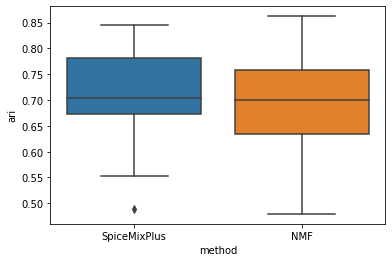

In [18]:
sns.boxplot(x="method", y="ari", data=ari_scores)

## Multireplicate Batch Effect Test

Here we test SpiceMixPlus's ability to discern batch effects that are unique to certain replicates

In [139]:
path2dataset = Path('../../data/synthetic_cortex/multireplicate_spatial_batch_effect')

num_fovs = 3

In [76]:
multireplicate_differential_spicemix = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-1,
    repli_list=np.arange(num_fovs),
    metagene_mode="differential",
    lambda_M=0.5,
    #repli_list=list(range(1)),
    context=dict(device='cuda:0', dtype=torch.float32),
    context_Y=dict(dtype=torch.float32, device='cuda:0'),
    prior_x_modes = [None] * num_fovs
)   
#mina_spicemix.load_dataset(path2dataset)
multireplicate_differential_spicemix.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.h5ad")
multireplicate_differential_spicemix.initialize(
#     method='kmeans',
    method='svd',
)   

multireplicate_differential_spicemix.initialize_Sigma_x_inv()
torch.manual_seed(0)
import numpy as np
np.random.seed(0)
for iteration in range(400): 
    print(f"----- Iteration {iteration} -----")
    multireplicate_differential_spicemix.estimate_parameters(iiter=iteration, use_spatial=[True]*multireplicate_differential_spicemix.num_repli)
    likelihood = multireplicate_differential_spicemix.compute_likelihood_function(use_spatial=[True]*multireplicate_differential_spicemix.num_repli)
    print(f"Likelihood after parameter updates: {likelihood}")
    
    multireplicate_differential_spicemix.estimate_weights(iiter=iteration, use_spatial=[True]*multireplicate_differential_spicemix.num_repli)
    likelihood = multireplicate_differential_spicemix.compute_likelihood_function(use_spatial=[True]*multireplicate_differential_spicemix.num_repli)
    print(f"Likelihood after weight update: {likelihood}")

Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obsp["adjacency_matrix"] = adjacency_matrix


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 472440.15625
M regularization term: 0.0
M constant term: 311120.38194362074
M constant magnitude: 881.89756504662
M quadratic term: 534983.5625
M regularization term: 0.0
M constant term: 416111.4559896237
M constant magnitude: 895.694173017182
M quadratic term: 454360.8125
M regularization term: 0.0
M constant term: 294295.01778746967
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109864.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9633, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-119661.2422, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9607, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-111201.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(8718.7783, device='cuda:0')
Differential loss
tensor(1837.9633, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-120458.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(14121.9521, device='cuda:0')
Differential loss
tensor(1837.9607, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-110679.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(8128.6133, device='cuda:0')
Differential loss
tensor(1837.9808, device='cuda:0')
tensor(0)
Likelihood after weight update: 17071032.0
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 349531.125
M regularization term: 0.0
M constant term: 362741.00015296193
M constant magnitude: 881.89756504662
M quadratic term: 516808.03125
M regularization term: 0.0
M constant term: 536703.3432320214
M constant magnitude: 895.694173017182
M quadratic term: 344473.1875
M regularization term: 0.0
M constant term: 356884.83033791225
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-139595.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793479.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9666, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-138547.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793479.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9641, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-140157.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793479.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24202.2051, device='cuda:0')
Differential loss
tensor(1837.9666, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-140348.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793479.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24069.7930, device='cuda:0')
Differential loss
tensor(1837.9641, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-140958.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793479.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24315.8926, device='cuda:0')
Differential loss
tensor(1837.9845, device='cuda:0')
tensor(0)
Likelihood after weight update: 17037332.0
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1093021.0
M regularization term: 0.0
M constant term: 1139439.0175639908
M constant magnitude: 881.89756504662
M quadratic term: 1107692.375
M regularization term: 0.0
M constant term: 1153595.8256590916
M constant magnitude: 895.694173017182
M quadratic term: 1148791.25
M regularization term: 0.0
M constant term: 1196347.8874785812
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-141791.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9685, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-141732.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9667, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-142501.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24678.9570, device='cuda:0')
Differential loss
tensor(1837.9685, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143323.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24628.5410, device='cuda:0')
Differential loss
tensor(1837.9667, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143114.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24722.8848, device='cuda:0')
Differential loss
tensor(1837.9838, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028052.0
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1158639.0
M regularization term: 0.0
M constant term: 1207444.2714302999
M constant magnitude: 881.89756504662
M quadratic term: 1185885.375
M regularization term: 0.0
M constant term: 1234780.0659003449
M constant magnitude: 895.694173017182
M quadratic term: 1208852.75
M regularization term: 0.0
M constant term: 1258286.8945387697
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143196., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9683, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144135.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144007.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24812.7344, device='cuda:0')
Differential loss
tensor(1837.9683, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144547.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24789.9961, device='cuda:0')
Differential loss
tensor(1837.9672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144359.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24838.1348, device='cuda:0')
Differential loss
tensor(1837.9816, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024448.0
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1191691.0
M regularization term: 0.0
M constant term: 1241455.2365471595
M constant magnitude: 881.89756504662
M quadratic term: 1225574.75
M regularization term: 0.0
M constant term: 1275503.4799873624
M constant magnitude: 895.694173017182
M quadratic term: 1239284.375
M regularization term: 0.0
M constant term: 1289349.4038835936
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144449.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9673, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145051.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9663, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144692.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24874.5039, device='cuda:0')
Differential loss
tensor(1837.9673, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146733.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24864.6699, device='cuda:0')
Differential loss
tensor(1837.9663, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145191.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24888.3008, device='cuda:0')
Differential loss
tensor(1837.9788, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020902.0
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1213297.375
M regularization term: 0.0
M constant term: 1263597.5133361921
M constant magnitude: 881.89756504662
M quadratic term: 1251089.75
M regularization term: 0.0
M constant term: 1301501.3456691771
M constant magnitude: 895.694173017182
M quadratic term: 1259708.75
M regularization term: 0.0
M constant term: 1310064.7461949703
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145007.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9657, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147081.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9645, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146207.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24907.9297, device='cuda:0')
Differential loss
tensor(1837.9657, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147781.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24905.3477, device='cuda:0')
Differential loss
tensor(1837.9645, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146250.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792411., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24915.4043, device='cuda:0')
Differential loss
tensor(1837.9756, device='cuda:0')
tensor(0)
Likelihood after weight update: 17017354.0
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1229027.75
M regularization term: 0.0
M constant term: 1279609.097219665
M constant magnitude: 881.89756504662
M quadratic term: 1269114.75
M regularization term: 0.0
M constant term: 1319777.3327554192
M constant magnitude: 895.694173017182
M quadratic term: 1275260.0
M regularization term: 0.0
M constant term: 1325769.7887644207
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145635.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9639, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148195.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9623, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146761.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24926.6445, device='cuda:0')
Differential loss
tensor(1837.9639, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149141., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24930.6797, device='cuda:0')
Differential loss
tensor(1837.9623, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147467.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24934.8926, device='cuda:0')
Differential loss
tensor(1837.9723, device='cuda:0')
tensor(0)
Likelihood after weight update: 17014506.0
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1241359.25
M regularization term: 0.0
M constant term: 1292071.2180952947
M constant magnitude: 881.89756504662
M quadratic term: 1282562.75
M regularization term: 0.0
M constant term: 1333346.2999851678
M constant magnitude: 895.694173017182
M quadratic term: 1287754.625
M regularization term: 0.0
M constant term: 1338369.1897839713
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146961.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9620, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149335.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9601, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147494.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24939.1250, device='cuda:0')
Differential loss
tensor(1837.9620, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150300.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24947.2402, device='cuda:0')
Differential loss
tensor(1837.9601, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148367.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24945.9355, device='cuda:0')
Differential loss
tensor(1837.9691, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011736.0
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1251617.375
M regularization term: 0.0
M constant term: 1302413.1337994498
M constant magnitude: 881.89756504662
M quadratic term: 1292946.25
M regularization term: 0.0
M constant term: 1343769.589602646
M constant magnitude: 895.694173017182
M quadratic term: 1297962.375
M regularization term: 0.0
M constant term: 1348644.6392542846
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147661.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9601, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150452.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9578, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148066.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24949.2812, device='cuda:0')
Differential loss
tensor(1837.9601, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151192.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24957.3066, device='cuda:0')
Differential loss
tensor(1837.9578, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149324.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24953.5703, device='cuda:0')
Differential loss
tensor(1837.9662, device='cuda:0')
tensor(0)
Likelihood after weight update: 17009328.0
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1260324.625
M regularization term: 0.0
M constant term: 1311129.992724502
M constant magnitude: 881.89756504662
M quadratic term: 1301118.75
M regularization term: 0.0
M constant term: 1351966.8273904424
M constant magnitude: 895.694173017182
M quadratic term: 1306631.5
M regularization term: 0.0
M constant term: 1357359.3742248756
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148208.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9581, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151315.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9556, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148531.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24957.2109, device='cuda:0')
Differential loss
tensor(1837.9581, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152513.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.8477, device='cuda:0')
Differential loss
tensor(1837.9556, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150060.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24958.6406, device='cuda:0')
Differential loss
tensor(1837.9631, device='cuda:0')
tensor(0)
Likelihood after weight update: 17006812.0
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1267772.25
M regularization term: 0.0
M constant term: 1318553.8735158122
M constant magnitude: 881.89756504662
M quadratic term: 1307791.0
M regularization term: 0.0
M constant term: 1358621.350061024
M constant magnitude: 895.694173017182
M quadratic term: 1314131.0
M regularization term: 0.0
M constant term: 1364884.162691512
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148652.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9561, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152615.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9534, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148892.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24963.2246, device='cuda:0')
Differential loss
tensor(1837.9561, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153373.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24967.6074, device='cuda:0')
Differential loss
tensor(1837.9534, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151086.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24962.2285, device='cuda:0')
Differential loss
tensor(1837.9602, device='cuda:0')
tensor(0)
Likelihood after weight update: 17004568.0
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1274205.625
M regularization term: 0.0
M constant term: 1324940.5594998295
M constant magnitude: 881.89756504662
M quadratic term: 1313400.375
M regularization term: 0.0
M constant term: 1364190.0077045516
M constant magnitude: 895.694173017182
M quadratic term: 1320749.25
M regularization term: 0.0
M constant term: 1371483.6793280614
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148997.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9542, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153462.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9512, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149750.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.3184, device='cuda:0')
Differential loss
tensor(1837.9542, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154216.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.4062, device='cuda:0')
Differential loss
tensor(1837.9512, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151993.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24965.4004, device='cuda:0')
Differential loss
tensor(1837.9574, device='cuda:0')
tensor(0)
Likelihood after weight update: 17001964.0
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1279807.25
M regularization term: 0.0
M constant term: 1330503.3784971135
M constant magnitude: 881.89756504662
M quadratic term: 1318273.0
M regularization term: 0.0
M constant term: 1369003.057627091
M constant magnitude: 895.694173017182
M quadratic term: 1326624.75
M regularization term: 0.0
M constant term: 1377337.386084763
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149841.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9523, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154293.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9492, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150625.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.7246, device='cuda:0')
Differential loss
tensor(1837.9523, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155212., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.4199, device='cuda:0')
Differential loss
tensor(1837.9492, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152792.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24968.4473, device='cuda:0')
Differential loss
tensor(1837.9548, device='cuda:0')
tensor(0)
Likelihood after weight update: 16999298.0
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1284704.0
M regularization term: 0.0
M constant term: 1335353.9245553706
M constant magnitude: 881.89756504662
M quadratic term: 1322534.5
M regularization term: 0.0
M constant term: 1373211.9248675567
M constant magnitude: 895.694173017182
M quadratic term: 1331869.0
M regularization term: 0.0
M constant term: 1382541.6737633557
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150704.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9506, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155278.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9474, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151220.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.3770, device='cuda:0')
Differential loss
tensor(1837.9506, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156062.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.2812, device='cuda:0')
Differential loss
tensor(1837.9474, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153724.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.7324, device='cuda:0')
Differential loss
tensor(1837.9525, device='cuda:0')
tensor(0)
Likelihood after weight update: 16996924.0
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1288995.0
M regularization term: 0.0
M constant term: 1339589.5213611186
M constant magnitude: 881.89756504662
M quadratic term: 1326251.75
M regularization term: 0.0
M constant term: 1376870.6791149282
M constant magnitude: 895.694173017182
M quadratic term: 1336550.25
M regularization term: 0.0
M constant term: 1387193.9242605926
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151290.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9490, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156120.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9458, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151703.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.2930, device='cuda:0')
Differential loss
tensor(1837.9490, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156353.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.7051, device='cuda:0')
Differential loss
tensor(1837.9458, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154335.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24973.9219, device='cuda:0')
Differential loss
tensor(1837.9504, device='cuda:0')
tensor(0)
Likelihood after weight update: 16995544.0
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1292772.25
M regularization term: 0.0
M constant term: 1343311.4110558436
M constant magnitude: 881.89756504662
M quadratic term: 1329496.625
M regularization term: 0.0
M constant term: 1380072.862974853
M constant magnitude: 895.694173017182
M quadratic term: 1340734.5
M regularization term: 0.0
M constant term: 1391338.0727172792
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151764.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9475, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156404.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9442, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152197.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.7676, device='cuda:0')
Differential loss
tensor(1837.9475, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157207.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24980.6543, device='cuda:0')
Differential loss
tensor(1837.9442, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154779.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.5488, device='cuda:0')
Differential loss
tensor(1837.9486, device='cuda:0')
tensor(0)
Likelihood after weight update: 16993752.0
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1296108.0
M regularization term: 0.0
M constant term: 1346601.674318989
M constant magnitude: 881.89756504662
M quadratic term: 1332368.5
M regularization term: 0.0
M constant term: 1382905.383252911
M constant magnitude: 895.694173017182
M quadratic term: 1344435.375
M regularization term: 0.0
M constant term: 1394999.5573064447
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152252.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9462, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157253.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9429, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152459.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.7539, device='cuda:0')
Differential loss
tensor(1837.9462, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157804.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.4297, device='cuda:0')
Differential loss
tensor(1837.9429, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155431.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.9922, device='cuda:0')
Differential loss
tensor(1837.9469, device='cuda:0')
tensor(0)
Likelihood after weight update: 16992244.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1299068.0
M regularization term: 0.0
M constant term: 1349526.1547203106
M constant magnitude: 881.89756504662
M quadratic term: 1334941.75
M regularization term: 0.0
M constant term: 1385432.3911924511
M constant magnitude: 895.694173017182
M quadratic term: 1347698.5
M regularization term: 0.0
M constant term: 1398221.0225764236
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152507.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9449, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157845.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9415, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153131.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.4766, device='cuda:0')
Differential loss
tensor(1837.9449, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158058.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0078, device='cuda:0')
Differential loss
tensor(1837.9415, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156274.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.3730, device='cuda:0')
Differential loss
tensor(1837.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 16990480.0
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1301713.125
M regularization term: 0.0
M constant term: 1352134.952591174
M constant magnitude: 881.89756504662
M quadratic term: 1337247.25
M regularization term: 0.0
M constant term: 1387700.7208972885
M constant magnitude: 895.694173017182
M quadratic term: 1350593.375
M regularization term: 0.0
M constant term: 1401068.2903722383
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153175.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9437, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158095.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9403, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154096.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.8594, device='cuda:0')
Differential loss
tensor(1837.9437, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158386.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.8262, device='cuda:0')
Differential loss
tensor(1837.9403, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156397.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.1504, device='cuda:0')
Differential loss
tensor(1837.9440, device='cuda:0')
tensor(0)
Likelihood after weight update: 16989066.0
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1304091.25
M regularization term: 0.0
M constant term: 1354473.0435130023
M constant magnitude: 881.89756504662
M quadratic term: 1339295.25
M regularization term: 0.0
M constant term: 1389717.5434312897
M constant magnitude: 895.694173017182
M quadratic term: 1353149.375
M regularization term: 0.0
M constant term: 1403587.8141566603
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154135.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9427, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158418.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9392, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154543.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9395, device='cuda:0')
Differential loss
tensor(1837.9427, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159057.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.4355, device='cuda:0')
Differential loss
tensor(1837.9392, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156743.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.9453, device='cuda:0')
Differential loss
tensor(1837.9426, device='cuda:0')
tensor(0)
Likelihood after weight update: 16987602.0
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1306241.625
M regularization term: 0.0
M constant term: 1356579.5870858205
M constant magnitude: 881.89756504662
M quadratic term: 1341108.875
M regularization term: 0.0
M constant term: 1391498.971226832
M constant magnitude: 895.694173017182
M quadratic term: 1355411.5
M regularization term: 0.0
M constant term: 1405816.807726686
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154578.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9418, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159085.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9382, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154740.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.0664, device='cuda:0')
Differential loss
tensor(1837.9418, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159529.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.9062, device='cuda:0')
Differential loss
tensor(1837.9382, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157056.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.3594, device='cuda:0')
Differential loss
tensor(1837.9415, device='cuda:0')
tensor(0)
Likelihood after weight update: 16986622.0
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1308187.5
M regularization term: 0.0
M constant term: 1358491.1417702977
M constant magnitude: 881.89756504662
M quadratic term: 1342706.0
M regularization term: 0.0
M constant term: 1393062.6113829191
M constant magnitude: 895.694173017182
M quadratic term: 1357422.75
M regularization term: 0.0
M constant term: 1407799.0727485446
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154772.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9408, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159554.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9374, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155589.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.7129, device='cuda:0')
Differential loss
tensor(1837.9408, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159639.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.0332, device='cuda:0')
Differential loss
tensor(1837.9374, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157621.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.6582, device='cuda:0')
Differential loss
tensor(1837.9404, device='cuda:0')
tensor(0)
Likelihood after weight update: 16985102.0
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1309958.75
M regularization term: 0.0
M constant term: 1360230.6043204456
M constant magnitude: 881.89756504662
M quadratic term: 1344111.75
M regularization term: 0.0
M constant term: 1394442.0818571846
M constant magnitude: 895.694173017182
M quadratic term: 1359222.25
M regularization term: 0.0
M constant term: 1409570.245038597
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155618.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9399, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159661.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9365, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155514.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.4004, device='cuda:0')
Differential loss
tensor(1837.9399, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159493.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.0703, device='cuda:0')
Differential loss
tensor(1837.9365, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157558.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.7715, device='cuda:0')
Differential loss
tensor(1837.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 16985386.0
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1311571.75
M regularization term: 0.0
M constant term: 1361814.0877270577
M constant magnitude: 881.89756504662
M quadratic term: 1345368.875
M regularization term: 0.0
M constant term: 1395672.7400232397
M constant magnitude: 895.694173017182
M quadratic term: 1360836.0
M regularization term: 0.0
M constant term: 1411157.1380040052
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155540.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9392, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159513.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9359, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155927.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.8574, device='cuda:0')
Differential loss
tensor(1837.9392, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160196.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9336, device='cuda:0')
Differential loss
tensor(1837.9359, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158028.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792491.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.8008, device='cuda:0')
Differential loss
tensor(1837.9386, device='cuda:0')
tensor(0)
Likelihood after weight update: 16983802.0
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1313061.125
M regularization term: 0.0
M constant term: 1363273.911917034
M constant magnitude: 881.89756504662
M quadratic term: 1346504.125
M regularization term: 0.0
M constant term: 1396781.0436213042
M constant magnitude: 895.694173017182
M quadratic term: 1362285.125
M regularization term: 0.0
M constant term: 1412584.732409904
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155655.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792758.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9386, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159564.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792758.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9352, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156244.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792758.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.2891, device='cuda:0')
Differential loss
tensor(1837.9386, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159976.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792758.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.6816, device='cuda:0')
Differential loss
tensor(1837.9352, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158607.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792758.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6445, device='cuda:0')
Differential loss
tensor(1837.9377, device='cuda:0')
tensor(0)
Likelihood after weight update: 16983928.0
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1314437.0
M regularization term: 0.0
M constant term: 1364630.0776563473
M constant magnitude: 881.89756504662
M quadratic term: 1347534.0
M regularization term: 0.0
M constant term: 1397777.8561731689
M constant magnitude: 895.694173017182
M quadratic term: 1363583.25
M regularization term: 0.0
M constant term: 1413874.2068851383
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156285.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9380, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159401.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9346, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156664.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.7363, device='cuda:0')
Differential loss
tensor(1837.9380, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160147.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2969, device='cuda:0')
Differential loss
tensor(1837.9346, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158933.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5352, device='cuda:0')
Differential loss
tensor(1837.9370, device='cuda:0')
tensor(0)
Likelihood after weight update: 16983194.0
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1315709.375
M regularization term: 0.0
M constant term: 1365890.3684266822
M constant magnitude: 881.89756504662
M quadratic term: 1348454.125
M regularization term: 0.0
M constant term: 1398677.432322758
M constant magnitude: 895.694173017182
M quadratic term: 1364777.25
M regularization term: 0.0
M constant term: 1415037.3887166244
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156685.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9374, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160162.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9341, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156665.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.3223, device='cuda:0')
Differential loss
tensor(1837.9374, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160929.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.8359, device='cuda:0')
Differential loss
tensor(1837.9341, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159294.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2168, device='cuda:0')
Differential loss
tensor(1837.9363, device='cuda:0')
tensor(0)
Likelihood after weight update: 16982050.0
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1316893.375
M regularization term: 0.0
M constant term: 1367061.4973044565
M constant magnitude: 881.89756504662
M quadratic term: 1349286.75
M regularization term: 0.0
M constant term: 1399488.2182418453
M constant magnitude: 895.694173017182
M quadratic term: 1365861.125
M regularization term: 0.0
M constant term: 1416097.9174764361
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156685.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9368, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160942.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9336, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157378.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8281, device='cuda:0')
Differential loss
tensor(1837.9368, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160513.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2969, device='cuda:0')
Differential loss
tensor(1837.9336, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159000.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.7129, device='cuda:0')
Differential loss
tensor(1837.9357, device='cuda:0')
tensor(0)
Likelihood after weight update: 16982046.0
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1317987.0
M regularization term: 0.0
M constant term: 1368138.060322977
M constant magnitude: 881.89756504662
M quadratic term: 1350043.625
M regularization term: 0.0
M constant term: 1400229.3427544339
M constant magnitude: 895.694173017182
M quadratic term: 1366854.5
M regularization term: 0.0
M constant term: 1417071.216119867
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157397.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9363, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160525.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9331, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158082.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.3672, device='cuda:0')
Differential loss
tensor(1837.9363, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-161036.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7344, device='cuda:0')
Differential loss
tensor(1837.9331, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159542.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792818.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2285, device='cuda:0')
Differential loss
tensor(1837.9351, device='cuda:0')
tensor(0)
Likelihood after weight update: 16980280.0
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1319003.75
M regularization term: 0.0
M constant term: 1369136.7450601524
M constant magnitude: 881.89756504662
M quadratic term: 1350733.75
M regularization term: 0.0
M constant term: 1400909.1454174125
M constant magnitude: 895.694173017182
M quadratic term: 1367778.625
M regularization term: 0.0
M constant term: 1417970.4077380619
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156902.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9358, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159346.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9326, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157161.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7090, device='cuda:0')
Differential loss
tensor(1837.9358, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159358.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7070, device='cuda:0')
Differential loss
tensor(1837.9326, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158845.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2168, device='cuda:0')
Differential loss
tensor(1837.9346, device='cuda:0')
tensor(0)
Likelihood after weight update: 16989334.0
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1319950.5
M regularization term: 0.0
M constant term: 1370058.2146228359
M constant magnitude: 881.89756504662
M quadratic term: 1351365.75
M regularization term: 0.0
M constant term: 1401534.11214386
M constant magnitude: 895.694173017182
M quadratic term: 1368638.0
M regularization term: 0.0
M constant term: 1418808.9253517787
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157176.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9354, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159368.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9323, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156970.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7832, device='cuda:0')
Differential loss
tensor(1837.9354, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159869.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9277, device='cuda:0')
Differential loss
tensor(1837.9323, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159042.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4258, device='cuda:0')
Differential loss
tensor(1837.9340, device='cuda:0')
tensor(0)
Likelihood after weight update: 16988816.0
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1320787.5
M regularization term: 0.0
M constant term: 1370892.0903256258
M constant magnitude: 881.89756504662
M quadratic term: 1351948.0
M regularization term: 0.0
M constant term: 1402105.5518693284
M constant magnitude: 895.694173017182
M quadratic term: 1369422.375
M regularization term: 0.0
M constant term: 1419581.3349205176
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156985.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9349, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159879.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9319, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157814.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1426, device='cuda:0')
Differential loss
tensor(1837.9349, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159997.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2559, device='cuda:0')
Differential loss
tensor(1837.9319, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158778.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.7617, device='cuda:0')
Differential loss
tensor(1837.9335, device='cuda:0')
tensor(0)
Likelihood after weight update: 16988108.0
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1321574.75
M regularization term: 0.0
M constant term: 1371673.891507577
M constant magnitude: 881.89756504662
M quadratic term: 1352491.75
M regularization term: 0.0
M constant term: 1402638.5165755972
M constant magnitude: 895.694173017182
M quadratic term: 1370157.5
M regularization term: 0.0
M constant term: 1420304.4982555727
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157827.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9346, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160006.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9315, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157958.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3242, device='cuda:0')
Differential loss
tensor(1837.9346, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159851.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5059, device='cuda:0')
Differential loss
tensor(1837.9315, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159391.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5794734.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0898, device='cuda:0')
Differential loss
tensor(1837.9330, device='cuda:0')
tensor(0)
Likelihood after weight update: 16987498.0
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1322312.0
M regularization term: 0.0
M constant term: 1372403.9452493351
M constant magnitude: 881.89756504662
M quadratic term: 1353000.75
M regularization term: 0.0
M constant term: 1403136.9666696647
M constant magnitude: 895.694173017182
M quadratic term: 1370837.0
M regularization term: 0.0
M constant term: 1420977.581786543
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157975.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9341, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-159597.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9312, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157968.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1797, device='cuda:0')
Differential loss
tensor(1837.9341, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160000.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8008, device='cuda:0')
Differential loss
tensor(1837.9312, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158798.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2949, device='cuda:0')
Differential loss
tensor(1837.9326, device='cuda:0')
tensor(0)
Likelihood after weight update: 16990374.0
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1322996.875
M regularization term: 0.0
M constant term: 1373090.2143424922
M constant magnitude: 881.89756504662
M quadratic term: 1353479.5
M regularization term: 0.0
M constant term: 1403601.320635498
M constant magnitude: 895.694173017182
M quadratic term: 1371444.25
M regularization term: 0.0
M constant term: 1421601.6786415174
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157980.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9337, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160007.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9308, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158107.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5078, device='cuda:0')
Differential loss
tensor(1837.9337, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160068.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0078, device='cuda:0')
Differential loss
tensor(1837.9308, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158719., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6543, device='cuda:0')
Differential loss
tensor(1837.9321, device='cuda:0')
tensor(0)
Likelihood after weight update: 16990246.0
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1323648.25
M regularization term: 0.0
M constant term: 1373729.824680065
M constant magnitude: 881.89756504662
M quadratic term: 1353904.25
M regularization term: 0.0
M constant term: 1404013.2722596496
M constant magnitude: 895.694173017182
M quadratic term: 1372024.5
M regularization term: 0.0
M constant term: 1422168.762864088
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158118.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9333, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160075.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9304, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158115.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6855, device='cuda:0')
Differential loss
tensor(1837.9333, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-160204.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1914, device='cuda:0')
Differential loss
tensor(1837.9304, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158864.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795549., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8926, device='cuda:0')
Differential loss
tensor(1837.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 16989956.0
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1324256.25
M regularization term: 0.0
M constant term: 1374326.1486697444
M constant magnitude: 881.89756504662
M quadratic term: 1354301.625
M regularization term: 0.0
M constant term: 1404398.6039948687
M constant magnitude: 895.694173017182
M quadratic term: 1372559.25
M regularization term: 0.0
M constant term: 1422695.7994935107
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156880.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9330, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156881.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9302, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156833.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4336, device='cuda:0')
Differential loss
tensor(1837.9330, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157234.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7656, device='cuda:0')
Differential loss
tensor(1837.9302, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157672.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4121, device='cuda:0')
Differential loss
tensor(1837.9313, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012908.0
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1324848.75
M regularization term: 0.0
M constant term: 1374891.8353770564
M constant magnitude: 881.89756504662
M quadratic term: 1354675.875
M regularization term: 0.0
M constant term: 1404754.1983758206
M constant magnitude: 895.694173017182
M quadratic term: 1373119.375
M regularization term: 0.0
M constant term: 1423188.9748929495
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156843.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9326, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157240.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9298, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156381.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6348, device='cuda:0')
Differential loss
tensor(1837.9326, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157659., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4043, device='cuda:0')
Differential loss
tensor(1837.9298, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157624.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9629, device='cuda:0')
Differential loss
tensor(1837.9309, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012980.0
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1325401.75
M regularization term: 0.0
M constant term: 1375434.4726630354
M constant magnitude: 881.89756504662
M quadratic term: 1355041.75
M regularization term: 0.0
M constant term: 1405105.8927813857
M constant magnitude: 895.694173017182
M quadratic term: 1373585.0
M regularization term: 0.0
M constant term: 1423645.829640502
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156391.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9324, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157665.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9296, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156872.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5996, device='cuda:0')
Differential loss
tensor(1837.9324, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158286.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4199, device='cuda:0')
Differential loss
tensor(1837.9296, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157971.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9414, device='cuda:0')
Differential loss
tensor(1837.9305, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011512.0
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1325963.625
M regularization term: 0.0
M constant term: 1375989.253397637
M constant magnitude: 881.89756504662
M quadratic term: 1355406.125
M regularization term: 0.0
M constant term: 1405458.4316122555
M constant magnitude: 895.694173017182
M quadratic term: 1374047.375
M regularization term: 0.0
M constant term: 1424106.0341633204
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156881.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9320, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158291.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9292, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157193.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3770, device='cuda:0')
Differential loss
tensor(1837.9320, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157976.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4609, device='cuda:0')
Differential loss
tensor(1837.9292, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158093.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9785, device='cuda:0')
Differential loss
tensor(1837.9302, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011380.0
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1326503.25
M regularization term: 0.0
M constant term: 1376522.7989103328
M constant magnitude: 881.89756504662
M quadratic term: 1355751.25
M regularization term: 0.0
M constant term: 1405793.0507317085
M constant magnitude: 895.694173017182
M quadratic term: 1374491.25
M regularization term: 0.0
M constant term: 1424545.0248717486
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157202.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9316, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157981.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9290, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157099.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2227, device='cuda:0')
Differential loss
tensor(1837.9316, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158135.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5098, device='cuda:0')
Differential loss
tensor(1837.9290, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158632.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8594, device='cuda:0')
Differential loss
tensor(1837.9298, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010774.0
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1327021.625
M regularization term: 0.0
M constant term: 1377037.8566951044
M constant magnitude: 881.89756504662
M quadratic term: 1356077.75
M regularization term: 0.0
M constant term: 1406111.6317406925
M constant magnitude: 895.694173017182
M quadratic term: 1374910.0
M regularization term: 0.0
M constant term: 1424966.8686379178
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157108.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9314, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158141., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9287, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157580.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2246, device='cuda:0')
Differential loss
tensor(1837.9314, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157735.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5391, device='cuda:0')
Differential loss
tensor(1837.9287, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158648.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801378.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9668, device='cuda:0')
Differential loss
tensor(1837.9294, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010676.0
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1327527.25
M regularization term: 0.0
M constant term: 1377538.3427174108
M constant magnitude: 881.89756504662
M quadratic term: 1356388.5
M regularization term: 0.0
M constant term: 1406416.2973994783
M constant magnitude: 895.694173017182
M quadratic term: 1375328.25
M regularization term: 0.0
M constant term: 1425371.060317867
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155818.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9310, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157657.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9285, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156922.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0449, device='cuda:0')
Differential loss
tensor(1837.9310, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157574.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1152, device='cuda:0')
Differential loss
tensor(1837.9285, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157331.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6211, device='cuda:0')
Differential loss
tensor(1837.9292, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019560.0
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1328000.0
M regularization term: 0.0
M constant term: 1378020.9803721486
M constant magnitude: 881.89756504662
M quadratic term: 1356745.0
M regularization term: 0.0
M constant term: 1406706.7963204593
M constant magnitude: 895.694173017182
M quadratic term: 1375712.625
M regularization term: 0.0
M constant term: 1425765.0535468003
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156930.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9308, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157579.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9282, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156336.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7734, device='cuda:0')
Differential loss
tensor(1837.9308, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157394.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0020, device='cuda:0')
Differential loss
tensor(1837.9282, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157135.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4902, device='cuda:0')
Differential loss
tensor(1837.9288, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020520.0
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1328443.0
M regularization term: 0.0
M constant term: 1378456.9192669173
M constant magnitude: 881.89756504662
M quadratic term: 1357022.75
M regularization term: 0.0
M constant term: 1406980.7369772214
M constant magnitude: 895.694173017182
M quadratic term: 1376086.875
M regularization term: 0.0
M constant term: 1426131.4642896226
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156344.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9304, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157399.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9280, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156832.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7598, device='cuda:0')
Differential loss
tensor(1837.9304, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157794., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0137, device='cuda:0')
Differential loss
tensor(1837.9280, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157213.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5059, device='cuda:0')
Differential loss
tensor(1837.9285, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019548.0
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1328880.875
M regularization term: 0.0
M constant term: 1378891.2047230252
M constant magnitude: 881.89756504662
M quadratic term: 1357291.0
M regularization term: 0.0
M constant term: 1407249.0480814262
M constant magnitude: 895.694173017182
M quadratic term: 1376457.75
M regularization term: 0.0
M constant term: 1426496.085436428
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156839.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9302, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157798.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9279, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156113.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7344, device='cuda:0')
Differential loss
tensor(1837.9302, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157101.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0293, device='cuda:0')
Differential loss
tensor(1837.9279, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157730.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4629, device='cuda:0')
Differential loss
tensor(1837.9282, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020440.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1329299.5
M regularization term: 0.0
M constant term: 1379312.2017448505
M constant magnitude: 881.89756504662
M quadratic term: 1357548.0
M regularization term: 0.0
M constant term: 1407505.537692036
M constant magnitude: 895.694173017182
M quadratic term: 1376812.25
M regularization term: 0.0
M constant term: 1426850.947037473
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156121.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9299, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157105.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156530.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7598, device='cuda:0')
Differential loss
tensor(1837.9299, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157970.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0488, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157479.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803629.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2676, device='cuda:0')
Differential loss
tensor(1837.9279, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019404.0
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1329694.25
M regularization term: 0.0
M constant term: 1379720.1246696906
M constant magnitude: 881.89756504662
M quadratic term: 1357795.25
M regularization term: 0.0
M constant term: 1407751.6242326957
M constant magnitude: 895.694173017182
M quadratic term: 1377141.25
M regularization term: 0.0
M constant term: 1427196.0380804157
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156255.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156866.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156428.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7891, device='cuda:0')
Differential loss
tensor(1837.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157173.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1133, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157572.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3301, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022298.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1330076.125
M regularization term: 0.0
M constant term: 1380107.2718900705
M constant magnitude: 881.89756504662
M quadratic term: 1358070.25
M regularization term: 0.0
M constant term: 1407988.0137452104
M constant magnitude: 895.694173017182
M quadratic term: 1377454.25
M regularization term: 0.0
M constant term: 1427526.7570783584
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156435.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9294, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157177.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156782.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9238, device='cuda:0')
Differential loss
tensor(1837.9294, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157024.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1328, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157329.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3340, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022336.0
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1330453.875
M regularization term: 0.0
M constant term: 1380481.5371145261
M constant magnitude: 881.89756504662
M quadratic term: 1358294.5
M regularization term: 0.0
M constant term: 1408215.6514489967
M constant magnitude: 895.694173017182
M quadratic term: 1377784.75
M regularization term: 0.0
M constant term: 1427853.965505347
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156788.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9292, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157027.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156448.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9844, device='cuda:0')
Differential loss
tensor(1837.9292, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157347.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1641, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157634.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3652, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022040.0
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1330809.375
M regularization term: 0.0
M constant term: 1380835.4474004554
M constant magnitude: 881.89756504662
M quadratic term: 1358508.5
M regularization term: 0.0
M constant term: 1408434.0545544643
M constant magnitude: 895.694173017182
M quadratic term: 1378110.0
M regularization term: 0.0
M constant term: 1428172.8240003318
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156454.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9290, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157351.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156817.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0469, device='cuda:0')
Differential loss
tensor(1837.9290, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157190.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2051, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157423.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3477, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022038.0
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1331152.75
M regularization term: 0.0
M constant term: 1381173.874663459
M constant magnitude: 881.89756504662
M quadratic term: 1358713.25
M regularization term: 0.0
M constant term: 1408642.9783431494
M constant magnitude: 895.694173017182
M quadratic term: 1378425.25
M regularization term: 0.0
M constant term: 1428485.984594584
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156823.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9287, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157193.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156663.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1016, device='cuda:0')
Differential loss
tensor(1837.9287, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157295.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2402, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157679.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3438, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021832.0
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1331482.25
M regularization term: 0.0
M constant term: 1381498.9005572547
M constant magnitude: 881.89756504662
M quadratic term: 1358910.875
M regularization term: 0.0
M constant term: 1408841.9398634068
M constant magnitude: 895.694173017182
M quadratic term: 1378735.75
M regularization term: 0.0
M constant term: 1428792.7157853239
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156669.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9286, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157298.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156928.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1816, device='cuda:0')
Differential loss
tensor(1837.9286, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157509.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2773, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157705.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804325.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3223, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021324.0
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1331800.0
M regularization term: 0.0
M constant term: 1381811.2106591878
M constant magnitude: 881.89756504662
M quadratic term: 1359100.5
M regularization term: 0.0
M constant term: 1409032.8395724702
M constant magnitude: 895.694173017182
M quadratic term: 1379040.25
M regularization term: 0.0
M constant term: 1429095.915510766
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156474.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9283, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156895.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157256.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2695, device='cuda:0')
Differential loss
tensor(1837.9283, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156884.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3242, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157750.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2578, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023832.0
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1332127.25
M regularization term: 0.0
M constant term: 1382111.725395883
M constant magnitude: 881.89756504662
M quadratic term: 1359311.25
M regularization term: 0.0
M constant term: 1409218.056516737
M constant magnitude: 895.694173017182
M quadratic term: 1379335.75
M regularization term: 0.0
M constant term: 1429394.8540654113
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157261.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9282, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156888.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156961.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3418, device='cuda:0')
Differential loss
tensor(1837.9282, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157198.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3574, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-158070.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805077., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2910, device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023492.0
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1332416.625
M regularization term: 0.0
M constant term: 1382397.39858012
M constant magnitude: 881.89756504662
M quadratic term: 1359489.25
M regularization term: 0.0
M constant term: 1409395.679775846
M constant magnitude: 895.694173017182
M quadratic term: 1379631.75
M regularization term: 0.0
M constant term: 1429693.886427903
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156755.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805196., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9281, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156985.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805196., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157370.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805196., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4980, device='cuda:0')
Differential loss
tensor(1837.9281, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157468.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805196., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4941, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157709.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805196., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4062, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023528.0
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1332678.75
M regularization term: 0.0
M constant term: 1382672.4193285576
M constant magnitude: 881.89756504662
M quadratic term: 1359658.125
M regularization term: 0.0
M constant term: 1409568.0898958687
M constant magnitude: 895.694173017182
M quadratic term: 1379932.625
M regularization term: 0.0
M constant term: 1429985.7453013193
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156323.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9279, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156643.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156303.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3945, device='cuda:0')
Differential loss
tensor(1837.9279, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156595.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7852, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157111.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807677., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7129, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Likelihood after weight update: 17033504.0
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1332943.25
M regularization term: 0.0
M constant term: 1382933.2745780852
M constant magnitude: 881.89756504662
M quadratic term: 1359850.25
M regularization term: 0.0
M constant term: 1409728.3666752297
M constant magnitude: 895.694173017182
M quadratic term: 1380179.75
M regularization term: 0.0
M constant term: 1430269.6971002873
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155670.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9277, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156279.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155974.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7871, device='cuda:0')
Differential loss
tensor(1837.9277, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156334.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156245.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2930, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Likelihood after weight update: 17039430.0
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1333178.25
M regularization term: 0.0
M constant term: 1383201.4462482831
M constant magnitude: 881.89756504662
M quadratic term: 1360068.5
M regularization term: 0.0
M constant term: 1409886.5236820746
M constant magnitude: 895.694173017182
M quadratic term: 1380482.75
M regularization term: 0.0
M constant term: 1430547.43141788
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155979.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156337.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155770.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8574, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156504.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9023, device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156506.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809165.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1621, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17039202.0
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1333437.75
M regularization term: 0.0
M constant term: 1383457.5435602113
M constant magnitude: 881.89756504662
M quadratic term: 1360228.5
M regularization term: 0.0
M constant term: 1410048.5250374475
M constant magnitude: 895.694173017182
M quadratic term: 1380754.5
M regularization term: 0.0
M constant term: 1430818.4578693807
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155508.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155850.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155278.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0781, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156035.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9922, device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155920.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2676, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17042058.0
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1333700.5
M regularization term: 0.0
M constant term: 1383699.452582768
M constant magnitude: 881.89756504662
M quadratic term: 1360385.375
M regularization term: 0.0
M constant term: 1410208.8837688777
M constant magnitude: 895.694173017182
M quadratic term: 1381017.375
M regularization term: 0.0
M constant term: 1431088.106205929
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155282.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156038.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155591.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1211, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156158.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9434, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156437.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2637, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041102.0
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1333928.0
M regularization term: 0.0
M constant term: 1383923.8886900677
M constant magnitude: 881.89756504662
M quadratic term: 1360536.5
M regularization term: 0.0
M constant term: 1410364.018688977
M constant magnitude: 895.694173017182
M quadratic term: 1381273.25
M regularization term: 0.0
M constant term: 1431344.2457004797
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155595.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156161.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156031.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1836, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156301.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9238, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156232.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809602.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2793, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040726.0
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1334145.75
M regularization term: 0.0
M constant term: 1384137.8551845753
M constant magnitude: 881.89756504662
M quadratic term: 1360684.5
M regularization term: 0.0
M constant term: 1410517.2693861434
M constant magnitude: 895.694173017182
M quadratic term: 1381522.75
M regularization term: 0.0
M constant term: 1431592.68907029
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155061.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155772.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155486.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1777, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155986.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8691, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156145.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2832, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041318.0
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1334356.75
M regularization term: 0.0
M constant term: 1384340.876917448
M constant magnitude: 881.89756504662
M quadratic term: 1360836.5
M regularization term: 0.0
M constant term: 1410664.8146817177
M constant magnitude: 895.694173017182
M quadratic term: 1381767.25
M regularization term: 0.0
M constant term: 1431832.4594215772
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155490.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155988.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155323.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2578, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155655.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8809, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156494.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3086, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041464.0
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1334556.75
M regularization term: 0.0
M constant term: 1384539.4978414048
M constant magnitude: 881.89756504662
M quadratic term: 1360977.75
M regularization term: 0.0
M constant term: 1410809.9951059103
M constant magnitude: 895.694173017182
M quadratic term: 1382003.75
M regularization term: 0.0
M constant term: 1432065.9779114586
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155327.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155657.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155318.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3125, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155979.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8730, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156004.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3379, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041634.0
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1334745.0
M regularization term: 0.0
M constant term: 1384727.1625255144
M constant magnitude: 881.89756504662
M quadratic term: 1361115.25
M regularization term: 0.0
M constant term: 1410950.660015426
M constant magnitude: 895.694173017182
M quadratic term: 1382229.875
M regularization term: 0.0
M constant term: 1432291.0544577735
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155321.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155982.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155447.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3574, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156082.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8770, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156352.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3691, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041054.0
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1334925.5
M regularization term: 0.0
M constant term: 1384905.736790065
M constant magnitude: 881.89756504662
M quadratic term: 1361249.125
M regularization term: 0.0
M constant term: 1411087.5239958798
M constant magnitude: 895.694173017182
M quadratic term: 1382446.25
M regularization term: 0.0
M constant term: 1432507.9259521426
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155450.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156084.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155521.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3867, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155928., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8906, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156529.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3848, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040956.0
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1335097.875
M regularization term: 0.0
M constant term: 1385076.6199957945
M constant magnitude: 881.89756504662
M quadratic term: 1361378.75
M regularization term: 0.0
M constant term: 1411220.3464767854
M constant magnitude: 895.694173017182
M quadratic term: 1382656.25
M regularization term: 0.0
M constant term: 1432716.8297216536
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155524.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155930.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155440.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4199, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156273.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9043, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156272.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4043, device='cuda:0')
Differential loss
tensor(1837.9232, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040948.0
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1335265.125
M regularization term: 0.0
M constant term: 1385240.7444604943
M constant magnitude: 881.89756504662
M quadratic term: 1361504.0
M regularization term: 0.0
M constant term: 1411349.125741571
M constant magnitude: 895.694173017182
M quadratic term: 1382861.625
M regularization term: 0.0
M constant term: 1432919.218454911
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155729.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155957.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156373.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4629, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156340.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8848, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156990.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3301, device='cuda:0')
Differential loss
tensor(1837.9231, device='cuda:0')
tensor(0)
Likelihood after weight update: 17037766.0
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1335434.375
M regularization term: 0.0
M constant term: 1385398.809140376
M constant magnitude: 881.89756504662
M quadratic term: 1361623.5
M regularization term: 0.0
M constant term: 1411474.0990962626
M constant magnitude: 895.694173017182
M quadratic term: 1383062.75
M regularization term: 0.0
M constant term: 1433116.3031911931
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156376.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156342.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156423., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4844, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156019.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9375, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156883.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808997., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3691, device='cuda:0')
Differential loss
tensor(1837.9230, device='cuda:0')
tensor(0)
Likelihood after weight update: 17038146.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1335592.5
M regularization term: 0.0
M constant term: 1385555.4954969927
M constant magnitude: 881.89756504662
M quadratic term: 1361743.625
M regularization term: 0.0
M constant term: 1411598.6110463804
M constant magnitude: 895.694173017182
M quadratic term: 1383261.0
M regularization term: 0.0
M constant term: 1433314.157860372
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155330.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155976.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155727.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5605, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156103.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0117, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156469.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4746, device='cuda:0')
Differential loss
tensor(1837.9230, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041214.0
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1335735.75
M regularization term: 0.0
M constant term: 1385706.3517199694
M constant magnitude: 881.89756504662
M quadratic term: 1361856.5
M regularization term: 0.0
M constant term: 1411715.4904188544
M constant magnitude: 895.694173017182
M quadratic term: 1383456.25
M regularization term: 0.0
M constant term: 1433505.0024655126
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155729.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156104.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155160.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5859, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155992.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0117, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156752.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4707, device='cuda:0')
Differential loss
tensor(1837.9229, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041606.0
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1335878.75
M regularization term: 0.0
M constant term: 1385850.4377272637
M constant magnitude: 881.89756504662
M quadratic term: 1361962.5
M regularization term: 0.0
M constant term: 1411823.3000092257
M constant magnitude: 895.694173017182
M quadratic term: 1383636.75
M regularization term: 0.0
M constant term: 1433687.373682666
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155162.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155994.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155872.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6094, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156028.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156608.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4961, device='cuda:0')
Differential loss
tensor(1837.9227, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041002.0
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336016.0
M regularization term: 0.0
M constant term: 1385988.9220417705
M constant magnitude: 881.89756504662
M quadratic term: 1362063.75
M regularization term: 0.0
M constant term: 1411928.2529134208
M constant magnitude: 895.694173017182
M quadratic term: 1383813.375
M regularization term: 0.0
M constant term: 1433865.1583217687
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155874.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156029.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155663.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6445, device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156430.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0332, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156567.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5137, device='cuda:0')
Differential loss
tensor(1837.9226, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040850.0
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336148.0
M regularization term: 0.0
M constant term: 1386122.0365122508
M constant magnitude: 881.89756504662
M quadratic term: 1362162.375
M regularization term: 0.0
M constant term: 1412027.9570571852
M constant magnitude: 895.694173017182
M quadratic term: 1383985.75
M regularization term: 0.0
M constant term: 1434036.4076215369
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155666.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156432.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155489.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6699, device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156233.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0488, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156348.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5293, device='cuda:0')
Differential loss
tensor(1837.9226, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041438.0
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336274.625
M regularization term: 0.0
M constant term: 1386248.8411904043
M constant magnitude: 881.89756504662
M quadratic term: 1362257.875
M regularization term: 0.0
M constant term: 1412124.5629909039
M constant magnitude: 895.694173017182
M quadratic term: 1384153.25
M regularization term: 0.0
M constant term: 1434202.0913223925
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155491.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156235.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155771.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6855, device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156196.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0352, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156630.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809678., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5391, device='cuda:0')
Differential loss
tensor(1837.9225, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040910.0
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336397.0
M regularization term: 0.0
M constant term: 1386370.9745282317
M constant magnitude: 881.89756504662
M quadratic term: 1362350.75
M regularization term: 0.0
M constant term: 1412218.3089185592
M constant magnitude: 895.694173017182
M quadratic term: 1384314.5
M regularization term: 0.0
M constant term: 1434362.6932350325
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155064.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155740.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155723.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8477, device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155711.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1465, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156646.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6133, device='cuda:0')
Differential loss
tensor(1837.9224, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041918.0
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336510.25
M regularization term: 0.0
M constant term: 1386489.1380689705
M constant magnitude: 881.89756504662
M quadratic term: 1362429.375
M regularization term: 0.0
M constant term: 1412309.1939841087
M constant magnitude: 895.694173017182
M quadratic term: 1384478.0
M regularization term: 0.0
M constant term: 1434518.6975832589
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155725.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155713.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155504.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8066, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156271.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156726.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809841., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6348, device='cuda:0')
Differential loss
tensor(1837.9224, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041496.0
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336619.5
M regularization term: 0.0
M constant term: 1386597.4679195809
M constant magnitude: 881.89756504662
M quadratic term: 1362514.0
M regularization term: 0.0
M constant term: 1412392.1940631939
M constant magnitude: 895.694173017182
M quadratic term: 1384629.375
M regularization term: 0.0
M constant term: 1434668.3980667216
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155448.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155694.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155692.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8398, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156025.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156680.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6816, device='cuda:0')
Differential loss
tensor(1837.9222, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041944.0
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336734.75
M regularization term: 0.0
M constant term: 1386705.575945418
M constant magnitude: 881.89756504662
M quadratic term: 1362592.25
M regularization term: 0.0
M constant term: 1412475.4406842212
M constant magnitude: 895.694173017182
M quadratic term: 1384774.25
M regularization term: 0.0
M constant term: 1434812.7656028355
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155694.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156027.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155679.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8379, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155932.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156702.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809956.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6875, device='cuda:0')
Differential loss
tensor(1837.9222, device='cuda:0')
tensor(0)
Likelihood after weight update: 17042030.0
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336842.75
M regularization term: 0.0
M constant term: 1386811.8202265273
M constant magnitude: 881.89756504662
M quadratic term: 1362676.0
M regularization term: 0.0
M constant term: 1412557.737681191
M constant magnitude: 895.694173017182
M quadratic term: 1384914.75
M regularization term: 0.0
M constant term: 1434951.554264228
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155423.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155780.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156115.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7363, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156052.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0215, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156648.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7422, device='cuda:0')
Differential loss
tensor(1837.9221, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041150.0
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1336948.0
M regularization term: 0.0
M constant term: 1386916.6692676214
M constant magnitude: 881.89756504662
M quadratic term: 1362759.25
M regularization term: 0.0
M constant term: 1412639.0848040488
M constant magnitude: 895.694173017182
M quadratic term: 1385035.75
M regularization term: 0.0
M constant term: 1435086.4664019144
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156117.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156053.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155741.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7676, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156201.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156946.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7441, device='cuda:0')
Differential loss
tensor(1837.9221, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041076.0
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337055.5
M regularization term: 0.0
M constant term: 1387024.5800244887
M constant magnitude: 881.89756504662
M quadratic term: 1362840.875
M regularization term: 0.0
M constant term: 1412722.3532540214
M constant magnitude: 895.694173017182
M quadratic term: 1385167.75
M regularization term: 0.0
M constant term: 1435215.3082053917
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155743.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156202.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155952.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7773, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155836.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0371, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156405.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7480, device='cuda:0')
Differential loss
tensor(1837.9221, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041770.0
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337159.625
M regularization term: 0.0
M constant term: 1387127.5761660347
M constant magnitude: 881.89756504662
M quadratic term: 1362920.5
M regularization term: 0.0
M constant term: 1412802.5180561861
M constant magnitude: 895.694173017182
M quadratic term: 1385296.0
M regularization term: 0.0
M constant term: 1435341.000481631
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155954.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155838.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155844.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7852, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156109.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0332, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157139.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7559, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040868.0
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337259.75
M regularization term: 0.0
M constant term: 1387228.706545705
M constant magnitude: 881.89756504662
M quadratic term: 1362998.25
M regularization term: 0.0
M constant term: 1412881.4930403652
M constant magnitude: 895.694173017182
M quadratic term: 1385420.0
M regularization term: 0.0
M constant term: 1435463.2983487565
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155846.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156111.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155883.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8027, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156475.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0234, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156428.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7773, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041176.0
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337359.0
M regularization term: 0.0
M constant term: 1387326.5624747488
M constant magnitude: 881.89756504662
M quadratic term: 1363074.5
M regularization term: 0.0
M constant term: 1412958.799210568
M constant magnitude: 895.694173017182
M quadratic term: 1385540.25
M regularization term: 0.0
M constant term: 1435581.713167702
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155884.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156476.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155744.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8145, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156109.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0234, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156385.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7988, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041724.0
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337454.125
M regularization term: 0.0
M constant term: 1387421.377614736
M constant magnitude: 881.89756504662
M quadratic term: 1363148.75
M regularization term: 0.0
M constant term: 1413034.436154992
M constant magnitude: 895.694173017182
M quadratic term: 1385656.75
M regularization term: 0.0
M constant term: 1435695.025013939
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155745.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156111.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156086.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8262, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156377.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0293, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156668.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8223, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040830.0
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337546.875
M regularization term: 0.0
M constant term: 1387513.8552077494
M constant magnitude: 881.89756504662
M quadratic term: 1363223.0
M regularization term: 0.0
M constant term: 1413109.3610144735
M constant magnitude: 895.694173017182
M quadratic term: 1385770.75
M regularization term: 0.0
M constant term: 1435803.7195189062
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156088.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156378.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155686.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8340, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156468.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0312, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156715.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8223, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041092.0
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337635.25
M regularization term: 0.0
M constant term: 1387603.5250525314
M constant magnitude: 881.89756504662
M quadratic term: 1363296.5
M regularization term: 0.0
M constant term: 1413182.3765944291
M constant magnitude: 895.694173017182
M quadratic term: 1385876.75
M regularization term: 0.0
M constant term: 1435909.5013584376
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155688.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156469.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156289.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8516, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156012.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0352, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156628.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8477, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041030.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337719.75
M regularization term: 0.0
M constant term: 1387690.8558736278
M constant magnitude: 881.89756504662
M quadratic term: 1363368.625
M regularization term: 0.0
M constant term: 1413254.2007184958
M constant magnitude: 895.694173017182
M quadratic term: 1385981.25
M regularization term: 0.0
M constant term: 1436010.1755775523
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156290.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156013.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155727.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8730, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155825.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156888., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8594, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041520.0
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337801.75
M regularization term: 0.0
M constant term: 1387774.4382507687
M constant magnitude: 881.89756504662
M quadratic term: 1363439.0
M regularization term: 0.0
M constant term: 1413324.8331134561
M constant magnitude: 895.694173017182
M quadratic term: 1386080.75
M regularization term: 0.0
M constant term: 1436106.959565479
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155729.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155826.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155944.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8887, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156459.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0195, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157048.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8691, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040508.0
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337881.75
M regularization term: 0.0
M constant term: 1387854.740792495
M constant magnitude: 881.89756504662
M quadratic term: 1363508.625
M regularization term: 0.0
M constant term: 1413393.7945937847
M constant magnitude: 895.694173017182
M quadratic term: 1386174.75
M regularization term: 0.0
M constant term: 1436200.095964953
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155945.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156460.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156097.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9023, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156170.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0215, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156909.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809830.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8926, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17040784.0
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1337958.25
M regularization term: 0.0
M constant term: 1387931.7626436811
M constant magnitude: 881.89756504662
M quadratic term: 1363577.75
M regularization term: 0.0
M constant term: 1413462.7611215746
M constant magnitude: 895.694173017182
M quadratic term: 1386266.5
M regularization term: 0.0
M constant term: 1436290.3152517874
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155888.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156332.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155753.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9219, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156683.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1777, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156779.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8809, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041336.0
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338046.5
M regularization term: 0.0
M constant term: 1388006.4423893492
M constant magnitude: 881.89756504662
M quadratic term: 1363659.0
M regularization term: 0.0
M constant term: 1413530.295738
M constant magnitude: 895.694173017182
M quadratic term: 1386338.875
M regularization term: 0.0
M constant term: 1436377.1288608063
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155755.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156684.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155729., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9316, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156574.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1367, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157085.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9082, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041164.0
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338123.5
M regularization term: 0.0
M constant term: 1388087.9394292294
M constant magnitude: 881.89756504662
M quadratic term: 1363724.25
M regularization term: 0.0
M constant term: 1413593.5240209247
M constant magnitude: 895.694173017182
M quadratic term: 1386429.375
M regularization term: 0.0
M constant term: 1436466.3892602536
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155730.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156575.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155668.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9453, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156427.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1309, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157413.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810027.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9141, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17041042.0
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338200.0
M regularization term: 0.0
M constant term: 1388167.0947218165
M constant magnitude: 881.89756504662
M quadratic term: 1363789.25
M regularization term: 0.0
M constant term: 1413657.9541729644
M constant magnitude: 895.694173017182
M quadratic term: 1386516.25
M regularization term: 0.0
M constant term: 1436552.487090869
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156297.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156717.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156930.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8652, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156777.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157161.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6992, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17037308.0
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338279.5
M regularization term: 0.0
M constant term: 1388242.2632846143
M constant magnitude: 881.89756504662
M quadratic term: 1363845.75
M regularization term: 0.0
M constant term: 1413721.6701047954
M constant magnitude: 895.694173017182
M quadratic term: 1386592.75
M regularization term: 0.0
M constant term: 1436634.9336279465
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156931.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156778.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156138.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9082, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156734.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0469, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157476.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7793, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17037830.0
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338354.0
M regularization term: 0.0
M constant term: 1388318.6126057336
M constant magnitude: 881.89756504662
M quadratic term: 1363915.75
M regularization term: 0.0
M constant term: 1413789.941954934
M constant magnitude: 895.694173017182
M quadratic term: 1386685.25
M regularization term: 0.0
M constant term: 1436724.4620178225
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156139.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156735.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156454.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9199, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157084.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0430, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157025.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809236., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8047, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17037614.0
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338426.25
M regularization term: 0.0
M constant term: 1388390.9740831202
M constant magnitude: 881.89756504662
M quadratic term: 1363981.75
M regularization term: 0.0
M constant term: 1413855.1042628826
M constant magnitude: 895.694173017182
M quadratic term: 1386773.625
M regularization term: 0.0
M constant term: 1436807.6552977117
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156074.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156458.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156699.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156751.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9766, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157108.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8965, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17038762.0
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338496.375
M regularization term: 0.0
M constant term: 1388461.2265137336
M constant magnitude: 881.89756504662
M quadratic term: 1364028.25
M regularization term: 0.0
M constant term: 1413918.593932398
M constant magnitude: 895.694173017182
M quadratic term: 1386860.25
M regularization term: 0.0
M constant term: 1436889.3918027668
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156700.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156753.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156544.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156925.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157720.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809617., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8828, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17038130.0
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338558.5
M regularization term: 0.0
M constant term: 1388524.9047280462
M constant magnitude: 881.89756504662
M quadratic term: 1364094.25
M regularization term: 0.0
M constant term: 1413984.9631773308
M constant magnitude: 895.694173017182
M quadratic term: 1386936.5
M regularization term: 0.0
M constant term: 1436964.5467437932
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153953.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154277.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154201.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.2539, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154448.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.1699, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155085., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.6172, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17067956.0
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338706.5
M regularization term: 0.0
M constant term: 1388589.0573216528
M constant magnitude: 881.89756504662
M quadratic term: 1364155.0
M regularization term: 0.0
M constant term: 1414048.2219694792
M constant magnitude: 895.694173017182
M quadratic term: 1386904.125
M regularization term: 0.0
M constant term: 1437038.2433528414
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154201.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154449.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153934.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9336, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154767., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8633, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154944.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5817070.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.1680, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17068042.0
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338746.625
M regularization term: 0.0
M constant term: 1388632.2982078937
M constant magnitude: 881.89756504662
M quadratic term: 1364202.125
M regularization term: 0.0
M constant term: 1414095.189576128
M constant magnitude: 895.694173017182
M quadratic term: 1386962.25
M regularization term: 0.0
M constant term: 1437087.0521747842
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154410.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154613.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154120.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8359, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154884.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8887, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154966.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8770, device='cuda:0')
Differential loss
tensor(1837.9218, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066550.0
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338800.5
M regularization term: 0.0
M constant term: 1388687.0572284362
M constant magnitude: 881.89756504662
M quadratic term: 1364268.5
M regularization term: 0.0
M constant term: 1414151.7455138024
M constant magnitude: 895.694173017182
M quadratic term: 1387036.0
M regularization term: 0.0
M constant term: 1437147.090436204
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154121.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154885., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154284.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8184, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154679.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8828, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154933., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9062, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066622.0
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338853.625
M regularization term: 0.0
M constant term: 1388743.9348334684
M constant magnitude: 881.89756504662
M quadratic term: 1364319.5
M regularization term: 0.0
M constant term: 1414203.7512134064
M constant magnitude: 895.694173017182
M quadratic term: 1387111.5
M regularization term: 0.0
M constant term: 1437214.9430812325
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154285.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154680.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153926.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7891, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154751.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8984, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155074., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8926, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066768.0
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338905.375
M regularization term: 0.0
M constant term: 1388798.4654050719
M constant magnitude: 881.89756504662
M quadratic term: 1364368.25
M regularization term: 0.0
M constant term: 1414252.643980364
M constant magnitude: 895.694173017182
M quadratic term: 1387178.875
M regularization term: 0.0
M constant term: 1437274.745259235
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153927.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154752.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154746.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7539, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155128.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8652, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154922.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816682.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8789, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065720.0
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338956.25
M regularization term: 0.0
M constant term: 1388852.293989809
M constant magnitude: 881.89756504662
M quadratic term: 1364413.75
M regularization term: 0.0
M constant term: 1414299.142395236
M constant magnitude: 895.694173017182
M quadratic term: 1387240.75
M regularization term: 0.0
M constant term: 1437330.8894762096
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154103.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155042.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155022.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7500, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155063.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7461, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155284.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7207, device='cuda:0')
Differential loss
tensor(1837.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063962.0
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1338989.5
M regularization term: 0.0
M constant term: 1388905.6555446046
M constant magnitude: 881.89756504662
M quadratic term: 1364432.625
M regularization term: 0.0
M constant term: 1414343.7255030298
M constant magnitude: 895.694173017182
M quadratic term: 1387310.875
M regularization term: 0.0
M constant term: 1437383.1309629995
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155023.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155063.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154358.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7188, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155288.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7852, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155470.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816287.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7520, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064214.0
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339037.5
M regularization term: 0.0
M constant term: 1388956.9043379514
M constant magnitude: 881.89756504662
M quadratic term: 1364475.75
M regularization term: 0.0
M constant term: 1414387.1121640697
M constant magnitude: 895.694173017182
M quadratic term: 1387373.25
M regularization term: 0.0
M constant term: 1437439.2815309563
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154386.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154895.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154595.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5742, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155367.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7422, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155868.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815735., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6152, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061842.0
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339073.125
M regularization term: 0.0
M constant term: 1389006.9804399863
M constant magnitude: 881.89756504662
M quadratic term: 1364498.5
M regularization term: 0.0
M constant term: 1414426.6652796685
M constant magnitude: 895.694173017182
M quadratic term: 1387440.125
M regularization term: 0.0
M constant term: 1437491.0406207566
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154501.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814772., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154955.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814772., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155155.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814772., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7422, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154856.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814772., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0234, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155163.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814772., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4512, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059614.0
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339083.5
M regularization term: 0.0
M constant term: 1389061.7616249474
M constant magnitude: 881.89756504662
M quadratic term: 1364440.375
M regularization term: 0.0
M constant term: 1414463.8227481262
M constant magnitude: 895.694173017182
M quadratic term: 1387513.25
M regularization term: 0.0
M constant term: 1437547.930014971
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154850.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154759.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154768.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7754, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155023.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9141, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155499.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6113, device='cuda:0')
Differential loss
tensor(1837.9220, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058364.0
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339136.75
M regularization term: 0.0
M constant term: 1389119.132520072
M constant magnitude: 881.89756504662
M quadratic term: 1364482.75
M regularization term: 0.0
M constant term: 1414502.1803804392
M constant magnitude: 895.694173017182
M quadratic term: 1387598.5
M regularization term: 0.0
M constant term: 1437630.4622637269
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154769.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155023.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154570.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7812, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155041.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9219, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155435.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6328, device='cuda:0')
Differential loss
tensor(1837.9221, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058608.0
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339195.0
M regularization term: 0.0
M constant term: 1389175.0960798124
M constant magnitude: 881.89756504662
M quadratic term: 1364521.875
M regularization term: 0.0
M constant term: 1414538.621576366
M constant magnitude: 895.694173017182
M quadratic term: 1387668.75
M regularization term: 0.0
M constant term: 1437699.5701755853
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154571.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155042.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154437.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7949, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154993.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9141, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154933.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6602, device='cuda:0')
Differential loss
tensor(1837.9221, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059290.0
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339248.125
M regularization term: 0.0
M constant term: 1389227.0652706765
M constant magnitude: 881.89756504662
M quadratic term: 1364557.25
M regularization term: 0.0
M constant term: 1414570.0292632245
M constant magnitude: 895.694173017182
M quadratic term: 1387732.625
M regularization term: 0.0
M constant term: 1437762.5774905642
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154438.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154994.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154779.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7930, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154720.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9102, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155285.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814393.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6602, device='cuda:0')
Differential loss
tensor(1837.9221, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058868.0
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339297.0
M regularization term: 0.0
M constant term: 1389275.5097670113
M constant magnitude: 881.89756504662
M quadratic term: 1364588.5
M regularization term: 0.0
M constant term: 1414597.6017589357
M constant magnitude: 895.694173017182
M quadratic term: 1387791.5
M regularization term: 0.0
M constant term: 1437820.7041904065
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154269.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154832.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154257.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7754, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154784.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0723, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154896.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7422, device='cuda:0')
Differential loss
tensor(1837.9222, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060870.0
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339350.0
M regularization term: 0.0
M constant term: 1389321.6049412773
M constant magnitude: 881.89756504662
M quadratic term: 1364622.625
M regularization term: 0.0
M constant term: 1414622.5375796752
M constant magnitude: 895.694173017182
M quadratic term: 1387857.25
M regularization term: 0.0
M constant term: 1437873.4608852887
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154258.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154784.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154274.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7637, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154969.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0293, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7051, device='cuda:0')
Differential loss
tensor(1837.9222, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060676.0
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339391.75
M regularization term: 0.0
M constant term: 1389363.7040690125
M constant magnitude: 881.89756504662
M quadratic term: 1364638.25
M regularization term: 0.0
M constant term: 1414636.4443814752
M constant magnitude: 895.694173017182
M quadratic term: 1387902.5
M regularization term: 0.0
M constant term: 1437917.6712776881
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154275.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154970.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154495.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155007.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9922, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154878.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814778.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7207, device='cuda:0')
Differential loss
tensor(1837.9222, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060426.0
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339432.75
M regularization term: 0.0
M constant term: 1389403.9234586686
M constant magnitude: 881.89756504662
M quadratic term: 1364654.5
M regularization term: 0.0
M constant term: 1414650.8309439663
M constant magnitude: 895.694173017182
M quadratic term: 1387946.25
M regularization term: 0.0
M constant term: 1437959.6852527594
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154439.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154550.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154062.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6562, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154543.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9902, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154928.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7715, device='cuda:0')
Differential loss
tensor(1837.9224, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061276.0
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339473.375
M regularization term: 0.0
M constant term: 1389443.4389457423
M constant magnitude: 881.89756504662
M quadratic term: 1364673.75
M regularization term: 0.0
M constant term: 1414664.0188190422
M constant magnitude: 895.694173017182
M quadratic term: 1387989.875
M regularization term: 0.0
M constant term: 1438000.7239363182
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154063.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154543.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154261.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6836, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154412.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9980, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154537.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7422, device='cuda:0')
Differential loss
tensor(1837.9224, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061598.0
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339517.5
M regularization term: 0.0
M constant term: 1389486.9549740737
M constant magnitude: 881.89756504662
M quadratic term: 1364685.5
M regularization term: 0.0
M constant term: 1414675.2886038725
M constant magnitude: 895.694173017182
M quadratic term: 1388026.5
M regularization term: 0.0
M constant term: 1438035.9013491117
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154261.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154413.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154172.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6738, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154967.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9766, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154937.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7207, device='cuda:0')
Differential loss
tensor(1837.9225, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060730.0
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339558.75
M regularization term: 0.0
M constant term: 1389528.1206662357
M constant magnitude: 881.89756504662
M quadratic term: 1364695.25
M regularization term: 0.0
M constant term: 1414684.8800161886
M constant magnitude: 895.694173017182
M quadratic term: 1388062.0
M regularization term: 0.0
M constant term: 1438070.8357517202
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154173.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154967.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154485.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6602, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154423.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9590, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155009.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7031, device='cuda:0')
Differential loss
tensor(1837.9225, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060890.0
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339599.25
M regularization term: 0.0
M constant term: 1389568.5824434662
M constant magnitude: 881.89756504662
M quadratic term: 1364704.375
M regularization term: 0.0
M constant term: 1414693.7521594262
M constant magnitude: 895.694173017182
M quadratic term: 1388097.25
M regularization term: 0.0
M constant term: 1438104.3055692124
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154485.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154423.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154285.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6543, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154603.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9277, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154481.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6660, device='cuda:0')
Differential loss
tensor(1837.9226, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061438.0
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339639.75
M regularization term: 0.0
M constant term: 1389609.0459880373
M constant magnitude: 881.89756504662
M quadratic term: 1364712.625
M regularization term: 0.0
M constant term: 1414702.3845951173
M constant magnitude: 895.694173017182
M quadratic term: 1388130.375
M regularization term: 0.0
M constant term: 1438136.7992835632
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154285.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154603.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154390.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6465, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155148.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9062, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155266.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814779., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6543, device='cuda:0')
Differential loss
tensor(1837.9226, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060002.0
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339679.5
M regularization term: 0.0
M constant term: 1389649.0407630107
M constant magnitude: 881.89756504662
M quadratic term: 1364721.75
M regularization term: 0.0
M constant term: 1414710.5375235982
M constant magnitude: 895.694173017182
M quadratic term: 1388163.5
M regularization term: 0.0
M constant term: 1438169.0497731797
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154182.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154017.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154293.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7676, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154333.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9648, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154519.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7598, device='cuda:0')
Differential loss
tensor(1837.9226, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064226.0
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339717.75
M regularization term: 0.0
M constant term: 1389688.8019860743
M constant magnitude: 881.89756504662
M quadratic term: 1364740.25
M regularization term: 0.0
M constant term: 1414718.210932432
M constant magnitude: 895.694173017182
M quadratic term: 1388192.25
M regularization term: 0.0
M constant term: 1438201.0570134558
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154294.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154333.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154272.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7324, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153768.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9316, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154748.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7012, device='cuda:0')
Differential loss
tensor(1837.9227, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064582.0
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339752.0
M regularization term: 0.0
M constant term: 1389722.4474307979
M constant magnitude: 881.89756504662
M quadratic term: 1364745.75
M regularization term: 0.0
M constant term: 1414722.0476602612
M constant magnitude: 895.694173017182
M quadratic term: 1388217.75
M regularization term: 0.0
M constant term: 1438224.7577195817
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154273.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153768.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154148.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7246, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154188.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9102, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154446.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6797, device='cuda:0')
Differential loss
tensor(1837.9227, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064588.0
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339786.25
M regularization term: 0.0
M constant term: 1389757.5058723697
M constant magnitude: 881.89756504662
M quadratic term: 1364753.0
M regularization term: 0.0
M constant term: 1414727.32318651
M constant magnitude: 895.694173017182
M quadratic term: 1388244.75
M regularization term: 0.0
M constant term: 1438251.3911708933
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154149.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154188.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153843.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7129, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154456.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8984, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154875.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6523, device='cuda:0')
Differential loss
tensor(1837.9229, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064196.0
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339819.875
M regularization term: 0.0
M constant term: 1389791.8597261237
M constant magnitude: 881.89756504662
M quadratic term: 1364759.5
M regularization term: 0.0
M constant term: 1414732.3589436389
M constant magnitude: 895.694173017182
M quadratic term: 1388270.375
M regularization term: 0.0
M constant term: 1438277.781008281
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153843.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154456.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154198.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7109, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154247.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8516, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154552.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6250, device='cuda:0')
Differential loss
tensor(1837.9229, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064372.0
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339853.5
M regularization term: 0.0
M constant term: 1389825.979540273
M constant magnitude: 881.89756504662
M quadratic term: 1364766.5
M regularization term: 0.0
M constant term: 1414737.6345275647
M constant magnitude: 895.694173017182
M quadratic term: 1388295.75
M regularization term: 0.0
M constant term: 1438303.4384909759
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154198.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154247.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154049.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7031, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154280.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8320, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154493.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6074, device='cuda:0')
Differential loss
tensor(1837.9230, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064546.0
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339886.0
M regularization term: 0.0
M constant term: 1389859.1593231482
M constant magnitude: 881.89756504662
M quadratic term: 1364772.75
M regularization term: 0.0
M constant term: 1414742.9101409998
M constant magnitude: 895.694173017182
M quadratic term: 1388319.75
M regularization term: 0.0
M constant term: 1438329.3410270512
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154049.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154280.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154091.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7012, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154795.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8340, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154970.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6133, device='cuda:0')
Differential loss
tensor(1837.9230, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063510.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339918.75
M regularization term: 0.0
M constant term: 1389892.1049639864
M constant magnitude: 881.89756504662
M quadratic term: 1364779.625
M regularization term: 0.0
M constant term: 1414748.4255865975
M constant magnitude: 895.694173017182
M quadratic term: 1388343.75
M regularization term: 0.0
M constant term: 1438354.9998894357
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154091.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154795.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153768.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6934, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153870.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8164, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154440.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6055, device='cuda:0')
Differential loss
tensor(1837.9231, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065290.0
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339950.375
M regularization term: 0.0
M constant term: 1389924.5810992734
M constant magnitude: 881.89756504662
M quadratic term: 1364785.0
M regularization term: 0.0
M constant term: 1414753.4614563987
M constant magnitude: 895.694173017182
M quadratic term: 1388366.875
M regularization term: 0.0
M constant term: 1438379.437539577
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153769.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153870.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154177.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6992, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154423.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7949, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154559.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5898, device='cuda:0')
Differential loss
tensor(1837.9231, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064208.0
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1339980.625
M regularization term: 0.0
M constant term: 1389956.3523330365
M constant magnitude: 881.89756504662
M quadratic term: 1364789.625
M regularization term: 0.0
M constant term: 1414758.497353088
M constant magnitude: 895.694173017182
M quadratic term: 1388388.5
M regularization term: 0.0
M constant term: 1438402.8982696417
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154177.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154423.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154314.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6992, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154329.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7461, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155081.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815634.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5859, device='cuda:0')
Differential loss
tensor(1837.9232, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063642.0
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340010.375
M regularization term: 0.0
M constant term: 1389986.947884029
M constant magnitude: 881.89756504662
M quadratic term: 1364794.25
M regularization term: 0.0
M constant term: 1414763.533276666
M constant magnitude: 895.694173017182
M quadratic term: 1388410.0
M regularization term: 0.0
M constant term: 1438425.870790674
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154103.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154554.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154464.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8203, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154679.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8477, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154560.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815913.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6328, device='cuda:0')
Differential loss
tensor(1837.9232, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064502.0
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340030.125
M regularization term: 0.0
M constant term: 1390016.6029975151
M constant magnitude: 881.89756504662
M quadratic term: 1364785.0
M regularization term: 0.0
M constant term: 1414769.7682669207
M constant magnitude: 895.694173017182
M quadratic term: 1388437.0
M regularization term: 0.0
M constant term: 1438447.621876307
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154370.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153628.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154844.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6758, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153849.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7109, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155263.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815778., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4922, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063838.0
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340040.875
M regularization term: 0.0
M constant term: 1390040.6102130557
M constant magnitude: 881.89756504662
M quadratic term: 1364758.0
M regularization term: 0.0
M constant term: 1414771.2071166786
M constant magnitude: 895.694173017182
M quadratic term: 1388453.5
M regularization term: 0.0
M constant term: 1438466.1962276031
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154751.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154585.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154553.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7695, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154432.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7129, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155120.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6270, device='cuda:0')
Differential loss
tensor(1837.9233, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062566.0
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340070.625
M regularization term: 0.0
M constant term: 1390070.973170468
M constant magnitude: 881.89756504662
M quadratic term: 1364748.375
M regularization term: 0.0
M constant term: 1414778.881019128
M constant magnitude: 895.694173017182
M quadratic term: 1388481.5
M regularization term: 0.0
M constant term: 1438495.2804740365
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154553.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154432.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154644.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154491.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7168, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155040.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815402.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6250, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062494.0
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340097.0
M regularization term: 0.0
M constant term: 1390097.8063794894
M constant magnitude: 881.89756504662
M quadratic term: 1364758.625
M regularization term: 0.0
M constant term: 1414786.554984013
M constant magnitude: 895.694173017182
M quadratic term: 1388503.0
M regularization term: 0.0
M constant term: 1438517.033134057
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154678.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815145., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154652.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815145., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154579.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815145., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9863, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154884.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815145., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6992, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155164.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815145., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6172, device='cuda:0')
Differential loss
tensor(1837.9235, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061266.0
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340125.625
M regularization term: 0.0
M constant term: 1390124.40497626
M constant magnitude: 881.89756504662
M quadratic term: 1364761.75
M regularization term: 0.0
M constant term: 1414793.029940451
M constant magnitude: 895.694173017182
M quadratic term: 1388523.5
M regularization term: 0.0
M constant term: 1438537.3197672537
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155017.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155151.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154392.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7148, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154582.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155150., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5098, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058908.0
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340168.625
M regularization term: 0.0
M constant term: 1390148.6503799849
M constant magnitude: 881.89756504662
M quadratic term: 1364777.0
M regularization term: 0.0
M constant term: 1414804.3012669517
M constant magnitude: 895.694173017182
M quadratic term: 1388545.5
M regularization term: 0.0
M constant term: 1438563.2286215976
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154392.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154583.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155433.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7656, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154615.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5645, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155586.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5488, device='cuda:0')
Differential loss
tensor(1837.9236, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057400.0
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340204.75
M regularization term: 0.0
M constant term: 1390185.6081865588
M constant magnitude: 881.89756504662
M quadratic term: 1364801.125
M regularization term: 0.0
M constant term: 1414826.844324039
M constant magnitude: 895.694173017182
M quadratic term: 1388576.5
M regularization term: 0.0
M constant term: 1438594.7601527388
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155434.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154615.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154380., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7715, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154812.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5488, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155668.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5801, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058174.0
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340236.25
M regularization term: 0.0
M constant term: 1390217.859196459
M constant magnitude: 881.89756504662
M quadratic term: 1364820.5
M regularization term: 0.0
M constant term: 1414844.351537931
M constant magnitude: 895.694173017182
M quadratic term: 1388601.25
M regularization term: 0.0
M constant term: 1438621.1594412217
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154947.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154512.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155307.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7617, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155155.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5039, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155089.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4746, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055314.0
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340267.125
M regularization term: 0.0
M constant term: 1390247.992541009
M constant magnitude: 881.89756504662
M quadratic term: 1364855.0
M regularization term: 0.0
M constant term: 1414860.8997511666
M constant magnitude: 895.694173017182
M quadratic term: 1388616.25
M regularization term: 0.0
M constant term: 1438643.4038502483
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155308.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155155.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154860.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7656, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154900.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5176, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155674.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813470., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5254, device='cuda:0')
Differential loss
tensor(1837.9237, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055430.0
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340293.75
M regularization term: 0.0
M constant term: 1390274.5954484849
M constant magnitude: 881.89756504662
M quadratic term: 1364874.0
M regularization term: 0.0
M constant term: 1414877.927925829
M constant magnitude: 895.694173017182
M quadratic term: 1388641.875
M regularization term: 0.0
M constant term: 1438667.3599446479
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155095.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812595., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154808.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812595., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155202.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812595., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155152.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812595., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3633, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156026.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812595., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4004, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051862.0
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340329.375
M regularization term: 0.0
M constant term: 1390299.5510823445
M constant magnitude: 881.89756504662
M quadratic term: 1364881.125
M regularization term: 0.0
M constant term: 1414893.7572089604
M constant magnitude: 895.694173017182
M quadratic term: 1388666.5
M regularization term: 0.0
M constant term: 1438686.4274678496
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154079.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153795.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154338.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.2012, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154568.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9551, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155078.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8633, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064958.0
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340346.75
M regularization term: 0.0
M constant term: 1390334.8668067763
M constant magnitude: 881.89756504662
M quadratic term: 1364907.75
M regularization term: 0.0
M constant term: 1414916.062558797
M constant magnitude: 895.694173017182
M quadratic term: 1388790.125
M regularization term: 0.0
M constant term: 1438709.8957090979
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154338.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154569.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154097.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0410, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154059.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8711, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155025.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8711, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065760.0
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340363.25
M regularization term: 0.0
M constant term: 1390354.173304999
M constant magnitude: 881.89756504662
M quadratic term: 1364925.125
M regularization term: 0.0
M constant term: 1414933.331578985
M constant magnitude: 895.694173017182
M quadratic term: 1388818.75
M regularization term: 0.0
M constant term: 1438740.9431189054
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154097.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154059.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153878.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0488, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153964.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8340, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154838.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8867, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066260.0
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340385.0
M regularization term: 0.0
M constant term: 1390377.0119989438
M constant magnitude: 881.89756504662
M quadratic term: 1364946.75
M regularization term: 0.0
M constant term: 1414953.2393139983
M constant magnitude: 895.694173017182
M quadratic term: 1388841.625
M regularization term: 0.0
M constant term: 1438768.0798670799
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153879.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153964.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153936.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0215, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154493.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7891, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154920.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9004, device='cuda:0')
Differential loss
tensor(1837.9238, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065590.0
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340402.25
M regularization term: 0.0
M constant term: 1390396.083916805
M constant magnitude: 881.89756504662
M quadratic term: 1364967.875
M regularization term: 0.0
M constant term: 1414972.6677496368
M constant magnitude: 895.694173017182
M quadratic term: 1388860.25
M regularization term: 0.0
M constant term: 1438789.3497469483
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153936.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154493.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154229.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154075.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154921.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5816163., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9062, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065714.0
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340417.25
M regularization term: 0.0
M constant term: 1390412.8015996437
M constant magnitude: 881.89756504662
M quadratic term: 1364988.875
M regularization term: 0.0
M constant term: 1414992.0965854302
M constant magnitude: 895.694173017182
M quadratic term: 1388874.25
M regularization term: 0.0
M constant term: 1438804.7523681892
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154044.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154234.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153987.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9219, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154198.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6387, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155147.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6543, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061834.0
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340428.75
M regularization term: 0.0
M constant term: 1390427.8713186206
M constant magnitude: 881.89756504662
M quadratic term: 1365004.625
M regularization term: 0.0
M constant term: 1415012.245430406
M constant magnitude: 895.694173017182
M quadratic term: 1388911.5
M regularization term: 0.0
M constant term: 1438816.2433736955
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153988.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154199., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154058.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9395, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154116.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6387, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155128.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7695, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061864.0
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340449.25
M regularization term: 0.0
M constant term: 1390449.2989971275
M constant magnitude: 881.89756504662
M quadratic term: 1365038.25
M regularization term: 0.0
M constant term: 1415044.3885263586
M constant magnitude: 895.694173017182
M quadratic term: 1388939.875
M regularization term: 0.0
M constant term: 1438848.5167211322
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154059.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154117.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153909.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9102, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154504.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6191, device='cuda:0')
Differential loss
tensor(1837.9253, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155008.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8066, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061744.0
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340467.875
M regularization term: 0.0
M constant term: 1390468.3724023623
M constant magnitude: 881.89756504662
M quadratic term: 1365070.25
M regularization term: 0.0
M constant term: 1415074.6136306236
M constant magnitude: 895.694173017182
M quadratic term: 1388960.75
M regularization term: 0.0
M constant term: 1438872.2334337574
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153909.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154505.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154127.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8828, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154153.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5996, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154413.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8086, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062472.0
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340485.875
M regularization term: 0.0
M constant term: 1390486.7397561076
M constant magnitude: 881.89756504662
M quadratic term: 1365102.0
M regularization term: 0.0
M constant term: 1415104.3599168076
M constant magnitude: 895.694173017182
M quadratic term: 1388976.875
M regularization term: 0.0
M constant term: 1438891.0605200406
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154127.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154153.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154051.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8711, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154057.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5781, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155380.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8203, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061678.0
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340503.0
M regularization term: 0.0
M constant term: 1390504.4010163795
M constant magnitude: 881.89756504662
M quadratic term: 1365133.5
M regularization term: 0.0
M constant term: 1415133.6273395666
M constant magnitude: 895.694173017182
M quadratic term: 1388989.25
M regularization term: 0.0
M constant term: 1438905.97574682
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154051.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154057.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154381.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8418, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154302.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5586, device='cuda:0')
Differential loss
tensor(1837.9254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154859.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814904., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8184, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061620.0
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340519.25
M regularization term: 0.0
M constant term: 1390521.5916328595
M constant magnitude: 881.89756504662
M quadratic term: 1365165.25
M regularization term: 0.0
M constant term: 1415163.1355784074
M constant magnitude: 895.694173017182
M quadratic term: 1388998.375
M regularization term: 0.0
M constant term: 1438917.7124817558
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154362.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813401.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154806.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813401.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154648.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813401.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.4648, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154982.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813401.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9531, device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155171.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813401.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.4785, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055872.0
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340513.25
M regularization term: 0.0
M constant term: 1390538.5470737119
M constant magnitude: 881.89756504662
M quadratic term: 1365188.125
M regularization term: 0.0
M constant term: 1415192.6447402127
M constant magnitude: 895.694173017182
M quadratic term: 1389003.75
M regularization term: 0.0
M constant term: 1438926.759646277
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153906.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153367.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153795.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9746, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153187.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0527, device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153873.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.7520, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064284.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340555.375
M regularization term: 0.0
M constant term: 1390539.960041115
M constant magnitude: 881.89756504662
M quadratic term: 1365240.125
M regularization term: 0.0
M constant term: 1415216.8765306873
M constant magnitude: 895.694173017182
M quadratic term: 1388976.0
M regularization term: 0.0
M constant term: 1438916.0008656338
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153796.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153188.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153489.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.1641, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154016.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0176, device='cuda:0')
Differential loss
tensor(1837.9255, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153600.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814887.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.6836, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064034.0
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340584.5
M regularization term: 0.0
M constant term: 1390574.81391881
M constant magnitude: 881.89756504662
M quadratic term: 1365256.5
M regularization term: 0.0
M constant term: 1415239.189521801
M constant magnitude: 895.694173017182
M quadratic term: 1388947.25
M regularization term: 0.0
M constant term: 1438894.4836663376
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153071.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153590.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153567.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.1934, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153631.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0254, device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153809.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.6816, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065078.0
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340604.0
M regularization term: 0.0
M constant term: 1390598.6000876264
M constant magnitude: 881.89756504662
M quadratic term: 1365262.875
M regularization term: 0.0
M constant term: 1415256.9443218345
M constant magnitude: 895.694173017182
M quadratic term: 1388912.25
M regularization term: 0.0
M constant term: 1438872.966949682
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153568., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153631.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153546.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.2031, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153429.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0215, device='cuda:0')
Differential loss
tensor(1837.9257, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154235.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.6387, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064872.0
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340619.25
M regularization term: 0.0
M constant term: 1390616.2634791383
M constant magnitude: 881.89756504662
M quadratic term: 1365274.0
M regularization term: 0.0
M constant term: 1415269.9007381299
M constant magnitude: 895.694173017182
M quadratic term: 1388881.0
M regularization term: 0.0
M constant term: 1438846.3162311313
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153546.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153429.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153870.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.1992, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153492.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9805, device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153664.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815202.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.5938, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065056.0
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340630.5
M regularization term: 0.0
M constant term: 1390630.6299524088
M constant magnitude: 881.89756504662
M quadratic term: 1365281.75
M regularization term: 0.0
M constant term: 1415280.6978876211
M constant magnitude: 895.694173017182
M quadratic term: 1388851.0
M regularization term: 0.0
M constant term: 1438819.421761224
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153503.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814725., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153914.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814725., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153633.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814725., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0977, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153884.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814725., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8906, device='cuda:0')
Differential loss
tensor(1837.9258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154034.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814725., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.4668, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063100.0
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340648.5
M regularization term: 0.0
M constant term: 1390642.6414370034
M constant magnitude: 881.89756504662
M quadratic term: 1365296.5
M regularization term: 0.0
M constant term: 1415289.8155767478
M constant magnitude: 895.694173017182
M quadratic term: 1388816.75
M regularization term: 0.0
M constant term: 1438792.2835604968
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153335.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815066.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153115.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815066.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153885.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815066.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9688, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153538.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815066.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8496, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153404.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815066.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.6855, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064848.0
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340680.75
M regularization term: 0.0
M constant term: 1390657.0083190433
M constant magnitude: 881.89756504662
M quadratic term: 1365278.75
M regularization term: 0.0
M constant term: 1415301.0928404445
M constant magnitude: 895.694173017182
M quadratic term: 1388800.375
M regularization term: 0.0
M constant term: 1438768.8133033614
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153658.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153492.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153764.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0625, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153390.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8418, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154336.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.6387, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063984.0
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340713.0
M regularization term: 0.0
M constant term: 1390689.2757344947
M constant magnitude: 881.89756504662
M quadratic term: 1365300.0
M regularization term: 0.0
M constant term: 1415322.208079603
M constant magnitude: 895.694173017182
M quadratic term: 1388766.75
M regularization term: 0.0
M constant term: 1438741.4320625311
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153765.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153391.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153774.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0586, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153377.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8516, device='cuda:0')
Differential loss
tensor(1837.9259, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154214.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.5137, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064108.0
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340728.5
M regularization term: 0.0
M constant term: 1390710.4739179125
M constant magnitude: 881.89756504662
M quadratic term: 1365315.125
M regularization term: 0.0
M constant term: 1415337.0850091157
M constant magnitude: 895.694173017182
M quadratic term: 1388734.0
M regularization term: 0.0
M constant term: 1438712.0958861555
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153774.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153377.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153956.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0527, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153560.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8438, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153707.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5815001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.4414, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17064252.0
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340743.375
M regularization term: 0.0
M constant term: 1390728.6105262304
M constant magnitude: 881.89756504662
M quadratic term: 1365326.0
M regularization term: 0.0
M constant term: 1415347.40301734
M constant magnitude: 895.694173017182
M quadratic term: 1388701.5
M regularization term: 0.0
M constant term: 1438683.9828924085
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153647.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814546.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153762.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814546.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154399.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814546.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0430, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153713.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814546.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7676, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154421.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814546.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.3613, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061576.0
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340766.125
M regularization term: 0.0
M constant term: 1390743.9209262945
M constant magnitude: 881.89756504662
M quadratic term: 1365350.0
M regularization term: 0.0
M constant term: 1415355.321565289
M constant magnitude: 895.694173017182
M quadratic term: 1388670.0
M regularization term: 0.0
M constant term: 1438656.848523431
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153893.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814379., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154132.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814379., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154021.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814379., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9883, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153998.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814379., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7500, device='cuda:0')
Differential loss
tensor(1837.9260, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153912.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814379., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.2832, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061674.0
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340772.375
M regularization term: 0.0
M constant term: 1390756.1694283804
M constant magnitude: 881.89756504662
M quadratic term: 1365361.875
M regularization term: 0.0
M constant term: 1415367.079531809
M constant magnitude: 895.694173017182
M quadratic term: 1388638.75
M regularization term: 0.0
M constant term: 1438632.6482473977
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154344.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154220.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154634.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7246, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154099.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5332, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154769.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7500, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052398.0
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340781.375
M regularization term: 0.0
M constant term: 1390767.0047766487
M constant magnitude: 881.89756504662
M quadratic term: 1365370.875
M regularization term: 0.0
M constant term: 1415374.5183209917
M constant magnitude: 895.694173017182
M quadratic term: 1388629.25
M regularization term: 0.0
M constant term: 1438607.4708305593
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154634.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154099.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154716.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7930, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154347.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6074, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153781.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8984, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17053056.0
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340797.125
M regularization term: 0.0
M constant term: 1390787.49806416
M constant magnitude: 881.89756504662
M quadratic term: 1365391.0
M regularization term: 0.0
M constant term: 1415394.1954009112
M constant magnitude: 895.694173017182
M quadratic term: 1388631.25
M regularization term: 0.0
M constant term: 1438613.5817933206
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154716.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154348.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154536.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7715, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154310.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6094, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154288.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8984, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052766.0
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340810.375
M regularization term: 0.0
M constant term: 1390803.2805598318
M constant magnitude: 881.89756504662
M quadratic term: 1365404.75
M regularization term: 0.0
M constant term: 1415408.113583254
M constant magnitude: 895.694173017182
M quadratic term: 1388623.75
M regularization term: 0.0
M constant term: 1438609.9152109914
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154536.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154310.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154389.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7500, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154211.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5977, device='cuda:0')
Differential loss
tensor(1837.9261, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154177.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9141, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17053122.0
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340823.625
M regularization term: 0.0
M constant term: 1390817.8854966424
M constant magnitude: 881.89756504662
M quadratic term: 1365416.25
M regularization term: 0.0
M constant term: 1415420.1121810824
M constant magnitude: 895.694173017182
M quadratic term: 1388614.0
M regularization term: 0.0
M constant term: 1438604.0487084207
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154390.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154211.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154467.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7246, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154120.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5938, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154901.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811811.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9043, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052410.0
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340836.875
M regularization term: 0.0
M constant term: 1390832.2550944728
M constant magnitude: 881.89756504662
M quadratic term: 1365427.5
M regularization term: 0.0
M constant term: 1415430.671073378
M constant magnitude: 895.694173017182
M quadratic term: 1388603.5
M regularization term: 0.0
M constant term: 1438595.9823259783
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154001.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154488.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154608.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6152, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154479.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4863, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154108.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7891, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052694.0
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340851.0
M regularization term: 0.0
M constant term: 1390846.6249149998
M constant magnitude: 881.89756504662
M quadratic term: 1365430.5
M regularization term: 0.0
M constant term: 1415440.2701689035
M constant magnitude: 895.694173017182
M quadratic term: 1388577.5
M regularization term: 0.0
M constant term: 1438586.6938484188
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154609., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154479.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154550.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6523, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154238.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5137, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154345.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811810., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8145, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052758.0
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340867.875
M regularization term: 0.0
M constant term: 1390864.2930323563
M constant magnitude: 881.89756504662
M quadratic term: 1365441.875
M regularization term: 0.0
M constant term: 1415451.7892124301
M constant magnitude: 895.694173017182
M quadratic term: 1388570.25
M regularization term: 0.0
M constant term: 1438580.5830569789
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154373.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812167., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154123.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812167., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154875.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812167., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8086, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154631.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812167., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6133, device='cuda:0')
Differential loss
tensor(1837.9263, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154381.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812167., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9414, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17053070.0
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340878.5
M regularization term: 0.0
M constant term: 1390879.3700920523
M constant magnitude: 881.89756504662
M quadratic term: 1365467.75
M regularization term: 0.0
M constant term: 1415460.6685711194
M constant magnitude: 895.694173017182
M quadratic term: 1388544.625
M regularization term: 0.0
M constant term: 1438571.2947285601
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155086.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811952., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154154.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811952., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154764.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811952., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6777, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154724.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811952., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5645, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154913.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811952., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8848, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051910.0
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340890.5
M regularization term: 0.0
M constant term: 1390885.4952175806
M constant magnitude: 881.89756504662
M quadratic term: 1365496.125
M regularization term: 0.0
M constant term: 1415464.5083196734
M constant magnitude: 895.694173017182
M quadratic term: 1388537.375
M regularization term: 0.0
M constant term: 1438554.6737337997
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154641.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811609., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153884.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811609., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154379.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811609., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6152, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154954.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811609., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5586, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154486.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811609., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7930, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051462.0
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340900.5
M regularization term: 0.0
M constant term: 1390897.9811756911
M constant magnitude: 881.89756504662
M quadratic term: 1365508.0
M regularization term: 0.0
M constant term: 1415472.427850411
M constant magnitude: 895.694173017182
M quadratic term: 1388526.75
M regularization term: 0.0
M constant term: 1438542.2081767644
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154350.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154617.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154977.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8945, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154372.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7773, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154756.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812026.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8027, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052422.0
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340914.5
M regularization term: 0.0
M constant term: 1390911.8808362517
M constant magnitude: 881.89756504662
M quadratic term: 1365503.0
M regularization term: 0.0
M constant term: 1415478.1875508756
M constant magnitude: 895.694173017182
M quadratic term: 1388542.0
M regularization term: 0.0
M constant term: 1438532.9202199986
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154605.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154181.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154543.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6172, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154124.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6582, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154193.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6367, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051818.0
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340908.75
M regularization term: 0.0
M constant term: 1390911.409657906
M constant magnitude: 881.89756504662
M quadratic term: 1365499.5
M regularization term: 0.0
M constant term: 1415478.907515906
M constant magnitude: 895.694173017182
M quadratic term: 1388548.125
M regularization term: 0.0
M constant term: 1438531.209290406
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154544.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154125., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154817.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6426, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154518.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6484, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154575.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811409.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7012, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17050766.0
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340920.5
M regularization term: 0.0
M constant term: 1390924.8383345897
M constant magnitude: 881.89756504662
M quadratic term: 1365504.25
M regularization term: 0.0
M constant term: 1415484.9072458504
M constant magnitude: 895.694173017182
M quadratic term: 1388551.25
M regularization term: 0.0
M constant term: 1438537.3197672537
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154283.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154200.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154092.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8691, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154176.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9023, device='cuda:0')
Differential loss
tensor(1837.9264, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154428.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7910, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052290.0
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340927.5
M regularization term: 0.0
M constant term: 1390935.2044636274
M constant magnitude: 881.89756504662
M quadratic term: 1365508.5
M regularization term: 0.0
M constant term: 1415489.7070572712
M constant magnitude: 895.694173017182
M quadratic term: 1388558.0
M regularization term: 0.0
M constant term: 1438538.053027092
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154092., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154176.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153851.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7676, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154699.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8047, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154261.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7930, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052174.0
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340927.25
M regularization term: 0.0
M constant term: 1390934.262083472
M constant magnitude: 881.89756504662
M quadratic term: 1365501.75
M regularization term: 0.0
M constant term: 1415481.7873815186
M constant magnitude: 895.694173017182
M quadratic term: 1388552.5
M regularization term: 0.0
M constant term: 1438535.1199911034
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153851.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154699.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154515.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7246, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154250.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7891, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154328.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811513.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7891, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051890.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340931.5
M regularization term: 0.0
M constant term: 1390938.502801714
M constant magnitude: 881.89756504662
M quadratic term: 1365499.25
M regularization term: 0.0
M constant term: 1415478.1875508756
M constant magnitude: 895.694173017182
M quadratic term: 1388546.875
M regularization term: 0.0
M constant term: 1438531.6981271205
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153948.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153752.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154002.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9180, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153962.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8398, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153970.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0430, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055770.0
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340949.75
M regularization term: 0.0
M constant term: 1390943.6859281256
M constant magnitude: 881.89756504662
M quadratic term: 1365501.875
M regularization term: 0.0
M constant term: 1415475.06770876
M constant magnitude: 895.694173017182
M quadratic term: 1388534.375
M regularization term: 0.0
M constant term: 1438527.0541883875
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154002.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153962.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153832.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8145, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153354.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8047, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153877.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9688, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056642.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340944.75
M regularization term: 0.0
M constant term: 1390939.6807824455
M constant magnitude: 881.89756504662
M quadratic term: 1365494.875
M regularization term: 0.0
M constant term: 1415469.3080273378
M constant magnitude: 895.694173017182
M quadratic term: 1388514.625
M regularization term: 0.0
M constant term: 1438508.967483459
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153832.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153354.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153756.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7715, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153680.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7871, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153776.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9473, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056490.0
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340944.625
M regularization term: 0.0
M constant term: 1390940.3875716026
M constant magnitude: 881.89756504662
M quadratic term: 1365489.75
M regularization term: 0.0
M constant term: 1415464.0283502503
M constant magnitude: 895.694173017182
M quadratic term: 1388498.875
M regularization term: 0.0
M constant term: 1438494.5472469018
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153756.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153680.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153625.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7324, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154002.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7617, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153579.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9316, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056494.0
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340945.5
M regularization term: 0.0
M constant term: 1390942.272345322
M constant magnitude: 881.89756504662
M quadratic term: 1365484.75
M regularization term: 0.0
M constant term: 1415458.7487027019
M constant magnitude: 895.694173017182
M quadratic term: 1388483.75
M regularization term: 0.0
M constant term: 1438480.616037853
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153625.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154002.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153994.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7070, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154145.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7461, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153756.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8965, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055806.0
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340948.125
M regularization term: 0.0
M constant term: 1390945.3351107866
M constant magnitude: 881.89756504662
M quadratic term: 1365478.5
M regularization term: 0.0
M constant term: 1415453.7090666885
M constant magnitude: 895.694173017182
M quadratic term: 1388468.25
M regularization term: 0.0
M constant term: 1438466.9294330615
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153994.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154145.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154318.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6816, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153786.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7305, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153357.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8789, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056240.0
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340951.0
M regularization term: 0.0
M constant term: 1390948.3978863673
M constant magnitude: 881.89756504662
M quadratic term: 1365473.25
M regularization term: 0.0
M constant term: 1415448.6694575902
M constant magnitude: 895.694173017182
M quadratic term: 1388453.125
M regularization term: 0.0
M constant term: 1438453.731820578
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154319., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153786.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154306.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6523, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153957.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7109, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154366.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812419.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8555, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055072.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340954.5
M regularization term: 0.0
M constant term: 1390951.9318707609
M constant magnitude: 881.89756504662
M quadratic term: 1365467.625
M regularization term: 0.0
M constant term: 1415443.3898959744
M constant magnitude: 895.694173017182
M quadratic term: 1388439.125
M regularization term: 0.0
M constant term: 1438440.534389722
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153748.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813938., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153338.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813938., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154257.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813938., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153738.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813938., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.5137, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153814.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813938., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.3262, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060452.0
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340925.375
M regularization term: 0.0
M constant term: 1390956.1726698116
M constant magnitude: 881.89756504662
M quadratic term: 1365549.75
M regularization term: 0.0
M constant term: 1415438.3503419869
M constant magnitude: 895.694173017182
M quadratic term: 1388515.5
M regularization term: 0.0
M constant term: 1438427.5815323424
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154177.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813471., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153853.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813471., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154163.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813471., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6133, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153800.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813471., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.3027, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154215.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813471., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.3496, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058680.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340971.75
M regularization term: 0.0
M constant term: 1391009.184294383
M constant magnitude: 881.89756504662
M quadratic term: 1365547.5
M regularization term: 0.0
M constant term: 1415436.910474362
M constant magnitude: 895.694173017182
M quadratic term: 1388521.0
M regularization term: 0.0
M constant term: 1438433.20256217
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154039.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812824., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153854.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812824., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154253.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812824., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6191, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154203.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812824., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9961, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153437.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812824., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.2910, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057024.0
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1340989.125
M regularization term: 0.0
M constant term: 1391053.48077582
M constant magnitude: 881.89756504662
M quadratic term: 1365507.75
M regularization term: 0.0
M constant term: 1415447.4695546292
M constant magnitude: 895.694173017182
M quadratic term: 1388515.25
M regularization term: 0.0
M constant term: 1438438.8236249457
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153946.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153465.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153873.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6914, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154055.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0625, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154283.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.3262, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055878.0
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341040.25
M regularization term: 0.0
M constant term: 1391099.1931930801
M constant magnitude: 881.89756504662
M quadratic term: 1365532.75
M regularization term: 0.0
M constant term: 1415471.7078903248
M constant magnitude: 895.694173017182
M quadratic term: 1388514.75
M regularization term: 0.0
M constant term: 1438440.7787849386
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153874.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154055.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154082.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7363, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154028.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0840, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153802.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812548.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.3125, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056176.0
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341080.0
M regularization term: 0.0
M constant term: 1391137.6027908025
M constant magnitude: 881.89756504662
M quadratic term: 1365549.5
M regularization term: 0.0
M constant term: 1415489.4670661204
M constant magnitude: 895.694173017182
M quadratic term: 1388509.625
M regularization term: 0.0
M constant term: 1438438.3348355698
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153508.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813079.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154058.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813079.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153658.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813079.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8828, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153760.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813079.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.0605, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154011.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813079.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25001.4258, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17058256.0
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341128.25
M regularization term: 0.0
M constant term: 1391168.473007006
M constant magnitude: 881.89756504662
M quadratic term: 1365564.5
M regularization term: 0.0
M constant term: 1415503.3866537616
M constant magnitude: 895.694173017182
M quadratic term: 1388483.0
M regularization term: 0.0
M constant term: 1438431.2474176232
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154188.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811176., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154041.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811176., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154237., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811176., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4648, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154306.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811176., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8594, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154452.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811176., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9668, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17050980.0
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341126.5
M regularization term: 0.0
M constant term: 1391184.4976464985
M constant magnitude: 881.89756504662
M quadratic term: 1365555.0
M regularization term: 0.0
M constant term: 1415513.7064805867
M constant magnitude: 895.694173017182
M quadratic term: 1388477.0
M regularization term: 0.0
M constant term: 1438409.9854780666
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153666.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154209.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153953.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4160, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153641.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6660, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154587.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9258, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049550.0
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341152.5
M regularization term: 0.0
M constant term: 1391221.968104748
M constant magnitude: 881.89756504662
M quadratic term: 1365563.25
M regularization term: 0.0
M constant term: 1415532.666456563
M constant magnitude: 895.694173017182
M quadratic term: 1388477.5
M regularization term: 0.0
M constant term: 1438412.4293551864
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153954.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153642.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154185.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4824, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154152.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7461, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154460.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9297, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048934.0
----- Iteration 200 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341191.75
M regularization term: 0.0
M constant term: 1391258.9687219108
M constant magnitude: 881.89756504662
M quadratic term: 1365588.0
M regularization term: 0.0
M constant term: 1415557.8670142635
M constant magnitude: 895.694173017182
M quadratic term: 1388475.0
M regularization term: 0.0
M constant term: 1438411.9405792642
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154186.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154152.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154146.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4980, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153978.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7480, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154235.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9102, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049372.0
----- Iteration 201 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341222.25
M regularization term: 0.0
M constant term: 1391288.1931826035
M constant magnitude: 881.89756504662
M quadratic term: 1365605.625
M regularization term: 0.0
M constant term: 1415576.1078377669
M constant magnitude: 895.694173017182
M quadratic term: 1388470.375
M regularization term: 0.0
M constant term: 1438409.0079289633
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154147.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153978.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154174.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5078, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154004.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7383, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154345.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8848, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049208.0
----- Iteration 202 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341249.375
M regularization term: 0.0
M constant term: 1391313.647495414
M constant magnitude: 881.89756504662
M quadratic term: 1365621.25
M regularization term: 0.0
M constant term: 1415591.228787679
M constant magnitude: 895.694173017182
M quadratic term: 1388465.25
M regularization term: 0.0
M constant term: 1438405.830901258
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154174.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154004.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154725.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5332, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154034.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7246, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154627.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810428.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8535, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048344.0
----- Iteration 203 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341272.75
M regularization term: 0.0
M constant term: 1391335.8027436752
M constant magnitude: 881.89756504662
M quadratic term: 1365634.625
M regularization term: 0.0
M constant term: 1415604.4298150528
M constant magnitude: 895.694173017182
M quadratic term: 1388460.25
M regularization term: 0.0
M constant term: 1438402.165113139
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154585.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809729., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154006.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809729., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154013.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809729., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4746, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154108.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809729., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6211, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154433.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809729., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7520, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047078.0
----- Iteration 204 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341298.25
M regularization term: 0.0
M constant term: 1391355.3657964368
M constant magnitude: 881.89756504662
M quadratic term: 1365650.5
M regularization term: 0.0
M constant term: 1415616.19088589
M constant magnitude: 895.694173017182
M quadratic term: 1388452.875
M regularization term: 0.0
M constant term: 1438398.7437235373
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154265.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154473.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154269.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3418, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154245.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5234, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154283.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7734, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044464.0
----- Iteration 205 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341303.75
M regularization term: 0.0
M constant term: 1391376.1077969905
M constant magnitude: 881.89756504662
M quadratic term: 1365668.25
M regularization term: 0.0
M constant term: 1415632.7526423205
M constant magnitude: 895.694173017182
M quadratic term: 1388473.0
M regularization term: 0.0
M constant term: 1438399.965646994
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154269.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154245.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154323., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4512, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154367.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5820, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154560.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7910, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044012.0
----- Iteration 206 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341338.375
M regularization term: 0.0
M constant term: 1391407.9288130554
M constant magnitude: 881.89756504662
M quadratic term: 1365695.25
M regularization term: 0.0
M constant term: 1415658.9160091884
M constant magnitude: 895.694173017182
M quadratic term: 1388475.375
M regularization term: 0.0
M constant term: 1438402.6538840784
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154323.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154368.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153883.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4844, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154652.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5977, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154294.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7852, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044432.0
----- Iteration 207 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341365.75
M regularization term: 0.0
M constant term: 1391432.6792469285
M constant magnitude: 881.89756504662
M quadratic term: 1365717.5
M regularization term: 0.0
M constant term: 1415680.2792961851
M constant magnitude: 895.694173017182
M quadratic term: 1388476.125
M regularization term: 0.0
M constant term: 1438403.3870409548
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153883.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154652.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153979.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4980, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154518.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6094, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154296.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808936., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7773, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044466.0
----- Iteration 208 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341389.25
M regularization term: 0.0
M constant term: 1391453.6587032333
M constant magnitude: 881.89756504662
M quadratic term: 1365737.0
M regularization term: 0.0
M constant term: 1415699.2426189887
M constant magnitude: 895.694173017182
M quadratic term: 1388476.125
M regularization term: 0.0
M constant term: 1438403.3870409548
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154757.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154833.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154594.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2207, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154367.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4004, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154959.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3516, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17037646.0
----- Iteration 209 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341419.5
M regularization term: 0.0
M constant term: 1391471.8098516332
M constant magnitude: 881.89756504662
M quadratic term: 1365760.0
M regularization term: 0.0
M constant term: 1415715.8058329185
M constant magnitude: 895.694173017182
M quadratic term: 1388468.0
M regularization term: 0.0
M constant term: 1438402.6538840784
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154595.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154367.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155100.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3281, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154824.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4766, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155205.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807038., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4785, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036436.0
----- Iteration 210 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341446.5
M regularization term: 0.0
M constant term: 1391496.7977278384
M constant magnitude: 881.89756504662
M quadratic term: 1365778.0
M regularization term: 0.0
M constant term: 1415735.0099230963
M constant magnitude: 895.694173017182
M quadratic term: 1388483.375
M regularization term: 0.0
M constant term: 1438418.783464845
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154656.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154070.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154446.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2598, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154338.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2871, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155052.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3359, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036248.0
----- Iteration 211 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341468.875
M regularization term: 0.0
M constant term: 1391515.1854628525
M constant magnitude: 881.89756504662
M quadratic term: 1365776.5
M regularization term: 0.0
M constant term: 1415749.4132471622
M constant magnitude: 895.694173017182
M quadratic term: 1388478.75
M regularization term: 0.0
M constant term: 1438427.3371404887
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154446.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154339.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154574.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154754.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3613, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155220.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3906, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17035536.0
----- Iteration 212 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341491.5
M regularization term: 0.0
M constant term: 1391535.695289583
M constant magnitude: 881.89756504662
M quadratic term: 1365796.5
M regularization term: 0.0
M constant term: 1415770.538520063
M constant magnitude: 895.694173017182
M quadratic term: 1388493.0
M regularization term: 0.0
M constant term: 1438441.5119709638
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154574.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154754.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154384.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3223, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154500.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3750, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155094.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036106.0
----- Iteration 213 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341510.0
M regularization term: 0.0
M constant term: 1391552.4335301851
M constant magnitude: 881.89756504662
M quadratic term: 1365811.625
M regularization term: 0.0
M constant term: 1415786.622851704
M constant magnitude: 895.694173017182
M quadratic term: 1388504.0
M regularization term: 0.0
M constant term: 1438452.5098286094
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154384.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154500.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154547.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3359, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154284.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3867, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155000.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4043, device='cuda:0')
Differential loss
tensor(1837.9240, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036254.0
----- Iteration 214 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341527.0
M regularization term: 0.0
M constant term: 1391567.7575363857
M constant magnitude: 881.89756504662
M quadratic term: 1365826.75
M regularization term: 0.0
M constant term: 1415801.7471747806
M constant magnitude: 895.694173017182
M quadratic term: 1388514.0
M regularization term: 0.0
M constant term: 1438463.0190104274
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154547.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154284.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155296.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3457, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153955.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155423.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806545., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4062, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17035410.0
----- Iteration 215 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341542.5
M regularization term: 0.0
M constant term: 1391581.4314787
M constant magnitude: 881.89756504662
M quadratic term: 1365840.5
M regularization term: 0.0
M constant term: 1415815.4312949653
M constant magnitude: 895.694173017182
M quadratic term: 1388523.375
M regularization term: 0.0
M constant term: 1438472.7950969108
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154904.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154036.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154465.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3477, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154607.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4082, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154851.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4492, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036010.0
----- Iteration 216 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341556.5
M regularization term: 0.0
M constant term: 1391593.9268091174
M constant magnitude: 881.89756504662
M quadratic term: 1365856.75
M regularization term: 0.0
M constant term: 1415828.395381303
M constant magnitude: 895.694173017182
M quadratic term: 1388536.5
M regularization term: 0.0
M constant term: 1438482.3268771863
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154466.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154607.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154830.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3555, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154622.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4141, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155072.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17035408.0
----- Iteration 217 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341570.0
M regularization term: 0.0
M constant term: 1391606.4223078338
M constant magnitude: 881.89756504662
M quadratic term: 1365870.375
M regularization term: 0.0
M constant term: 1415841.5997263517
M constant magnitude: 895.694173017182
M quadratic term: 1388543.75
M regularization term: 0.0
M constant term: 1438490.63671165
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154830.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154623.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154885.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3652, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154536.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4238, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154653.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4258, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17035858.0
----- Iteration 218 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341581.75
M regularization term: 0.0
M constant term: 1391617.7391311505
M constant magnitude: 881.89756504662
M quadratic term: 1365882.75
M regularization term: 0.0
M constant term: 1415853.603836691
M constant magnitude: 895.694173017182
M quadratic term: 1388551.0
M regularization term: 0.0
M constant term: 1438499.4354383906
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154885.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154537.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154203.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3730, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154629.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4258, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154893.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806494.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4160, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036206.0
----- Iteration 219 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341592.5
M regularization term: 0.0
M constant term: 1391627.6414647938
M constant magnitude: 881.89756504662
M quadratic term: 1365893.0
M regularization term: 0.0
M constant term: 1415864.8878396095
M constant magnitude: 895.694173017182
M quadratic term: 1388558.125
M regularization term: 0.0
M constant term: 1438508.4786583302
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154402.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806074.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154490.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806074.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154560.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806074.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2246, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154503.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806074.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8906, device='cuda:0')
Differential loss
tensor(1837.9265, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154816.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806074.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9727, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17034798.0
----- Iteration 220 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341624.875
M regularization term: 0.0
M constant term: 1391636.8365835298
M constant magnitude: 881.89756504662
M quadratic term: 1365895.75
M regularization term: 0.0
M constant term: 1415875.4517092782
M constant magnitude: 895.694173017182
M quadratic term: 1388469.125
M regularization term: 0.0
M constant term: 1438518.0107932843
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154317.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154395.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154196.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3223, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154635.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1621, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154494.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806183.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9707, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17035678.0
----- Iteration 221 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341630.75
M regularization term: 0.0
M constant term: 1391658.2922149966
M constant magnitude: 881.89756504662
M quadratic term: 1365930.0
M regularization term: 0.0
M constant term: 1415918.1885704414
M constant magnitude: 895.694173017182
M quadratic term: 1388511.0
M regularization term: 0.0
M constant term: 1438558.0956797614
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154396.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154524.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154347.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4277, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154207.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9785, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154490.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9277, device='cuda:0')
Differential loss
tensor(1837.9241, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036146.0
----- Iteration 222 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341662.25
M regularization term: 0.0
M constant term: 1391681.634619366
M constant magnitude: 881.89756504662
M quadratic term: 1365935.875
M regularization term: 0.0
M constant term: 1415947.4812445692
M constant magnitude: 895.694173017182
M quadratic term: 1388526.25
M regularization term: 0.0
M constant term: 1438605.026456357
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154347.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154208.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154283.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4902, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154133.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1426, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154464.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5806245., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17036308.0
----- Iteration 223 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341697.25
M regularization term: 0.0
M constant term: 1391718.889370208
M constant magnitude: 881.89756504662
M quadratic term: 1365988.0
M regularization term: 0.0
M constant term: 1416000.5465182601
M constant magnitude: 895.694173017182
M quadratic term: 1388599.625
M regularization term: 0.0
M constant term: 1438676.4047481385
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154344.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154484.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154467.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154358.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8203, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154543.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8887, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029536.0
----- Iteration 224 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341731.0
M regularization term: 0.0
M constant term: 1391750.7221462764
M constant magnitude: 881.89756504662
M quadratic term: 1366055.5
M regularization term: 0.0
M constant term: 1416044.2495718105
M constant magnitude: 895.694173017182
M quadratic term: 1388658.0
M regularization term: 0.0
M constant term: 1438737.0315788737
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154468.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154359.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154060.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4648, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154304.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154330.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030210.0
----- Iteration 225 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341765.25
M regularization term: 0.0
M constant term: 1391779.726293118
M constant magnitude: 881.89756504662
M quadratic term: 1366109.5
M regularization term: 0.0
M constant term: 1416098.280868898
M constant magnitude: 895.694173017182
M quadratic term: 1388727.125
M regularization term: 0.0
M constant term: 1438801.0850549839
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154060.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154305.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154759.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4844, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154598.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0547, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154654.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0566, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028894.0
----- Iteration 226 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341792.75
M regularization term: 0.0
M constant term: 1391801.6568597383
M constant magnitude: 881.89756504662
M quadratic term: 1366150.75
M regularization term: 0.0
M constant term: 1416139.827035909
M constant magnitude: 895.694173017182
M quadratic term: 1388785.5
M regularization term: 0.0
M constant term: 1438856.09622533
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154760., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154599.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154946.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5000, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154453.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0977, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154733.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0977, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028772.0
----- Iteration 227 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341814.625
M regularization term: 0.0
M constant term: 1391819.343178131
M constant magnitude: 881.89756504662
M quadratic term: 1366186.625
M regularization term: 0.0
M constant term: 1416175.8512039834
M constant magnitude: 895.694173017182
M quadratic term: 1388837.125
M regularization term: 0.0
M constant term: 1438904.7531785225
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154947.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154454.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154761.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5078, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154994.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1348, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154634.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1328, device='cuda:0')
Differential loss
tensor(1837.9242, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028516.0
----- Iteration 228 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341832.875
M regularization term: 0.0
M constant term: 1391833.9641225392
M constant magnitude: 881.89756504662
M quadratic term: 1366218.75
M regularization term: 0.0
M constant term: 1416207.793782759
M constant magnitude: 895.694173017182
M quadratic term: 1388883.125
M regularization term: 0.0
M constant term: 1438948.5220941908
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154761.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154994.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154541., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5254, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154629.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1660, device='cuda:0')
Differential loss
tensor(1837.9266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154096.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1660, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029640.0
----- Iteration 229 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341848.0
M regularization term: 0.0
M constant term: 1391845.7553745562
M constant magnitude: 881.89756504662
M quadratic term: 1366246.875
M regularization term: 0.0
M constant term: 1416235.894538824
M constant magnitude: 895.694173017182
M quadratic term: 1388924.5
M regularization term: 0.0
M constant term: 1438988.135907057
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154541.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154630.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155043.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5332, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154335.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1914, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154310.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804150.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1875, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029214.0
----- Iteration 230 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341859.5
M regularization term: 0.0
M constant term: 1391854.9526551475
M constant magnitude: 881.89756504662
M quadratic term: 1366272.0
M regularization term: 0.0
M constant term: 1416260.6335035057
M constant magnitude: 895.694173017182
M quadratic term: 1388963.0
M regularization term: 0.0
M constant term: 1439024.327733903
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154533.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154611.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154673.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4746, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155012.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154499.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1504, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027354.0
----- Iteration 231 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341870.375
M regularization term: 0.0
M constant term: 1391861.791717762
M constant magnitude: 881.89756504662
M quadratic term: 1366290.125
M regularization term: 0.0
M constant term: 1416282.7309909083
M constant magnitude: 895.694173017182
M quadratic term: 1389000.75
M regularization term: 0.0
M constant term: 1439057.8308446216
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154673.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155013.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154556.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4883, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1660, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154861.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803696.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1816, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027234.0
----- Iteration 232 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341882.25
M regularization term: 0.0
M constant term: 1391871.4608233296
M constant magnitude: 881.89756504662
M quadratic term: 1366316.0
M regularization term: 0.0
M constant term: 1416309.1525786137
M constant magnitude: 895.694173017182
M quadratic term: 1389036.25
M regularization term: 0.0
M constant term: 1439092.5579314732
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154367.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154302.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154613.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5801, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154437.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1816, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154947.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2363, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028724.0
----- Iteration 233 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341892.75
M regularization term: 0.0
M constant term: 1391879.0075123166
M constant magnitude: 881.89756504662
M quadratic term: 1366341.875
M regularization term: 0.0
M constant term: 1416331.2512015728
M constant magnitude: 895.694173017182
M quadratic term: 1389065.5
M regularization term: 0.0
M constant term: 1439124.106867679
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154613.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154438., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154695.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5469, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154806.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2129, device='cuda:0')
Differential loss
tensor(1837.9268, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154785.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2363, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028434.0
----- Iteration 234 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341896.25
M regularization term: 0.0
M constant term: 1391881.1300296527
M constant magnitude: 881.89756504662
M quadratic term: 1366359.75
M regularization term: 0.0
M constant term: 1416352.3894988063
M constant magnitude: 895.694173017182
M quadratic term: 1389094.25
M regularization term: 0.0
M constant term: 1439153.2110698677
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154695.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154806.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154896.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5332, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155105.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2285, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155012.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2520, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027708.0
----- Iteration 235 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341900.0
M regularization term: 0.0
M constant term: 1391883.7242241015
M constant magnitude: 881.89756504662
M quadratic term: 1366377.0
M regularization term: 0.0
M constant term: 1416370.8858970792
M constant magnitude: 895.694173017182
M quadratic term: 1389121.375
M regularization term: 0.0
M constant term: 1439180.8486505332
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154896.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155106.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154156.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5293, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154847.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2422, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154588.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2598, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029126.0
----- Iteration 236 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341903.0
M regularization term: 0.0
M constant term: 1391885.8467522266
M constant magnitude: 881.89756504662
M quadratic term: 1366392.375
M regularization term: 0.0
M constant term: 1416387.4608994483
M constant magnitude: 895.694173017182
M quadratic term: 1389145.875
M regularization term: 0.0
M constant term: 1439206.7748923677
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154156.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154848.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154519.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5195, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155103.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2539, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154565.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2754, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028532.0
----- Iteration 237 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341904.25
M regularization term: 0.0
M constant term: 1391887.2617736743
M constant magnitude: 881.89756504662
M quadratic term: 1366406.125
M regularization term: 0.0
M constant term: 1416402.3546280132
M constant magnitude: 895.694173017182
M quadratic term: 1389170.0
M regularization term: 0.0
M constant term: 1439230.7450599698
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154519.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155103.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154636.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5117, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154312.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2637, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154444.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029326.0
----- Iteration 238 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341905.0
M regularization term: 0.0
M constant term: 1391888.2051225044
M constant magnitude: 881.89756504662
M quadratic term: 1366418.75
M regularization term: 0.0
M constant term: 1416415.8072299256
M constant magnitude: 895.694173017182
M quadratic term: 1389191.75
M regularization term: 0.0
M constant term: 1439252.0252003465
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154636.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154312.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154271.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5078, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154517.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154361.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029570.0
----- Iteration 239 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341905.0
M regularization term: 0.0
M constant term: 1391888.4409598622
M constant magnitude: 881.89756504662
M quadratic term: 1366430.0
M regularization term: 0.0
M constant term: 1416427.8186435855
M constant magnitude: 895.694173017182
M quadratic term: 1389211.375
M regularization term: 0.0
M constant term: 1439271.3489550697
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154271.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154517.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154822.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154659.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2812, device='cuda:0')
Differential loss
tensor(1837.9269, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154993.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2988, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028244.0
----- Iteration 240 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341904.25
M regularization term: 0.0
M constant term: 1391888.2051225044
M constant magnitude: 881.89756504662
M quadratic term: 1366441.0
M regularization term: 0.0
M constant term: 1416438.629046514
M constant magnitude: 895.694173017182
M quadratic term: 1389229.5
M regularization term: 0.0
M constant term: 1439288.9608173347
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154822.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154660.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154219.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4961, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154738.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154336.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3008, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029426.0
----- Iteration 241 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341903.5
M regularization term: 0.0
M constant term: 1391887.2617736743
M constant magnitude: 881.89756504662
M quadratic term: 1366450.625
M regularization term: 0.0
M constant term: 1416448.2383974593
M constant magnitude: 895.694173017182
M quadratic term: 1389245.5
M regularization term: 0.0
M constant term: 1439305.1053083926
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154219.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154738.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154146.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4902, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154489.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154432.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029650.0
----- Iteration 242 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341902.0
M regularization term: 0.0
M constant term: 1391886.0825889849
M constant magnitude: 881.89756504662
M quadratic term: 1366459.5
M regularization term: 0.0
M constant term: 1416456.8868969174
M constant magnitude: 895.694173017182
M quadratic term: 1389260.5
M regularization term: 0.0
M constant term: 1439319.7823541653
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154146.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154489.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154500.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4824, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154825.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154879.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3164, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028514.0
----- Iteration 243 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341900.625
M regularization term: 0.0
M constant term: 1391884.6675693353
M constant magnitude: 881.89756504662
M quadratic term: 1366467.125
M regularization term: 0.0
M constant term: 1416464.3342793668
M constant magnitude: 895.694173017182
M quadratic term: 1389273.875
M regularization term: 0.0
M constant term: 1439332.9918873098
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154500.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154826.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154590.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4746, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154842.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3008, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154745.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3203, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028540.0
----- Iteration 244 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341898.75
M regularization term: 0.0
M constant term: 1391883.0167158053
M constant magnitude: 881.89756504662
M quadratic term: 1366474.75
M regularization term: 0.0
M constant term: 1416471.541479596
M constant magnitude: 895.694173017182
M quadratic term: 1389287.0
M regularization term: 0.0
M constant term: 1439345.2230986594
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154590.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154842.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153973.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4746, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154839.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154800.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804089.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3184, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029106.0
----- Iteration 245 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341897.5
M regularization term: 0.0
M constant term: 1391881.6017008314
M constant magnitude: 881.89756504662
M quadratic term: 1366480.125
M regularization term: 0.0
M constant term: 1416477.547521806
M constant magnitude: 895.694173017182
M quadratic term: 1389298.75
M regularization term: 0.0
M constant term: 1439356.4759507999
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154321.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154370.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154615.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3809, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3516, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154602.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2676, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027918.0
----- Iteration 246 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341885.375
M regularization term: 0.0
M constant term: 1391879.9508527557
M constant magnitude: 881.89756504662
M quadratic term: 1366472.5
M regularization term: 0.0
M constant term: 1416483.0731143777
M constant magnitude: 895.694173017182
M quadratic term: 1389322.5
M regularization term: 0.0
M constant term: 1439366.9950406137
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154615.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154574.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4199, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154839.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3320, device='cuda:0')
Differential loss
tensor(1837.9270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154420.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028190.0
----- Iteration 247 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341890.0
M regularization term: 0.0
M constant term: 1391884.1958965983
M constant magnitude: 881.89756504662
M quadratic term: 1366475.5
M regularization term: 0.0
M constant term: 1416486.676779126
M constant magnitude: 895.694173017182
M quadratic term: 1389336.25
M regularization term: 0.0
M constant term: 1439380.9391281083
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154574.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154839.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154703.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4219, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155110.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3320, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154801.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803858., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027408.0
----- Iteration 248 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341891.625
M regularization term: 0.0
M constant term: 1391885.3750788902
M constant magnitude: 881.89756504662
M quadratic term: 1366479.875
M regularization term: 0.0
M constant term: 1416491.0011949774
M constant magnitude: 895.694173017182
M quadratic term: 1389347.875
M regularization term: 0.0
M constant term: 1439392.926312657
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154452.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154803.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155247.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4531, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155007.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3633, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154527.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3320, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027788.0
----- Iteration 249 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341887.375
M regularization term: 0.0
M constant term: 1391885.6109155286
M constant magnitude: 881.89756504662
M quadratic term: 1366481.75
M regularization term: 0.0
M constant term: 1416494.6048899805
M constant magnitude: 895.694173017182
M quadratic term: 1389353.875
M regularization term: 0.0
M constant term: 1439404.1797242214
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155247.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155007.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154566.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154472.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3555, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154789.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3242, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028742.0
----- Iteration 250 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341886.75
M regularization term: 0.0
M constant term: 1391884.903405794
M constant magnitude: 881.89756504662
M quadratic term: 1366484.25
M regularization term: 0.0
M constant term: 1416497.0073609564
M constant magnitude: 895.694173017182
M quadratic term: 1389363.0
M regularization term: 0.0
M constant term: 1439412.9868340236
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154566.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154472.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154632.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4395, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154602.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3496, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154600.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028734.0
----- Iteration 251 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341886.125
M regularization term: 0.0
M constant term: 1391883.96006032
M constant magnitude: 881.89756504662
M quadratic term: 1366486.25
M regularization term: 0.0
M constant term: 1416498.9293421374
M constant magnitude: 895.694173017182
M quadratic term: 1389372.25
M regularization term: 0.0
M constant term: 1439421.5493793802
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154632.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154602.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154978.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4336, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154770.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3457, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154550.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028270.0
----- Iteration 252 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341885.375
M regularization term: 0.0
M constant term: 1391882.7808798265
M constant magnitude: 881.89756504662
M quadratic term: 1366488.5
M regularization term: 0.0
M constant term: 1416500.6110788798
M constant magnitude: 895.694173017182
M quadratic term: 1389381.25
M regularization term: 0.0
M constant term: 1439429.8673537446
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154978.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154770.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154824.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154620.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3359, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154427.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804040.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3125, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028698.0
----- Iteration 253 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341884.25
M regularization term: 0.0
M constant term: 1391881.365865212
M constant magnitude: 881.89756504662
M quadratic term: 1366490.0
M regularization term: 0.0
M constant term: 1416501.572072649
M constant magnitude: 895.694173017182
M quadratic term: 1389390.0
M regularization term: 0.0
M constant term: 1439437.940750755
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154324.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154714.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155108.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3086, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154867.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0977, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155035.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803208.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9922, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025066.0
----- Iteration 254 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341882.5
M regularization term: 0.0
M constant term: 1391879.9508527557
M constant magnitude: 881.89756504662
M quadratic term: 1366489.5
M regularization term: 0.0
M constant term: 1416502.533067396
M constant magnitude: 895.694173017182
M quadratic term: 1389395.25
M regularization term: 0.0
M constant term: 1439445.2802615238
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155083.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155384.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154972.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155024.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8867, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154986.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0176, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022626.0
----- Iteration 255 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341876.75
M regularization term: 0.0
M constant term: 1391886.3184258025
M constant magnitude: 881.89756504662
M quadratic term: 1366520.0
M regularization term: 0.0
M constant term: 1416518.629874786
M constant magnitude: 895.694173017182
M quadratic term: 1389410.375
M regularization term: 0.0
M constant term: 1439472.6815977152
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154972.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155024.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155258.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1895, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155235.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
Differential loss
tensor(1837.9271, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155057., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022058.0
----- Iteration 256 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341895.25
M regularization term: 0.0
M constant term: 1391904.2421993539
M constant magnitude: 881.89756504662
M quadratic term: 1366549.75
M regularization term: 0.0
M constant term: 1416546.4996229126
M constant magnitude: 895.694173017182
M quadratic term: 1389436.25
M regularization term: 0.0
M constant term: 1439498.615725858
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155258.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155235.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155056.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1953, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155054.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0391, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155074.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022424.0
----- Iteration 257 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341908.0
M regularization term: 0.0
M constant term: 1391916.506033371
M constant magnitude: 881.89756504662
M quadratic term: 1366570.125
M regularization term: 0.0
M constant term: 1416566.6816781128
M constant magnitude: 895.694173017182
M quadratic term: 1389460.0
M regularization term: 0.0
M constant term: 1439521.6145013066
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155057.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155054.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155406.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2070, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154909.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0586, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154944.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0879, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022350.0
----- Iteration 258 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341920.5
M regularization term: 0.0
M constant term: 1391928.0624868283
M constant magnitude: 881.89756504662
M quadratic term: 1366588.75
M regularization term: 0.0
M constant term: 1416584.4614650446
M constant magnitude: 895.694173017182
M quadratic term: 1389481.75
M regularization term: 0.0
M constant term: 1439542.9010931272
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155406.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154910.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155453.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2109, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155085.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0781, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154848.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1016, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022222.0
----- Iteration 259 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341931.0
M regularization term: 0.0
M constant term: 1391938.4398329845
M constant magnitude: 881.89756504662
M quadratic term: 1366605.625
M regularization term: 0.0
M constant term: 1416600.319395264
M constant magnitude: 895.694173017182
M quadratic term: 1389502.25
M regularization term: 0.0
M constant term: 1439562.4753873663
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155453.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155085.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155268.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2227, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155208.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0898, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155212.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021920.0
----- Iteration 260 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341940.75
M regularization term: 0.0
M constant term: 1391948.1097372628
M constant magnitude: 881.89756504662
M quadratic term: 1366620.625
M regularization term: 0.0
M constant term: 1416614.4956492104
M constant magnitude: 895.694173017182
M quadratic term: 1389521.0
M regularization term: 0.0
M constant term: 1439580.5819649913
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155269.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155208.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155052.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2188, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155529.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1016, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155247.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802386.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021778.0
----- Iteration 261 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341948.75
M regularization term: 0.0
M constant term: 1391956.6004680053
M constant magnitude: 881.89756504662
M quadratic term: 1366634.0
M regularization term: 0.0
M constant term: 1416627.4707122168
M constant magnitude: 895.694173017182
M quadratic term: 1389538.75
M regularization term: 0.0
M constant term: 1439597.7101231061
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154943.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154631.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154878.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5293, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155352.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1504, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155289.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3398, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022634.0
----- Iteration 262 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341925.25
M regularization term: 0.0
M constant term: 1391964.3837060996
M constant magnitude: 881.89756504662
M quadratic term: 1366640.5
M regularization term: 0.0
M constant term: 1416639.4848183892
M constant magnitude: 895.694173017182
M quadratic term: 1389544.75
M regularization term: 0.0
M constant term: 1439613.6151150714
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154878.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155353.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155188.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4492, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155281.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1738, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155767.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802568., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021918.0
----- Iteration 263 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341919.125
M regularization term: 0.0
M constant term: 1391957.0721775468
M constant magnitude: 881.89756504662
M quadratic term: 1366655.25
M regularization term: 0.0
M constant term: 1416651.499077396
M constant magnitude: 895.694173017182
M quadratic term: 1389551.875
M regularization term: 0.0
M constant term: 1439618.5090117815
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154950.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155522.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155086.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2988, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155573.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1582, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155178.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1973, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020200.0
----- Iteration 264 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341908.875
M regularization term: 0.0
M constant term: 1391953.2985079295
M constant magnitude: 881.89756504662
M quadratic term: 1366669.0
M regularization term: 0.0
M constant term: 1416662.5523306672
M constant magnitude: 895.694173017182
M quadratic term: 1389565.75
M regularization term: 0.0
M constant term: 1439625.6052063368
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155086.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155574.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155100.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3379, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155492.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1777, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155485.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801862.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019960.0
----- Iteration 265 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341914.0
M regularization term: 0.0
M constant term: 1391957.0721775468
M constant magnitude: 881.89756504662
M quadratic term: 1366683.0
M regularization term: 0.0
M constant term: 1416675.2877611306
M constant magnitude: 895.694173017182
M quadratic term: 1389581.625
M regularization term: 0.0
M constant term: 1439639.5530519974
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155524.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155218.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155050.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3086, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155365.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2207, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155183.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020090.0
----- Iteration 266 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341914.75
M regularization term: 0.0
M constant term: 1391958.251452449
M constant magnitude: 881.89756504662
M quadratic term: 1366689.75
M regularization term: 0.0
M constant term: 1416685.8607017917
M constant magnitude: 895.694173017182
M quadratic term: 1389599.5
M regularization term: 0.0
M constant term: 1439650.31994868
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155050.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155365.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155084.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3281, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155447.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2148, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154921.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2832, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020238.0
----- Iteration 267 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341918.875
M regularization term: 0.0
M constant term: 1391960.3741510499
M constant magnitude: 881.89756504662
M quadratic term: 1366697.0
M regularization term: 0.0
M constant term: 1416691.8681071713
M constant magnitude: 895.694173017182
M quadratic term: 1389606.75
M regularization term: 0.0
M constant term: 1439656.1928523257
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155084.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155447.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155085.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3262, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155592.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2188, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155158.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019854.0
----- Iteration 268 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341920.75
M regularization term: 0.0
M constant term: 1391960.8458625094
M constant magnitude: 881.89756504662
M quadratic term: 1366703.875
M regularization term: 0.0
M constant term: 1416697.1546555143
M constant magnitude: 895.694173017182
M quadratic term: 1389613.5
M regularization term: 0.0
M constant term: 1439662.0657919084
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155085.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155592.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155437.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3262, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155601.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2246, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155013.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019636.0
----- Iteration 269 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341922.125
M regularization term: 0.0
M constant term: 1391960.8458625094
M constant magnitude: 881.89756504662
M quadratic term: 1366710.25
M regularization term: 0.0
M constant term: 1416701.9606342304
M constant magnitude: 895.694173017182
M quadratic term: 1389620.25
M regularization term: 0.0
M constant term: 1439667.204643523
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155437.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155601.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155060.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3223, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155144.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2266, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155339.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020146.0
----- Iteration 270 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341922.5
M regularization term: 0.0
M constant term: 1391960.6100067499
M constant magnitude: 881.89756504662
M quadratic term: 1366715.5
M regularization term: 0.0
M constant term: 1416705.8054348123
M constant magnitude: 895.694173017182
M quadratic term: 1389625.5
M regularization term: 0.0
M constant term: 1439671.609395378
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155060.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155144.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155284.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3223, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155301., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2266, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155076., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2832, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020028.0
----- Iteration 271 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341922.75
M regularization term: 0.0
M constant term: 1391960.13829541
M constant magnitude: 881.89756504662
M quadratic term: 1366719.75
M regularization term: 0.0
M constant term: 1416709.1696481607
M constant magnitude: 895.694173017182
M quadratic term: 1389629.25
M regularization term: 0.0
M constant term: 1439675.2800373654
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155284.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155301.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155117.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3203, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155164.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2305, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155028.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020380.0
----- Iteration 272 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341922.25
M regularization term: 0.0
M constant term: 1391959.43072885
M constant magnitude: 881.89756504662
M quadratic term: 1366723.5
M regularization term: 0.0
M constant term: 1416712.0532691397
M constant magnitude: 895.694173017182
M quadratic term: 1389632.625
M regularization term: 0.0
M constant term: 1439678.9506933913
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155117.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155164.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155461.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155407.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2285, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155001.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2988, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019818.0
----- Iteration 273 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341921.625
M regularization term: 0.0
M constant term: 1391958.4873076095
M constant magnitude: 881.89756504662
M quadratic term: 1366726.125
M regularization term: 0.0
M constant term: 1416714.4562933478
M constant magnitude: 895.694173017182
M quadratic term: 1389635.0
M regularization term: 0.0
M constant term: 1439681.3978052079
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155461.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155407.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155359.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3125, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155142.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155217.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019970.0
----- Iteration 274 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341920.75
M regularization term: 0.0
M constant term: 1391957.5438873274
M constant magnitude: 881.89756504662
M quadratic term: 1366728.75
M regularization term: 0.0
M constant term: 1416716.3787171158
M constant magnitude: 895.694173017182
M quadratic term: 1389636.5
M regularization term: 0.0
M constant term: 1439682.6213634557
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155359.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155142.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154593.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155300.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.9272, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155494.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2988, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020302.0
----- Iteration 275 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341919.375
M regularization term: 0.0
M constant term: 1391956.3646133244
M constant magnitude: 881.89756504662
M quadratic term: 1366731.0
M regularization term: 0.0
M constant term: 1416717.82053751
M constant magnitude: 895.694173017182
M quadratic term: 1389637.5
M regularization term: 0.0
M constant term: 1439683.3554991528
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154593.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155300.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155173.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155463.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155119.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2969, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019932.0
----- Iteration 276 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341918.75
M regularization term: 0.0
M constant term: 1391955.4211952006
M constant magnitude: 881.89756504662
M quadratic term: 1366732.5
M regularization term: 0.0
M constant term: 1416718.781752329
M constant magnitude: 895.694173017182
M quadratic term: 1389638.375
M regularization term: 0.0
M constant term: 1439683.600211177
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155173.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155463.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154929.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155598.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155208.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801746.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019954.0
----- Iteration 277 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341917.5
M regularization term: 0.0
M constant term: 1391954.2419238947
M constant magnitude: 881.89756504662
M quadratic term: 1366733.5
M regularization term: 0.0
M constant term: 1416719.5026640855
M constant magnitude: 895.694173017182
M quadratic term: 1389637.75
M regularization term: 0.0
M constant term: 1439683.1107871917
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155377.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801189.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155465.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801189.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155650.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801189.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0234, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155907.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801189.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155969.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801189.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17016490.0
----- Iteration 278 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341934.5
M regularization term: 0.0
M constant term: 1391953.2985079295
M constant magnitude: 881.89756504662
M quadratic term: 1366754.25
M regularization term: 0.0
M constant term: 1416719.9832722282
M constant magnitude: 895.694173017182
M quadratic term: 1389635.75
M regularization term: 0.0
M constant term: 1439682.6213634557
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155622.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155590.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155713.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155949.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155164.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1543, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17017830.0
----- Iteration 279 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341942.75
M regularization term: 0.0
M constant term: 1391966.9781333052
M constant magnitude: 881.89756504662
M quadratic term: 1366758.125
M regularization term: 0.0
M constant term: 1416727.4327297206
M constant magnitude: 895.694173017182
M quadratic term: 1389640.5
M regularization term: 0.0
M constant term: 1439689.2286049477
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155714.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155949.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155641.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155798.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1328, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155956.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801401., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1777, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17017260.0
----- Iteration 280 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341955.25
M regularization term: 0.0
M constant term: 1391980.4220995442
M constant magnitude: 881.89756504662
M quadratic term: 1366768.0
M regularization term: 0.0
M constant term: 1416736.3240946117
M constant magnitude: 895.694173017182
M quadratic term: 1389650.25
M regularization term: 0.0
M constant term: 1439698.7724785148
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155366.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802091., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155432.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802091., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155010.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802091., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2598, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155313.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802091., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3555, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155298.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802091., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3711, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021102.0
----- Iteration 281 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341955.5
M regularization term: 0.0
M constant term: 1391991.0358946805
M constant magnitude: 881.89756504662
M quadratic term: 1366751.875
M regularization term: 0.0
M constant term: 1416743.2930607419
M constant magnitude: 895.694173017182
M quadratic term: 1389666.75
M regularization term: 0.0
M constant term: 1439705.8692665338
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154957.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155090.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154957.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2227, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155214.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2871, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155129.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3262, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021496.0
----- Iteration 282 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341960.0
M regularization term: 0.0
M constant term: 1391995.7531759297
M constant magnitude: 881.89756504662
M quadratic term: 1366745.25
M regularization term: 0.0
M constant term: 1416738.0062541422
M constant magnitude: 895.694173017182
M quadratic term: 1389663.0
M regularization term: 0.0
M constant term: 1439704.8903961012
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154957.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155214.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155183.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2344, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155452.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2852, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155030.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3359, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021132.0
----- Iteration 283 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341966.625
M regularization term: 0.0
M constant term: 1392001.8856774024
M constant magnitude: 881.89756504662
M quadratic term: 1366743.75
M regularization term: 0.0
M constant term: 1416736.3240946117
M constant magnitude: 895.694173017182
M quadratic term: 1389664.0
M regularization term: 0.0
M constant term: 1439706.1139842982
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155183.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155452.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154737.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2441, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155243.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2734, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155128.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802115., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3398, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021688.0
----- Iteration 284 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341972.25
M regularization term: 0.0
M constant term: 1392006.603013804
M constant magnitude: 881.89756504662
M quadratic term: 1366742.0
M regularization term: 0.0
M constant term: 1416734.1613224747
M constant magnitude: 895.694173017182
M quadratic term: 1389663.5
M regularization term: 0.0
M constant term: 1439705.8692665338
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154465.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802114., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154752.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802114., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154717.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802114., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2637, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155283.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802114., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3008, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155282.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802114., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3574, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021510.0
----- Iteration 285 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341974.75
M regularization term: 0.0
M constant term: 1392010.141031842
M constant magnitude: 881.89756504662
M quadratic term: 1366744.75
M regularization term: 0.0
M constant term: 1416731.9985552903
M constant magnitude: 895.694173017182
M quadratic term: 1389664.5
M regularization term: 0.0
M constant term: 1439704.4009612594
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155324.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155610.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155212.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7852, device='cuda:0')
Differential loss
tensor(1837.9252, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155950.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9121, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155942.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9746, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013842.0
----- Iteration 286 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341974.375
M regularization term: 0.0
M constant term: 1392012.0279803113
M constant magnitude: 881.89756504662
M quadratic term: 1366726.125
M regularization term: 0.0
M constant term: 1416728.1536480808
M constant magnitude: 895.694173017182
M quadratic term: 1389683.25
M regularization term: 0.0
M constant term: 1439700.7302078994
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155212.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155950.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155107.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9414, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155273.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0352, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155695.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1016, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17014870.0
----- Iteration 287 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342002.25
M regularization term: 0.0
M constant term: 1392040.8044198744
M constant magnitude: 881.89756504662
M quadratic term: 1366744.25
M regularization term: 0.0
M constant term: 1416745.696164433
M constant magnitude: 895.694173017182
M quadratic term: 1389698.25
M regularization term: 0.0
M constant term: 1439718.8393940146
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155107.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155273.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155095.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9648, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155534.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0547, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155615.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800163.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1133, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17014700.0
----- Iteration 288 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342021.125
M regularization term: 0.0
M constant term: 1392060.1464626598
M constant magnitude: 881.89756504662
M quadratic term: 1366755.5
M regularization term: 0.0
M constant term: 1416756.02957998
M constant magnitude: 895.694173017182
M quadratic term: 1389706.75
M regularization term: 0.0
M constant term: 1439729.1177327249
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155108.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155783.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155221.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7832, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155093.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9570, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155655.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0215, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013884.0
----- Iteration 289 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342037.0
M regularization term: 0.0
M constant term: 1392077.601822937
M constant magnitude: 881.89756504662
M quadratic term: 1366780.125
M regularization term: 0.0
M constant term: 1416764.6808985467
M constant magnitude: 895.694173017182
M quadratic term: 1389719.75
M regularization term: 0.0
M constant term: 1439737.9278249387
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155222.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155094.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155016.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8750, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155624.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155493.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0645, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013722.0
----- Iteration 290 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342065.0
M regularization term: 0.0
M constant term: 1392104.964940301
M constant magnitude: 881.89756504662
M quadratic term: 1366795.75
M regularization term: 0.0
M constant term: 1416779.0999389216
M constant magnitude: 895.694173017182
M quadratic term: 1389732.5
M regularization term: 0.0
M constant term: 1439752.3667620476
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155016.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155624.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155773.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8984, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155320.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0137, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156012.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0820, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012750.0
----- Iteration 291 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342088.25
M regularization term: 0.0
M constant term: 1392126.9031946813
M constant magnitude: 881.89756504662
M quadratic term: 1366807.875
M regularization term: 0.0
M constant term: 1416790.3950076322
M constant magnitude: 895.694173017182
M quadratic term: 1389742.25
M regularization term: 0.0
M constant term: 1439763.3796567025
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155773.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155320.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155114.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9219, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155567.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0273, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155446.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0957, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013726.0
----- Iteration 292 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342109.75
M regularization term: 0.0
M constant term: 1392146.9547409914
M constant magnitude: 881.89756504662
M quadratic term: 1366818.75
M regularization term: 0.0
M constant term: 1416800.969236926
M constant magnitude: 895.694173017182
M quadratic term: 1389750.25
M regularization term: 0.0
M constant term: 1439772.6795328162
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155114.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155567.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155173.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9355, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155556.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0371, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155653.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013472.0
----- Iteration 293 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342129.0
M regularization term: 0.0
M constant term: 1392165.3553646626
M constant magnitude: 881.89756504662
M quadratic term: 1366828.25
M regularization term: 0.0
M constant term: 1416810.1016211296
M constant magnitude: 895.694173017182
M quadratic term: 1389757.125
M regularization term: 0.0
M constant term: 1439780.7558141223
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155173.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155556.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155592.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9531, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155692.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0449, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155640.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799799., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012930.0
----- Iteration 294 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342146.75
M regularization term: 0.0
M constant term: 1392182.3408795455
M constant magnitude: 881.89756504662
M quadratic term: 1366836.75
M regularization term: 0.0
M constant term: 1416818.5131057496
M constant magnitude: 895.694173017182
M quadratic term: 1389763.0
M regularization term: 0.0
M constant term: 1439787.6084697328
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155335.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155214.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155702.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9277, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155807.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0293, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155319.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012202.0
----- Iteration 295 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342162.875
M regularization term: 0.0
M constant term: 1392198.1471240085
M constant magnitude: 881.89756504662
M quadratic term: 1366853.0
M regularization term: 0.0
M constant term: 1416826.2036715257
M constant magnitude: 895.694173017182
M quadratic term: 1389770.5
M regularization term: 0.0
M constant term: 1439793.2374734408
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155703.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155807.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155372.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9590, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155743.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0449, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155853.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799524.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1211, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012062.0
----- Iteration 296 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342180.375
M regularization term: 0.0
M constant term: 1392214.6613982988
M constant magnitude: 881.89756504662
M quadratic term: 1366860.125
M regularization term: 0.0
M constant term: 1416834.6152995413
M constant magnitude: 895.694173017182
M quadratic term: 1389775.375
M regularization term: 0.0
M constant term: 1439799.3559931729
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155462.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155396.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155396.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9570, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155098., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0469, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155492.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1172, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013850.0
----- Iteration 297 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342198.375
M regularization term: 0.0
M constant term: 1392229.2885723424
M constant magnitude: 881.89756504662
M quadratic term: 1366864.75
M regularization term: 0.0
M constant term: 1416841.5849909303
M constant magnitude: 895.694173017182
M quadratic term: 1389773.25
M regularization term: 0.0
M constant term: 1439803.76135153
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155396.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155098.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155421.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9824, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155372.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0605, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155828.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799794., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1309, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013214.0
----- Iteration 298 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342216.375
M regularization term: 0.0
M constant term: 1392245.8034007377
M constant magnitude: 881.89756504662
M quadratic term: 1366872.0
M regularization term: 0.0
M constant term: 1416849.9967559238
M constant magnitude: 895.694173017182
M quadratic term: 1389779.0
M regularization term: 0.0
M constant term: 1439809.8799383454
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155314.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156199.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155615.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5977, device='cuda:0')
Differential loss
tensor(1837.9250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156075.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9004, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156101.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0352, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010016.0
----- Iteration 299 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342249.25
M regularization term: 0.0
M constant term: 1392260.1951336642
M constant magnitude: 881.89756504662
M quadratic term: 1366864.75
M regularization term: 0.0
M constant term: 1416857.206899827
M constant magnitude: 895.694173017182
M quadratic term: 1389782.0
M regularization term: 0.0
M constant term: 1439814.53009041
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155616.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156075.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156133.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7461, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156113.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9902, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155737.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799118.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0645, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17009824.0
----- Iteration 300 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342295.875
M regularization term: 0.0
M constant term: 1392307.8545964002
M constant magnitude: 881.89756504662
M quadratic term: 1366890.5
M regularization term: 0.0
M constant term: 1416883.16387359
M constant magnitude: 895.694173017182
M quadratic term: 1389800.0
M regularization term: 0.0
M constant term: 1439834.3546756352
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155656.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156486.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156112.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6230, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156625.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8613, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156738.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17006758.0
----- Iteration 301 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342354.875
M regularization term: 0.0
M constant term: 1392346.0783100715
M constant magnitude: 881.89756504662
M quadratic term: 1366906.625
M regularization term: 0.0
M constant term: 1416902.8724226558
M constant magnitude: 895.694173017182
M quadratic term: 1389817.625
M regularization term: 0.0
M constant term: 1439850.5083441045
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156113.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156626.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156481.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7207, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156537.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9355, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156485.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0234, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17006730.0
----- Iteration 302 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342404.75
M regularization term: 0.0
M constant term: 1392398.933445454
M constant magnitude: 881.89756504662
M quadratic term: 1366939.625
M regularization term: 0.0
M constant term: 1416935.5606789135
M constant magnitude: 895.694173017182
M quadratic term: 1389844.0
M regularization term: 0.0
M constant term: 1439877.6764905013
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156481.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156538.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155923.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7656, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156242., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9570, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156273.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798593., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0391, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007796.0
----- Iteration 303 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342447.0
M regularization term: 0.0
M constant term: 1392444.4762213875
M constant magnitude: 881.89756504662
M quadratic term: 1366967.0
M regularization term: 0.0
M constant term: 1416962.2409029345
M constant magnitude: 895.694173017182
M quadratic term: 1389866.75
M regularization term: 0.0
M constant term: 1439900.9291183653
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155958.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155993.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156016.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7285, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156438., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0098, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156443.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9707, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007322.0
----- Iteration 304 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342487.0
M regularization term: 0.0
M constant term: 1392485.0654487377
M constant magnitude: 881.89756504662
M quadratic term: 1366985.75
M regularization term: 0.0
M constant term: 1416986.2777860442
M constant magnitude: 895.694173017182
M quadratic term: 1389898.75
M regularization term: 0.0
M constant term: 1439921.4898058977
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156017.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156438.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156399.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7793, device='cuda:0')
Differential loss
tensor(1837.9249, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156662.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156256.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798588., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17006900.0
----- Iteration 305 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342525.0
M regularization term: 0.0
M constant term: 1392525.6564508553
M constant magnitude: 881.89756504662
M quadratic term: 1367004.75
M regularization term: 0.0
M constant term: 1417004.7866028368
M constant magnitude: 895.694173017182
M quadratic term: 1389920.875
M regularization term: 0.0
M constant term: 1439944.0091594474
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156133.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155919.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156330.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9902, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156138.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1191, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156171.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1504, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17008638.0
----- Iteration 306 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342576.75
M regularization term: 0.0
M constant term: 1392561.7650548082
M constant magnitude: 881.89756504662
M quadratic term: 1367022.25
M regularization term: 0.0
M constant term: 1417022.3342575321
M constant magnitude: 895.694173017182
M quadratic term: 1389929.5
M regularization term: 0.0
M constant term: 1439963.346852015
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156331.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156138.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155964.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9531, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156155.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0898, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156645.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1191, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17008514.0
----- Iteration 307 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342600.25
M regularization term: 0.0
M constant term: 1392587.7263568803
M constant magnitude: 881.89756504662
M quadratic term: 1367037.0
M regularization term: 0.0
M constant term: 1417036.2764621284
M constant magnitude: 895.694173017182
M quadratic term: 1389942.875
M regularization term: 0.0
M constant term: 1439976.3204590338
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155964.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156155.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156313.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9648, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156679.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0938, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156637.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798941.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007648.0
----- Iteration 308 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342624.0
M regularization term: 0.0
M constant term: 1392614.6324723759
M constant magnitude: 881.89756504662
M quadratic term: 1367052.25
M regularization term: 0.0
M constant term: 1417050.9400372468
M constant magnitude: 895.694173017182
M quadratic term: 1389957.375
M regularization term: 0.0
M constant term: 1439990.0286116677
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156216.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798851., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155928.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798851., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156449.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798851., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0469, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155768.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798851., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156545.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798851., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17008242.0
----- Iteration 309 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342644.25
M regularization term: 0.0
M constant term: 1392639.41511073
M constant magnitude: 881.89756504662
M quadratic term: 1367061.75
M regularization term: 0.0
M constant term: 1417064.6422721678
M constant magnitude: 895.694173017182
M quadratic term: 1389972.75
M regularization term: 0.0
M constant term: 1440002.2681990736
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155951.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156027.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155532.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0996, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155596.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156014.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2051, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011114.0
----- Iteration 310 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342643.25
M regularization term: 0.0
M constant term: 1392655.9372371563
M constant magnitude: 881.89756504662
M quadratic term: 1367009.875
M regularization term: 0.0
M constant term: 1417072.8156297333
M constant magnitude: 895.694173017182
M quadratic term: 1390023.75
M regularization term: 0.0
M constant term: 1440013.039165076
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155532.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155596.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155810.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0977, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156198.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2402, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156250.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799269., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2090, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17009998.0
----- Iteration 311 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342664.25
M regularization term: 0.0
M constant term: 1392679.304746508
M constant magnitude: 881.89756504662
M quadratic term: 1367019.0
M regularization term: 0.0
M constant term: 1417083.1526243938
M constant magnitude: 895.694173017182
M quadratic term: 1390039.75
M regularization term: 0.0
M constant term: 1440030.664642844
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155645.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155276.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155405., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0996, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155577.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1992, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155307., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3613, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013974.0
----- Iteration 312 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342666.75
M regularization term: 0.0
M constant term: 1392702.2007553948
M constant magnitude: 881.89756504662
M quadratic term: 1367016.875
M regularization term: 0.0
M constant term: 1417094.4513293318
M constant magnitude: 895.694173017182
M quadratic term: 1390048.875
M regularization term: 0.0
M constant term: 1440046.3320058577
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155405.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155577.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155924.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155602.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2090, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155812.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012922.0
----- Iteration 313 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342685.875
M regularization term: 0.0
M constant term: 1392723.2089303497
M constant magnitude: 881.89756504662
M quadratic term: 1367030.75
M regularization term: 0.0
M constant term: 1417106.230974103
M constant magnitude: 895.694173017182
M quadratic term: 1390054.5
M regularization term: 0.0
M constant term: 1440051.7177209465
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155924.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155602.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155229.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156071.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1992, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156130.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5799936.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012830.0
----- Iteration 314 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342705.125
M regularization term: 0.0
M constant term: 1392742.0930887947
M constant magnitude: 881.89756504662
M quadratic term: 1367043.875
M regularization term: 0.0
M constant term: 1417116.5683343946
M constant magnitude: 895.694173017182
M quadratic term: 1390060.75
M regularization term: 0.0
M constant term: 1440058.3275034858
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155468.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800571.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155521.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800571.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155407.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800571.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3340, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155520.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800571.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3438, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155972.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800571.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5137, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17015268.0
----- Iteration 315 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342725.0
M regularization term: 0.0
M constant term: 1392759.797336161
M constant magnitude: 881.89756504662
M quadratic term: 1367032.0
M regularization term: 0.0
M constant term: 1417126.4249925734
M constant magnitude: 895.694173017182
M quadratic term: 1390059.125
M regularization term: 0.0
M constant term: 1440063.9580948774
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155296.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154855.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155267.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4590, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155279.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4375, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155783.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5664, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17018016.0
----- Iteration 316 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342732.75
M regularization term: 0.0
M constant term: 1392767.115190342
M constant magnitude: 881.89756504662
M quadratic term: 1367047.75
M regularization term: 0.0
M constant term: 1417133.1564279862
M constant magnitude: 895.694173017182
M quadratic term: 1390079.75
M regularization term: 0.0
M constant term: 1440060.0411582396
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155267.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155279.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155565.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4160, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155070.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4043, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155617.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5801298., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5352, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17018092.0
----- Iteration 317 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342736.5
M regularization term: 0.0
M constant term: 1392773.0167276603
M constant magnitude: 881.89756504662
M quadratic term: 1367057.75
M regularization term: 0.0
M constant term: 1417140.1283223687
M constant magnitude: 895.694173017182
M quadratic term: 1390074.875
M regularization term: 0.0
M constant term: 1440054.1657832477
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155211.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802651., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154620., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802651., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155091.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802651., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6113, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155058.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802651., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4707, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155191.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802651., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7793, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023066.0
----- Iteration 318 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342746.75
M regularization term: 0.0
M constant term: 1392779.1543662613
M constant magnitude: 881.89756504662
M quadratic term: 1367057.875
M regularization term: 0.0
M constant term: 1417147.8215069138
M constant magnitude: 895.694173017182
M quadratic term: 1390069.75
M regularization term: 0.0
M constant term: 1440049.5144702126
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154902.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802900.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154805.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802900.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154668.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802900.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6230, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155073.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802900.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5684, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155128.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802900.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7227, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024282.0
----- Iteration 319 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342748.5
M regularization term: 0.0
M constant term: 1392777.737984522
M constant magnitude: 881.89756504662
M quadratic term: 1367060.625
M regularization term: 0.0
M constant term: 1417155.5147541042
M constant magnitude: 895.694173017182
M quadratic term: 1390049.25
M regularization term: 0.0
M constant term: 1440031.888646372
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154458.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803876., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154713.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803876., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154775.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803876., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8047, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154923.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803876., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7520, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155179.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803876., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7227, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027198.0
----- Iteration 320 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342754.5
M regularization term: 0.0
M constant term: 1392777.9740479952
M constant magnitude: 881.89756504662
M quadratic term: 1367062.75
M regularization term: 0.0
M constant term: 1417158.1593222944
M constant magnitude: 895.694173017182
M quadratic term: 1390039.0
M regularization term: 0.0
M constant term: 1440019.8934790895
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155017.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803358.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154687.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803358.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154812.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803358.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5234, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155202.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803358.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5625, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154713.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803358.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5918, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025794.0
----- Iteration 321 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342731.625
M regularization term: 0.0
M constant term: 1392768.5315558775
M constant magnitude: 881.89756504662
M quadratic term: 1367056.75
M regularization term: 0.0
M constant term: 1417150.4660535692
M constant magnitude: 895.694173017182
M quadratic term: 1390030.75
M regularization term: 0.0
M constant term: 1440008.632846196
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154751.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155082.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154152.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5508, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154488.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4531, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155054.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6035, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17026080.0
----- Iteration 322 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342732.25
M regularization term: 0.0
M constant term: 1392770.6561082317
M constant magnitude: 881.89756504662
M quadratic term: 1367045.375
M regularization term: 0.0
M constant term: 1417149.985226354
M constant magnitude: 895.694173017182
M quadratic term: 1390003.0
M regularization term: 0.0
M constant term: 1440001.2890263381
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154152.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154488.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154490.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5391, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155289., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4766, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154655.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5703, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025340.0
----- Iteration 323 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342727.625
M regularization term: 0.0
M constant term: 1392767.82337284
M constant magnitude: 881.89756504662
M quadratic term: 1367051.0
M regularization term: 0.0
M constant term: 1417153.351022
M constant magnitude: 895.694173017182
M quadratic term: 1389993.25
M regularization term: 0.0
M constant term: 1439991.986935166
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154490.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155289., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154574., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5273, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154529.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4648, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155113.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5527, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025558.0
----- Iteration 324 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342722.5
M regularization term: 0.0
M constant term: 1392764.2824657524
M constant magnitude: 881.89756504662
M quadratic term: 1367054.75
M regularization term: 0.0
M constant term: 1417154.5530947798
M constant magnitude: 895.694173017182
M quadratic term: 1389984.75
M regularization term: 0.0
M constant term: 1439982.929722474
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154573.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154529.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155100.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5117, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154768.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4551, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154991.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803109., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5352, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024914.0
----- Iteration 325 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342717.5
M regularization term: 0.0
M constant term: 1392760.033395073
M constant magnitude: 881.89756504662
M quadratic term: 1367058.0
M regularization term: 0.0
M constant term: 1417155.5147541042
M constant magnitude: 895.694173017182
M quadratic term: 1389975.75
M regularization term: 0.0
M constant term: 1439973.383023222
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154503.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803749.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154568.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803749.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154452.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803749.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6699, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154804.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803749.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5879, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154671.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803749.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6465, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027768.0
----- Iteration 326 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342706.0
M regularization term: 0.0
M constant term: 1392755.5482860056
M constant magnitude: 881.89756504662
M quadratic term: 1367073.25
M regularization term: 0.0
M constant term: 1417155.9955841338
M constant magnitude: 895.694173017182
M quadratic term: 1389961.5
M regularization term: 0.0
M constant term: 1439963.5916354302
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153699.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154110.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153981.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8047, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154391.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8809, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154365.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7363, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17033014.0
----- Iteration 327 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342676.75
M regularization term: 0.0
M constant term: 1392741.6209801524
M constant magnitude: 881.89756504662
M quadratic term: 1367067.75
M regularization term: 0.0
M constant term: 1417148.5427461767
M constant magnitude: 895.694173017182
M quadratic term: 1389942.5
M regularization term: 0.0
M constant term: 1439946.7017262082
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153981.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154390.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154231.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7148, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154080.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7734, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154109.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7070, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17033330.0
----- Iteration 328 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342659.5
M regularization term: 0.0
M constant term: 1392725.3333790011
M constant magnitude: 881.89756504662
M quadratic term: 1367052.0
M regularization term: 0.0
M constant term: 1417130.5119297828
M constant magnitude: 895.694173017182
M quadratic term: 1389927.25
M regularization term: 0.0
M constant term: 1439932.259865599
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154231.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154080.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154058.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6934, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154291.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7520, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154584.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7012, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17032818.0
----- Iteration 329 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342646.875
M regularization term: 0.0
M constant term: 1392713.0588538863
M constant magnitude: 881.89756504662
M quadratic term: 1367041.0
M regularization term: 0.0
M constant term: 1417117.0491446026
M constant magnitude: 895.694173017182
M quadratic term: 1389913.0
M regularization term: 0.0
M constant term: 1439918.3077659286
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154058.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154290.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154085.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6738, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154286.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7285, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154288.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6875, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17033090.0
----- Iteration 330 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342635.0
M regularization term: 0.0
M constant term: 1392700.78449104
M constant magnitude: 881.89756504662
M quadratic term: 1367029.125
M regularization term: 0.0
M constant term: 1417103.8269530374
M constant magnitude: 895.694173017182
M quadratic term: 1389897.625
M regularization term: 0.0
M constant term: 1439903.3767961692
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154084.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154286.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154154.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6562, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154368.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7109, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154192.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805102., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6797, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17033036.0
----- Iteration 331 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342623.5
M regularization term: 0.0
M constant term: 1392688.9823720958
M constant magnitude: 881.89756504662
M quadratic term: 1367016.75
M regularization term: 0.0
M constant term: 1417090.6049465227
M constant magnitude: 895.694173017182
M quadratic term: 1389881.5
M regularization term: 0.0
M constant term: 1439887.9565301994
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154358.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154363.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154571.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7520, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154958.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5684, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154866.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6035, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028622.0
----- Iteration 332 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342634.0
M regularization term: 0.0
M constant term: 1392676.944365325
M constant magnitude: 881.89756504662
M quadratic term: 1367007.25
M regularization term: 0.0
M constant term: 1417077.383125055
M constant magnitude: 895.694173017182
M quadratic term: 1389844.25
M regularization term: 0.0
M constant term: 1439871.8022315311
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154571.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154957.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154273.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6895, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154863.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5957, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154807.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804191.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6113, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029074.0
----- Iteration 333 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342614.75
M regularization term: 0.0
M constant term: 1392658.533598041
M constant magnitude: 881.89756504662
M quadratic term: 1367000.125
M regularization term: 0.0
M constant term: 1417069.6905140786
M constant magnitude: 895.694173017182
M quadratic term: 1389829.75
M regularization term: 0.0
M constant term: 1439857.3614977044
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154660.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804540., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154200.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804540., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154578.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804540., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8457, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154779.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804540., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8457, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154937.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804540., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8027, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029770.0
----- Iteration 334 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342628.0
M regularization term: 0.0
M constant term: 1392643.1915708482
M constant magnitude: 881.89756504662
M quadratic term: 1367009.0
M regularization term: 0.0
M constant term: 1417059.5940572326
M constant magnitude: 895.694173017182
M quadratic term: 1389818.625
M regularization term: 0.0
M constant term: 1439841.4524661787
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154508.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154157.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154630.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8887, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154315.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8477, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154576.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7852, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030702.0
----- Iteration 335 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342625.125
M regularization term: 0.0
M constant term: 1392622.4212302894
M constant magnitude: 881.89756504662
M quadratic term: 1366984.75
M regularization term: 0.0
M constant term: 1417038.199540979
M constant magnitude: 895.694173017182
M quadratic term: 1389795.375
M regularization term: 0.0
M constant term: 1439814.7748358797
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154629.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154315.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154358.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8516, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154510.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8164, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154538.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7695, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030818.0
----- Iteration 336 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342602.25
M regularization term: 0.0
M constant term: 1392605.4276609025
M constant magnitude: 881.89756504662
M quadratic term: 1366969.5
M regularization term: 0.0
M constant term: 1417022.574638627
M constant magnitude: 895.694173017182
M quadratic term: 1389773.875
M regularization term: 0.0
M constant term: 1439793.9716937493
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154358.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154509.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154622.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8223, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154310.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7852, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154226.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7461, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17031066.0
----- Iteration 337 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342580.25
M regularization term: 0.0
M constant term: 1392588.434402561
M constant magnitude: 881.89756504662
M quadratic term: 1366954.625
M regularization term: 0.0
M constant term: 1417007.1903718838
M constant magnitude: 895.694173017182
M quadratic term: 1389751.625
M regularization term: 0.0
M constant term: 1439772.4347980798
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154622.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154310.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154167.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7988, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154622.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154745.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7207, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030688.0
----- Iteration 338 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342559.125
M regularization term: 0.0
M constant term: 1392570.733422537
M constant magnitude: 881.89756504662
M quadratic term: 1366940.375
M regularization term: 0.0
M constant term: 1416992.0467290014
M constant magnitude: 895.694173017182
M quadratic term: 1389729.0
M regularization term: 0.0
M constant term: 1439750.1641982796
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154167.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154622.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154137.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7715, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154656.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7363, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154394.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6992, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17031036.0
----- Iteration 339 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342537.875
M regularization term: 0.0
M constant term: 1392552.560767488
M constant magnitude: 881.89756504662
M quadratic term: 1366926.625
M regularization term: 0.0
M constant term: 1416977.384068008
M constant magnitude: 895.694173017182
M quadratic term: 1389706.5
M regularization term: 0.0
M constant term: 1439727.8941152021
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154137.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154655.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154269.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7539, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154920.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7109, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154602.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804594., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6855, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030432.0
----- Iteration 340 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342517.25
M regularization term: 0.0
M constant term: 1392534.6244697666
M constant magnitude: 881.89756504662
M quadratic term: 1366913.0
M regularization term: 0.0
M constant term: 1416962.9620005284
M constant magnitude: 895.694173017182
M quadratic term: 1389684.25
M regularization term: 0.0
M constant term: 1439705.624548832
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153785.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804684.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154205.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804684.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154277.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804684.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5527, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154466.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804684.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6484, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154093.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804684.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5762, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17031660.0
----- Iteration 341 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342482.125
M regularization term: 0.0
M constant term: 1392516.4525215281
M constant magnitude: 881.89756504662
M quadratic term: 1366916.625
M regularization term: 0.0
M constant term: 1416949.0208779264
M constant magnitude: 895.694173017182
M quadratic term: 1389671.625
M regularization term: 0.0
M constant term: 1439683.3554991528
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154354.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153805.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154413.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5293, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154389.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5078, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154827.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3770, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030396.0
----- Iteration 342 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342477.0
M regularization term: 0.0
M constant term: 1392513.6205616316
M constant magnitude: 881.89756504662
M quadratic term: 1366915.5
M regularization term: 0.0
M constant term: 1416941.329312148
M constant magnitude: 895.694173017182
M quadratic term: 1389655.75
M regularization term: 0.0
M constant term: 1439670.6305598854
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154413.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154389.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154239.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5684, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154099.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5645, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154711.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030976.0
----- Iteration 343 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342473.0
M regularization term: 0.0
M constant term: 1392511.2606016502
M constant magnitude: 881.89756504662
M quadratic term: 1366916.25
M regularization term: 0.0
M constant term: 1416941.810033174
M constant magnitude: 895.694173017182
M quadratic term: 1389653.875
M regularization term: 0.0
M constant term: 1439668.1834755216
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154239.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154099.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154211.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5664, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154672.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5547, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154846.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804527., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4473, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030296.0
----- Iteration 344 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342466.25
M regularization term: 0.0
M constant term: 1392505.8327164608
M constant magnitude: 881.89756504662
M quadratic term: 1366913.0
M regularization term: 0.0
M constant term: 1416938.2046314396
M constant magnitude: 895.694173017182
M quadratic term: 1389647.0
M regularization term: 0.0
M constant term: 1439660.5975536436
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154867.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154927.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154636.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4160, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154756.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155242.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0879, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17026318.0
----- Iteration 345 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342452.875
M regularization term: 0.0
M constant term: 1392498.9889064566
M constant magnitude: 881.89756504662
M quadratic term: 1366913.5
M regularization term: 0.0
M constant term: 1416933.8781675226
M constant magnitude: 895.694173017182
M quadratic term: 1389637.125
M regularization term: 0.0
M constant term: 1439651.7881712222
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154636.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154756.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153934.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4570, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155077.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3320, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155089.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1992, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17026854.0
----- Iteration 346 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342449.5
M regularization term: 0.0
M constant term: 1392495.6850162363
M constant magnitude: 881.89756504662
M quadratic term: 1366921.75
M regularization term: 0.0
M constant term: 1416942.5311151724
M constant magnitude: 895.694173017182
M quadratic term: 1389645.0
M regularization term: 0.0
M constant term: 1439660.1081413878
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153934.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155077.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154926.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4629, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154612.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155395., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2168, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17026020.0
----- Iteration 347 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342443.0
M regularization term: 0.0
M constant term: 1392489.0772710706
M constant magnitude: 881.89756504662
M quadratic term: 1366924.625
M regularization term: 0.0
M constant term: 1416945.1750872086
M constant magnitude: 895.694173017182
M quadratic term: 1389645.625
M regularization term: 0.0
M constant term: 1439661.331672495
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154926.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154612.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154308.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4609, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154366.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3359, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154956.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2285, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027322.0
----- Iteration 348 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342436.0
M regularization term: 0.0
M constant term: 1392481.7616080705
M constant magnitude: 881.89756504662
M quadratic term: 1366926.625
M regularization term: 0.0
M constant term: 1416947.0979806103
M constant magnitude: 895.694173017182
M quadratic term: 1389644.75
M regularization term: 0.0
M constant term: 1439660.8422598648
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154308.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154366.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154939.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4570, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155076.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3320, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154945.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025990.0
----- Iteration 349 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342428.5
M regularization term: 0.0
M constant term: 1392473.7380439723
M constant magnitude: 881.89756504662
M quadratic term: 1366928.0
M regularization term: 0.0
M constant term: 1416948.059428779
M constant magnitude: 895.694173017182
M quadratic term: 1389642.75
M regularization term: 0.0
M constant term: 1439658.8846118404
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154938.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155076.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154878.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4570, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155126.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154991.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2441, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025958.0
----- Iteration 350 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342420.125
M regularization term: 0.0
M constant term: 1392465.478565133
M constant magnitude: 881.89756504662
M quadratic term: 1366928.375
M regularization term: 0.0
M constant term: 1416948.7805155476
M constant magnitude: 895.694173017182
M quadratic term: 1389640.0
M regularization term: 0.0
M constant term: 1439655.9481472897
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154878.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155126.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154997.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4570, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154292.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155154.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2461, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17026508.0
----- Iteration 351 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342411.5
M regularization term: 0.0
M constant term: 1392456.7471959796
M constant magnitude: 881.89756504662
M quadratic term: 1366927.5
M regularization term: 0.0
M constant term: 1416949.0208779264
M constant magnitude: 895.694173017182
M quadratic term: 1389636.5
M regularization term: 0.0
M constant term: 1439652.2775792354
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154997.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154292.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4590, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155165.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3301, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154834.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2520, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17026064.0
----- Iteration 352 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342402.5
M regularization term: 0.0
M constant term: 1392447.5439498287
M constant magnitude: 881.89756504662
M quadratic term: 1366926.5
M regularization term: 0.0
M constant term: 1416948.7805155476
M constant magnitude: 895.694173017182
M quadratic term: 1389632.5
M regularization term: 0.0
M constant term: 1439648.117619078
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154647.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154924.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154875.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4434, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155309.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2539, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155627.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1855, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024172.0
----- Iteration 353 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342404.75
M regularization term: 0.0
M constant term: 1392437.8688407158
M constant magnitude: 881.89756504662
M quadratic term: 1366930.5
M regularization term: 0.0
M constant term: 1416948.059428779
M constant magnitude: 895.694173017182
M quadratic term: 1389625.25
M regularization term: 0.0
M constant term: 1439643.2235713874
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154874.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155309.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154901.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155204.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2812, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155471.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2090, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024406.0
----- Iteration 354 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342393.75
M regularization term: 0.0
M constant term: 1392426.7779860294
M constant magnitude: 881.89756504662
M quadratic term: 1366931.5
M regularization term: 0.0
M constant term: 1416949.7419654287
M constant magnitude: 895.694173017182
M quadratic term: 1389622.5
M regularization term: 0.0
M constant term: 1439640.7765569016
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154901., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155204.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155257.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4434, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154804.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155172.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2109, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024750.0
----- Iteration 355 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342382.0
M regularization term: 0.0
M constant term: 1392415.215321166
M constant magnitude: 881.89756504662
M quadratic term: 1366930.625
M regularization term: 0.0
M constant term: 1416949.261240366
M constant magnitude: 895.694173017182
M quadratic term: 1389619.0
M regularization term: 0.0
M constant term: 1439637.1060468697
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155257.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154804.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155040.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4355, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154977.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2812, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155501.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2129, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024464.0
----- Iteration 356 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342370.0
M regularization term: 0.0
M constant term: 1392403.1808637595
M constant magnitude: 881.89756504662
M quadratic term: 1366929.125
M regularization term: 0.0
M constant term: 1416948.5401532303
M constant magnitude: 895.694173017182
M quadratic term: 1389614.625
M regularization term: 0.0
M constant term: 1439632.7014533612
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155040.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154977.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154960.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4375, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155206.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2832, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155559.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803181., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2168, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024258.0
----- Iteration 357 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342358.25
M regularization term: 0.0
M constant term: 1392391.3825275647
M constant magnitude: 881.89756504662
M quadratic term: 1366927.75
M regularization term: 0.0
M constant term: 1416947.5787045725
M constant magnitude: 895.694173017182
M quadratic term: 1389609.75
M regularization term: 0.0
M constant term: 1439628.0521821424
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154551.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155564.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154959.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155331.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2832, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155466.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2422, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024386.0
----- Iteration 358 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342349.25
M regularization term: 0.0
M constant term: 1392379.3483791307
M constant magnitude: 881.89756504662
M quadratic term: 1366920.25
M regularization term: 0.0
M constant term: 1416946.13653342
M constant magnitude: 895.694173017182
M quadratic term: 1389604.25
M regularization term: 0.0
M constant term: 1439623.1582367704
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154959.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155331.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154764.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4355, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155172.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2773, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154737.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2285, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025468.0
----- Iteration 359 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342336.75
M regularization term: 0.0
M constant term: 1392367.0784276335
M constant magnitude: 881.89756504662
M quadratic term: 1366919.0
M regularization term: 0.0
M constant term: 1416944.9347258084
M constant magnitude: 895.694173017182
M quadratic term: 1389598.25
M regularization term: 0.0
M constant term: 1439617.5302304425
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154764., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155172.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155038.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155205.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2266, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025010.0
----- Iteration 360 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342324.75
M regularization term: 0.0
M constant term: 1392355.0445942814
M constant magnitude: 881.89756504662
M quadratic term: 1366918.5
M regularization term: 0.0
M constant term: 1416944.2136419755
M constant magnitude: 895.694173017182
M quadratic term: 1389592.5
M regularization term: 0.0
M constant term: 1439612.1469509243
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155038.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154888.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155369.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4277, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155106.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155622.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2207, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024044.0
----- Iteration 361 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342312.625
M regularization term: 0.0
M constant term: 1392343.0109169357
M constant magnitude: 881.89756504662
M quadratic term: 1366917.625
M regularization term: 0.0
M constant term: 1416943.0118368105
M constant magnitude: 895.694173017182
M quadratic term: 1389587.25
M regularization term: 0.0
M constant term: 1439607.008394097
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155369.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155106.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155043.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4199, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154841.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155194.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2207, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025064.0
----- Iteration 362 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342300.5
M regularization term: 0.0
M constant term: 1392330.977395594
M constant magnitude: 881.89756504662
M quadratic term: 1366917.0
M regularization term: 0.0
M constant term: 1416942.0503937793
M constant magnitude: 895.694173017182
M quadratic term: 1389582.125
M regularization term: 0.0
M constant term: 1439601.8698647819
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155043.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154841.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154929.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4199, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154879.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2695, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155195.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5803234.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2227, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17025138.0
----- Iteration 363 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342288.75
M regularization term: 0.0
M constant term: 1392319.1799770945
M constant magnitude: 881.89756504662
M quadratic term: 1366915.875
M regularization term: 0.0
M constant term: 1416940.8485913663
M constant magnitude: 895.694173017182
M quadratic term: 1389577.0
M regularization term: 0.0
M constant term: 1439596.731362979
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154775.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154570.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154834.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155317.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0840, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155696.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0918, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022898.0
----- Iteration 364 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342260.875
M regularization term: 0.0
M constant term: 1392307.1467646947
M constant magnitude: 881.89756504662
M quadratic term: 1366921.375
M regularization term: 0.0
M constant term: 1416939.646790482
M constant magnitude: 895.694173017182
M quadratic term: 1389574.875
M regularization term: 0.0
M constant term: 1439591.3482001224
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154834.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155317.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155019.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2246, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155062.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1445, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155603.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1348, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023060.0
----- Iteration 365 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342266.125
M regularization term: 0.0
M constant term: 1392311.629707944
M constant magnitude: 881.89756504662
M quadratic term: 1366930.0
M regularization term: 0.0
M constant term: 1416949.0208779264
M constant magnitude: 895.694173017182
M quadratic term: 1389577.125
M regularization term: 0.0
M constant term: 1439592.816332452
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155019.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155062.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154849.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2363, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155308.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1465, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155884.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022704.0
----- Iteration 366 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342265.25
M regularization term: 0.0
M constant term: 1392309.2702614297
M constant magnitude: 881.89756504662
M quadratic term: 1366935.625
M regularization term: 0.0
M constant term: 1416954.7895933602
M constant magnitude: 895.694173017182
M quadratic term: 1389577.125
M regularization term: 0.0
M constant term: 1439591.592888688
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154849.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155308.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155127.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2559, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155168.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1543, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155565.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022886.0
----- Iteration 367 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342263.0
M regularization term: 0.0
M constant term: 1392306.202989927
M constant magnitude: 881.89756504662
M quadratic term: 1366939.75
M regularization term: 0.0
M constant term: 1416959.8372482623
M constant magnitude: 895.694173017182
M quadratic term: 1389576.0
M regularization term: 0.0
M constant term: 1439589.8800700381
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155127.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155168.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155275.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2637, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155205.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156082.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1387, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022182.0
----- Iteration 368 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342259.0
M regularization term: 0.0
M constant term: 1392301.4841304843
M constant magnitude: 881.89756504662
M quadratic term: 1366944.5
M regularization term: 0.0
M constant term: 1416964.4041973683
M constant magnitude: 895.694173017182
M quadratic term: 1389575.125
M regularization term: 0.0
M constant term: 1439588.1672544451
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155275.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155205.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155280.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154957.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1582, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156026.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1445, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022484.0
----- Iteration 369 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342254.5
M regularization term: 0.0
M constant term: 1392296.2934128058
M constant magnitude: 881.89756504662
M quadratic term: 1366948.25
M regularization term: 0.0
M constant term: 1416968.4904337046
M constant magnitude: 895.694173017182
M quadratic term: 1389573.375
M regularization term: 0.0
M constant term: 1439586.209754653
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155279.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154957.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155301.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2793, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155068.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155883.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802768.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1426, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022494.0
----- Iteration 370 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342249.375
M regularization term: 0.0
M constant term: 1392290.3949052242
M constant magnitude: 881.89756504662
M quadratic term: 1366951.75
M regularization term: 0.0
M constant term: 1416972.0959510333
M constant magnitude: 895.694173017182
M quadratic term: 1389571.75
M regularization term: 0.0
M constant term: 1439584.252258854
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155101.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154961.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155009.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1602, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154955.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154920.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022696.0
----- Iteration 371 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342253.875
M regularization term: 0.0
M constant term: 1392283.7886212328
M constant magnitude: 881.89756504662
M quadratic term: 1366965.25
M regularization term: 0.0
M constant term: 1416975.7014821235
M constant magnitude: 895.694173017182
M quadratic term: 1389577.0
M regularization term: 0.0
M constant term: 1439582.0500808521
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155009.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154955.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154836.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2090, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155806.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1367, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155345.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0996, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021592.0
----- Iteration 372 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342254.0
M regularization term: 0.0
M constant term: 1392284.0245591374
M constant magnitude: 881.89756504662
M quadratic term: 1366970.125
M regularization term: 0.0
M constant term: 1416981.470360492
M constant magnitude: 895.694173017182
M quadratic term: 1389579.375
M regularization term: 0.0
M constant term: 1439584.4969456103
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154836.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155806.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154913.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2207, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154980.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155369.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0957, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022316.0
----- Iteration 373 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342251.25
M regularization term: 0.0
M constant term: 1392281.4292454883
M constant magnitude: 881.89756504662
M quadratic term: 1366974.5
M regularization term: 0.0
M constant term: 1416986.5181579639
M constant magnitude: 895.694173017182
M quadratic term: 1389579.25
M regularization term: 0.0
M constant term: 1439584.9863193105
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154913.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154980.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154987.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155265.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155566.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021760.0
----- Iteration 374 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342247.875
M regularization term: 0.0
M constant term: 1392277.8901931164
M constant magnitude: 881.89756504662
M quadratic term: 1366978.25
M regularization term: 0.0
M constant term: 1416990.8448629796
M constant magnitude: 895.694173017182
M quadratic term: 1389579.0
M regularization term: 0.0
M constant term: 1439585.2310062547
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154987.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155265.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154651.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2441, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155120.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155279.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022528.0
----- Iteration 375 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342243.75
M regularization term: 0.0
M constant term: 1392273.6433480817
M constant magnitude: 881.89756504662
M quadratic term: 1366982.125
M regularization term: 0.0
M constant term: 1416994.9312136907
M constant magnitude: 895.694173017182
M quadratic term: 1389578.625
M regularization term: 0.0
M constant term: 1439584.9863193105
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154651.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155120.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155081.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2500, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155473.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1348, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155351.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021674.0
----- Iteration 376 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342238.75
M regularization term: 0.0
M constant term: 1392268.4527860947
M constant magnitude: 881.89756504662
M quadratic term: 1366985.75
M regularization term: 0.0
M constant term: 1416998.7772069785
M constant magnitude: 895.694173017182
M quadratic term: 1389578.25
M regularization term: 0.0
M constant term: 1439584.4969456103
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155081.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155473.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155305.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2520, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155423.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1348, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155646.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802380., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1152, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021204.0
----- Iteration 377 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342233.625
M regularization term: 0.0
M constant term: 1392262.7903879401
M constant magnitude: 881.89756504662
M quadratic term: 1366988.875
M regularization term: 0.0
M constant term: 1417002.623215924
M constant magnitude: 895.694173017182
M quadratic term: 1389577.375
M regularization term: 0.0
M constant term: 1439583.7628855277
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154283.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154604.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154806.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8555, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154637.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4121, device='cuda:0')
Differential loss
tensor(1837.9276, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155087.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4121, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029230.0
----- Iteration 378 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342215.75
M regularization term: 0.0
M constant term: 1392256.6561622545
M constant magnitude: 881.89756504662
M quadratic term: 1366914.0
M regularization term: 0.0
M constant term: 1417006.4692405276
M constant magnitude: 895.694173017182
M quadratic term: 1389648.625
M regularization term: 0.0
M constant term: 1439582.7841396243
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154806.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154637.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154700.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154715.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3867, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155051.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029296.0
----- Iteration 379 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342207.25
M regularization term: 0.0
M constant term: 1392246.0393289863
M constant magnitude: 881.89756504662
M quadratic term: 1366928.25
M regularization term: 0.0
M constant term: 1417022.8150197829
M constant magnitude: 895.694173017182
M quadratic term: 1389656.125
M regularization term: 0.0
M constant term: 1439593.0610213927
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154700.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154716.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154588.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7324, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154587.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3848, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154552.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3867, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030034.0
----- Iteration 380 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342201.875
M regularization term: 0.0
M constant term: 1392238.4896547683
M constant magnitude: 881.89756504662
M quadratic term: 1366944.0
M regularization term: 0.0
M constant term: 1417037.9591559088
M constant magnitude: 895.694173017182
M quadratic term: 1389661.5
M regularization term: 0.0
M constant term: 1439602.3592473406
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154588.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154587.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154780.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7070, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154892.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154865.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804437., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3828, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029222.0
----- Iteration 381 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342194.5
M regularization term: 0.0
M constant term: 1392229.0526483513
M constant magnitude: 881.89756504662
M quadratic term: 1366956.5
M regularization term: 0.0
M constant term: 1417050.2188724931
M constant magnitude: 895.694173017182
M quadratic term: 1389665.625
M regularization term: 0.0
M constant term: 1439609.7000156706
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154375.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155263.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155119.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6309, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154953.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3340, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155021.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3633, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17027614.0
----- Iteration 382 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342191.25
M regularization term: 0.0
M constant term: 1392218.2002095897
M constant magnitude: 881.89756504662
M quadratic term: 1366966.0
M regularization term: 0.0
M constant term: 1417059.834447808
M constant magnitude: 895.694173017182
M quadratic term: 1389664.375
M regularization term: 0.0
M constant term: 1439615.083281464
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155119.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154954., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154745.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6270, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155221.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3477, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154672.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804086., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3555, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028070.0
----- Iteration 383 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342183.25
M regularization term: 0.0
M constant term: 1392208.9993282973
M constant magnitude: 881.89756504662
M quadratic term: 1366978.0
M regularization term: 0.0
M constant term: 1417070.1713004299
M constant magnitude: 895.694173017182
M quadratic term: 1389667.0
M regularization term: 0.0
M constant term: 1439620.2218815256
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154229.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154265.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154036.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6172, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154331., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7285, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154911.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5762, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17032492.0
----- Iteration 384 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342150.125
M regularization term: 0.0
M constant term: 1392198.1471240085
M constant magnitude: 881.89756504662
M quadratic term: 1366983.5
M regularization term: 0.0
M constant term: 1417078.344705831
M constant magnitude: 895.694173017182
M quadratic term: 1389705.125
M regularization term: 0.0
M constant term: 1439624.381720774
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154036.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154330.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153978.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6191, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154849.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6523, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154978.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5805108., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5645, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17031964.0
----- Iteration 385 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342143.625
M regularization term: 0.0
M constant term: 1392191.7774110227
M constant magnitude: 881.89756504662
M quadratic term: 1366978.25
M regularization term: 0.0
M constant term: 1417072.5752358546
M constant magnitude: 895.694173017182
M quadratic term: 1389700.375
M regularization term: 0.0
M constant term: 1439620.9559694943
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154542.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154778.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154679.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154468.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8398, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154879.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804855.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5273, device='cuda:0')
Differential loss
tensor(1837.9246, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030984.0
----- Iteration 386 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342150.0
M regularization term: 0.0
M constant term: 1392184.2281781654
M constant magnitude: 881.89756504662
M quadratic term: 1366981.0
M regularization term: 0.0
M constant term: 1417071.1328738653
M constant magnitude: 895.694173017182
M quadratic term: 1389669.75
M regularization term: 0.0
M constant term: 1439618.2643163532
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154305.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154703.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154308.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7090, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154931.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6562, device='cuda:0')
Differential loss
tensor(1837.9275, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155028.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4883, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029218.0
----- Iteration 387 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342143.875
M regularization term: 0.0
M constant term: 1392168.1862622227
M constant magnitude: 881.89756504662
M quadratic term: 1366976.125
M regularization term: 0.0
M constant term: 1417060.074838445
M constant magnitude: 895.694173017182
M quadratic term: 1389656.625
M regularization term: 0.0
M constant term: 1439618.5090117815
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154308.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154931.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153764.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6777, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155264., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6738, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155317.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5059, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029140.0
----- Iteration 388 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342127.75
M regularization term: 0.0
M constant term: 1392152.6164324959
M constant magnitude: 881.89756504662
M quadratic term: 1366972.25
M regularization term: 0.0
M constant term: 1417055.5074268046
M constant magnitude: 895.694173017182
M quadratic term: 1389651.875
M regularization term: 0.0
M constant term: 1439618.2643163532
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153764.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155263.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154399.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6582, device='cuda:0')
Differential loss
tensor(1837.9247, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155072.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6602, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155315.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5098, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028698.0
----- Iteration 389 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342112.25
M regularization term: 0.0
M constant term: 1392137.5186652336
M constant magnitude: 881.89756504662
M quadratic term: 1366966.125
M regularization term: 0.0
M constant term: 1417048.7765446373
M constant magnitude: 895.694173017182
M quadratic term: 1389646.375
M regularization term: 0.0
M constant term: 1439616.0620603068
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154398.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155072.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154313., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6445, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155245.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6523, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154693.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5039, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029234.0
----- Iteration 390 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342097.0
M regularization term: 0.0
M constant term: 1392122.421143571
M constant magnitude: 881.89756504662
M quadratic term: 1366959.25
M regularization term: 0.0
M constant term: 1417041.564938389
M constant magnitude: 895.694173017182
M quadratic term: 1389639.5
M regularization term: 0.0
M constant term: 1439612.3916447924
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154312.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155245.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154379.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6270, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155143.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6406, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154718.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5020, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029244.0
----- Iteration 391 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342081.25
M regularization term: 0.0
M constant term: 1392107.0879745123
M constant magnitude: 881.89756504662
M quadratic term: 1366952.375
M regularization term: 0.0
M constant term: 1417034.1130031
M constant magnitude: 895.694173017182
M quadratic term: 1389632.25
M regularization term: 0.0
M constant term: 1439607.987164705
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154379.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155143.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154426.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6191, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155052.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6309, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154964.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5020, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029042.0
----- Iteration 392 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342065.625
M regularization term: 0.0
M constant term: 1392091.755058777
M constant magnitude: 881.89756504662
M quadratic term: 1366945.25
M regularization term: 0.0
M constant term: 1417026.4207444591
M constant magnitude: 895.694173017182
M quadratic term: 1389625.25
M regularization term: 0.0
M constant term: 1439603.0933216473
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154426.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155052.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154434.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6055, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155275.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6211, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155117.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4980, device='cuda:0')
Differential loss
tensor(1837.9244, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028658.0
----- Iteration 393 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342049.75
M regularization term: 0.0
M constant term: 1392076.1865112241
M constant magnitude: 881.89756504662
M quadratic term: 1366937.5
M regularization term: 0.0
M constant term: 1417018.4881683378
M constant magnitude: 895.694173017182
M quadratic term: 1389617.75
M regularization term: 0.0
M constant term: 1439597.7101231061
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154433.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155274.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154081.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5977, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154585.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6074, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155473.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4980, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029346.0
----- Iteration 394 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342033.75
M regularization term: 0.0
M constant term: 1392060.6182248371
M constant magnitude: 881.89756504662
M quadratic term: 1366930.125
M regularization term: 0.0
M constant term: 1417010.555658826
M constant magnitude: 895.694173017182
M quadratic term: 1389609.5
M regularization term: 0.0
M constant term: 1439591.592888688
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154081.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154585.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154646.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5898, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155208.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5977, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155142.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804347., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4902, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028486.0
----- Iteration 395 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1342018.125
M regularization term: 0.0
M constant term: 1392044.8143224497
M constant magnitude: 881.89756504662
M quadratic term: 1366922.625
M regularization term: 0.0
M constant term: 1417002.382839906
M constant magnitude: 895.694173017182
M quadratic term: 1389601.5
M regularization term: 0.0
M constant term: 1439584.9863193105
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154378.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154813.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154284.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155120.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5098, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155009.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4121, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028654.0
----- Iteration 396 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341990.25
M regularization term: 0.0
M constant term: 1392028.7748161051
M constant magnitude: 881.89756504662
M quadratic term: 1366921.875
M regularization term: 0.0
M constant term: 1416994.2100916926
M constant magnitude: 895.694173017182
M quadratic term: 1389586.25
M regularization term: 0.0
M constant term: 1439578.1351102146
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154284.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155120.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154313.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4883, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155211.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5234, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155009.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4414, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028534.0
----- Iteration 397 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341983.25
M regularization term: 0.0
M constant term: 1392020.991037936
M constant magnitude: 881.89756504662
M quadratic term: 1366919.375
M regularization term: 0.0
M constant term: 1416991.0852360618
M constant magnitude: 895.694173017182
M quadratic term: 1389584.25
M regularization term: 0.0
M constant term: 1439576.4223155826
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154313.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155211., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153817.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4844, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154814.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5137, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154954.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4434, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17029480.0
----- Iteration 398 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341973.625
M regularization term: 0.0
M constant term: 1392010.141031842
M constant magnitude: 881.89756504662
M quadratic term: 1366916.25
M regularization term: 0.0
M constant term: 1416986.5181579639
M constant magnitude: 895.694173017182
M quadratic term: 1389579.5
M regularization term: 0.0
M constant term: 1439572.507367902
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153817.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154814.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0.

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154587.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4824, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154394.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5098, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155229.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4434, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028856.0
----- Iteration 399 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1341963.5
M regularization term: 0.0
M constant term: 1391998.8194215999
M constant magnitude: 881.89756504662
M quadratic term: 1366912.625
M regularization term: 0.0
M constant term: 1416981.7107311883
M constant magnitude: 895.694173017182
M quadratic term: 1389574.25
M regularization term: 0.0
M constant term: 1439567.8583882742
M constant magnitude: 906.4014947670657
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154587.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154394.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154270.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4824, device='cuda:0')
Differential loss
tensor(1837.9248, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154856.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5039, device='cuda:0')
Differential loss
tensor(1837.9274, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155144.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5804208., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.9243, device='cuda:0')
tensor(0)
Likelihood after weight update: 17028794.0


In [ ]:
multireplicate_shared_spicemix = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-1,
    repli_list=np.arange(num_fovs),
    metagene_mode="shared",
    lambda_M=0.5,
    #repli_list=list(range(1)),
    context=dict(device='cuda:0', dtype=torch.float32),
    context_Y=dict(dtype=torch.float32, device='cuda:0'),
    prior_x_modes = [None] * num_fovs
)   
#mina_spicemix.load_dataset(path2dataset)
multireplicate_shared_spicemix.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.h5ad")
multireplicate_shared_spicemix.initialize(
#     method='kmeans',
    method='svd',
)   

multireplicate_shared_spicemix.initialize_Sigma_x_inv()
torch.manual_seed(0)
import numpy as np
np.random.seed(0)
for iteration in range(400): 
    print(f"----- Iteration {iteration} -----")
    multireplicate_shared_spicemix.estimate_parameters(iiter=iteration, use_spatial=[True]*multireplicate_shared_spicemix.num_repli)
    likelihood = multireplicate_shared_spicemix.compute_likelihood_function(use_spatial=[True]*multireplicate_shared_spicemix.num_repli)
    print(f"Likelihood after parameter updates: {likelihood}")
    
    multireplicate_shared_spicemix.estimate_weights(iiter=iteration, use_spatial=[True]*multireplicate_shared_spicemix.num_repli)
    likelihood = multireplicate_shared_spicemix.compute_likelihood_function(use_spatial=[True]*multireplicate_shared_spicemix.num_repli)
    print(f"Likelihood after weight update: {likelihood}")

Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obsp["adjacency_matrix"] = adjacency_matrix


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 481692.0
M regularization term: 0.0
M constant term: 340508.9519069047
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-107282.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-117596.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-106236.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109960.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(9825.8330, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-119088.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(14932.6826, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-109802.1484, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(9315.3936, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17077588.0
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 361109.3125
M regularization term: 0.0
M constant term: 382108.3897090167
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-136147.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-136828.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-136890.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-137295.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23285.7852, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-137858.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23720.9766, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-138034.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(23269.0957, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17039412.0
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 917365.8125
M regularization term: 0.0
M constant term: 965915.9249878539
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-140446.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-139666.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-141237.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-141354.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24346.4082, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-140830.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24425.1426, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-142428.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24292.2441, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17030746.0
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1025817.5625
M regularization term: 0.0
M constant term: 1076532.396280571
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-142544.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-141822.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143717.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143802., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24703.4590, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-142642.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24700.9199, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145027.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24646.1621, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024856.0
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1076368.375
M regularization term: 0.0
M constant term: 1127541.167330674
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144348.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143261.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145672.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145114.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24836.1699, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-143736.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24829.7305, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146727.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24787.4707, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17021138.0
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1103951.375
M regularization term: 0.0
M constant term: 1155108.1295132868
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145432.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144125.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147116.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145702.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24897.0938, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144449.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24896.1758, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147935.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792236.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24855.4434, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17018818.0
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1121138.0
M regularization term: 0.0
M constant term: 1172130.7527872203
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145911.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792259.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-144468.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792259.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148284.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792259.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146602.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792259.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24928.7617, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145380.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792259.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24930.8379, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149471.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792259.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24895.8770, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17015618.0
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1132779.0
M regularization term: 0.0
M constant term: 1183654.9215337452
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146794.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-145040.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149230.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147555.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24948.4375, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146032.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24953.6719, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149846.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24922.8125, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17014700.0
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1141162.0
M regularization term: 0.0
M constant term: 1191932.646149965
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147681.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146162.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149988.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
te

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148295.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24959.2109, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146248.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24964.4805, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151014.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24939.4824, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012608.0
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1147579.0
M regularization term: 0.0
M constant term: 1198269.7587193477
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148395.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146352.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151125.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149217.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24967.2012, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146836.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.4121, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151759.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24951.7207, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010376.0
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1152667.25
M regularization term: 0.0
M constant term: 1203310.593623222
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149296.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-146922.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151848.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149636.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24972.8301, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147569.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24978.0703, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152266.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24960.1406, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17008734.0
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1156787.5
M regularization term: 0.0
M constant term: 1207381.0868776755
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149702.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147642.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152337.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150020.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24976.7754, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147820.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.9648, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153056.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24966.0762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007320.0
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1160212.5
M regularization term: 0.0
M constant term: 1210765.9498403172
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150076.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-147884.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153114.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150461.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.5488, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148118.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.9258, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153843.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24970.6699, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17005800.0
----- Iteration 13 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1163132.0
M regularization term: 0.0
M constant term: 1213655.5195051443
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150512.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148173.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153891.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150762., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24981.5332, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148410.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.3613, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154428.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24974.3633, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17004628.0
----- Iteration 14 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1165663.5
M regularization term: 0.0
M constant term: 1216162.2700819923
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150808.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148458.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154470.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151481.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24983.2754, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148872.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.2051, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154992.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24977.4160, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17002888.0
----- Iteration 15 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1167886.0
M regularization term: 0.0
M constant term: 1218369.328121749
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151523.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148913.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155029.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152048.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.9043, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148719.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.8867, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155327.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5792588.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24979.8418, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17002142.0
----- Iteration 16 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1169852.25
M regularization term: 0.0
M constant term: 1220315.3296079817
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150735.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148658.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154078.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151131.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.0137, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149019.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.5332, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154602.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24982.5215, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17006588.0
----- Iteration 17 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1171586.75
M regularization term: 0.0
M constant term: 1222043.3353028407
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151167.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149051.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154632., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151990.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149524.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.7129, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155240.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24984.0352, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17004586.0
----- Iteration 18 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1173176.125
M regularization term: 0.0
M constant term: 1223623.2165809008
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152023.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149554.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155265.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151800.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.8594, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150082.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.0781, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155550.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24985.2598, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17003908.0
----- Iteration 19 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1174635.0
M regularization term: 0.0
M constant term: 1225068.5298212143
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151830.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150110.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155573.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152323.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.6699, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150166.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.3535, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155597.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24986.3965, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17003254.0
----- Iteration 20 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1175980.5
M regularization term: 0.0
M constant term: 1226394.8937796268
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152351.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150192.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155618.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153352.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.2207, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149976.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.4023, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156002.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5793619.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24987.3848, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17002010.0
----- Iteration 21 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1177226.0
M regularization term: 0.0
M constant term: 1227619.336808668
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151797.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-149705.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154777.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152277.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.9062, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150111.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6641, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155505.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24988.4531, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17008970.0
----- Iteration 22 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1178403.5
M regularization term: 0.0
M constant term: 1228764.6358704271
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152301.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150135.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155522.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152442.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.5078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150113.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.6973, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155127.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24989.1602, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17009180.0
----- Iteration 23 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1179481.0
M regularization term: 0.0
M constant term: 1229820.9998797765
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152465.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150136.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155142.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152923.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151132.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8672, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155638.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795460.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007168.0
----- Iteration 24 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1180477.5
M regularization term: 0.0
M constant term: 1230808.8345268061
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152551.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795183., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150389.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795183., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156014.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795183., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153622.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795183., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.4238, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150724.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795183., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0488, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156511.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795183., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24990.6895, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17005172.0
----- Iteration 25 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1181403.875
M regularization term: 0.0
M constant term: 1231726.7644691793
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152725.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150849.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156462.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152656.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.2520, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151055.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0645, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156665.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24991.6699, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007598.0
----- Iteration 26 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1182265.75
M regularization term: 0.0
M constant term: 1232582.102497904
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152674.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151073.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156677.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152913.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.5371, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150948.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156787.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.2754, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17007324.0
----- Iteration 27 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1183064.25
M regularization term: 0.0
M constant term: 1233372.9817222233
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152930.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150966.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156798.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153322.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.8809, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151440., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1445, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156931.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24992.8320, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17006278.0
----- Iteration 28 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1183803.25
M regularization term: 0.0
M constant term: 1234115.4546000515
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153338.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151455.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156942.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153318.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.2539, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151486.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3770, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157729.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.4590, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17005440.0
----- Iteration 29 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1184499.0
M regularization term: 0.0
M constant term: 1234807.5861323376
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153333.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151501.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157739.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153944.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151674.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5000, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157635.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5795830., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24993.8945, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17004720.0
----- Iteration 30 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1185152.375
M regularization term: 0.0
M constant term: 1235452.8768848812
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153044.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150565.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156017.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152903.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2695, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151301.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156162.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797288., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.5469, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011980.0
----- Iteration 31 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1185789.375
M regularization term: 0.0
M constant term: 1236061.1166385552
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153375.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150533.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155790.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153373.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2676, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150915.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9238, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155879.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24994.8477, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013954.0
----- Iteration 32 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1186365.375
M regularization term: 0.0
M constant term: 1236629.4182178823
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153386.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150928.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155886.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153330.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.2871, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150950.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9297, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156053.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.0410, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013788.0
----- Iteration 33 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1186911.75
M regularization term: 0.0
M constant term: 1237170.7754489451
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153343.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150962.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156060.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153437.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3438, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151193.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9316, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156593.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797880., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.1875, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012898.0
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1187436.0
M regularization term: 0.0
M constant term: 1237694.864124772
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153256.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151175.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156326.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Like

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153061.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4570, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151208.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156893.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.3652, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013378.0
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1187941.625
M regularization term: 0.0
M constant term: 1238203.1468787994
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153075.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151218.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156899., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihoo

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153850.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4434, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151276.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9473, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156777.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012638.0
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1188432.5
M regularization term: 0.0
M constant term: 1238692.8844818173
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153864.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151286.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156783.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153885.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4648, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151255.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9082, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155690.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6074, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17013710.0
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1188911.25
M regularization term: 0.0
M constant term: 1239172.5738527547
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153899.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151265.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155696.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153931.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.4922, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152118.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9336, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156612.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7422, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011878.0
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1189382.75
M regularization term: 0.0
M constant term: 1239638.46238026
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153945.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152126.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156618.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeliho

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153725.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.5430, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152009.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9414, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156811.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798020., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8223, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011994.0
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1189841.375
M regularization term: 0.0
M constant term: 1240093.8631716415
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153459.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151719.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156278.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihoo

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154153.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.6133, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151249.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1152, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156410.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9414, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17012124.0
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1190298.375
M regularization term: 0.0
M constant term: 1240536.2413613184
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154167.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151256.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156415.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154121.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.7051, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152184.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0977, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157057.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0664, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010574.0
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1190742.0
M regularization term: 0.0
M constant term: 1240971.9782970236
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154134.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152191.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157062.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154073.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.8047, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151908., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1289, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156221.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2148, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011734.0
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1191172.25
M regularization term: 0.0
M constant term: 1241393.150200345
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154086.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151914.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156226.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154426.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24995.9219, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152103.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2012, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156778.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3496, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010630.0
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1191591.875
M regularization term: 0.0
M constant term: 1241800.7382706024
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154438.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152109.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156784.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154421.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.0137, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152126.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2129, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156882.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5797819., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4785, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010508.0
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1191997.75
M regularization term: 0.0
M constant term: 1242195.9146526186
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153871.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152446.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156091.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154395.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.1641, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152598.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2070, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156597.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.6680, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010924.0
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1192396.375
M regularization term: 0.0
M constant term: 1242579.2472561754
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154406.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152604.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156602.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154148.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2168, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152693.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2773, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157093.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7617, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010578.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1192777.625
M regularization term: 0.0
M constant term: 1242949.6064410005
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154158.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152699.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157099.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154266.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.2930, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152219.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3223, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156395.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8633, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011634.0
----- Iteration 47 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1193147.75
M regularization term: 0.0
M constant term: 1243310.2664845018
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154276.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152224.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156401.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154114.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.3867, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152426.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3691, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156878.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9375, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17011094.0
----- Iteration 48 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1193506.5
M regularization term: 0.0
M constant term: 1243660.9416981237
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154124.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152432.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156883.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154299.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.4785, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152339.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4219, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157305.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.0234, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010572.0
----- Iteration 49 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1193856.25
M regularization term: 0.0
M constant term: 1244002.0380302784
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154309.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152344.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157311.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154592.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.5762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152533.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4766, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156957.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.1055, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010432.0
----- Iteration 50 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1194194.0
M regularization term: 0.0
M constant term: 1244334.293106832
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154601.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152538.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156963.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154161.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7031, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152871.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5547, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157377.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2012, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010106.0
----- Iteration 51 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1194520.625
M regularization term: 0.0
M constant term: 1244656.7286768488
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154169.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152877.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157383.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154721.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.7988, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152529.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6172, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156932.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.2617, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17010334.0
----- Iteration 52 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1194839.375
M regularization term: 0.0
M constant term: 1244968.4517341666
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154728.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152534.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156937.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155188.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.8457, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153414.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6523, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156752.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3242, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17009160.0
----- Iteration 53 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1195150.25
M regularization term: 0.0
M constant term: 1245273.1294437638
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155196.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153419.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156758.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154214.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9043, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152949.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6992, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157508.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.3613, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17009844.0
----- Iteration 54 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1195453.75
M regularization term: 0.0
M constant term: 1245571.2554668807
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154220.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152954.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157514.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154719.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24996.9414, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153404.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7344, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-157398.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5798011.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4141, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17008994.0
----- Iteration 55 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1195752.0
M regularization term: 0.0
M constant term: 1245864.216547372
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153226.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152448.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156035.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
te

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153963.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6367, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152407.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155479.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020664.0
----- Iteration 56 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1196039.0
M regularization term: 0.0
M constant term: 1246151.7735381715
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153968.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152411.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155485.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153779.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5176, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152774.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0859, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155553.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8965, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020404.0
----- Iteration 57 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1196290.5
M regularization term: 0.0
M constant term: 1246402.9449428178
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153784.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152778.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155559.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153728.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5625, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152743., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1836, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155493.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9316, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020548.0
----- Iteration 58 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1196540.75
M regularization term: 0.0
M constant term: 1246651.6872283556
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153733.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152747.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155498.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153928.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5918, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152691.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2441, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155849.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800675.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9590, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17020042.0
----- Iteration 59 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1196784.625
M regularization term: 0.0
M constant term: 1246892.9040782137
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153834.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152759.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155752.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154171.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4082, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152929.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3574, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156031.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8281, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019076.0
----- Iteration 60 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1197031.375
M regularization term: 0.0
M constant term: 1247128.150330962
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154176.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152933.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156037.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154386.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.4902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153012.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.3516, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156357.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.9102, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17018452.0
----- Iteration 61 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1197272.5
M regularization term: 0.0
M constant term: 1247371.036152807
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154390.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153016.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156363.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
te

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154090.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.5703, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153229.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4316, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155745.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019142.0
----- Iteration 62 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1197509.375
M regularization term: 0.0
M constant term: 1247605.5712605035
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154094.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153233.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155751.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154634.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6016, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153162.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.4766, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156454.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0703, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17017956.0
----- Iteration 63 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1197740.0
M regularization term: 0.0
M constant term: 1247832.1316413775
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154638.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153166.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156459.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154514.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.6426, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153188.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5098, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156280.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800574.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1211, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17018224.0
----- Iteration 64 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1197964.5
M regularization term: 0.0
M constant term: 1248053.762701334
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154016.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153005.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155875.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
te

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154207.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.7793, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153037., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5586, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156042.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2324, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019500.0
----- Iteration 65 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1198176.0
M regularization term: 0.0
M constant term: 1248270.74067278
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154211.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153041.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156047.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154007.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24997.8164, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153343.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6523, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156194.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5800767.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2734, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17019244.0
----- Iteration 66 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1198386.0
M regularization term: 0.0
M constant term: 1248475.8612563391
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153096.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152743.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156023.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153852.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1230, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152501.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0547, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156495.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5742, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024018.0
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1198581.125
M regularization term: 0.0
M constant term: 1248674.9684314034
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153855.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152505.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156499.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153898.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.0586, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152374.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0215, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155685., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5391, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024908.0
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1198770.375
M regularization term: 0.0
M constant term: 1248859.8757852102
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153901.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152378.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-155689.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153741.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1055, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152587.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.0762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156258.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.5938, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024280.0
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1198955.25
M regularization term: 0.0
M constant term: 1249042.5836378518
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153744., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152591.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156262.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153895.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1445, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152993.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1191, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156273.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6484, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023704.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1199134.5
M regularization term: 0.0
M constant term: 1249218.8483631345
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153898.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152997.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156277.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153815.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.1797, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153099.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1602, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156002.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6875, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17023948.0
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1199309.0
M regularization term: 0.0
M constant term: 1249389.0143682202
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153818.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153102.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156006.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153671.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2148, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152805.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1953, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156087.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7305, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17024302.0
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1199478.125
M regularization term: 0.0
M constant term: 1249554.2312450588
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153673.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152808.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156091.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154379.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.2734, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153429.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2324, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-156294.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5802128., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7812, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17022764.0
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1199642.0
M regularization term: 0.0
M constant term: 1249714.7684652028
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151923.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808486., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150820.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808486., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153395.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808486., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152640.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808486., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6191, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151229.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808486., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8730, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153449.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808486., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3633, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048628.0
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1199817.625
M regularization term: 0.0
M constant term: 1249868.5413027934
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152457.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151223.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153352.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152800.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6016, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151510.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8594, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153637.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2480, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046924.0
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1199989.25
M regularization term: 0.0
M constant term: 1250026.6911184262
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152800.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151514.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153642.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152723.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.6855, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151214.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8730, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154064.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3184, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046870.0
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200145.125
M regularization term: 0.0
M constant term: 1250182.9074069122
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152724.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151218.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154069.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152688.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.7617, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151147.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8926, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153706.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3672, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047332.0
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200292.5
M regularization term: 0.0
M constant term: 1250330.5130072788
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152688.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151150.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153710.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152849.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8340, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151317.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9004, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153282.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4062, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047424.0
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200432.625
M regularization term: 0.0
M constant term: 1250470.3773521683
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152850.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151321.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153285.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152517.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24998.8984, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151611.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9180, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153701.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808127.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4473, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047042.0
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200563.75
M regularization term: 0.0
M constant term: 1250603.0469131689
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152514.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151099., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153708.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152919.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1250, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151445.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1367, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153644.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5781, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047776.0
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200686.0
M regularization term: 0.0
M constant term: 1250730.013771625
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152919.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151449.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153647.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeliho

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152872.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1152, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150648.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0918, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154015.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5879, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048250.0
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200800.75
M regularization term: 0.0
M constant term: 1250845.0889636842
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152872.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150651.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154017.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152812.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.1934, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151567.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153444.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6328, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047962.0
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1200910.625
M regularization term: 0.0
M constant term: 1250956.5700708095
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152812.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151571.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153447.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152505.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.2617, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151259.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1328, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153700.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808433., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6543, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048322.0
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201013.875
M regularization term: 0.0
M constant term: 1251060.9909131285
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152146.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151182.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153756.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152593.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5469, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151203.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0605, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153699.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9297, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049140.0
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201090.375
M regularization term: 0.0
M constant term: 1251159.1336023274
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152593.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151207.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153701.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152575.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5254, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151677.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1133, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153165.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8691, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049218.0
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201178.0
M regularization term: 0.0
M constant term: 1251242.9040384141
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152575.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151681.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153167.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152487.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5664, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151291.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153836.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808718., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8691, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049020.0
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201263.0
M regularization term: 0.0
M constant term: 1251325.0701395397
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152420.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151386.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153532.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152824.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3145, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151879., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0566, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153973.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6797, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046886.0
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201355.75
M regularization term: 0.0
M constant term: 1251404.3403025116
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152824.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151882.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153975.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152940.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4141, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151690.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0391, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153837.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808359.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7559, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047094.0
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201446.25
M regularization term: 0.0
M constant term: 1251493.2153097503
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153087.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151973.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153548.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152882.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4316, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152361.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0605, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153776.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7559, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17045986.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201540.875
M regularization term: 0.0
M constant term: 1251577.6640697645
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152882.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152364.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153777.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152944.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4824, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152217.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0352, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153598.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808174., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7734, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046246.0
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201622.5
M regularization term: 0.0
M constant term: 1251658.3297807034
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152720.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151839.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153470.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152711.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6387, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152052.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2012, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153734.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8320, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047440.0
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201701.625
M regularization term: 0.0
M constant term: 1251737.8769902752
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152711.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152055.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153736., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152921., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6230, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152134.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1387, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153779.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8281, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047104.0
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201773.375
M regularization term: 0.0
M constant term: 1251809.579328793
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152920.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152137.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153781.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153105.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6270, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152412.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153749.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8359, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046672.0
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201845.25
M regularization term: 0.0
M constant term: 1251881.6207893905
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153105.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152415.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153750.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153055.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6328, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152325.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0840, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153741.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8340, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046818.0
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201916.625
M regularization term: 0.0
M constant term: 1251952.0053550366
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153055.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152328.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153742.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153153.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6406, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152380.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0879, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153894.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8281, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046510.0
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1201987.5
M regularization term: 0.0
M constant term: 1252021.345631645
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153153.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152383.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153896.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0'

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153022.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6426, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151798.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153157.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8223, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047962.0
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202056.75
M regularization term: 0.0
M constant term: 1252089.7110456624
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153022.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151800.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153158.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153113.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6426, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152045.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0312, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154015.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8262, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046764.0
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202123.75
M regularization term: 0.0
M constant term: 1252157.0775185016
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153113.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152047.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154017.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153086.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6445, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152214.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0410, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153565.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808485.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8359, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047070.0
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202192.25
M regularization term: 0.0
M constant term: 1252223.0316030656
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152912.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807753., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152032.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807753., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154491.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807753., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153082.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807753., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4609, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151831.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807753., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8340, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154367.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807753., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6680, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044462.0
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202252.5
M regularization term: 0.0
M constant term: 1252288.1376796209
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152966.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807662.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152138.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807662.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153645.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807662.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153242.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807662.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5098, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152318.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807662.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9180, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154463.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807662.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7383, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17043446.0
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202326.25
M regularization term: 0.0
M constant term: 1252359.5857206334
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153647.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151720.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154242.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153071.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4922, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152169.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153617.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7363, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044684.0
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202406.25
M regularization term: 0.0
M constant term: 1252428.5099540714
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153071.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152171.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153619.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153292.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151625.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0176, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154433.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7363, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044190.0
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202475.5
M regularization term: 0.0
M constant term: 1252497.5181454401
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153293.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151628.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154434.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153444.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5000, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151944.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154579.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7441, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17043572.0
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202546.0
M regularization term: 0.0
M constant term: 1252566.6394328342
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153445.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151946.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154581.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153527.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5000, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151986.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0273, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153996., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7520, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044032.0
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202615.375
M regularization term: 0.0
M constant term: 1252634.5590741963
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153528.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151988.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153997.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153725.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151413.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0234, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154215.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7520, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044186.0
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202682.875
M regularization term: 0.0
M constant term: 1252701.3582892972
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153726.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151415.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154216.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154030.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152091.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0293, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153863.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7598, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17043554.0
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202747.375
M regularization term: 0.0
M constant term: 1252767.6413744614
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154031.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152093.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153864.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153807.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151917.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0410, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154571.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807686., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7734, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17043244.0
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202812.0
M regularization term: 0.0
M constant term: 1252832.8028764417
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153517.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151832.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154252.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153793.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.4902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152244.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154022.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808001., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8242, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044426.0
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202868.0
M regularization term: 0.0
M constant term: 1252896.1691733869
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154135.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151721.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154127.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154068.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5254, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152227.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9785, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154618.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8047, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17043042.0
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202929.5
M regularization term: 0.0
M constant term: 1252960.5499036792
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154068.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152230.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154619.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153879.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5215, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151947.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153639.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8184, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17044492.0
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1202992.75
M regularization term: 0.0
M constant term: 1253023.460615673
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153879.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151950., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153640.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154403.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5195, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152582.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153997.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807825.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8262, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17042974.0
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203055.0
M regularization term: 0.0
M constant term: 1253085.3396137136
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153919.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807086.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152458.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807086.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154903.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807086.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154365.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807086.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.3906, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153104.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807086.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7871, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154771.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5807086.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7070, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17039496.0
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203106.75
M regularization term: 0.0
M constant term: 1253146.1741629767
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152723.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151690.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153484.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152685.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8105, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151809.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153603.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9297, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048444.0
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203177.0
M regularization term: 0.0
M constant term: 1253214.934720999
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152685.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151811.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153604.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153112.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6719, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152126.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0137, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153492.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808687.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8555, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047810.0
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203227.75
M regularization term: 0.0
M constant term: 1253263.360739881
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152502.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808989.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151629.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808989.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154031.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808989.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153178.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808989.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8691, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151606.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808989.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3477, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154381.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808989.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9629, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17048286.0
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203302.75
M regularization term: 0.0
M constant term: 1253316.7047894732
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152692.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151569.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153543.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152969.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7266, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151960.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1445, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153130.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8965, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049302.0
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203347.25
M regularization term: 0.0
M constant term: 1253361.6070226794
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152969.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151962.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153131.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152381.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7324, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152064.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1738, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153740.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8789, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049174.0
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203398.5
M regularization term: 0.0
M constant term: 1253411.9543211022
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152381.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152066.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153741.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152586.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7188, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151855.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1602, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153629.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8613, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049290.0
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203449.25
M regularization term: 0.0
M constant term: 1253462.126866671
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152586.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151857.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153630.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152823.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7051, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151634.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1504, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153501.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8398, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049402.0
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203499.125
M regularization term: 0.0
M constant term: 1253511.9879573712
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152823.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151636.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153502.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152557.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6934, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151686.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1426, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153901.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8184, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049216.0
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203549.375
M regularization term: 0.0
M constant term: 1253561.938604482
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152557.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151688.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153902.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152488.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6777, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151536.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1270, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153564.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7930, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049772.0
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203599.625
M regularization term: 0.0
M constant term: 1253611.834625766
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152488.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151538.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153565.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152523.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6738, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151982.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153509.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7715, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049346.0
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203650.0
M regularization term: 0.0
M constant term: 1253662.1696077853
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152523.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151984., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153510.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152656.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6562, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151517.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1309, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153628.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7637, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049558.0
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203699.875
M regularization term: 0.0
M constant term: 1253712.3407127913
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152657.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151519.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153629.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152907.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6504, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151067.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1309, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153661.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7500, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049726.0
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203749.0
M regularization term: 0.0
M constant term: 1253762.049342618
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152907.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151069.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153661.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood a

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152680.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6387, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152069.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1367, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153443.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808959., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7422, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049166.0
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203798.0
M regularization term: 0.0
M constant term: 1253811.735255102
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152267.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152057.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152965.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Like

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152711.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7871, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151927.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3730, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153668.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9023, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051052.0
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203856.25
M regularization term: 0.0
M constant term: 1253861.2639743797
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152711.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151929.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153669.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152649.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7617, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152144.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153312.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8555, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051254.0
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203905.25
M regularization term: 0.0
M constant term: 1253908.716246929
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152650.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152146.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153313., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152571.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7695, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151987.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2559, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153231.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809625., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8457, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051570.0
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203957.125
M regularization term: 0.0
M constant term: 1253959.834851872
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152455.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152492.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153316.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153070.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6211, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152697.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9219, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153631.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7949, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046594.0
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1203986.5
M regularization term: 0.0
M constant term: 1254010.3925841546
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153071.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152700.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153632.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152442.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6875, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152954.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0488, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153597.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8145, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046998.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204048.875
M regularization term: 0.0
M constant term: 1254071.2935949354
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152442.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152956.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153598.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152757.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6973, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152791.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153557.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8223, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046886.0
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204107.25
M regularization term: 0.0
M constant term: 1254127.6538574377
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152757.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152793.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153558.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152462.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6973, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152730.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0625, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153716.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8418, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17047082.0
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204163.375
M regularization term: 0.0
M constant term: 1254182.4898707364
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152462.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152732.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153717.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152977.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.7012, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152699.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0723, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153700.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8477, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046614.0
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204217.5
M regularization term: 0.0
M constant term: 1254235.944780962
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152978., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152701.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153701.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Like

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152682.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6914, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152656., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0918, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154128.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8535, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046526.0
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204270.75
M regularization term: 0.0
M constant term: 1254287.551756686
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152682.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152657.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154129.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152599.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6875, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152903.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153640.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8555, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046848.0
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204322.75
M regularization term: 0.0
M constant term: 1254337.8573334252
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152599.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152905.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153641.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152775.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.6836, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152890.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-154044.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5808504., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8652, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17046282.0
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204373.25
M regularization term: 0.0
M constant term: 1254386.8470616834
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152759.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809603.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152462.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809603.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153281.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809603.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152378.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809603.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8496, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152783.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809603.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2832, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153374.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809603.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17050756.0
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204435.0
M regularization term: 0.0
M constant term: 1254434.5984834696
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152313.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152118.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153610.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152644.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9043, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152158.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2266, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153069.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0352, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049948.0
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204471.125
M regularization term: 0.0
M constant term: 1254474.4270448445
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152644.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152159.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153069.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihoo

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152570.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8594, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152232., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2500, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153218.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049798.0
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204508.0
M regularization term: 0.0
M constant term: 1254512.0672425968
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152570.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152233.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153218.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152648.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8574, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152399.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2598, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153331.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809113., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17049440.0
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204544.625
M regularization term: 0.0
M constant term: 1254549.4146561695
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152017.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151873.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152908.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152340.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152240.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7578, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152766.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2930, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054300.0
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204570.0
M regularization term: 0.0
M constant term: 1254585.26154033
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152340.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152241.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152767.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihoo

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152022.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1191, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152133.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6055, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152723.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1758, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054766.0
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204589.125
M regularization term: 0.0
M constant term: 1254603.109257517
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152022.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152133.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152723.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152470.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1035, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151593.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5996, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152791.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810391., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1621, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054790.0
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204614.375
M regularization term: 0.0
M constant term: 1254627.1127415719
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152243.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151492.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152795.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152558.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2070, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152063.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7383, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152977.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054222.0
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204638.25
M regularization term: 0.0
M constant term: 1254650.767785755
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152558.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152063.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152978.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152429.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1406, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151701.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6602, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152549.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1719, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055140.0
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204656.5
M regularization term: 0.0
M constant term: 1254669.3713264551
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152430.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151702.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152549.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152620.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1250, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151544.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6387, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152967., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054688.0
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204676.0
M regularization term: 0.0
M constant term: 1254690.4923421121
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152621.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151544.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152967.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152501.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1094, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151831.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6250, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152739.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1367, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054748.0
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204696.0
M regularization term: 0.0
M constant term: 1254711.6051865155
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152501.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151832.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152740.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152525.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0977, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151700.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5977, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152783.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054810.0
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204715.625
M regularization term: 0.0
M constant term: 1254732.5021665795
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152525.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151700.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152784.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152374.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0801, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151387.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5879, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152811.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0918, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055246.0
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204735.25
M regularization term: 0.0
M constant term: 1254753.8950554088
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152374.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151387.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152812.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152453.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0703, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152074.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5684, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153047.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0840, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054244.0
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204755.0
M regularization term: 0.0
M constant term: 1254775.0739300842
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152453.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152075.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153047.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152202.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0645, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151320.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5586, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152679.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17055616.0
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204775.75
M regularization term: 0.0
M constant term: 1254795.9423038336
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152202.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151320.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152679.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152685.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0547, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151637.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5488, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153092.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0664, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054404.0
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204796.0
M regularization term: 0.0
M constant term: 1254816.4088613545
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152686.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151637.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153092.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152708.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0566, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151884.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5391, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152993.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0645, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054232.0
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204816.875
M regularization term: 0.0
M constant term: 1254836.492060934
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152708.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151885.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152993.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152571.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0410, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152045.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5273, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153414.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810449.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17053786.0
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204837.0
M regularization term: 0.0
M constant term: 1254856.0278567038
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152164.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152407.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152824.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152692.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152339.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153111., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9629, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052836.0
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204852.125
M regularization term: 0.0
M constant term: 1254875.5200514526
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152693.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152339.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153111.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152463.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0410, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152812.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5566, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153174.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810170., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17052528.0
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204875.25
M regularization term: 0.0
M constant term: 1254896.9198178614
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152045.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152053.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153528.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152285.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9629, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152015.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4219, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153411.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17053856.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204903.0
M regularization term: 0.0
M constant term: 1254918.1291706874
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152286.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152015.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153411.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152127.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152020.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4648, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153309.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17054110.0
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204927.5
M regularization term: 0.0
M constant term: 1254942.5252584075
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152128.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152021., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153310.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152187.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152508.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4648, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153467.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810366.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17053404.0
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204951.0
M regularization term: 0.0
M constant term: 1254964.8947822526
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151203.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152047.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152535.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152514.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151965.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3555, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152825.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9453, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056940.0
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204969.5
M regularization term: 0.0
M constant term: 1254986.807937494
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152514.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151965.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152826.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeliho

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151843.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9805, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151819.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4219, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152839.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9688, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057742.0
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1204998.25
M regularization term: 0.0
M constant term: 1255013.463778406
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151843.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151819.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152839.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152126.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9688, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151547.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4375, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152601.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9824, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057970.0
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205024.375
M regularization term: 0.0
M constant term: 1255037.8328150094
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152126.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151547.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152601.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152179.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9746, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151627.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4512, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152586.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9902, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057850.0
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205048.25
M regularization term: 0.0
M constant term: 1255061.4530168336
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152180.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151628.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152586.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152087.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9805, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152228.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4668, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152688.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811260., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057240.0
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205071.5
M regularization term: 0.0
M constant term: 1255083.7834273865
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151737.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151836.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152316.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152220.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152024.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5293, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152685., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811342.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1562, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17057564.0
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205089.25
M regularization term: 0.0
M constant term: 1255104.900123245
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151290.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150437.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151898.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151451.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7402, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150971.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9629, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151930.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7812, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17067890.0
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205078.0
M regularization term: 0.0
M constant term: 1255121.8008546426
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151450.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150972.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151930.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151109.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5215, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150739.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8984, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151549.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6094, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17068842.0
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205078.25
M regularization term: 0.0
M constant term: 1255123.2625461079
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151109.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150740.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151549.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151208.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4414, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150899.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8926, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151961.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5781, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17068172.0
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205089.0
M regularization term: 0.0
M constant term: 1255131.8752544774
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151208.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150900.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151961.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood 

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151363.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150771.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8652, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151715.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5449, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17068390.0
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205100.375
M regularization term: 0.0
M constant term: 1255140.3287264404
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151363.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150772.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151715.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151560.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3418, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150880.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8379, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151909.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5176, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17067890.0
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205111.5
M regularization term: 0.0
M constant term: 1255148.8549823996
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151560.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150881.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151909.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151647.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3008, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151120.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8242, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152424.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813924., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4883, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17067050.0
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205123.125
M regularization term: 0.0
M constant term: 1255157.7566633068
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151026.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813997.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151090.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813997.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151790.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813997.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151575.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813997.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2832, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150824.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813997.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7754, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151914.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813997.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4570, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17068146.0
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205134.125
M regularization term: 0.0
M constant term: 1255167.036932024
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151050.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150834.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151696.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151031.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5742, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150559.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.9355, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151537.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5312, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17070756.0
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205157.0
M regularization term: 0.0
M constant term: 1255175.6443839548
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151031.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150559.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151536.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151378.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151026.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.8301, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151749.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5814472., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4688, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17069730.0
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205155.75
M regularization term: 0.0
M constant term: 1255173.860402812
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151369.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150960.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151927.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151581.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4141, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151054.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7402, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151953.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3906, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17067814.0
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205157.75
M regularization term: 0.0
M constant term: 1255176.677285232
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151582.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151055.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151953.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151195.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3809, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150769.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7305, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152376.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3711, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17068062.0
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205165.0
M regularization term: 0.0
M constant term: 1255181.6921937584
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151195.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150770.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152376.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151778.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3535, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151244.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.7012, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152549.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813979., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3359, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066832.0
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205173.125
M regularization term: 0.0
M constant term: 1255187.2743137316
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151716.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151334.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151564.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151475.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3047, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150691.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6191, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151986.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2539, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066308.0
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205182.5
M regularization term: 0.0
M constant term: 1255193.7583293077
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151475.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150691.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151986.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151985.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3027, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151336.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.6289, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151596.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813332., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2656, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17065546.0
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205193.0
M regularization term: 0.0
M constant term: 1255202.6311855428
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151369.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151196.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151505.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151252.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2344, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151030.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5762, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152069.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2441, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066804.0
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205209.25
M regularization term: 0.0
M constant term: 1255210.7067777596
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151252.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151030.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152069.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151629.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2402, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151131.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5703, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151765.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5813563.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2344, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17066632.0
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205219.25
M regularization term: 0.0
M constant term: 1255220.43573288
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151184.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151188.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152072.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151430.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2734, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151484.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3945, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151855.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0547, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062826.0
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205231.0
M regularization term: 0.0
M constant term: 1255230.136992278
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151430.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151485.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151855.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
te

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151489.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2520, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151240.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4551, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152462.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062404.0
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205246.5
M regularization term: 0.0
M constant term: 1255244.4218138754
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151489.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151241.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152462.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151476.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2461, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151348.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4551, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151721.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1230, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063050.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205260.0
M regularization term: 0.0
M constant term: 1255256.4810324612
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151476.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151348.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151721.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151518.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151257.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4473, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152122.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1211, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062698.0
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205273.375
M regularization term: 0.0
M constant term: 1255268.0539247391
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151518.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151258.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152122.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151711.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151731.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4492, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152296.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1211, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061856.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205286.0
M regularization term: 0.0
M constant term: 1255279.572232221
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151711.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151731.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152296.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151753.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2188, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151086.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4473, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152424.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1133, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062330.0
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205298.5
M regularization term: 0.0
M constant term: 1255290.8042278618
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151753.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151087.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152424.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151640.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2070, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150877.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151959.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1016, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063116.0
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205312.0
M regularization term: 0.0
M constant term: 1255302.3283232115
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151640.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150878.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151959.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151067.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1953, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151188.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4336, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152143.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0996, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063194.0
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205326.0
M regularization term: 0.0
M constant term: 1255314.1021227627
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151067.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151188.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152143.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151844.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1875, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151670.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4316, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151870.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812376.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0957, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062210.0
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205338.75
M regularization term: 0.0
M constant term: 1255326.3339529673
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151985.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812186., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151012.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812186., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152158.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812186., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152274.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812186., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1543, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150820.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812186., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152675., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812186., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2422, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061260.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205360.25
M regularization term: 0.0
M constant term: 1255338.8934932235
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151624.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151017.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151728.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152178.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9531, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150975.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151713.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2246, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062112.0
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205370.875
M regularization term: 0.0
M constant term: 1255351.6691753834
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152178.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-150976.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151714.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151597.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0078, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151500.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3398, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152014.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2031, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061868.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205391.875
M regularization term: 0.0
M constant term: 1255374.2893248138
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151597.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151500.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152014.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152148.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151525.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3418, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151764.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1914, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061540.0
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205411.75
M regularization term: 0.0
M constant term: 1255393.9368879308
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152148.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151526.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151764.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151907.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151377.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3535, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151603.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1836, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062090.0
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205432.0
M regularization term: 0.0
M constant term: 1255413.1781971913
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151907.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151378., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151603.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152002.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151206.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3535, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152240.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1797, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061530.0
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205451.75
M regularization term: 0.0
M constant term: 1255432.0176933885
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152002.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151207.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152241.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151770.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9609, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151186.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3594, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151972.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1641, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062050.0
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205471.0
M regularization term: 0.0
M constant term: 1255450.7216749995
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151770.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151187.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151972.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151669.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9531, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151347.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3711, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151887.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1582, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062074.0
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205491.0
M regularization term: 0.0
M constant term: 1255469.1550252717
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151669.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151347.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151887.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152059.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9395, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151328.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3750, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151927.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812170.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1641, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061664.0
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205510.75
M regularization term: 0.0
M constant term: 1255487.2495891065
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151579.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151357.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151919.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likeli

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151779.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1113, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151511.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5566, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151754.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3125, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062414.0
----- Iteration 200 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205523.5
M regularization term: 0.0
M constant term: 1255505.1181530254
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151779.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151512.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151755., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lik

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151695.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0195, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151278.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4883, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152339.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2578, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062144.0
----- Iteration 201 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205535.375
M regularization term: 0.0
M constant term: 1255514.6606809734
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151695.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151278.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152339.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151045.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151516.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151970.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2383, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062926.0
----- Iteration 202 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205550.25
M regularization term: 0.0
M constant term: 1255527.3767289575
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151045.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151516.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151970.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151439.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151413.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4688, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151927.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2168, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062678.0
----- Iteration 203 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205564.25
M regularization term: 0.0
M constant term: 1255540.4897577304
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151439.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151413.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151927.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152047.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151781.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4570, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151890.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2051, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061738.0
----- Iteration 204 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205579.125
M regularization term: 0.0
M constant term: 1255553.8705634316
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152047.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151782.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151891.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151259., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9746, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151291.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4512, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151803., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1836, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063104.0
----- Iteration 205 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205593.375
M regularization term: 0.0
M constant term: 1255567.1318098372
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151258.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151291.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0059, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151803.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151304.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9746, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151726.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4453, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152068.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812331., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1777, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062358.0
----- Iteration 206 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205608.375
M regularization term: 0.0
M constant term: 1255580.5332079967
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151427.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151527.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151597., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152042.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0195, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151157.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4688, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152112.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1758, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062606.0
----- Iteration 207 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205620.75
M regularization term: 0.0
M constant term: 1255593.895139473
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152042.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151158.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152112.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151401.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9922, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151190.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4590, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152203.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1738, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063124.0
----- Iteration 208 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205633.875
M regularization term: 0.0
M constant term: 1255606.3255565285
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151401.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151191.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152204.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151450.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9863, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151241.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4551, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152288.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812485., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1797, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062938.0
----- Iteration 209 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205647.25
M regularization term: 0.0
M constant term: 1255618.8903202945
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151583.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151558.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152122.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151546.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151375.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152156.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2949, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061828.0
----- Iteration 210 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205671.75
M regularization term: 0.0
M constant term: 1255630.7328432375
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151545.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151376.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152157.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tens

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151668., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0918, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151717.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4766, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152251.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2891, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061268.0
----- Iteration 211 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205682.25
M regularization term: 0.0
M constant term: 1255642.5106120228
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151667.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151718.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152251.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151675.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0820, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151467.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4688, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151963.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3008, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061798.0
----- Iteration 212 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205693.5
M regularization term: 0.0
M constant term: 1255655.4278284812
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151675.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151468.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151963.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
t

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151745.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0801, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151420.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4785, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152048.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3086, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061692.0
----- Iteration 213 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205704.75
M regularization term: 0.0
M constant term: 1255667.6283573066
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151744.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151420.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152048.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151790.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0703, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151381.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4707, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151964.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3164, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061768.0
----- Iteration 214 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205715.5
M regularization term: 0.0
M constant term: 1255678.6879305807
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151790.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151382.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151964.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151714.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151611.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152093.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3242, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061484.0
----- Iteration 215 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205724.875
M regularization term: 0.0
M constant term: 1255689.0620918209
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151714.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151612.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152093.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
ten

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151646.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151460.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152408.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3242, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061390.0
----- Iteration 216 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205733.625
M regularization term: 0.0
M constant term: 1255698.801072309
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151646.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151460.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152408.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151845.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151750.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4707, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151961.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3281, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061346.0
----- Iteration 217 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205741.875
M regularization term: 0.0
M constant term: 1255707.7683720496
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151845.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151750.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151962., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
L

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151361.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0527, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151542.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4727, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152146.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3340, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061854.0
----- Iteration 218 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205750.0
M regularization term: 0.0
M constant term: 1255716.089913059
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151361.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151542.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152146.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151954.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0508, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152222.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4668, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151903.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812147.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3320, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060824.0
----- Iteration 219 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205757.0
M regularization term: 0.0
M constant term: 1255723.5876049686
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151783.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812374.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151443.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812374.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152477.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812374.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151640.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812374.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1074, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152181.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812374.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5430, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152862.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812374.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3066, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060900.0
----- Iteration 220 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205761.75
M regularization term: 0.0
M constant term: 1255730.4490917185
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151839.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811942., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151903.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811942., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152400.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811942., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152013.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811942., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8848, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152320.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811942., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2715, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151963.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811942., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1055, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059988.0
----- Iteration 221 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205764.0
M regularization term: 0.0
M constant term: 1255736.1335374909
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151860.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812233.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151573.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812233.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152173.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812233.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tenso

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151335.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812233.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9141, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152145.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812233.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5820, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152142.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812233.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0625, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061538.0
----- Iteration 222 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205796.125
M regularization term: 0.0
M constant term: 1255752.4536991091
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151478.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811630., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151348.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811630., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152567.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811630., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151813.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811630., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8438, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151894.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811630., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3633, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152571.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811630., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0371, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059070.0
----- Iteration 223 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205812.25
M regularization term: 0.0
M constant term: 1255764.6207457467
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151168.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151849.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152061.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151475.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151516.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5684, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151675.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3750, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17063270.0
----- Iteration 224 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205823.25
M regularization term: 0.0
M constant term: 1255781.9802567756
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151475.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151516.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151675.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151499.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151307.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5488, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152513.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3145, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062616.0
----- Iteration 225 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205831.875
M regularization term: 0.0
M constant term: 1255791.679925471
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151499.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151307.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152514.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151405., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9941, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152113.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5508, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152183.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3203, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17062236.0
----- Iteration 226 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205840.75
M regularization term: 0.0
M constant term: 1255802.3385426684
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151405.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152113.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152183.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151391.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9922, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152317.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.5527, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152289.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5812492., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.3223, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17061938.0
----- Iteration 227 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205849.25
M regularization term: 0.0
M constant term: 1255811.5144682557
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151565.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151452.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151910.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151260.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9707, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151938.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4141, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151671.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0938, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17060864.0
----- Iteration 228 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205856.625
M regularization term: 0.0
M constant term: 1255819.5837341333
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151260.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151938.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151671.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0039, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151967.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9961, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152172.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4609, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151768.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811757., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1855, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059826.0
----- Iteration 229 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205874.25
M regularization term: 0.0
M constant term: 1255836.412946031
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151841.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151669.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152202.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelih

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152151.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9199, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151857.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4277, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152425.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2246, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059618.0
----- Iteration 230 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205880.25
M regularization term: 0.0
M constant term: 1255849.2261401534
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152151.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151857.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152425.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Li

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152391.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9629, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151830.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4258, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152567.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811863., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2324, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059262.0
----- Iteration 231 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205893.25
M regularization term: 0.0
M constant term: 1255861.5797864336
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151885.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811695.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151128.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811695.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151849.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811695.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152245.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811695.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0254, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152067.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811695.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.4004, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152108.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5811695.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2129, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17059126.0
----- Iteration 232 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205905.125
M regularization term: 0.0
M constant term: 1255872.0944112376
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152107.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0020, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151449.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152688.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likel

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152180.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.8574, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151831.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.2188, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152263.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5810752., device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.1855, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17056442.0
----- Iteration 233 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

M quadratic term: 1205911.25
M regularization term: 0.0
M constant term: 1255880.7966125892
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-151970.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809481.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152042.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809481.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9980, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153322.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809481.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000., device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152424.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809481.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.5977, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152070.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809481.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(25000.0684, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-153358.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5809481.5000, device='cuda:0', grad_fn=<MulBackward0>)
tensor(24999.9258, device='cuda:0')
Differential loss
tensor(1837.8771, device='cuda:0')
tensor(0)
Likelihood after weight update: 17051054.0
----- Iteration 234 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

In [78]:
multireplicate_differential_patterns_spicemix = SpiceMixPlus(
    K=20, lambda_Sigma_x_inv=1e-1,
    repli_list=np.arange(num_fovs),
    metagene_mode="shared",
    Sigma_x_inv_mode="differential",
    #repli_list=list(range(1)),
    context=dict(device='cuda:0', dtype=torch.float32),
    context_Y=dict(dtype=torch.float32, device='cuda:0'),
    prior_x_modes = [None] * num_fovs
)   
#mina_spicemix.load_dataset(path2dataset)
multireplicate_differential_patterns_spicemix.load_dataset(path2dataset, data_format="anndata", anndata_filepath="processed_dataset.h5ad")
multireplicate_differential_patterns_spicemix.initialize(
#     method='kmeans',
    method='svd',
)   

multireplicate_differential_patterns_spicemix.initialize_Sigma_x_inv()
torch.manual_seed(0)
import numpy as np
np.random.seed(0)
for iteration in range(400): 
    print(f"----- Iteration {iteration} -----")
    multireplicate_differential_patterns_spicemix.estimate_parameters(iiter=iteration, use_spatial=[True]*multireplicate_differential_patterns_spicemix.num_repli)
    likelihood = multireplicate_differential_patterns_spicemix.compute_likelihood_function(use_spatial=[True]*multireplicate_differential_patterns_spicemix.num_repli)
    print(f"Likelihood after parameter updates: {likelihood}")
    
    multireplicate_differential_patterns_spicemix.estimate_weights(iiter=iteration, use_spatial=[True]*multireplicate_differential_patterns_spicemix.num_repli)
    likelihood = multireplicate_differential_patterns_spicemix.compute_likelihood_function(use_spatial=[True]*multireplicate_differential_patterns_spicemix.num_repli)
    print(f"Likelihood after weight update: {likelihood}")

Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
Saved prior_x: (tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0'),)
----- Iteration 0 -----


/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/work/magroup/shahula/spatiotemporal_transcriptomics_integration/SpiceMixPlus/SpiceMix/load_data.py:113: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  dataset.obsp["adjacency_matrix"] = adjacency_matrix


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:12622.121401468912


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:12352.532188415527


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:12194.951067606607
M quadratic term: 481691.46875
M regularization term: 0.0
M constant term: 340508.9519069047
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-139311.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-148657.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-136625.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16992348.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-139937.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(9746.9414, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-152831.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(14875.6182, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-138753.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(9238.6260, device='cuda:0')
tensor(0)
Likelihood after weight update: 16944274.0
----- Iteration 1 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:12829.219444274902


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:13743.21183013916


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:12903.7357228597
M quadratic term: 361625.1875
M regularization term: 0.0
M constant term: 382108.52103394474
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165929.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170368.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-165612.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16915024.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-166943.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(23316.3301, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172178.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(23684.4961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-167161.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(23323.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: 16905972.0
----- Iteration 2 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:13166.367950439453


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14346.46410369873


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:13419.863708496094
M quadratic term: 909698.625
M regularization term: 0.0
M constant term: 957851.3455876973
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-169985.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173911.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-170271.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16902764.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171431.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24306.3418, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175020.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24390.7910, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-171392.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24276.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 16897058.0
----- Iteration 3 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:13647.93817647298


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14715.964431762695


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:13793.43472290039
M quadratic term: 1013186.75
M regularization term: 0.0
M constant term: 1063628.874848929
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172628.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175967.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-172690.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16895644.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-173746.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24663.1348, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176244.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24673.9141, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174146.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24632.3711, device='cuda:0')
tensor(0)
Likelihood after weight update: 16891758.0
----- Iteration 4 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14020.324307759602


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14808.471504211426


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14278.68563079834
M quadratic term: 1062549.75
M regularization term: 0.0
M constant term: 1113599.8555031032
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174323.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176840.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174797.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16890966.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174632.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24803.9199, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177511.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24798.5469, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175350.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24772.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 16888806.0
----- Iteration 5 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14123.075419108072


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15032.270393371582


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14463.049893697102
M quadratic term: 1089923.25
M regularization term: 0.0
M constant term: 1141032.8178055715
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-174978.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177905.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175755.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16888286.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-175781.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24868.1777, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178362.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24865.4707, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176243.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24841.7383, device='cuda:0')
tensor(0)
Likelihood after weight update: 16886112.0
----- Iteration 6 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14390.46493021647


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15184.657569885254


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14625.739227294922
M quadratic term: 1107588.75
M regularization term: 0.0
M constant term: 1158589.2412838195
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176022.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178634.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-176522.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16885748.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177118.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24905.2617, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178930.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24904.3789, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177133.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24884.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: 16883436.0
----- Iteration 7 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14755.795015970865


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15283.494850158691


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14829.324335734049
M quadratic term: 1120014.25
M regularization term: 0.0
M constant term: 1170884.1774924782
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177297.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179128.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177334.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16883164.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177699.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24928.6582, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180347.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24928.3672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178424.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24912.4004, device='cuda:0')
tensor(0)
Likelihood after weight update: 16880220.0
----- Iteration 8 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14889.811953226725


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15689.801399230957


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15192.621037801106
M quadratic term: 1129144.0
M regularization term: 0.0
M constant term: 1179958.2205680474
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177832.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180497.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178578.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16880016.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178625.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24944.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180400.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24944.8770, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179475.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24933.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 16878246.0
----- Iteration 9 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15153.877578735352


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15657.503295898438


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15491.46364847819
M quadratic term: 1136105.5
M regularization term: 0.0
M constant term: 1186844.3099960014
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178729.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180517.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179594.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16878084.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178978.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24954.6777, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181116.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24954.7109, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180125.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24945.3066, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876558.0
----- Iteration 10 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15236.664962768555


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15857.250595092773


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15668.596130371094
M quadratic term: 1141592.5
M regularization term: 0.0
M constant term: 1192254.8495175093
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179065.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181213.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180223., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876420.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179781.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24962.1699, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181284.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24961.8066, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180787.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24954.2832, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874948.0
----- Iteration 11 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15474.974690755207


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15880.98754119873


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15856.78574625651
M quadratic term: 1146126.75
M regularization term: 0.0
M constant term: 1196740.2844098988
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179855.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181364.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180869., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874834.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180213.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24968.2324, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181578.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24967.1367, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181297.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24961.4414, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873730.0
----- Iteration 12 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15594.119791666666


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15952.132606506348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Q_value:16676.1515045166


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17274.134559631348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16881.841888427734
M quadratic term: 1183081.875
M regularization term: 0.0
M constant term: 1233441.910819158
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184221.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186260.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184547.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16861892.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183389.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24992.9590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185817.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.7227, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184199.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24990.6484, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863494.0
----- Iteration 34 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16398.954533894856


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17126.38882446289


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16765.72156778971
M quadratic term: 1183867.75
M regularization term: 0.0
M constant term: 1234215.0357860362
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183405.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185833.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184211.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863472.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183392.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.2715, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186196.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.9121, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184488.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24991.0781, device='cuda:0')
tensor(0)
Likelihood after weight update: 16862824.0
----- Iteration 35 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16394.685404459633


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17247.318725585938


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16858.06967163086
M quadratic term: 1184616.125
M regularization term: 0.0
M constant term: 1234953.3683225662
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183408.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186211.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184500.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16862800.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183922.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.6133, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186657.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.1270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184314.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24991.5117, device='cuda:0')
tensor(0)
Likelihood after weight update: 16862006.0
----- Iteration 36 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16565.981338500977


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17395.953285217285


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16796.317291259766
M quadratic term: 1185336.5
M regularization term: 0.0
M constant term: 1235662.1039930352
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183937.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186672.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184326.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16861984.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183241.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.8672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186566.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.3086, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183905.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24991.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863188.0
----- Iteration 37 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16333.998087565104


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17360.432304382324


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16656.007603963215
M quadratic term: 1186022.625
M regularization term: 0.0
M constant term: 1236339.767084091
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183255.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186580.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183915.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863170.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183594.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.1250, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186087.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.4902, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184096.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24992.2969, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863122.0
----- Iteration 38 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16447.022623697914


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17196.07088470459


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16716.25114440918
M quadratic term: 1186679.5
M regularization term: 0.0
M constant term: 1236986.5108234044
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183608.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186101.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184106.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863104.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183335.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.3535, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186211.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.6738, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183748.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24992.6738, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863608.0
----- Iteration 39 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16356.206436157227


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17232.740226745605


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16596.949834187824
M quadratic term: 1187307.75
M regularization term: 0.0
M constant term: 1237606.0443463116
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183348.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186225.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183758.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863588.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183195.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.5645, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186339.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.8184, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183856.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.0586, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863514.0
----- Iteration 40 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16304.991083780924


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17270.991676330566


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16629.840769449867
M quadratic term: 1187910.75
M regularization term: 0.0
M constant term: 1238200.4644065627
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183207.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186352.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183866.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863496.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183239.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.7715, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186361.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.9668, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183824.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.3750, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863480.0
----- Iteration 41 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16315.657694498697


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17273.816360473633


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16616.003819783527
M quadratic term: 1188491.5
M regularization term: 0.0
M constant term: 1238771.630518252
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183251.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186374.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183833.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863464.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182636.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.9453, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186928.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.1074, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183511.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 16863828.0
----- Iteration 42 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16110.845987955729


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17458.59230041504


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16508.88328552246
M quadratic term: 1189050.5
M regularization term: 0.0
M constant term: 1239321.3622250538
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182648.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186940.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183520.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16863812.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182817.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.1191, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187027.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.2383, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182711.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24993.9688, device='cuda:0')
tensor(0)
Likelihood after weight update: 16864350.0
----- Iteration 43 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16167.202046712238


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17487.303108215332


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16239.338795979816
M quadratic term: 1189587.25
M regularization term: 0.0
M constant term: 1239851.341224901
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182828.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-187039.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182718.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16864334.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182258.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.3008, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186624.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.4141, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183117.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.2773, device='cuda:0')
tensor(0)
Likelihood after weight update: 16864906.0
----- Iteration 44 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15976.928456624348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17348.975357055664


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16372.0776570638
M quadratic term: 1190101.75
M regularization term: 0.0
M constant term: 1240360.5283299468
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182269.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186635.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183124.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16864892.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182598.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.4785, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186742.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.5410, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182520.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.5566, device='cuda:0')
tensor(0)
Likelihood after weight update: 16865046.0
----- Iteration 45 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16086.750701904297


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17384.668769836426


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16170.855214436848
M quadratic term: 1190593.5
M regularization term: 0.0
M constant term: 1240845.6268128545
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182609.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186753.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182526.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16865032.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182303.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.6133, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186839.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24995.6484, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182533.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24994.7852, device='cuda:0')
tensor(0)
Likelihood after weight update: 16865232.0
----- Iteration 46 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Q_value:17075.64405822754


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15446.548146565754
M quadratic term: 1197951.875
M regularization term: 0.0
M constant term: 1248122.6574538497
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180750.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186006.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180435.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16869730.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180591.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.5840, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185984.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.2598, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180408.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 16869930.0
----- Iteration 67 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15359.072708129883


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17068.385917663574


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15437.49333190918
M quadratic term: 1198211.25
M regularization term: 0.0
M constant term: 1248378.0984616973
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180595.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185990.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180412.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16869924.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180456.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.6660, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185940.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.3105, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180097.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.5039, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870422.0
----- Iteration 68 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15312.55428568522


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17051.724014282227


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15332.401743570963
M quadratic term: 1198467.0
M regularization term: 0.0
M constant term: 1248627.422817712
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180461., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185946.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180101.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870412.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180693.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.7246, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186003.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.3613, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180354.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.5723, device='cuda:0')
tensor(0)
Likelihood after weight update: 16869862.0
----- Iteration 69 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15389.980850219727


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17070.727081298828


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15416.78672281901
M quadratic term: 1198715.0
M regularization term: 0.0
M constant term: 1248871.5477350152
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180697.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186009.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180358.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16869856.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180174.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.7734, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186067., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.4062, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179873., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.6250, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870802.0
----- Iteration 70 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15215.381444295246


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17089.747924804688


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15255.071034749348
M quadratic term: 1198956.5
M regularization term: 0.0
M constant term: 1249109.334827448
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180178.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186072.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179876.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870794.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180296.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.8594, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186251.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.4492, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180354.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.6914, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870014.0
----- Iteration 71 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15254.682286580402


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17149.466262817383


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15414.303349812824
M quadratic term: 1199193.625
M regularization term: 0.0
M constant term: 1249341.9265561742
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180300.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186257.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180358.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870006.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180504.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9199, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186428.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.5078, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180109.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.7637, device='cuda:0')
tensor(0)
Likelihood after weight update: 16869874.0
----- Iteration 72 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15322.716766357422


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17206.519905090332


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15331.2124226888
M quadratic term: 1199424.125
M regularization term: 0.0
M constant term: 1249568.9009081132
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180508.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186433.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180112.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16869866.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180728.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9824, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185700.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.5605, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179754.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.8301, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870734.0
----- Iteration 73 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15395.886627197266


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16962.09317779541


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15211.69632466634
M quadratic term: 1199650.875
M regularization term: 0.0
M constant term: 1249789.2476267074
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180732.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185705.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179758.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870726.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180658.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.0371, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186177.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.6016, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180068.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.8887, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870012.0
----- Iteration 74 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15371.239283243814


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17119.480880737305


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15315.14771525065
M quadratic term: 1199869.5
M regularization term: 0.0
M constant term: 1250005.9337292209
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180662.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186182.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180072., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870006.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180072.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.0996, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186099.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.6465, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180116.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870628.0
----- Iteration 75 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15174.445729573566


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17091.84555053711


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15330.09765625
M quadratic term: 1200082.75
M regularization term: 0.0
M constant term: 1250215.3506197538
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180076.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-186104.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180120.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870620.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180369.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.1641, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185976.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.6914, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179942.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9980, device='cuda:0')
tensor(0)
Likelihood after weight update: 16870630.0
----- Iteration 76 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15272.0339457194


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17049.20330810547


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15270.794921875
M quadratic term: 1200290.0
M regularization term: 0.0
M constant term: 1250422.2323391577
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180373.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185981.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179945.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16870622.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179709.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.2344, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185667.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.7344, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179780.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.0645, device='cuda:0')
tensor(0)
Likelihood after weight update: 16871758.0
----- Iteration 77 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15050.814936319986


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16944.611778259277


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15215.915751139322
M quadratic term: 1200493.625
M regularization term: 0.0
M constant term: 1250622.6613011735
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179713.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185672.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179784., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16871754.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180008.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.2969, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185971.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.7754, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179926.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.1230, device='cuda:0')
tensor(0)
Likelihood after weight update: 16871010.0
----- Iteration 78 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15149.221476236979


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:17044.40365600586


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15263.346577962238
M quadratic term: 1200690.25
M regularization term: 0.0
M constant term: 1250817.8001874331
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180012.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185976.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179929.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16871004.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180183.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3516, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185651.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.8066, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179697.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.1719, device='cuda:0')
tensor(0)
Likelihood after weight update: 16871384.0
----- Iteration 79 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15206.303553263346


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16936.22127532959


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15186.235982259113
M quadratic term: 1200884.0
M regularization term: 0.0
M constant term: 1251006.247295086
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180187.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185656.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179700.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16871380.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179626.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3984, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185474.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.8516, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179843.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.2207, device='cuda:0')
tensor(0)
Likelihood after weight update: 16871972.0
----- Iteration 80 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15019.237579345703


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16875.642555236816


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15233.810592651367
M quadratic term: 1201070.5
M regularization term: 0.0
M constant term: 1251190.8321915187
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179630.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185478.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179845.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16871968.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179981.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.4727, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185494.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.8926, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179207.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.2852, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872234.0
----- Iteration 81 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15136.524144490559


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16880.73551940918


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15020.918604532877
M quadratic term: 1201254.0
M regularization term: 0.0
M constant term: 1251370.940660977
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179985.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185498.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179209.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872228.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179829.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5215, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185738.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179171.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3477, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872178.0
----- Iteration 82 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15084.423014322916


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16960.66039276123


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15008.070388793945
M quadratic term: 1201432.0
M regularization term: 0.0
M constant term: 1251545.7190227043
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179833.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185742.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179173.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872174.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179899.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5684, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185684.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179207.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872126.0
----- Iteration 83 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15106.450302124023


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16941.360458374023


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15019.39911397298
M quadratic term: 1201607.0
M regularization term: 0.0
M constant term: 1251715.8494275927
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179902.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185689.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179209.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872120.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180112.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6094, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185633.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24997.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179326.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.4531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16871846.0
----- Iteration 84 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15176.298940022785


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16922.961791992188


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15058.540196736652
M quadratic term: 1201774.5
M regularization term: 0.0
M constant term: 1251882.2382872067
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180115.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185638.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179328.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16871840.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179835.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6465, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185322.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.0293, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179397.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5059, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872362.0
----- Iteration 85 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15082.86979675293


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16817.621871948242


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15081.40710957845
M quadratic term: 1201940.5
M regularization term: 0.0
M constant term: 1252043.2899956538
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179839.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185326.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179398.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872360.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179558.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6797, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185550.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.0645, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179318.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5527, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872490.0
----- Iteration 86 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14989.415802001953


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16892.107139587402


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15054.736145019531
M quadratic term: 1202102.125
M regularization term: 0.0
M constant term: 1252201.064204649
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179562.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185554.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179320.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872486.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179341.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7148, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185749.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.0820, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179209.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872616.0
----- Iteration 87 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14915.795064290363


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16957.257972717285


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15017.984354654947
M quadratic term: 1202259.75
M regularization term: 0.0
M constant term: 1252355.083542824
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179344.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185754.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179211.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872612.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180044.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7441, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185611.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.1211, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179075.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6289, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872186.0
----- Iteration 88 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15148.93923441569


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16909.634757995605


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14972.7937113444
M quadratic term: 1202414.875
M regularization term: 0.0
M constant term: 1252505.8500508207
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180047.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185615.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179076.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872182.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179388.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7734, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185032.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.1504, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179013.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873482.0
----- Iteration 89 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14929.431427001953


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16715.341285705566


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14951.597173055012
M quadratic term: 1202563.75
M regularization term: 0.0
M constant term: 1252653.6585302379
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179392.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185037., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179014.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873480.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180076.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8320, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185468.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.1914, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179320.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872054.0
----- Iteration 90 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15157.50944519043


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16859.181526184082


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15053.67995707194
M quadratic term: 1202710.5
M regularization term: 0.0
M constant term: 1252797.6887087515
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180079.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185472.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179321.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872048.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180126.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8711, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185281.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.2344, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179109.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872400.0
----- Iteration 91 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15173.311436971027


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16795.520362854004


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14983.027196248371
M quadratic term: 1202852.25
M regularization term: 0.0
M constant term: 1252936.9250119054
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180129.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185285.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179111.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872396.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179822.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9102, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185202.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.2617, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179667.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872226.0
----- Iteration 92 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15070.910909016926


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16767.701934814453


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15168.655334472656
M quadratic term: 1202992.0
M regularization term: 0.0
M constant term: 1253071.752062596
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179825.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185206.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179669.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872222.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179840.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9355, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185011.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3066, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178808.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8555, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873258.0
----- Iteration 93 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15075.97528584798


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16702.81597137451


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14881.65267944336
M quadratic term: 1203126.75
M regularization term: 0.0
M constant term: 1253203.6025994986
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179842.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185015.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178809.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873254.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179705.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9805, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185181.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3535, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178906.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873126.0
----- Iteration 94 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15030.227259318033


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16757.939086914062


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14914.121139526367
M quadratic term: 1203257.875
M regularization term: 0.0
M constant term: 1253331.5711390767
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179707.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185184.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178907.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873122.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179663.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0078, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185233.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.3750, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179093.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 16872926.0
----- Iteration 95 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15015.451278686523


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16774.30234527588


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14976.035054524738
M quadratic term: 1203385.0
M regularization term: 0.0
M constant term: 1253455.726946275
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179665.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185237.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179094.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16872924.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179407.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0293, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184693.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.4082, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178673.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9727, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874144.0
----- Iteration 96 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14929.182912190754


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16592.882606506348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14835.66323852539
M quadratic term: 1203509.75
M regularization term: 0.0
M constant term: 1253576.784199912
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179409.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184697.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178674.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874140.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179449.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0527, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185243.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.4375, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179166.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0078, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873060.0
----- Iteration 97 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14942.663065592447


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16775.096954345703


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14999.516153971354
M quadratic term: 1203631.75
M regularization term: 0.0
M constant term: 1253694.8935200889
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179452.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185247.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179167.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873056.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179503.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0762, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185143.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.4590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178777.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0371, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873496.0
----- Iteration 98 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14959.908218383789


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16740.463020324707


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14869.679590861002
M quadratic term: 1203749.875
M regularization term: 0.0
M constant term: 1253810.2993109445
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179506.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-185147.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178778.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873492.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179280.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0996, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184754.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.4922, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178855.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0664, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874030.0
----- Iteration 99 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14884.575391133625


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16609.640502929688


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14895.393773396809
M quadratic term: 1203865.625
M regularization term: 0.0
M constant term: 1253923.2246205523
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179282.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184758.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178856.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874026.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179861.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1152, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184787.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5215, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178712.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0879, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873560.0
----- Iteration 100 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15077.72909037272


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16619.357131958008


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14847.366511027018
M quadratic term: 1203978.375
M regularization term: 0.0
M constant term: 1254033.2441220311
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179863.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184790.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178714.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873556.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179587.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1426, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184978.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5547, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178714.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1270, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873640.0
----- Iteration 101 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14985.547846476236


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16682.00148010254


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14847.496981302897
M quadratic term: 1204088.75
M regularization term: 0.0
M constant term: 1254140.596445866
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179588.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184981.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178715.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873636.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179669.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1660, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184721.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.5820, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179152.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1582, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873378.0
----- Iteration 102 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15012.330642700195


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16595.31265258789


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14992.863057454426
M quadratic term: 1204195.5
M regularization term: 0.0
M constant term: 1254244.9898480605
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179670.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184724.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179153.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873374.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179682.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1875, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184882.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6172, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179022.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1816, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873334.0
----- Iteration 103 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15016.347707112629


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16648.05194091797


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14949.170603434244
M quadratic term: 1204300.25
M regularization term: 0.0
M constant term: 1254346.7535396025
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179684.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184885.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179023.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873330.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179240.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2129, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184760.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6484, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178756.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2129, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874164.0
----- Iteration 104 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14868.113059997559


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16606.28074645996


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14860.094907124836
M quadratic term: 1204402.0
M regularization term: 0.0
M constant term: 1254446.1656324626
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179241.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184762.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178757.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874160.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179637.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2363, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184531.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6602, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178522.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2324, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874230.0
----- Iteration 105 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15000.066436767578


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16529.130783081055


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14781.616592407227
M quadratic term: 1204501.625
M regularization term: 0.0
M constant term: 1254542.9879259183
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179639.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184534.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178523.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874226.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179764.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2500, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184562.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.6836, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179181.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2500, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873412.0
----- Iteration 106 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15041.767222086588


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16538.433219909668


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15001.012568155924
M quadratic term: 1204598.0
M regularization term: 0.0
M constant term: 1254637.7463330722
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179766.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184564.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179182.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873410.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179514.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2695, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184395.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7031, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178511.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2676, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874500.0
----- Iteration 107 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14957.78874206543


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16482.106636047363


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14777.311073303223
M quadratic term: 1204690.875
M regularization term: 0.0
M constant term: 1254730.72550445
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179515.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184398.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178513.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874496.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179005.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3027, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184319.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7324, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178714.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2871, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874882.0
----- Iteration 108 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14787.609349568684


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16455.937866210938


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14844.454449971516
M quadratic term: 1204782.5
M regularization term: 0.0
M constant term: 1254821.7890204045
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179006.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184322.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178715.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874880.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179468.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3164, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184673.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7500, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178602.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2949, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874176.0
----- Iteration 109 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14941.557174682617


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16573.07781982422


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14806.844395955402
M quadratic term: 1204872.75
M regularization term: 0.0
M constant term: 1254910.5471727406
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179470.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184675.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178604.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874174.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179378.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3281, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184839.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7695, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178145.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3125, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874558.0
----- Iteration 110 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14911.126536051432


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16627.719192504883


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14653.8790918986
M quadratic term: 1204961.25
M regularization term: 0.0
M constant term: 1254997.6442373171
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179380.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184842.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178146.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874554.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179470.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3477, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184731.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.7949, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178594.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3340, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874124.0
----- Iteration 111 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14941.239430745441


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16590.982299804688


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14803.338562011719
M quadratic term: 1205048.375
M regularization term: 0.0
M constant term: 1255083.3318787625
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179472.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184734., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178596.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874120.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179528.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3574, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184416.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8086, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178740., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3496, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874236.0
----- Iteration 112 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14959.79283650716


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16485.107307434082


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14851.27884419759
M quadratic term: 1205133.25
M regularization term: 0.0
M constant term: 1255166.826938009
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179529.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184418.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178741.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874234.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179594.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3730, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184258.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8340, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178975.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3691, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874092.0
----- Iteration 113 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14981.3763478597


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16431.863166809082


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14929.529057820637
M quadratic term: 1205214.75
M regularization term: 0.0
M constant term: 1255248.648882005
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179596.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184260.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178977.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874088.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179356.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3926, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184541.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8594, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178338.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3965, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874684.0
----- Iteration 114 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14901.535639444986


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16525.443939208984


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14716.69831085205
M quadratic term: 1205294.5
M regularization term: 0.0
M constant term: 1255328.3694827855
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179358.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184543.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178339.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874682.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179380.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4180, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184361.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.8887, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178624.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4141, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874554.0
----- Iteration 115 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14908.932505289713


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16464.964767456055


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14811.732149759928
M quadratic term: 1205372.625
M regularization term: 0.0
M constant term: 1255405.7092948314
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179382.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184363.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178625.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874552.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179457.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4414, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184573.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9082, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178578.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4297, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874312.0
----- Iteration 116 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14933.764460245768


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16535.14101409912


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14796.075716654459
M quadratic term: 1205447.75
M regularization term: 0.0
M constant term: 1255481.0157458268
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179459.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184575.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178579.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874310.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179500.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183832.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9395, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178725.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4473, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874862.0
----- Iteration 117 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14947.473602294922


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16287.535850524902


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14844.932840983072
M quadratic term: 1205521.75
M regularization term: 0.0
M constant term: 1255554.2100030563
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179502.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183834.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178726.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874860.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179134.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4766, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184931.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9668, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178561.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4668, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874296.0
----- Iteration 118 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14824.904322306314


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16653.219566345215


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14789.817581176758
M quadratic term: 1205593.75
M regularization term: 0.0
M constant term: 1255624.969857732
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179136.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184933.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178561.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874292.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179425.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184529.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24998.9844, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178896.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4785, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874070.0
----- Iteration 119 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14921.191385904947


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16518.61065673828


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14901.274698893229
M quadratic term: 1205663.25
M regularization term: 0.0
M constant term: 1255693.579254508
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179426.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184531.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178896.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874068.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179379.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184218.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0098, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178354.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5000, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874970.0
----- Iteration 120 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14905.337916056314


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16414.50798034668


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14720.412719726562
M quadratic term: 1205730.0
M regularization term: 0.0
M constant term: 1255760.3033258254
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179381.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184220.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178354.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874968.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179408.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5410, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184537.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0312, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178330.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5156, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874646.0
----- Iteration 121 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14914.268473307291


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16520.425636291504


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14712.335100809732
M quadratic term: 1205795.25
M regularization term: 0.0
M constant term: 1255825.0264027622
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179410.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184539.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178330.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874644.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179538.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5605, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184143.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0469, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179377.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5352, device='cuda:0')
tensor(0)
Likelihood after weight update: 16873862.0
----- Iteration 122 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14957.089350382486


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16388.54364013672


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15061.334213256836
M quadratic term: 1205858.5
M regularization term: 0.0
M constant term: 1255887.792638221
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179540.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184144.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179378.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16873860.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178949.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5742, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184375.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0625, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178646.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5508, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874950.0
----- Iteration 123 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14760.089884440104


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16465.537170410156


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14817.492368062336
M quadratic term: 1205920.0
M regularization term: 0.0
M constant term: 1255948.722990884
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178952.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184376.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178647.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874948.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179522.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5918, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183807.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.0898, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178747.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5664, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874844.0
----- Iteration 124 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14950.351048787434


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16275.918914794922


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14850.88565826416
M quadratic term: 1205980.5
M regularization term: 0.0
M constant term: 1256008.102395235
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179525.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183808.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178747.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874842.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179510.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6055, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183386.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1035, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178758.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5820, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875266.0
----- Iteration 125 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14945.620391845703


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16135.225112915039


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14854.536163330078
M quadratic term: 1206039.375
M regularization term: 0.0
M constant term: 1256065.7389484416
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179513.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183387.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178759.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875264.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179418.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6191, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184244.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1211, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178268.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5957, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874992.0
----- Iteration 126 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14913.961380004883


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16420.880851745605


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14691.106610616047
M quadratic term: 1206097.25
M regularization term: 0.0
M constant term: 1256121.9805928404
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179420.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184245.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178269.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874988.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179339.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6387, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184155.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1328, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178144.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6133, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875282.0
----- Iteration 127 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14887.175921122232


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16390.977241516113


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14649.517656962076
M quadratic term: 1206152.125
M regularization term: 0.0
M constant term: 1256176.6730946964
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179342.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184156.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178144.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875280.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179110.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6660, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184064.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1660, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178771.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6270, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874976.0
----- Iteration 128 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14810.130116780598


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16360.350128173828


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14858.339327494303
M quadratic term: 1206206.0
M regularization term: 0.0
M constant term: 1256229.678216014
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179113.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184064.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178771.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874974.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179091.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6758, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184249.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1797, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178711.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6406, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874870.0
----- Iteration 129 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14802.951588948566


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16421.942108154297


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14838.319684346516
M quadratic term: 1206257.125
M regularization term: 0.0
M constant term: 1256280.532301047
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179093.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184249.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178711.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874868.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179157.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6914, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184184.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.1992, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178299.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6582, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875280.0
----- Iteration 130 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14824.311436971027


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16400.103691101074


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14701.019688924152
M quadratic term: 1206306.5
M regularization term: 0.0
M constant term: 1256329.8734515568
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179159.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184184.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178300.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875278.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179572.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7012, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183912.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2168, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178475.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6680, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874960.0
----- Iteration 131 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14961.899887084961


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16309.493370056152


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14759.465934753418
M quadratic term: 1206355.0
M regularization term: 0.0
M constant term: 1256377.7708560326
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179574.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183913.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178476.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874960.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179376.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7109, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183613.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2363, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178764.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6797, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875168.0
----- Iteration 132 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14895.631637573242


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16209.493507385254


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14855.465431213379
M quadratic term: 1206402.25
M regularization term: 0.0
M constant term: 1256424.536893027
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179378.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183613.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178764.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875168.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179585.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184066.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2441, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178941.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6895, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874330.0
----- Iteration 133 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14964.898040771484


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16360.403457641602


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14914.40515645345
M quadratic term: 1206448.0
M regularization term: 0.0
M constant term: 1256469.8428717237
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179587.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-184066.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178941.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874328.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179350.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7305, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183433.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2559, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179037.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7012, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875100.0
----- Iteration 134 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14885.722109476725


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16149.280982971191


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14946.399663289387
M quadratic term: 1206493.25
M regularization term: 0.0
M constant term: 1256514.4246872277
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179352.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183433.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179038.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875100.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178962.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7422, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183529.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2637, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178534.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7070, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875896.0
----- Iteration 135 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14755.63259379069


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16181.276885986328


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14778.611338297525
M quadratic term: 1206536.75
M regularization term: 0.0
M constant term: 1256558.017924224
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178964.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183529.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178535.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875894.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179384.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7441, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183861.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2812, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178754.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7129, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874922.0
----- Iteration 136 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14895.846425374348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16292.054634094238


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14851.637415568033
M quadratic term: 1206579.375
M regularization term: 0.0
M constant term: 1256600.742177985
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179386.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183862.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178754.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874920.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179053.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7539, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183283.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.2852, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178620., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875964.0
----- Iteration 137 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14784.866811116535


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16099.334381103516


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14806.816881815592
M quadratic term: 1206621.25
M regularization term: 0.0
M constant term: 1256642.5325737987
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179055.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183284.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178620.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875964.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179344.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7578, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183886.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3008, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179073.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7246, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874618.0
----- Iteration 138 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14881.276357014973


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16300.1607131958


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14957.810043334961
M quadratic term: 1206662.625
M regularization term: 0.0
M constant term: 1256683.5272218012
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179346.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183886.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179073.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874616.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179527.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7695, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183556.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3086, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178534.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7324, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875304.0
----- Iteration 139 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14941.541198730469


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16190.118911743164


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14778.258979797363
M quadratic term: 1206703.375
M regularization term: 0.0
M constant term: 1256723.927277849
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179529.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183556.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178535.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875302.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179361.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7715, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183781.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3184, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178382.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7363, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875396.0
----- Iteration 140 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14885.439867655436


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16265.089477539062


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14727.380897521973
M quadratic term: 1206743.0
M regularization term: 0.0
M constant term: 1256763.5967165125
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179362.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183782.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178382.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875396.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179276.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7734, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183448.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3223, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178507.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7402, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875690.0
----- Iteration 141 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14856.526056925455


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16153.96686553955


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14768.806541442871
M quadratic term: 1206782.0
M regularization term: 0.0
M constant term: 1256802.7384550634
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179277.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183449.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178507.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875688.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179432.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7832, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183792.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3281, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178613.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7500, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875084.0
----- Iteration 142 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14908.07512919108


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16268.47412109375


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14804.027303059895
M quadratic term: 1206820.375
M regularization term: 0.0
M constant term: 1256841.2234687805
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179434.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183792.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178613.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875082.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179700.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7930, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183382.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3359, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178876.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7539, device='cuda:0')
tensor(0)
Likelihood after weight update: 16874964.0
----- Iteration 143 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14996.739888509113


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16131.796028137207


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14891.918116251627
M quadratic term: 1206858.875
M regularization term: 0.0
M constant term: 1256879.1110442232
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179702.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183383.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178877.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16874960.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179350.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7949, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183521.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3398, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178640.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7617, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875410.0
----- Iteration 144 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14879.591781616211


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16177.750030517578


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14813.052828470865
M quadratic term: 1206896.0
M regularization term: 0.0
M constant term: 1256916.3339381365
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179352.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183521.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178640.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875408.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179431.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8008, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183228.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3496, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178713.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7578, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875548.0
----- Iteration 145 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14906.033757527668


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16080.041557312012


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14837.334500630695
M quadratic term: 1206932.75
M regularization term: 0.0
M constant term: 1256953.097871168
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179433.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183228.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178713.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875548.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179150.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8027, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183501.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3574, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178348.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7656, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875922.0
----- Iteration 146 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14811.944274902344


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16170.950523376465


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14715.54271697998
M quadratic term: 1206969.0
M regularization term: 0.0
M constant term: 1256989.216035008
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179152.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183501.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178348.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875920.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179404.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8145, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183496.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178381.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7754, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875642.0
----- Iteration 147 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14895.867726643879


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16169.078659057617


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14726.432991027832
M quadratic term: 1207003.75
M regularization term: 0.0
M constant term: 1257024.9460872323
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179405.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183496.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178381.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875640.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179290.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8203, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183836.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3770, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178496.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875300.0
----- Iteration 148 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14857.416272481281


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16282.281120300293


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14764.789477030436
M quadratic term: 1207038.625
M regularization term: 0.0
M constant term: 1257060.0551079626
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179291.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183836.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178496.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875300.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179205.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8223, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183541.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3887, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178177.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7812, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876000.0
----- Iteration 149 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14828.515775044758


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16183.706932067871


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14658.505905151367
M quadratic term: 1207072.875
M regularization term: 0.0
M constant term: 1257094.3787725498
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179206.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183541.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178178., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875998.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179237.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8301, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182982.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3887, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178325.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7793, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876378.0
----- Iteration 150 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14839.014638264973


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15997.24755859375


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14707.561841328938
M quadratic term: 1207106.125
M regularization term: 0.0
M constant term: 1257128.1906213828
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179239.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182982.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178325.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876376.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179573.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8359, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183690., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.3965, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178567.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7832, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875092.0
----- Iteration 151 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14950.549860636393


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16233.027801513672


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14788.147206624348
M quadratic term: 1207139.0
M regularization term: 0.0
M constant term: 1257161.6327740208
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179574.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183690.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178567.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875090.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179174.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183344.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4043, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178444.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7930, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875958.0
----- Iteration 152 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14817.20036315918


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16117.528617858887


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14747.117411295572
M quadratic term: 1207171.25
M regularization term: 0.0
M constant term: 1257194.5417126445
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179176.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183344.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178444.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875958.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179149.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8535, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183552.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4180, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178654.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7949, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875566.0
----- Iteration 153 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14808.355010986328


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16186.784042358398


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14817.148885091145
M quadratic term: 1207203.5
M regularization term: 0.0
M constant term: 1257226.7818793708
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179150.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183552.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178654.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875564.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179412.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8496, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183133.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4160, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178585.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7988, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875792.0
----- Iteration 154 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14895.620986938477


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16046.91862487793


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14793.93760172526
M quadratic term: 1207235.375
M regularization term: 0.0
M constant term: 1257258.420749667
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179413.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183133.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178585.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875790.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179321.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183550.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178348.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8047, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875702.0
----- Iteration 155 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14865.062540690104


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16185.621459960938


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14714.940068562824
M quadratic term: 1207266.875
M regularization term: 0.0
M constant term: 1257289.7995644244
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179323.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183550.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178348.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875702.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179150.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182881.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178557.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8086, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876332.0
----- Iteration 156 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14807.39024098714


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15962.490966796875


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14784.609420776367
M quadratic term: 1207297.5
M regularization term: 0.0
M constant term: 1257320.7168374513
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179151.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182881.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178557.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876332.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179137.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8613, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183121.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4277, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178184.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8145, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876480.0
----- Iteration 157 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14802.714612325031


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16042.508277893066


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14660.24018351237
M quadratic term: 1207328.0
M regularization term: 0.0
M constant term: 1257351.2975999294
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179138.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183122.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178184.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876478.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179217.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8594, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183252.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4258, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178504.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875948.0
----- Iteration 158 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14829.232030232746


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16085.865135192871


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14767.007471720377
M quadratic term: 1207358.125
M regularization term: 0.0
M constant term: 1257381.47667736
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179218.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183253.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178504.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875946.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179363.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8652, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183139.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4336, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178388.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8203, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876030.0
----- Iteration 159 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14877.284144083658


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16047.963882446289


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14728.32969156901
M quadratic term: 1207388.0
M regularization term: 0.0
M constant term: 1257411.3859443665
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179364.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183140.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178389.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876030.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179462.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8711, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183021.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4414, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178879.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8281, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875560.0
----- Iteration 160 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14910.057922363281


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16008.54451751709


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14891.855987548828
M quadratic term: 1207418.0
M regularization term: 0.0
M constant term: 1257441.1692168221
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179463.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183022.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178879.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875558.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179127.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183218.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4453, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178236.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8262, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876340.0
----- Iteration 161 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14798.11442565918


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16073.898002624512


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14677.388593037922
M quadratic term: 1207447.0
M regularization term: 0.0
M constant term: 1257470.3516254735
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179128.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183219.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178236.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876340.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179540.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8711, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182815.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4512, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178444.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8359, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876122.0
----- Iteration 162 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14935.422409057617


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15939.445526123047


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14746.908836364746
M quadratic term: 1207476.0
M regularization term: 0.0
M constant term: 1257499.5438329452
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179541.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182816.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178445.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876120.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178860.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8652, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183410.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178416.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8320, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876234.0
----- Iteration 163 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14708.476908365885


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16137.610717773438


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14737.309951782227
M quadratic term: 1207504.5
M regularization term: 0.0
M constant term: 1257528.2721355231
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178861.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183411.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178416.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876234.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179375.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8730, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182797.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178222.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8340, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876528.0
----- Iteration 164 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14879.738227844238


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15932.944664001465


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14672.589594523111
M quadratic term: 1207533.0
M regularization term: 0.0
M constant term: 1257556.8082453718
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179376.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182798.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178222.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876528.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179436.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8730, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183102.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4609, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178661.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8379, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875724.0
----- Iteration 165 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14899.622075398762


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16034.409309387207


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14818.879613240559
M quadratic term: 1207561.0
M regularization term: 0.0
M constant term: 1257585.219662675
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179437.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183102.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178661.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875722.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178892.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8730, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183112.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4648, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178844.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8457, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876072.0
----- Iteration 166 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14718.156560262043


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16037.69440460205


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14879.800356547037
M quadratic term: 1207588.0
M regularization term: 0.0
M constant term: 1257613.3621491005
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178893.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183113.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178844.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876072.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179520.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8711, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183092.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178538.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8398, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875770.0
----- Iteration 167 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14927.16994222005


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16030.663803100586


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14777.802777608234
M quadratic term: 1207615.5
M regularization term: 0.0
M constant term: 1257641.3481105997
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179521.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183092.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178538.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875770.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179724.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8633, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183096.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4629, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178327.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875774.0
----- Iteration 168 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14994.567159016926


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16031.929489135742


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14707.36924235026
M quadratic term: 1207643.25
M regularization term: 0.0
M constant term: 1257669.2109451345
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179725.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183097.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178327.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875774.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179130.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182892.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4688, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178508.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876392.0
----- Iteration 169 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14796.36062113444


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15963.582443237305


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14767.745028177897
M quadratic term: 1207671.0
M regularization term: 0.0
M constant term: 1257696.9419919206
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179131.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182892.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178508.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876392.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179579.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182921.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4727, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178427.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875994.0
----- Iteration 170 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14945.659444173176


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15973.10708618164


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14740.766082763672
M quadratic term: 1207698.625
M regularization term: 0.0
M constant term: 1257724.3447857066
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179580.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182921.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178427.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875994.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179087.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8730, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183277.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4727, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178948.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875610.0
----- Iteration 171 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14781.439969380695


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16091.473617553711


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14914.328826904297
M quadratic term: 1207725.875
M regularization term: 0.0
M constant term: 1257751.4852408841
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179088.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183277.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178948.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875610.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179300.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8770, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182956.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4805, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178698.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8516, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875966.0
----- Iteration 172 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14852.114031473795


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15984.537368774414


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14831.179321289062
M quadratic term: 1207752.75
M regularization term: 0.0
M constant term: 1257778.4320585043
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179301.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182957.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178698.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875966.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179426.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8770, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182867.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4824, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178216.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876412.0
----- Iteration 173 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14893.821029663086


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15954.704864501953


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14670.25976816813
M quadratic term: 1207779.75
M regularization term: 0.0
M constant term: 1257805.1313342103
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179427.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182868.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178216.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876412.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179479.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182797.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4902, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178897.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8594, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875748.0
----- Iteration 174 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14911.259668986002


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15930.97858428955


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14897.4724222819
M quadratic term: 1207806.375
M regularization term: 0.0
M constant term: 1257831.5075344066
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179480.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182798.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178897.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875746.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179675.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183205.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4902, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178889.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8672, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875152.0
----- Iteration 175 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14976.326171875


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:16066.87451171875


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14894.541722615559
M quadratic term: 1207832.75
M regularization term: 0.0
M constant term: 1257857.7613304483
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179676.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-183206.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178889.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875152.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179623.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182822.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.4961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178666.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8730, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875812.0
----- Iteration 176 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14958.52541097005


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15938.730911254883


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14820.23668162028
M quadratic term: 1207858.5
M regularization term: 0.0
M constant term: 1257883.826641867
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179624., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182822.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178666.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875810.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179568.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182523.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178642.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8750, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876190.0
----- Iteration 177 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14939.90455118815


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15838.898147583008


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14812.109359741211
M quadratic term: 1207884.125
M regularization term: 0.0
M constant term: 1257909.5574562263
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179568.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182523.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178642.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876188.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179481.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8789, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182795.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178954.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8789, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875692.0
----- Iteration 178 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14910.736012776691


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15929.501358032227


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14916.151860555012
M quadratic term: 1207909.25
M regularization term: 0.0
M constant term: 1257935.025539059
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179482.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182796.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178954.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875692.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179589.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8828, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182558.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5059, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178173.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876602.0
----- Iteration 179 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14946.495519002277


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15850.227104187012


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14655.852121988932
M quadratic term: 1207934.625
M regularization term: 0.0
M constant term: 1257960.302638717
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179590.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182559.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178173.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876600.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179698.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182786.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5078, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178397.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876040.0
----- Iteration 180 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14982.542592366535


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15926.17537689209


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14730.472244262695
M quadratic term: 1207959.5
M regularization term: 0.0
M constant term: 1257985.316233528
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179699., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182787.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178397.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876040.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179606.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182842.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5078, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178107.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8848, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876368.0
----- Iteration 181 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14951.61669921875


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15944.465606689453


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14633.57188161214
M quadratic term: 1207984.125
M regularization term: 0.0
M constant term: 1258010.0651323292
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179606.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182843., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178107.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876366.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179479.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8828, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182851.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5078, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178402.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876192.0
----- Iteration 182 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14909.072738647461


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15947.21029663086


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14731.855051676432
M quadratic term: 1208008.75
M regularization term: 0.0
M constant term: 1258034.7520070537
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179479.9844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182851.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178402.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876190.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179481.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182973.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5098, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178162.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8926, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876308.0
----- Iteration 183 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14909.431310017902


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15987.63581085205


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14651.851033528645
M quadratic term: 1208033.25
M regularization term: 0.0
M constant term: 1258059.377685538
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179481.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182973.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178162.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876306.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179212.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8887, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182562.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5215, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178372.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8906, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876776.0
----- Iteration 184 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14819.696161905924


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15850.522193908691


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14722.079544067383
M quadratic term: 1208057.5
M regularization term: 0.0
M constant term: 1258083.678414633
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179213.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182563.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178373.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876774.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179480.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8828, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182515.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5215, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178745.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8984, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876182.0
----- Iteration 185 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14908.801147460938


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15834.60334777832


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14846.332511901855
M quadratic term: 1208081.5
M regularization term: 0.0
M constant term: 1258107.794643085
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179480.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182516.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178746., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876180.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179579.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8906, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182499.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178382.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8965, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876464.0
----- Iteration 186 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14941.542973836262


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15829.0375289917


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14725.253433227539
M quadratic term: 1208105.25
M regularization term: 0.0
M constant term: 1258131.651804919
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179579.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182500.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178382.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876460.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179436.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182172.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5254, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178308.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9004, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877006.0
----- Iteration 187 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14893.634643554688


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15719.692565917969


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14700.591000874836
M quadratic term: 1208127.75
M regularization term: 0.0
M constant term: 1258155.4512304538
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179436.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182173.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178309.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877004.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180171.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8848, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182315.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5391, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179299.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875136.0
----- Iteration 188 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15138.567291259766


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15767.237564086914


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15030.734939575195
M quadratic term: 1208150.5
M regularization term: 0.0
M constant term: 1258178.855202814
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180171.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182316.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179299.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875136.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180029.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8867, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182615.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5449, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178737.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9023, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875540.0
----- Iteration 189 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15091.154215494791


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15866.906784057617


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14843.51453145345
M quadratic term: 1208172.375
M regularization term: 0.0
M constant term: 1258201.7912609638
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180029.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182616.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178738.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875540.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179701.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8926, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182365., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5547, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178378.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9043, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876478.0
----- Iteration 190 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14981.779296875


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15783.161743164062


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14723.81204732259
M quadratic term: 1208194.125
M regularization term: 0.0
M constant term: 1258224.468634412
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179702.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182365.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178379.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876476.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179388.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8945, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182732.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5586, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178260.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9062, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876540.0
----- Iteration 191 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14877.277931213379


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15905.38932800293


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14684.35410817464
M quadratic term: 1208215.75
M regularization term: 0.0
M constant term: 1258246.7517673215
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179389.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182733.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178260.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876540.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179588.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9023, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182677.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5586, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178844.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9082, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875812.0
----- Iteration 192 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14943.706827799479


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15886.786231994629


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14879.001558939615
M quadratic term: 1208237.25
M regularization term: 0.0
M constant term: 1258268.8373167964
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179589., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182678.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178844.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875812.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179409.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8984, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182305., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5703, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178824.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9121, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876384.0
----- Iteration 193 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14883.822746276855


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15762.434356689453


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14872.281895955402
M quadratic term: 1208258.75
M regularization term: 0.0
M constant term: 1258290.6475258498
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179409.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182305.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178824.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876382.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179465.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9004, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182695.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5664, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178259.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9102, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876502.0
----- Iteration 194 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14902.408991495768


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15892.35205078125


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14683.935183207193
M quadratic term: 1208279.875
M regularization term: 0.0
M constant term: 1258312.0483620681
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179466., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182696.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178259.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876502.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180011.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8984, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182431.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5684, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178664.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875816.0
----- Iteration 195 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15084.394612630207


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15804.086448669434


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14818.675476074219
M quadratic term: 1208301.0
M regularization term: 0.0
M constant term: 1258333.3201598825
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180012.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182432.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178664.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875816.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179664.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8984, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182487.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5762, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178173., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876600.0
----- Iteration 196 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14968.295593261719


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15822.437118530273


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14654.916641235352
M quadratic term: 1208322.125
M regularization term: 0.0
M constant term: 1258354.3944874483
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179664.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182487.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178173.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876598.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179535.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9043, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182146.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5781, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178566.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876676.0
----- Iteration 197 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14925.15342203776


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15708.598258972168


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14785.92832438151
M quadratic term: 1208342.5
M regularization term: 0.0
M constant term: 1258375.3336125193
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179535.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182147.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178566.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876676.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179707.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9082, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181945.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5879, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178611.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9141, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876660.0
----- Iteration 198 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14982.405909220377


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15641.33024597168


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14800.85607655843
M quadratic term: 1208362.625
M regularization term: 0.0
M constant term: 1258395.951145817
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179707.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181946., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178611.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876658.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179799.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9062, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182181.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5879, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178335.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876608.0
----- Iteration 199 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15013.088612874348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15719.678344726562


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14708.922459920246
M quadratic term: 1208382.75
M regularization term: 0.0
M constant term: 1258416.3013117872
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179800.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182181.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178335.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876606.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180044.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9062, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182281.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5918, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177851.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9199, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876748.0
----- Iteration 200 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15094.459462483723


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15752.810165405273


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14547.534278869629
M quadratic term: 1208402.25
M regularization term: 0.0
M constant term: 1258436.3156535048
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180044.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182281.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177851.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876746.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179240.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9141, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182248.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5977, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178519.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876914.0
----- Iteration 201 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14826.340382893879


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15741.849182128906


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14770.360646565754
M quadratic term: 1208421.875
M regularization term: 0.0
M constant term: 1258456.3332596438
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179240.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182249.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178519.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876914.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179480.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182336.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5977, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178347.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876758.0
----- Iteration 202 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14906.161565144856


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15770.878189086914


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14713.006978352863
M quadratic term: 1208441.5
M regularization term: 0.0
M constant term: 1258476.0822668995
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179480.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182337.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178348., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876758.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179245.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9121, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182071.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.5996, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178527.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9258, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877080.0
----- Iteration 203 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14827.803957621256


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15682.12728881836


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14772.826268513996
M quadratic term: 1208460.75
M regularization term: 0.0
M constant term: 1258495.4967837548
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179245.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182071.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178527.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877078.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179907.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9160, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181780.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6035, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178418.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876818.0
----- Iteration 204 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15048.5179494222


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15584.975219726562


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14736.338081359863
M quadratic term: 1208480.25
M regularization term: 0.0
M constant term: 1258514.9086612877
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179908.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181781.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178418.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876816.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179994.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9160, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181946.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6094, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178557.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9277, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876424.0
----- Iteration 205 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15077.395370483398


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15640.236991882324


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14782.726033528645
M quadratic term: 1208499.125
M regularization term: 0.0
M constant term: 1258534.0431731844
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179995.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181947.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178557.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876424.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179902.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182095.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6055, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178510.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876416.0
----- Iteration 206 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15046.540481567383


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15689.671630859375


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14767.014572143555
M quadratic term: 1208518.0
M regularization term: 0.0
M constant term: 1258553.0418921337
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179903.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182096.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178510.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876412.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179578., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181646.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6191, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178335.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877364.0
----- Iteration 207 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14938.170272827148


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15539.584732055664


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14708.876307169596
M quadratic term: 1208536.625
M regularization term: 0.0
M constant term: 1258571.9041198094
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179578.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181647., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178335.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877362.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179691.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9160, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181844.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6152, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178578.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876808.0
----- Iteration 208 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14975.967600504557


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15605.45906829834


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14789.700424194336
M quadratic term: 1208554.875
M regularization term: 0.0
M constant term: 1258590.292760305
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179692.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181845.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178578.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876808.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180444.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182522.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6211, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178627.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9316, device='cuda:0')
tensor(0)
Likelihood after weight update: 16875328.0
----- Iteration 209 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15226.823776245117


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15831.083602905273


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14805.994120279947
M quadratic term: 1208572.875
M regularization term: 0.0
M constant term: 1258608.7441728702
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180445.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182522.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178627.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16875328.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179435.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182066.0156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6211, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178629.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876792.0
----- Iteration 210 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14890.25040435791


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15678.803085327148


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14806.879898071289
M quadratic term: 1208591.0
M regularization term: 0.0
M constant term: 1258626.9274278518
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179435.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182066.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178629.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876792.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179499.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181918.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178360.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877144.0
----- Iteration 211 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14911.536585489908


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15629.345336914062


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14717.137649536133
M quadratic term: 1208609.0
M regularization term: 0.0
M constant term: 1258645.0390689597
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179500.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181918.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178360.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877144.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180049.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181796.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6270, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178524.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876554.0
----- Iteration 212 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15094.61567179362


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15588.656730651855


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14771.584582010904
M quadratic term: 1208626.75
M regularization term: 0.0
M constant term: 1258662.9469112924
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180049.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181797.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178524.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876552.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180133.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9180, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181888.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6328, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178238.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876664.0
----- Iteration 213 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15122.587788899738


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15618.935424804688


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14676.283589680988
M quadratic term: 1208644.25
M regularization term: 0.0
M constant term: 1258680.5897953594
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180134.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181889.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178238.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876662.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179713.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181731.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6387, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178548.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876930.0
----- Iteration 214 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14982.542592366535


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15566.329460144043


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14779.679951985676
M quadratic term: 1208661.75
M regularization term: 0.0
M constant term: 1258698.3068555663
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179714.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181731.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178548.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876928.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180457.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9199, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181523.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6348, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178243.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9395, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876698.0
----- Iteration 215 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15230.171625773111


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15496.978042602539


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14678.198928833008
M quadratic term: 1208678.75
M regularization term: 0.0
M constant term: 1258715.703079665
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180457.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181524.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178244., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876698.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180016.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181969.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6367, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178422.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876514.0
----- Iteration 216 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15083.228368123371


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15645.367286682129


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14737.796330769856
M quadratic term: 1208696.0
M regularization term: 0.0
M constant term: 1258733.1616557331
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180017.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181970.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178422.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876514.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179751.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9238, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182344.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6426, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178299.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876528.0
----- Iteration 217 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14994.716267903645


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15770.094245910645


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14696.70795694987
M quadratic term: 1208712.75
M regularization term: 0.0
M constant term: 1258750.2193453652
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179751.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182344.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178299.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876528.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179776.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9277, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181823.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6523, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178361.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876962.0
----- Iteration 218 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15002.759272257486


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15596.405502319336


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14717.37995147705
M quadratic term: 1208730.0
M regularization term: 0.0
M constant term: 1258767.4060145193
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179776.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181824.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178361.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876960.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180079.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181771.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6504, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178572.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876500.0
----- Iteration 219 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15103.869298299152


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15578.602348327637


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14787.570297241211
M quadratic term: 1208746.5
M regularization term: 0.0
M constant term: 1258784.2597232298
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180080.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181771.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178572.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876500.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179917.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9219, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181690.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6621, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178610.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876706.0
----- Iteration 220 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15049.497807820637


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15551.496757507324


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14800.169998168945
M quadratic term: 1208762.375
M regularization term: 0.0
M constant term: 1258800.9099307274
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179917.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181690.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178610.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876706.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179991.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181928.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6582, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178077.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9453, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876926.0
----- Iteration 221 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15074.280059814453


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15630.78345489502


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14622.481908162434
M quadratic term: 1208778.625
M regularization term: 0.0
M constant term: 1258817.4284318958
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179992.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181929.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178077.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876924.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179858.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181759.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6602, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178625.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876680.0
----- Iteration 222 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15029.820760091145


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15574.300437927246


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14805.154495239258
M quadratic term: 1208794.875
M regularization term: 0.0
M constant term: 1258833.6818805137
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179859.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181760.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178625.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876678.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179948.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9316, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181696.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6680, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178508.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876770.0
----- Iteration 223 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15059.599934895832


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15552.970428466797


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14766.156308492024
M quadratic term: 1208811.125
M regularization term: 0.0
M constant term: 1258849.9389537568
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179948.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181697.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178508.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876770.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179707.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9277, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181570.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6719, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178210.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877436.0
----- Iteration 224 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14979.100662231445


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15510.788597106934


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14666.914581298828
M quadratic term: 1208826.875
M regularization term: 0.0
M constant term: 1258865.7282290373
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179707.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181571.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178210.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877436.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180069.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9316, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182172.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6797, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178162.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876518.0
----- Iteration 225 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15099.747502644856


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15711.110076904297


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14651.061111450195
M quadratic term: 1208842.5
M regularization term: 0.0
M constant term: 1258881.4554738612
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180069.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-182172.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178162.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876518.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180039.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181523.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6797, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178916.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876444.0
----- Iteration 226 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15089.478515625


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15494.674209594727


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14902.26875813802
M quadratic term: 1208858.0
M regularization term: 0.0
M constant term: 1258896.7839954265
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180039.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181523.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178916.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876444.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180222.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181375.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6836, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178280.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877046.0
----- Iteration 227 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15150.394821166992


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15445.061805725098


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14690.160479227701
M quadratic term: 1208873.25
M regularization term: 0.0
M constant term: 1258912.1192098157
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180222.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181375.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178280.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877044.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179460.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181351.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6875, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178190.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877920.0
----- Iteration 228 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14896.42866007487


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15437.115715026855


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14660.127464294434
M quadratic term: 1208888.5
M regularization term: 0.0
M constant term: 1258927.256494663
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179460.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181352.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178190.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877920.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179832.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181525.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6914, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178296.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877268.0
----- Iteration 229 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15020.32571919759


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15494.752426147461


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14695.616266886393
M quadratic term: 1208903.75
M regularization term: 0.0
M constant term: 1258942.1278725825
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179832.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181525.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178296.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877268.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179551.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9297, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181191.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6992, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178116.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16878064.0
----- Iteration 230 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14926.422622680664


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15383.42716217041


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14635.402903238932
M quadratic term: 1208918.625
M regularization term: 0.0
M constant term: 1258957.0027199103
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179551.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181192.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178116.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16878064.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179893.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9336, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181356.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.6992, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178352.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877322.0
----- Iteration 231 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15040.405715942383


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15438.006317138672


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14714.00902557373
M quadratic term: 1208932.75
M regularization term: 0.0
M constant term: 1258971.5443092585
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179893.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181356.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9941, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178352.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877322.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180086.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181443., device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7051, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178730.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876664.0
----- Iteration 232 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15104.577565511066


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15466.76156616211


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14840.280288696289
M quadratic term: 1208947.25
M regularization term: 0.0
M constant term: 1258986.0060363498
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180086.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181443.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178730.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876662.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179628.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9414, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181950.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7129, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178424.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876920.0
----- Iteration 233 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14952.060475667316


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15635.828422546387


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14738.064371744791
M quadratic term: 1208961.5
M regularization term: 0.0
M constant term: 1259000.2624268353
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179629.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181951.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178424.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876920.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179718.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181541.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7168, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178304.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877360.0
----- Iteration 234 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14981.78817240397


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15499.390312194824


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14698.155555725098
M quadratic term: 1208975.75
M regularization term: 0.0
M constant term: 1259014.323925735
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179718.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181542.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178304.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877358.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179948.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9355, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181483.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7148, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178316.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877176.0
----- Iteration 235 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15058.543746948242


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15479.708183288574


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14702.068776448566
M quadratic term: 1208990.0
M regularization term: 0.0
M constant term: 1259028.117001982
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179949.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181483.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178316.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877174.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179993.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181961.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7188, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178566.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876404.0
----- Iteration 236 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15073.199020385742


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15638.88597869873


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14785.445495605469
M quadratic term: 1209004.0
M regularization term: 0.0
M constant term: 1259041.9104278681
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179993.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181961.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178566.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876400.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179918.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9414, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181384.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7266, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178689.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876930.0
----- Iteration 237 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15048.162928263346


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15446.555030822754


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14826.41138712565
M quadratic term: 1209017.75
M regularization term: 0.0
M constant term: 1259055.4354094733
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179918.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181385.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178689.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876930.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179600.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9375, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181422.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7324, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178360.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877540.0
----- Iteration 238 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14942.187337239582


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15458.824363708496


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14716.609555562336
M quadratic term: 1209031.5
M regularization term: 0.0
M constant term: 1259068.8284795838
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179600.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181422.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178360.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877540.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180061.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181598.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7305, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178542.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876720.0
----- Iteration 239 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15095.680735270182


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15517.477890014648


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14777.335924784342
M quadratic term: 1209044.75
M regularization term: 0.0
M constant term: 1259081.9561491562
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180061.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181599.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178542.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876720.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180533.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9414, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181441.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7402, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178206.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876744.0
----- Iteration 240 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15252.873453776041


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15464.896812438965


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14665.280596415201
M quadratic term: 1209058.25
M regularization term: 0.0
M constant term: 1259095.089651402
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180533.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181441.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178206.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876740.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179846.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181560.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7383, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178265.6094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877252.0
----- Iteration 241 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15023.96646118164


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15504.310844421387


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14685.07657623291
M quadratic term: 1209071.0
M regularization term: 0.0
M constant term: 1259107.886050449
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179846.8906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181560.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178265.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877250.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179777.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9492, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181728.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7500, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178273.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877144.0
----- Iteration 242 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15000.772928873697


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15560.299674987793


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14687.817339579264
M quadratic term: 1209083.875
M regularization term: 0.0
M constant term: 1259120.556633696
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179777.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181729.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178273.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877144.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180090.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9453, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180876.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7539, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178124.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877834.0
----- Iteration 243 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15104.943237304688


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15275.954063415527


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14637.861424763996
M quadratic term: 1209096.375
M regularization term: 0.0
M constant term: 1259133.0939960221
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180090.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180876.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178124.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877832.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180209.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9434, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181165.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7598, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178151.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9492, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877398.0
----- Iteration 244 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15144.675430297852


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15372.1390914917


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14647.01298268636
M quadratic term: 1209109.25
M regularization term: 0.0
M constant term: 1259145.2206753767
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180209.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181165.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178151.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877396.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179573.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9453, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181105.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7617, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177884.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16878360.0
----- Iteration 245 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14932.676320393879


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15352.129875183105


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14557.903559366861
M quadratic term: 1209121.625
M regularization term: 0.0
M constant term: 1259157.1461087775
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179573.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181105.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177884.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16878360.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179890.9531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181600.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7676, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178556.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876876.0
----- Iteration 246 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15038.334167480469


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15516.989036560059


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14781.842030843098
M quadratic term: 1209134.0
M regularization term: 0.0
M constant term: 1259169.070542581
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179891.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181600.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178556.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876876.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179940.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181690.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7734, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178551.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876740.0
----- Iteration 247 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15054.796498616535


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15547.02774810791


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14780.324315388996
M quadratic term: 1209146.0
M regularization term: 0.0
M constant term: 1259180.7276033005
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179940.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181691.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178551.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876740.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179361.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9453, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180948.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7754, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178693.6250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877920.0
----- Iteration 248 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14861.814097086588


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15299.276817321777


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14827.623784383137
M quadratic term: 1209158.0
M regularization term: 0.0
M constant term: 1259192.116642801
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179362.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180948.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178693.6719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877920.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179729.1094, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7812, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178649.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877304.0
----- Iteration 249 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14984.154388427734


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15396.786193847656


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14812.826502482096
M quadratic term: 1209169.75
M regularization term: 0.0
M constant term: 1259203.3687190241
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179729.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178649.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877304.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180044.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9473, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181361.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7891, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178548.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876968.0
----- Iteration 250 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15089.261952718098


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15436.836624145508


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14779.165171305338
M quadratic term: 1209181.0
M regularization term: 0.0
M constant term: 1259214.5560645617
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180044.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181361.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178548.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876968.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179853.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181025.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7871, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178230.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877812.0
----- Iteration 251 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15025.58358256022


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15324.828742980957


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14673.341351826984
M quadratic term: 1209192.5
M regularization term: 0.0
M constant term: 1259225.4974506097
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179853.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181026.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178231.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877812.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180052.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181009.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7930, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178399.4844, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877464.0
----- Iteration 252 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15091.65302022298


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15319.05493927002


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14729.482622782389
M quadratic term: 1209203.75
M regularization term: 0.0
M constant term: 1259236.2436913075
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180052.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181009.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178399.5781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877462.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179998.2500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181425.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.7949, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178697.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876802.0
----- Iteration 253 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15073.63037109375


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15457.830657958984


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14828.735000610352
M quadratic term: 1209214.5
M regularization term: 0.0
M constant term: 1259246.861514757
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179998.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181426.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178697.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876802.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179960.1250, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181564.3281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8008, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178635.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876764.0
----- Iteration 254 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15060.885111490885


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15503.891319274902


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14808.175725301106
M quadratic term: 1209225.25
M regularization term: 0.0
M constant term: 1259257.2192893412
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179960.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181564.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178635.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876762.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180407.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181366.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8047, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178788.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876360.0
----- Iteration 255 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15210.0046488444


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15437.860549926758


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14858.954401652018
M quadratic term: 1209236.0
M regularization term: 0.0
M constant term: 1259267.4449757042
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180407.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181367.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178788.2969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876360.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180336.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181482.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8125, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178056.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877048.0
----- Iteration 256 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15186.237757364908


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15476.261322021484


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14615.085042317707
M quadratic term: 1209246.5
M regularization term: 0.0
M constant term: 1259277.6047110052
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180336.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181482.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178056.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877048.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179613.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181415.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8184, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178282.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877612.0
----- Iteration 257 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14945.371877034504


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15453.841613769531


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14690.298049926758
M quadratic term: 1209257.0
M regularization term: 0.0
M constant term: 1259287.5649687003
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179613.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181415.8125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178282.5156, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877612.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179976.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9512, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181808.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8203, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178125.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877014.0
----- Iteration 258 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15066.148300170898


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15584.749458312988


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14637.820597330729
M quadratic term: 1209266.875
M regularization term: 0.0
M constant term: 1259297.2626822283
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179976.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181808.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178125.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877012.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180301.2188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180612.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8223, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178068.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877940.0
----- Iteration 259 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15174.45105489095


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15185.793487548828


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14619.07814280192
M quadratic term: 1209276.75
M regularization term: 0.0
M constant term: 1259306.8994297287
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180301.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180612.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178069.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877940.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180189.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181138.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8340, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178280.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9590, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877316.0
----- Iteration 260 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15137.269688924152


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15361.046562194824


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14689.406946818033
M quadratic term: 1209286.5
M regularization term: 0.0
M constant term: 1259316.4022537493
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180189.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181138.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178280.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877316.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179964.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181246.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8320, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177764.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877948.0
----- Iteration 261 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15062.179163614908


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15396.871520996094


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14517.531440734863
M quadratic term: 1209296.0
M regularization term: 0.0
M constant term: 1259325.6400369902
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179964.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181246.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177764.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877948.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179854.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181006.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8359, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178344.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877720.0
----- Iteration 262 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15025.56228129069


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15316.740440368652


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14710.773895263672
M quadratic term: 1209305.375
M regularization term: 0.0
M constant term: 1259334.6795817325
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179854.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0059, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181006.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178344.4688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877718.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180212.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9648, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180914.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8418, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178494.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877302.0
----- Iteration 263 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15144.7837117513


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15286.02799987793


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14760.941047668457
M quadratic term: 1209314.75
M regularization term: 0.0
M constant term: 1259343.779757842
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180212.3906, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180914.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178495.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877300.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180221.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9629, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181450.0625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8438, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178671.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876580.0
----- Iteration 264 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15147.941624959309


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15464.441734313965


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14819.7653910319
M quadratic term: 1209324.25
M regularization term: 0.0
M constant term: 1259352.5475594571
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180221.8750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181450.4375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178671.6562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876580.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179859.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9629, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181094.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8516, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178122.5000, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877848.0
----- Iteration 265 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15027.083546956379


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15345.742782592773


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14636.712931315104
M quadratic term: 1209333.25
M regularization term: 0.0
M constant term: 1259361.1850787231
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179859.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181094.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178122.5938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877848.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179881.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181240.7812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178539.2656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877260.0
----- Iteration 266 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15034.61532084147


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15394.420143127441


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14775.602533976236
M quadratic term: 1209342.0
M regularization term: 0.0
M constant term: 1259369.6880669254
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179881.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181241.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178539.3594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877260.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180466.9219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181395.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8574, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178230.8594, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9609, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876830.0
----- Iteration 267 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15229.623118082682


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15445.94174194336


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14672.767992655436
M quadratic term: 1209350.375
M regularization term: 0.0
M constant term: 1259377.9261894766
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180466.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181396.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178230.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876830.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180476.7656, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9629, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180804.9688, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8613, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179013.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876628.0
----- Iteration 268 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15232.908838907877


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15248.885803222656


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14933.752034505207
M quadratic term: 1209358.75
M regularization term: 0.0
M constant term: 1259386.1093695154
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180476.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180805.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179014.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16876628.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179760.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9629, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181146.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8633, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178140.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877876.0
----- Iteration 269 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14994.080780029297


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15362.66244506836


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14642.42433420817
M quadratic term: 1209366.875
M regularization term: 0.0
M constant term: 1259393.9651304525
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179760.1562, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181147.1406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178140.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877876.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179910.4531, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9590, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181376.2812, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8672, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178193.7188, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877444.0
----- Iteration 270 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15044.179590861002


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15439.042686462402


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14660.272135416666
M quadratic term: 1209374.875
M regularization term: 0.0
M constant term: 1259401.8859550697
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179910.3750, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181376.6875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178193.8438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877442.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180103.4062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9629, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181062.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8711, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178011.0469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877746.0
----- Iteration 271 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15108.52717590332


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15334.362274169922


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14599.343404134113
M quadratic term: 1209382.75
M regularization term: 0.0
M constant term: 1259409.541706933
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180103.3438, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181063.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178011.2031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877746.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179912.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9688, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181197.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8730, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178410.4219, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877404.0
----- Iteration 272 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15044.957087198893


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15379.189247131348


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14732.41953531901
M quadratic term: 1209390.75
M regularization term: 0.0
M constant term: 1259417.2043004222
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179912.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181197.9062, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178410.5312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877404.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180123.6406, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9668, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181366.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8770, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177978.7031, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9531, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877454.0
----- Iteration 273 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15115.322280883789


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15435.279403686523


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14588.467330932617
M quadratic term: 1209398.5
M regularization term: 0.0
M constant term: 1259424.5314237957
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180123.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0039, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181366.5625, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-177978.8281, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000.0020, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877454.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179928.0312, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9688, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180737.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8809, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178166.0938, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16878092.0
----- Iteration 274 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15050.149271647135


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15225.689262390137


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14650.889813741047
M quadratic term: 1209405.875
M regularization term: 0.0
M constant term: 1259431.793153829
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-179927.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180738.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9961, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178166.2344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9980, device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16878092.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180210.1875, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9688, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181106.5469, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8789, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178338.1719, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9551, device='cuda:0')
tensor(0)
Likelihood after weight update: 16877268.0
----- Iteration 275 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15144.235204060871


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15348.480361938477


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:14708.201766967773
M quadratic term: 1209413.5
M regularization term: 0.0
M constant term: 1259438.990764499
M constant magnitude: 2683.993232830868
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180210.0781, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181106.9375, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178338.3125, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(25000., device='cuda:0')
tensor(0)
Likelihood after parameter updates: 16877268.0


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-180166.7969, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5780120.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9688, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-181208.7500, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5779421.5000, device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.8926, device='cuda:0')
tensor(0)
Lambda x:[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
tensor(-178568.7344, device='cuda:0', grad_fn=<SumBackward0>)
tensor(5782385., device='cuda:0', grad_fn=<AddBackward0>)
tensor(24999.9570, device='cuda:0')
tensor(0)
Likelihood after weight update: 16876978.0
----- Iteration 276 -----


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15129.805369059244


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Q_value:15382.413902282715


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [79]:
import squidpy as sq
import scanpy as sc

In [141]:
replicate_names, datasets = zip(*enumerate(multireplicate_differential_spicemix.datasets))
save_anndata(path2dataset/ "multireplicate_batch_effect_differential_400_iterations.h5ad", datasets, replicate_names)

replicate_names, datasets = zip(*enumerate(multireplicate_shared_spicemix.datasets))
save_anndata(path2dataset/ "multireplicate_batch_effect_shared_400_iterations.h5ad", datasets, replicate_names)

replicate_names, datasets = zip(*enumerate(multireplicate_differential_patterns_spicemix.datasets))
save_anndata(path2dataset/ "multireplicate_batch_effect_differential_patterns_400_iterations.h5ad", datasets, replicate_names)

/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 1500 × 100
    obs: 'layer', 'cell_type', 'cell_type_encoded', 'batch'
    uns: 'cell_type_colors', 'cell_type_definitions', 'cell_type_names', 'domain_distributions', 'domain_landmarks', 'ground_truth_M', 'layer_names', 'metagene_variation_probabilities', 'neighbors', 'spatial_neighbors', 'umap', 'M', 'M_bar', 'spicemixplus_hyperparameters', 'Sigma_x_inv', 'Sigma_x_inv_bar'
    obsm: 'X_pca', 'X_umap', 'ground_truth_X', 'spatial', 'X'
    obsp: 'adjacency_matrix', 'connectivities', 'distances', 'spatial_connectivities', 'spatial_distances'

In [142]:
differential_datasets = load_anndata(path2dataset/ "multireplicate_batch_effect_differential_400_iterations.h5ad", replicate_names)
differential_patterns_datasets = load_anndata(path2dataset/ "multireplicate_batch_effect_differential_patterns_400_iterations.h5ad", replicate_names)
shared_datasets = load_anndata(path2dataset/ "multireplicate_batch_effect_shared_400_iterations.h5ad", replicate_names)

/home/shahula/bin/miniconda3/envs/spicemix/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


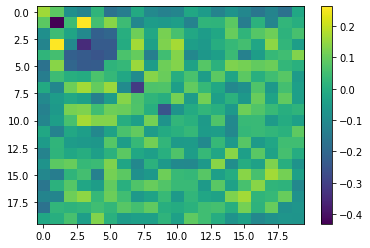

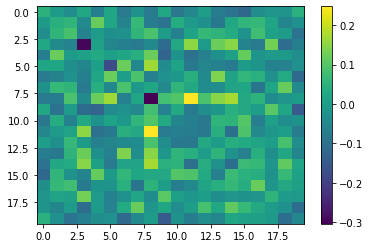

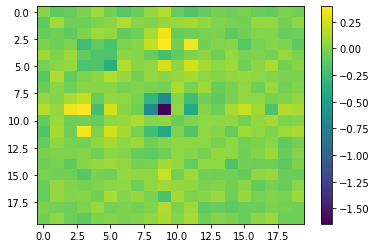

In [143]:
plt.imshow(differential_patterns_datasets[0].uns["Sigma_x_inv"]["0"], interpolation="none", aspect='auto')
plt.colorbar()

plt.figure()
plt.imshow(differential_patterns_datasets[1].uns["Sigma_x_inv"]["1"], interpolation="none", aspect='auto')
plt.colorbar()

plt.figure()
plt.imshow(differential_patterns_datasets[2].uns["Sigma_x_inv"]["2"], interpolation="none", aspect='auto')
plt.colorbar()

In [144]:
from scipy.stats import zscore

for dataset in differential_datasets + shared_datasets + differential_patterns_datasets:
    dataset.obsm["learned_X"] = dataset.obsm["X"]

    dataset.obsm["normalized_learned_X"] = zscore(dataset.obsm["learned_X"])
    sc.pp.neighbors(dataset, use_rep="normalized_learned_X")
    print(sc.metrics.morans_i(dataset, obsm="learned_X"))

[0.49758685 0.5653154  0.72710782 0.58669919 0.45677756 0.52525102
 0.63567228 0.54749194 0.63916994 0.45309986 0.51742676 0.52903824
 0.47124846 0.44833406 0.50937888 0.67081714 0.48807504 0.49959943
 0.64297707 0.5317519 ]
[0.51498811 0.62530923 0.5131273  0.70414245 0.52605141 0.64297523
 0.6200474  0.6233594  0.57719719 0.54974117 0.46292353 0.49508221
 0.63152181 0.51691119 0.51291182 0.51339833 0.4969617  0.51485283
 0.69602351 0.54504287]
[0.49116783 0.49053572 0.67687001 0.7363898  0.47413323 0.7154779
 0.46644193 0.62232695 0.52377062 0.46850577 0.50476116 0.46799095
 0.53161921 0.5059555  0.46208022 0.62828621 0.50802284 0.46149672
 0.48086304 0.45425217]
[0.47970198 0.64769642 0.65146866 0.48785703 0.54376255 0.51868149
 0.73260148 0.46992142 0.49615281 0.589788   0.64389532 0.55279342
 0.73857217 0.53159828 0.68301473 0.60998857 0.68192878 0.52426924
 0.6680902  0.5275604 ]
[0.76977235 0.55410572 0.50816203 0.53565196 0.48311989 0.80610387
 0.57916469 0.48641121 0.68921087 

In [145]:
right_gradient_shared_dataset, left_gradient_shared_dataset, central_hotspot_shared_dataset = shared_datasets
right_gradient_differential_dataset, left_gradient_differential_dataset, central_hotspot_differential_dataset = differential_datasets

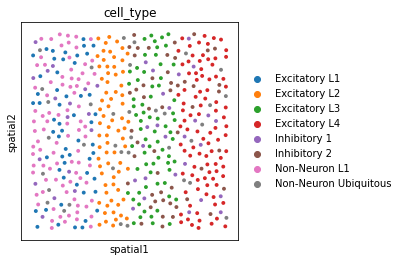

In [146]:
sc.pl.spatial(left_gradient_shared_dataset, spot_size=0.02, color="cell_type")

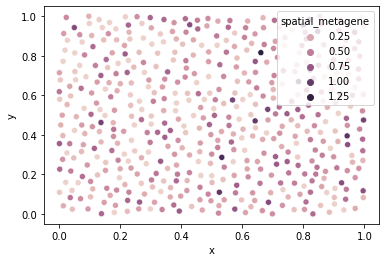

In [147]:
plot_metagene_embedding(differential_patterns_datasets[1], 3)

In [148]:
differential_datasets[0].uns["spicemixplus_hyperparameters"]

{'K': 20,
 'd': 4,
 'lambda_Sigma_x_inv': 0.1,
 'metagene_mode': 'differential',
 'prior_x': array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.], dtype=float32)}

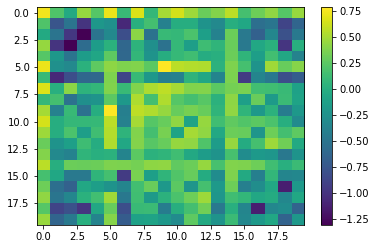

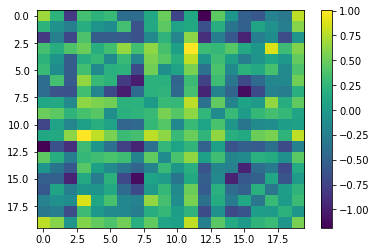

In [149]:
plt.imshow(differential_datasets[0].uns["Sigma_x_inv"]["0"], interpolation="none", aspect='auto')
plt.colorbar()
plt.figure() 

plt.imshow(shared_datasets[0].uns["Sigma_x_inv"]["0"], interpolation="none", aspect='auto')
plt.colorbar()

In [150]:
print(sc.metrics.morans_i(left_gradient_differential_dataset, obsm="X"))
print(sc.metrics.morans_i(right_gradient_differential_dataset, obsm="X"))
print(sc.metrics.morans_i(central_hotspot_differential_dataset, obsm="X"))

[0.51498811 0.62530923 0.5131273  0.70414245 0.52605141 0.64297523
 0.6200474  0.6233594  0.57719719 0.54974117 0.46292353 0.49508221
 0.63152181 0.51691119 0.51291182 0.51339833 0.4969617  0.51485283
 0.69602351 0.54504287]
[0.49758685 0.5653154  0.72710782 0.58669919 0.45677756 0.52525102
 0.63567228 0.54749194 0.63916994 0.45309986 0.51742676 0.52903824
 0.47124846 0.44833406 0.50937888 0.67081714 0.48807504 0.49959943
 0.64297707 0.5317519 ]
[0.49116783 0.49053572 0.67687001 0.7363898  0.47413323 0.7154779
 0.46644193 0.62232695 0.52377062 0.46850577 0.50476116 0.46799095
 0.53161921 0.5059555  0.46208022 0.62828621 0.50802284 0.46149672
 0.48086304 0.45425217]


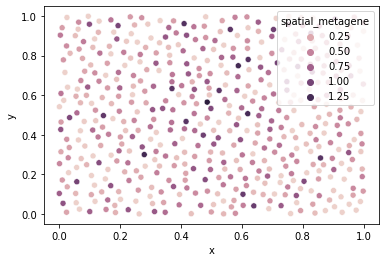

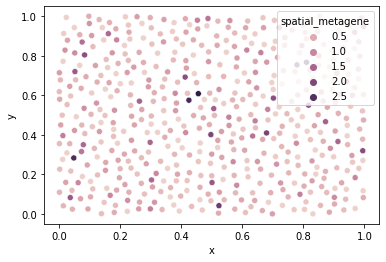

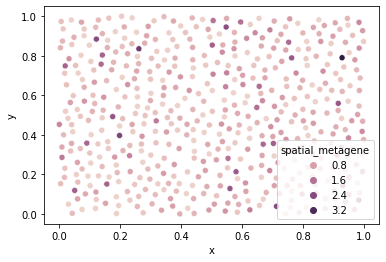

In [151]:
# Example metagene that probably corresponds to the spatial noise
plot_metagene_embedding(right_gradient_differential_dataset, 7)
plt.figure()
plot_metagene_embedding(left_gradient_differential_dataset, 7)
plt.figure()
plot_metagene_embedding(central_hotspot_differential_dataset, 7)

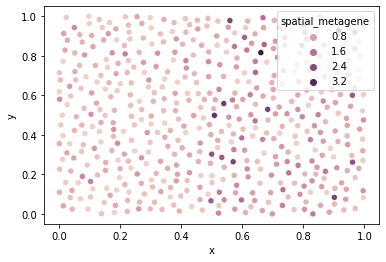

In [152]:
import pandas as pd
import seaborn as sns
 
plot_metagene_embedding(left_gradient_differential_dataset, 8)

In [153]:
sc.pl.embedding(right_gradient_dataset, color="cell_type",
                components="all",
                basis="normalized_learned_X")

NameError: name 'right_gradient_dataset' is not defined

In [154]:
for dataset in differential_datasets + shared_datasets + differential_patterns_datasets:
    sc.pp.neighbors(dataset, use_rep="normalized_learned_X")
    sc.tl.leiden(dataset, resolution=1)
    print(len(dataset.obs["leiden"].unique()))

7
9
7
7
8
7
7
7
7


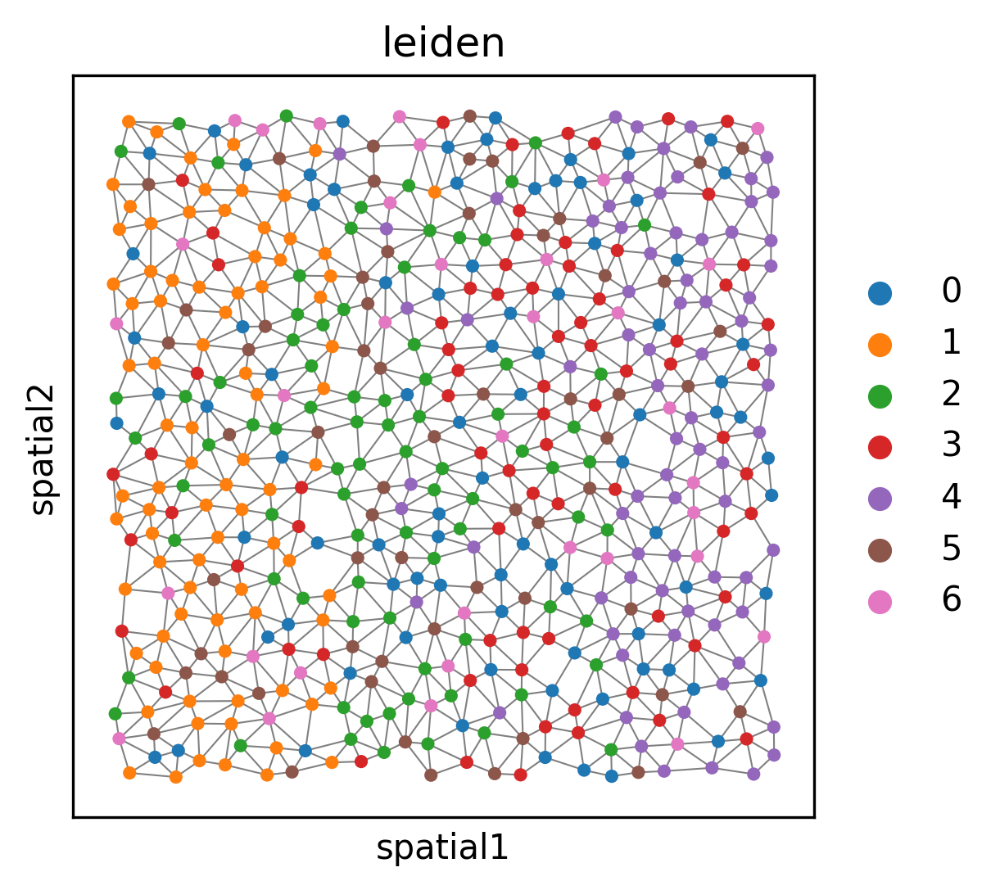

In [155]:
fig, ax = plt.subplots(dpi=300)
sc.pl.spatial(right_gradient_differential_dataset, spot_size=0.02, neighbors_key="spatial_neighbors",
              color="leiden", edges=True,  edges_width=0.5, ax=ax)

In [157]:
from sklearn.metrics import adjusted_rand_score as ari

print("Shared")
for dataset in shared_datasets:
    print(ari(dataset.obs["cell_type"], dataset.obs["leiden"]))

print("Differential")
for dataset in differential_datasets:
    print(ari(dataset.obs["cell_type"], dataset.obs["leiden"]))
    
print("Differential Patterns")
for dataset in differential_patterns_datasets:
    print(ari(dataset.obs["cell_type"], dataset.obs["leiden"]))

Shared
0.43552086869835555
0.3341758661875299
0.3182498552991059
Differential
0.43666879545002124
0.33866298399996136
0.3475381986854389
Differential Patterns
0.4153072861912244
0.38365957192920624
0.3101438135016622
